## Reference Videos

In [ ]:
# https://www.youtube.com/watch?v=o-pZk5R0TZg

## Imports

In [ ]:
#  sentence_transformers import SentenceTransformer, InputExample, losses
from torch.utils.data import DataLoader
from sklearn.metrics import classification_report
from sklearn.metrics.pairwise import cosine_similarity
import pandas as pd
import numpy as np
from sklearn.feature_extraction.text import TfidfVectorizer
import logging
from sentence_transformers import SentenceTransformer
logging.basicConfig(format='%(asctime)s - %(message)s', level=logging.INFO)

## Import the data, as well as split into a smaller/larger dataset 

In [2]:
# Load datasets
df_examples = pd.read_parquet('shopping_queries_dataset_examples.parquet')
df_products = pd.read_parquet('shopping_queries_dataset_products.parquet')
df_sources = pd.read_csv('shopping_queries_dataset_sources.csv')

In [3]:
# Merge examples with products
df_examples_products = pd.merge(
    df_examples,
    df_products,
    how='left',
    left_on=['product_locale', 'product_id'],
    right_on=['product_locale', 'product_id']
)

# Task 1: Small version (filtered to U.S. locale and non-null titles)
smaller_task = df_examples_products[
    (df_examples_products["small_version"] == 1) &
    (df_examples_products["product_locale"] == "us") &
    (df_examples_products["product_title"].notnull())
]

# Task 2: Large version
larger_task = df_examples_products[df_examples_products["large_version"] == 1]
larger_task_train = larger_task[larger_task["split"] == "train"]
larger_task_test = larger_task[larger_task["split"] == "test"]


## Initial Model: Smaller sample set, only looking at exact matches and using product titles
Scores: REALLY BAD

In [4]:
# Filter to Task 1 Train Set with Relevant (E) Labels
smaller_task_copy = smaller_task[
    (smaller_task["split"] == "train") &
    (smaller_task["esci_label"] == "E")
]

# Sample smaller set if needed (optional)
sample_df = smaller_task_copy.copy()

# Extract queries and product titles
queries = sample_df['query'].astype(str).values
products = sample_df['product_title'].astype(str).values

# TF-IDF Vectorizer on combined
vectorizer = TfidfVectorizer()
query_vecs = vectorizer.fit_transform(queries)
product_vecs = vectorizer.transform(products)  # Use same vocab

# Score and Recommend Top 3 Products per Query
for i, query in enumerate(queries):
    scores = cosine_similarity(query_vecs[i], product_vecs).flatten()
    ranked_indices = scores.argsort()[::-1]
    
    print(f"\nTop matches for: '{query}'")
    for idx in ranked_indices[:3]:
        print(f"- {products[idx]} (score: {scores[idx]:.4f})")


Top matches for: '!awnmower tires without rims'
- 17x7 Enkei EKM3 (Gunmetal) Wheels/Rims 5x100 (442-770-8045GM) (score: 0.4192)
- TDPRO 4PCS 145/70-6 Tires With 6 inch Wheels Rims for ATV Go Kart (score: 0.3681)
- Enkei 17x7 EDR9 (Matte Black) Wheels/Rims 5x100/114.3 (441-770-0245BK) (score: 0.3153)

Top matches for: '!awnmower tires without rims'
- 17x7 Enkei EKM3 (Gunmetal) Wheels/Rims 5x100 (442-770-8045GM) (score: 0.4192)
- TDPRO 4PCS 145/70-6 Tires With 6 inch Wheels Rims for ATV Go Kart (score: 0.3681)
- Enkei 17x7 EDR9 (Matte Black) Wheels/Rims 5x100/114.3 (441-770-0245BK) (score: 0.3153)

Top matches for: '!awnmower tires without rims'
- 17x7 Enkei EKM3 (Gunmetal) Wheels/Rims 5x100 (442-770-8045GM) (score: 0.4192)
- TDPRO 4PCS 145/70-6 Tires With 6 inch Wheels Rims for ATV Go Kart (score: 0.3681)
- Enkei 17x7 EDR9 (Matte Black) Wheels/Rims 5x100/114.3 (441-770-0245BK) (score: 0.3153)

Top matches for: '!awnmower tires without rims'
- 17x7 Enkei EKM3 (Gunmetal) Wheels/Rims 5x10


Top matches for: '# 10 self-seal envelopes without window'
- Self Seal Double Window Security Envelopes (#10 - Box of 500), for Invoices, Statements and Legal Documents (4 1/8" x 9 1/2") (score: 0.6234)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business Statements, Quickbooks Invoices, and Return Envelopes 4 1/8 X 9 ½’’ (score: 0.6204)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business Statements, Quickbooks Invoices, and Return Envelopes 4 1/8 X 9 ½’’ (score: 0.6204)

Top matches for: '# 10 self-seal envelopes without window'
- Self Seal Double Window Security Envelopes (#10 - Box of 500), for Invoices, Statements and Legal Documents (4 1/8" x 9 1/2") (score: 0.6234)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business Statements, Quickbooks Invoices, and Return Envelopes 4 1/8 X 9 ½’’ (score: 0.6204)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for B


Top matches for: '# 2 pencils not sharpened'
- Wood-Cased #2 HB Pencils, Yellow, Pre-sharpened, Class Pack, 320 pencils (score: 0.6606)
- Wood-Cased #2 HB Pencils, Yellow, Pre-sharpened, Class Pack, 1000 pencils (score: 0.6606)
- Madisi Golf Pencils with Eraser, 2 HB Half Pencils, 3.5" Mini Pencils, Pre-Sharpened, colorful pencils, 96 Count (score: 0.6481)

Top matches for: '# 2 pencils not sharpened'
- Wood-Cased #2 HB Pencils, Yellow, Pre-sharpened, Class Pack, 320 pencils (score: 0.6606)
- Wood-Cased #2 HB Pencils, Yellow, Pre-sharpened, Class Pack, 1000 pencils (score: 0.6606)
- Madisi Golf Pencils with Eraser, 2 HB Half Pencils, 3.5" Mini Pencils, Pre-Sharpened, colorful pencils, 96 Count (score: 0.6481)

Top matches for: '# 2 pencils not sharpened'
- Wood-Cased #2 HB Pencils, Yellow, Pre-sharpened, Class Pack, 320 pencils (score: 0.6606)
- Wood-Cased #2 HB Pencils, Yellow, Pre-sharpened, Class Pack, 1000 pencils (score: 0.6606)
- Madisi Golf Pencils with Eraser, 2 HB Half Pencil


Top matches for: '#1 best and not expensive bath back brush cream color'
- LFJ 3 in 1 Back Bath Brush Set for Shower, 19" Long Handle Body Brush, Bath Sponge and Pumice Gentle Exfoliation and Improved Skin Health, Suitable for Men and Women (score: 0.4026)
- 131704 Cement Color (score: 0.3422)
- Baxter's Back! (score: 0.3334)

Top matches for: '#1 best and not expensive bath back brush cream color'
- LFJ 3 in 1 Back Bath Brush Set for Shower, 19" Long Handle Body Brush, Bath Sponge and Pumice Gentle Exfoliation and Improved Skin Health, Suitable for Men and Women (score: 0.4026)
- 131704 Cement Color (score: 0.3422)
- Baxter's Back! (score: 0.3334)

Top matches for: '#1 best and not expensive bath back brush cream color'
- LFJ 3 in 1 Back Bath Brush Set for Shower, 19" Long Handle Body Brush, Bath Sponge and Pumice Gentle Exfoliation and Improved Skin Health, Suitable for Men and Women (score: 0.4026)
- 131704 Cement Color (score: 0.3422)
- Baxter's Back! (score: 0.3334)

Top matches 


Top matches for: '#10 window envelopes not self seal'
- Self Seal Double Window Security Envelopes (#10 - Box of 500), for Invoices, Statements and Legal Documents (4 1/8" x 9 1/2") (score: 0.6113)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business Statements, Quickbooks Invoices, and Return Envelopes 4 1/8 X 9 ½’’ (score: 0.6084)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business Statements, Quickbooks Invoices, and Return Envelopes 4 1/8 X 9 ½’’ (score: 0.6084)

Top matches for: '#10 window envelopes not self seal'
- Self Seal Double Window Security Envelopes (#10 - Box of 500), for Invoices, Statements and Legal Documents (4 1/8" x 9 1/2") (score: 0.6113)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business Statements, Quickbooks Invoices, and Return Envelopes 4 1/8 X 9 ½’’ (score: 0.6084)
- Office Deed 500 #10 Self Seal Double Window Security Envelopes-Designed for Business St


Top matches for: '#10 window envelopes without plastic'
- Acko #10 500Pack Double Window Envelopes Quickly Self-Seal Envelopes 4 1/8 x 9 1/2,Security Tint Pattern Designed for Home Office Secure Mailing,Letters and Invoices - White Envelopes 500 Count (score: 0.4833)
- 500 No. 10 Gummed Double Window Security Envelopes - Perfect Size for Multiple Business Statements, Quickbooks Invoices, and Return Envelopes - Number 10 Size 4 1/8 X 9 ½ Inch (score: 0.4548)
- 500 No. 10 Gummed Double Window Security Envelopes - Perfect Size for Multiple Business Statements, Quickbooks Invoices, and Return Envelopes - Number 10 Size 4 1/8 X 9 ½ Inch (score: 0.4548)

Top matches for: '#10 window envelopes without plastic'
- Acko #10 500Pack Double Window Envelopes Quickly Self-Seal Envelopes 4 1/8 x 9 1/2,Security Tint Pattern Designed for Home Office Secure Mailing,Letters and Invoices - White Envelopes 500 Count (score: 0.4833)
- 500 No. 10 Gummed Double Window Security Envelopes - Perfect Size for Mu


Top matches for: '#11 mrs. kormel is not normal'
- My Weird School #11: Mrs. Kormel Is Not Normal! (score: 0.8286)
- The Normal Heart (score: 0.3535)
- The Normal Heart (score: 0.3535)

Top matches for: '#11 mrs. kormel is not normal'
- My Weird School #11: Mrs. Kormel Is Not Normal! (score: 0.8286)
- The Normal Heart (score: 0.3535)
- The Normal Heart (score: 0.3535)

Top matches for: '#12 black boys chain necklace without baseball stitches'
- PROSTEEL Baseball Cross Necklace for Boys Men Necklaces Baseball Number Necklace Stainless Steel Chain Mens Necklace Baseball Chain Black Chain (score: 0.6332)
- Baseball Necklace ,Men Sports Youth Baseball Necklace for mens Stainless Steel Baseball Bat Necklace Athletes Jewelry Gift,Silver 20 inches (score: 0.4176)
- Wool Bucket Hat with Stitches-Black W15S41B (score: 0.3983)

Top matches for: '#12 black boys chain necklace without baseball stitches'
- PROSTEEL Baseball Cross Necklace for Boys Men Necklaces Baseball Number Necklace Stainless S


Top matches for: '#2 pencils with erasers sharpened not soft'
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6415)
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6415)
- Wood-Cased #2 HB Pencils, Shuttle Art 350 Pack Sharpened Yellow Pencils with Erasers, Bulk Pack Graphite Pencils for School and Teacher Supplies, Writhing, Drawing and Sketching (score: 0.5229)

Top matches for: '#2 pencils with erasers sharpened not soft'
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6415)
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6415)
- Wood-Cased #2 HB Pencils, Shuttle Art 350 Pack Sharpened Yellow Pencils with Erasers, Bulk Pack Graphite Pencils for School and Teacher Supplies, Writhing, Drawing and Sketching (score: 0.5229)

Top matches for: '#2 pencils with erasers sharpened not soft'
- T


Top matches for: '#2 pencils without erasers'
- Holographic Pencils with Erasers Metallic Assorted Colors Wooden Glitter Pencils Optical Illusion Pencils HB Pencils (36 Pieces) (score: 0.6681)
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6258)
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6258)

Top matches for: '#2 pencils without erasers'
- Holographic Pencils with Erasers Metallic Assorted Colors Wooden Glitter Pencils Optical Illusion Pencils HB Pencils (36 Pieces) (score: 0.6681)
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6258)
- Ticonderoga Neon Pencils, #2 Pre-Sharpened Wood Pencils with Erasers, 18-Count, 13018 (score: 0.6258)

Top matches for: '#2 pencils without erasers'
- Holographic Pencils with Erasers Metallic Assorted Colors Wooden Glitter Pencils Optical Illusion Pencils HB Pencils (36 Pieces) (score: 0.6681)
- 


Top matches for: '#20 paper bags without handle'
- Gift Bags 8x4.25x10.5 25Pcs BagDream Black Paper Bags, Paper Gift Bags with Handles, Paper Shopping Bags Kraft Bags Retail Bags Party Bags Merchandise Bags (score: 0.5323)
- BagDream Paper Bags 10x5x13 100Pcs White Kraft Paper Gift Bags, Shopping Bags, Merchandise Bags, Retail Bags, Party Bags, Gift Bags with Handles Bulk, 100% Recyclable Paper Bags (score: 0.5263)
- 10x5x13 Kraft Paper Bags 100 Pcs Kraft Shopping Bags, Paper Gift Bags, Retail Bags, Recycled Bulk Paper Bags, Brown Paper Bags with Handles Bulk (score: 0.5108)

Top matches for: '#20 paper bags without handle'
- Gift Bags 8x4.25x10.5 25Pcs BagDream Black Paper Bags, Paper Gift Bags with Handles, Paper Shopping Bags Kraft Bags Retail Bags Party Bags Merchandise Bags (score: 0.5323)
- BagDream Paper Bags 10x5x13 100Pcs White Kraft Paper Gift Bags, Shopping Bags, Merchandise Bags, Retail Bags, Party Bags, Gift Bags with Handles Bulk, 100% Recyclable Paper Bags (score: 0.526


Top matches for: '#3 metal zipper slider not made in america'
- Sam Walton: Made In America (score: 0.5396)
- YaHoGa 20 Sets #5 Small Metal Zipper Latch Slider Retainer Insertion Pin Zipper Bottom Zipper Stopper for 5mm Metal Zipper Repair (Black) (score: 0.4865)
- PH PandaHall 12 Sets Metal Zipper Latch Slider Retainer 3 Color #3#5#8#10 Insertion Pin Zipper Bottom Zipper Stopper for Metal Zipper Repair Zip Sewing Replacement DIY (score: 0.4587)

Top matches for: '#3 metal zipper slider not made in america'
- Sam Walton: Made In America (score: 0.5396)
- YaHoGa 20 Sets #5 Small Metal Zipper Latch Slider Retainer Insertion Pin Zipper Bottom Zipper Stopper for 5mm Metal Zipper Repair (Black) (score: 0.4865)
- PH PandaHall 12 Sets Metal Zipper Latch Slider Retainer 3 Color #3#5#8#10 Insertion Pin Zipper Bottom Zipper Stopper for Metal Zipper Repair Zip Sewing Replacement DIY (score: 0.4587)

Top matches for: '#3 metal zipper slider not made in america'
- Sam Walton: Made In America (scor


Top matches for: '#4 braiding hair not stretched'
- Ombre Braiding Hair Pre Stretched 26 Inch Brown Braiding Hair 8 Packs Easy Braids Hair Yaki Straight Hot Water Setting Synthetic Braiding Hair Extensions for Crochet Hair Braiding Twist(1B/30/27) (score: 0.6538)
- Ombre Pre stretched Braiding Hair, Long 4 tone Kanekalon Braid Hair Extensions, 8 packs Multi Color blending braiding hair, Twist Hair Braiding (36''-pack of 8, 1b3027613) (score: 0.6372)
- Braiding Hair Natural Black - 20''8 Packs Long Braiding Hair Pre-Stretched Braiding Hair Natural Braid Crochet Hair Hot Water Setting Professional Soft Yaki Texture (20inch,#1B) (score: 0.6272)

Top matches for: '#4 braiding hair not stretched'
- Ombre Braiding Hair Pre Stretched 26 Inch Brown Braiding Hair 8 Packs Easy Braids Hair Yaki Straight Hot Water Setting Synthetic Braiding Hair Extensions for Crochet Hair Braiding Twist(1B/30/27) (score: 0.6538)
- Ombre Pre stretched Braiding Hair, Long 4 tone Kanekalon Braid Hair Extensions, 8 


Top matches for: '#5 coil zipper without lock'
- ZipperStop Wholesale Authorized Distributor YKK 36" Light Weight Jacket Zipper ~ YKK #5 Nylon Coil Separating Zippers - White (Pack of 1 Zipper) (score: 0.5065)
- Zipper Pull 12 Pcs, Replacement Zipper Slider,Zipper Repair Kit #5, Fix Zipper Repair Kit for Repairing Coats,Jackets, Metal Plastic and Nylon Coil Zippers. (score: 0.4702)
- Meikeer 12 Pieces #5 Zipper Slider Repair Kits Black Bronze and Silver Zipper Sliders Zipper Pull Replacement for Metal Plastic and Nylon Coil Jacket Zippers (score: 0.4636)

Top matches for: '#5 coil zipper without lock'
- ZipperStop Wholesale Authorized Distributor YKK 36" Light Weight Jacket Zipper ~ YKK #5 Nylon Coil Separating Zippers - White (Pack of 1 Zipper) (score: 0.5065)
- Zipper Pull 12 Pcs, Replacement Zipper Slider,Zipper Repair Kit #5, Fix Zipper Repair Kit for Repairing Coats,Jackets, Metal Plastic and Nylon Coil Zippers. (score: 0.4702)
- Meikeer 12 Pieces #5 Zipper Slider Repair Kits Bla


Top matches for: '#6 fishing hook without barb'
- Fishing Hook Covers Hook Bonnets Treble Hook Guards - One Size Fits Most, Tangles Free, EVA Material Fishing Hook Caps Protect Your Sharp Hooks and Long Using (score: 0.4913)
- JueDi Fishing Rod Hook Keeper with 3 Size Elastic Rubber Rings Fishing Lure Bait Holder Small Fishing Tools Easy Adjustable Plastic Fishing Pole Hook Keeper Springs 8 Sets (4Black+4Green) (score: 0.4643)
- MOKIUER Single Towel Hook Clothes Hook for Bathroom Kitchen Robe Hook Coat Hook Hat Hook, Wall Mounted with Screws, Oil Rubbed Bronze, 2 Pack (score: 0.4485)

Top matches for: '#6 fishing hook without barb'
- Fishing Hook Covers Hook Bonnets Treble Hook Guards - One Size Fits Most, Tangles Free, EVA Material Fishing Hook Caps Protect Your Sharp Hooks and Long Using (score: 0.4913)
- JueDi Fishing Rod Hook Keeper with 3 Size Elastic Rubber Rings Fishing Lure Bait Holder Small Fishing Tools Easy Adjustable Plastic Fishing Pole Hook Keeper Springs 8 Sets (4Black+


Top matches for: '#8 tags without string'
- Paper Tags Gift Hang Tags with String 200pcs White (score: 0.7367)
- Blisstime Gift Tags 200 Pcs Kraft Paper Tags Hang Tags Blank Tags with 656ft Jute Twine String (score: 0.6866)
- 1000 Pieces White Tags with String Marking Strung Tags, Writable Tags Display Label for Products Jewelry Clothing Tags, 0.9 x 0.51 inches (score: 0.6541)

Top matches for: '#8 tags without string'
- Paper Tags Gift Hang Tags with String 200pcs White (score: 0.7367)
- Blisstime Gift Tags 200 Pcs Kraft Paper Tags Hang Tags Blank Tags with 656ft Jute Twine String (score: 0.6866)
- 1000 Pieces White Tags with String Marking Strung Tags, Writable Tags Display Label for Products Jewelry Clothing Tags, 0.9 x 0.51 inches (score: 0.6541)

Top matches for: '#8 tags without string'
- Paper Tags Gift Hang Tags with String 200pcs White (score: 0.7367)
- Blisstime Gift Tags 200 Pcs Kraft Paper Tags Hang Tags Blank Tags with 656ft Jute Twine String (score: 0.6866)
- 1000 Pieces


Top matches for: '#82 jewelry box without cotton'
- Jewelry Organizer, Small Jewelry Box Earring Holder for Women, Jewelry Storage Box 4-Layer Rotatable Jewelry Accessory Storage Tray with Lid for Rings Bracelets (score: 0.4416)
- Medium Jewelry Box Jewelry Store Gift Box Music Box Women Gift Mother of Pearl L2001 (score: 0.4274)
- dailymall Premium Heart Shaped Jewelry Box Wooden Gift Box Case Jewelry Organizer (score: 0.4244)

Top matches for: '#82 jewelry box without cotton'
- Jewelry Organizer, Small Jewelry Box Earring Holder for Women, Jewelry Storage Box 4-Layer Rotatable Jewelry Accessory Storage Tray with Lid for Rings Bracelets (score: 0.4416)
- Medium Jewelry Box Jewelry Store Gift Box Music Box Women Gift Mother of Pearl L2001 (score: 0.4274)
- dailymall Premium Heart Shaped Jewelry Box Wooden Gift Box Case Jewelry Organizer (score: 0.4244)

Top matches for: '#9x5" wood screws'
- WOOD (score: 0.4031)
- Norwegian Wood (score: 0.4031)
- Sjobergs SJO-33309, Wood (score: 0.403


Top matches for: '$1'
- Marcy Recumbent Exercise Bike with Resistance ME-709 (score: 0.0000)
- DVS Tripp Hi Womens DVF0000263-001 7.5 Medium Black/White (score: 0.0000)
- Central Intelligence (DVD) (score: 0.0000)

Top matches for: '$1 dollar toys not fidgets'
- Max Fun 36 Pack Sensory Fidget Toys Pack Bulk, Stress Balls Anxiety Relief Tools Toys for Kids Adult Children, Figetget Toys Set Bundle Autistic ADHD Fidgets Box, Infinity Cube Squeeze Ball (score: 0.3048)
- Max Fun 36 Pack Sensory Fidget Toys Pack Bulk, Stress Balls Anxiety Relief Tools Toys for Kids Adult Children, Figetget Toys Set Bundle Autistic ADHD Fidgets Box, Infinity Cube Squeeze Ball (score: 0.3048)
- lureme Gold/Silver Chain for Men with Dollar Sign Pendant Necklace Hip Hop Dollar Necklace (nl006266-2) (score: 0.3002)

Top matches for: '$1 dollar toys not fidgets'
- Max Fun 36 Pack Sensory Fidget Toys Pack Bulk, Stress Balls Anxiety Relief Tools Toys for Kids Adult Children, Figetget Toys Set Bundle Autistic ADHD F


Top matches for: '$10 lol literally not gonna change baby pet lol'
- LOL Suprise backpack Girls' LOL Surprise 5 in 1 Backpack Set, Pink/Aqua, One Size (score: 0.3276)
- LOL Surprise Glitter (score: 0.3164)
- LOL Girls Wall Decals Art Stickers Decor Removable LOL Girl Wall Decorations for Girls Kids (99Pcs) (score: 0.3027)

Top matches for: '$10 lol literally not gonna change baby pet lol'
- LOL Suprise backpack Girls' LOL Surprise 5 in 1 Backpack Set, Pink/Aqua, One Size (score: 0.3276)
- LOL Surprise Glitter (score: 0.3164)
- LOL Girls Wall Decals Art Stickers Decor Removable LOL Girl Wall Decorations for Girls Kids (99Pcs) (score: 0.3027)

Top matches for: '$10 lol literally not gonna change baby pet lol'
- LOL Suprise backpack Girls' LOL Surprise 5 in 1 Backpack Set, Pink/Aqua, One Size (score: 0.3276)
- LOL Surprise Glitter (score: 0.3164)
- LOL Girls Wall Decals Art Stickers Decor Removable LOL Girl Wall Decorations for Girls Kids (99Pcs) (score: 0.3027)

Top matches for: '$10 lo


Top matches for: '$10 stuff not books'
- Flat Stuff (score: 0.4831)
- Sketching Stuff Activity Book - Nature: For People Of All Ages (Sketching Stuff Activity Books) (score: 0.4298)
- April 10, 2018 - WinDgoe (score: 0.4291)

Top matches for: '$12 label maker that’s not a cheap one'
- Phomemo-M110 Label Maker - Portable Bluetooth Thermal Label Maker Printer for Clothing, Jewelry, Retail, Mailing, Barcode, Compatible with Android & iOS System, with 1pack 40×30mm Label, Black (score: 0.4007)
- Cheap Trick One on One (score: 0.4005)
- Aonomi Compatible Label Tapes Replacement for Brother p Touch Label Maker (Clear, 12mm) (score: 0.3908)

Top matches for: '$12 label maker that’s not a cheap one'
- Phomemo-M110 Label Maker - Portable Bluetooth Thermal Label Maker Printer for Clothing, Jewelry, Retail, Mailing, Barcode, Compatible with Android & iOS System, with 1pack 40×30mm Label, Black (score: 0.4007)
- Cheap Trick One on One (score: 0.4005)
- Aonomi Compatible Label Tapes Replacement fo


Top matches for: '$13 fidget toys without paying for delivery'
- BunMo Fidget Pad - 10 Fidget Toy Options in 1 Fidget Pack - Superior Fidget Toys for Unlimited Fun & Relief - Fidget Pad Works as Fidget Toys for Adults, Anxiety Toys, and Figet. (Blue Red) (score: 0.4692)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4535)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4535)

Top matches for: '$13 fidget toys without paying for delivery'
- BunMo Fidget Pad - 10 Fidget Toy Options in 1 Fidget Pack - Superior Fidget Toys for Unlimited Fun & Relief - Fidget Pad Works as Fidget Toys for Adults, Anxiety Toys, and Figet. (Blue Red) (score: 0.4692)
- Fidget Toys Pack, Sensory Fidget Toys Chea


Top matches for: '$13 fidget toys without paying for delivery'
- BunMo Fidget Pad - 10 Fidget Toy Options in 1 Fidget Pack - Superior Fidget Toys for Unlimited Fun & Relief - Fidget Pad Works as Fidget Toys for Adults, Anxiety Toys, and Figet. (Blue Red) (score: 0.4692)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4535)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4535)

Top matches for: '$13 fidget toys without paying for delivery'
- BunMo Fidget Pad - 10 Fidget Toy Options in 1 Fidget Pack - Superior Fidget Toys for Unlimited Fun & Relief - Fidget Pad Works as Fidget Toys for Adults, Anxiety Toys, and Figet. (Blue Red) (score: 0.4692)
- Fidget Toys Pack, Sensory Fidget Toys Chea


Top matches for: '$15 fidget pack without the pea poppet'
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4245)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4245)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4245)

Top matches for: '$15 fidget pack without the pea poppet'
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.4245)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy 


Top matches for: '$175 gram led frisbee gram not dollar'
- Discraft 175 gram Ultra Star Sport Disc, Bright Orange (score: 0.4494)
- New Life Spectrum Naturox Thera A Lg Fish 2200 Gram (score: 0.3915)
- Onyx C02 Manual PFD-Rearming Kit, Metal Cartridge, 24 gram (score: 0.3559)

Top matches for: '$175 gram led frisbee gram not dollar'
- Discraft 175 gram Ultra Star Sport Disc, Bright Orange (score: 0.4494)
- New Life Spectrum Naturox Thera A Lg Fish 2200 Gram (score: 0.3915)
- Onyx C02 Manual PFD-Rearming Kit, Metal Cartridge, 24 gram (score: 0.3559)

Top matches for: '$175 gram led frisbee gram not dollar'
- Discraft 175 gram Ultra Star Sport Disc, Bright Orange (score: 0.4494)
- New Life Spectrum Naturox Thera A Lg Fish 2200 Gram (score: 0.3915)
- Onyx C02 Manual PFD-Rearming Kit, Metal Cartridge, 24 gram (score: 0.3559)

Top matches for: '$175 gram led frisbee gram not dollar'
- Discraft 175 gram Ultra Star Sport Disc, Bright Orange (score: 0.4494)
- New Life Spectrum Naturox Thera A


Top matches for: '$230 pool for outdoors not plastic'
- GSI Outdoors 75251 Backpacker Mug (score: 0.4424)
- Hard Plastic Kiddie Pool – Large Plastic Dog Pool, Foldable Dog Pet Bath Pool Portable Dog Swimming Pool Bathing Tub Hard Plastic Kids Pool for Kids Dogs and Cats (score: 0.3869)
- Depets Dog Pool, Large Foldable Dog Pool, Hard Plastic Kiddie Pool, Pet Pool with Durable PVC & Fiberboard, 47" Dia. Collapsible Swimming Pool Bath Pool for Dogs, Cats, Kids (score: 0.3423)

Top matches for: '$230 pool for outdoors not plastic'
- GSI Outdoors 75251 Backpacker Mug (score: 0.4424)
- Hard Plastic Kiddie Pool – Large Plastic Dog Pool, Foldable Dog Pet Bath Pool Portable Dog Swimming Pool Bathing Tub Hard Plastic Kids Pool for Kids Dogs and Cats (score: 0.3869)
- Depets Dog Pool, Large Foldable Dog Pool, Hard Plastic Kiddie Pool, Pet Pool with Durable PVC & Fiberboard, 47" Dia. Collapsible Swimming Pool Bath Pool for Dogs, Cats, Kids (score: 0.3423)

Top matches for: '$230 pool for outdoor


Top matches for: '$25 katana swords not real'
- Clash of Swords (score: 0.4543)
- X of Swords (score: 0.4543)
- RENGENG Japanese Katana Samurai Kendo Wooden Katana Martial Arts Training Katana 92BKKC Polypropylene, Black (score: 0.4242)

Top matches for: '$25 katana swords not real'
- Clash of Swords (score: 0.4543)
- X of Swords (score: 0.4543)
- RENGENG Japanese Katana Samurai Kendo Wooden Katana Martial Arts Training Katana 92BKKC Polypropylene, Black (score: 0.4242)

Top matches for: '$25 katana swords not real'
- Clash of Swords (score: 0.4543)
- X of Swords (score: 0.4543)
- RENGENG Japanese Katana Samurai Kendo Wooden Katana Martial Arts Training Katana 92BKKC Polypropylene, Black (score: 0.4242)

Top matches for: '$25 katana swords not real'
- Clash of Swords (score: 0.4543)
- X of Swords (score: 0.4543)
- RENGENG Japanese Katana Samurai Kendo Wooden Katana Martial Arts Training Katana 92BKKC Polypropylene, Black (score: 0.4242)

Top matches for: '$25 katana swords not real'
-


Top matches for: '$3 nail tips without tax'
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Nail Tips Cofffin Nail Tips Acrylic Nail Tips 4PCS Nail Glues 1PC Nail File With Case for Nail Salons and DIY Nail Art, 10 Sizes (score: 0.6482)
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Nail Tips Cofffin Nail Tips Acrylic Nail Tips 4PCS Nail Glues 1PC Nail File With Case for Nail Salons and DIY Nail Art, 10 Sizes (score: 0.6482)
- Coffin Nail Tips Natural - ECBASKET 500pcs Acrylic Nail Tips Coffin Fake Nail Tips Long False Nail Tips Half Cover French Nail Tips 10 Sizes with Box for Nail Salons DIY Nail Art (score: 0.6071)

Top matches for: '$3 nail tips without tax'
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Nail Tips Cofffin Nail Tips Acrylic Nail Tips 4PCS Nail Glues 1PC Nail File With Case for Nail Salons and DIY Nail Art, 10 Sizes (score: 0.6482)
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Na


Top matches for: '$3 nail tips without tax'
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Nail Tips Cofffin Nail Tips Acrylic Nail Tips 4PCS Nail Glues 1PC Nail File With Case for Nail Salons and DIY Nail Art, 10 Sizes (score: 0.6482)
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Nail Tips Cofffin Nail Tips Acrylic Nail Tips 4PCS Nail Glues 1PC Nail File With Case for Nail Salons and DIY Nail Art, 10 Sizes (score: 0.6482)
- Coffin Nail Tips Natural - ECBASKET 500pcs Acrylic Nail Tips Coffin Fake Nail Tips Long False Nail Tips Half Cover French Nail Tips 10 Sizes with Box for Nail Salons DIY Nail Art (score: 0.6071)

Top matches for: '$3 nail tips without tax'
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Nail Tips Cofffin Nail Tips Acrylic Nail Tips 4PCS Nail Glues 1PC Nail File With Case for Nail Salons and DIY Nail Art, 10 Sizes (score: 0.6482)
- Nail Tips Fake Nails Kit - Ejiubas Nail Tips And Glue 500PCS Clear Na


Top matches for: '$40 bean bag chair for adults with bean not included'
- Lukeight Stuffed Animal Storage Bean Bag Chair for Kids, Zipper Storage Bean Bag for Organizing Stuffed Animals, Dinosaur Bean Bag Chair Cover, (No Beans) Large (score: 0.5931)
- Baoblaze Audlt Teen Size Bean Bag Chair Cover, High Back Large Bean Bag Storage Chair Cover Sack for Adults and Kids Without Filling - Light Blue (score: 0.5806)
- MFTEK Bean Bag Chair Cover Only, Large Washable Memory Foam Furniture Bean Bag with Wash Bag, Without Bean Filling, 43.3''×43.3''×47.2''(Gray) (score: 0.5733)

Top matches for: '$40 bean bag chair for adults with bean not included'
- Lukeight Stuffed Animal Storage Bean Bag Chair for Kids, Zipper Storage Bean Bag for Organizing Stuffed Animals, Dinosaur Bean Bag Chair Cover, (No Beans) Large (score: 0.5931)
- Baoblaze Audlt Teen Size Bean Bag Chair Cover, High Back Large Bean Bag Storage Chair Cover Sack for Adults and Kids Without Filling - Light Blue (score: 0.5806)
- MFTEK


Top matches for: '$50 skateboard without waxing music'
- Uptempo Latin Music (score: 0.4757)
- MonkingMe | Discover Music (score: 0.4757)
- RazorX DLX Electric Skateboard (score: 0.3715)

Top matches for: '$50 skateboard without waxing music'
- Uptempo Latin Music (score: 0.4757)
- MonkingMe | Discover Music (score: 0.4757)
- RazorX DLX Electric Skateboard (score: 0.3715)

Top matches for: '$50 skateboard without waxing music'
- Uptempo Latin Music (score: 0.4757)
- MonkingMe | Discover Music (score: 0.4757)
- RazorX DLX Electric Skateboard (score: 0.3715)

Top matches for: '$50 skateboard without waxing music'
- Uptempo Latin Music (score: 0.4757)
- MonkingMe | Discover Music (score: 0.4757)
- RazorX DLX Electric Skateboard (score: 0.3715)

Top matches for: '$50 skateboard without waxing music'
- Uptempo Latin Music (score: 0.4757)
- MonkingMe | Discover Music (score: 0.4757)
- RazorX DLX Electric Skateboard (score: 0.3715)

Top matches for: '$50 skateboard without waxing music'
- Up


Top matches for: '&a pedicure spa parts, pop-up drain plug without strainer'
- KES Pop Up Drain without Overflow with Detachable Hair Catcher Sink Drain Strainer for Bathroom Sink Drain Matte Black, S2018D-BK (score: 0.3945)
- KES Pop Up Drain without Overflow with Detachable Hair Catcher Sink Drain Strainer for Bathroom Sink Drain Matte Black, S2018D-BK (score: 0.3945)
- KES Pop Up Drain without Overflow with Detachable Hair Catcher Sink Drain Strainer for Bathroom Sink Drain Matte Black, S2018D-BK (score: 0.3945)

Top matches for: '&a pedicure spa parts, pop-up drain plug without strainer'
- KES Pop Up Drain without Overflow with Detachable Hair Catcher Sink Drain Strainer for Bathroom Sink Drain Matte Black, S2018D-BK (score: 0.3945)
- KES Pop Up Drain without Overflow with Detachable Hair Catcher Sink Drain Strainer for Bathroom Sink Drain Matte Black, S2018D-BK (score: 0.3945)
- KES Pop Up Drain without Overflow with Detachable Hair Catcher Sink Drain Strainer for Bathroom Sink D


Top matches for: ''do not leave deliveries or packages' sign'
- Stop DO NOT Leave Packages HERE Aluminum Composite Outdoor Sign 8.5" x10" (score: 0.5884)
- Ring Bell or Knock Hard - Do Not Leave Packages Unattended Delivery Instructions for Amazon UPS FEDEX USPS and Food Deliveries , 6 x 9 Rust & Waterproof PVC - Sign with Mounting Adhesive by SPRYZZLE (score: 0.5685)
- DO NOT Leave Packages HERE UPS USPS FedEx Amazon Aluminum Composite Outdoor Sign 8.5" x10" (score: 0.5563)

Top matches for: ''freeze dryer' machine not dehydrator'
- Hemperature Freeze Stick (score: 0.4564)
- 10 Layers Commercial Stainless Steel Food Dehydrator for Food and Jerky Fruit Dehydrator, Professional Jerky Maker Dryer with Adjustable Time and Temperature Control and 67 Recipes (score: 0.3639)
- COSORI Premium Food Dehydrator (50 Recipes) for Jerky Meat Herbs Fruit, Dryer Machine with Digital Temperature, 6 Stainless Steel Trays, CP267-FD (score: 0.3397)

Top matches for: ''freeze dryer' machine not dehydrato


Top matches for: ''not my circus not my monkeys my monkeys flyshirt''
- Not My Monkeys Not My Circus...My Monkeys Fly T-Shirt (score: 0.9099)
- Not My Circus Not My Monkeys T Shirt (score: 0.8929)
- Not My Circus, Not My Monkeys T-Shirt (score: 0.8929)

Top matches for: ''not my circus not my monkeys my monkeys flyshirt''
- Not My Monkeys Not My Circus...My Monkeys Fly T-Shirt (score: 0.9099)
- Not My Circus Not My Monkeys T Shirt (score: 0.8929)
- Not My Circus, Not My Monkeys T-Shirt (score: 0.8929)

Top matches for: ''not my circus not my monkeys my monkeys flyshirt''
- Not My Monkeys Not My Circus...My Monkeys Fly T-Shirt (score: 0.9099)
- Not My Circus Not My Monkeys T Shirt (score: 0.8929)
- Not My Circus, Not My Monkeys T-Shirt (score: 0.8929)

Top matches for: ''not my circus not my monkeys my monkeys flyshirt''
- Not My Monkeys Not My Circus...My Monkeys Fly T-Shirt (score: 0.9099)
- Not My Circus Not My Monkeys T Shirt (score: 0.8929)
- Not My Circus, Not My Monkeys T-Shirt 


Top matches for: '(can not use in the usa) european 220voltage hair tools'
- In the Pines, In the Pines (score: 0.3217)
- Caught in the Crossfire (score: 0.3217)
- The Lighthorsemen [ NON-USA FORMAT, PAL, Reg.2 Import - Netherlands ] (score: 0.3198)

Top matches for: '(can not use in the usa) european 220voltage hair tools'
- In the Pines, In the Pines (score: 0.3217)
- Caught in the Crossfire (score: 0.3217)
- The Lighthorsemen [ NON-USA FORMAT, PAL, Reg.2 Import - Netherlands ] (score: 0.3198)

Top matches for: '(can not use in the usa) european 220voltage hair tools'
- In the Pines, In the Pines (score: 0.3217)
- Caught in the Crossfire (score: 0.3217)
- The Lighthorsemen [ NON-USA FORMAT, PAL, Reg.2 Import - Netherlands ] (score: 0.3198)

Top matches for: '(can not use in the usa) european 220voltage hair tools'
- In the Pines, In the Pines (score: 0.3217)
- Caught in the Crossfire (score: 0.3217)
- The Lighthorsemen [ NON-USA FORMAT, PAL, Reg.2 Import - Netherlands ] (score: 0.31


Top matches for: '(print on back) we are not descended from fearful men decal'
- (print on back) We Are Not Descended From Fearful Men Betsy T-Shirt (score: 0.8589)
- We are Not Descended from Fearful Men Gun Flag On Back Gift Decorations - 4x3 Vinyl Stickers, Laptop Decal, Water Bottle Sticker (Set of 3) (score: 0.7003)
- Southern Fried Decals 6.5" X 5.25" We are Not Descended from Fearful Men Vinyl DIE Cut Decal for Your car, Truck, Window, Laptop, MacBook, or Any Other Smooth Surface (score: 0.4915)

Top matches for: '(print on back) we are not descended from fearful men decal'
- (print on back) We Are Not Descended From Fearful Men Betsy T-Shirt (score: 0.8589)
- We are Not Descended from Fearful Men Gun Flag On Back Gift Decorations - 4x3 Vinyl Stickers, Laptop Decal, Water Bottle Sticker (Set of 3) (score: 0.7003)
- Southern Fried Decals 6.5" X 5.25" We are Not Descended from Fearful Men Vinyl DIE Cut Decal for Your car, Truck, Window, Laptop, MacBook, or Any Other Smooth Surfac


Top matches for: '(pvc not wood) peel and stick banding'
- NuWallpaper NU3126 Beachwood Peel and Stick Wallpaper , Blue (score: 0.4652)
- RoomMates RMK11532RL Finlayson Blue and Green Bunaken Peel and Stick Wallpaper (score: 0.4507)
- Livebor Gray Wood Peel and Stick Wallpaper Shiplap Wood Wallpaper 17.7inchx 118.1inch Barnwood Contact Paper Faux Wood Plank Self Adhesive Wall Paper Peel and Stick Reclaimed Wood Wallpaper (score: 0.4282)

Top matches for: '(pvc not wood) peel and stick banding'
- NuWallpaper NU3126 Beachwood Peel and Stick Wallpaper , Blue (score: 0.4652)
- RoomMates RMK11532RL Finlayson Blue and Green Bunaken Peel and Stick Wallpaper (score: 0.4507)
- Livebor Gray Wood Peel and Stick Wallpaper Shiplap Wood Wallpaper 17.7inchx 118.1inch Barnwood Contact Paper Faux Wood Plank Self Adhesive Wall Paper Peel and Stick Reclaimed Wood Wallpaper (score: 0.4282)

Top matches for: '(pvc not wood) peel and stick banding'
- NuWallpaper NU3126 Beachwood Peel and Stick Wallpaper , 


Top matches for: '*i'm gaming do not disturb*shirt'
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Kids T-Shirt (score: 0.7529)
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Boys T-Shirt (score: 0.7504)
- Do Not Disturb I'm Gaming T-Shirt Video Gamer Gift T-Shirt (score: 0.7474)

Top matches for: '*i'm gaming do not disturb*shirt'
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Kids T-Shirt (score: 0.7529)
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Boys T-Shirt (score: 0.7504)
- Do Not Disturb I'm Gaming T-Shirt Video Gamer Gift T-Shirt (score: 0.7474)

Top matches for: '*i'm gaming do not disturb*shirt'
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Kids T-Shirt (score: 0.7529)
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Boys T-Shirt (score: 0.7504)
- Do Not Disturb I'm Gaming T-Shirt Video Gamer Gift T-Shirt (score: 0.7474)

Top matches for: '*i'm gaming do not disturb*shirt'
- Do Not Disturb I'm Gaming T-Shirt Video Gamer For Kids T-Shirt (score


Top matches for: '+3/4 sleeve for women not plus'
- Krankonia (Lied plus Hörspiel) (score: 0.5149)
- Maleficent (Plus Bonus Features) (score: 0.5149)
- Not for Profit [Explicit] (score: 0.5111)

Top matches for: '+3/4 sleeve for women not plus'
- Krankonia (Lied plus Hörspiel) (score: 0.5149)
- Maleficent (Plus Bonus Features) (score: 0.5149)
- Not for Profit [Explicit] (score: 0.5111)

Top matches for: '+3/4 sleeve for women not plus'
- Krankonia (Lied plus Hörspiel) (score: 0.5149)
- Maleficent (Plus Bonus Features) (score: 0.5149)
- Not for Profit [Explicit] (score: 0.5111)

Top matches for: '+3/4 sleeve for women not plus'
- Krankonia (Lied plus Hörspiel) (score: 0.5149)
- Maleficent (Plus Bonus Features) (score: 0.5149)
- Not for Profit [Explicit] (score: 0.5111)

Top matches for: '+3/4 sleeve for women not plus'
- Krankonia (Lied plus Hörspiel) (score: 0.5149)
- Maleficent (Plus Bonus Features) (score: 0.5149)
- Not for Profit [Explicit] (score: 0.5111)

Top matches for: '+3/4 s


Top matches for: '+dark +chocolate +peanuts not milk'
- Milk (score: 0.5048)
- Dark Chocolate Lover's Delight! Compte D' Chocolate! Includes (1) 3.5 oz Bar Dark Chocolate Mint 50% Cocoa, (1) Dark Chocolate 50% Cocoa, (1) Dark Chocolate With Sea Salt (score: 0.5028)
- Merckens Chocolate Coatings, Dark, 2 Pound (score: 0.4703)

Top matches for: '+dark +chocolate +peanuts not milk'
- Milk (score: 0.5048)
- Dark Chocolate Lover's Delight! Compte D' Chocolate! Includes (1) 3.5 oz Bar Dark Chocolate Mint 50% Cocoa, (1) Dark Chocolate 50% Cocoa, (1) Dark Chocolate With Sea Salt (score: 0.5028)
- Merckens Chocolate Coatings, Dark, 2 Pound (score: 0.4703)

Top matches for: '+dark +chocolate +peanuts not milk'
- Milk (score: 0.5048)
- Dark Chocolate Lover's Delight! Compte D' Chocolate! Includes (1) 3.5 oz Bar Dark Chocolate Mint 50% Cocoa, (1) Dark Chocolate 50% Cocoa, (1) Dark Chocolate With Sea Salt (score: 0.5028)
- Merckens Chocolate Coatings, Dark, 2 Pound (score: 0.4703)

Top matches for


Top matches for: '+proofer for yogourt -brod and not frozen and not automatic'
- Not for Profit [Explicit] (score: 0.3633)
- Mathematics for Plumbers and Pipefitters (score: 0.3356)
- Scholasticism and Politics (score: 0.3298)

Top matches for: '+proofer for yogourt -brod and not frozen and not automatic'
- Not for Profit [Explicit] (score: 0.3633)
- Mathematics for Plumbers and Pipefitters (score: 0.3356)
- Scholasticism and Politics (score: 0.3298)

Top matches for: '+proofer for yogourt -brod and not frozen and not automatic'
- Not for Profit [Explicit] (score: 0.3633)
- Mathematics for Plumbers and Pipefitters (score: 0.3356)
- Scholasticism and Politics (score: 0.3298)

Top matches for: ', fidget do not yell at that cost $1'
- Thuggin' At the Altar (score: 0.3274)
- Samsung Rugby 2 SGH-A847 A847 (AT&T) (score: 0.3068)
- BunMo Fidget Pad - 10 Fidget Toy Options in 1 Fidget Pack - Superior Fidget Toys for Unlimited Fun & Relief - Fidget Pad Works as Fidget Toys for Adults, Anxiety 


Top matches for: ',e26 bulb base, 60w max x 1(bulbs not included)'
- YUKIHALU, LED Refrigerator Light Bulb 60W Equivalent A15 Appliance Fridge Bulbs, Waterproof 600 Lumen 7W 120V Daylight 5000K E26 Medium Base, Small Size Bulb for Damp Location, Not-Dim, 2-Pack (score: 0.5251)
- LANGREE Antique Vintage LED Light Bulbs, ST58 Edison Led Bulb, Equivalent 60W, Daylight White 4000k, E26 Medium Base, Non-Dimmable, LED Filament Bulbs, Pack of 5 (score: 0.5028)
- LANGREE Antique Vintage LED Light Bulbs, ST58 Edison Led Bulb, Equivalent 60W, Soft White 2700k, E26 Medium Base, Non-Dimmable, LED Filament Bulbs, Pack of 5 (score: 0.4941)

Top matches for: ',e26 bulb base, 60w max x 1(bulbs not included)'
- YUKIHALU, LED Refrigerator Light Bulb 60W Equivalent A15 Appliance Fridge Bulbs, Waterproof 600 Lumen 7W 120V Daylight 5000K E26 Medium Base, Small Size Bulb for Damp Location, Not-Dim, 2-Pack (score: 0.5251)
- LANGREE Antique Vintage LED Light Bulbs, ST58 Edison Led Bulb, Equivalent 60W, Dayli


Top matches for: '- dash air vent outlet assembly without air conditioning'
- Dorman 74935 Air Vent Replacement (score: 0.4796)
- JKOVRME 4Inch Louvered Grille Cover Vent Hood Wall Air Vents - Stainless Steel Round Soffit Vents Ventilation Air Outlet (4Inch) (score: 0.4571)
- NewYall Carbon Fiber Style Interior Dash Center Console Panel Air Outlet Vent Cover Trim (score: 0.4220)

Top matches for: '- dash air vent outlet assembly without air conditioning'
- Dorman 74935 Air Vent Replacement (score: 0.4796)
- JKOVRME 4Inch Louvered Grille Cover Vent Hood Wall Air Vents - Stainless Steel Round Soffit Vents Ventilation Air Outlet (4Inch) (score: 0.4571)
- NewYall Carbon Fiber Style Interior Dash Center Console Panel Air Outlet Vent Cover Trim (score: 0.4220)

Top matches for: '- dash air vent outlet assembly without air conditioning'
- Dorman 74935 Air Vent Replacement (score: 0.4796)
- JKOVRME 4Inch Louvered Grille Cover Vent Hood Wall Air Vents - Stainless Steel Round Soffit Vents Venti


Top matches for: '- y not narural organic pharm oure enu oil'
- Herb Pharm Certified Organic Calendula Oil - 1 Ounce (score: 0.3791)
- Organic (score: 0.3144)
- Organic Frankincense Essential Oil (100% Pure - USDA Certified Organic) Best Therapeutic Grade Essential Oil - 10ml (score: 0.2524)

Top matches for: '- y not narural organic pharm oure enu oil'
- Herb Pharm Certified Organic Calendula Oil - 1 Ounce (score: 0.3791)
- Organic (score: 0.3144)
- Organic Frankincense Essential Oil (100% Pure - USDA Certified Organic) Best Therapeutic Grade Essential Oil - 10ml (score: 0.2524)

Top matches for: '- y not narural organic pharm oure enu oil'
- Herb Pharm Certified Organic Calendula Oil - 1 Ounce (score: 0.3791)
- Organic (score: 0.3144)
- Organic Frankincense Essential Oil (100% Pure - USDA Certified Organic) Best Therapeutic Grade Essential Oil - 10ml (score: 0.2524)

Top matches for: '- y not narural organic pharm oure enu oil'
- Herb Pharm Certified Organic Calendula Oil - 1 Ounce 


Top matches for: '-headphones without mic'
- AIAIAI TMA-1 DJ Headphones without Mic, Black (score: 0.6268)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)

Top matches for: '-headphones without mic'
- AIAIAI TMA-1 DJ Headphones without Mic, Black (score: 0.6268)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)

Top matches for: '-headphones without mic'
- AIAIAI TMA-1 DJ Headphones without Mic, Black (score: 0.6268)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)

Top matches for: '-lazy oaf not for your team sweatshirt in a men's size'
- Nike Mens Epic Jacket Team Black/Team Anthracite/White Size L (score: 0.3690)
- Miami Dolphins NFL Lazy Day Team Robe (score: 0.3168)
- adidas Unisex 5-Sta


Top matches for: '.05 pen not gel'
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- Sharpie S-Gel, Gel Pens, Medium Point (0.7mm), Black Ink Gel Pen, 4 Count (score: 0.4714)

Top matches for: '.05 pen not gel'
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- Sharpie S-Gel, Gel Pens, Medium Point (0.7mm), Black Ink Gel Pen, 4 Count (score: 0.4714)

Top matches for: '.05 pen not gel'
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- Sharpie S-Gel, Gel Pens, Medium Point (0.7mm), Black Ink Gel Pen, 4 Count (score: 0.4714)

Top matches for: '.05 pen not gel'
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- MicrocynAH Ophthalmic Gel (score: 0.4992)
- Sharpie S-Gel, Gel Pens, Medium Point (0.7mm), Black Ink Gel Pen, 4 Count (score: 0.4714)

Top matches for: '.09 ml syringe without needle'
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20


Top matches for: '.177 caliber pellet gun without break barrow'
- Umarex Trevox Break Barrel .177 Caliber Pellet Gun Air Pistol, Black, One Size (2251348) (score: 0.6699)
- Umarex Ruger Blackhawk .177 Caliber Pellet Gun Air Rifle with 4x32mm Scope (score: 0.5480)
- Hiram Air Gun Pellet BB Gun Resetting Target, Rated for .22 .177 Caliber (score: 0.5407)

Top matches for: '.177 caliber pellet gun without break barrow'
- Umarex Trevox Break Barrel .177 Caliber Pellet Gun Air Pistol, Black, One Size (2251348) (score: 0.6699)
- Umarex Ruger Blackhawk .177 Caliber Pellet Gun Air Rifle with 4x32mm Scope (score: 0.5480)
- Hiram Air Gun Pellet BB Gun Resetting Target, Rated for .22 .177 Caliber (score: 0.5407)

Top matches for: '.177 caliber pellet gun without break barrow'
- Umarex Trevox Break Barrel .177 Caliber Pellet Gun Air Pistol, Black, One Size (2251348) (score: 0.6699)
- Umarex Ruger Blackhawk .177 Caliber Pellet Gun Air Rifle with 4x32mm Scope (score: 0.5480)
- Hiram Air Gun Pellet 


Top matches for: '.22 pellets test'
- Gamo WHISPER PELLET QTY100 BLISTER 632272354 Pellets .22 (score: 0.5616)
- AncestryDNA: Genetic Ethnicity Test, Ethnicity Estimate, AncestryDNA Test Kit (score: 0.5230)
- Gamo PBA BULLET .22CAL QTY100 BLISTER 632272154 Pellets .22 (score: 0.4732)

Top matches for: '.22 pellets test'
- Gamo WHISPER PELLET QTY100 BLISTER 632272354 Pellets .22 (score: 0.5616)
- AncestryDNA: Genetic Ethnicity Test, Ethnicity Estimate, AncestryDNA Test Kit (score: 0.5230)
- Gamo PBA BULLET .22CAL QTY100 BLISTER 632272154 Pellets .22 (score: 0.4732)

Top matches for: '.22 pellets test'
- Gamo WHISPER PELLET QTY100 BLISTER 632272354 Pellets .22 (score: 0.5616)
- AncestryDNA: Genetic Ethnicity Test, Ethnicity Estimate, AncestryDNA Test Kit (score: 0.5230)
- Gamo PBA BULLET .22CAL QTY100 BLISTER 632272154 Pellets .22 (score: 0.4732)

Top matches for: '.24 to .65 not fitting'
- PEX 3/4 Inch TEE Brass Crimping Fitting 3/4" x 3/4" x 3/4" Lead Free Brass for PEX to PEX Plumbin


Top matches for: '.4 mm not bleed pen'
- Motorcraft - Screw - Bleed (P) (BKBOE12) (score: 0.4712)
- 1105 Pieces Wooden Beads, Natural Round Wood Beads Set with 1 Roll Crystal Elastic Line for DIY Jewelry Craft Making, 6 Sizes (6 mm/ 8 mm/ 10 mm/ 12 mm/ 16 mm/ 20 mm) (score: 0.4418)
- Pilot G-2 Gel Ink Pen - 1.0 mm - Red 3-Pack (score: 0.4156)

Top matches for: '.4 mm not bleed pen'
- Motorcraft - Screw - Bleed (P) (BKBOE12) (score: 0.4712)
- 1105 Pieces Wooden Beads, Natural Round Wood Beads Set with 1 Roll Crystal Elastic Line for DIY Jewelry Craft Making, 6 Sizes (6 mm/ 8 mm/ 10 mm/ 12 mm/ 16 mm/ 20 mm) (score: 0.4418)
- Pilot G-2 Gel Ink Pen - 1.0 mm - Red 3-Pack (score: 0.4156)

Top matches for: '.4 mm not bleed pen'
- Motorcraft - Screw - Bleed (P) (BKBOE12) (score: 0.4712)
- 1105 Pieces Wooden Beads, Natural Round Wood Beads Set with 1 Roll Crystal Elastic Line for DIY Jewelry Craft Making, 6 Sizes (6 mm/ 8 mm/ 10 mm/ 12 mm/ 16 mm/ 20 mm) (score: 0.4418)
- Pilot G-2 Gel Ink Pen 


Top matches for: '.5ml syringe without needle'
- Oral Syringe 5ml - 100 ct, No Needle (score: 0.6649)
- 20Pack-5ml Syringes with 21G 1.5inch Needles,Disposable Sterile Syringe with Needle Plastic Syringe (score: 0.6450)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5725)

Top matches for: '.5ml syringe without needle'
- Oral Syringe 5ml - 100 ct, No Needle (score: 0.6649)
- 20Pack-5ml Syringes with 21G 1.5inch Needles,Disposable Sterile Syringe with Needle Plastic Syringe (score: 0.6450)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5725)

Top matches for: '.5ml syringe without needle'
- Oral Syringe 5ml - 100 ct, No Needle (score: 0.6649)
- 20Pack-5ml Syringes with 21G 1.5inch Needles,Disposable Sterile Syringe with Needle Plastic Syringe (score: 0.6450)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5725)

Top matches for: '.5ml syringe without needle'
- Oral Syringe 5ml - 100 ct, No Needle (score: 0.6649)
- 20Pack-5ml Syringes with 21G 1.5inch Needles,Disposable Steri


Top matches for: '.68 paintballs not reusable'
- 68 Cal Paintballs Jawbreaker Solid Balls - Self Defense Nylon, Less Lethal Practice Paintballs .68 Caliber - Black (100 Count) 3.5 Gram (score: 0.5360)
- Paintball .68 Cal Ammo, 50 X 0.68 Cal. Jawbreaker Solid Balls Paintballs Projectiles Self Defense Nylon 3.6 Gram Paintballs Less Lethal Practice Balls (score: 0.4773)
- AOOHYEO Reusable 0.68 Caliber Riot Paintballs - 100 New Re-Usable Rubber Training Elastic Balls Paint Balls (score: 0.4728)

Top matches for: '.68 paintballs not reusable'
- 68 Cal Paintballs Jawbreaker Solid Balls - Self Defense Nylon, Less Lethal Practice Paintballs .68 Caliber - Black (100 Count) 3.5 Gram (score: 0.5360)
- Paintball .68 Cal Ammo, 50 X 0.68 Cal. Jawbreaker Solid Balls Paintballs Projectiles Self Defense Nylon 3.6 Gram Paintballs Less Lethal Practice Balls (score: 0.4773)
- AOOHYEO Reusable 0.68 Caliber Riot Paintballs - 100 New Re-Usable Rubber Training Elastic Balls Paint Balls (score: 0.4728)

Top m


Top matches for: '.68 paintballs not reusable'
- 68 Cal Paintballs Jawbreaker Solid Balls - Self Defense Nylon, Less Lethal Practice Paintballs .68 Caliber - Black (100 Count) 3.5 Gram (score: 0.5360)
- Paintball .68 Cal Ammo, 50 X 0.68 Cal. Jawbreaker Solid Balls Paintballs Projectiles Self Defense Nylon 3.6 Gram Paintballs Less Lethal Practice Balls (score: 0.4773)
- AOOHYEO Reusable 0.68 Caliber Riot Paintballs - 100 New Re-Usable Rubber Training Elastic Balls Paint Balls (score: 0.4728)

Top matches for: '.7 pens'
- Mr. Pen- Fineliner Pens, 12 Pack, Pens Fine Point, Colored Pens, Journal Pens, Bible Journaling Pens, Journals Supplies, School Supplies, Pen Set, Art Pens, Writing Pens, Fine Tip Markers, Bible Pens (score: 0.8441)
- Color Gel Pens - Gel Pens for Kids - Coloring Pens - Gel Pens Set - Pen Sets for Girls - Spirograph Pens - Pen Art Set - Artist Gel Pens - Sparkle Pens for Kids - 36 Gel Pens - Arts Pens (score: 0.8285)
- Mr. Pen- Pens, Fineliner Pens, 36 Pack, 0.4 mm, Pe


Top matches for: '.nnn not much'
- Bipolar, Not So Much: Understanding Your Mood Swings and Depression (score: 0.3070)
- Old Ego Is A Too Much Thing (score: 0.3054)
- Womens Gia Like Grandmother but So Much Cooler (score: 0.2777)

Top matches for: '.nothing without intention'
- Nothing Without Intention [Explicit] (score: 1.0000)
- Nothing Without Intention (interlude) [Explicit] (score: 1.0000)
- Nothing without Intention Journal / notebook: 200 pages (score: 0.6559)

Top matches for: '.nothing without intention'
- Nothing Without Intention [Explicit] (score: 1.0000)
- Nothing Without Intention (interlude) [Explicit] (score: 1.0000)
- Nothing without Intention Journal / notebook: 200 pages (score: 0.6559)

Top matches for: '.nothing without intention'
- Nothing Without Intention [Explicit] (score: 1.0000)
- Nothing Without Intention (interlude) [Explicit] (score: 1.0000)
- Nothing without Intention Journal / notebook: 200 pages (score: 0.6559)

Top matches for: '.sock for henicape ca


Top matches for: '/ machine wash low bleach iron do not dry clean. suggested'
- Chemi-Clean - 2 g (score: 0.3313)
- Motul 106377 8100 X-Clean + 5W30 4X5L (score: 0.3313)
- Woolite Dry Care Cleaner, At Home Dry Clean in 20 Minutes Everyday, Special Care, and Dry Clean Clothes, Fragrance Free, 6 Cloths (score: 0.2922)

Top matches for: '/ to keep plastic from babies and not use this bag in'
- From a Whisper to a Scream (score: 0.4061)
- Conquer This Climb (score: 0.3537)
- Yee Haw from Arkansas (score: 0.3209)

Top matches for: '/ to keep plastic from babies and not use this bag in'
- From a Whisper to a Scream (score: 0.4061)
- Conquer This Climb (score: 0.3537)
- Yee Haw from Arkansas (score: 0.3209)

Top matches for: '/ to keep plastic from babies and not use this bag in'
- From a Whisper to a Scream (score: 0.4061)
- Conquer This Climb (score: 0.3537)
- Yee Haw from Arkansas (score: 0.3209)

Top matches for: '/ to keep plastic from babies and not use this bag in'
- From a Whisper to


Top matches for: '0 cal water inhancer without sugar'
- RWS Meisterkugeln Rifle .177 Cal, 8.2 Grains, Wadcutter, 500ct (score: 0.3321)
- Sprinkles | 8 oz | Blue sugar | Colored sugars | Cookie sugar | Cocktail sugar | Blue sugar crystals | manvscakes (score: 0.3190)
- Baking without Sugar (score: 0.3118)

Top matches for: '0 cal water inhancer without sugar'
- RWS Meisterkugeln Rifle .177 Cal, 8.2 Grains, Wadcutter, 500ct (score: 0.3321)
- Sprinkles | 8 oz | Blue sugar | Colored sugars | Cookie sugar | Cocktail sugar | Blue sugar crystals | manvscakes (score: 0.3190)
- Baking without Sugar (score: 0.3118)

Top matches for: '0 cal water inhancer without sugar'
- RWS Meisterkugeln Rifle .177 Cal, 8.2 Grains, Wadcutter, 500ct (score: 0.3321)
- Sprinkles | 8 oz | Blue sugar | Colored sugars | Cookie sugar | Cocktail sugar | Blue sugar crystals | manvscakes (score: 0.3190)
- Baking without Sugar (score: 0.3118)

Top matches for: '0 cal water inhancer without sugar'
- RWS Meisterkugeln Rifl


Top matches for: '0 outdoor stand alone umbrella without base'
- VredHom Cantilever Patio Umbrella Base Weight, Offset Outdoor Umbrella Base Heavy Duty Outdoor Umbrella Square Base Sand/Water Filled Weighted Stand for Patio, Deck, Poolside, 230 LBS, Black (score: 0.5502)
- PHI VILLA Outdoor Patio Umbrella Side Table Base Stand with 1.57" Umbrella Hole for Garden,Pool Deck - Black (score: 0.5303)
- Patio Umbrella Cantilever Umbrella Offset Umbrella Market Umbrella Deck Outdoor 10' Hanging Umbrella with Base for Garden Backyard Poolside (score: 0.4814)

Top matches for: '0 outdoor stand alone umbrella without base'
- VredHom Cantilever Patio Umbrella Base Weight, Offset Outdoor Umbrella Base Heavy Duty Outdoor Umbrella Square Base Sand/Water Filled Weighted Stand for Patio, Deck, Poolside, 230 LBS, Black (score: 0.5502)
- PHI VILLA Outdoor Patio Umbrella Side Table Base Stand with 1.57" Umbrella Hole for Garden,Pool Deck - Black (score: 0.5303)
- Patio Umbrella Cantilever Umbrella Offse


Top matches for: '0 to 6 month baby float without getting wet'
- XYX. 2021 Upgrade Thickened Seat Baby Pool Float, Baby Swim Float, Infant Swimming Float for Kids 3 Months to 3 Years Old (score: 0.4489)
- Getting to Yes: Negotiating Agreement Without Giving In (score: 0.3723)
- A Preface To Metaphysics (1945) (score: 0.3067)

Top matches for: '0 to 6 month baby float without getting wet'
- XYX. 2021 Upgrade Thickened Seat Baby Pool Float, Baby Swim Float, Infant Swimming Float for Kids 3 Months to 3 Years Old (score: 0.4489)
- Getting to Yes: Negotiating Agreement Without Giving In (score: 0.3723)
- A Preface To Metaphysics (1945) (score: 0.3067)

Top matches for: '0 to 6 month baby float without getting wet'
- XYX. 2021 Upgrade Thickened Seat Baby Pool Float, Baby Swim Float, Infant Swimming Float for Kids 3 Months to 3 Years Old (score: 0.4489)
- Getting to Yes: Negotiating Agreement Without Giving In (score: 0.3723)
- A Preface To Metaphysics (1945) (score: 0.3067)

Top matches for


Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle Boy (score: 0.4575)
- Boy (score: 0.4575)
- Boy (score: 0.4575)

Top matches for: '0-3 month boy fall clothes'
- Boogie Woogie Bugle 


Top matches for: '0-3 months onesies'
- Gerber Baby 8-Pack Short Sleeve Onesies Bodysuits, Clouds, 3-6 Months (score: 0.5587)
- Gerber Baby 5-pack Solid Onesies Bodysuits, White, 12 Months (score: 0.5365)
- Gerber Baby 5-pack Solid Onesies Bodysuits, White, 12 Months (score: 0.5365)

Top matches for: '0-3 months onesies'
- Gerber Baby 8-Pack Short Sleeve Onesies Bodysuits, Clouds, 3-6 Months (score: 0.5587)
- Gerber Baby 5-pack Solid Onesies Bodysuits, White, 12 Months (score: 0.5365)
- Gerber Baby 5-pack Solid Onesies Bodysuits, White, 12 Months (score: 0.5365)

Top matches for: '0-3 months onesies'
- Gerber Baby 8-Pack Short Sleeve Onesies Bodysuits, Clouds, 3-6 Months (score: 0.5587)
- Gerber Baby 5-pack Solid Onesies Bodysuits, White, 12 Months (score: 0.5365)
- Gerber Baby 5-pack Solid Onesies Bodysuits, White, 12 Months (score: 0.5365)

Top matches for: '0-3 months onesies'
- Gerber Baby 8-Pack Short Sleeve Onesies Bodysuits, Clouds, 3-6 Months (score: 0.5587)
- Gerber Baby 5-pa


Top matches for: '0.01 interval syringe without needle'
- ASIN SKU 580753-01 (score: 0.5147)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.4978)
- 2Pcs-100ml Syringe, 100cc Syringe, Kitchen Syringe Glue Syringe Plastic Syringe, Large Volume Syringe with Needle, Dispensing Syringes (100ml-A) (score: 0.4080)

Top matches for: '0.01 interval syringe without needle'
- ASIN SKU 580753-01 (score: 0.5147)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.4978)
- 2Pcs-100ml Syringe, 100cc Syringe, Kitchen Syringe Glue Syringe Plastic Syringe, Large Volume Syringe with Needle, Dispensing Syringes (100ml-A) (score: 0.4080)

Top matches for: '0.01 interval syringe without needle'
- ASIN SKU 580753-01 (score: 0.5147)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.4978)
- 2Pcs-100ml Syringe, 100cc Syringe, Kitchen Syringe Glue Syringe Plastic Syringe, Large Volume Syringe with Needle, Dispensing Syringes (100ml-A) (score: 0.4080)

Top matches for: '0.01 interval syringe without needle'
-


Top matches for: '0.5 aluminum tin without lids for candles'
- Hulless Aluminum Tin Jar 0.5 Ounce Refillable Containers 15ml, Cosmetic Small tin, Aluminum Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 12 Pack. (score: 0.4929)
- Hulless Aluminum Tin Jar 0.5 Ounce Refillable Containers 15ml, Cosmetic Small tin, Aluminum Screw Lid Round Tin Container Bottle for Cosmetic,Lip Balm, Cream, 24 Pack. (score: 0.4916)
- Sixteen Candles (score: 0.4682)

Top matches for: '0.5 aluminum tin without lids for candles'
- Hulless Aluminum Tin Jar 0.5 Ounce Refillable Containers 15ml, Cosmetic Small tin, Aluminum Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 12 Pack. (score: 0.4929)
- Hulless Aluminum Tin Jar 0.5 Ounce Refillable Containers 15ml, Cosmetic Small tin, Aluminum Screw Lid Round Tin Container Bottle for Cosmetic,Lip Balm, Cream, 24 Pack. (score: 0.4916)
- Sixteen Candles (score: 0.4682)

Top matches for: '0.5 aluminum tin without lids for candles'



Top matches for: '0.5cc syringe without needle'
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5692)

Top matches for: '0.5cc syringe without needle'
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5692)

Top matches for: '0.5cc syringe without needle'
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5692)

Top matches for: '0.5cc syringe without needle'
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.6000)
- syringe and Needle 3cc25g 1 inch 100pk (score: 0.5692)



Top matches for: '0.7 mechanical drafting pencil without eraser'
- Electric Eraser,Pencil Eraser Battery Operated Electric Eraser Pen Kit Automatic Eraser Auto Pencil Eraser for Artists Drawing, Painting, Sketching, Drafting,Graphite Pencil,with 22 Eraser Refills (score: 0.6301)
- Mechanical Pencil Set (score: 0.5911)
- Electric Pencil Eraser with 10 Eraser Refills Battery Operated Auto Pencil Eraser for Drawing Painting Sketching Drafting Architectural Plans Arts and Crafts (Sky Blue) (score: 0.5781)

Top matches for: '0.7 mechanical drafting pencil without eraser'
- Electric Eraser,Pencil Eraser Battery Operated Electric Eraser Pen Kit Automatic Eraser Auto Pencil Eraser for Artists Drawing, Painting, Sketching, Drafting,Graphite Pencil,with 22 Eraser Refills (score: 0.6301)
- Mechanical Pencil Set (score: 0.5911)
- Electric Pencil Eraser with 10 Eraser Refills Battery Operated Auto Pencil Eraser for Drawing Painting Sketching Drafting Architectural Plans Arts and Crafts (Sky Blue) 


Top matches for: '0.75 width leather belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.5552)
- Mens Ratchet Belt Without Buckle Single Belt No Buckle Cowhide Leather Belt Orange (score: 0.5216)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.5179)

Top matches for: '0.75 width leather belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.5552)
- Mens Ratchet Belt Without Buckle Single Belt No Buckle Cowhide Leather Belt Orange (score: 0.5216)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.5179)

Top matches for: '0.75 width leather belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap 


Top matches for: '0.9% sodium chloride without preservatives usp'
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml 24pk (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)

Top matches for: '0.9% sodium chloride without preservatives usp'
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml 24pk (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)

Top matches for: '0.9% sodium chloride without preservatives usp'
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml 24pk (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)

Top matches for: '0.9% sodium chloride without preservatives usp'
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml 24pk (score: 0.4615)
- 0.9% Sodium Chloride Sterile Saline 250ml (score: 


Top matches for: '00% natural ingredients not 100% vitamin e'
- Vitamin E Oil (4 oz) Moisturize & Hydrate Skin, 100% Pure and Natural (score: 0.4185)
- Natural Selection (score: 0.4073)
- WeldingCity Acetylene Welding Brazing Nozzle Tip 00-W-1#00 with W-1 Mixer for Victor 100 Series Handles (Size 00) (score: 0.4016)

Top matches for: '00% natural ingredients not 100% vitamin e'
- Vitamin E Oil (4 oz) Moisturize & Hydrate Skin, 100% Pure and Natural (score: 0.4185)
- Natural Selection (score: 0.4073)
- WeldingCity Acetylene Welding Brazing Nozzle Tip 00-W-1#00 with W-1 Mixer for Victor 100 Series Handles (Size 00) (score: 0.4016)

Top matches for: '00% natural ingredients not 100% vitamin e'
- Vitamin E Oil (4 oz) Moisturize & Hydrate Skin, 100% Pure and Natural (score: 0.4185)
- Natural Selection (score: 0.4073)
- WeldingCity Acetylene Welding Brazing Nozzle Tip 00-W-1#00 with W-1 Mixer for Victor 100 Series Handles (Size 00) (score: 0.4016)

Top matches for: '00% natural ingredients 


Top matches for: '000 days without dad jokes shirt'
- 000 (Zero) Day Without a Dad Joke T-Shirt (score: 0.5741)
- Mens I Tell Dad Jokes Periodically 1 T Shirt T-Shirt (score: 0.5658)
- My Jokes are Officially Dad Jokes Mens Shirt | Fathers Day Tshirt - Dad Shirt (Large, Deep Heather Gray/Black) (score: 0.5462)

Top matches for: '000 days without dad jokes shirt'
- 000 (Zero) Day Without a Dad Joke T-Shirt (score: 0.5741)
- Mens I Tell Dad Jokes Periodically 1 T Shirt T-Shirt (score: 0.5658)
- My Jokes are Officially Dad Jokes Mens Shirt | Fathers Day Tshirt - Dad Shirt (Large, Deep Heather Gray/Black) (score: 0.5462)

Top matches for: '000 days without dad jokes shirt'
- 000 (Zero) Day Without a Dad Joke T-Shirt (score: 0.5741)
- Mens I Tell Dad Jokes Periodically 1 T Shirt T-Shirt (score: 0.5658)
- My Jokes are Officially Dad Jokes Mens Shirt | Fathers Day Tshirt - Dad Shirt (Large, Deep Heather Gray/Black) (score: 0.5462)

Top matches for: '007 car sticker without gun'
- Dr No 007 (


Top matches for: '01 g scale without auto off'
- ASIN SKU 580753-01 (score: 0.5408)
- Gram Scale 220g/ 0.01g, Digital Pocket Scale 100g calibration weight,Mini Jewelry Scale, Kitchen Scale,6 Units Conversion, Tare & LCD Display, Auto Off, Rechargeable Battery (score: 0.5264)
- Digital Kitchen Scale 500g / 0.01g ; Mini Pocket Jewelry Scale, Food Scale for Kitchen, 2 Trays, 6 Units, Auto Off, Tare, PCS Function, Stainless Steel, Batteries Included (score: 0.4600)

Top matches for: '01 g scale without auto off'
- ASIN SKU 580753-01 (score: 0.5408)
- Gram Scale 220g/ 0.01g, Digital Pocket Scale 100g calibration weight,Mini Jewelry Scale, Kitchen Scale,6 Units Conversion, Tare & LCD Display, Auto Off, Rechargeable Battery (score: 0.5264)
- Digital Kitchen Scale 500g / 0.01g ; Mini Pocket Jewelry Scale, Food Scale for Kitchen, 2 Trays, 6 Units, Auto Off, Tare, PCS Function, Stainless Steel, Batteries Included (score: 0.4600)

Top matches for: '01 g scale without auto off'
- ASIN SKU 580753-


Top matches for: '02 sensor without catalytic converter'
- OXICAT Oxygen Sensor & Catalytic Converter Cleaner (score: 0.6786)
- Flowmaster 2230130 Catalytic Converter Univ 223 Srs. S.D. 3.00" (score: 0.5167)
- Flowmaster 2220125 Catalytic Converter Univ 222 Srs. S.D. 2.50" (score: 0.5008)

Top matches for: '02 sensor without catalytic converter'
- OXICAT Oxygen Sensor & Catalytic Converter Cleaner (score: 0.6786)
- Flowmaster 2230130 Catalytic Converter Univ 223 Srs. S.D. 3.00" (score: 0.5167)
- Flowmaster 2220125 Catalytic Converter Univ 222 Srs. S.D. 2.50" (score: 0.5008)

Top matches for: '02 sensor without catalytic converter'
- OXICAT Oxygen Sensor & Catalytic Converter Cleaner (score: 0.6786)
- Flowmaster 2230130 Catalytic Converter Univ 223 Srs. S.D. 3.00" (score: 0.5167)
- Flowmaster 2220125 Catalytic Converter Univ 222 Srs. S.D. 2.50" (score: 0.5008)

Top matches for: '02 sensor without catalytic converter'
- OXICAT Oxygen Sensor & Catalytic Converter Cleaner (score: 0.6786)



Top matches for: '03 durango front calipers without pads'
- MaxPower 331376XB Commercial Mulching Mower Blade Replaces OEM no. 108-9764-03,131-4547-03, black (score: 0.2903)
- Gazelle Trading MTB Road Bike Line Pulling Hydraulic Disc Brake Calipers Front Rear (score: 0.2812)
- Durango Kids BT804 Lil' 8 Inch Eagle,Brown Emboss,2 M US Little Kid (score: 0.2606)

Top matches for: '03 it's not unusual'
- It's Not Unusual: History of Lesbian and Gay Britain in the 20th Century by Alkarim Jivani (1997-03-07) (score: 0.5985)
- The Book of Unusual Knowledge (score: 0.4252)
- It (score: 0.4093)

Top matches for: '03 it's not unusual'
- It's Not Unusual: History of Lesbian and Gay Britain in the 20th Century by Alkarim Jivani (1997-03-07) (score: 0.5985)
- The Book of Unusual Knowledge (score: 0.4252)
- It (score: 0.4093)

Top matches for: '03 passat oil pan without sensor'
- Engine Oil Pan and Drain Plug Replacement for Volkswagen Beetle CC Passat Tiguan Eos Audi A3 Q3 TT Quattro(without Oil L


Top matches for: '04 ford ranger third brake light without cargo'
- NPAUTO LED Third 3rd Brake Light Cargo Lamp Replacement for 1993-2011 Ford Ranger, 1999-2016 Ford F250 F350 F450 F550 Super Duty, 93-10 Mazda B-Series, High Mount Stop Light Assembly, Clear Lens (score: 0.5223)
- Recon 264116BK LED Third Brake Light Kit 1999-2006 Ford F250HD/F350/F450/F550 Super Duty & 1995-2003 Ranger - Smoked Lens (score: 0.5023)
- 3rd Brake Light Compatible with Ford Explorer/F-250 F-350 Super Duty/Ranger/Mazda B series, High Mount Dual Row LED Lamp Third Brake Reverse Lights Tail Light Cargo Light (Red) (score: 0.4992)

Top matches for: '04 ford ranger third brake light without cargo'
- NPAUTO LED Third 3rd Brake Light Cargo Lamp Replacement for 1993-2011 Ford Ranger, 1999-2016 Ford F250 F350 F450 F550 Super Duty, 93-10 Mazda B-Series, High Mount Stop Light Assembly, Clear Lens (score: 0.5223)
- Recon 264116BK LED Third Brake Light Kit 1999-2006 Ford F250HD/F350/F450/F550 Super Duty & 1995-2003 Ra


Top matches for: '04 gmc yukon rear ac blower not working'
- BLACKHORSE-RACING Rear Air A/C Block Off Kit Compatible with 2000-2013 Chevrolet Suburban Tahoe GMC Yukon (score: 0.3334)
- Westminster, Inc. World's Smallest Blower - Real, Working, Tiny, USB Powered Leaf Blower (score: 0.3206)
- AC Blower Control Module Heater Blower Resistor 15-80567 89018778 4P1516 Compatible With Chevy Silverado, Trailblazer, Cadillac Escalade, GMC Envoy, Sierra, Buick Rainier (score: 0.3090)

Top matches for: '04 gmc yukon rear ac blower not working'
- BLACKHORSE-RACING Rear Air A/C Block Off Kit Compatible with 2000-2013 Chevrolet Suburban Tahoe GMC Yukon (score: 0.3334)
- Westminster, Inc. World's Smallest Blower - Real, Working, Tiny, USB Powered Leaf Blower (score: 0.3206)
- AC Blower Control Module Heater Blower Resistor 15-80567 89018778 4P1516 Compatible With Chevy Silverado, Trailblazer, Cadillac Escalade, GMC Envoy, Sierra, Buick Rainier (score: 0.3090)

Top matches for: '04 suburban drive 3.7


Top matches for: '05 colorado seats not covers'
- bakerly Brioche Burger Buns, 4 Pack, 7.05 oz. (score: 0.3387)
- Colorado Clothing Women's Tranquility Skort, Black, X-Large (score: 0.2875)
- Classic Accessories Colorado Pontoon Boat (score: 0.2838)

Top matches for: '05 colorado seats not covers'
- bakerly Brioche Burger Buns, 4 Pack, 7.05 oz. (score: 0.3387)
- Colorado Clothing Women's Tranquility Skort, Black, X-Large (score: 0.2875)
- Classic Accessories Colorado Pontoon Boat (score: 0.2838)

Top matches for: '05 colorado seats not covers'
- bakerly Brioche Burger Buns, 4 Pack, 7.05 oz. (score: 0.3387)
- Colorado Clothing Women's Tranquility Skort, Black, X-Large (score: 0.2875)
- Classic Accessories Colorado Pontoon Boat (score: 0.2838)

Top matches for: '05 duramax will not start'
- Will Grayson, Will Grayson (score: 0.4411)
- DieselSite Billet Turbo Compressor Wicked Wheel 2 for 04.5-05 Duramax LLY (score: 0.4215)
- Hypertherm 228788 Kit:Duramax Hrt Handheld 25' (score: 0.3714)


Top matches for: '06 mini cooper not turbo air intake hose'
- Air Intake Hose - Compatible with 2011-2016 Mini Cooper Countryman S (score: 0.7183)
- MOTOKU Engine Air Flow Intake Tube Cleaner Hose for 2006 2007 2008 Pilot EEX-L LX SE-L EXL Sport 06 07 08 Replaces # 17228-RYP-A00 (score: 0.3690)
- Lisle 50350 Air Hose Reel (score: 0.3000)

Top matches for: '06 mini cooper not turbo air intake hose'
- Air Intake Hose - Compatible with 2011-2016 Mini Cooper Countryman S (score: 0.7183)
- MOTOKU Engine Air Flow Intake Tube Cleaner Hose for 2006 2007 2008 Pilot EEX-L LX SE-L EXL Sport 06 07 08 Replaces # 17228-RYP-A00 (score: 0.3690)
- Lisle 50350 Air Hose Reel (score: 0.3000)

Top matches for: '06 ram rear bumper'
- BumperSafe - Front/Rear Bumper Protector/Bumper Guard for Cars (score: 0.5183)
- T-Rex Bumper Protector, Rear Bumper Guard for Cars (score: 0.4893)
- Dawn Enterprises RBP-001 Rear Bumper Protector (score: 0.4780)

Top matches for: '06 ram rear bumper'
- BumperSafe - Front/Rear


Top matches for: '06 tailgate without clearance lights'
- DEE ZEE DZ43301 Truck Tailgate Assist (score: 0.4093)
- DEE ZEE DZ43204 Tailgate Assist Shock (score: 0.3792)
- APDTY 49652 Tailgate Cable - 16 In. Replaces 90460-8B400, 904608B400 (score: 0.3311)

Top matches for: '06 tailgate without clearance lights'
- DEE ZEE DZ43301 Truck Tailgate Assist (score: 0.4093)
- DEE ZEE DZ43204 Tailgate Assist Shock (score: 0.3792)
- APDTY 49652 Tailgate Cable - 16 In. Replaces 90460-8B400, 904608B400 (score: 0.3311)

Top matches for: '06 tailgate without clearance lights'
- DEE ZEE DZ43301 Truck Tailgate Assist (score: 0.4093)
- DEE ZEE DZ43204 Tailgate Assist Shock (score: 0.3792)
- APDTY 49652 Tailgate Cable - 16 In. Replaces 90460-8B400, 904608B400 (score: 0.3311)

Top matches for: '06 titan fender flares without lock box'
- PeeWee Titan Roost Defle (score: 0.4681)
- Paramount Automotive 58-0411 Raptor Style Fender Flares w/LED Raptor Style Fender Flares (score: 0.4538)
- EZ Flares XL – The O


Top matches for: '07 camry xle stereo without amp'
- eAccessoriesUSA Center Console Cup Holder Insert Divider Barrier Partition Separator for Toyota Camry SE LE XLE Base Hybrid 2007 2008 2009 2010 2011 07 08 09 10 11 07 08 09 10 11 (score: 0.3626)
- YAMAHA R-S202BL Stereo Receiver (score: 0.2661)
- AMP Research 79105-01A Powerstep Override Switch (score: 0.2626)

Top matches for: '07 fit din dash without radio'
- CARAV 11-143 Double Din Car Dash Installation Kit Radio Stereo Face Facia Fascia Panel Frame DVD Dash Stereo Install Kit for Hyundai i-10 2008-2013 With178102mm 178100mm 17398mm (score: 0.4271)
- Soundstream VRN-DD7HB Double DIN Bluetooth In-Dash Car Stereo Receiver (score: 0.4067)
- Kenwood Excelon DPX793BH In Dash Double Din CD Receiver with Built in Bluetooth and HD Radio (score: 0.4046)

Top matches for: '07 fit din dash without radio'
- CARAV 11-143 Double Din Car Dash Installation Kit Radio Stereo Face Facia Fascia Panel Frame DVD Dash Stereo Install Kit for Hyundai i-1


Top matches for: '07 passat front bumper grille trim without fog lights'
- ZMAUTOPARTS Front Bumper Driving Fog Lights Lamps Yellow Compatible with 2004-2005 Mitsubishi Lancer (score: 0.4095)
- ZMAUTOPARTS For Chrysler 3 Bumper Lower Fog Light Cover Stainless Steel Mesh Grille 2Pcs (score: 0.3687)
- BumperSafe - Front/Rear Bumper Protector/Bumper Guard for Cars (score: 0.3262)

Top matches for: '07 volume eyelash extensions not easy fan'
- Eyelash Extension C CC D DD curl Easy Fan Volume Lashes .03 .05 .07 .10 Eyelash Extensions Blooming Self Fanning Volume Lash Extensions 9 to 25mm (D-0.07,12-17mix) (score: 0.7540)
- Volume Lash Extensions 0.05 0.07mm Easy Fan Lashes 8~20mm Length FADLASH Eyelash Extensions C/D/DD Curl 2D-10D Easy Fanning Volume Lashes Self Fanning Eyelash Extensions (0.07-D, 8~14mm Mix) (score: 0.7295)
- Volume Lash Extensions 0.07 D Curl Mix 8-15mm Eyelash Extensions Easy Fan Volume Lashes Extension Rapid Blooming Lashes Self Fanning 2D-10D-20D Easy Fanning Lash Ex


Top matches for: '07 volume eyelash extensions not easy fan'
- Eyelash Extension C CC D DD curl Easy Fan Volume Lashes .03 .05 .07 .10 Eyelash Extensions Blooming Self Fanning Volume Lash Extensions 9 to 25mm (D-0.07,12-17mix) (score: 0.7540)
- Volume Lash Extensions 0.05 0.07mm Easy Fan Lashes 8~20mm Length FADLASH Eyelash Extensions C/D/DD Curl 2D-10D Easy Fanning Volume Lashes Self Fanning Eyelash Extensions (0.07-D, 8~14mm Mix) (score: 0.7295)
- Volume Lash Extensions 0.07 D Curl Mix 8-15mm Eyelash Extensions Easy Fan Volume Lashes Extension Rapid Blooming Lashes Self Fanning 2D-10D-20D Easy Fanning Lash Extensions(0.07 D Mix 8-15mm) (score: 0.7050)

Top matches for: '07 volume eyelash extensions not easy fan'
- Eyelash Extension C CC D DD curl Easy Fan Volume Lashes .03 .05 .07 .10 Eyelash Extensions Blooming Self Fanning Volume Lash Extensions 9 to 25mm (D-0.07,12-17mix) (score: 0.7540)
- Volume Lash Extensions 0.05 0.07mm Easy Fan Lashes 8~20mm Length FADLASH Eyelash Extensions


Top matches for: '08 corolla rear shocks'
- KYB 334450 334451 344612 Pair of Front and Rear Shocks and Struts for 03-08 Toyota Corolla (score: 0.6274)
- Maxorber Front Rear Full Set Shocks Struts Absorber Shocks Set 334450 334451 344612 344612 72114 72115 71373 (score: 0.4900)
- MOSTPLUS 2X Rear Complete Struts Shocks & Coil Springs Compatible for 2003-2008 Toyota Corolla Replaces 171373L,171373R (Set of 2) (score: 0.4897)

Top matches for: '08 corolla rear shocks'
- KYB 334450 334451 344612 Pair of Front and Rear Shocks and Struts for 03-08 Toyota Corolla (score: 0.6274)
- Maxorber Front Rear Full Set Shocks Struts Absorber Shocks Set 334450 334451 344612 344612 72114 72115 71373 (score: 0.4900)
- MOSTPLUS 2X Rear Complete Struts Shocks & Coil Springs Compatible for 2003-2008 Toyota Corolla Replaces 171373L,171373R (Set of 2) (score: 0.4897)

Top matches for: '08 corolla rear shocks'
- KYB 334450 334451 344612 Pair of Front and Rear Shocks and Struts for 03-08 Toyota Corolla (score: 


Top matches for: '08 f250 mirrors without lights'
- MOTORHOT TTowing Mirrors Replacement for 1999-2007 Ford F250 F350 F450 F550 Super Duty Tow Mirrors Power Heated with Signal Light Both Driver and Passenger Side Mirrors (score: 0.4480)
- Towing Mirrors Compatible With 1999-2016 Ford F250 F350 F450 F550 Super Duty Truck Side Tow Mirrors, Super Duty Mirrors, Power Heated Manual telescoping&folding Pair LED Turn Signal Smoke (score: 0.3879)
- FEIPARTS Tow Mirrors Towing Mirrors Fit for 2008-2016 for Ford for F250 for F350 for F450 for F550 Super Duty Towing Mirrors with Left Right Side Power Adjusted Heated Turn Signal with Chrome Housing (score: 0.3741)

Top matches for: '08 f250 mirrors without lights'
- MOTORHOT TTowing Mirrors Replacement for 1999-2007 Ford F250 F350 F450 F550 Super Duty Tow Mirrors Power Heated with Signal Light Both Driver and Passenger Side Mirrors (score: 0.4480)
- Towing Mirrors Compatible With 1999-2016 Ford F250 F350 F450 F550 Super Duty Truck Side Tow Mirror


Top matches for: '08 silverado dash mat not carpet'
- SHINEHOME Dash Board Cover Mat Carpet Compatible with 2007-2013 Chevrolet Silverado GMC Sierra, Protector Sunshield Cover (score: 0.4864)
- NDRUSH Dashboard Cover Car Dash Board Mat Carpet Pad Compatible with Chevy Silverado 1500 GMC Sierra 1500 2007-2013 (score: 0.4823)
- XUKEY Dashboard Cover For Chevrolet Silverado C1500 C2500 C3500 K1500 K2500 K3500 1988-1994 Dash Cover Mat (score: 0.4701)

Top matches for: '08 silverado dash mat not carpet'
- SHINEHOME Dash Board Cover Mat Carpet Compatible with 2007-2013 Chevrolet Silverado GMC Sierra, Protector Sunshield Cover (score: 0.4864)
- NDRUSH Dashboard Cover Car Dash Board Mat Carpet Pad Compatible with Chevy Silverado 1500 GMC Sierra 1500 2007-2013 (score: 0.4823)
- XUKEY Dashboard Cover For Chevrolet Silverado C1500 C2500 C3500 K1500 K2500 K3500 1988-1994 Dash Cover Mat (score: 0.4701)

Top matches for: '08 silverado dash mat not carpet'
- SHINEHOME Dash Board Cover Mat Carpet Com


Top matches for: '09 kia rio front bumper cover without fog lights'
- ZMAUTOPARTS Front Bumper Driving Fog Lights Lamps Yellow Compatible with 2004-2005 Mitsubishi Lancer (score: 0.4246)
- BumperSafe - Front/Rear Bumper Protector/Bumper Guard for Cars (score: 0.3382)
- Zenocide Red Radiator Grill Front Bumper Mesh Tuning Decal Sticker for Kia Stinger 2018 (score: 0.3355)

Top matches for: '09 nissan altima coupe passenger headlight'
- Headlight Headlamp Passenger Side Right RH for 08-09 Nissan Altima Coupe (score: 0.7467)
- ACANII - For 2007 2008 2009 Nissan Altima 4-Door Sedan Headlight Headlamp Light Replacement Right Passenger Side 07-09 (score: 0.6492)
- Halogen Headlight Headlamp Lens with Black Bezel Driver Replacement for 07-09 Nissan Altima Sedan 26060-JA00B (score: 0.5007)

Top matches for: '09 nissan altima coupe passenger headlight'
- Headlight Headlamp Passenger Side Right RH for 08-09 Nissan Altima Coupe (score: 0.7467)
- ACANII - For 2007 2008 2009 Nissan Altima 4-Door S


Top matches for: '0g earrings not tapered'
- Fjallraven - Men's Sormland Tapered Trousers, Dark Grey, 50 (score: 0.3335)
- ONESING 15 Pairs Earrings for Men Black Stud Earrings Mens Earrings Stainless Steel Black Earrings for Men Women Jewelry Piercing Hoop Earrings Set (score: 0.3083)
- Safety Pin Earrings for Women | Paper Clip Earrings, Dangle Earrings For Women | Hypoallergenic 14k Gold Earrings | Gold Plated Hoop Earrings, Safety Pin Jewelry, Paperclip Earrings (score: 0.3032)

Top matches for: '0g earrings not tapered'
- Fjallraven - Men's Sormland Tapered Trousers, Dark Grey, 50 (score: 0.3335)
- ONESING 15 Pairs Earrings for Men Black Stud Earrings Mens Earrings Stainless Steel Black Earrings for Men Women Jewelry Piercing Hoop Earrings Set (score: 0.3083)
- Safety Pin Earrings for Women | Paper Clip Earrings, Dangle Earrings For Women | Hypoallergenic 14k Gold Earrings | Gold Plated Hoop Earrings, Safety Pin Jewelry, Paperclip Earrings (score: 0.3032)

Top matches for: '0g ea


Top matches for: '1 & 1/4 pvp water suction hose without couplings 100 ft'
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.3588)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.3588)
- Swan Products SNCG34100 CONTRACTOR+ Commercial Duty Clay Water Hose with Crush Proof Couplings 100' x 3/4", Red (score: 0.3384)

Top matches for: '1 '' leather belts without buckles'
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.4481)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.4445)
- Black Women Leather Belt, Vintage Jeans Belts with Silver Flower Solid Buckles wide 28mm Fashion Waist Belt By XZQTIVE (score: 0.4241)

Top matches for: '1 '' leather belts without buckles'
- 1323 


Top matches for: '1 '' leather belts without buckles'
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.4481)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.4445)
- Black Women Leather Belt, Vintage Jeans Belts with Silver Flower Solid Buckles wide 28mm Fashion Waist Belt By XZQTIVE (score: 0.4241)

Top matches for: '1 '' leather belts without buckles'
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.4481)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (scor


Top matches for: '1 +/4in open grid sink drain without overflow'
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6303)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6303)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6303)

Top matches for: '1 +/4in open grid sink drain without overflow'
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6303)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6303)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6303)

Top matches for: '1 +/4in open grid sink drain without overflow'
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished


Top matches for: '1 1/2 black drain without overflow'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)

Top matches for: '1 1/2 black drain without overflow'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)

Top matches for: '1 1/2 black drain without overflow'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.6001)
- KES Bathroom Sink Drain without Overflow S


Top matches for: '1 1/2 inch wide belt strap without buckle with holes'
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6239)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6239)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6239)

Top matches for: '1 1/2 inch wide belt strap without buckle with holes'
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6239)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6239)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt f


Top matches for: '1 1/2 pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.6737)

Top matches for: '1 1/2 pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.6737)

Top matches for: '1 1/2 pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- ESFORT Bathroom Sink Dra


Top matches for: '1 1/2 sink without overflo pop up'
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.5715)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.5715)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.5715)

Top matches for: '1 1/2 sink without overflo pop up'
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.5715)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.5715)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.5715)

Top matches for: '1 1/2 sink without overflo pop up'
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushe


Top matches for: '1 1/2 year old girl toys'
- SLHFPX Doodle Board Gift for 1-5 Year Old Boy, Sketching Pad Boys Toys Age 2-5 Birthday Present for 1-3 Year Old Girl Toy 2-5 Year Old Girl-Boy Small Travel Toys for Kids (score: 0.7359)
- Kids Toys for 3 Year Old Boys Girls Race Track Car Adventure Preschool Toddler Boy Toys Educational Puzzles Car Toys for 4 5 6 Year Old Boys Girls Gifts for Kids 3 4 5 Year Old Girl Birthday Gifts (score: 0.6468)
- HahaGift Dinosaur Toys for Kids 3-5 Year Old Boys Gifts, Wooden Stacking Toddler Toys for 2 3 4 5 6 Year Old Boys Toys, Montessori Learning Toys Age 2-6 Year Old Boys Christmas & Birthday Gifts! (score: 0.6468)

Top matches for: '1 1/2” wide mens belt without buckle'
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6645)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” W


Top matches for: '1 1/4 bathroom sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7466)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7408)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7408)

Top matches for: '1 1/4 bathroom sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7466)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7408)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7408)

Top matches for: '1 1/4 bathroom sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7466)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black P


Top matches for: '1 1/4 mini metal rustic barn star without hole for the'
- CVHOMEDECO. Primitives Rustic Country Décor. Rusty Mini Metal Barn Star Home Decorative Accents, 1-Inch, Set of 24 (score: 0.5911)
- TAIANLE.Small Vintage Metal Barn Star,Black Color Without Hole,Primitives Rustic Country Décor. Home Decorative, 1-Inch, Set of 24 … (score: 0.5742)
- Mini Metal Barn Star Antique Rusty Barn Star Halloween Christmas Day Vintage Mini Star Home Decoration for Farmhouse Home Door Wall Decor, 1.18 Inch (score: 0.5470)

Top matches for: '1 1/4 mini metal rustic barn star without hole for the'
- CVHOMEDECO. Primitives Rustic Country Décor. Rusty Mini Metal Barn Star Home Decorative Accents, 1-Inch, Set of 24 (score: 0.5911)
- TAIANLE.Small Vintage Metal Barn Star,Black Color Without Hole,Primitives Rustic Country Décor. Home Decorative, 1-Inch, Set of 24 … (score: 0.5742)
- Mini Metal Barn Star Antique Rusty Barn Star Halloween Christmas Day Vintage Mini Star Home Decoration for Farmho


Top matches for: '1 1/4 pop up bathroom sink drain without overflow'
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.8268)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.8268)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.8268)

Top matches for: '1 1/4 pop up bathroom sink drain without overflow'
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.8268)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.8268)
- ESFORT Pop Up Sink Drain Without Overflow, Bathroom Sink Pop Up Assembly Vessel Sink Drain, Brushed Gold (score: 0.8268)

Top matches for: '1 1/4 pop up bathroom sink drain without overflow'
- ESFORT Pop Up Sink Drain Without Overflow, Bathroo


Top matches for: '1 1/4 pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.6737)

Top matches for: '1 1/4 pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.6737)

Top matches for: '1 1/4 pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.6844)
- ESFORT Bathroom Sink Dra


Top matches for: '1 1/4 sink drain without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7406)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7406)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7292)

Top matches for: '1 1/4 sink drain without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7406)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7406)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7292)

Top matches for: '1 1/4 sink drain without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain A


Top matches for: '1 1/4 sink drain without overflow in plastic'
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6125)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6125)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6125)

Top matches for: '1 1/4 sink drain without overflow in plastic'
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6125)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6125)
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Chrome (score: 0.6125)

Top matches for: '1 1/4 sink drain without overflow in plastic'
- Keeney TruDrain 1-1/4 in. Open Grid Concave Bathroom Sink Drain without Overflow in Polished Ch


Top matches for: '1 1/8 womensleather belts without buckles'
- 886 EXOTIC COWHIDE WESTERN WOMENS BELTS Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (886BRN-BRINDLE, Small) (score: 0.3394)
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.3313)
- 1313 Exotic White Brindle Cowhide Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (BROWN-EXOTIC-COWHIDE, Medium) (score: 0.2979)

Top matches for: '1 1/8 womensleather belts without buckles'
- 886 EXOTIC COWHIDE WESTERN WOMENS BELTS Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (886BRN-BRINDLE, Small) (score: 0.3394)
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.3313)
- 1313 Exotic White Brindle Cowhide Belts Cowgirl Bling Be


Top matches for: '1 14 brown leather belt without buckle'
- Baitaihem Men's Leather Belt Only , 2 Pack Replacement Leather Belt Strap without Buckle 1 3/8”(Black & Brown) (score: 0.6603)
- Baitaihem Men's Leather Belt Only , 2 Pack Replacement Leather Belt Strap without Buckle 1 3/8”(Black & Brown) (score: 0.6603)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Brown, 34)… (score: 0.6091)

Top matches for: '1 14 brown leather belt without buckle'
- Baitaihem Men's Leather Belt Only , 2 Pack Replacement Leather Belt Strap without Buckle 1 3/8”(Black & Brown) (score: 0.6603)
- Baitaihem Men's Leather Belt Only , 2 Pack Replacement Leather Belt Strap without Buckle 1 3/8”(Black & Brown) (score: 0.6603)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Brown, 34)… (score: 0.6091)

Top matches for: '1 14 brown leather belt without buckl


Top matches for: '1 20 volt extension cord no it's not what i'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.4409)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord - 125V at 13A, NEMA 5-15R to NEMA 5-15P - Power Extension Cord - Black - Extension Cable (PAC101) (score: 0.3990)
- METALTECH I-ISEX4PPNCAS Extension (score: 0.3710)

Top matches for: '1 20 volt extension cord no it's not what i'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.4409)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord - 125V at 13A, NEMA 5-15R to NEMA 5-15P - Power Extension Cord - Black - Extension Cable (PAC101) (score: 0.3990)
- METALTECH I-ISEX4PPNCAS Extension (score: 0.3710)

Top matches for: '1 20 volt extension cord no it's not what i'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.4409)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord


Top matches for: '1 3/4 inch tooled belt strap without belt buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.6879)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6693)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6693)

Top matches for: '1 3/4 inch tooled belt strap without belt buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.6879)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6693)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.66


Top matches for: '1 3/4 pop up drain without overflow brushed nickel'
- Inello Brushed Nickel 1 5/8" Pop-up Drain No Overflow for Vessel Sinks (score: 0.8287)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.7572)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.7572)

Top matches for: '1 3/4 pop up drain without overflow brushed nickel'
- Inello Brushed Nickel 1 5/8" Pop-up Drain No Overflow for Vessel Sinks (score: 0.8287)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.7572)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.7572)

Top matches for: '1 3/4 pop up drain without overflow brushed nickel'
- Inello Brushed Nickel 1 5/8" Pop-up Drain No Overflow for Vessel Sinks (score: 0.8287)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink


Top matches for: '1 3/4 through hull fittings for boats without barb'
- SEAFLO Thru Hull Fitting Through Hull (0.75" 3/4", 01-Pack) (score: 0.4545)
- Wilderness Systems Through-Hull Wiring Kit for Kayaks Gray, One Size (score: 0.3904)
- Perko Thru-Hull Connections - 1" White Plastic (score: 0.2983)

Top matches for: '1 3/4 through hull fittings for boats without barb'
- SEAFLO Thru Hull Fitting Through Hull (0.75" 3/4", 01-Pack) (score: 0.4545)
- Wilderness Systems Through-Hull Wiring Kit for Kayaks Gray, One Size (score: 0.3904)
- Perko Thru-Hull Connections - 1" White Plastic (score: 0.2983)

Top matches for: '1 3/4 through hull fittings for boats without barb'
- SEAFLO Thru Hull Fitting Through Hull (0.75" 3/4", 01-Pack) (score: 0.4545)
- Wilderness Systems Through-Hull Wiring Kit for Kayaks Gray, One Size (score: 0.3904)
- Perko Thru-Hull Connections - 1" White Plastic (score: 0.2983)

Top matches for: '1 3/4 through hull fittings for boats without barb'
- SEAFLO Thru Hull Fitting


Top matches for: '1 3/4'' center pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.5837)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.5837)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.5745)

Top matches for: '1 3/4'' center pop up drain without overflow'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.5837)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.5837)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.5745)

Top matches for: '1 3/8 inch bathroom drain stopper without overflow'
- Stainless Steel Bathroom Sink Flip Drain Stopper Without Overflow DFY002 (score: 0.6670)
- Bathroom Lavatory 


Top matches for: '1 32 cars not pullback'
- Model Cars,1:32 Bugatti Veyron Alloy Diecast Cars with Light&Sound (score: 0.4097)
- Kraus KWU110-32 Kore Kitchen Single Bowl, 32 Inch, 32"- Workstation Sink (score: 0.3886)
- Daron MTA Pullback Subway Car (score: 0.3700)

Top matches for: '1 32 cars not pullback'
- Model Cars,1:32 Bugatti Veyron Alloy Diecast Cars with Light&Sound (score: 0.4097)
- Kraus KWU110-32 Kore Kitchen Single Bowl, 32 Inch, 32"- Workstation Sink (score: 0.3886)
- Daron MTA Pullback Subway Car (score: 0.3700)

Top matches for: '1 32 cars not pullback'
- Model Cars,1:32 Bugatti Veyron Alloy Diecast Cars with Light&Sound (score: 0.4097)
- Kraus KWU110-32 Kore Kitchen Single Bowl, 32 Inch, 32"- Workstation Sink (score: 0.3886)
- Daron MTA Pullback Subway Car (score: 0.3700)

Top matches for: '1 32 cars not pullback'
- Model Cars,1:32 Bugatti Veyron Alloy Diecast Cars with Light&Sound (score: 0.4097)
- Kraus KWU110-32 Kore Kitchen Single Bowl, 32 Inch, 32"- Workstation S


Top matches for: '1 5/8 split flange'
- Split Decision (score: 0.6826)
- Split Head Bed Sheet Set King 4 Pcs - Adjustable Split-King Size Dark Grey Solid 100% Cotton Sheets 400-Thread-Count - Split Head Sheets - Split Down 34 inches from The top (score: 0.4307)
- Split Second (Split Second Book 1) (score: 0.4201)

Top matches for: '1 5/8 split flange'
- Split Decision (score: 0.6826)
- Split Head Bed Sheet Set King 4 Pcs - Adjustable Split-King Size Dark Grey Solid 100% Cotton Sheets 400-Thread-Count - Split Head Sheets - Split Down 34 inches from The top (score: 0.4307)
- Split Second (Split Second Book 1) (score: 0.4201)

Top matches for: '1 5/8 split flange'
- Split Decision (score: 0.6826)
- Split Head Bed Sheet Set King 4 Pcs - Adjustable Split-King Size Dark Grey Solid 100% Cotton Sheets 400-Thread-Count - Split Head Sheets - Split Down 34 inches from The top (score: 0.4307)
- Split Second (Split Second Book 1) (score: 0.4201)

Top matches for: '1 5/8 split flange'
- Split Decis


Top matches for: '1 7/8 wood hole saw without arbor'
- Hole Saw Kit, CPROSP 21pcs Wood Hole Saw Set Cut Diameter 3/4"-5", Hole Saws with Mandrels for Sawing Holes in Normal Wood, Plywood, PVC and Plastic Plate (score: 0.5648)
- Hole Saw Set, 23Pcs Hole Saw Kit with 13Pcs Saw Blades, General Purpose 3/4" to 5" (19mm-127mm) Hole Saw, Mandrels, Hex Key with Storage Box, Ideal for Soft Wood, PVC Board (score: 0.5329)
- DRAGONITE 4-1/2 Inch Compact Circular Saw Blade Set, 7/8" Arbor Hole, 40 Teeth Metal Circular Saw Blades for Wood and Plastic Cutting, 3- Piece (score: 0.5106)

Top matches for: '1 7/8 wood hole saw without arbor'
- Hole Saw Kit, CPROSP 21pcs Wood Hole Saw Set Cut Diameter 3/4"-5", Hole Saws with Mandrels for Sawing Holes in Normal Wood, Plywood, PVC and Plastic Plate (score: 0.5648)
- Hole Saw Set, 23Pcs Hole Saw Kit with 13Pcs Saw Blades, General Purpose 3/4" to 5" (19mm-127mm) Hole Saw, Mandrels, Hex Key with Storage Box, Ideal for Soft Wood, PVC Board (score: 0.5329)
- 


Top matches for: '1 a day vitamins for men 50 plus without vitamin k'
- Garden of Life Multivitamin for Women 50 & Over, Vitamin Code Women 50 & Wiser Multi, Vitamins for Women 50 Plus with B Vitamins, Vitamins A, C, D3, E & K, CoQ10, Probiotics & Enzymes, 120 Capsules (score: 0.5645)
- SugarBearHair Vitamins, Vegan Gummy Hair Vitamins with Biotin, Vitamin D, Vitamin B-12, Folic Acid, Vitamin A (1 Month Supply) (score: 0.4618)
- One A Day Men’s 50+ Multivitamins, Supplement with Vitamin A, Vitamin C, Vitamin D, Vitamin E and Zinc for Immune Health Support*, Calcium & more, 100 count (score: 0.4585)

Top matches for: '1 a day vitamins for men 50 plus without vitamin k'
- Garden of Life Multivitamin for Women 50 & Over, Vitamin Code Women 50 & Wiser Multi, Vitamins for Women 50 Plus with B Vitamins, Vitamins A, C, D3, E & K, CoQ10, Probiotics & Enzymes, 120 Capsules (score: 0.5645)
- SugarBearHair Vitamins, Vegan Gummy Hair Vitamins with Biotin, Vitamin D, Vitamin B-12, Folic Acid, Vita


Top matches for: '1 and 1/2 inch 5 star binder flex'
- Five Star Flex Hybrid NoteBinder, 1-1/2 Inch Binder, Notebook and Binder All-in-One, Black (29324AA2) (score: 0.6953)
- Five Star Flex Hybrid NoteBinder, 1 Inch Ring Binder, Notebook and Binder All-in-One, Teal (73420) (score: 0.6649)
- Five Star Flex Hybrid NoteBinder, 1 Inch Binder, Notebook and Binder All-in-One, 2 Pack, Pink/Grey (score: 0.6609)

Top matches for: '1 and 1/2 inch 5 star binder flex'
- Five Star Flex Hybrid NoteBinder, 1-1/2 Inch Binder, Notebook and Binder All-in-One, Black (29324AA2) (score: 0.6953)
- Five Star Flex Hybrid NoteBinder, 1 Inch Ring Binder, Notebook and Binder All-in-One, Teal (73420) (score: 0.6649)
- Five Star Flex Hybrid NoteBinder, 1 Inch Binder, Notebook and Binder All-in-One, 2 Pack, Pink/Grey (score: 0.6609)

Top matches for: '1 and 1/2 inch 5 star binder flex'
- Five Star Flex Hybrid NoteBinder, 1-1/2 Inch Binder, Notebook and Binder All-in-One, Black (29324AA2) (score: 0.6953)
- Five Sta


Top matches for: '1 big box of kleenex tissues not cube'
- Kleenex(R) BOUTIQUE(TM) Facial Tissues, 95 Tissues Per Box, Pack Of 3 Boxes (score: 0.6586)
- Kleenex Multicare Facial Tissues, 80 Tissues per Box, 6 Box (score: 0.6421)
- Kleenex Ultra Soft Facial Tissues, 1 Cube Box, 65 Total Tissues (score: 0.6250)

Top matches for: '1 big box of kleenex tissues not cube'
- Kleenex(R) BOUTIQUE(TM) Facial Tissues, 95 Tissues Per Box, Pack Of 3 Boxes (score: 0.6586)
- Kleenex Multicare Facial Tissues, 80 Tissues per Box, 6 Box (score: 0.6421)
- Kleenex Ultra Soft Facial Tissues, 1 Cube Box, 65 Total Tissues (score: 0.6250)

Top matches for: '1 big box of kleenex tissues not cube'
- Kleenex(R) BOUTIQUE(TM) Facial Tissues, 95 Tissues Per Box, Pack Of 3 Boxes (score: 0.6586)
- Kleenex Multicare Facial Tissues, 80 Tissues per Box, 6 Box (score: 0.6421)
- Kleenex Ultra Soft Facial Tissues, 1 Cube Box, 65 Total Tissues (score: 0.6250)

Top matches for: '1 big box of kleenex tissues not cube'
- Klee


Top matches for: '1 blink outdoor camera without module'
- All-New Blink Outdoor Camera Housing and Mounting Bracket, 3 Pack Weatherproof Protective Cover,360 Degree Adjustable Mount with Blink Sync Module 2 Mount for Blink Outdoor Security Camera (score: 0.6144)
- Blink Outdoor Camera Wall Mount Bracket, 3 Pack Blink Camera Outdoor Weatherproof Housing and 360 Degree Adjustable Mount with Blink Sync Module Outlet Mount Indoor Home Security Camera System (White) (score: 0.6121)
- All-New Blink Outdoor Camera Wall Mount, 360° Adjustable Mount and Weather Proof Protective Housing with Blink Sync Module Outlet Mount for Blink Outdoor Security Camera System (Black, 5 Pack) (score: 0.5943)

Top matches for: '1 blink outdoor camera without module'
- All-New Blink Outdoor Camera Housing and Mounting Bracket, 3 Pack Weatherproof Protective Cover,360 Degree Adjustable Mount with Blink Sync Module 2 Mount for Blink Outdoor Security Camera (score: 0.6144)
- Blink Outdoor Camera Wall Mount Bracke


Top matches for: '1 can of pumpkin for dogs without sugar'
- Libby's 100% Pure Pumpkin, 15oz Can (Pack of 4) (score: 0.5629)
- Libby's, 100% Pure Pumpkin, 15oz Can (Pack of 6) (score: 0.5629)
- Pumpkin (score: 0.5407)

Top matches for: '1 can of pumpkin for dogs without sugar'
- Libby's 100% Pure Pumpkin, 15oz Can (Pack of 4) (score: 0.5629)
- Libby's, 100% Pure Pumpkin, 15oz Can (Pack of 6) (score: 0.5629)
- Pumpkin (score: 0.5407)

Top matches for: '1 can of pumpkin for dogs without sugar'
- Libby's 100% Pure Pumpkin, 15oz Can (Pack of 4) (score: 0.5629)
- Libby's, 100% Pure Pumpkin, 15oz Can (Pack of 6) (score: 0.5629)
- Pumpkin (score: 0.5407)

Top matches for: '1 can of pumpkin for dogs without sugar'
- Libby's 100% Pure Pumpkin, 15oz Can (Pack of 4) (score: 0.5629)
- Libby's, 100% Pure Pumpkin, 15oz Can (Pack of 6) (score: 0.5629)
- Pumpkin (score: 0.5407)

Top matches for: '1 can of pumpkin for dogs without sugar'
- Libby's 100% Pure Pumpkin, 15oz Can (Pack of 4) (score: 0.5629


Top matches for: '1 cordless telephone without answering capability'
- Grandstream DP730 DECT Cordless VoIP Telephone (score: 0.4178)
- Grandstream DP720 Dect Cordless VoIP Telephone,Black (score: 0.4047)
- Hamburger Cheeseburger Burger Phone Telephone IN JUNO(Telephone) (score: 0.3959)

Top matches for: '1 cordless telephone without answering capability'
- Grandstream DP730 DECT Cordless VoIP Telephone (score: 0.4178)
- Grandstream DP720 Dect Cordless VoIP Telephone,Black (score: 0.4047)
- Hamburger Cheeseburger Burger Phone Telephone IN JUNO(Telephone) (score: 0.3959)

Top matches for: '1 cordless telephone without answering capability'
- Grandstream DP730 DECT Cordless VoIP Telephone (score: 0.4178)
- Grandstream DP720 Dect Cordless VoIP Telephone,Black (score: 0.4047)
- Hamburger Cheeseburger Burger Phone Telephone IN JUNO(Telephone) (score: 0.3959)

Top matches for: '1 cordless telephone without answering capability'
- Grandstream DP730 DECT Cordless VoIP Telephone (score: 0.4178


Top matches for: '1 cu ft mini fridge without freezer'
- RCA RFR832-BLACK, 3.2 cu. ft. 2 Door Fridge with Freezer, Black Bar Fridge (score: 0.6885)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.6878)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.6878)

Top matches for: '1 cup coffee maker without water reservoir'
- Replacement Water Reservoir and Lid for the Keurig® K-COMPACT Coffee Maker (score: 0.5863)
- Replacement Water Reservoir for Kuerig Officepro (score: 0.5726)
- Replacement Water Reservoir for K-Café Single Serve Coffee, Latte & Cappuccino Maker (score: 0.5599)

Top matches for: '1 cup coffee maker without water reservoir'
- Replacement Water Reservoir and Lid for the Keurig® K-COMPACT Coffee Maker (score: 0.5863)
- Replacement Water Reservoir for Kuerig Officepro (score: 0.5726)
- Replacement Water Reservoir for K-Café Single Serve Coffee, Latte & Cappuccino Maker (score: 0.5599)

To


Top matches for: '1 cup water watering can white modern'
- REPUGO Plastic Watering Can, Watering Can, Plant Watering Can with Long Spout, Modern Style Watering Pot, 1.2L/40 oz Small Watering Can for Outdoor Indoor House Garden Plants (White) (score: 0.6805)
- Bangerz Sunz Elephant Watering Can, 2 qts, Novelty Indoor Watering Can, Decorative and Functional Watering Can (63182) 0.5 Gallons, Gray (score: 0.5791)
- Calunce Long Spout Watering Can Elegant Mini Size Watering Pot,White (score: 0.5460)

Top matches for: '1 cup water watering can white modern'
- REPUGO Plastic Watering Can, Watering Can, Plant Watering Can with Long Spout, Modern Style Watering Pot, 1.2L/40 oz Small Watering Can for Outdoor Indoor House Garden Plants (White) (score: 0.6805)
- Bangerz Sunz Elephant Watering Can, 2 qts, Novelty Indoor Watering Can, Decorative and Functional Watering Can (63182) 0.5 Gallons, Gray (score: 0.5791)
- Calunce Long Spout Watering Can Elegant Mini Size Watering Pot,White (score: 0.5460


Top matches for: '1 curtain rings without clips'
- Set of 100 - 1.5-inch Metal Curtain Rings with Clips - Black (Also Known as Rings with Curtain Clips / Curtain Clip Rings / Drapery Rings / Curtain Rings with Clips/ Drapery Clip Rings) (score: 0.8267)
- 1.5-inch, Set of 40, Black - Metal Curtain Rings with Clips and Eyelets – TEJATAN (Also Known as Rings with Curtain Clips/Curtain Clip Rings/Drapery Rings/Drapery Clip Rings) (score: 0.7471)
- Ivilon Drapery Curtain Clips with Rings - Set of 14 Decorative Drapery Rings Curtain Clip Rings with Strong Clips 2" Diameter - Color Oil Rubbed Bronze (ORB) (score: 0.6943)

Top matches for: '1 curtain rings without clips'
- Set of 100 - 1.5-inch Metal Curtain Rings with Clips - Black (Also Known as Rings with Curtain Clips / Curtain Clip Rings / Drapery Rings / Curtain Rings with Clips/ Drapery Clip Rings) (score: 0.8267)
- 1.5-inch, Set of 40, Black - Metal Curtain Rings with Clips and Eyelets – TEJATAN (Also Known as Rings with Curtain Clips


Top matches for: '1 dooler figits not scam'
- Not for Profit [Explicit] (score: 0.2097)
- SmartSign "No Parking - Not 5 Minutes, Not 30 Seconds, Not At All" Pack of 50 Removable Stickers | 5" x 8" (score: 0.1264)
- I'm NOT just a Scribble... (score: 0.1207)

Top matches for: '1 ear wired headphones without mic'
- ADV. 3.5 mm Jack Phones/Laptops Sweatproof, Running, Workout Gym Wired in-Ear Headphones Without Mic, Black (score: 0.5723)
- Beya in-Ear Earbud Headphones: Rainbows (score: 0.5502)
- Wireless Headphones Over Ear 60H Playtime, Wireless5.0 Headset with HD Mic, Deep Bass Foldable Wired/Wireless Headphones for Phone/TV/Kids, Adults (score: 0.5377)

Top matches for: '1 ear wired headphones without mic'
- ADV. 3.5 mm Jack Phones/Laptops Sweatproof, Running, Workout Gym Wired in-Ear Headphones Without Mic, Black (score: 0.5723)
- Beya in-Ear Earbud Headphones: Rainbows (score: 0.5502)
- Wireless Headphones Over Ear 60H Playtime, Wireless5.0 Headset with HD Mic, Deep Bass Foldable W


Top matches for: '1 fl oz hand sanitizer bulk spread love not germa'
- Germ-X Hand Sanitizer, Original, 32 Fl. Oz (Pack of 4) (score: 0.5182)
- Germ-X Original Hand Sanitizer, 8 Fl Ounce (pack of 12), 96 Fl Oz (score: 0.5100)
- Germ-X Original Hand Sanitizer, With Pump, 8 Fl Ounce (pack Of 12), 96 Fl Oz (score: 0.4914)

Top matches for: '1 fl oz hand sanitizer bulk spread love not germa'
- Germ-X Hand Sanitizer, Original, 32 Fl. Oz (Pack of 4) (score: 0.5182)
- Germ-X Original Hand Sanitizer, 8 Fl Ounce (pack of 12), 96 Fl Oz (score: 0.5100)
- Germ-X Original Hand Sanitizer, With Pump, 8 Fl Ounce (pack Of 12), 96 Fl Oz (score: 0.4914)

Top matches for: '1 fl oz hand sanitizer bulk spread love not germa'
- Germ-X Hand Sanitizer, Original, 32 Fl. Oz (Pack of 4) (score: 0.5182)
- Germ-X Original Hand Sanitizer, 8 Fl Ounce (pack of 12), 96 Fl Oz (score: 0.5100)
- Germ-X Original Hand Sanitizer, With Pump, 8 Fl Ounce (pack Of 12), 96 Fl Oz (score: 0.4914)

Top matches for: '1 flexible 8x10


Top matches for: '1 foot long hinge without holes'
- Stocker Hinge-3-0636-1168 Stocker Hinge Stainless Steel 304 Continuous Hinge with Holes, Unfinished, 0.06" Leaf Thickness, 2" Open Width, 1/8" Pin Diameter, 1/2" Knuckle Length, 2' Long (Pack of 1) (score: 0.5567)
- Stainless Steel Continuous Hinge with Hole, Bright Annealed Finish (1 Foot Long, 2 Inches Wide) (score: 0.4465)
- Hinge Tweaker Heavy Weight Size for .180 Gauge Commercial Door Hinge Adjustment Tool/Hinge Bender (score: 0.4322)

Top matches for: '1 ft 3/8 not hose'
- Suneed Soaker Hose 7.5 FT 15 FT, Soaker Hose for Garden 30 FT 50 FT 75 FT, Short Garden Hose Heavy Duty Water Hoses for Soaker, Drip Hoses Save 70% Water (15 FT) (score: 0.5870)
- Transhield Pontoon Storage Boat Cover | Heavy Duty, Waterproof, Reusable | Perimeter Rope and Straps Included | Fits 18 ft, 19 ft, 20 ft, 21 ft, 22 ft, 23 ft, 24 ft, 25 ft, 26 ft (26 ft) (score: 0.5686)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.5599)



Top matches for: '1 ft curtain rod without finials'
- KAMANINA 1 Inch Curtain Rod 72-144 Inches, Round Finials, Bronze Drapery Rod (score: 0.6192)
- knobelite 3/4 inch Curtain Rod Window Treatment with Square Finials,(1 Pack)Single Curtain Rod 22-42 inches Adjustable, Decorative Drapery Rod, Black Finish Curtain Rod for Home (score: 0.5953)
- Nuts Style, Curtain Rods, 1 Inch Industrial Curtain Rod for Windows 72 to 144, Black Curtain Rod, Outdoor Curtain Rod, Rustic Curtain Rod, Room Divider Curtain Rod, Window Curtain Rod, Single Drapery Rod, Curtain Rod Set, with Curtain Rod Brackets (score: 0.5646)

Top matches for: '1 gal. steel paint cans without lids'
- Empty Quart Paint Cans with Lids (2 Pack) Empty Metal Paint Storage Cans with tops container set (score: 0.4815)
- NINESTARS AMZ-SOT-50-3 Step-on Trashcan, 13 Gal, Stainless Steel (score: 0.3997)
- Steel (score: 0.3858)

Top matches for: '1 gal. steel paint cans without lids'
- Empty Quart Paint Cans with Lids (2 Pack) Empty Meta


Top matches for: '1 gallon ziplock bags the king without the zip clip'
- Clip: Leaving the Homestead (score: 0.5655)
- EllRay Jakes the Recess King! (score: 0.5484)
- The Chemist (score: 0.4845)

Top matches for: '1 gallon ziplock bags the king without the zip clip'
- Clip: Leaving the Homestead (score: 0.5655)
- EllRay Jakes the Recess King! (score: 0.5484)
- The Chemist (score: 0.4845)

Top matches for: '1 gallon ziplock bags the king without the zip clip'
- Clip: Leaving the Homestead (score: 0.5655)
- EllRay Jakes the Recess King! (score: 0.5484)
- The Chemist (score: 0.4845)

Top matches for: '1 gallon ziplock bags the king without the zip clip'
- Clip: Leaving the Homestead (score: 0.5655)
- EllRay Jakes the Recess King! (score: 0.5484)
- The Chemist (score: 0.4845)

Top matches for: '1 gallon ziplock bags the king without the zip clip'
- Clip: Leaving the Homestead (score: 0.5655)
- EllRay Jakes the Recess King! (score: 0.5484)
- The Chemist (score: 0.4845)

Top matches for: '1


Top matches for: '1 herb-ox beef granules bouillon without msg 7.9 0z.'
- Hormel Herb Ox Beef Bouillon 50 Packets (score: 0.6389)
- Hormel Herb Ox Beef Bouillon Sodium Free 50 Packets (score: 0.5701)
- Herb Ox Broth Inst Lslt Beef (score: 0.5672)

Top matches for: '1 herb-ox beef granules bouillon without msg 7.9 0z.'
- Hormel Herb Ox Beef Bouillon 50 Packets (score: 0.6389)
- Hormel Herb Ox Beef Bouillon Sodium Free 50 Packets (score: 0.5701)
- Herb Ox Broth Inst Lslt Beef (score: 0.5672)

Top matches for: '1 hole kitchen faucet without sprayer'
- AIMADI Faucet for Kitchen Sink,Black Kitchen Faucet with Pull Down Sprayer,Commercial Style Single Handle One Hole Matte Black Kitchen Faucet (score: 0.6797)
- BURUWO Brass Kitchen Faucet with 3 Modes Sprayer, Single Handle 1 or 3 Hole Modern Kitchen Faucet Brushed Nickel, Pull Down Kitchen Sink Faucet for Farmhouse rv Bar Laundry (score: 0.6374)
- LED Kitchen Faucet, Kitchen Sink Faucet with LED Pull Down Sprayer Single Lever Pull Down Spr


Top matches for: '1 hole kitchen faucet without sprayer'
- AIMADI Faucet for Kitchen Sink,Black Kitchen Faucet with Pull Down Sprayer,Commercial Style Single Handle One Hole Matte Black Kitchen Faucet (score: 0.6797)
- BURUWO Brass Kitchen Faucet with 3 Modes Sprayer, Single Handle 1 or 3 Hole Modern Kitchen Faucet Brushed Nickel, Pull Down Kitchen Sink Faucet for Farmhouse rv Bar Laundry (score: 0.6374)
- LED Kitchen Faucet, Kitchen Sink Faucet with LED Pull Down Sprayer Single Lever Pull Down Sprayer Kitchen Faucet with Deck Plate Modern Solid Brass Kitchen Faucet Matte Black (score: 0.6195)

Top matches for: '1 hole kitchen faucet without sprayer'
- AIMADI Faucet for Kitchen Sink,Black Kitchen Faucet with Pull Down Sprayer,Commercial Style Single Handle One Hole Matte Black Kitchen Faucet (score: 0.6797)
- BURUWO Brass Kitchen Faucet with 3 Modes Sprayer, Single Handle 1 or 3 Hole Modern Kitchen Faucet Brushed Nickel, Pull Down Kitchen Sink Faucet for Farmhouse rv Bar Laundry (scor


Top matches for: '1 hp garbage disposal without power cord'
- Waste King L-1001 Garbage Disposal with Power Cord, 1/2 HP (score: 0.7829)
- InSinkErator Garbage Disposal with Cord, Badger 1, 1/3 HP Continuous Feed (score: 0.7183)
- InSinkErator Garbage Disposal with Cord, Badger 5XP, 3/4 HP Continuous Feed (score: 0.7183)

Top matches for: '1 hp garbage disposal without power cord'
- Waste King L-1001 Garbage Disposal with Power Cord, 1/2 HP (score: 0.7829)
- InSinkErator Garbage Disposal with Cord, Badger 1, 1/3 HP Continuous Feed (score: 0.7183)
- InSinkErator Garbage Disposal with Cord, Badger 5XP, 3/4 HP Continuous Feed (score: 0.7183)

Top matches for: '1 hp garbage disposal without power cord'
- Waste King L-1001 Garbage Disposal with Power Cord, 1/2 HP (score: 0.7829)
- InSinkErator Garbage Disposal with Cord, Badger 1, 1/3 HP Continuous Feed (score: 0.7183)
- InSinkErator Garbage Disposal with Cord, Badger 5XP, 3/4 HP Continuous Feed (score: 0.7183)

Top matches for: '1 hp garb


Top matches for: '1 in curling iron without clamp'
- Beka Warping CLAMP (score: 0.5875)
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (score: 0.5116)
- Bed Head Curlipops Clamp-Free Curling Wand, 1 inch (score: 0.4947)

Top matches for: '1 in curling iron without clamp'
- Beka Warping CLAMP (score: 0.5875)
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (score: 0.5116)
- Bed Head Curlipops Clamp-Free Curling Wand, 1 inch (score: 0.4947)

Top matches for: '1 in curling iron without clamp'
- Beka Warping CLAMP (score: 0.5875)
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (scor


Top matches for: '1 in curtain rod black without brackets'
- 8 Pack No Drill Curtain Rod Brackets, Adhesive Curtain Rod Holder, No Nail Free Easy Hang Curtain Brackets, Drapery Hook Fixing Rod Holder Curtain Pole Wall Brackets Towel Rod Hooks for Home (score: 0.6990)
- Outivity Curtain Rod Bracket,6 Curtain Rod Holders Brackets Black,Wall Curtain Brackets for 1 to 1.2 Inch Diameter Curtain Rod,8 Curtain Rings with Clips,Clips Hooks on Rod Bracket Diameter 1.5 inch (score: 0.6890)
- Nuts Style, Curtain Rods, 1 Inch Industrial Curtain Rod for Windows 72 to 144, Black Curtain Rod, Outdoor Curtain Rod, Rustic Curtain Rod, Room Divider Curtain Rod, Window Curtain Rod, Single Drapery Rod, Curtain Rod Set, with Curtain Rod Brackets (score: 0.6719)

Top matches for: '1 in curtain rod black without brackets'
- 8 Pack No Drill Curtain Rod Brackets, Adhesive Curtain Rod Holder, No Nail Free Easy Hang Curtain Brackets, Drapery Hook Fixing Rod Holder Curtain Pole Wall Brackets Towel Rod Hooks for 


Top matches for: '1 in wide belt without belt buckle'
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.7711)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.7711)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.7711)

Top matches for: '1 in wide belt without belt buckle'
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.7711)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.7711)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On B


Top matches for: '1 in. mens western belts leather without buckle'
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.5372)
- M&F Western 02346 Adults 1/2-in Stamped Leather Buckled Hatband One Size (score: 0.5076)
- 886 EXOTIC COWHIDE WESTERN WOMENS BELTS Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (886BRN-BRINDLE, Small) (score: 0.4973)

Top matches for: '1 in. mens western belts leather without buckle'
- 1323 Exotic White Brindle Cowhide Spotted Leather Western Belts Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (Natural-ExoticHide, Large) (score: 0.5372)
- M&F Western 02346 Adults 1/2-in Stamped Leather Buckled Hatband One Size (score: 0.5076)
- 886 EXOTIC COWHIDE WESTERN WOMENS BELTS Cowgirl Bling Belts Rodeo Belts Plus Size Western Belts For Cowgirls (886BRN-BRINDLE, Small) (score: 0.4973)

Top matches for: '1 i


Top matches for: '1 inch leather belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.7150)
- Mens Ratchet Belt Without Buckle Single Belt No Buckle Cowhide Leather Belt Orange (score: 0.6716)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6669)

Top matches for: '1 inch leather belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.7150)
- Mens Ratchet Belt Without Buckle Single Belt No Buckle Cowhide Leather Belt Orange (score: 0.6716)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6669)

Top matches for: '1 inch leather belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buck


Top matches for: '1 inch mini curling iron with case not straighteners'
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (score: 0.5081)
- BaBylissPRO BP100MUC Porcelain Ceramic Marcel Curling Iron, 1 Inch (score: 0.4208)
- Hoson Curling Iron 1 Inch for Long Hair, Ceramic Hair Curling Iron Long Barrel, Dual Voltage Curling Wand with Adjustable Temperature Include Glove (score: 0.4171)

Top matches for: '1 inch mini curling iron with case not straighteners'
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (score: 0.5081)
- BaBylissPRO BP100MUC Porcelain Ceramic Marcel Curling Iron, 1 Inch (score: 0.4208)
- Hoson Curling Iron 1 Inch for Long Hair, Ceramic Hair Curling Iron Long Barrel, Dual Voltage Curling Wand with A


Top matches for: '1 inch vent screen'
- Raven R1510 4 inch PVC Termination Vent with Stainless Steel Screen, 4" (score: 0.6244)
- Raven R1508 2 inch PVC Termination Vent with Stainless Steel Screen, 2" (score: 0.6244)
- Funmit 4" Louvered Vent Cover for Exterior Wall Vent Hood Outlet Airflow Vent Dryer Air Vent with Screen Includes 4 Screw for Easy Installation (White) (score: 0.5981)

Top matches for: '1 inch vent screen'
- Raven R1510 4 inch PVC Termination Vent with Stainless Steel Screen, 4" (score: 0.6244)
- Raven R1508 2 inch PVC Termination Vent with Stainless Steel Screen, 2" (score: 0.6244)
- Funmit 4" Louvered Vent Cover for Exterior Wall Vent Hood Outlet Airflow Vent Dryer Air Vent with Screen Includes 4 Screw for Easy Installation (White) (score: 0.5981)

Top matches for: '1 inch wooden beads for crafts without holes'
- Dorakitten 300pcs Large Wooden Beads (16mm, 20mm, 25mm) Natural Unfinished Wooden Loose Beads Round Wooden Beads for Crafts Farmhouse Decor (score: 0.5868)


Top matches for: '1 inch/cm ruler not bendable'
- 12 Inch Ruler, 2PCS Straight Ruler, 30CM Ruler with Centimeters and Inches, Plastic Measuring Tools, Clear (score: 0.4703)
- Mr. Pen- Ruler, Rulers 12 inch, Pack of 3, Clear Ruler, Plastic Ruler, Drafting Tools, Rulers for Kids, Measuring Tools, Ruler Set, Ruler inches and Centimeters, Transparent Ruler (score: 0.4649)
- Breman Precison Metal Ruler 12 Inch - Stainless Steel Corked Backed Metal Ruler - Premium Straight Edge Metal 12 Inch Ruler - Flexible Stainless Steel Ruler - Inch and Metric (score: 0.4456)

Top matches for: '1 inch/cm ruler not bendable'
- 12 Inch Ruler, 2PCS Straight Ruler, 30CM Ruler with Centimeters and Inches, Plastic Measuring Tools, Clear (score: 0.4703)
- Mr. Pen- Ruler, Rulers 12 inch, Pack of 3, Clear Ruler, Plastic Ruler, Drafting Tools, Rulers for Kids, Measuring Tools, Ruler Set, Ruler inches and Centimeters, Transparent Ruler (score: 0.4649)
- Breman Precison Metal Ruler 12 Inch - Stainless Steel Corked 


Top matches for: '1 inflatable light up pool ball without remote'
- 2PCS Pool Toy 16'' Inflatable LED Light up Beach Ball, 13 Light Colors Glow Ball with 4 Modes, Remote/Balloon Pump Hand Held,Pool Games for Kids Great for Beach Pool Party Outdoor Games Decorations (score: 0.5540)
- Pool Toys 18'' Inflatable LED Light up Beach Ball, 16 Light Colors Glow Ball with 4 Light Modes, Pool Games for Adults Kids Great for Beach Pool Party Outdoor Games Decorations (score: 0.5463)
- Pool Toys Light Up Pool Floats LED Beach Ball Volleyball 16 Colors Glow Ball 16'' Inflatable Floating Ball with Remote , The Dark Party Indoor Outdoor Decorations Birthday Gift for Kids and Adult (score: 0.5383)

Top matches for: '1 inflatable light up pool ball without remote'
- 2PCS Pool Toy 16'' Inflatable LED Light up Beach Ball, 13 Light Colors Glow Ball with 4 Modes, Remote/Balloon Pump Hand Held,Pool Games for Kids Great for Beach Pool Party Outdoor Games Decorations (score: 0.5540)
- Pool Toys 18'' Inflatab


Top matches for: '1 large white silk gardenia without stem'
- Shrub Frostproof Gardenia 2.5 Qt, White Blooms (score: 0.4189)
- Women's Silk Thermal Underwear Sets | Silk Long Johns | Silk Long Underwear(Large, Black) (score: 0.3664)
- AILANDA 2Pack Artificial Greenery Stem Fake Plants Outdoor Silk Sophora Japonica Leaf Silk Fall Shrubs Bushes Farmhouse Floral Arrangements for Wedding Home Garden Patio Fall Decoration (score: 0.2954)

Top matches for: '1 large white silk gardenia without stem'
- Shrub Frostproof Gardenia 2.5 Qt, White Blooms (score: 0.4189)
- Women's Silk Thermal Underwear Sets | Silk Long Johns | Silk Long Underwear(Large, Black) (score: 0.3664)
- AILANDA 2Pack Artificial Greenery Stem Fake Plants Outdoor Silk Sophora Japonica Leaf Silk Fall Shrubs Bushes Farmhouse Floral Arrangements for Wedding Home Garden Patio Fall Decoration (score: 0.2954)

Top matches for: '1 large white silk gardenia without stem'
- Shrub Frostproof Gardenia 2.5 Qt, White Blooms (score: 0.4189


Top matches for: '1 lb sack of forget me not seeds'
- Marde Ross & Company French Forget Me Not Seeds - Approximately 5,000 Seeds of Myosotis Sylvatica (score: 0.5651)
- Chinese Forget-Me-Not Flower Seeds, Cynoglossum Amabile, 1 Oz Pack (6,000 Seeds) (score: 0.5405)
- Big Pack - (50,000) French Forget Me Not, Myosotis sylvatica Flower Seeds - Perennial Zone 3-9 - Flower Seeds By MySeeds.Co (Big Pack - Forget Me Not) (score: 0.5216)

Top matches for: '1 lb sack of forget me not seeds'
- Marde Ross & Company French Forget Me Not Seeds - Approximately 5,000 Seeds of Myosotis Sylvatica (score: 0.5651)
- Chinese Forget-Me-Not Flower Seeds, Cynoglossum Amabile, 1 Oz Pack (6,000 Seeds) (score: 0.5405)
- Big Pack - (50,000) French Forget Me Not, Myosotis sylvatica Flower Seeds - Perennial Zone 3-9 - Flower Seeds By MySeeds.Co (Big Pack - Forget Me Not) (score: 0.5216)

Top matches for: '1 lb sack of forget me not seeds'
- Marde Ross & Company French Forget Me Not Seeds - Approximately 5,000 S


Top matches for: '1 ltr water bottle without straw'
- 2 Pack-Kids BPA Free Water Bottle Eastman Tritan Kid Water Bottle Sports Water Bottle 13 Oz Portable Kids Water Bottle with Straw (score: 0.5124)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.4901)
- 2.3L/ 75 oz Water Bottle with Handle Silicone, Lightweight Portable Water Bottle with Strap Inspirational Measured Water Bottle with Times Big Water Jug with Straw Drink Water Reminder Bottle (score: 0.4844)

Top matches for: '1 ltr water bottle without straw'
- 2 Pack-Kids BPA Free Water Bottle Eastman Tritan Kid Water Bottle Sports Water Bottle 13 Oz Portable Kids Water Bottle with Straw (score: 0.5124)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles B


Top matches for: '1 man tent without poles'
- Trekker Tent 2V (No Trekking Poles) (score: 0.7333)
- Smittybilt 2888 Tent Annex (score: 0.5248)
- Smittybilt Overlander Tent (score: 0.5248)

Top matches for: '1 man tent without poles'
- Trekker Tent 2V (No Trekking Poles) (score: 0.7333)
- Smittybilt 2888 Tent Annex (score: 0.5248)
- Smittybilt Overlander Tent (score: 0.5248)

Top matches for: '1 me without needle syringes'
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.5095)
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.5095)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.4948)

Top matches for: '1 me without needle syringes'
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.5095)
- Karlling Pack of 5 X 5 ml 5cc Syringes Without Needle (score: 0.5095)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.4948)

Top matches for: '1 me without needle syringes'
- Karlling Pack of 5 X 5 ml 5cc Syringe


Top matches for: '1 ml bdsyringe without needles with lure-lok tip'
- QSHAVE Water Flosser Tips (8 pcs Combo Kit) Includes Classic Tip, Pocket Tip, Tongue Cleaner, Orthodontic Tip, High Pressure Tip, Mist Tip, Brush Tip (score: 0.3041)
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 ML) (score: 0.3014)
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 ML) (score: 0.3014)

Top matches for: '1 ml bdsyringe without needles with lure-lok tip'
- QSHAVE Water Flosser Tips (8 pcs Combo Kit) Includes Classic Tip, Pocket Tip, Tongue Cleaner, Orthodontic Tip, High Pressure Tip, Mist Tip, Brush Tip (score: 0.3041)
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 ML) (score: 0.3014)
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 ML) (score: 0.3014)

Top matches for: '1 ml bdsyringe without needles with lure-lok tip'
- QSHAVE Water Flosser Tips (


Top matches for: '1 ml medical grade syringes without needles'
- Med Chalet EXELint Disposable Syringe, Sterile Single Pack, 50 ml to 60 ml Medical Grade Catheter Tip, J1 (score: 0.4420)
- Med Chalet EXELint Disposable Syringe, Sterile Single Pack, 50 ml to 60 ml Medical Grade Catheter Tip, J1 (score: 0.4420)
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.4179)

Top matches for: '1 ml medical grade syringes without needles'
- Med Chalet EXELint Disposable Syringe, Sterile Single Pack, 50 ml to 60 ml Medical Grade Catheter Tip, J1 (score: 0.4420)
- Med Chalet EXELint Disposable Syringe, Sterile Single Pack, 50 ml to 60 ml Medical Grade Catheter Tip, J1 (score: 0.4420)
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.4179)

Top matches for: '1 ml medical grade syringes without needles'
- Med Chalet E


Top matches for: '1 ml syringes without needles'
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.5370)
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.5370)
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.5370)

Top matches for: '1 ml syringes without needles'
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.5370)
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.5370)
- Care Touch Luer Lock Tip Syringes 5 mL - 100 Disposable Syringes Without Needles - Great for Oral Medicine, Home Care, and Hobbies (score: 0.5370)

Top m


Top matches for: '1 month baby not real baby sufft'
- Bulletproof Baby (score: 0.5760)
- Baby Feminists (score: 0.5760)
- teytoy 2pcs Soft Baby Rattles, Pink Horse & Angel Pig Baby Girl Toy 3 6 9 12 Month Baby Shower (score: 0.4367)

Top matches for: '1 month baby not real baby sufft'
- Bulletproof Baby (score: 0.5760)
- Baby Feminists (score: 0.5760)
- teytoy 2pcs Soft Baby Rattles, Pink Horse & Angel Pig Baby Girl Toy 3 6 9 12 Month Baby Shower (score: 0.4367)

Top matches for: '1 month baby not real baby sufft'
- Bulletproof Baby (score: 0.5760)
- Baby Feminists (score: 0.5760)
- teytoy 2pcs Soft Baby Rattles, Pink Horse & Angel Pig Baby Girl Toy 3 6 9 12 Month Baby Shower (score: 0.4367)

Top matches for: '1 month baby not real baby sufft'
- Bulletproof Baby (score: 0.5760)
- Baby Feminists (score: 0.5760)
- teytoy 2pcs Soft Baby Rattles, Pink Horse & Angel Pig Baby Girl Toy 3 6 9 12 Month Baby Shower (score: 0.4367)

Top matches for: '1 month baby photography props'
- HUAYI Footb


Top matches for: '1 mtb stem'
- FOMTOR 31.8 Stem 35 Degree 90mm Bicycle Handlebar Stem Riser MTB Stem Suitable for Mountain Bike Road Bike BMX MTB (score: 0.6952)
- FOMTOR 25.4 stem 60mm 35 Degree Bike Handlebar Stem Riser MTB Stem for Mountain Bike Road Bike BMX MTB (score: 0.6627)
- FOMTOR 25.4 stem 60mm 35 Degree Bike Handlebar Stem Riser MTB Stem for Mountain Bike Road Bike BMX MTB (score: 0.6627)

Top matches for: '1 mtb stem'
- FOMTOR 31.8 Stem 35 Degree 90mm Bicycle Handlebar Stem Riser MTB Stem Suitable for Mountain Bike Road Bike BMX MTB (score: 0.6952)
- FOMTOR 25.4 stem 60mm 35 Degree Bike Handlebar Stem Riser MTB Stem for Mountain Bike Road Bike BMX MTB (score: 0.6627)
- FOMTOR 25.4 stem 60mm 35 Degree Bike Handlebar Stem Riser MTB Stem for Mountain Bike Road Bike BMX MTB (score: 0.6627)

Top matches for: '1 mtb stem'
- FOMTOR 31.8 Stem 35 Degree 90mm Bicycle Handlebar Stem Riser MTB Stem Suitable for Mountain Bike Road Bike BMX MTB (score: 0.6952)
- FOMTOR 25.4 stem 60mm 


Top matches for: '1 oz boston round glass bottle without lid'
- True Essence 1 Oz (30 Ml) Clear Boston Round Glass Bottle w/Glass Dropper - Pack of 12 (score: 0.5410)
- (Pack of 108) 1 oz. Amber Boston Round with Black Glass Dropper (score: 0.4860)
- 1 oz / 30 ml Black Glass Luxury Boston Round Bottle + Funnel with (24 pack, Black Fine Mist Spray) (score: 0.4778)

Top matches for: '1 oz boston round glass bottle without lid'
- True Essence 1 Oz (30 Ml) Clear Boston Round Glass Bottle w/Glass Dropper - Pack of 12 (score: 0.5410)
- (Pack of 108) 1 oz. Amber Boston Round with Black Glass Dropper (score: 0.4860)
- 1 oz / 30 ml Black Glass Luxury Boston Round Bottle + Funnel with (24 pack, Black Fine Mist Spray) (score: 0.4778)

Top matches for: '1 oz glass cups for without lead'
- Bodum CAFFETTIERA 1913-338B-Y19 Coffee Maker with 3 Cups 0.35 L, glass, 12 Oz. (score: 0.4577)
- Belgioioso, Parmesan, Grated, 5 oz (score: 0.4534)
- Double Walled Cups Glass 8oz ,Glass Tea Cups Set of 2,Insulat


Top matches for: '1 oz plastic shot glasses without lids'
- DecorRack 1 Oz Shot Glasses, Hard Clear Plastic Shot Cup, Disposable Jello Shots Party Cups, Mini Cups Shot Glasses (80 Pack) (score: 0.6057)
- DecorRack 1 Oz Shot Glasses, Hard Clear Plastic Shot Cup, Disposable Jello Shots Party Cups, Mini Cups Shot Glasses (80 Pack) (score: 0.6057)
- Split Shot Glasses Jager Bomb Glasses Plastic Disposable Shot Glass 3 Chamber Split Shot Glasses-Neon – 50 (Blue) (score: 0.5967)

Top matches for: '1 oz plastic shot glasses without lids'
- DecorRack 1 Oz Shot Glasses, Hard Clear Plastic Shot Cup, Disposable Jello Shots Party Cups, Mini Cups Shot Glasses (80 Pack) (score: 0.6057)
- DecorRack 1 Oz Shot Glasses, Hard Clear Plastic Shot Cup, Disposable Jello Shots Party Cups, Mini Cups Shot Glasses (80 Pack) (score: 0.6057)
- Split Shot Glasses Jager Bomb Glasses Plastic Disposable Shot Glass 3 Chamber Split Shot Glasses-Neon – 50 (Blue) (score: 0.5967)

Top matches for: '1 oz plastic shot glass


Top matches for: '1 pcs cooking pots and pans without handle'
- Replacement Accessory for ILIFE A4 A4s Vacuum Cleaner - 1 pcs Primary Filter 3 pcs Hepa Filters and 3 pcs Sponges (score: 0.4150)
- Cookware Set Nonstick 100% PFOA Free Induction Pots and Pans Set with Cooking Utensil 13 Piece – White (score: 0.3947)
- HaiSpring100 Pcs 6 Inch Nursery Pots , Plastic Seedling Pots Suitable for Yard & Park, Flower Plant & Garden (score: 0.3900)

Top matches for: '1 pcs cooking pots and pans without handle'
- Replacement Accessory for ILIFE A4 A4s Vacuum Cleaner - 1 pcs Primary Filter 3 pcs Hepa Filters and 3 pcs Sponges (score: 0.4150)
- Cookware Set Nonstick 100% PFOA Free Induction Pots and Pans Set with Cooking Utensil 13 Piece – White (score: 0.3947)
- HaiSpring100 Pcs 6 Inch Nursery Pots , Plastic Seedling Pots Suitable for Yard & Park, Flower Plant & Garden (score: 0.3900)

Top matches for: '1 pcs cooking pots and pans without handle'
- Replacement Accessory for ILIFE A4 A4s Vacuum Cle


Top matches for: '1 picture frames 16x20 without mat'
- upsimples 16x20 Picture Frame Set of 5,Display Pictures 11x14 with Mat or 16x20 Without Mat,Wall Gallery Poster Frames,Black (score: 0.6695)
- upsimples 16x20 Picture Frame Set of 5,Display Pictures 11x14 with Mat or 16x20 Without Mat,Wall Gallery Poster Frames,Black (score: 0.6695)
- ENJOYBASICS 16x20 Picture Frame Black Poster Frame,Display Pictures 11x14 with Mat or 16x20 Without Mat,Wall Gallery Photo Frames,2 Pack (score: 0.6315)

Top matches for: '1 picture frames 16x20 without mat'
- upsimples 16x20 Picture Frame Set of 5,Display Pictures 11x14 with Mat or 16x20 Without Mat,Wall Gallery Poster Frames,Black (score: 0.6695)
- upsimples 16x20 Picture Frame Set of 5,Display Pictures 11x14 with Mat or 16x20 Without Mat,Wall Gallery Poster Frames,Black (score: 0.6695)
- ENJOYBASICS 16x20 Picture Frame Black Poster Frame,Display Pictures 11x14 with Mat or 16x20 Without Mat,Wall Gallery Photo Frames,2 Pack (score: 0.6315)

Top mat


Top matches for: '1 pocket folder without prongs'
- Sooez 3 Pack 2-Pocket Folder with Prongs, Plastic Folders with Pockets and Prongs Including Labels, Heavy Duty Letter Size Pocket Folders with Prongs, Colored Prong Folders for Schoolwork & Office (score: 0.5393)
- Five Star 2-Pocket Folder, Snap-In Folder, Folders with Pockets, Color Selected for You, 1 Count (35058) (score: 0.4732)
- Avery Translucent Two Pocket Folder, Water Resistant, Holds up to 20 Sheets, 1 Blue Folder (47811) (score: 0.4423)

Top matches for: '1 pocket folder without prongs'
- Sooez 3 Pack 2-Pocket Folder with Prongs, Plastic Folders with Pockets and Prongs Including Labels, Heavy Duty Letter Size Pocket Folders with Prongs, Colored Prong Folders for Schoolwork & Office (score: 0.5393)
- Five Star 2-Pocket Folder, Snap-In Folder, Folders with Pockets, Color Selected for You, 1 Count (35058) (score: 0.4732)
- Avery Translucent Two Pocket Folder, Water Resistant, Holds up to 20 Sheets, 1 Blue Folder (47811) (sco


Top matches for: '1 quart stainless steel saucepan without lid'
- Cuisinart MultiClad Pro Stainless Steel 1-1/2-Quart Saucepan with Cover (score: 0.7183)
- Fissler USA Fissler original-profi collection Stainless Steel Saucepan (6-in, 1,5-Quart) Metal-Lid, Induction, silver (score: 0.6988)
- Calphalon Tri-Ply Stainless 1-1/2-Quart Saucepan with Glass Lid (score: 0.6434)

Top matches for: '1 quart stainless steel saucepan without lid'
- Cuisinart MultiClad Pro Stainless Steel 1-1/2-Quart Saucepan with Cover (score: 0.7183)
- Fissler USA Fissler original-profi collection Stainless Steel Saucepan (6-in, 1,5-Quart) Metal-Lid, Induction, silver (score: 0.6988)
- Calphalon Tri-Ply Stainless 1-1/2-Quart Saucepan with Glass Lid (score: 0.6434)

Top matches for: '1 quart stainless steel saucepan without lid'
- Cuisinart MultiClad Pro Stainless Steel 1-1/2-Quart Saucepan with Cover (score: 0.7183)
- Fissler USA Fissler original-profi collection Stainless Steel Saucepan (6-in, 1,5-Quart) Metal-Li


Top matches for: '1 rca female to 2 rca female splitter'
- 4.4 Start 165 Reviews Devinal Premium Aluminium Alloy RCA Male to Dual 2-RCA Female Gold Plated Adapter, Stereo Splitter Y Audio Cable(RCA F-2 RCA M) (1 Male to 2 Female) (score: 0.7593)
- Sydien 2Pcs 12 Inches 1 Female to 2 Male RCA Speaker Splitter Dual Shielded Cablecar Audio RCA Cables Dual RCA Cable (score: 0.7111)
- 2 Pack RCA Splitter 1 Male 2 Female, RCA (M) to 2 RCA (F) Stereo Audio Y Adapter Subwoofer Cable (Silver) 1 Male to 2 Female Y Splitter Connectors Extension Cord for Audio Car Stereo (score: 0.7036)

Top matches for: '1 rca female to 2 rca female splitter'
- 4.4 Start 165 Reviews Devinal Premium Aluminium Alloy RCA Male to Dual 2-RCA Female Gold Plated Adapter, Stereo Splitter Y Audio Cable(RCA F-2 RCA M) (1 Male to 2 Female) (score: 0.7593)
- Sydien 2Pcs 12 Inches 1 Female to 2 Male RCA Speaker Splitter Dual Shielded Cablecar Audio RCA Cables Dual RCA Cable (score: 0.7111)
- 2 Pack RCA Splitter 1 Male 2 Fema


Top matches for: '1 set of earbuds without microphone'
- Neumann TLM 103 Condensor Microphone (score: 0.5308)
- Neumann U 87 Ai Set Z | Multi Pattern Condenser Microphone Set (score: 0.4563)
- Iittala Ultima Thule Highball Glasses, Set of 2 (score: 0.4420)

Top matches for: '1 set of earbuds without microphone'
- Neumann TLM 103 Condensor Microphone (score: 0.5308)
- Neumann U 87 Ai Set Z | Multi Pattern Condenser Microphone Set (score: 0.4563)
- Iittala Ultima Thule Highball Glasses, Set of 2 (score: 0.4420)

Top matches for: '1 set of earbuds without microphone'
- Neumann TLM 103 Condensor Microphone (score: 0.5308)
- Neumann U 87 Ai Set Z | Multi Pattern Condenser Microphone Set (score: 0.4563)
- Iittala Ultima Thule Highball Glasses, Set of 2 (score: 0.4420)

Top matches for: '1 set of earbuds without microphone'
- Neumann TLM 103 Condensor Microphone (score: 0.5308)
- Neumann U 87 Ai Set Z | Multi Pattern Condenser Microphone Set (score: 0.4563)
- Iittala Ultima Thule Highball Gl


Top matches for: '1 superhero cape for adult women without mask'
- Superhero Capes Set Superhero Double Side Cape and Mask for Kids Superhero Halloween Toy Gifts for Kids (score: 0.6042)
- Reversible Adult Red and Red Superhero Custom Personalized Costume Cape (Adult) (score: 0.5503)
- SZD Kids Superhero Costume Boy Girl Superhero Superman Cape Toddler Birthday Gift Blue (score: 0.5040)

Top matches for: '1 superhero cape for adult women without mask'
- Superhero Capes Set Superhero Double Side Cape and Mask for Kids Superhero Halloween Toy Gifts for Kids (score: 0.6042)
- Reversible Adult Red and Red Superhero Custom Personalized Costume Cape (Adult) (score: 0.5503)
- SZD Kids Superhero Costume Boy Girl Superhero Superman Cape Toddler Birthday Gift Blue (score: 0.5040)

Top matches for: '1 tb micro sd card without adapter'
- Micro SD Card 400GB High Speed Class 10 Micro SD SDXC Card with Adapter (score: 0.7152)
- Netac Mini SD Card, 32GB Micro SD Card 32GB MicroSDHC Memory Card, UHS-


Top matches for: '1 threaded fork 26 without pivot'
- Lowrider 26" Beach Cruisers Steel Fork 1" Threaded Black (score: 0.6871)
- Lowrider 26" Suspension Fork 1" Threaded Alloy. Bike Fork, Bicycle Fork, Beach cruider Bike Fork (score: 0.5910)
- Metoda Pivot, czyli zwinny proces rozwoju kariery zawodowej (score: 0.5144)

Top matches for: '1 threaded fork 26 without pivot'
- Lowrider 26" Beach Cruisers Steel Fork 1" Threaded Black (score: 0.6871)
- Lowrider 26" Suspension Fork 1" Threaded Alloy. Bike Fork, Bicycle Fork, Beach cruider Bike Fork (score: 0.5910)
- Metoda Pivot, czyli zwinny proces rozwoju kariery zawodowej (score: 0.5144)

Top matches for: '1 threaded fork 26 without pivot'
- Lowrider 26" Beach Cruisers Steel Fork 1" Threaded Black (score: 0.6871)
- Lowrider 26" Suspension Fork 1" Threaded Alloy. Bike Fork, Bicycle Fork, Beach cruider Bike Fork (score: 0.5910)
- Metoda Pivot, czyli zwinny proces rozwoju kariery zawodowej (score: 0.5144)

Top matches for: '1 tsp of grenetine


Top matches for: '1 weight bar without weights 7ft'
- 5Ft/6Ft/7Ft Olympic Weight Barbell Bar, Solid Iron Weightlifting Bar Strength Training Bars Workout Equipment Weight Bar for Lifting Home Gym Fitness Exercise, Suitable for 2 inch Plates (score: 0.4663)
- Yaheetech Olympic 7 feet Weight Bar with Two Collars Solid Iron Weighted Workout Bar Barbell Weight Straight Bar for Home Gym Exercises (score: 0.3810)
- Fitness Republic Neoprene Weights Dumbbells Set, Hand Weights for Women Dumbells, 4 lb Weights Non-Slip, Hex Shape, Free Weight Dumbbell Sets for Strength Building, Weight Loss, 4lb Bright Green (score: 0.3564)

Top matches for: '1 weight bar without weights 7ft'
- 5Ft/6Ft/7Ft Olympic Weight Barbell Bar, Solid Iron Weightlifting Bar Strength Training Bars Workout Equipment Weight Bar for Lifting Home Gym Fitness Exercise, Suitable for 2 inch Plates (score: 0.4663)
- Yaheetech Olympic 7 feet Weight Bar with Two Collars Solid Iron Weighted Workout Bar Barbell Weight Straight Bar fo


Top matches for: '1 year old boy birthday gift'
- SLHFPX Doodle Board Gift for 1-5 Year Old Boy, Sketching Pad Boys Toys Age 2-5 Birthday Present for 1-3 Year Old Girl Toy 2-5 Year Old Girl-Boy Small Travel Toys for Kids (score: 0.6753)
- Gifts for 3-12 Year Old Girls Boys, Kids Watch Toys for 4-11 Year Old Girl Boy Age 5-10 Birthday Present Little Boy Girl (score: 0.5939)
- Gift for 21 Year Old: Road Sign 2000 21st Birthday T-Shirt (score: 0.5889)

Top matches for: '1 year old boy birthday gift'
- SLHFPX Doodle Board Gift for 1-5 Year Old Boy, Sketching Pad Boys Toys Age 2-5 Birthday Present for 1-3 Year Old Girl Toy 2-5 Year Old Girl-Boy Small Travel Toys for Kids (score: 0.6753)
- Gifts for 3-12 Year Old Girls Boys, Kids Watch Toys for 4-11 Year Old Girl Boy Age 5-10 Birthday Present Little Boy Girl (score: 0.5939)
- Gift for 21 Year Old: Road Sign 2000 21st Birthday T-Shirt (score: 0.5889)

Top matches for: '1 year old boy birthday gift'
- SLHFPX Doodle Board Gift for 1-5 Year Old


Top matches for: '1 year old girl toys'
- SLHFPX Doodle Board Gift for 1-5 Year Old Boy, Sketching Pad Boys Toys Age 2-5 Birthday Present for 1-3 Year Old Girl Toy 2-5 Year Old Girl-Boy Small Travel Toys for Kids (score: 0.7359)
- Kids Toys for 3 Year Old Boys Girls Race Track Car Adventure Preschool Toddler Boy Toys Educational Puzzles Car Toys for 4 5 6 Year Old Boys Girls Gifts for Kids 3 4 5 Year Old Girl Birthday Gifts (score: 0.6468)
- HahaGift Dinosaur Toys for Kids 3-5 Year Old Boys Gifts, Wooden Stacking Toddler Toys for 2 3 4 5 6 Year Old Boys Toys, Montessori Learning Toys Age 2-6 Year Old Boys Christmas & Birthday Gifts! (score: 0.6468)

Top matches for: '1 year without sex chip'
- Sex (score: 0.5466)
- Paqui Carolina Reaper Madness One Chip Challenge Tortilla Chip (score: 0.4266)
- Pro Grade - Chip Paint Brushes - 36 Ea 2 Inch Chip Paint Brush (score: 0.3854)

Top matches for: '1 year without sex chip'
- Sex (score: 0.5466)
- Paqui Carolina Reaper Madness One Chip Challen


Top matches for: '1$xrphone cases'
- Bamboo Pillowcase - Set of 2 Pillow Cases Queen with Zipper, Cooling Pillow Cases for Hot Sleepers (score: 0.2658)
- novelinks Transparent 4" x 6" Photo Cases and Clear Craft Keeper with Handle - 16 Inner Cases Plastic Storage Container Box (Multi-Colored) (score: 0.2433)
- Tiaronics Magic Reversible Sequin Pillow Cases Mermaid Pillow Cases Throw Pillow Covers Cushion Cover Decorative Pillowcase 4040cm(1616") (Prison Mike/Champagnee) (score: 0.2263)

Top matches for: '1$xrphone cases'
- Bamboo Pillowcase - Set of 2 Pillow Cases Queen with Zipper, Cooling Pillow Cases for Hot Sleepers (score: 0.2658)
- novelinks Transparent 4" x 6" Photo Cases and Clear Craft Keeper with Handle - 16 Inner Cases Plastic Storage Container Box (Multi-Colored) (score: 0.2433)
- Tiaronics Magic Reversible Sequin Pillow Cases Mermaid Pillow Cases Throw Pillow Covers Cushion Cover Decorative Pillowcase 4040cm(1616") (Prison Mike/Champagnee) (score: 0.2263)

Top matches for


Top matches for: '1% retinol organic without carageenan'
- Organic (score: 0.4747)
- LilyAna Naturals Retinol Cream for Face - Made in USA, Retinol Cream, Anti Aging Cream, Retinol Moisturizer for Face and Neck, Wrinkle Cream for Face, Retinol Complex - 1.7oz (score: 0.4026)
- LilyAna Naturals Retinol Cream for Face - Made in USA, Retinol Cream, Anti Aging Cream, Retinol Moisturizer for Face and Neck, Wrinkle Cream for Face, Retinol Complex - 1.7oz (score: 0.4026)

Top matches for: '1% retinol organic without carageenan'
- Organic (score: 0.4747)
- LilyAna Naturals Retinol Cream for Face - Made in USA, Retinol Cream, Anti Aging Cream, Retinol Moisturizer for Face and Neck, Wrinkle Cream for Face, Retinol Complex - 1.7oz (score: 0.4026)
- LilyAna Naturals Retinol Cream for Face - Made in USA, Retinol Cream, Anti Aging Cream, Retinol Moisturizer for Face and Neck, Wrinkle Cream for Face, Retinol Complex - 1.7oz (score: 0.4026)

Top matches for: '1% retinol organic without carageenan'
- 


Top matches for: '1-1/2 inch black sink drain without overflow -pop'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)

Top matches for: '1-1/2 inch black sink drain without overflow -pop'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)

Top matches for: '1-1/2 inch black sink drain without overflow -pop'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.7057)


Top matches for: '1-1/4 inch sink drain assembly without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- Aquafaucet Vessel Sink Drain 1 5/8" Bathroom Faucet Pop-up Drain Assembly Stopper Without Overflow Sink Drain Brushed Nickel (score: 0.6419)

Top matches for: '1-1/4 inch sink drain assembly without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- Aquafaucet Vessel Sink Drain 1 5/8" Bathroom Faucet Pop-up Drain Assembly Stopper Without Overflow Sink Drain Brushed Nickel (score: 0.6419)

Top matches for: '1-1/4 inch sink drain a


Top matches for: '1-1/4 inch sink drain assembly without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- Aquafaucet Vessel Sink Drain 1 5/8" Bathroom Faucet Pop-up Drain Assembly Stopper Without Overflow Sink Drain Brushed Nickel (score: 0.6419)

Top matches for: '1-1/4 inch sink drain assembly without overflow'
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.6993)
- Aquafaucet Vessel Sink Drain 1 5/8" Bathroom Faucet Pop-up Drain Assembly Stopper Without Overflow Sink Drain Brushed Nickel (score: 0.6419)

Top matches for: '1-1/4 lavatory drain wi


Top matches for: '1-1/4 vessel sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7737)
- CELAENO Pop up Drain, All Metal Bathroom Sink Drain without Overflow for Glass Vessel Sink Ceramic Vessel Sink, Bathroom Sink Drain Stopper Chrome (score: 0.7636)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7431)

Top matches for: '1-1/4 vessel sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7737)
- CELAENO Pop up Drain, All Metal Bathroom Sink Drain without Overflow for Glass Vessel Sink Ceramic Vessel Sink, Bathroom Sink Drain Stopper Chrome (score: 0.7636)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7431)

Top matches for: '1-1/4 vessel sink drain without overflow'
- Bathroom Sink Drain, Vessel


Top matches for: '1-1/4 vessel sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7737)
- CELAENO Pop up Drain, All Metal Bathroom Sink Drain without Overflow for Glass Vessel Sink Ceramic Vessel Sink, Bathroom Sink Drain Stopper Chrome (score: 0.7636)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7431)

Top matches for: '1-1/4 vessel sink drain without overflow'
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.7737)
- CELAENO Pop up Drain, All Metal Bathroom Sink Drain without Overflow for Glass Vessel Sink Ceramic Vessel Sink, Bathroom Sink Drain Stopper Chrome (score: 0.7636)
- ESFORT Bathroom Sink Drain, Vessel Sink Pop Up Drain Stopper, Sink Drain Assembly Without Overflow, Polished Chrome (score: 0.7431)

Top matches for: '1-1/4 vessel sink drain without overflow'
- Bathroom Sink Drain, Vessel


Top matches for: '1-1/4-inch vessel style drain without overflow'
- Vessel (score: 0.5415)
- Bathroom Sink Drain, Vessel Pop Up Sink Drain without Overflow, Brushed Gold (score: 0.4995)
- Bathroom Lavatory Vanity Vessel Sink Drain, Pop Up Drain Stopper without Overflow, Black (score: 0.4992)

Top matches for: '1-14” coco wire plant holder without basket'
- Metal Hanging Planter Basket with Coco Liner, 2 Pack, 14 in Diameter, Hanging Flower Pot, Round Wire Plant Holder, Watering Basket, Chain Porch Decor, for Lawn, Patio, Garden, Deck (score: 0.5157)
- Metal Hanging Planter Basket with Coco Liner, 4 Pack, 14 in Diameter, Hanging Flower Pot, Round Wire Plant Holder, Watering Basket, Chain Porch Decor, for Lawn, Patio, Garden, Deck (score: 0.5157)
- Orgrimmar 2 Pack 8" Metal Hanging Planter Basket With Coco Coir Liner, Small Round Wire Plant Holder with Hanging Chain for Hanging Plant and Flower (score: 0.4745)

Top matches for: '1-14” coco wire plant holder without basket'
- Metal Hangi


Top matches for: '1-3/8 inch door bottom without drip cap'
- Frost King U36BR Drip Cap Door Bottom 1-1/4-Inch by 36-Inches, Brown (score: 0.6991)
- M-D Building Products 80630 1-3/8-Inch by 36-Inch DB002 U-Shaped Door Bottom with Drip Cap, Bronze (score: 0.6422)
- M-D Building Products 81901 36-Inch DB001 L-Shaped Door Bottom with Drip Cap, Mill (score: 0.6320)

Top matches for: '1-3/8 inch door bottom without drip cap'
- Frost King U36BR Drip Cap Door Bottom 1-1/4-Inch by 36-Inches, Brown (score: 0.6991)
- M-D Building Products 80630 1-3/8-Inch by 36-Inch DB002 U-Shaped Door Bottom with Drip Cap, Bronze (score: 0.6422)
- M-D Building Products 81901 36-Inch DB001 L-Shaped Door Bottom with Drip Cap, Mill (score: 0.6320)

Top matches for: '1-3/8 inch door bottom without drip cap'
- Frost King U36BR Drip Cap Door Bottom 1-1/4-Inch by 36-Inches, Brown (score: 0.6991)
- M-D Building Products 80630 1-3/8-Inch by 36-Inch DB002 U-Shaped Door Bottom with Drip Cap, Bronze (score: 0.6422)
- M-D 


Top matches for: '1-inch couplings without stops'
- Elkhart Products 101 1-Inch Copper Couplings without Stops (score: 0.7159)
- Elkhart Products 101 1-Inch Copper Couplings without Stops (score: 0.7159)
- hansgrohe 1850181, iBox Universal Plus with Service Stops, ¾ Upgrade 4-Inch Required 01850181 Rough, 3/4-Inch (score: 0.3770)

Top matches for: '1-inch couplings without stops'
- Elkhart Products 101 1-Inch Copper Couplings without Stops (score: 0.7159)
- Elkhart Products 101 1-Inch Copper Couplings without Stops (score: 0.7159)
- hansgrohe 1850181, iBox Universal Plus with Service Stops, ¾ Upgrade 4-Inch Required 01850181 Rough, 3/4-Inch (score: 0.3770)

Top matches for: '1-inch couplings without stops'
- Elkhart Products 101 1-Inch Copper Couplings without Stops (score: 0.7159)
- Elkhart Products 101 1-Inch Copper Couplings without Stops (score: 0.7159)
- hansgrohe 1850181, iBox Universal Plus with Service Stops, ¾ Upgrade 4-Inch Required 01850181 Rough, 3/4-Inch (score: 0.3770)




Top matches for: '1. electrical engineering without prior knowledge'
- Electrical Engineering Machine VVI MCQ-51 (RSSB-JE): Guide Cum Practice Work Book (score: 0.3305)
- The Tree of Knowledge: A Mystery Thriller (score: 0.3139)
- The Book of Unusual Knowledge (score: 0.2942)

Top matches for: '1. electrical engineering without prior knowledge'
- Electrical Engineering Machine VVI MCQ-51 (RSSB-JE): Guide Cum Practice Work Book (score: 0.3305)
- The Tree of Knowledge: A Mystery Thriller (score: 0.3139)
- The Book of Unusual Knowledge (score: 0.2942)

Top matches for: '1. electrical engineering without prior knowledge'
- Electrical Engineering Machine VVI MCQ-51 (RSSB-JE): Guide Cum Practice Work Book (score: 0.3305)
- The Tree of Knowledge: A Mystery Thriller (score: 0.3139)
- The Book of Unusual Knowledge (score: 0.2942)

Top matches for: '1. electrical engineering without prior knowledge'
- Electrical Engineering Machine VVI MCQ-51 (RSSB-JE): Guide Cum Practice Work Book (score: 0.33


Top matches for: '1.00 rimless without nose reading glass for men'
- Eyekepper Frameless Reading Glasses Women - Round Rimless Readers Men Red +1.00 (score: 0.5267)
- Reading Glasses - 9501HP - 4-BLACK - 2.00 (score: 0.4906)
- Reading Glasses - 9501HP - 4-BLACK - 2.00 (score: 0.4906)

Top matches for: '1.00 rimless without nose reading glass for men'
- Eyekepper Frameless Reading Glasses Women - Round Rimless Readers Men Red +1.00 (score: 0.5267)
- Reading Glasses - 9501HP - 4-BLACK - 2.00 (score: 0.4906)
- Reading Glasses - 9501HP - 4-BLACK - 2.00 (score: 0.4906)

Top matches for: '1.00 rimless without nose reading glass for men'
- Eyekepper Frameless Reading Glasses Women - Round Rimless Readers Men Red +1.00 (score: 0.5267)
- Reading Glasses - 9501HP - 4-BLACK - 2.00 (score: 0.4906)
- Reading Glasses - 9501HP - 4-BLACK - 2.00 (score: 0.4906)

Top matches for: '1.00 rimless without nose reading glass for men'
- Eyekepper Frameless Reading Glasses Women - Round Rimless Readers Men Re


Top matches for: '1.2 inch belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.7009)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6675)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6675)

Top matches for: '1.2 inch belt without buckle'
- HJones Leather Belt for Belt Buckle Men's, 1.5" Replacement Belt Strap Without Buckle (Grey, 34) (score: 0.7009)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6675)
- HJONES Men’s Replacement Belt Strap, Men's Leather Belt for Belt Buckle with Silver Snap On Belt Without Buckle 1 1/2” Wide (Black, 38inch)… (score: 0.6675)

Top matches for: '1.2 inch belt wit


Top matches for: '1.25 gallon buckets without lids'
- 5 Gallon Buckets Six (6) Pack | Plastic | Red (score: 0.5117)
- 25 (score: 0.4520)
- 25 (score: 0.4520)

Top matches for: '1.25 gallon buckets without lids'
- 5 Gallon Buckets Six (6) Pack | Plastic | Red (score: 0.5117)
- 25 (score: 0.4520)
- 25 (score: 0.4520)

Top matches for: '1.25 gallon buckets without lids'
- 5 Gallon Buckets Six (6) Pack | Plastic | Red (score: 0.5117)
- 25 (score: 0.4520)
- 25 (score: 0.4520)

Top matches for: '1.25 gallon buckets without lids'
- 5 Gallon Buckets Six (6) Pack | Plastic | Red (score: 0.5117)
- 25 (score: 0.4520)
- 25 (score: 0.4520)

Top matches for: '1.25 gallon buckets without lids'
- 5 Gallon Buckets Six (6) Pack | Plastic | Red (score: 0.5117)
- 25 (score: 0.4520)
- 25 (score: 0.4520)

Top matches for: '1.25 gallon buckets without lids'
- 5 Gallon Buckets Six (6) Pack | Plastic | Red (score: 0.5117)
- 25 (score: 0.4520)
- 25 (score: 0.4520)

Top matches for: '1.25 inch woos rod'
- 25 (s


Top matches for: '1.5 folding reading glasses without arms formen'
- DOUBLETAKE Reading Glasses - 2 Pairs Folding Readers Includes Glasses Case 1.00 (score: 0.4703)
- DOUBLETAKE Reading Glasses - 2 Pairs Folding Readers Includes Glasses Case 2.00 (score: 0.4703)
- Reading Glasses Set of 2 Fashion Folding Readers with Leather Cases Brown and Gunmetal Glasses for Reading for Men and Women +2 (score: 0.4591)

Top matches for: '1.5 folding reading glasses without arms formen'
- DOUBLETAKE Reading Glasses - 2 Pairs Folding Readers Includes Glasses Case 1.00 (score: 0.4703)
- DOUBLETAKE Reading Glasses - 2 Pairs Folding Readers Includes Glasses Case 2.00 (score: 0.4703)
- Reading Glasses Set of 2 Fashion Folding Readers with Leather Cases Brown and Gunmetal Glasses for Reading for Men and Women +2 (score: 0.4591)

Top matches for: '1.5 folding reading glasses without arms formen'
- DOUBLETAKE Reading Glasses - 2 Pairs Folding Readers Includes Glasses Case 1.00 (score: 0.4703)
- DOUBLETAKE R


Top matches for: '1.5 heavy duty casters without brakes'
- 1.5" Caster Wheels Heavy Duty Swivel Casters No Noise Locking Casters with Polyurethane (PU) Wheels, Pack of 4 (2 with Brakes & 2 Without) (score: 0.6110)
- SPACECARE Workbench Casters Heavy Duty Retractable Casters，600 Lbs Capacity Set of 4 Stepdown Casters Wheels or Workbenches Tables and Equipments，Side Mounted Adjustable Table Casters (score: 0.5572)
- bayite 4 Pack 2" Heavy Duty Caster Wheels Polyurethane PU Swivel Casters with 360 Degree Top Plate 600lb Total Capacity for Set of 4 (2 with Brakes& 2 Without) Black (score: 0.4912)

Top matches for: '1.5 heavy duty casters without brakes'
- 1.5" Caster Wheels Heavy Duty Swivel Casters No Noise Locking Casters with Polyurethane (PU) Wheels, Pack of 4 (2 with Brakes & 2 Without) (score: 0.6110)
- SPACECARE Workbench Casters Heavy Duty Retractable Casters，600 Lbs Capacity Set of 4 Stepdown Casters Wheels or Workbenches Tables and Equipments，Side Mounted Adjustable Table Caster


Top matches for: '1.5 inwide gold ribbon without wire'
- Morex Ribbon Cosmic Ribbon, 2-1/2" x 50 yd, Gold (score: 0.4134)
- Morex Ribbon Princess Glitter Ribbon, 1.5" x 25 Yd, Gold, 75 Feet (score: 0.3728)
- JESEP YONG 1/8" Soild Grosgrain Ribbon Boutique Gift Wrapping Package Ribbon, DIY Crafts, Balloons, Florists, Showers Ribbon Assorted Colors Ribbon (Pack of 12) (score: 0.3687)

Top matches for: '1.5 inwide gold ribbon without wire'
- Morex Ribbon Cosmic Ribbon, 2-1/2" x 50 yd, Gold (score: 0.4134)
- Morex Ribbon Princess Glitter Ribbon, 1.5" x 25 Yd, Gold, 75 Feet (score: 0.3728)
- JESEP YONG 1/8" Soild Grosgrain Ribbon Boutique Gift Wrapping Package Ribbon, DIY Crafts, Balloons, Florists, Showers Ribbon Assorted Colors Ribbon (Pack of 12) (score: 0.3687)

Top matches for: '1.5 inwide gold ribbon without wire'
- Morex Ribbon Cosmic Ribbon, 2-1/2" x 50 yd, Gold (score: 0.4134)
- Morex Ribbon Princess Glitter Ribbon, 1.5" x 25 Yd, Gold, 75 Feet (score: 0.3728)
- JESEP YONG 1/8" Soi


Top matches for: '1.5 quart saucepan without lid'
- Calphalon Tri-Ply Stainless 1-1/2-Quart Saucepan with Glass Lid (score: 0.6164)
- Ninja Foodi NeverStick Premium Hard-Anodized 2 1/2-Quart Saucepan with Glass Lid, 2.5 Quart, slate grey, C30225 (score: 0.5992)
- Cuisinart Chef's Classic Nonstick Hard-Anodized 4-Quart Saucepan with Lid (score: 0.5977)

Top matches for: '1.5 quart saucepan without lid'
- Calphalon Tri-Ply Stainless 1-1/2-Quart Saucepan with Glass Lid (score: 0.6164)
- Ninja Foodi NeverStick Premium Hard-Anodized 2 1/2-Quart Saucepan with Glass Lid, 2.5 Quart, slate grey, C30225 (score: 0.5992)
- Cuisinart Chef's Classic Nonstick Hard-Anodized 4-Quart Saucepan with Lid (score: 0.5977)

Top matches for: '1.5 quart saucepan without lid'
- Calphalon Tri-Ply Stainless 1-1/2-Quart Saucepan with Glass Lid (score: 0.6164)
- Ninja Foodi NeverStick Premium Hard-Anodized 2 1/2-Quart Saucepan with Glass Lid, 2.5 Quart, slate grey, C30225 (score: 0.5992)
- Cuisinart Chef's Classic 


Top matches for: '1.5 web belts for men without buket'
- Charlotte's Web (1973) (score: 0.5591)
- Drizzte 47'' Long Mens Plus Size Belts Canvas Colth Fabric Web Belt Black (score: 0.3697)
- December 4, 2012 - Season Four Web Reflection (score: 0.3474)

Top matches for: '1.5 web belts for men without buket'
- Charlotte's Web (1973) (score: 0.5591)
- Drizzte 47'' Long Mens Plus Size Belts Canvas Colth Fabric Web Belt Black (score: 0.3697)
- December 4, 2012 - Season Four Web Reflection (score: 0.3474)

Top matches for: '1.5 web belts for men without buket'
- Charlotte's Web (1973) (score: 0.5591)
- Drizzte 47'' Long Mens Plus Size Belts Canvas Colth Fabric Web Belt Black (score: 0.3697)
- December 4, 2012 - Season Four Web Reflection (score: 0.3474)

Top matches for: '1.5 web belts for men without buket'
- Charlotte's Web (1973) (score: 0.5591)
- Drizzte 47'' Long Mens Plus Size Belts Canvas Colth Fabric Web Belt Black (score: 0.3697)
- December 4, 2012 - Season Four Web Reflection (sco


Top matches for: '1.6 cu. ft mini fridge in black without freezer by danby'
- RCA RFR832-BLACK, 3.2 cu. ft. 2 Door Fridge with Freezer, Black Bar Fridge (score: 0.5996)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.5909)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.5909)

Top matches for: '1.6 cu. ft mini fridge in black without freezer by danby'
- RCA RFR832-BLACK, 3.2 cu. ft. 2 Door Fridge with Freezer, Black Bar Fridge (score: 0.5996)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.5909)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.5909)

Top matches for: '1.6 cu. ft mini fridge in black without freezer by danby'
- RCA RFR832-BLACK, 3.2 cu. ft. 2 Door Fridge with Freezer, Black Bar Fridge (score: 0.5996)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.5909)



Top matches for: '1.63 black drain without overflow'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)

Top matches for: '1.63 black drain without overflow'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)

Top matches for: '1.63 black drain without overflow'
- KES Bathroom Sink Drain without Overflow Sink Drain Stopper Matt Black Pop Up Drain, S2008D-BK (score: 0.4617)
- KES Bathroom Sink Drain without Overflow Sink


Top matches for: '1.7 cubic ft mini fridge without freezer'
- Midea MRC04M3AWW, White 3.5 cu. ft. Mini Freezer, Cubic Feet (score: 0.6630)
- BLACK+DECKER BCRK32V Compact Refrigerator Energy Star Single Door Mini Fridge with Freezer, 3.2 Cubic Ft., VCM (score: 0.6196)
- BLACK+DECKER BCRK32V Compact Refrigerator Energy Star Single Door Mini Fridge with Freezer, 3.2 Cubic Ft., VCM (score: 0.6196)

Top matches for: '1.7 cubic ft mini fridge without freezer'
- Midea MRC04M3AWW, White 3.5 cu. ft. Mini Freezer, Cubic Feet (score: 0.6630)
- BLACK+DECKER BCRK32V Compact Refrigerator Energy Star Single Door Mini Fridge with Freezer, 3.2 Cubic Ft., VCM (score: 0.6196)
- BLACK+DECKER BCRK32V Compact Refrigerator Energy Star Single Door Mini Fridge with Freezer, 3.2 Cubic Ft., VCM (score: 0.6196)

Top matches for: '1.7 mini fridge without freezer'
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.


Top matches for: '1.75 pop up drain without overflow swiss madison'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.4500)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.4500)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.4429)

Top matches for: '1.75 pop up drain without overflow swiss madison'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.4500)
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (score: 0.4500)
- Pop Up Sink Drain Stopper Without Overflow, Bathroom Faucet Lavatory Vessel Pop Up, Black (score: 0.4429)

Top matches for: '1.75 pop up drain without overflow swiss madison'
- ESFORT Bathroom Sink Drain Pop Up, Vessel Sink Pop Up Drain, Brushed Nickel Finish without Overflow (sc


Top matches for: '1.77 inch chrome drain without overflow'
- DANCO (89461) Decorative Push-Button Sink Drain Without Overflow, 1-1/4 Inch, Chrome Finish, 1-Pack (score: 0.5111)
- DANCO (89461) Decorative Push-Button Sink Drain Without Overflow, 1-1/4 Inch, Chrome Finish, 1-Pack (score: 0.5111)
- DANCO (89461) Decorative Push-Button Sink Drain Without Overflow, 1-1/4 Inch, Chrome Finish, 1-Pack (score: 0.5111)

Top matches for: '1.7cubit feet mini fridge without freezer'
- Magic Chef Mini-Fridge (4.3 Cubic Feet) (score: 0.4283)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.4156)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.4156)

Top matches for: '1.7cubit feet mini fridge without freezer'
- Magic Chef Mini-Fridge (4.3 Cubic Feet) (score: 0.4283)
- TECCPO Mini Fridge TAMF33, 4


Top matches for: '1.8 inch soap dispenser pump replacement without threads'
- Glass Soap Dispenser Bottle with Pump,Refillable Liquid Hand Soap Dispenser for Bathroom, Kitchen Soap Dispenser 17 oz (score: 0.5288)
- Threads (score: 0.5245)
- Soap Dispenser Pump Replacement - HEXTEK Stainless Steel Soap and Lotion Dispenser Pump for Regular 28/400 Neck Bottles, Rustproof Replacement for Kitchen Bathroom Worktop Bottles, (6 Packs, Brushed) (score: 0.5062)

Top matches for: '1.8 inch soap dispenser pump replacement without threads'
- Glass Soap Dispenser Bottle with Pump,Refillable Liquid Hand Soap Dispenser for Bathroom, Kitchen Soap Dispenser 17 oz (score: 0.5288)
- Threads (score: 0.5245)
- Soap Dispenser Pump Replacement - HEXTEK Stainless Steel Soap and Lotion Dispenser Pump for Regular 28/400 Neck Bottles, Rustproof Replacement for Kitchen Bathroom Worktop Bottles, (6 Packs, Brushed) (score: 0.5062)

Top matches for: '1.8 inch soap dispenser pump replacement without threads'
- Glass


Top matches for: '1/2 air hose reel without the house'
- Lisle 50350 Air Hose Reel (score: 0.7877)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Duty Reel (score: 0.6363)
- ReelWorks L201303A Hand Crank Air Compressor Hose Reel without Hose (score: 0.5978)

Top matches for: '1/2 air hose reel without the house'
- Lisle 50350 Air Hose Reel (score: 0.7877)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Duty Reel (score: 0.6363)
- ReelWorks L201303A Hand Crank Air Compressor Hose Reel without Hose (score: 0.5978)

Top matches for: '1/2 air hose reel without the house'
- Lisle 50350 Air Hose Reel (score: 0.7877)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300


Top matches for: '1/2 copper coupling without stop'
- 2-1/2" NOM C Copper Coupling without Stop (score: 1.0000)
- Viega 78182 ProPress Zero Lead Copper Coupling without Stop 1-Inch P x P (score: 0.6911)
- Viega 78192 Propress Zero Lead copper Coupling Without Stop 1-1/2-Inch P x P (score: 0.6911)

Top matches for: '1/2 copper coupling without stop'
- 2-1/2" NOM C Copper Coupling without Stop (score: 1.0000)
- Viega 78182 ProPress Zero Lead Copper Coupling without Stop 1-Inch P x P (score: 0.6911)
- Viega 78192 Propress Zero Lead copper Coupling Without Stop 1-1/2-Inch P x P (score: 0.6911)

Top matches for: '1/2 copper coupling without stop'
- 2-1/2" NOM C Copper Coupling without Stop (score: 1.0000)
- Viega 78182 ProPress Zero Lead Copper Coupling without Stop 1-Inch P x P (score: 0.6911)
- Viega 78192 Propress Zero Lead copper Coupling Without Stop 1-1/2-Inch P x P (score: 0.6911)

Top matches for: '1/2 copper coupling without stop'
- 2-1/2" NOM C Copper Coupling without Stop (score


Top matches for: '1/2 gallon water without straw'
- Big Motivational Half Gallon Water Bottle with Straw, BPA Free Resuable 64 OZ Water Bottle with Straw & Time Marker, 1/2 Gallon Sports Water Jug for Camping Hiking Fitness. (score: 0.5883)
- Big Motivational Half Gallon Water Bottle with Straw, BPA Free Resuable 64 OZ Water Bottle with Straw & Time Marker, Paracord Bracelet on 1/2 Gallon Sports Water Jug for Camping Hiking Fitness. (score: 0.5741)
- SANKUU 1+1 Large 1 Gallon/128oz Gallon Water Bottle Motivational with Time Marker & Straw, Leakproof Water Jug Ensure You Drink Daily Water Throughout The Fitness Day (score: 0.5373)

Top matches for: '1/2 horsepower garbage disposal without power cord'
- Waste King L-1001 Garbage Disposal with Power Cord, 1/2 HP (score: 0.6047)
- Garbage Disposal Replacement (score: 0.5945)
- Waste King Legend Series 1 HP Continuous Feed Garbage Disposal with Power Cord - (L-8000) (score: 0.5383)

Top matches for: '1/2 horsepower garbage disposal without


Top matches for: '1/2 inch curling iron for hair'
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (score: 0.7553)
- The Farrah Automatic Hair Curling Iron Wand 1 Inch (score: 0.6953)
- Hoson Curling Iron 1 Inch for Long Hair, Ceramic Hair Curling Iron Long Barrel, Dual Voltage Curling Wand with Adjustable Temperature Include Glove (score: 0.6809)

Top matches for: '1/2 inch curling iron for hair'
- FURIDEN Hair Mini Curling Iron Travel, Mini Ceramic Hair Curler, Travel Curling Iron, Mini Flat Iron, Small Flat Irons for Short Hair, Small Hair Curling Iron, Straighter Curling Iron (score: 0.7553)
- The Farrah Automatic Hair Curling Iron Wand 1 Inch (score: 0.6953)
- Hoson Curling Iron 1 Inch for Long Hair, Ceramic Hair Curling Iron Long Barrel, Dual Voltage Curling Wand with Adjustable Temperature Include Glove (score: 0.6809)

Top matches for: '1/2 i


Top matches for: '1/2 irrigation tubing without holes'
- CARPATHEN 1/4 Drip Irrigation Tubing - 120 ft Black Drip Irrigation Hose Perfect for DIY Garden Irrigation System, Hydroponics, Misting Tubing, or as Blank Distribution Tubing for Any Garden Project (score: 0.6085)
- iRunning 18 Pieces Drip Irrigation 1/2" Tubing Coupling Fittings (17mm), Barbed Coupler Connectors for 1/2 Inch Irrigation Tubing (0.600" ID), Drip Line Couplings for Drip Sprinkler Garden Systems (score: 0.4549)
- 1/2" Polyethylene Drip Irrigation Tubing 50' (.600" ID x .700" OD) (score: 0.4422)

Top matches for: '1/2 irrigation tubing without holes'
- CARPATHEN 1/4 Drip Irrigation Tubing - 120 ft Black Drip Irrigation Hose Perfect for DIY Garden Irrigation System, Hydroponics, Misting Tubing, or as Blank Distribution Tubing for Any Garden Project (score: 0.6085)
- iRunning 18 Pieces Drip Irrigation 1/2" Tubing Coupling Fittings (17mm), Barbed Coupler Connectors for 1/2 Inch Irrigation Tubing (0.600" ID), Drip Line


Top matches for: '1/2 npt die'
- 1 1/2" NPT Pipe Carbon Hex Rethreading Die (score: 0.6359)
- Hanson 7005 High Carbon Steel Hexagon Taper Pipe Die 1-7/16" Across Flat Die 1/2"-14 NPT (score: 0.5862)
- Die for You (score: 0.5064)

Top matches for: '1/2 npt die'
- 1 1/2" NPT Pipe Carbon Hex Rethreading Die (score: 0.6359)
- Hanson 7005 High Carbon Steel Hexagon Taper Pipe Die 1-7/16" Across Flat Die 1/2"-14 NPT (score: 0.5862)
- Die for You (score: 0.5064)

Top matches for: '1/2 npt die'
- 1 1/2" NPT Pipe Carbon Hex Rethreading Die (score: 0.6359)
- Hanson 7005 High Carbon Steel Hexagon Taper Pipe Die 1-7/16" Across Flat Die 1/2"-14 NPT (score: 0.5862)
- Die for You (score: 0.5064)

Top matches for: '1/2 npt die'
- 1 1/2" NPT Pipe Carbon Hex Rethreading Die (score: 0.6359)
- Hanson 7005 High Carbon Steel Hexagon Taper Pipe Die 1-7/16" Across Flat Die 1/2"-14 NPT (score: 0.5862)
- Die for You (score: 0.5064)

Top matches for: '1/2 npt die'
- 1 1/2" NPT Pipe Carbon Hex Rethreading Die (sc


Top matches for: '1/2 shank router bit without bearing'
- Tongue and Groove Router Bit Tool Set 3 Teeth Adjustable T Shape Wood Milling Cutter 1/2 Inch Shank with 45°Lock Miter Bit 1/2 Inch Shank for Router Table/Base Router/Kitchen/Bathroom - Pack of 3 (score: 0.5882)
- Yonico Flush Trim Router Bit 3/4-Inch Diameter 1/2-Inch Shank 14132 (score: 0.5853)
- Yonico Flush Trim Router Bit 1-1/8-Inch Diameter 1/2-Inch Shank 14133 (score: 0.5853)

Top matches for: '1/2 shank router bit without bearing'
- Tongue and Groove Router Bit Tool Set 3 Teeth Adjustable T Shape Wood Milling Cutter 1/2 Inch Shank with 45°Lock Miter Bit 1/2 Inch Shank for Router Table/Base Router/Kitchen/Bathroom - Pack of 3 (score: 0.5882)
- Yonico Flush Trim Router Bit 3/4-Inch Diameter 1/2-Inch Shank 14132 (score: 0.5853)
- Yonico Flush Trim Router Bit 1-1/8-Inch Diameter 1/2-Inch Shank 14133 (score: 0.5853)

Top matches for: '1/2 shank router bit without bearing'
- Tongue and Groove Router Bit Tool Set 3 Teeth Adjus


Top matches for: '1/2 soaker hose without ends'
- Soaker Hose for Garden, 1/2’’ Soaker Hose 25 FT, Soaker Hoses 50 FT Heavy Duty Drip Hose Save 70% Water Garden Hose for Lawn, Garden (100 FT) (score: 0.5300)
- Cuckoo Soaker Hose 75ft With 1/2" Diameter-Soaker Hose Kit with Heavy Duty Rubber Hose Pipe for Irrigation-Save 70% Water-Great for Garden Flower Beds. (score: 0.5166)
- Gilmour Flat Weeper Soaker Hose, 25 Feet, Black (870251-1001) (score: 0.5107)

Top matches for: '1/2 soaker hose without ends'
- Soaker Hose for Garden, 1/2’’ Soaker Hose 25 FT, Soaker Hoses 50 FT Heavy Duty Drip Hose Save 70% Water Garden Hose for Lawn, Garden (100 FT) (score: 0.5300)
- Cuckoo Soaker Hose 75ft With 1/2" Diameter-Soaker Hose Kit with Heavy Duty Rubber Hose Pipe for Irrigation-Save 70% Water-Great for Garden Flower Beds. (score: 0.5166)
- Gilmour Flat Weeper Soaker Hose, 25 Feet, Black (870251-1001) (score: 0.5107)

Top matches for: '1/2 soaker hose without ends'
- Soaker Hose for Garden, 1/2’’ S


Top matches for: '1/2 wheel lug nuts'
- DYNOFIT 14mmx1.5 Wheel Lug Nuts, 24x Silver 7 Spline Conical/Cone Bulge Seat Closed End M14x1.5 Lug Nuts with 2 Socket Keys for Chevy GMC Cadillac Lincoln SAAB Saturn 6 Lug Aftermarket Wheels (score: 0.6734)
- MIKKUPPA M14x1.5 Wheel Spike Lug Nuts, 32 PCS Chrome Spiked Lug Nuts 14mmx1.5 Solid 4.4" Tall Acorn Lug Nut with 1 Socket Key Replacement for Chevy Silverado 1500 2500 3500, F150 F250 F350 (score: 0.6397)
- LEDKINGDOMUS Lug Nuts 12x1.5 Mag Seat Chrome, M12x1.5 Wheel Lug Nuts 1.46" Tall 0.83" Hex with Washer Compatible for Lexus Scion Isuzu (score: 0.6386)

Top matches for: '1/2 whip without wires'
- Auxbeam LED Whip for ATV UTV, Bluetooth LED Antenna Whip Light for Polaris RZR Can-Am, LED Spiral Whip Light for Jeep Quad 4×4 Off-Road Trucks Boats (4FT RGB LED Whip Light) (score: 0.3896)
- KIMMAO PU Whip Bońdáge Sexy Riding Stage âdûlt Play Red/Black/Yellow Striped concave-Convex Leather špâ-ňkǐng Whip (Red) (score: 0.3808)
- Dream Apparel 4


Top matches for: '1/2oz amber bottle without lid'
- Culinaire 2oz Amber Glass Spray Bottle for Essential Oils, Small Fine Mist Spray Bottles, Pack of 24, Amber (score: 0.5350)
- Plastruct Plastic Weld w/applicator 2oz Bottle (score: 0.4514)
- Baltic Amber Necklace - Natural Amber from Baltic Region, Genuine Amber (13in.) (score: 0.4455)

Top matches for: '1/2” magnetic strips without adhesive backing'
- Adhesive Magnets for Crafts - 100 PCs Flexible Round Magnets with Adhesive Backing - Small Sticky Magnets - Magnetic Dots with Adhesive Back are Alternative to Magnetic Tape, Stickers and Strip (score: 0.4396)
- Magnetic Patchs for Abdomen (score: 0.4151)
- Magnetic Sheets with Adhesive Backing - 5 PCs Each 8" x 10" - Flexible Magnetic Paper with Strong Self Adhesive - Sticky Magnet Sheets for Photo and Picture Magnets, Stickers and Other Craft Magnets (score: 0.4101)

Top matches for: '1/2” magnetic strips without adhesive backing'
- Adhesive Magnets for Crafts - 100 PCs Flexible Roun


Top matches for: '1/3 amber mist bottles without fist mist sprayers'
- 6, Amber, 4 oz Glass Bottles, with Black Fine Mist Sprayers (score: 0.6792)
- 12, Amber, 1 oz Glass Bottles, with Black Fine Mist Sprayers (score: 0.6573)
- Vivaplex, Amber, 1 oz Glass Bottles, with Black Fine Mist Sprayers - 2 pack (score: 0.6568)

Top matches for: '1/3 amber mist bottles without fist mist sprayers'
- 6, Amber, 4 oz Glass Bottles, with Black Fine Mist Sprayers (score: 0.6792)
- 12, Amber, 1 oz Glass Bottles, with Black Fine Mist Sprayers (score: 0.6573)
- Vivaplex, Amber, 1 oz Glass Bottles, with Black Fine Mist Sprayers - 2 pack (score: 0.6568)

Top matches for: '1/3 amber mist bottles without fist mist sprayers'
- 6, Amber, 4 oz Glass Bottles, with Black Fine Mist Sprayers (score: 0.6792)
- 12, Amber, 1 oz Glass Bottles, with Black Fine Mist Sprayers (score: 0.6573)
- Vivaplex, Amber, 1 oz Glass Bottles, with Black Fine Mist Sprayers - 2 pack (score: 0.6568)

Top matches for: '1/3 amber mist bot


Top matches for: '1/3 stockings without feet'
- Satin Bow Stockings Women Opaque Thigh High Stockings Over Knee Long Stockings (White, 1) (score: 0.5399)
- WISPARK Over Knee Long Stockings Solid Thigh High Socks Opaque Costume Stockings Cosplay Knee-High Socks(00 Orange Stockings) (score: 0.4519)
- Senneny 6 Pack Christmas Stockings- 18 Inch Black White Buffalo Plaid Christmas Stockings Fireplace Hanging Stockings for Family Christmas Decoration Holiday Season Party Decor (score: 0.4503)

Top matches for: '1/3 stockings without feet'
- Satin Bow Stockings Women Opaque Thigh High Stockings Over Knee Long Stockings (White, 1) (score: 0.5399)
- WISPARK Over Knee Long Stockings Solid Thigh High Socks Opaque Costume Stockings Cosplay Knee-High Socks(00 Orange Stockings) (score: 0.4519)
- Senneny 6 Pack Christmas Stockings- 18 Inch Black White Buffalo Plaid Christmas Stockings Fireplace Hanging Stockings for Family Christmas Decoration Holiday Season Party Decor (score: 0.4503)

Top matches


Top matches for: '1/4 headphones without mic'
- AIAIAI TMA-1 DJ Headphones without Mic, Black (score: 0.6268)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)

Top matches for: '1/4 headphones without mic'
- AIAIAI TMA-1 DJ Headphones without Mic, Black (score: 0.6268)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)

Top matches for: '1/4 headphones without mic'
- AIAIAI TMA-1 DJ Headphones without Mic, Black (score: 0.6268)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)
- Sony MDRZX310AP Over-Head Headphones without Mic (Grey) (score: 0.6048)

Top matches for: '1/4 inch galvanized anchor chain'
- Seachoice 44121 Galvanized Anchor Lead Chain ¼-Inch x 4-Foot (score: 0.7957)
- SEACHOICE Galvanized Anchor Lead Chain 3/16 x 4' 44101, Unspecified (score: 0.7306)
- Cam


Top matches for: '1/4 inch to twisted wire speaker cable'
- Yoico Pro 100 Feet Speaker Cable 12AWG Patch Cords - 100ft Speakon to 1/4" Professional Speaker Cable 12 Gauge Wire - Heavy Duty 100' Speakon to 1/4 Inch Speaker Cable - Single (score: 0.5851)
- Hosa YXF-119 XLR3M to Dual XLR3F Y Cable, 6 Inch (score: 0.4480)
- KnuKonceptz Kord Kable 10 Gauge Copper Speaker Wire Cable - 100 Feet (score: 0.4396)

Top matches for: '1/4 inch to twisted wire speaker cable'
- Yoico Pro 100 Feet Speaker Cable 12AWG Patch Cords - 100ft Speakon to 1/4" Professional Speaker Cable 12 Gauge Wire - Heavy Duty 100' Speakon to 1/4 Inch Speaker Cable - Single (score: 0.5851)
- Hosa YXF-119 XLR3M to Dual XLR3F Y Cable, 6 Inch (score: 0.4480)
- KnuKonceptz Kord Kable 10 Gauge Copper Speaker Wire Cable - 100 Feet (score: 0.4396)

Top matches for: '1/4 lb jump rope without handles'
- TKO Weighted Jump Rope | 1/4 lb per Handle Jump Rope | Up to 9 Ft Adjustable Length | Skipping Rope for Exercise | Jump Rope for 


Top matches for: '1/4 socket to bit'
- CRAFTSMAN Socket, 1/4-Inch Drive Bit Adapter (CMMT44955) (score: 0.5454)
- Divinely Uninspired To A Hellish Extent (score: 0.4547)
- A Preface To Metaphysics (1945) (score: 0.4547)

Top matches for: '1/4 socket to bit'
- CRAFTSMAN Socket, 1/4-Inch Drive Bit Adapter (CMMT44955) (score: 0.5454)
- Divinely Uninspired To A Hellish Extent (score: 0.4547)
- A Preface To Metaphysics (1945) (score: 0.4547)

Top matches for: '1/4 socket to bit'
- CRAFTSMAN Socket, 1/4-Inch Drive Bit Adapter (CMMT44955) (score: 0.5454)
- Divinely Uninspired To A Hellish Extent (score: 0.4547)
- A Preface To Metaphysics (1945) (score: 0.4547)

Top matches for: '1/4 socket to bit'
- CRAFTSMAN Socket, 1/4-Inch Drive Bit Adapter (CMMT44955) (score: 0.5454)
- Divinely Uninspired To A Hellish Extent (score: 0.4547)
- A Preface To Metaphysics (1945) (score: 0.4547)

Top matches for: '1/4 socket to bit'
- CRAFTSMAN Socket, 1/4-Inch Drive Bit Adapter (CMMT44955) (score: 0.5454)
- D


Top matches for: '1/4” air hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.9243)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Duty Reel (score: 0.7841)
- ReelWorks L201303A Hand Crank Air Compressor Hose Reel without Hose (score: 0.7742)

Top matches for: '1/4” air hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.9243)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Duty Reel (score: 0.7841)
- ReelWorks L201303A Hand Crank Air Compressor Hose Reel without Hose (score: 0.7742)

Top matches for: '1/4” air hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.9243)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Du


Top matches for: '1/4” retractable air hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.8255)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Duty Reel (score: 0.7794)
- ReelWorks L201303A Hand Crank Air Compressor Hose Reel without Hose (score: 0.6915)

Top matches for: '1/4” retractable air hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.8255)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leading Hose Brass Fitting 300PSI Heavy Duty Reel (score: 0.7794)
- ReelWorks L201303A Hand Crank Air Compressor Hose Reel without Hose (score: 0.6915)

Top matches for: '1/4” retractable air hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.8255)
- VINGLI Retractable Air Hose Reel 3/8 in. x 50 ft Auto Rewind 4 Roller Hose Guide Air Tool Air Compressor Hose Reel with Leadin


Top matches for: '1/8 inch grosgrain ribbon'
- Morex Ribbon 066 Grosgrain Ribbon, 1/8 Inch by 50 Yards, Wlhite (score: 0.7623)
- EMERALD GREEN Grosgrain Ribbon 5/8 inch x 5 yards (score: 0.6662)
- Schiff Ribbons 705-1/8 1/8-Inch Grosgrain Rayon and Cotton Ribbon, 30-Yard, White (score: 0.6146)

Top matches for: '1/8 inch grosgrain ribbon'
- Morex Ribbon 066 Grosgrain Ribbon, 1/8 Inch by 50 Yards, Wlhite (score: 0.7623)
- EMERALD GREEN Grosgrain Ribbon 5/8 inch x 5 yards (score: 0.6662)
- Schiff Ribbons 705-1/8 1/8-Inch Grosgrain Rayon and Cotton Ribbon, 30-Yard, White (score: 0.6146)

Top matches for: '1/8 inch grosgrain ribbon'
- Morex Ribbon 066 Grosgrain Ribbon, 1/8 Inch by 50 Yards, Wlhite (score: 0.7623)
- EMERALD GREEN Grosgrain Ribbon 5/8 inch x 5 yards (score: 0.6662)
- Schiff Ribbons 705-1/8 1/8-Inch Grosgrain Rayon and Cotton Ribbon, 30-Yard, White (score: 0.6146)

Top matches for: '1/8 inch grosgrain ribbon'
- Morex Ribbon 066 Grosgrain Ribbon, 1/8 Inch by 50 Yards, Wlhite 


Top matches for: '1/8 inch microphone windscreen'
- Hisonic LPWS5P Headset/Lavalier Microphone Windscreen, 5-pack (score: 0.5845)
- Neumann Microphone Set, Includes U 87 AI MT Microphone, EA 87 MT Elastic Suspension, WS 87 Windscreen, IC 3/25 Cable, Wooden Case, Black (score: 0.5626)
- Neumann TLM 103 Condensor Microphone (score: 0.5540)

Top matches for: '1/8 inch microphone windscreen'
- Hisonic LPWS5P Headset/Lavalier Microphone Windscreen, 5-pack (score: 0.5845)
- Neumann Microphone Set, Includes U 87 AI MT Microphone, EA 87 MT Elastic Suspension, WS 87 Windscreen, IC 3/25 Cable, Wooden Case, Black (score: 0.5626)
- Neumann TLM 103 Condensor Microphone (score: 0.5540)

Top matches for: '1/8 inch microphone windscreen'
- Hisonic LPWS5P Headset/Lavalier Microphone Windscreen, 5-pack (score: 0.5845)
- Neumann Microphone Set, Includes U 87 AI MT Microphone, EA 87 MT Elastic Suspension, WS 87 Windscreen, IC 3/25 Cable, Wooden Case, Black (score: 0.5626)
- Neumann TLM 103 Condensor Micr


Top matches for: '10 3 extension without cord connectors'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.6412)
- Century Contractor Grade 100' 10 Gauge Power Extension Cord 10/3 Plug , black 10 Gauge Extension Cord, extension cord With Lighted Ends (100 ft 10 Gauge, black) (score: 0.5484)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord - 125V at 13A, NEMA 5-15R to NEMA 5-15P - Power Extension Cord - Black - Extension Cable (PAC101) (score: 0.5312)

Top matches for: '10 3 extension without cord connectors'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.6412)
- Century Contractor Grade 100' 10 Gauge Power Extension Cord 10/3 Plug , black 10 Gauge Extension Cord, extension cord With Lighted Ends (100 ft 10 Gauge, black) (score: 0.5484)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord - 125V at 13A, NEMA 5-15R to NEMA 5-15P - Power Extension Cord - Black - Extension Cable (PA


Top matches for: '10 by 6 inch vent cover'
- FAMCO Hooded Wall Vent Cover Vent Deflector (score: 0.5777)
- Farberware Nonslip Cutting Board 8-Inch-by-10-Inch, Red (score: 0.4957)
- Funmit 4" Louvered Vent Cover for Exterior Wall Vent Hood Outlet Airflow Vent Dryer Air Vent with Screen Includes 4 Screw for Easy Installation (White) (score: 0.4795)

Top matches for: '10 by 6 inch vent cover'
- FAMCO Hooded Wall Vent Cover Vent Deflector (score: 0.5777)
- Farberware Nonslip Cutting Board 8-Inch-by-10-Inch, Red (score: 0.4957)
- Funmit 4" Louvered Vent Cover for Exterior Wall Vent Hood Outlet Airflow Vent Dryer Air Vent with Screen Includes 4 Screw for Easy Installation (White) (score: 0.4795)

Top matches for: '10 by 6 inch vent cover'
- FAMCO Hooded Wall Vent Cover Vent Deflector (score: 0.5777)
- Farberware Nonslip Cutting Board 8-Inch-by-10-Inch, Red (score: 0.4957)
- Funmit 4" Louvered Vent Cover for Exterior Wall Vent Hood Outlet Airflow Vent Dryer Air Vent with Screen Includes 4 Sc


Top matches for: '10 dollar fidget pack without pop it'
- Pop Fidget Fidget Toys Set Sensory Fidget Toys Push It Pop Fidget Bubble Pop Pop Toy in Rainbow - Squishee Stress & Nervousness - Squeeze Toys (score: 0.5551)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.5169)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adults with Autism (30 Pcs Fidget Packs) (score: 0.5169)

Top matches for: '10 dollar fidget pack without pop it'
- Pop Fidget Fidget Toys Set Sensory Fidget Toys Push It Pop Fidget Bubble Pop Pop Toy in Rainbow - Squishee Stress & Nervousness - Squeeze Toys (score: 0.5551)
- Fidget Toys Pack, Sensory Fidget Toys Cheap, Fidget Toy Set Figetgets-Toys Pack Fidget Box, Fidget Pack with Simples Fidgets in It, Gifts for Kids&Adu


Top matches for: '10 drawer storage cart for a classroom without handles'
- 3 Drawer Wide Cart Black Storage Plastic (score: 0.5357)
- Tangkula Rolling Storage Drawer Cart, Home Office Mobile Drawer Cart, Wooden Utility Cart Storage Cabinet w/ 3 Drawers & 3 Open Storage Shelves, Paper Organizer w/ Lockable Casters (score: 0.5141)
- Seville Classics 10-Drawer Organizer Cart, Black (score: 0.4563)

Top matches for: '10 drawer storage cart for a classroom without handles'
- 3 Drawer Wide Cart Black Storage Plastic (score: 0.5357)
- Tangkula Rolling Storage Drawer Cart, Home Office Mobile Drawer Cart, Wooden Utility Cart Storage Cabinet w/ 3 Drawers & 3 Open Storage Shelves, Paper Organizer w/ Lockable Casters (score: 0.5141)
- Seville Classics 10-Drawer Organizer Cart, Black (score: 0.4563)

Top matches for: '10 drawer storage cart for a classroom without handles'
- 3 Drawer Wide Cart Black Storage Plastic (score: 0.5357)
- Tangkula Rolling Storage Drawer Cart, Home Office Mobile Drawer 


Top matches for: '10 exercise ball'
- Ben wa Ball,Kegel Ball,Kegel Exercise Ball,10 Meters Remote Control,Kegel Exercise Weights Balls,Doctor Recommended Kegel Exercise for Pelvic Floor Pelvic & Tightening for Women (Pink) (score: 0.7070)
- Trademark Innovations Exercise Slam Medicine Ball, Black, 10 lb (score: 0.6601)
- BalanceFrom Workout Exercise Fitness Weighted Medicine Ball, Wall Ball and Slam Ball, Vary (score: 0.5905)

Top matches for: '10 exercise ball'
- Ben wa Ball,Kegel Ball,Kegel Exercise Ball,10 Meters Remote Control,Kegel Exercise Weights Balls,Doctor Recommended Kegel Exercise for Pelvic Floor Pelvic & Tightening for Women (Pink) (score: 0.7070)
- Trademark Innovations Exercise Slam Medicine Ball, Black, 10 lb (score: 0.6601)
- BalanceFrom Workout Exercise Fitness Weighted Medicine Ball, Wall Ball and Slam Ball, Vary (score: 0.5905)

Top matches for: '10 exercise ball'
- Ben wa Ball,Kegel Ball,Kegel Exercise Ball,10 Meters Remote Control,Kegel Exercise Weights Balls,Do


Top matches for: '10 exercise ball'
- Ben wa Ball,Kegel Ball,Kegel Exercise Ball,10 Meters Remote Control,Kegel Exercise Weights Balls,Doctor Recommended Kegel Exercise for Pelvic Floor Pelvic & Tightening for Women (Pink) (score: 0.7070)
- Trademark Innovations Exercise Slam Medicine Ball, Black, 10 lb (score: 0.6601)
- BalanceFrom Workout Exercise Fitness Weighted Medicine Ball, Wall Ball and Slam Ball, Vary (score: 0.5905)

Top matches for: '10 exercise ball'
- Ben wa Ball,Kegel Ball,Kegel Exercise Ball,10 Meters Remote Control,Kegel Exercise Weights Balls,Doctor Recommended Kegel Exercise for Pelvic Floor Pelvic & Tightening for Women (Pink) (score: 0.7070)
- Trademark Innovations Exercise Slam Medicine Ball, Black, 10 lb (score: 0.6601)
- BalanceFrom Workout Exercise Fitness Weighted Medicine Ball, Wall Ball and Slam Ball, Vary (score: 0.5905)

Top matches for: '10 exercise ball'
- Ben wa Ball,Kegel Ball,Kegel Exercise Ball,10 Meters Remote Control,Kegel Exercise Weights Balls,Do


Top matches for: '10 frame medium hive box without frames'
- Heavy Wax Coated Unassembled Langstroth Deep/Brood Box with Frames and Beeswax Coated Foundation Sheet (10 Frame) (score: 0.4045)
- CO-Z Bee Hive with 10 Medium &20 Deep Honeycomb Foundation Frames, Bee Box for Beekeeper Starter, Beekeeping Supplies Equipment Tool, Wood Complete Honey Bee Hives Kit, 3 Layer Bees House Box (score: 0.3878)
- The Tower and the Hive (A Tower and Hive Novel Book 5) (score: 0.3776)

Top matches for: '10 frame medium hive box without frames'
- Heavy Wax Coated Unassembled Langstroth Deep/Brood Box with Frames and Beeswax Coated Foundation Sheet (10 Frame) (score: 0.4045)
- CO-Z Bee Hive with 10 Medium &20 Deep Honeycomb Foundation Frames, Bee Box for Beekeeper Starter, Beekeeping Supplies Equipment Tool, Wood Complete Honey Bee Hives Kit, 3 Layer Bees House Box (score: 0.3878)
- The Tower and the Hive (A Tower and Hive Novel Book 5) (score: 0.3776)

Top matches for: '10 frame medium hive box withou


Top matches for: '10 ft rectangular patio hanging umbrella without base'
- Abba Patio 10 x 10 ft Rectangular Patio Offset Hanging Umbrella 360°Rotating Outdoor Cantilever Umbrella with Crank & Base Weight for Garden, Deck, Backyard, Pool, Cream (score: 0.6257)
- SONGMICS Patio Umbrella, 10 x 6.5 ft Outdoor Table Umbrella, Rectangular Wide Canopy, UPF 50+, Tilt and Crank, for Garden Balcony Patio Backyard Market Pool, Without Base, Beige UGPU013M01 (score: 0.5621)
- CHOICEHOT Rectangular Patio Umbrella 6.5 x 10 ft Outdoor Market Umbrella Garden Table Umbrella with Crank System/Angle Tilt Sun Shade Umbrella - Red (score: 0.5304)

Top matches for: '10 ft rectangular patio hanging umbrella without base'
- Abba Patio 10 x 10 ft Rectangular Patio Offset Hanging Umbrella 360°Rotating Outdoor Cantilever Umbrella with Crank & Base Weight for Garden, Deck, Backyard, Pool, Cream (score: 0.6257)
- SONGMICS Patio Umbrella, 10 x 6.5 ft Outdoor Table Umbrella, Rectangular Wide Canopy, UPF 50+, Tilt 


Top matches for: '10 ft. x 10 ft. heavy duty tarp'
- 10 ft. x 10 ft. Heavy Duty 6 oz. Black Poly Tarp 12 mil Thick (score: 0.8141)
- 4 Ft. X 5 Ft. X 4 Ft. Standard Duty Blue Poly Pallet Cover | 5 Sided Tarp (score: 0.6188)
- Transhield Pontoon Storage Boat Cover | Heavy Duty, Waterproof, Reusable | Perimeter Rope and Straps Included | Fits 18 ft, 19 ft, 20 ft, 21 ft, 22 ft, 23 ft, 24 ft, 25 ft, 26 ft (26 ft) (score: 0.6049)

Top matches for: '10 ft. x 10 ft. heavy duty tarp'
- 10 ft. x 10 ft. Heavy Duty 6 oz. Black Poly Tarp 12 mil Thick (score: 0.8141)
- 4 Ft. X 5 Ft. X 4 Ft. Standard Duty Blue Poly Pallet Cover | 5 Sided Tarp (score: 0.6188)
- Transhield Pontoon Storage Boat Cover | Heavy Duty, Waterproof, Reusable | Perimeter Rope and Straps Included | Fits 18 ft, 19 ft, 20 ft, 21 ft, 22 ft, 23 ft, 24 ft, 25 ft, 26 ft (26 ft) (score: 0.6049)

Top matches for: '10 gage electrical wire without ground'
- Southwire 13056722 10/2WG UF Wire (score: 0.5052)
- POWERTRONICS CONNECTIONS (TM)


Top matches for: '10 gallon hot water heater'
- Atwood 94026 XT Water Heater - 10 Gallon, LP/Electric (score: 0.7904)
- Reliance 6 10 SOMSK 10 Gallon Electric Water Heater (score: 0.7808)
- Atwood GC10A-4E-10 10 Gallon RV Water Heater Gas/Elec. DSI # 94018 (score: 0.7110)

Top matches for: '10 gallon hot water heater'
- Atwood 94026 XT Water Heater - 10 Gallon, LP/Electric (score: 0.7904)
- Reliance 6 10 SOMSK 10 Gallon Electric Water Heater (score: 0.7808)
- Atwood GC10A-4E-10 10 Gallon RV Water Heater Gas/Elec. DSI # 94018 (score: 0.7110)

Top matches for: '10 gallon hot water heater'
- Atwood 94026 XT Water Heater - 10 Gallon, LP/Electric (score: 0.7904)
- Reliance 6 10 SOMSK 10 Gallon Electric Water Heater (score: 0.7808)
- Atwood GC10A-4E-10 10 Gallon RV Water Heater Gas/Elec. DSI # 94018 (score: 0.7110)

Top matches for: '10 gallon hot water heater'
- Atwood 94026 XT Water Heater - 10 Gallon, LP/Electric (score: 0.7904)
- Reliance 6 10 SOMSK 10 Gallon Electric Water Heater (scor


Top matches for: '10 gauge speaker wire'
- KnuKonceptz Kord Kable 10 Gauge Copper Speaker Wire 50' (score: 0.7995)
- KnuKonceptz Kord Kable 10 Gauge Copper Speaker Wire Cable - 100 Feet (score: 0.7098)
- Wire Cord, 25', 10 Gauge, 4 Conductor (10/4) 600V SOOW (score: 0.6443)

Top matches for: '10 gauge speaker wire'
- KnuKonceptz Kord Kable 10 Gauge Copper Speaker Wire 50' (score: 0.7995)
- KnuKonceptz Kord Kable 10 Gauge Copper Speaker Wire Cable - 100 Feet (score: 0.7098)
- Wire Cord, 25', 10 Gauge, 4 Conductor (10/4) 600V SOOW (score: 0.6443)

Top matches for: '10 gifts for women'
- Coffee Mugs For Women, Boss Lady Gifts For Women, Birthday Gifts For Mom, Retirement Gifts For Women, Office Decor for Women Desk, Rose Gold Decor , Funny Gifts For Women, Unique Gifts For Women (score: 0.6751)
- Birthday Gifts for Women Friends Female Gifts You Are Awesome Sign Gifts for Women Coworker Inspirational Gifts Thinking of You Thank You Gifts Bday Gifts under 10 Dollars Woman Best Friends Enc


Top matches for: '10 gifts for women'
- Coffee Mugs For Women, Boss Lady Gifts For Women, Birthday Gifts For Mom, Retirement Gifts For Women, Office Decor for Women Desk, Rose Gold Decor , Funny Gifts For Women, Unique Gifts For Women (score: 0.6751)
- Birthday Gifts for Women Friends Female Gifts You Are Awesome Sign Gifts for Women Coworker Inspirational Gifts Thinking of You Thank You Gifts Bday Gifts under 10 Dollars Woman Best Friends Encouragement Gifts (score: 0.6211)
- Birthday Gifts For Women Thinking Of You Gifts Best Friends Gifts You Are Braver Get Well Gifts For Women Under 10 Dollars Sister Inspirational Unique Gifts Farewell Gifts Positive Quotes Wall Decor (score: 0.6098)

Top matches for: '10 gifts for women'
- Coffee Mugs For Women, Boss Lady Gifts For Women, Birthday Gifts For Mom, Retirement Gifts For Women, Office Decor for Women Desk, Rose Gold Decor , Funny Gifts For Women, Unique Gifts For Women (score: 0.6751)
- Birthday Gifts for Women Friends Female Gifts Yo


Top matches for: '10 gifts for women'
- Coffee Mugs For Women, Boss Lady Gifts For Women, Birthday Gifts For Mom, Retirement Gifts For Women, Office Decor for Women Desk, Rose Gold Decor , Funny Gifts For Women, Unique Gifts For Women (score: 0.6751)
- Birthday Gifts for Women Friends Female Gifts You Are Awesome Sign Gifts for Women Coworker Inspirational Gifts Thinking of You Thank You Gifts Bday Gifts under 10 Dollars Woman Best Friends Encouragement Gifts (score: 0.6211)
- Birthday Gifts For Women Thinking Of You Gifts Best Friends Gifts You Are Braver Get Well Gifts For Women Under 10 Dollars Sister Inspirational Unique Gifts Farewell Gifts Positive Quotes Wall Decor (score: 0.6098)

Top matches for: '10 gifts for women'
- Coffee Mugs For Women, Boss Lady Gifts For Women, Birthday Gifts For Mom, Retirement Gifts For Women, Office Decor for Women Desk, Rose Gold Decor , Funny Gifts For Women, Unique Gifts For Women (score: 0.6751)
- Birthday Gifts for Women Friends Female Gifts Yo


Top matches for: '10 hour pads without wings'
- Chernobyl: Hour by Hour (score: 0.4789)
- Dancing in the Wings (score: 0.3871)
- Always Maxi Pads Long Super without Wings 22 ea (Pack of 2) (score: 0.3650)

Top matches for: '10 hour pads without wings'
- Chernobyl: Hour by Hour (score: 0.4789)
- Dancing in the Wings (score: 0.3871)
- Always Maxi Pads Long Super without Wings 22 ea (Pack of 2) (score: 0.3650)

Top matches for: '10 hour pads without wings'
- Chernobyl: Hour by Hour (score: 0.4789)
- Dancing in the Wings (score: 0.3871)
- Always Maxi Pads Long Super without Wings 22 ea (Pack of 2) (score: 0.3650)

Top matches for: '10 hour pads without wings'
- Chernobyl: Hour by Hour (score: 0.4789)
- Dancing in the Wings (score: 0.3871)
- Always Maxi Pads Long Super without Wings 22 ea (Pack of 2) (score: 0.3650)

Top matches for: '10 hour pads without wings'
- Chernobyl: Hour by Hour (score: 0.4789)
- Dancing in the Wings (score: 0.3871)
- Always Maxi Pads Long Super without Wings 22 e


Top matches for: '10 in tub pan without removablebottom for pound cakes'
- Plеаtсо Spа Fіltеr Wаsh Sіx Pаск Spа Саrtrіdgе Fіltеr Сlеаnеr fоr Ноt Tub Fіltеr (score: 0.3610)
- Claxton Fruit Cake-2 Regular and 2 Dark One-Pound Cakes (score: 0.3168)
- Scott's Cakes 1 Pound Sea Salt Caramel Chips (score: 0.2992)

Top matches for: '10 in tub pan without removablebottom for pound cakes'
- Plеаtсо Spа Fіltеr Wаsh Sіx Pаск Spа Саrtrіdgе Fіltеr Сlеаnеr fоr Ноt Tub Fіltеr (score: 0.3610)
- Claxton Fruit Cake-2 Regular and 2 Dark One-Pound Cakes (score: 0.3168)
- Scott's Cakes 1 Pound Sea Salt Caramel Chips (score: 0.2992)

Top matches for: '10 in tub pan without removablebottom for pound cakes'
- Plеаtсо Spа Fіltеr Wаsh Sіx Pаск Spа Саrtrіdgе Fіltеr Сlеаnеr fоr Ноt Tub Fіltеr (score: 0.3610)
- Claxton Fruit Cake-2 Regular and 2 Dark One-Pound Cakes (score: 0.3168)
- Scott's Cakes 1 Pound Sea Salt Caramel Chips (score: 0.2992)

Top matches for: '10 in tub pan without removablebottom for pound cak


Top matches for: '10 inch fan'
- IRIS USA Whisper Quiet WOOZOO Personal Air Circulating Fan, 10 inch, Desk Fan, White (score: 0.5865)
- Kichler 300103WH 30-Inch Canfield Fan, White (score: 0.5817)
- Floor Fan, LazyElf Rechargeable Industrial Fan,12 Inch High Velocity Portable Fan with Three Fan Blades, Battery Portable Fan for Outdoor and Indoor (score: 0.5432)

Top matches for: '10 inch fan'
- IRIS USA Whisper Quiet WOOZOO Personal Air Circulating Fan, 10 inch, Desk Fan, White (score: 0.5865)
- Kichler 300103WH 30-Inch Canfield Fan, White (score: 0.5817)
- Floor Fan, LazyElf Rechargeable Industrial Fan,12 Inch High Velocity Portable Fan with Three Fan Blades, Battery Portable Fan for Outdoor and Indoor (score: 0.5432)

Top matches for: '10 inch fan'
- IRIS USA Whisper Quiet WOOZOO Personal Air Circulating Fan, 10 inch, Desk Fan, White (score: 0.5865)
- Kichler 300103WH 30-Inch Canfield Fan, White (score: 0.5817)
- Floor Fan, LazyElf Rechargeable Industrial Fan,12 Inch High Velocity P


Top matches for: '10 k gold earrings for women'
- 3 Pairs Gold Earth Moon and Star Earrings for Women 14K Gold Stud Earrings for Women Dainty Earrings for Women Girls Personalized Gift (score: 0.6491)
- Safety Pin Earrings for Women | Paper Clip Earrings, Dangle Earrings For Women | Hypoallergenic 14k Gold Earrings | Gold Plated Hoop Earrings, Safety Pin Jewelry, Paperclip Earrings (score: 0.6263)
- PAVOI 14K White Gold Plated Sterling Silver Post Huggie Earrings | Small Hoop Earrings |Gold Earrings for Women (score: 0.6103)

Top matches for: '10 k gold earrings for women'
- 3 Pairs Gold Earth Moon and Star Earrings for Women 14K Gold Stud Earrings for Women Dainty Earrings for Women Girls Personalized Gift (score: 0.6491)
- Safety Pin Earrings for Women | Paper Clip Earrings, Dangle Earrings For Women | Hypoallergenic 14k Gold Earrings | Gold Plated Hoop Earrings, Safety Pin Jewelry, Paperclip Earrings (score: 0.6263)
- PAVOI 14K White Gold Plated Sterling Silver Post Huggie Earrings


Top matches for: '10 knife block without knives'
- 20 Slot Universal Knife Block: Shenzhen Knives Large Bamboo Wood Knife Block without Knives - Countertop Butcher Block Knife Holder and Organizer with Wide Slots for Easy Kitchen Knife Storage (score: 0.6859)
- DESLON Knives Block ,Knife Block without Knives ,Kitchen Knife Holder,Universal Knife Block Holder Red, Stainless-Steel Modern Cylindrical Design with Scissors-Slot, Knife Holder Counter-Top Storage (score: 0.6656)
- 11 Slot Bamboo Knife Block w/Magnetic Sides - Thomas Grace Homewares Kitchen Universal Knife Holder Organizer (KNIFE BLOCK WITHOUT KNIVES). Magnetic Knife Block Strip Boosts Storage to 15 Knives (score: 0.6639)

Top matches for: '10 knife block without knives'
- 20 Slot Universal Knife Block: Shenzhen Knives Large Bamboo Wood Knife Block without Knives - Countertop Butcher Block Knife Holder and Organizer with Wide Slots for Easy Kitchen Knife Storage (score: 0.6859)
- DESLON Knives Block ,Knife Block without Knive


Top matches for: '10 lb fire extinguisher'
- Fire Extinguisher, 4A:80B:C, 10 lb., 21in.H (score: 1.0000)
- FIRST ALERT Fire Extinguisher | Professional Fire Extinguisher, Red, 10 lb, PRO10 (score: 0.8005)
- FIRST ALERT Fire Extinguisher | Professional Fire Extinguisher, Red, 10 lb, PRO10 (score: 0.8005)

Top matches for: '10 lb fire extinguisher'
- Fire Extinguisher, 4A:80B:C, 10 lb., 21in.H (score: 1.0000)
- FIRST ALERT Fire Extinguisher | Professional Fire Extinguisher, Red, 10 lb, PRO10 (score: 0.8005)
- FIRST ALERT Fire Extinguisher | Professional Fire Extinguisher, Red, 10 lb, PRO10 (score: 0.8005)

Top matches for: '10 lb fire extinguisher'
- Fire Extinguisher, 4A:80B:C, 10 lb., 21in.H (score: 1.0000)
- FIRST ALERT Fire Extinguisher | Professional Fire Extinguisher, Red, 10 lb, PRO10 (score: 0.8005)
- FIRST ALERT Fire Extinguisher | Professional Fire Extinguisher, Red, 10 lb, PRO10 (score: 0.8005)

Top matches for: '10 lb fire extinguisher'
- Fire Extinguisher, 4A:80B:C, 10 lb.,


Top matches for: '10 lb test monofilament fishing line'
- FREGITO Monofilament Fishing Line, Saltwater and Freshwater Fishing Wire - Strong and Abrasion Resistant Mono Line, 300yrds 4 LB - 27 LB, Special Crafts (score: 0.5862)
- Ande Monofilament Line (Clear, 10 -Pounds Test, 1/4# Spool) (score: 0.5366)
- KastKing Premium Monofilament Fishing Line, Ice Clear,300Yds,10LB (score: 0.4784)

Top matches for: '10 lb test monofilament fishing line'
- FREGITO Monofilament Fishing Line, Saltwater and Freshwater Fishing Wire - Strong and Abrasion Resistant Mono Line, 300yrds 4 LB - 27 LB, Special Crafts (score: 0.5862)
- Ande Monofilament Line (Clear, 10 -Pounds Test, 1/4# Spool) (score: 0.5366)
- KastKing Premium Monofilament Fishing Line, Ice Clear,300Yds,10LB (score: 0.4784)

Top matches for: '10 lb test monofilament fishing line'
- FREGITO Monofilament Fishing Line, Saltwater and Freshwater Fishing Wire - Strong and Abrasion Resistant Mono Line, 300yrds 4 LB - 27 LB, Special Crafts (score: 


Top matches for: '10 lb weights'
- Neoprene Dumbbells Weights 90Lb Set 10 Lb 15 Lb 20 Lb (score: 0.6934)
- Steelbody Olympic Rubber Bumper Weight Plate - 10 lb. / 25 lb. / 35 lb. / 45 lb. Workout Weights, 10-Pound , Black (score: 0.6701)
- Da Vinci 2 LB Adjustable Ankle Weights (score: 0.6127)

Top matches for: '10 lb weights'
- Neoprene Dumbbells Weights 90Lb Set 10 Lb 15 Lb 20 Lb (score: 0.6934)
- Steelbody Olympic Rubber Bumper Weight Plate - 10 lb. / 25 lb. / 35 lb. / 45 lb. Workout Weights, 10-Pound , Black (score: 0.6701)
- Da Vinci 2 LB Adjustable Ankle Weights (score: 0.6127)

Top matches for: '10 lb weights'
- Neoprene Dumbbells Weights 90Lb Set 10 Lb 15 Lb 20 Lb (score: 0.6934)
- Steelbody Olympic Rubber Bumper Weight Plate - 10 lb. / 25 lb. / 35 lb. / 45 lb. Workout Weights, 10-Pound , Black (score: 0.6701)
- Da Vinci 2 LB Adjustable Ankle Weights (score: 0.6127)

Top matches for: '10 lb weights'
- Neoprene Dumbbells Weights 90Lb Set 10 Lb 15 Lb 20 Lb (score: 0.6934)
- Stee


Top matches for: '10 lb weights dumbbells set'
- Neoprene Dumbbells Weights 90Lb Set 10 Lb 15 Lb 20 Lb (score: 0.7505)
- Bovvflex Dumbbells Set of 2 Hex Rubber Encased Dumbbells, Weights Dumbbells Set with Metal Handle for Exercise and Fitness (8 lb, Pair) (score: 0.6796)
- BRADEM 10 lb Dumbbell Set of 2, Hand Weights Neoprene Coated 10 Pound Weights Pair, Exercise Fitness Dumbbells for Men Women Home Gym Full Body Workout Strength Training (10 LB) (score: 0.6112)

Top matches for: '10 lb weights dumbbells set'
- Neoprene Dumbbells Weights 90Lb Set 10 Lb 15 Lb 20 Lb (score: 0.7505)
- Bovvflex Dumbbells Set of 2 Hex Rubber Encased Dumbbells, Weights Dumbbells Set with Metal Handle for Exercise and Fitness (8 lb, Pair) (score: 0.6796)
- BRADEM 10 lb Dumbbell Set of 2, Hand Weights Neoprene Coated 10 Pound Weights Pair, Exercise Fitness Dumbbells for Men Women Home Gym Full Body Workout Strength Training (10 LB) (score: 0.6112)

Top matches for: '10 lbs medicine balls'
- Yes4All 10 lbs S


Top matches for: '10 liter water container without cap'
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (score: 0.4587)
- GIVI TAN01 2.5 liter Outback Can (score: 0.4485)
- Traditional Fiber Pure Copper Drinkware Set - Copper Water Pot 3.5 Liter - 2 Glass Copper Water Container- Set of 3 -3.5 Liter (score: 0.4344)

Top matches for: '10 liter water container without cap'
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (score: 0.4587)
- GIVI TAN01 2.5 liter Outback Can (score: 0.4485)
- Traditional Fiber Pure Copper Drinkware Set - Copper Water Pot 3.5 Liter - 2 Glass Copper Water Container- Set of 3 -3.5 Liter (score: 0.4344)

Top matches for: '10 liter water container without cap'
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (score: 0.4587)
- GIVI TAN01 2.5 liter Outback Can (score: 0.4485)
- Traditional Fiber Pure Copper Drinkware Set - Copper Water Pot 3.5 Li


Top matches for: '10 men sexy lingerie without leg'
- Women's One Piece Erotic Lingerie Sexy Maid Lace Perspective Pajamas Sexy Underwear Set Sexy Plus Size Lingerie (score: 0.5022)
- ADOME Lingerie Set for Women Schoolgirl Lingerie Roleplay Lingerie Set Sexy Student Costumes (score: 0.4957)
- Leg Avenue Women's Long Sleeve Pothole Crop Top Sexy Lingerie, Black Fishnet, O/S (score: 0.4910)

Top matches for: '10 men sexy lingerie without leg'
- Women's One Piece Erotic Lingerie Sexy Maid Lace Perspective Pajamas Sexy Underwear Set Sexy Plus Size Lingerie (score: 0.5022)
- ADOME Lingerie Set for Women Schoolgirl Lingerie Roleplay Lingerie Set Sexy Student Costumes (score: 0.4957)
- Leg Avenue Women's Long Sleeve Pothole Crop Top Sexy Lingerie, Black Fishnet, O/S (score: 0.4910)

Top matches for: '10 men sexy lingerie without leg'
- Women's One Piece Erotic Lingerie Sexy Maid Lace Perspective Pajamas Sexy Underwear Set Sexy Plus Size Lingerie (score: 0.5022)
- ADOME Lingerie Set for Wome


Top matches for: '10 mfoot runner for kitchen without nap'
- Ottomanson Ottohome Runner, 2'7" X 9'10", Black (score: 0.4789)
- Ottomanson Ottohome Collection Runner Rugs, 2'7" X 10', Red Heriz (score: 0.3270)
- Ottomanson OTH2292-3X10 Ottohome Runner Rug, 2'7" X 10', Brown Contemporary Damask (score: 0.3169)

Top matches for: '10 mfoot runner for kitchen without nap'
- Ottomanson Ottohome Runner, 2'7" X 9'10", Black (score: 0.4789)
- Ottomanson Ottohome Collection Runner Rugs, 2'7" X 10', Red Heriz (score: 0.3270)
- Ottomanson OTH2292-3X10 Ottohome Runner Rug, 2'7" X 10', Brown Contemporary Damask (score: 0.3169)

Top matches for: '10 mfoot runner for kitchen without nap'
- Ottomanson Ottohome Runner, 2'7" X 9'10", Black (score: 0.4789)
- Ottomanson Ottohome Collection Runner Rugs, 2'7" X 10', Red Heriz (score: 0.3270)
- Ottomanson OTH2292-3X10 Ottohome Runner Rug, 2'7" X 10', Brown Contemporary Damask (score: 0.3169)

Top matches for: '10 mfoot runner for kitchen without nap'
- Ottom


Top matches for: '10 open window envelopes without plastic window'
- Window Privacy Film 3D Pebble Window Film Stained Glass Window Decals Rainbow Window Clings Removable Window Stickers for Glass Door Bathroom livingroom Office 11.7 x 78.7 Inch (score: 0.4710)
- rabbitgoo Window Privacy Film, Rainbow Window Clings, 3D Decorative Window Vinyl, Stained Glass Window Decals, Static Cling Window Sticker Non-Adhesive, 17.5 x 78.7 inches (score: 0.4671)
- rabbitgoo Window Privacy Film, Rainbow Window Clings, 3D Decorative Window Vinyl, Stained Glass Window Decals, Static Cling Window Sticker Non-Adhesive, 17.5 x 78.7 inches (score: 0.4671)

Top matches for: '10 open window envelopes without plastic window'
- Window Privacy Film 3D Pebble Window Film Stained Glass Window Decals Rainbow Window Clings Removable Window Stickers for Glass Door Bathroom livingroom Office 11.7 x 78.7 Inch (score: 0.4710)
- rabbitgoo Window Privacy Film, Rainbow Window Clings, 3D Decorative Window Vinyl, Stained Gl


Top matches for: '10 ounce sports bottle'
- PetAg Nurser Bottle, 4-Ounce (score: 0.7314)
- LorAnn Coconut Bakery Emulsion, 4 ounce bottle (score: 0.5523)
- Mezzetta Stuffed Olives, Jalapeno, 10 Ounce (score: 0.5401)

Top matches for: '10 ounce sports bottle'
- PetAg Nurser Bottle, 4-Ounce (score: 0.7314)
- LorAnn Coconut Bakery Emulsion, 4 ounce bottle (score: 0.5523)
- Mezzetta Stuffed Olives, Jalapeno, 10 Ounce (score: 0.5401)

Top matches for: '10 ounce sports bottle'
- PetAg Nurser Bottle, 4-Ounce (score: 0.7314)
- LorAnn Coconut Bakery Emulsion, 4 ounce bottle (score: 0.5523)
- Mezzetta Stuffed Olives, Jalapeno, 10 Ounce (score: 0.5401)

Top matches for: '10 ounce sports bottle'
- PetAg Nurser Bottle, 4-Ounce (score: 0.7314)
- LorAnn Coconut Bakery Emulsion, 4 ounce bottle (score: 0.5523)
- Mezzetta Stuffed Olives, Jalapeno, 10 Ounce (score: 0.5401)

Top matches for: '10 ounce sports bottle'
- PetAg Nurser Bottle, 4-Ounce (score: 0.7314)
- LorAnn Coconut Bakery Emulsion, 4 ounce 


Top matches for: '10 oz nuk learner sippy cup without handles'
- NUK Everlast Straw Sippy Cup, Blue, 10 Oz 1 Pack (score: 0.6692)
- NUK Learner Cup, Kingdom Blue, 10 Ounce with NUK Active Cup, 10 Oz, 1-Pack, Colors may vary (score: 0.6041)
- NUK Learner Cup, 5oz, 2-Pack, Flowers (score: 0.5984)

Top matches for: '10 oz nuk learner sippy cup without handles'
- NUK Everlast Straw Sippy Cup, Blue, 10 Oz 1 Pack (score: 0.6692)
- NUK Learner Cup, Kingdom Blue, 10 Ounce with NUK Active Cup, 10 Oz, 1-Pack, Colors may vary (score: 0.6041)
- NUK Learner Cup, 5oz, 2-Pack, Flowers (score: 0.5984)

Top matches for: '10 oz nuk learner sippy cup without handles'
- NUK Everlast Straw Sippy Cup, Blue, 10 Oz 1 Pack (score: 0.6692)
- NUK Learner Cup, Kingdom Blue, 10 Ounce with NUK Active Cup, 10 Oz, 1-Pack, Colors may vary (score: 0.6041)
- NUK Learner Cup, 5oz, 2-Pack, Flowers (score: 0.5984)

Top matches for: '10 oz nuk learner sippy cup without handles'
- NUK Everlast Straw Sippy Cup, Blue, 10 Oz 1


Top matches for: '10 pack extension cord'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.7413)
- Century Contractor Grade 100' 10 Gauge Power Extension Cord 10/3 Plug , black 10 Gauge Extension Cord, extension cord With Lighted Ends (100 ft 10 Gauge, black) (score: 0.6340)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord - 125V at 13A, NEMA 5-15R to NEMA 5-15P - Power Extension Cord - Black - Extension Cable (PAC101) (score: 0.6141)

Top matches for: '10 pack extension cord'
- Epicord 16/3 Extension Cord Outdoor Extension Cord (10 ft) Black Heavy Duty Extension Cord (score: 0.7413)
- Century Contractor Grade 100' 10 Gauge Power Extension Cord 10/3 Plug , black 10 Gauge Extension Cord, extension cord With Lighted Ends (100 ft 10 Gauge, black) (score: 0.6340)
- StarTech.com 1 ft. (0.3 m) Short Extension Cord - 125V at 13A, NEMA 5-15R to NEMA 5-15P - Power Extension Cord - Black - Extension Cable (PAC101) (score: 0.6141)

Top match


Top matches for: '10 pieces wooden rings natural wood rings without paint'
- Onwon 10 Pieces Wooden Rings Natural Wood Rings Without Paint Smooth Unfinished Wood Circles for Craft DIY Baby Teething Ring Pendant Connectors Jewelry Making (70mm) (score: 0.6194)
- ISusser 50pcs DIY Natural Wood Rings, 2.2"(55mm) (score: 0.5861)
- 20 Pieces 70mm Wooden Rings, Natural Unfinished Solid Wooden Rings for Craft DIY, Jewelry Making (score: 0.5856)

Top matches for: '10 pieces wooden rings natural wood rings without paint'
- Onwon 10 Pieces Wooden Rings Natural Wood Rings Without Paint Smooth Unfinished Wood Circles for Craft DIY Baby Teething Ring Pendant Connectors Jewelry Making (70mm) (score: 0.6194)
- ISusser 50pcs DIY Natural Wood Rings, 2.2"(55mm) (score: 0.5861)
- 20 Pieces 70mm Wooden Rings, Natural Unfinished Solid Wooden Rings for Craft DIY, Jewelry Making (score: 0.5856)

Top matches for: '10 pieces wooden rings natural wood rings without paint'
- Onwon 10 Pieces Wooden Rings Natural


Top matches for: '10 pieces wooden rings natural wood rings without paint'
- Onwon 10 Pieces Wooden Rings Natural Wood Rings Without Paint Smooth Unfinished Wood Circles for Craft DIY Baby Teething Ring Pendant Connectors Jewelry Making (70mm) (score: 0.6194)
- ISusser 50pcs DIY Natural Wood Rings, 2.2"(55mm) (score: 0.5861)
- 20 Pieces 70mm Wooden Rings, Natural Unfinished Solid Wooden Rings for Craft DIY, Jewelry Making (score: 0.5856)

Top matches for: '10 pk curtain tie backs without hooks'
- Fenghuangwu Curtain Tiebacks Tassel Tie-Backs, Rope Curtain tie Backs Handmade Curtain Holdbacks Made from Polyester 2 Pack - Beige (score: 0.5416)
- Home Queen Magnetic Curtain Tiebacks, Decorative Drape Tie Backs Holdback Holder Without Hooks, 4 Pack, Navy Blue (score: 0.4802)
- Magnetic Curtain Tiebacks, Curtain Tiebacks for Drapes, European Style Convenient Drape Tie Backs, Decorative Drape Tie Backs Holdback Holder for Window Draperies, No Tools Required- Brown-2 Pack (score: 0.4451)

To


Top matches for: '10 pk curtain tie backs without hooks'
- Fenghuangwu Curtain Tiebacks Tassel Tie-Backs, Rope Curtain tie Backs Handmade Curtain Holdbacks Made from Polyester 2 Pack - Beige (score: 0.5416)
- Home Queen Magnetic Curtain Tiebacks, Decorative Drape Tie Backs Holdback Holder Without Hooks, 4 Pack, Navy Blue (score: 0.4802)
- Magnetic Curtain Tiebacks, Curtain Tiebacks for Drapes, European Style Convenient Drape Tie Backs, Decorative Drape Tie Backs Holdback Holder for Window Draperies, No Tools Required- Brown-2 Pack (score: 0.4451)

Top matches for: '10 pk curtain tie backs without hooks'
- Fenghuangwu Curtain Tiebacks Tassel Tie-Backs, Rope Curtain tie Backs Handmade Curtain Holdbacks Made from Polyester 2 Pack - Beige (score: 0.5416)
- Home Queen Magnetic Curtain Tiebacks, Decorative Drape Tie Backs Holdback Holder Without Hooks, 4 Pack, Navy Blue (score: 0.4802)
- Magnetic Curtain Tiebacks, Curtain Tiebacks for Drapes, European Style Convenient Drape Tie Backs, Decor


Top matches for: '10 pocket folders without brads'
- Sooez 6 Pack 2-Pocket Folders with Labels, Heavy Duty Plastic Folders with Pockets, Plastic Pocket Folders with Business Card Slot, Letter Size Poly Two Pocket Folder, Colored School Folders for Kids (score: 0.4970)
- Sooez 6 Pack 2-Pocket Folders with Labels, Heavy Duty Plastic Folders with Pockets, Plastic Pocket Folders with Business Card Slot, Letter Size Poly Two Pocket Folder, Colored School Folders for Kids (score: 0.4970)
- Five Star 4 Pocket Folders, 2 Pocket Folders Plus 2 Additional Pockets, Assorted Colors, 6 Pack (38058) (score: 0.4917)

Top matches for: '10 pocket folders without brads'
- Sooez 6 Pack 2-Pocket Folders with Labels, Heavy Duty Plastic Folders with Pockets, Plastic Pocket Folders with Business Card Slot, Letter Size Poly Two Pocket Folder, Colored School Folders for Kids (score: 0.4970)
- Sooez 6 Pack 2-Pocket Folders with Labels, Heavy Duty Plastic Folders with Pockets, Plastic Pocket Folders with Busine


Top matches for: '10 quart fry pot without basket'
- Instant Pot Official Silicone Steamer Basket, Compatible with 6-Quart and 8-Quart Cookers, Green (score: 0.4687)
- Camp Chef 42 Quart Aluminum Pot & Basket (score: 0.4468)
- Ninja Foodi 7-in-1 Programmable Pressure Fryer, Slow Multi Cooker with TenderCrisp Technology, 5 Pot, 3-qt. Air Fry Basket (OP101), 5-Quart, Black/Gray (Renewed) (score: 0.4075)

Top matches for: '10 round mag pouch'
- Double Mag Pouch, Hoanan Tactical Molle Magazine Pouch Open-Top Single Rifle Pistol Mag Pouch Cartridge Clip Pouch Hunting Bag (2pack-Upgrade Brown) (score: 0.5876)
- Condor H2O Pouch (Multicam, 10 x 4Dia-Inch) (score: 0.5655)
- KRYDEX Softshell Magazine Pouch with Molle Clip for 5.56mm 7.62mm Mag Pouch(Black) (score: 0.5174)

Top matches for: '10 seat outdoor table and chairs without umbrella'
- ROWHY 9ft Outdoor Patio Umbrella Table Umbrella Windproof Umbrella Outdoor for Marke Garden, Deck, Backyard(Navy) (score: 0.4965)
- ROWHY 9ft Outdoor Pat


Top matches for: '10 step korean skin care set'
- DONGINBI Red Ginseng Korean Skin Care Set, Korean Anti Aging Skin Care Routine Kit for Smooth, Radiant Skin by KGC. (score: 0.6601)
- Korean Cosmetics_Jigott Essence Moisture Skin Care 3pc Set (score: 0.5948)
- [YEDAM YUN BIT] Prime luxury Gold Women Skin Care 7pcs Gift Set/Korean Cosmetics (score: 0.5007)

Top matches for: '10 step korean skin care set'
- DONGINBI Red Ginseng Korean Skin Care Set, Korean Anti Aging Skin Care Routine Kit for Smooth, Radiant Skin by KGC. (score: 0.6601)
- Korean Cosmetics_Jigott Essence Moisture Skin Care 3pc Set (score: 0.5948)
- [YEDAM YUN BIT] Prime luxury Gold Women Skin Care 7pcs Gift Set/Korean Cosmetics (score: 0.5007)

Top matches for: '10 step korean skin care set'
- DONGINBI Red Ginseng Korean Skin Care Set, Korean Anti Aging Skin Care Routine Kit for Smooth, Radiant Skin by KGC. (score: 0.6601)
- Korean Cosmetics_Jigott Essence Moisture Skin Care 3pc Set (score: 0.5948)
- [YEDAM YUN BIT] Prim


Top matches for: '10 stickers'
- Stickers (score: 0.7962)
- 35 Pack Water Bottle Stickers Waterproof Stickers VSCO Stickers, Hydroflask Stickers Waterproof, Laptop Stickers, Vinyl Stickers for Water Bottles and Hydro Flask Stickers for Kids (score: 0.6681)
- 35 Pack Water Bottle Stickers Waterproof Stickers VSCO Stickers, Hydroflask Stickers Waterproof, Laptop Stickers, Vinyl Stickers for Water Bottles and Hydro Flask Stickers for Kids (score: 0.6681)

Top matches for: '10 stickers'
- Stickers (score: 0.7962)
- 35 Pack Water Bottle Stickers Waterproof Stickers VSCO Stickers, Hydroflask Stickers Waterproof, Laptop Stickers, Vinyl Stickers for Water Bottles and Hydro Flask Stickers for Kids (score: 0.6681)
- 35 Pack Water Bottle Stickers Waterproof Stickers VSCO Stickers, Hydroflask Stickers Waterproof, Laptop Stickers, Vinyl Stickers for Water Bottles and Hydro Flask Stickers for Kids (score: 0.6681)

Top matches for: '10 stickers'
- Stickers (score: 0.7962)
- 35 Pack Water Bottle Stic


Top matches for: '10 tonne drop pintle hitch'
- PH10 10-Ton Heavy Duty Pintle Hook Rigid Mount Hitch (score: 0.4308)
- The Drop (score: 0.3490)
- The Drop (score: 0.3490)

Top matches for: '10 tonne drop pintle hitch'
- PH10 10-Ton Heavy Duty Pintle Hook Rigid Mount Hitch (score: 0.4308)
- The Drop (score: 0.3490)
- The Drop (score: 0.3490)

Top matches for: '10 tonne drop pintle hitch'
- PH10 10-Ton Heavy Duty Pintle Hook Rigid Mount Hitch (score: 0.4308)
- The Drop (score: 0.3490)
- The Drop (score: 0.3490)

Top matches for: '10 tonne drop pintle hitch'
- PH10 10-Ton Heavy Duty Pintle Hook Rigid Mount Hitch (score: 0.4308)
- The Drop (score: 0.3490)
- The Drop (score: 0.3490)

Top matches for: '10 tooth 35 roller chain sprocket without pitch'
- Jeremywell 35 Roller Chain 10 Feet with 2 Connecting Links (score: 0.4636)
- PGN - #35 Roller Chain x 10 feet + 2 Free Connecting Links (score: 0.4509)
- STIHL 3003 008 8917 Rollomatic E Laminated Sprocket Tipped Chain Saw Bar, 18-Inch (score


Top matches for: '10 w light bulbs'
- 3 Pack LED Flame Light Bulbs Red Orange Purple Fire Bulbs - Decorative Fire Light Bulb 3 Mode 7W E26 - Red Orange Purple Light Bulbs for Party Halloween Bulbs, Indoor & Outdoor Flickering Light Bulbs (score: 0.6782)
- Minetom Vintage Edison Light Bulbs 6 Packs E26 Base Dimmable Antique Filament Light Bulbs 60 Watt Equivalent Decorative LED Light Bulbs, Warm White (score: 0.6216)
- Edison Light Bulbs, 6Pcs Vintage 60 Watt Incandescent Light Bulbs E26 Base Dimmable Decorative Antique Filament Light Bulbs 252 Lumens, Amber Warm (score: 0.5961)

Top matches for: '10 w light bulbs'
- 3 Pack LED Flame Light Bulbs Red Orange Purple Fire Bulbs - Decorative Fire Light Bulb 3 Mode 7W E26 - Red Orange Purple Light Bulbs for Party Halloween Bulbs, Indoor & Outdoor Flickering Light Bulbs (score: 0.6782)
- Minetom Vintage Edison Light Bulbs 6 Packs E26 Base Dimmable Antique Filament Light Bulbs 60 Watt Equivalent Decorative LED Light Bulbs, Warm White (score: 0


Top matches for: '10 water filter housing without relief'
- Pentek 150071 3/4" #10 Standard Clear Filter Housing with Pressure Relief (score: 0.6479)
- Aqua Plumb 9100 Water Filter Housing (score: 0.6286)
- Pentair Pentek 150237 Big Blue Filter Housing, 1" NPT #10 Whole House Heavy Duty Water Filter Housing with High-Flow Polypropylene (HFPP) Cap and Pressure Relief Button, 10-Inch, Black/Blue (score: 0.6126)

Top matches for: '10 water filter housing without relief'
- Pentek 150071 3/4" #10 Standard Clear Filter Housing with Pressure Relief (score: 0.6479)
- Aqua Plumb 9100 Water Filter Housing (score: 0.6286)
- Pentair Pentek 150237 Big Blue Filter Housing, 1" NPT #10 Whole House Heavy Duty Water Filter Housing with High-Flow Polypropylene (HFPP) Cap and Pressure Relief Button, 10-Inch, Black/Blue (score: 0.6126)

Top matches for: '10 water filter housing without relief'
- Pentek 150071 3/4" #10 Standard Clear Filter Housing with Pressure Relief (score: 0.6479)
- Aqua Plumb 9100 Wat


Top matches for: '10 x 10 register'
- 10 Checkbook Registers 2016-2017-2018 Calendars (score: 0.7738)
- April 10, 2018 - WinDgoe (score: 0.7738)
- Hohner Harmonica, 10 (M189693X) (score: 0.7738)

Top matches for: '10 x 10 register'
- 10 Checkbook Registers 2016-2017-2018 Calendars (score: 0.7738)
- April 10, 2018 - WinDgoe (score: 0.7738)
- Hohner Harmonica, 10 (M189693X) (score: 0.7738)

Top matches for: '10 x 10 register'
- 10 Checkbook Registers 2016-2017-2018 Calendars (score: 0.7738)
- April 10, 2018 - WinDgoe (score: 0.7738)
- Hohner Harmonica, 10 (M189693X) (score: 0.7738)

Top matches for: '10 x 10 x 8 box'
- April 10, 2018 - WinDgoe (score: 0.8652)
- 10 Checkbook Registers 2016-2017-2018 Calendars (score: 0.8652)
- Hohner Harmonica, 10 (M189693X) (score: 0.8652)

Top matches for: '10 x 10 x 8 box'
- April 10, 2018 - WinDgoe (score: 0.8652)
- 10 Checkbook Registers 2016-2017-2018 Calendars (score: 0.8652)
- Hohner Harmonica, 10 (M189693X) (score: 0.8652)

Top matches for: '10 


Top matches for: '10 x 20-feet pop up canopy without sidewalls'
- Impact Canopy Zippered Mesh Sidewalls for 10' x 10' Pop-Up Tent Canopy, White (score: 0.6415)
- Eurmax 10 x 10 Pop up Canopy Commercial Pop Up Canopy Tent Outdoor Party Canopies with 4 Removable Zippered Sidewalls and Roller Bag with 4 Canopy Sand Bags & 24 Squre Ft Extended Awning(White) (score: 0.5845)
- Eurmax 10 x 10 Pop up Canopy Commercial Pop Up Canopy Tent Outdoor Party Canopies with 4 Removable Zippered Sidewalls and Roller Bag with 4 Canopy Sand Bags & 24 Squre Ft Extended Awning(White) (score: 0.5845)

Top matches for: '10 x 20-feet pop up canopy without sidewalls'
- Impact Canopy Zippered Mesh Sidewalls for 10' x 10' Pop-Up Tent Canopy, White (score: 0.6415)
- Eurmax 10 x 10 Pop up Canopy Commercial Pop Up Canopy Tent Outdoor Party Canopies with 4 Removable Zippered Sidewalls and Roller Bag with 4 Canopy Sand Bags & 24 Squre Ft Extended Awning(White) (score: 0.5845)
- Eurmax 10 x 10 Pop up Canopy Commercial 


Top matches for: '10$ gift card'
- Lowe's $100 Gift Card (score: 0.7068)
- GameStop Gift Card $50 (score: 0.6841)
- Nordstrom Gift Card $50 (score: 0.6841)

Top matches for: '10$ gift card'
- Lowe's $100 Gift Card (score: 0.7068)
- GameStop Gift Card $50 (score: 0.6841)
- Nordstrom Gift Card $50 (score: 0.6841)

Top matches for: '10$ gift card'
- Lowe's $100 Gift Card (score: 0.7068)
- GameStop Gift Card $50 (score: 0.6841)
- Nordstrom Gift Card $50 (score: 0.6841)

Top matches for: '10$ gift card'
- Lowe's $100 Gift Card (score: 0.7068)
- GameStop Gift Card $50 (score: 0.6841)
- Nordstrom Gift Card $50 (score: 0.6841)

Top matches for: '10$ gift card'
- Lowe's $100 Gift Card (score: 0.7068)
- GameStop Gift Card $50 (score: 0.6841)
- Nordstrom Gift Card $50 (score: 0.6841)

Top matches for: '10$ gift card'
- Lowe's $100 Gift Card (score: 0.7068)
- GameStop Gift Card $50 (score: 0.6841)
- Nordstrom Gift Card $50 (score: 0.6841)

Top matches for: '10$ gift card'
- Lowe's $100 Gift Card 


Top matches for: '10.1 tablet without lock screen ads'
- COUPONS & WEEKLY ADS -Shopular (score: 0.4200)
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 0.4055)
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 0.4055)

Top matches for: '10.1 tablet without lock screen ads'
- COUPONS & WEEKLY ADS -Shopular (score: 0.4200)
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 0.4055)
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 0.4055)

Top matches for: '10.1 tablet without lock screen ads'
- COUPONS & WEEKLY ADS -Shopular (score: 0.4200)
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 0.4055)
- All-new Fire HD 10


Top matches for: '10.5 inch ipad pro case without home button'
- iPad Pro 10.5 Case, Tablet Sleeve Case for 10.5 Inch iPad Pro / 9.7 inch New iPad/iPad Air 2 / iPad 4, 3, 2 / Samsung Galaxy Tab 10.1 Inch Protective Travel Pouch Bag Water Repellent, Red (score: 0.6180)
- iPad 7th Generation Case with Pencil Holder Screen Protector | SIBEITU iPad 10.2 Case 2019 Hard Shockproof | iPad Air 3 Case 2019/Pro 10.5 inch Case 2017 w/ Handle Stand for iPad Case 10.2 Inch Black (score: 0.6130)
- Lacdo Tablet Sleeve Case for 10.2 inch New iPad / 11 inch New iPad Pro / 10.9 inch iPad Air 4 / 10.5 iPad Pro Air / 9.7 iPad, Samsung Galaxy Tab A7 10.4 Protective Bag, Fit Apple Smart Keyboard, Black (score: 0.5862)

Top matches for: '10.5 inch ipad pro case without home button'
- iPad Pro 10.5 Case, Tablet Sleeve Case for 10.5 Inch iPad Pro / 9.7 inch New iPad/iPad Air 2 / iPad 4, 3, 2 / Samsung Galaxy Tab 10.1 Inch Protective Travel Pouch Bag Water Repellent, Red (score: 0.6180)
- iPad 7th Generation C


Top matches for: '100 % silk shorts or sleepers without top'
- 100 Kilos (score: 0.3448)
- Nike Shorts Sleeve Training Top Mens T-Shirts CJ4619-100 Size L (score: 0.3388)
- With or Without You (score: 0.3174)

Top matches for: '100 amazon gift card'
- Lowe's $100 Gift Card (score: 0.8545)
- Amazon.com $100 Gift Card in a Black Gift Box (Congratulations Starbursts Card Design) (score: 0.7621)
- Amazon.com $100 Gift Card in a Black Gift Box (score: 0.7519)

Top matches for: '100 amazon gift card'
- Lowe's $100 Gift Card (score: 0.8545)
- Amazon.com $100 Gift Card in a Black Gift Box (Congratulations Starbursts Card Design) (score: 0.7621)
- Amazon.com $100 Gift Card in a Black Gift Box (score: 0.7519)

Top matches for: '100 amazon gift card'
- Lowe's $100 Gift Card (score: 0.8545)
- Amazon.com $100 Gift Card in a Black Gift Box (Congratulations Starbursts Card Design) (score: 0.7621)
- Amazon.com $100 Gift Card in a Black Gift Box (score: 0.7519)

Top matches for: '100 amazon gift card'


Top matches for: '100 cc syringes without needle'
- 1ml/cc Glass Syringe with Cap Without Needle Reusable (1ml/cc 10Pack) (score: 0.5560)
- 3cc 3ml Syringe Without Needle 100 Syringes Box Medint (score: 0.5042)
- Easy Touch Syringes, 30 Gauge 1cc ½, 100 Syringes Each Box (0.5 30Gx1/2) (score: 0.4755)

Top matches for: '100 computer'
- 100 Kilos (score: 0.6470)
- Computer Systems (score: 0.4404)
- Oatey 33927 Securing Straps, 3/4" x 100', 3/4-Inch by 100-Foot (score: 0.4354)

Top matches for: '100 computer'
- 100 Kilos (score: 0.6470)
- Computer Systems (score: 0.4404)
- Oatey 33927 Securing Straps, 3/4" x 100', 3/4-Inch by 100-Foot (score: 0.4354)

Top matches for: '100 computer'
- 100 Kilos (score: 0.6470)
- Computer Systems (score: 0.4404)
- Oatey 33927 Securing Straps, 3/4" x 100', 3/4-Inch by 100-Foot (score: 0.4354)

Top matches for: '100 computer'
- 100 Kilos (score: 0.6470)
- Computer Systems (score: 0.4404)
- Oatey 33927 Securing Straps, 3/4" x 100', 3/4-Inch by 100-Foot (scor


Top matches for: '100 customized mason jar without handles'
- AIEVE Mason Jar Lids with Straw Hole, 3 Pack Bamboo Mason Jar Lids Mason Jar Tops Stainless Steel Straws and Cleaning Brush for Wide Mouth Mason Jars Mason Jar Cups (Jar Not Included) (score: 0.5243)
- Mason Jars with Lids - Mason Jar 26oz and Mason Jar 16oz with Plastic Mason Jar Lids (BPA Free) - Leak Proof - Made in the USA by Jarming Collections (score: 0.4600)
- Mason Jar Lids with Straw Hole, CNVOILA ECO Reusable Bamboo Mason Jar Lids for Regular Mouth Mason Jar with 2 Reusable Stainless Steel Straw (score: 0.4215)

Top matches for: '100 customized mason jar without handles'
- AIEVE Mason Jar Lids with Straw Hole, 3 Pack Bamboo Mason Jar Lids Mason Jar Tops Stainless Steel Straws and Cleaning Brush for Wide Mouth Mason Jars Mason Jar Cups (Jar Not Included) (score: 0.5243)
- Mason Jars with Lids - Mason Jar 26oz and Mason Jar 16oz with Plastic Mason Jar Lids (BPA Free) - Leak Proof - Made in the USA by Jarming Collect


Top matches for: '100 dolors without copy logo'
- 100 Kilos (score: 0.3539)
- Nautica Men Slim Fit Logo Polo Pique T-Shirt (Medium, Peach (Black Logo)) (score: 0.3233)
- 100% Stainless Steel Fit Volkswagon Logo Laser Engrave Chrome Mirror Polish License Plate Frame Holder with Logo Steel Screw Caps (score: 0.3080)

Top matches for: '100 dolors without copy logo'
- 100 Kilos (score: 0.3539)
- Nautica Men Slim Fit Logo Polo Pique T-Shirt (Medium, Peach (Black Logo)) (score: 0.3233)
- 100% Stainless Steel Fit Volkswagon Logo Laser Engrave Chrome Mirror Polish License Plate Frame Holder with Logo Steel Screw Caps (score: 0.3080)

Top matches for: '100 dolors without copy logo'
- 100 Kilos (score: 0.3539)
- Nautica Men Slim Fit Logo Polo Pique T-Shirt (Medium, Peach (Black Logo)) (score: 0.3233)
- 100% Stainless Steel Fit Volkswagon Logo Laser Engrave Chrome Mirror Polish License Plate Frame Holder with Logo Steel Screw Caps (score: 0.3080)

Top matches for: '100 dolors without copy logo'



Top matches for: '100 foot led cuttable light without plug'
- Oatey 33927 Securing Straps, 3/4" x 100', 3/4-Inch by 100-Foot (score: 0.4005)
- Southwire 28829023 10/2WG NMB Wire 100-Foot (score: 0.4000)
- Southwire 28829023 10/2WG NMB Wire 100-Foot (score: 0.4000)

Top matches for: '100 ftair hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.6433)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.6088)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.6088)

Top matches for: '100 ftair hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.6433)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.6088)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.6088)

Top matches for: '100 ftair hose reel without hose'
- Lisle 50350 Air Hose Reel (score: 0.6433)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of Twin Gas Hose (score: 0.6088)
- Weldcote HRMWOT Manual Hose Reel for 100 ft of


Top matches for: '100 human hair without the track'
- Brazilian Curly Hair Bundles Human Hair 18 Inch 100g 9A 100% Unprocessed Human Hair Bundles Curly Bundles Human Hair Extensions Natural Black Color (score: 0.4606)
- Human Hair 3 Bundles Brazilian Body Wave Human Hair Bundles 100% Virgin Remy Human Hair Body Wave Human Hair Weave 3 Bundles Natural Black Color Double Weft Brazilian Body Wave Human Hair Extensions (score: 0.4566)
- Brazilian Water Wave Human Hair Bundles - 10 12 14 Inch Wet and Wavy Weave Hair Human Bundles 100% Unprocessed Ocean Wave Human Hair Extensions (score: 0.4369)

Top matches for: '100 human hair without the track'
- Brazilian Curly Hair Bundles Human Hair 18 Inch 100g 9A 100% Unprocessed Human Hair Bundles Curly Bundles Human Hair Extensions Natural Black Color (score: 0.4606)
- Human Hair 3 Bundles Brazilian Body Wave Human Hair Bundles 100% Virgin Remy Human Hair Body Wave Human Hair Weave 3 Bundles Natural Black Color Double Weft Brazilian Body Wave Huma


Top matches for: '100 human hair without the track'
- Brazilian Curly Hair Bundles Human Hair 18 Inch 100g 9A 100% Unprocessed Human Hair Bundles Curly Bundles Human Hair Extensions Natural Black Color (score: 0.4606)
- Human Hair 3 Bundles Brazilian Body Wave Human Hair Bundles 100% Virgin Remy Human Hair Body Wave Human Hair Weave 3 Bundles Natural Black Color Double Weft Brazilian Body Wave Human Hair Extensions (score: 0.4566)
- Brazilian Water Wave Human Hair Bundles - 10 12 14 Inch Wet and Wavy Weave Hair Human Bundles 100% Unprocessed Ocean Wave Human Hair Extensions (score: 0.4369)

Top matches for: '100 human hair without the track'
- Brazilian Curly Hair Bundles Human Hair 18 Inch 100g 9A 100% Unprocessed Human Hair Bundles Curly Bundles Human Hair Extensions Natural Black Color (score: 0.4606)
- Human Hair 3 Bundles Brazilian Body Wave Human Hair Bundles 100% Virgin Remy Human Hair Body Wave Human Hair Weave 3 Bundles Natural Black Color Double Weft Brazilian Body Wave Huma


Top matches for: '100 pclight up favors bulk without finger lights'
- Etekcity LED Finger Lights 100 Pack Finger Ring Glow Sticks for Kids Adults Bright Party Favors Party Supplies for Holiday Light up Toys Assorted Color (score: 0.4228)
- Finger Lights Light Up Toys for Fingers | 80 Pack Multicolor Novelty Finger Beams Set | Finger Lasers for Parties (score: 0.3573)
- 82PCs LED Light Up Party Favors,Glow in the Dark Party Supplies for Kids/Adults,With 5 Glasses,40 Finger Lights,12 Bamboo Dragonflies,5 Bracelets,5 Whale Lights,5 Wrist Strap,5 Spinning Tops,5 Hairpin (score: 0.3219)

Top matches for: '100 pclight up favors bulk without finger lights'
- Etekcity LED Finger Lights 100 Pack Finger Ring Glow Sticks for Kids Adults Bright Party Favors Party Supplies for Holiday Light up Toys Assorted Color (score: 0.4228)
- Finger Lights Light Up Toys for Fingers | 80 Pack Multicolor Novelty Finger Beams Set | Finger Lasers for Parties (score: 0.3573)
- 82PCs LED Light Up Party Favors,Glow 


Top matches for: '100 pink lash boxes without tray'
- Eyelash Extension Supplies Lash Tray with 100 PCS Blooming Glue Cup Crystal Glass Acrylic Lash Tiles Strip Palett Holder Tools Jade Stone (score: 0.4104)
- Pink Orchids Letterhead - 100 Sheets (score: 0.3871)
- 100 Kilos (score: 0.3782)

Top matches for: '100 pink lash boxes without tray'
- Eyelash Extension Supplies Lash Tray with 100 PCS Blooming Glue Cup Crystal Glass Acrylic Lash Tiles Strip Palett Holder Tools Jade Stone (score: 0.4104)
- Pink Orchids Letterhead - 100 Sheets (score: 0.3871)
- 100 Kilos (score: 0.3782)

Top matches for: '100 pink lash boxes without tray'
- Eyelash Extension Supplies Lash Tray with 100 PCS Blooming Glue Cup Crystal Glass Acrylic Lash Tiles Strip Palett Holder Tools Jade Stone (score: 0.4104)
- Pink Orchids Letterhead - 100 Sheets (score: 0.3871)
- 100 Kilos (score: 0.3782)

Top matches for: '100 pink lash boxes without tray'
- Eyelash Extension Supplies Lash Tray with 100 PCS Blooming Glue Cup C


Top matches for: '100 yd lightweight yard hose without nozzle'
- Rolio - Expandable Hose - Retractable Garden Hose with Nozzle - 50ft Water Hose with 9 Function Spray Nozzle (score: 0.4260)
- Rolio - Expandable Hose - Retractable Garden Hose with Nozzle - 50ft Water Hose with 9 Function Spray Nozzle (score: 0.4260)
- Aottom Garden Hose 50 ft-Expandable Water Hose with 9 Function Spray Nozzle, Extra Strength 3750D Flexible Hose with 3/4" Solid Brass Fittings No-Kink Lightweight Yard Hose Car Wash Hose Pipe (score: 0.4183)

Top matches for: '100 yd lightweight yard hose without nozzle'
- Rolio - Expandable Hose - Retractable Garden Hose with Nozzle - 50ft Water Hose with 9 Function Spray Nozzle (score: 0.4260)
- Rolio - Expandable Hose - Retractable Garden Hose with Nozzle - 50ft Water Hose with 9 Function Spray Nozzle (score: 0.4260)
- Aottom Garden Hose 50 ft-Expandable Water Hose with 9 Function Spray Nozzle, Extra Strength 3750D Flexible Hose with 3/4" Solid Brass Fittings No-Kink L


Top matches for: '100% cotton shorts women'
- Nautica Women's Sleep Shorts, 100% Cotton Jersey, Black, L (score: 0.6322)
- Nautica Women's Bermuda Sleep Shorts, 100% Cotton Jersey, Navy, M (score: 0.6089)
- Nautica Women's Bermuda Sleep Shorts, 100% Cotton Jersey, Black, 3X (score: 0.5710)

Top matches for: '100% down pillow without feathers'
- L LOVSOUL Hungarian Goose Down Pillow,White Down Pillow Queen Size Pillow for Sleeping,100% Egyptian Cotton Cover 1200 Thread Count Bed Pillow for Side Sleeper,Back Sleeper (Queen Down Pillow-2 Pack) (score: 0.4984)
- Watership Down (score: 0.4718)
- 26x26 Decorative Throw Pillow Insert, Down and Feathers Fill, 100% Cotton Cover 233 Thread Count, Square Pillow Insert - Made in USA (score: 0.4654)

Top matches for: '100% down pillow without feathers'
- L LOVSOUL Hungarian Goose Down Pillow,White Down Pillow Queen Size Pillow for Sleeping,100% Egyptian Cotton Cover 1200 Thread Count Bed Pillow for Side Sleeper,Back Sleeper (Queen Down Pillow-2 Pa


Top matches for: '100% egyptian cotton sheets without sateen weave'
- Comfy’s Pure Egyptian Cotton Bed Sheets (Queen, 1000 Thread Count) White Sheets and Pillow Cases Set (4 Piece)– Egyptian Cotton Sheets Queen Size Bed- Sateen Weave Sheets- 18” Queen Deep Pocket Sheets (score: 0.6059)
- Mayfair Linen 100% Egyptian Cotton Sheets, White Queen Sheets Set, 600 Thread Count Long Staple Cotton, Sateen Weave for Soft and Silky Feel,Fits Mattress Upto 18'' DEEP Pocket (score: 0.5971)
- Mayfair Linen 100% Egyptian Cotton Sheets, White King Sheets Set, 600 Thread Count Long Staple Cotton, Sateen Weave for Soft and Silky Feel, Fits Mattress Upto 18'' DEEP Pocket (score: 0.5967)

Top matches for: '100% egyptian cotton sheets without sateen weave'
- Comfy’s Pure Egyptian Cotton Bed Sheets (Queen, 1000 Thread Count) White Sheets and Pillow Cases Set (4 Piece)– Egyptian Cotton Sheets Queen Size Bed- Sateen Weave Sheets- 18” Queen Deep Pocket Sheets (score: 0.6059)
- Mayfair Linen 100% Egyptian Cott


Top matches for: '100% full lace wigs 4/27 without the t part'
- Ombre Lace Front Wigs Human Hair Highlight Straight Transparent 150% Density 13x1 Middle Part Lace Frontal Wigs for Black Women 4/27（20inch ） (score: 0.5395)
- Highlight Short Bob Wigs Brazilian 4/27 Ombre Brown Honey Blonde Straight Human Hair Lace Front Wigs 150% Density Glueless 13×6×1 Deep Part T Lace Human Hair Wigs for Black Women (12 Inch) (score: 0.4829)
- JYZ Hair Full Lace Human Hair wigs Brazilian Virgin Hair Wet curly 150% Density Full Lace Wigs for Black Women with Baby Hair (12 Inch Free Part) (score: 0.4635)

Top matches for: '100% full lace wigs 4/27 without the t part'
- Ombre Lace Front Wigs Human Hair Highlight Straight Transparent 150% Density 13x1 Middle Part Lace Frontal Wigs for Black Women 4/27（20inch ） (score: 0.5395)
- Highlight Short Bob Wigs Brazilian 4/27 Ombre Brown Honey Blonde Straight Human Hair Lace Front Wigs 150% Density Glueless 13×6×1 Deep Part T Lace Human Hair Wigs for Black Women 


Top matches for: '100% human wigs 12 in without the bang'
- EAYON HAIR Afro Kinky Curly Headband Wig Human Hair Curly 10A Brazilian Virgin Headband Wigs for Black Women Human Hair 150% Density Glueless Wigs None Lace Front Wigs Human Hair Wigs 12" (score: 0.4376)
- Short bob Wigs with Bangs Brazilian Straight Human Hair Wigs None Lace Front Wigs Human Hair Machine Made Bob Wigs for Black Women 130% Density (12 inch, Natural black) (score: 0.4237)
- Barbie in the 12 Dancing Princesses (score: 0.4071)

Top matches for: '100% human wigs 12 in without the bang'
- EAYON HAIR Afro Kinky Curly Headband Wig Human Hair Curly 10A Brazilian Virgin Headband Wigs for Black Women Human Hair 150% Density Glueless Wigs None Lace Front Wigs Human Hair Wigs 12" (score: 0.4376)
- Short bob Wigs with Bangs Brazilian Straight Human Hair Wigs None Lace Front Wigs Human Hair Machine Made Bob Wigs for Black Women 130% Density (12 inch, Natural black) (score: 0.4237)
- Barbie in the 12 Dancing Princesses (sco


Top matches for: '100%cotton teen girl without paddi bra'
- MANJIAMEI Women Teen Girls Thin Cotton Breathable Sports Bra Wire Free Push up Running A-Cup Bra Solid 3 Pack 38 (score: 0.3447)
- 100 Kilos (score: 0.3432)
- Master Massage 100% Cotton Pillow Covers, 100% All Cotton, Machine Washable (score: 0.3394)

Top matches for: '100%cotton teen girl without paddi bra'
- MANJIAMEI Women Teen Girls Thin Cotton Breathable Sports Bra Wire Free Push up Running A-Cup Bra Solid 3 Pack 38 (score: 0.3447)
- 100 Kilos (score: 0.3432)
- Master Massage 100% Cotton Pillow Covers, 100% All Cotton, Machine Washable (score: 0.3394)

Top matches for: '100%cotton teen girl without paddi bra'
- MANJIAMEI Women Teen Girls Thin Cotton Breathable Sports Bra Wire Free Push up Running A-Cup Bra Solid 3 Pack 38 (score: 0.3447)
- 100 Kilos (score: 0.3432)
- Master Massage 100% Cotton Pillow Covers, 100% All Cotton, Machine Washable (score: 0.3394)

Top matches for: '100%cotton teen girl without paddi bra'
- MAN


Top matches for: '100%silk pillowcase 2 pack without zipper'
- Slip Silk King Pillowcase, Pink (20" x 36") - 100% Pure 22 Momme Mulberry Silk Pillowcase - Silk Pillowcase for Skin and Health Benefits (score: 0.6082)
- Spasilk 100% Pure Hair and Skin silk pillowcase, King 20"x36" (1 Pack), Ivory (score: 0.5439)
- Silk Pillowcase, Standard Size Set of 2 Bed Pillowcases, Lacette 25 Momme Silk Pillow Cover for Hair and Skin with Hidden Zipper, 100% Pure Mulberry Silk/Microfiber (20x26inches, Dark Grey) (score: 0.5215)

Top matches for: '100%silk pillowcase 2 pack without zipper'
- Slip Silk King Pillowcase, Pink (20" x 36") - 100% Pure 22 Momme Mulberry Silk Pillowcase - Silk Pillowcase for Skin and Health Benefits (score: 0.6082)
- Spasilk 100% Pure Hair and Skin silk pillowcase, King 20"x36" (1 Pack), Ivory (score: 0.5439)
- Silk Pillowcase, Standard Size Set of 2 Bed Pillowcases, Lacette 25 Momme Silk Pillow Cover for Hair and Skin with Hidden Zipper, 100% Pure Mulberry Silk/Microfiber


Top matches for: '100' power cord'
- GoGreen Power (GG-13800) 14/3 100’ SJTW Outdoor Extension Cord, Lighted Extension Cord, 100 Ft (score: 0.6155)
- GoGreen Power GG-13700BK 16/3 100’ SJTW Outdoor Extension Cord, Black, 100 Ft (score: 0.6075)
- Epicord RV Power Cord Dogbone RV Power Adapter with Handle 12" 12AWG/3 Cord (15M30F) (score: 0.5893)

Top matches for: '100' power cord'
- GoGreen Power (GG-13800) 14/3 100’ SJTW Outdoor Extension Cord, Lighted Extension Cord, 100 Ft (score: 0.6155)
- GoGreen Power GG-13700BK 16/3 100’ SJTW Outdoor Extension Cord, Black, 100 Ft (score: 0.6075)
- Epicord RV Power Cord Dogbone RV Power Adapter with Handle 12" 12AWG/3 Cord (15M30F) (score: 0.5893)

Top matches for: '100' power cord'
- GoGreen Power (GG-13800) 14/3 100’ SJTW Outdoor Extension Cord, Lighted Extension Cord, 100 Ft (score: 0.6155)
- GoGreen Power GG-13700BK 16/3 100’ SJTW Outdoor Extension Cord, Black, 100 Ft (score: 0.6075)
- Epicord RV Power Cord Dogbone RV Power Adapter with Handl


Top matches for: '100ft air hose reel retractable without hose'
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Lisle 50350 Air Hose Reel (score: 0.7466)

Top matches for: '100ft air hose reel retractable without hose'
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Lisle 50350 Air Hose Reel (score: 0.7466)

Top matches for: '100ft air hose reel retractable without hose'
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Lisle 50350 Air Hose Reel (score: 0.7466)

Top matches for: '100ft air hose reel retractable without hose'
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Ironton Air Hose Reel - holds 3/8in. x 100ft. Hose (score: 0.7666)
- Lisle 50350 Air Hose Reel (score: 0.7466)

Top matches


Top matches for: '100ft garden hose expandanble without sprayer'
- Garden Hose,Expandable Garden Hose 100ft Water Hose with 10 Function Nozzle and Durable 3-Layers Latex,Leakproof Design,Water Hose with Solid Fittings,High Pressure Pistol Grip Sprayer (100FT) (score: 0.5556)
- Expandable Garden Hose 100ft - Expanding Water Hose with 10 Function Nozzle, Easy Storage Garden Water Hose (score: 0.4817)
- Expandable Garden Hose 100ft - Expanding Water Hose with 10 Function Nozzle, Easy Storage Garden Water Hose (score: 0.4817)

Top matches for: '100ft garden hose expandanble without sprayer'
- Garden Hose,Expandable Garden Hose 100ft Water Hose with 10 Function Nozzle and Durable 3-Layers Latex,Leakproof Design,Water Hose with Solid Fittings,High Pressure Pistol Grip Sprayer (100FT) (score: 0.5556)
- Expandable Garden Hose 100ft - Expanding Water Hose with 10 Function Nozzle, Easy Storage Garden Water Hose (score: 0.4817)
- Expandable Garden Hose 100ft - Expanding Water Hose with 10 Functi


Top matches for: '100ml large syringes without needle'
- 100ml/cc Glass Syringe with Cap Without Needle Reusable (100ml/cc 5Pack) (score: 0.5296)
- 2 Pack Large Syringes (150 ML), Large Plastic Garden Industrial Syringes for Scientific Labs, Measuring, Watering, Refilling, Filtration Multiple Uses,More Size Choice:100ML (score: 0.4805)
- DEPEPE Plastic Syringes 8 Packs 60ml 100ml Catheter Tip Syringe with Caps for Scientific Lab, Measurement, Dispensing, Watering, Refilling (score: 0.4178)

Top matches for: '100mm heatshrink'
- Kutrick 100mm Scooter Wheels - 100mm Pro Kick Scooter Wheels Replacement Pair - Smooth Bearing Installed | Plastic Core 100mm Scooter Wheels for Razor Fuzion Scooters with 100mm Wheels (score: 0.4332)
- Rddconkit Internal Diameter 100mm Length 2m Heat Shrink Tubing Cable Sleeving Wire Wrap Heat Shrinkable Tube Black (100mm) (score: 0.3629)
- Aluminium Toilet Paper Only Sign - 100 x 100mm - 4" x 4" (score: 0.3481)

Top matches for: '100mm heatshrink'
- Kutrick 1


Top matches for: '100mm scooter wheels without bearings earrings'
- FREEDARE Scooter Wheels with Bearings Scooter Replacement Wheels 100mm 2PCS(White&Black) (score: 0.7918)
- 2 Scooter Wheels With Abec 7 Bearings for RAZOR SCOOTER 100mm (red) (score: 0.7707)
- FREEDARE Scooter Wheels 100mm Pro Stunt Scooter Replacement Wheels with ABEC Bearings(Red, Set of 2) (score: 0.7106)

Top matches for: '100mm scooter wheels without bearings earrings'
- FREEDARE Scooter Wheels with Bearings Scooter Replacement Wheels 100mm 2PCS(White&Black) (score: 0.7918)
- 2 Scooter Wheels With Abec 7 Bearings for RAZOR SCOOTER 100mm (red) (score: 0.7707)
- FREEDARE Scooter Wheels 100mm Pro Stunt Scooter Replacement Wheels with ABEC Bearings(Red, Set of 2) (score: 0.7106)

Top matches for: '100mm scooter wheels without bearings earrings'
- FREEDARE Scooter Wheels with Bearings Scooter Replacement Wheels 100mm 2PCS(White&Black) (score: 0.7918)
- 2 Scooter Wheels With Abec 7 Bearings for RAZOR SCOOTER 100mm (red


Top matches for: '100” cutain rod without center support'
- WXJ13 10 PCS Self Adhesive Curtain Rod Holder Hooks, Curtain Rod Support No Drill Curtain Rod Brackets, Easy to Hang Clip, Nail Free Curtain Rod Support Fixed Support, Transparent (score: 0.3948)
- XINQIAO Support Pole, Steel Telescopic Quick Support Rod, Adjustable 3rd Hand Support System, Supports up to 154 lbs Construction Tools for Cabinet Jacks Cargo Bars Drywalls (Long-1 rod, Blue) (score: 0.3734)
- United Scientific SSB6X9 Stamped Steel Support Stand with Rod, 6" x 9" Base with 24" Rod (score: 0.3697)

Top matches for: '100” cutain rod without center support'
- WXJ13 10 PCS Self Adhesive Curtain Rod Holder Hooks, Curtain Rod Support No Drill Curtain Rod Brackets, Easy to Hang Clip, Nail Free Curtain Rod Support Fixed Support, Transparent (score: 0.3948)
- XINQIAO Support Pole, Steel Telescopic Quick Support Rod, Adjustable 3rd Hand Support System, Supports up to 154 lbs Construction Tools for Cabinet Jacks Cargo Bars D


Top matches for: '100” cutain rod without center support'
- WXJ13 10 PCS Self Adhesive Curtain Rod Holder Hooks, Curtain Rod Support No Drill Curtain Rod Brackets, Easy to Hang Clip, Nail Free Curtain Rod Support Fixed Support, Transparent (score: 0.3948)
- XINQIAO Support Pole, Steel Telescopic Quick Support Rod, Adjustable 3rd Hand Support System, Supports up to 154 lbs Construction Tools for Cabinet Jacks Cargo Bars Drywalls (Long-1 rod, Blue) (score: 0.3734)
- United Scientific SSB6X9 Stamped Steel Support Stand with Rod, 6" x 9" Base with 24" Rod (score: 0.3697)

Top matches for: '100” cutain rod without center support'
- WXJ13 10 PCS Self Adhesive Curtain Rod Holder Hooks, Curtain Rod Support No Drill Curtain Rod Brackets, Easy to Hang Clip, Nail Free Curtain Rod Support Fixed Support, Transparent (score: 0.3948)
- XINQIAO Support Pole, Steel Telescopic Quick Support Rod, Adjustable 3rd Hand Support System, Supports up to 154 lbs Construction Tools for Cabinet Jacks Cargo Bars D

KeyboardInterrupt: 

In [ ]:
# Fill missing values and combine product metadata (for retrieval)
smaller_task_copy['product_title'] = smaller_task_copy['product_title'].fillna('')
smaller_task_copy['product_description'] = smaller_task_copy['product_description'].fillna('')
smaller_task_copy['product_brand'] = smaller_task_copy['product_brand'].fillna('')
smaller_task_copy['product_bullet_point'] = smaller_task_copy['product_bullet_point'].fillna('')

smaller_task_copy['full_product_text'] = (
    smaller_task_copy['product_title'] + ' ' +
    smaller_task_copy['product_description'] + ' ' +
    smaller_task_copy['product_brand'] + ' ' +
    smaller_task_copy['product_bullet_point']
)

# Extract queries and product titles for display
queries = smaller_task_copy['query'].astype(str).tolist()
product_texts = smaller_task_copy['full_product_text'].astype(str).tolist()
product_titles = smaller_task_copy['product_title'].astype(str).tolist()

# TF-IDF Vectorizer on combined corpus
vectorizer = TfidfVectorizer()
query_vecs = vectorizer.fit_transform(queries)
product_vecs = vectorizer.transform(product_texts)

# Score and Recommend Top 3 Product Titles per Query
for i, query in enumerate(queries):
    scores = cosine_similarity(query_vecs[i], product_vecs).flatten()
    ranked_indices = scores.argsort()[::-1]
    
    print(f"\nTop matches for: '{query}'")
    for idx in ranked_indices[:3]:
        print(f"- {product_titles[idx]} (score: {scores[idx]:.4f})")


## Incorporate Sentence Transformers (this library literally not working for me and I've been trying to fix for two hours lol. Going to leave this in as a model that would've been great if it worked)

In [ ]:
# Sample 20 rows from Task 1 (you can adjust this as needed)
sample_df = smaller_task_copy.sample(n=20, random_state=42).copy()

# Ensure bullet point and other fields exist
sample_df['product_bullet_point'] = sample_df.get('product_bullet_point', '').fillna('')
sample_df['product_description'] = sample_df['product_description'].fillna('')
sample_df['product_brand'] = sample_df['product_brand'].fillna('')
sample_df['product_title'] = sample_df['product_title'].fillna('')

# Combine metadata into a single product string
sample_df['full_product_text'] = (
    sample_df['product_title'] + ' ' +
    sample_df['product_description'] + ' ' +
    sample_df['product_brand'] + ' ' +
    sample_df['product_bullet_point']
)

# Prepare text for encoding
queries = sample_df['query'].astype(str).tolist()
products = sample_df['full_product_text'].astype(str).tolist()

# Load sentence-transformer model
model = SentenceTransformer('all-MiniLM-L6-v2')

# Compute embeddings
query_vecs = model.encode(queries, convert_to_numpy=True)
product_vecs = model.encode(products, convert_to_numpy=True)

# Compute similarity and print top matches
for i, query in enumerate(queries):
    scores = cosine_similarity(query_vecs[i].reshape(1, -1), product_vecs).flatten()
    
    # Normalize scores
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1]
    
    print(f"\nTop matches for: '{query}'")
    for idx in ranked_indices[:3]:
        title = sample_df.iloc[idx]['product_title']
        print(f"- {title} (score: {scores[idx]:.4f})")


## Incorporate training and test, no longer just exact matches. Also new scoring system

In [12]:
# Sample train data and construct product text
train_df = smaller_task.sample(n=10000, random_state=42).copy()
train_df['product_title'] = train_df['product_title'].fillna('')
train_df['product_description'] = train_df['product_description'].fillna('')
train_df['product_brand'] = train_df['product_brand'].fillna('')
train_df['product_bullet_point'] = train_df.get('product_bullet_point', '').fillna('')

train_df['full_product_text'] = (
    train_df['product_title'] + ' ' +
    train_df['product_description'] + ' ' +
    train_df['product_brand'] + ' ' +
    train_df['product_bullet_point']
)

train_products = train_df['full_product_text'].astype(str).tolist()
train_titles = train_df['product_title'].astype(str).tolist()  # for display

# Prepare test queries
test_df = smaller_task[smaller_task['split']=='test'].copy()
test_queries = test_df['query'].astype(str).tolist()

# Load the model and compute embeddings
model = SentenceTransformer('all-MiniLM-L6-v2')
product_vecs = model.encode(train_products, convert_to_numpy=True)
query_vecs = model.encode(test_queries, convert_to_numpy=True)

# Recommend top-3 products for each test query
for i, query in enumerate(test_queries):
    scores = cosine_similarity(query_vecs[i].reshape(1, -1), product_vecs).flatten()
    
    # Normalize scores between 0 and 1
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1]

    print(f"\nTop matches for test query: '{query}'")
    for idx in ranked_indices[:3]:
        print(f"- {train_titles[idx]} (score: {scores[idx]:.4f})")


2025-07-23 21:24:51,423 - Use pytorch device_name: mps
2025-07-23 21:24:51,424 - Load pretrained SentenceTransformer: all-MiniLM-L6-v2
/Users/sarahpopeck/anaconda3/lib/python3.11/site-packages/huggingface_hub/file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Batches:   0%|          | 0/313 [00:00<?, ?it/s]

Batches:   0%|          | 0/5679 [00:00<?, ?it/s]


Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate,


Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate,


Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair Colour 9.0 Light Blonde (score: 1.0000)
- SoftSheen-Carson Dark and Lovely Reviving Colors Nourishing Color & Shine, Ebone Brown 392 (score: 0.9885)
- Permanent Hair Color by Revlon, Permanent Hair Dye, Colorsilk with 100% Gray Coverage, Ammonia-Free, Keratin and Amino Acids, 30 Dark Brown, 4.4 Oz (Pack of 3) (score: 0.9810)

Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair Colour 9.0 Light Blonde (score: 1.0000)
- SoftSheen-Carson Dark and Lovely Reviving Colors Nourishing Color & Shine, Ebone Brown 392 (score: 0.9885)
- Permanent Hair Color by Revlon, Permanent Hair Dye, Colorsilk with 100% Gray Coverage, Ammonia-Free, Keratin and Amino Acids, 30 Dark Brown, 4.4 Oz (Pack of 3) (score: 0.9810)

Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair C


Top matches for test query: '#1 rated resveratrol supplement without tea leaves'
- Anti Aging Face Cream Moisturizer with Resveratrol & Peptides, 2 fl. oz. (score: 1.0000)
- Jarrow Formulas Quercetin 500 mg, Supports Antioxidant Status, Cardiovascular & Immune Health, 100 Count (score: 0.9616)
- Genius Estrogen Balance – DIM Supplement w/Grape Seed Extract, Dual Estrogen Blocker for Men & Hormone Balance for Women – Aromatase Inhibitor – Cortisol Manager & Thyroid Support, 30 Veggie Pills (score: 0.9568)

Top matches for test query: '#1 rated resveratrol supplement without tea leaves'
- Anti Aging Face Cream Moisturizer with Resveratrol & Peptides, 2 fl. oz. (score: 1.0000)
- Jarrow Formulas Quercetin 500 mg, Supports Antioxidant Status, Cardiovascular & Immune Health, 100 Count (score: 0.9616)
- Genius Estrogen Balance – DIM Supplement w/Grape Seed Extract, Dual Estrogen Blocker for Men & Hormone Balance for Women – Aromatase Inhibitor – Cortisol Manager & Thyroid Support, 30 Veggie 


Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9990)
- 100 Cashier Depot #10 Business Envelope, Peel & Seal, Security-Tinted, 24lb. White Paper, 100 Envelopes (Left Window) (score: 0.9670)

Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envel


Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9990)
- 100 Cashier Depot #10 Business Envelope, Peel & Seal, Security-Tinted, 24lb. White Paper, 100 Envelopes (Left Window) (score: 0.9670)

Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envel


Top matches for test query: '#10 standard no tint no window not self seal'
- 500#8 Double Window Self Seal Security Envelopes - for Business Checks, QuickBooks & Quicken Checks, Size 3 5/8 x 8 11/16 Inches - Checks Fit Perfectly - Not for Invoices, 500 Count(30180) (score: 1.0000)
- Coavas Window Privacy Film Frosted Glass Static Clings Non Adhesive Opaque Vinyl Bathroom Door Decorative Stickers UV Blocking Heat Control Christmas Coverings for Home Office(35.4 x 78.7 Inch, Pure) (score: 0.9430)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9259)

Top matches for test query: '#10 standard no tint no window not self seal'
- 500#8 Double Window Self Seal Security Envelopes - for Business Checks, QuickBooks & Quicken Checks, Size 3 5/8 x 8 11/16 Inches - Checks Fit Perfectly - Not for Invoices, 500 Count(30180) (score: 1.0000)
- Coavas Window Pr


Top matches for test query: '#10 standard no tint no window not self seal'
- 500#8 Double Window Self Seal Security Envelopes - for Business Checks, QuickBooks & Quicken Checks, Size 3 5/8 x 8 11/16 Inches - Checks Fit Perfectly - Not for Invoices, 500 Count(30180) (score: 1.0000)
- Coavas Window Privacy Film Frosted Glass Static Clings Non Adhesive Opaque Vinyl Bathroom Door Decorative Stickers UV Blocking Heat Control Christmas Coverings for Home Office(35.4 x 78.7 Inch, Pure) (score: 0.9430)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9259)

Top matches for test query: '#10 standard no tint no window not self seal'
- 500#8 Double Window Self Seal Security Envelopes - for Business Checks, QuickBooks & Quicken Checks, Size 3 5/8 x 8 11/16 Inches - Checks Fit Perfectly - Not for Invoices, 500 Count(30180) (score: 1.0000)
- Coavas Window Pr


Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without win


Top matches for test query: '#5 orb to not fitting'
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads Crystal Energy Stone Healing Power for Jewelry Making DIY,1 Strand 15" (score: 1.0000)
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 0.9816)
- Unicorn Costume For Girls Dress Up Clothes For Little Girls Rainbow Unicorn Tutu With Headband Birthday Gift (score: 0.9726)

Top matches for test query: '#5 orb to not fitting'
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads Crystal Energy Stone Healing Power for Jewelry Making DIY,1 Strand 15" (score: 1.0000)
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 0.9816)
- Unicorn Costume For Girls Dress Up Clothes For Little Girls Rainbow Unicorn Tutu With Headband Birthday Gift (score: 0.9726)

Top matches for test query: '#5 orb to not fitting'
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads C


Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila Hang Tags (12305) (score: 0.8656)
- Hanes Men's EcoSmart Sweatshirt, Light Steel, Medium (score: 0.8589)

Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila Hang Tags (12305) (score: 0.8656)
- Hanes Men's EcoSmart Sweatshirt, Light Steel, Medium (score: 0.8589)

Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila H


Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top m


Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top m


Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 1.0000)
- The I Ching Workbook Gift Set (score: 0.9719)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9692)

Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 1.0000)
- The I Ching Workbook Gift Set (score: 0.9719)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9692)

Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies 


Top matches for test query: '$150 laptop not previews'
- Dell XPS 15 7590 Laptop 15.6 inch, 4K UHD OLED InfinityEdge, 9th Gen Intel Core i7-9750H, NVIDIA GeForce GTX 1650 4GB GDDR5, 256GB SSD, 16GB RAM, Windows 10 Home, XPS7590-7572SLV-PUS, 15-15.99 inches (score: 1.0000)
- 2021 Dell Inspiron 15 3000 15.6" HD Laptop Computer, Intel Celeron Processor 4205U, 8GB RAM, 256GB PCIe SSD, Intel UHD Graphics 610, Waves MaxxAudio, HD Webcam, Windows 10, Black (score: 0.9429)
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 0.9405)

Top matches for test query: '$150 laptop not previews'
- Dell XPS 15 7590 Laptop 15.6 inch, 4K UHD OLED InfinityEdge, 9th Gen Intel Core i7-9750H, NVIDIA GeForce GTX 1650 4GB GDDR5, 256GB SSD, 16GB RAM, Windows 10 Home, XPS7590-7572SLV-PUS, 15-15.99 inches (score: 1.0000)
- 2021 Dell Inspiron 15 3000 15.6" HD Laptop Computer, Intel Celeron


Top matches for test query: '$5 items'
- Makit Products Make a Plate and More - Easy Craft Project Kit (score: 1.0000)
- Jewelili 10K White Gold 6mm Round Lab Ruby Basket Pendant Necklace, 18" Rolo Chain (score: 0.9826)
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 0.9801)

Top matches for test query: '$5 items'
- Makit Products Make a Plate and More - Easy Craft Project Kit (score: 1.0000)
- Jewelili 10K White Gold 6mm Round Lab Ruby Basket Pendant Necklace, 18" Rolo Chain (score: 0.9826)
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 0.9801)

Top matches for test query: '$5 items'
- Makit Products Make a Plate and More - Easy Craft Project Kit (score: 1.0000)
- Jewelili 10K White Gold 6mm Round Lab Ruby Basket Pendant Necklace, 18" Rolo Chain (score: 0.9826)
- NAKIMO Fake Money | $20 Dollar Bi


Top matches for test query: '$50 gifts for men'
- Men Masturbation Stroker Best Gift for Men Pocket Puss-ey Stroker,100% Medical Grade Soft Silicone Male Massager, Warm Mugs -Trainer Sleeves Adullt Toys for Men (score: 1.0000)
- 1971 50th Birthday Gifts Men Women | Birthday Gift for Man Woman turning 50 | Funny 50 th Party Supplies Decorations Ideas | Fifty Year Old Bday Coffee Mug | 50 Years Gag Office Cups Presents Mens (score: 0.9825)
- The I Ching Workbook Gift Set (score: 0.8984)

Top matches for test query: '$50 gifts for men'
- Men Masturbation Stroker Best Gift for Men Pocket Puss-ey Stroker,100% Medical Grade Soft Silicone Male Massager, Warm Mugs -Trainer Sleeves Adullt Toys for Men (score: 1.0000)
- 1971 50th Birthday Gifts Men Women | Birthday Gift for Man Woman turning 50 | Funny 50 th Party Supplies Decorations Ideas | Fifty Year Old Bday Coffee Mug | 50 Years Gag Office Cups Presents Mens (score: 0.9825)
- The I Ching Workbook Gift Set (score: 0.8984)

Top matches for t


Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 1.0000)
- Loser Lover Pullover Hoodie (score: 0.9866)
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 0.9854)

Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 1.0000)
- Loser Lover Pullover Hoodie (score: 0.9866)
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 0.9854)

Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 1.0000)
- Loser Lover Pullover Hoodie (score: 0.9866)
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 0.9854)

Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Cartoon 


Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sample Card: Porcelain, Shell, Nude, Beige, Natural Amber and Golden Almond (score: 0.9784)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.9610)

Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sample Card: Porcelain, Shell, Nude, Beige, Natural Amber and Golden Almond (score: 0.9784)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.9610)

Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sampl


Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sample Card: Porcelain, Shell, Nude, Beige, Natural Amber and Golden Almond (score: 0.9784)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.9610)

Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sample Card: Porcelain, Shell, Nude, Beige, Natural Amber and Golden Almond (score: 0.9784)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.9610)

Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sampl


Top matches for test query: '&#34;tortillas without interesterified soybean oil”'
- Siete Cassava Flour Tortillas | Gluten Free | Grain Free | Vegan | 8 Tortillas Per Pack (Pack of 6) (score: 1.0000)
- Bfree Gluten Free Tortilla Wrap 8" Quinoa & Chia Seed With Teff & Flaxseeds Dairy Free (3 Pack), Wraps (score: 0.9174)
- The Cottage Greenhouse Handcreme | Lightweight, Moisturizing Hand Lotion | Paraben Free, Vegan, Never Animal Tested | Includes Shea Butter (score: 0.8966)

Top matches for test query: '&#34;tortillas without interesterified soybean oil”'
- Siete Cassava Flour Tortillas | Gluten Free | Grain Free | Vegan | 8 Tortillas Per Pack (Pack of 6) (score: 1.0000)
- Bfree Gluten Free Tortilla Wrap 8" Quinoa & Chia Seed With Teff & Flaxseeds Dairy Free (3 Pack), Wraps (score: 0.9174)
- The Cottage Greenhouse Handcreme | Lightweight, Moisturizing Hand Lotion | Paraben Free, Vegan, Never Animal Tested | Includes Shea Butter (score: 0.8966)

Top matches for test query: '&#34;tortill


Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9581)
- Elegant Signs Memorial Picture Frame - Keepsake Plaque That Holds a 4x6 Photo - Sympathy Gift to Tribute The Loss of a Loved One (score: 0.8737)

Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9581)
- Elegant Signs Memorial Picture Frame - Keepsake Plaque That Holds a 4x6 Photo - Sympathy Gift to Tribute The Loss of a Loved One (score: 0.8737)

Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stick


Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9581)
- Elegant Signs Memorial Picture Frame - Keepsake Plaque That Holds a 4x6 Photo - Sympathy Gift to Tribute The Loss of a Loved One (score: 0.8737)

Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9581)
- Elegant Signs Memorial Picture Frame - Keepsake Plaque That Holds a 4x6 Photo - Sympathy Gift to Tribute The Loss of a Loved One (score: 0.8737)

Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stick


Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9980)
- 52-qt. Storage Container [Set of 4] (score: 0.9680)

Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9980)
- 52-qt. Storage Container [Set of 4] (score: 0.9680)

Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lid


Top matches for test query: ''but not the hippopotamus book'
- Boynton's Greatest Hits: Volume II (The Going to Bed Book, Horns to Toes, Opposites, But Not the Hippopotamus) (score: 1.0000)
- Pygmy Hippo (score: 0.8701)
- Things I Love About Opossums (and other less important stuff): Blank Lined Journal (score: 0.7900)

Top matches for test query: ''but not the hippopotamus book'
- Boynton's Greatest Hits: Volume II (The Going to Bed Book, Horns to Toes, Opposites, But Not the Hippopotamus) (score: 1.0000)
- Pygmy Hippo (score: 0.8701)
- Things I Love About Opossums (and other less important stuff): Blank Lined Journal (score: 0.7900)

Top matches for test query: ''but not the hippopotamus book'
- Boynton's Greatest Hits: Volume II (The Going to Bed Book, Horns to Toes, Opposites, But Not the Hippopotamus) (score: 1.0000)
- Pygmy Hippo (score: 0.8701)
- Things I Love About Opossums (and other less important stuff): Blank Lined Journal (score: 0.7900)

Top matches for test query: ''but


Top matches for test query: ''deliveries and packages not accepted' sign'
- Stop DO NOT Leave Packages HERE Aluminum Composite Outdoor Sign 8.5" x10" (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.9862)
- ezpencils - Natural Color Golf Pencils without Eraser – 144 units bx. – Non-Personalized (Blank Pencils), 2HB (Black Graphite), Pew/Score Keeping, Half Pencil, School/Office, Hexagon, Sharpened (score: 0.9105)

Top matches for test query: ''deliveries and packages not accepted' sign'
- Stop DO NOT Leave Packages HERE Aluminum Composite Outdoor Sign 8.5" x10" (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.9862)
- ezpencils - Natural Color Golf Pencils without Eraser – 144 units bx. – Non-Personalized (Blank Pencils), 2HB (Black Graphite), Pew/Score Keeping, Half Pencil, Sc


Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typography Book Page Print - Makes a Great Home Decor or Gift Under $15 for Book Lovers (score: 1.0000)
- Robin Williams - You Will Have Bad Times Inspirational Quote Art - Authentic Upcycled Dictionary Art Print - Home or Office Decor (D118) (score: 0.9955)
- Bender - Futurama - Original Art Poster Print (score: 0.9499)

Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typography Book Page Print - Makes a Great Home Decor or Gift Under $15 for Book Lovers (score: 1.0000)
- Robin Williams - You Will Have Bad Times Inspirational Quote Art - Authentic Upcycled Dictionary Art Print - Home or Office Decor (D118) (score: 0.9955)
- Bender - Futurama - Original Art Poster Print (score: 0.9499)

Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typograph


Top matches for test query: ''god is not great' by christopher hitchens'
- Christopher Hitchens 3 Books Collection Set - The Missionary Position,God Is Not Great,No One Left to Lie To (score: 1.0000)
- Introduction to the Spiritual Life: Walking the Path of Prayer with Jesus (score: 0.9426)
- Boys Don't Cry: 'I can't remember ever reading something so moving.' Marian Keyes (score: 0.9394)

Top matches for test query: ''god is not great' by christopher hitchens'
- Christopher Hitchens 3 Books Collection Set - The Missionary Position,God Is Not Great,No One Left to Lie To (score: 1.0000)
- Introduction to the Spiritual Life: Walking the Path of Prayer with Jesus (score: 0.9426)
- Boys Don't Cry: 'I can't remember ever reading something so moving.' Marian Keyes (score: 0.9394)

Top matches for test query: ''god is not great' by christopher hitchens'
- Christopher Hitchens 3 Books Collection Set - The Missionary Position,God Is Not Great,No One Left to Lie To (score: 1.0000)
- Introductio


Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- 


Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch PX1000.4 Power Amplifier (Class Ab, 4 Channels, 1,000 Watts), 3.70in. x 12.60in. x 10.80in. (score: 0.9229)

Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch PX1000.4 Power Amplifier (Class Ab, 4 Channels, 1,000 Watts), 3.70in. x 12.60in. x 10.80in. (score: 0.9229)

Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch P


Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch PX1000.4 Power Amplifier (Class Ab, 4 Channels, 1,000 Watts), 3.70in. x 12.60in. x 10.80in. (score: 0.9229)

Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch PX1000.4 Power Amplifier (Class Ab, 4 Channels, 1,000 Watts), 3.70in. x 12.60in. x 10.80in. (score: 0.9229)

Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch P


Top matches for test query: '(p_num: integer not null i_num: integer not null'
- Num Noms Snackables Melty Pops Tropical Pop Scented Melting Slime, Multicolor (score: 1.0000)
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 0.8692)
- HP Phoenix H9 Formosa Intel Z75 LGA 1155, Motherboard IPMMB-FM PN 664040-001 685772-001 664040-002 (score: 0.8641)

Top matches for test query: '(p_num: integer not null i_num: integer not null'
- Num Noms Snackables Melty Pops Tropical Pop Scented Melting Slime, Multicolor (score: 1.0000)
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 0.8692)
- HP Phoenix H9 Formosa Intel Z75 LGA 1155, Motherboard IPMMB-FM PN 664040-001 685772-001 664040-002 (score: 0.8641)

Top matches for test query: '(p_num: integer not null i_num: integer not null'
- Num Noms Snackables Melty Pops Tropical Pop Scented Melting Slime, Multicolor (score: 1.0000)
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (s


Top matches for test query: '(thermos funtainer without the handle on the lid) - 2 pack'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9839)
- Columbia PFG Skiff Guide 22 Can Zipperless HardBody Thermal Pack, Collegiate Navy (score: 0.9790)

Top matches for test query: '(thermos funtainer without the handle on the lid) - 2 pack'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9839)
- Columbia PFG Skiff Guide 22 Can Zipperless HardBody Thermal Pack, Collegiate Navy (score: 0.9790)

Top matches for test query: '(thermos funtainer without the handle on the lid) - 2 pack'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9839)
- Columbia PFG Skiff Guide 22 Can Zipperless HardBody Thermal Pack, Collegiate Navy (score: 0.9790)

Top matches for test query: '(thermos funtainer without the handle on the lid) - 2 pack'
- Ig


Top matches for test query: '(thermos funtainer without the handle on the lid) - 2 pack'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9839)
- Columbia PFG Skiff Guide 22 Can Zipperless HardBody Thermal Pack, Collegiate Navy (score: 0.9790)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable At


Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliett


Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9993)
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 0.9342)

Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9993)
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 0.9342)

Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progress


Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Bed Sheets Set - 1800 Series 6 Piece Bedding Sheet & Pillowcases Sets w/ Deep Pockets - Fade Resistant & Machine Washable - White (score: 0.9680)

Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Be


Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Bed Sheets Set - 1800 Series 6 Piece Bedding Sheet & Pillowcases Sets w/ Deep Pockets - Fade Resistant & Machine Washable - White (score: 0.9680)

Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Be


Top matches for test query: '+outside weather station and not digital'
- Weather Station Wireless Indoor Outdoor Weather Stations with Atomic Clock, Large Display Digital Weather Forecast Station Moon Phase with Remote Sensors (score: 1.0000)
- AcuRite Iris 06014 PRO+ (5-in-1) Weather Sensor with Rain Gauge, Wind Speed, Wind Direction, Temperature and Humidity (score: 0.8442)
- Google Nest Cam Outdoor - Weatherproof Outdoor Camera for Home Security - Surveillance Camera with Night Vision - Control with Your Phone (score: 0.7718)

Top matches for test query: '+outside weather station and not digital'
- Weather Station Wireless Indoor Outdoor Weather Stations with Atomic Clock, Large Display Digital Weather Forecast Station Moon Phase with Remote Sensors (score: 1.0000)
- AcuRite Iris 06014 PRO+ (5-in-1) Weather Sensor with Rain Gauge, Wind Speed, Wind Direction, Temperature and Humidity (score: 0.8442)
- Google Nest Cam Outdoor - Weatherproof Outdoor Camera for Home Security - Surveill


Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women 


Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: ', 1, sk


Top matches for test query: ', pharmaton without yinseng'
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9815)
- Source Naturals Wellness Herbal Resistance Liquid Formula with Echinacea, Coptis & Yin Chiao Immune Support - 4 Fluid oz (score: 0.9648)

Top matches for test query: ', pharmaton without yinseng'
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9815)
- Source Natu


Top matches for test query: ', pharmaton without yinseng'
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9815)
- Source Naturals Wellness Herbal Resistance Liquid Formula with Echinacea, Coptis & Yin Chiao Immune Support - 4 Fluid oz (score: 0.9648)

Top matches for test query: ', pharmaton without yinseng'
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9815)
- Source Natu


Top matches for test query: '- hanging do not enter'
- Adhesive Hooks Kitchen Wall Hooks- 24 Packs Heavy Duty 13.2lb(Max) Nail Free Sticky Hangers with Stainless Hooks Reusable Utility Towel Bath Ceiling Hooks (score: 1.0000)
- Casafield - 20 Natural Wooden Suit Hangers - Premium Lotus Wood with Notches & Chrome Swivel Hook for Dress Clothes, Coats, Jackets, Pants, Shirts, Skirts (score: 0.9974)
- White Men Can't Jump (score: 0.9810)

Top matches for test query: '- hanging do not enter'
- Adhesive Hooks Kitchen Wall Hooks- 24 Packs Heavy Duty 13.2lb(Max) Nail Free Sticky Hangers with Stainless Hooks Reusable Utility Towel Bath Ceiling Hooks (score: 1.0000)
- Casafield - 20 Natural Wooden Suit Hangers - Premium Lotus Wood with Notches & Chrome Swivel Hook for Dress Clothes, Coats, Jackets, Pants, Shirts, Skirts (score: 0.9974)
- White Men Can't Jump (score: 0.9810)

Top matches for test query: '- hanging do not enter'
- Adhesive Hooks Kitchen Wall Hooks- 24 Packs Heavy Duty 13.2lb(Max)


Top matches for test query: '- mini display iphone to hdmi without bluetooth'
- 1080P HD Projector, WiFi Projector Bluetooth Projector, FANGOR 230" Portable Movie Projector with Tripod, Home Theater Video Projector Compatible with HDMI, VGA, USB, Laptop, iOS & Android Smartphone (score: 1.0000)
- Wireless Display Dongle, LAIDUOAO Wireless 1080P HDMI Adapter Miracast Dongle Streaming Media Player Mirroring Screen from Small to Big Screen, Support 2.4G/5G Miracast Airplay DLNA (score: 0.9964)
- Apple iPad Mini, 5th Generation (Wi-Fi, 64GB) - Gold (Renewed) (score: 0.9526)

Top matches for test query: '- mini display iphone to hdmi without bluetooth'
- 1080P HD Projector, WiFi Projector Bluetooth Projector, FANGOR 230" Portable Movie Projector with Tripod, Home Theater Video Projector Compatible with HDMI, VGA, USB, Laptop, iOS & Android Smartphone (score: 1.0000)
- Wireless Display Dongle, LAIDUOAO Wireless 1080P HDMI Adapter Miracast Dongle Streaming Media Player Mirroring Screen from 


Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for Bathroom, 16x20 Inch Small Black Bathroom Mirror with Stainless Steel Metal Frame Rounded Corner (score: 0.9562)

Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for


Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for Bathroom, 16x20 Inch Small Black Bathroom Mirror with Stainless Steel Metal Frame Rounded Corner (score: 0.9562)

Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for


Top matches for test query: '- wash non-chlorine bleach. tumble dry low. do not iron.'
- Bleach 220 (score: 1.0000)
- Gold Sequin Wings Appliques Iron On Stickers Small Angel Wing Sew On Patches Embroidered Bling Wings for DIY Decoration Kids Dress,Bags(1 Pair) (score: 0.9423)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9392)

Top matches for test query: '- wash non-chlorine bleach. tumble dry low. do not iron.'
- Bleach 220 (score: 1.0000)
- Gold Sequin Wings Appliques Iron On Stickers Small Angel Wing Sew On Patches Embroidered Bling Wings for DIY Decoration Kids Dress,Bags(1 Pair) (score: 0.9423)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9392)

Top matches for test query: '- wash non-chl


Top matches for test query: '-1 3/4'' center pop up drain without overflow'
- RV Bathroom Sink Pop-Up Drain Without Overflow for Recreational Vehicles, 5th Wheels, Campers, and Trailers - Features Easy Installation (White) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9753)
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 0.9706)

Top matches for test query: '-1 3/4'' center pop up drain without overflow'
- RV Bathroom Sink Pop-Up Drain Without Overflow for Recreational Vehicles, 5th Wheels, Campers, and Trailers - Features Easy Installation (White) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9753)
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 0.9706)

Top matches for test query: '-1 3/4'' cen


Top matches for test query: '-6 an male to 3/8 not adapter'
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 1.0000)
- NEMA 14-30P to 6-15R 6-20R 240V 20 Amp Welder Welding Dryer EV Charger Power Cord Adapter Adaptor Connector Connecter (score: 0.9970)
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 0.9195)

Top matches for test query: '-6 an male to 3/8 not adapter'
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 1.0000)
- NEMA 14-30P to 6-15R 6-20R 240V 20 Amp Welder Welding Dryer EV Charger Power Cord Adapter Adaptor Connector Connecter (score: 0.9970)
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 0.9195)

Top matches


Top matches for test query: '. frameless fixed tub door in silver frame without handle'
- ELEGANT 36" W x 72" H Bi-Fold Hinged Frameless Shower Door, 3/16" Fold Clear Glass Shower Panel Pivot Swing Corner Shower Door, Chrome Finish (score: 1.0000)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.8462)
- Vanity Art Freestanding White Acrylic Bathtub Modern Stand Alone Soaking Tub with Polished Chrome UPC Certified Slotted Overflow and Pop-up Drain (59" x 30") VA6817-S (score: 0.8059)

Top matches for test query: '. frameless fixed tub door in silver frame without handle'
- ELEGANT 36" W x 72" H Bi-Fold Hinged Frameless Shower Door, 3/16" Fold Clear Glass Shower Panel Pivot Swing Corner Shower Door, Chrome Finish (score: 1.0000)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.8462)
- Vanity Art Freestanding White Acrylic Bathtub Modern Stand Alone Soaking Tub with Polished Chrome


Top matches for test query: '.25 not to 1.25 npt'
- .45 (score: 1.0000)
- LawnMaster NPTGCP2517B No-Pull Gas String Trimmer with Electric Start 25cc 2 Cycle,17-Inch (score: 0.9274)
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting, Garden Hose Adapter, Industrial Metal Brass Garden Hose to Pipe Fittings Connect (2 Pack) (score: 0.9253)

Top matches for test query: '.25 not to 1.25 npt'
- .45 (score: 1.0000)
- LawnMaster NPTGCP2517B No-Pull Gas String Trimmer with Electric Start 25cc 2 Cycle,17-Inch (score: 0.9274)
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting, Garden Hose Adapter, Industrial Metal Brass Garden Hose to Pipe Fittings Connect (2 Pack) (score: 0.9253)

Top matches for test query: '.25 not to 1.25 npt'
- .45 (score: 1.0000)
- LawnMaster NPTGCP2517B No-Pull Gas String Trimmer with Electric Start 25cc 2 Cycle,17-Inch (score: 0.9274)
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT A


Top matches for test query: '.2mm magnetic lashes without eyeliner'
- Magnetic Eyelashes Kit False Eyelashes - Fake Eyelashes 5Pairs With Magnetic Eyeliner Waterproof and Easy to Wear Magnetic Lashes Natural Look No Glue Needed (score: 1.0000)
- KISS Magnetic Eyeliner & Lash Kit, Lure, 1 Pair of Synthetic False Eyelashes With 5 Double Strength Magnets and Smudge Proof, Biotin Infused Black Magnetic Eyeliner with Precision Tip Brush (score: 0.9971)
- 5 Pairs Reusable Magnetic Eyelashes and 2 Tubes of Magnetic Eyeliner Kit, Upgraded 3D Magnetic Eyelashes Kit With Tweezers Inside, Magnetic Eyeliner and Magnetic Eyelash Kit - No Glue Needed (score: 0.9926)

Top matches for test query: '.2mm magnetic lashes without eyeliner'
- Magnetic Eyelashes Kit False Eyelashes - Fake Eyelashes 5Pairs With Magnetic Eyeliner Waterproof and Easy to Wear Magnetic Lashes Natural Look No Glue Needed (score: 1.0000)
- KISS Magnetic Eyeliner & Lash Kit, Lure, 1 Pair of Synthetic False Eyelashes With 5 Double 


Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9809)
- iSpring WDS150K Whole House Water Filter Anti Scale, 20" x 4.5", Blue (score: 0.9809)

Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9809)
- iSpring WDS150K Whole House Water Filter Anti Scale, 20" x 4.5", Blue (score: 0.9809)

Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 


Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9809)
- iSpring WDS150K Whole House Water Filter Anti Scale, 20" x 4.5", Blue (score: 0.9809)

Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9809)
- iSpring WDS150K Whole House Water Filter Anti Scale, 20" x 4.5", Blue (score: 0.9809)

Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 


Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 0.7mm Medium, HB, 144 Leads (score: 0.8251)

Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 0.7mm Medium, HB, 144 Leads (score: 0.8251)

Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 0.7mm Medium, HB, 144 Leads (score: 0.8251)

Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 


Top matches for test query: '.625 width 20 gal metal strapping without holes'
- Penta Angel 10Pcs 25mm/1 Inch Black Plastic Buckle Clips Dual Adjustable Buckles Craft Webbing Quick Side Release Buckles for Luggage Straps Pet Collar Backpack Repairing (score: 1.0000)
- Full Grain Leather Strap 2.0mm Thick Cord Braiding String (3/4inch Wide,72inches Long) for Crafts/Tooling/Workshop Handmade(Bourbon Brown) (score: 0.9813)
- SIN+MON Carabiner Clip Set -10 pcs Mini Metal Carabiner Clips Tiny Snap Hooks Spring Clasps Keychain for Paracord Backpack Kit Spring Tactical Survival Equipment Accessory (Silver) (score: 0.9786)

Top matches for test query: '.625 width 20 gal metal strapping without holes'
- Penta Angel 10Pcs 25mm/1 Inch Black Plastic Buckle Clips Dual Adjustable Buckles Craft Webbing Quick Side Release Buckles for Luggage Straps Pet Collar Backpack Repairing (score: 1.0000)
- Full Grain Leather Strap 2.0mm Thick Cord Braiding String (3/4inch Wide,72inches Long) for Crafts/Tooling/


Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 0.9592)

Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 0.9592)

Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Fl


Top matches for test query: '.8 beading wire plastic not stretchy'
- Soft Flex Beading Wire, Satin Steel (score: 1.0000)
- trueCABLE Cat6 Direct Burial, Shielded FTP, 1000ft, Waterproof, Outdoor Rated CMX, Black, 23AWG Solid Bare Copper, 550MHz, ETL Listed, Bulk Ethernet Cable (score: 0.9810)
- Bling Jewelry Black Satin Silk Necklace Pendant Cord for Women for Men Teen Silver Plated Lobster Claw Clasp 36 Inch (score: 0.9745)

Top matches for test query: '.8 beading wire plastic not stretchy'
- Soft Flex Beading Wire, Satin Steel (score: 1.0000)
- trueCABLE Cat6 Direct Burial, Shielded FTP, 1000ft, Waterproof, Outdoor Rated CMX, Black, 23AWG Solid Bare Copper, 550MHz, ETL Listed, Bulk Ethernet Cable (score: 0.9810)
- Bling Jewelry Black Satin Silk Necklace Pendant Cord for Women for Men Teen Silver Plated Lobster Claw Clasp 36 Inch (score: 0.9745)

Top matches for test query: '.8 beading wire plastic not stretchy'
- Soft Flex Beading Wire, Satin Steel (score: 1.0000)
- trueCABLE Cat6 D


Top matches for test query: '.weapon of warfare are not carnàl scripture'
- 33 Strategies of War (score: 1.0000)
- The Message Large Print (Leather-Look, Dusty Rose Floral): The Bible in Contemporary Language (score: 0.9699)
- Bible Memory by Memlok (score: 0.9321)

Top matches for test query: '.weapon of warfare are not carnàl scripture'
- 33 Strategies of War (score: 1.0000)
- The Message Large Print (Leather-Look, Dusty Rose Floral): The Bible in Contemporary Language (score: 0.9699)
- Bible Memory by Memlok (score: 0.9321)

Top matches for test query: '.weapon of warfare are not carnàl scripture'
- 33 Strategies of War (score: 1.0000)
- The Message Large Print (Leather-Look, Dusty Rose Floral): The Bible in Contemporary Language (score: 0.9699)
- Bible Memory by Memlok (score: 0.9321)

Top matches for test query: '0 2 ml 8-tube pcr strips without caps low profile white'
- bamosm 4000k LED Strip Lights Without Remote -High Density 16.4ft,600LED,4000K,CRI is 93,12V DC LED Waterproof


Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Always Ultra Thin Regular Without Wings, Unscented Pads 44 Count (score: 0.9553)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.8974)

Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Always Ultra Thin Regular Without Wings, Unscented Pads 44 Count (score: 0.9553)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.8974)

Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Always Ultra Thin Regular Without Wings, Unscented Pads 44 Count (score: 0.9553)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.8974)

Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Th


Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without 


Top matches for test query: '0.07 lash extensions not easy fans'
- Volume Lash Extensions 0.07 D Curl Easy Fan Volume Lashes Mixed Tray 15-20mm Easy Fanning Lashes Brown Colored Lash Extension Supplies (Brown 0.07-D, 15-20mm) (score: 1.0000)
- LANKIZ Volume Lash Extensions Premade Fans Eyelash Extensions 5D 0.07mm D Curl 8-15mm Mixed Tray Long Stem Russian Volume Individual Lashes (score: 0.9989)
- BEYELIAN Eyelash Extension Super Matte Flat Lashes Ellipse Matte Soft Natural Mink Individual Eyelashes Salon Use D Curl 0.20mm Mixed Tray 7-15mm Assorted (score: 0.7726)

Top matches for test query: '0.07 lash extensions not easy fans'
- Volume Lash Extensions 0.07 D Curl Easy Fan Volume Lashes Mixed Tray 15-20mm Easy Fanning Lashes Brown Colored Lash Extension Supplies (Brown 0.07-D, 15-20mm) (score: 1.0000)
- LANKIZ Volume Lash Extensions Premade Fans Eyelash Extensions 5D 0.07mm D Curl 8-15mm Mixed Tray Long Stem Russian Volume Individual Lashes (score: 0.9989)
- BEYELIAN Eyelash Extens


Top matches for test query: '0.2 cu. ft. mini personal fridge in black without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.9773)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9650)

Top matches for test query: '0.2 cu. ft. mini personal fridge in black without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.9773)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.


Top matches for test query: '0.25 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9853)
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 0.9630)

Top matches for test query: '0.25 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9853)
- 5500 Pieces 4m


Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 0.9629)

Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4m


Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 0.9629)

Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4m


Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 1.0000)
- Tell Manufacturing DT100056 Kick Plate, Aluminum, 6" x 34" (score: 0.9519)
- Freud 12" x 96T Thin Kerf Non-Ferrous Metal Blade (LU77M012) (score: 0.9486)

Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 1.0000)
- Tell Manufacturing DT100056 Kick Plate, Aluminum, 6" x 34" (score: 0.9519)
- Freud 12" x 96T Thin Kerf Non-Ferrous Metal Blade (LU77M012) (score: 0.9486)

Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 1.0000)
- Tell Manufacturing DT100056 Kick Plate, Aluminum, 6" x 34" (score: 0.9519)
- Freud 12" x 96T Thin Kerf Non-Ferrous Metal Blade (LU77M012) (score: 0.9486)

Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inc


Top matches for test query: '0.5 lead pencil without grip'
- MozArt Mechanical Pencil Set with Lead & Refills - 4 Sizes in Plastic: 0.3, 0.5, 0.7 & 0.9 mm, 30 HB Lead refills each & 4 Eraser Refills - Drafting, Sketching, Illustrations, Architecture (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9589)
- Pencil Grips, Pencil Grips for Kids Handwriting, HAWOWZ Writing Aid Gripper Trainer, Finger Grip Posture Correction Tool for Children Preschooler 8 Pack (score: 0.9189)

Top matches for test query: '0.5 lead pencil without grip'
- MozArt Mechanical Pencil Set with Lead & Refills - 4 Sizes in Plastic: 0.3, 0.5, 0.7 & 0.9 mm, 30 HB Lead refills each & 4 Eraser Refills - Drafting, Sketching, Illustrations, Architecture (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9589)
- Pencil Grips, Pencil Grips for Kids Handwriting, HAWOWZ Writing Aid Gripper Trainer, Finger Grip Posture Correction


Top matches for test query: '0.5 lead pencil without grip'
- MozArt Mechanical Pencil Set with Lead & Refills - 4 Sizes in Plastic: 0.3, 0.5, 0.7 & 0.9 mm, 30 HB Lead refills each & 4 Eraser Refills - Drafting, Sketching, Illustrations, Architecture (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9589)
- Pencil Grips, Pencil Grips for Kids Handwriting, HAWOWZ Writing Aid Gripper Trainer, Finger Grip Posture Correction Tool for Children Preschooler 8 Pack (score: 0.9189)

Top matches for test query: '0.5 lead pencil without grip'
- MozArt Mechanical Pencil Set with Lead & Refills - 4 Sizes in Plastic: 0.3, 0.5, 0.7 & 0.9 mm, 30 HB Lead refills each & 4 Eraser Refills - Drafting, Sketching, Illustrations, Architecture (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9589)
- Pencil Grips, Pencil Grips for Kids Handwriting, HAWOWZ Writing Aid Gripper Trainer, Finger Grip Posture Correction


Top matches for test query: '0.5 mm pens ballpoint black not gel'
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 1.0000)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9651)
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 0.9475)

Top matches for test query: '0.5 mm pens ballpoint black not gel'
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 1.0000)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9651)
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 0.9475)

T


Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top m


Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top m


Top matches for test query: '0.5ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9664)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9664)

Top matches for test query: '0.5ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9664)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Ind


Top matches for test query: '007 james bond the world is not enough'
- The Lost World: Jurassic Park (score: 1.0000)
- The Avengers (score: 0.9765)
- The Impossible Astronaut (score: 0.9687)

Top matches for test query: '007 james bond the world is not enough'
- The Lost World: Jurassic Park (score: 1.0000)
- The Avengers (score: 0.9765)
- The Impossible Astronaut (score: 0.9687)

Top matches for test query: '007 james bond the world is not enough'
- The Lost World: Jurassic Park (score: 1.0000)
- The Avengers (score: 0.9765)
- The Impossible Astronaut (score: 0.9687)

Top matches for test query: '007 james bond the world is not enough'
- The Lost World: Jurassic Park (score: 1.0000)
- The Avengers (score: 0.9765)
- The Impossible Astronaut (score: 0.9687)

Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Ac


Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 1.0000)
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40 Rear Split Bench - Universal Fit for Cars, Truck, SUV, Van - 10 pc Complete Set (score: 0.9250)
- CAR PASS Line Rider 11PCS Universal Fit Car Seat Cover -100% Breathable with 5mm Composite Sponge Inside,Airbag Compatible (Black and Mint Blue) (score: 0.9240)

Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 1.0000)
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40


Top matches for test query: '01 ford ranger headlights not smoke lens'
- Brock Headlights Compatible with 2001-2011 Ranger Pickup Truck Replacement Driver and Passenger Headlamps 6L5Z13008BA 6L5Z13008AA (score: 1.0000)
- RUXIFEY Sequential Dually Bed Side Marker Lights LED Fender Sidemarkers Smoked Lens Compatible with 2011-2016 Ford F250 F350 F450 Super Duty, Pack of 4 (score: 0.8635)
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 0.8338)

Top matches for test query: '01 ford ranger headlights not smoke lens'
- Brock Headlights Compatible with 2001-2011 Ranger Pickup Truck Replacement Driver and Passenger Headlamps 6L5Z13008BA 6L5Z13008AA (score: 1.0000)
- RUXIFEY Sequential Dually Bed Side Marker Lights LED Fender Sidemarkers Smoked Lens Compatible with 2011-2016 Ford F250 F350 F450 Super Duty, Pack of 4 (score: 0.8635)
- P


Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front, Genuine OEM Part 1380221, Qty 1 (score: 0.9027)

Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front


Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front, Genuine OEM Part 1380221, Qty 1 (score: 0.9027)

Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front


Top matches for test query: '013 nail color not gel'
- Beetles Red Gel Nail Polish Set - Peach Pink Gel Polish Kit Purple Burgundy Red Nail Gel Polish Skin Tone Nail Polish - Soak Off Nail Lamp Gel Nail Kit 7.3 ml Each Bottle Holiday Gift (score: 1.0000)
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 0.9279)
- Gel Nail Polish Remover, (2Pcs) Easily & Quickly Removes Soak-Off Gel Polish, Don't Hurt Nails, Professional Non-Irritating Nail Polish Remover-15ml (score: 0.9265)

Top matches for test query: '013 nail color not gel'
- Beetles Red Gel Nail Polish Set - Peach Pink Gel Polish Kit Purple Burgundy Red Nail Gel Polish Skin Tone Nail Polish - Soak Off Nail Lamp Gel Nail Kit 7.3 ml Each Bottle Holiday Gift (score: 1.0000)
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, 


Top matches for test query: '02 ford f150 rear brake light not coming on'
- Akmties LED Tail Light Brake Rear Light for ATV 2006-2009 Yamaha YFZ450(Smoked 1pcs) (score: 1.0000)
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 0.9061)
- ANKIA 5 Wires Motorcycle Chopped Rear Fender Edge LED Brake License Plate Tail Light Stop Running Light Turn Signal Lamp for Harley Sportster XL883N 1200N XL1200V XL1200X (Smoked Black) (score: 0.9058)

Top matches for test query: '02 ford f150 rear brake light not coming on'
- Akmties LED Tail Light Brake Rear Light for ATV 2006-2009 Yamaha YFZ450(Smoked 1pcs) (score: 1.0000)
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 0.9061)
- ANKI


Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9707)
- The Mass Wide Mouth Straw Lid Compatibility Most Sports Water Bottle (White) (score: 0.9545)

Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9707)
- The Mass Wide Mouth Straw Lid Compatibility Most Sports Water Bottle (White) (score: 0.9545)

Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip


Top matches for test query: '035 super clamp without stud, includes 035wdg wedge'
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 1.0000)
- MASSCA Locking FaceClamp | Portable Table & Tool Vise Grip | Heavy Duty FaceClamps with Swivel Pads | Made from Strong High-Grade Carbon Steel for Home & Workshop Use | – 11 Inch (score: 0.9459)
- WJB WA515036HD Front Wheel Hub Bearing Assembly Cross Timken SP500300 Moog 515036 SKF BR930304, 1 Pack (score: 0.9303)

Top matches for test query: '035 super clamp without stud, includes 035wdg wedge'
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 1.0000)
- MASSCA Locking FaceClamp | Portable Table & Tool Vise Grip | Heavy Duty FaceClamps with Swivel Pads | Made from Strong High-Grade Carbon Steel for Home & Workshop Use | – 11 Inch (score: 0.9459)
- WJB WA515036HD Front Wheel Hub Bearing Assembly Cross Timken SP500300 Moog 515036 SKF BR93030


Top matches for test query: '035 super clamp without stud, includes 035wdg wedge'
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 1.0000)
- MASSCA Locking FaceClamp | Portable Table & Tool Vise Grip | Heavy Duty FaceClamps with Swivel Pads | Made from Strong High-Grade Carbon Steel for Home & Workshop Use | – 11 Inch (score: 0.9459)
- WJB WA515036HD Front Wheel Hub Bearing Assembly Cross Timken SP500300 Moog 515036 SKF BR930304, 1 Pack (score: 0.9303)

Top matches for test query: '035 super clamp without stud, includes 035wdg wedge'
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 1.0000)
- MASSCA Locking FaceClamp | Portable Table & Tool Vise Grip | Heavy Duty FaceClamps with Swivel Pads | Made from Strong High-Grade Carbon Steel for Home & Workshop Use | – 11 Inch (score: 0.9459)
- WJB WA515036HD Front Wheel Hub Bearing Assembly Cross Timken SP500300 Moog 515036 SKF BR93030


Top matches for test query: '04 nissan titan fender flares without box'
- Paramount Automotive 58-0411 Raptor Style Fender Flares w/LED Raptor Style Fender Flares (score: 1.0000)
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 0.7820)
- 100pcs - 10mm Nylon Clips Plastic Push Type Rivet Retainer Fastener Bumper Pin Fender Flare Compatible with Honda Acura (score: 0.7715)

Top matches for test query: '04 nissan titan fender flares without box'
- Paramount Automotive 58-0411 Raptor Style Fender Flares w/LED Raptor Style Fender Flares (score: 1.0000)
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 0.7820)
- 100pcs - 10mm Nylon Clips Plastic Push Type Rivet Retainer Fastener Bumper Pin Fender Flare Compatible with Honda Acura (score: 0.7715)

Top matches for test query: '04 nissan titan fender flares without box'
- Paramount Automotive 58-0411 Raptor Style Fender Flares w/LED Raptor Style Fender Flares (score: 1.0000)
- Bushwacker 10916-07 Jeep Cut-Out


Top matches for test query: '05 nissan titan f r not strut mount'
- Detroit Axle 171358 Front Complete Loaded Strut and Rear Shocks Assembly, Front Sway Bars for 4x4, 2004-2015 Nissan Titan - 6pc Set (score: 1.0000)
- Maxpow Hatch Lift Support Gas Strut Springs Rod Compatible With Odyssey 2005 2006 2007 2008 2009 2010 W/Power Liftgate Cylinder Struts Shocks 2pcs 6238 (score: 0.8681)
- SENSEN 1880 Front or Rear Struts Compatible with 2003-2008 Toyota Corolla (score: 0.8288)

Top matches for test query: '05 nissan titan f r not strut mount'
- Detroit Axle 171358 Front Complete Loaded Strut and Rear Shocks Assembly, Front Sway Bars for 4x4, 2004-2015 Nissan Titan - 6pc Set (score: 1.0000)
- Maxpow Hatch Lift Support Gas Strut Springs Rod Compatible With Odyssey 2005 2006 2007 2008 2009 2010 W/Power Liftgate Cylinder Struts Shocks 2pcs 6238 (score: 0.8681)
- SENSEN 1880 Front or Rear Struts Compatible with 2003-2008 Toyota Corolla (score: 0.8288)

Top matches for test query: '05 nissan ti


Top matches for test query: '05 tahoe side mirror not heated'
- AERDM New Pair Towing Mirrors Power Operated Heated Textured Black Telescoping Trailer Side Mirrors Fit Chevy/GMC/Cadillac Silverado Sierra Avalanche Suburban Tahoe Yukon XL Escalade EXT ESV (score: 1.0000)
- For 2008-2016 F250 F350 F450 F550 Super Duty Smoked Extendable Towing Manual Telescoping Wide Angle Side Mirrors Pair (score: 0.8723)
- Perfit Zone TOWING MIRROR Replacement Fit for RIGHT Passenger Side SUPER DUTY F250 08-16 (score: 0.8259)

Top matches for test query: '05 tahoe side mirror not heated'
- AERDM New Pair Towing Mirrors Power Operated Heated Textured Black Telescoping Trailer Side Mirrors Fit Chevy/GMC/Cadillac Silverado Sierra Avalanche Suburban Tahoe Yukon XL Escalade EXT ESV (score: 1.0000)
- For 2008-2016 F250 F350 F450 F550 Super Duty Smoked Extendable Towing Manual Telescoping Wide Angle Side Mirrors Pair (score: 0.8723)
- Perfit Zone TOWING MIRROR Replacement Fit for RIGHT Passenger Side SUPER DU


Top matches for test query: '06 chevy colorado driver side window regulator without motor'
- Dorman 741-534 Front Driver Side Power Window Motor and Regulator Assembly for Select Chrysler / Dodge Models, Black (score: 1.0000)
- Black Small Block Chevy Serpentine System- All Inclusive! (score: 0.7700)
- Goulds-J10 Double Nose Deep Well Goulds-Jet Pump 1HP (score: 0.7330)

Top matches for test query: '06 chevy colorado driver side window regulator without motor'
- Dorman 741-534 Front Driver Side Power Window Motor and Regulator Assembly for Select Chrysler / Dodge Models, Black (score: 1.0000)
- Black Small Block Chevy Serpentine System- All Inclusive! (score: 0.7700)
- Goulds-J10 Double Nose Deep Well Goulds-Jet Pump 1HP (score: 0.7330)

Top matches for test query: '06 chevy colorado driver side window regulator without motor'
- Dorman 741-534 Front Driver Side Power Window Motor and Regulator Assembly for Select Chrysler / Dodge Models, Black (score: 1.0000)
- Black Small Block Chevy


Top matches for test query: '06 honda odyssey a/c compressor'
- EPAuto 12V DC Portable Air Compressor Pump, Digital Tire Inflator (score: 1.0000)
- Kensun Portable Air Compressor Pump for Car 12V DC and Home 110V AC Swift Performance Tire Inflator 100 PSI for Car - Bicycle - Motorcycle - Basketball and Others with Analog Pressure Gauge (AC/DC) (score: 0.9719)
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete Onboard System- 200psi Air Compressor, 1.5 Gallon Tank, 4 Trumpets. Super Loud dB. Fits Vehicles Like Pickup/Jeep/RV/SUV 12v VXO8315/4114B (score: 0.9593)

Top matches for test query: '06 honda odyssey a/c compressor'
- EPAuto 12V DC Portable Air Compressor Pump, Digital Tire Inflator (score: 1.0000)
- Kensun Portable Air Compressor Pump for Car 12V DC and Home 110V AC Swift Performance Tire Inflator 100 PSI for Car - Bicycle - Motorcycle - Basketball and Others with Analog Pressure Gauge (AC/DC) (score: 0.9719)
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete O


Top matches for test query: '06 town and country ac compressor'
- Accessory Kit, 17 Piece Compressor Inflation Kit, with Blow Gun, Air Chucks, & Inflation Needles (Campbell Hausfeld MP284701AV) (score: 1.0000)
- 4 Ton Goodman 14 SEER R-410A Air Conditioner Condenser (score: 0.9540)
- Sun Joe 24V-AJC-LTE 24V 2.0-Amp Cordless Portable Air Compressor (score: 0.9319)

Top matches for test query: '06 town and country ac compressor'
- Accessory Kit, 17 Piece Compressor Inflation Kit, with Blow Gun, Air Chucks, & Inflation Needles (Campbell Hausfeld MP284701AV) (score: 1.0000)
- 4 Ton Goodman 14 SEER R-410A Air Conditioner Condenser (score: 0.9540)
- Sun Joe 24V-AJC-LTE 24V 2.0-Amp Cordless Portable Air Compressor (score: 0.9319)

Top matches for test query: '06 town and country ac compressor'
- Accessory Kit, 17 Piece Compressor Inflation Kit, with Blow Gun, Air Chucks, & Inflation Needles (Campbell Hausfeld MP284701AV) (score: 1.0000)
- 4 Ton Goodman 14 SEER R-410A Air Conditioner Condense


Top matches for test query: '06 trailblazer headlight without full grille bar'
- HS Power Chrome Bull Bar Brush Push Bumper Grill Grille for 2014+ Chevy Silverado/Sierra 1500 (score: 1.0000)
- Partsam Replacement for Hummer H2 Cab Roof Lights Smoked Housing 2003-2009 and Hummer H2 SUT Cab Roof Top Clearance Marker Light Lamps 2005-2009 Front Rear 264160BK w/T10 Halogen Bulbs(10Red+10Amber) (score: 0.9587)
- Nilight 18021F-B 2PC 4Inch Triple Row Lights 60W Flood Spot Combo 6000LM Bar Driving Boat Led Off Road Trucks, 2 Years Warranty (score: 0.9484)

Top matches for test query: '06 trailblazer headlight without full grille bar'
- HS Power Chrome Bull Bar Brush Push Bumper Grill Grille for 2014+ Chevy Silverado/Sierra 1500 (score: 1.0000)
- Partsam Replacement for Hummer H2 Cab Roof Lights Smoked Housing 2003-2009 and Hummer H2 SUT Cab Roof Top Clearance Marker Light Lamps 2005-2009 Front Rear 264160BK w/T10 Halogen Bulbs(10Red+10Amber) (score: 0.9587)
- Nilight 18021F-B 2PC 4Inch Tripl


Top matches for test query: '07 tahoe driver mirror without power folding'
- AERDM New Pair Towing Mirrors Power Operated Heated Textured Black Telescoping Trailer Side Mirrors Fit Chevy/GMC/Cadillac Silverado Sierra Avalanche Suburban Tahoe Yukon XL Escalade EXT ESV (score: 1.0000)
- Perfit Zone TOWING MIRROR Replacement Fit for RIGHT Passenger Side SUPER DUTY F250 08-16 (score: 0.9410)
- For 2008-2016 F250 F350 F450 F550 Super Duty Smoked Extendable Towing Manual Telescoping Wide Angle Side Mirrors Pair (score: 0.9047)

Top matches for test query: '07 tahoe driver mirror without power folding'
- AERDM New Pair Towing Mirrors Power Operated Heated Textured Black Telescoping Trailer Side Mirrors Fit Chevy/GMC/Cadillac Silverado Sierra Avalanche Suburban Tahoe Yukon XL Escalade EXT ESV (score: 1.0000)
- Perfit Zone TOWING MIRROR Replacement Fit for RIGHT Passenger Side SUPER DUTY F250 08-16 (score: 0.9410)
- For 2008-2016 F250 F350 F450 F550 Super Duty Smoked Extendable Towing Manual T


Top matches for test query: '07 zx6r plastics unpainted without abs'
- Waxness Wax Necessities Film Hard Wax Beads Azulene 2.2 Pound (score: 1.0000)
- 3M Safety Glasses Solus 1000 Series ANSI Z87 Scotchgard Anti-Fog Clear Lens Low Profile Blue/Black Frame (score: 0.9976)
- Chemical Guys TVD_107_16 V.R.P. Vinyl, Rubber and Plastic Non-Greasy Dry-to-the-Touch Long Lasting Super Shine Dressing for Tires, Trim and More (16 Oz) (score: 0.9942)

Top matches for test query: '07 zx6r plastics unpainted without abs'
- Waxness Wax Necessities Film Hard Wax Beads Azulene 2.2 Pound (score: 1.0000)
- 3M Safety Glasses Solus 1000 Series ANSI Z87 Scotchgard Anti-Fog Clear Lens Low Profile Blue/Black Frame (score: 0.9976)
- Chemical Guys TVD_107_16 V.R.P. Vinyl, Rubber and Plastic Non-Greasy Dry-to-the-Touch Long Lasting Super Shine Dressing for Tires, Trim and More (16 Oz) (score: 0.9942)

Top matches for test query: '07 zx6r plastics unpainted without abs'
- Waxness Wax Necessities Film Hard Wax Be


Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passenger Side (score: 0.9174)

Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passe


Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passenger Side (score: 0.9174)

Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passe


Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 0.9765)
- LS2 Assault/Rapid/Stream Pinlock Ready Outer Face Shield (Silver Iridium) (score: 0.9689)

Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 0.9765)
- LS2 Assault/Rapid/Stream Pinlock Ready Outer Face Shield (Silver Iridium) (score: 0.9689)

Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H


Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 0.9765)
- LS2 Assault/Rapid/Stream Pinlock Ready Outer Face Shield (Silver Iridium) (score: 0.9689)

Top matches for test query: '08 tundra chrome tailgate handle without camera'
- Moertifei CCD HD Car Front View Camera Logo Embedded Compatible with Toyota Tacoma/RAV4/Highlander/Corolla/Camry/Tundra (score: 1.0000)
- Vanxse CCTV Hd Mini Spy Pinhole Security Camera 3.6mm 90degree 1000tvl Hidden Mini CCTV Surveillance Camera(VS-TM036) (score: 0.8691)
- Titan Attachments Rock Bucket 72" Skeleton Frame Skid Steer Quick Tach Teeth (score: 0.8540)

Top matches for test query: '08 tundra chrome tailgate handle without camera'
- Moertifei CCD H


Top matches for test query: '08 wrangler jk without hitch'
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 1.0000)
- Wrangler Authentics Men's Classic Relaxed Fit Five Pocket Jean Short, Stonewash Dark, 36 (score: 0.9836)
- Front Windshield Washer Nozzles Kit for Dodge, Jeep, Ram - Replaces OEM # 4805742AB, 5116079AA Wiper Spray Washer Jet with 118 Inch Long Fluid Hose and 6 Connectors (score: 0.9775)

Top matches for test query: '08 wrangler jk without hitch'
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 1.0000)
- Wrangler Authentics Men's Classic Relaxed Fit Five Pocket Jean Short, Stonewash Dark, 36 (score: 0.9836)
- Front Windshield Washer Nozzles Kit for Dodge, Jeep, Ram - Replaces OEM # 4805742AB, 5116079AA Wiper Spray Washer Jet with 118 Inch Long Fluid Hose and 6 Connectors (score: 0.9775)

Top matches for test query: '08 wrangler jk without hitch'
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 1.0000)
- Wrangler Auth


Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty F


Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty F


Top matches for test query: '0pi nail polish i'm not really a waitress'
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 1.0000)
- Sally Hansen Xtreme Wear Nail Polish, Invisible, 0.4 Fl. Oz. (score: 0.9991)
- Non Acetone Nail Polish Remover (score: 0.9826)

Top matches for test query: '0pi nail polish i'm not really a waitress'
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 1.0000)
- Sally Hansen Xtreme Wear Nail Polish, Invisible, 0.4 Fl. Oz. (score: 0.9991)
- Non Acetone Nail Polish Remover (score: 0.9826)

Top matches for test query: '0pi nail polish i'm not really a waitress'
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicur


Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artificial Fake Rose for Wedding Party Home Decor/Off White Silk Rose (score: 0.9787)
- Artfen Mini Fake Rose Flower Heads 144pcs Mini Artificial Roses DIY Wedding Flowers Accessories Make Bridal Hair Clips Headbands Dress Tiffany Blue (score: 0.9506)

Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artifi


Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artificial Fake Rose for Wedding Party Home Decor/Off White Silk Rose (score: 0.9787)
- Artfen Mini Fake Rose Flower Heads 144pcs Mini Artificial Roses DIY Wedding Flowers Accessories Make Bridal Hair Clips Headbands Dress Tiffany Blue (score: 0.9506)

Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artifi


Top matches for test query: '0rgans only not piano for sale'
- Alesis Melody 61 Key Keyboard Piano with 300 Sounds, Speakers, Digital Piano Stand, Bench, Headphones, Microphone, Music Lessons and Demo Songs (score: 1.0000)
- Yamaha P125 88-Key Weighted Digital Piano Home Bundle with Furniture Stand and Bench (score: 0.9447)
- A Natural History of the Piano: The Instrument, the Music, the Musicians--from Mozart to Modern Jazz and Everything in Between (score: 0.8710)

Top matches for test query: '0rgans only not piano for sale'
- Alesis Melody 61 Key Keyboard Piano with 300 Sounds, Speakers, Digital Piano Stand, Bench, Headphones, Microphone, Music Lessons and Demo Songs (score: 1.0000)
- Yamaha P125 88-Key Weighted Digital Piano Home Bundle with Furniture Stand and Bench (score: 0.9447)
- A Natural History of the Piano: The Instrument, the Music, the Musicians--from Mozart to Modern Jazz and Everything in Between (score: 0.8710)

Top matches for test query: '0rgans only not piano for 


Top matches for test query: '0rgans only not piano for sale'
- Alesis Melody 61 Key Keyboard Piano with 300 Sounds, Speakers, Digital Piano Stand, Bench, Headphones, Microphone, Music Lessons and Demo Songs (score: 1.0000)
- Yamaha P125 88-Key Weighted Digital Piano Home Bundle with Furniture Stand and Bench (score: 0.9447)
- A Natural History of the Piano: The Instrument, the Music, the Musicians--from Mozart to Modern Jazz and Everything in Between (score: 0.8710)

Top matches for test query: '0sxk ofrece fidget toys not expensive'
- EXTOY Lanyard Keys Id Cell Phone Neck Strap Pcxb Must Have Toys BFF Gifts The Favourite DVD Superhero Cupcake Toppers Unboxing Toys (score: 1.0000)
- 28 Pack Sensory Toys Set, Relieves Stress and Anxiety Fidget Toy for Children Adults, Special Toys Assortment for Birthday Party Favors, Classroom Rewards Prizes, Carnival, Piñata Goodie Bag Fillers (score: 0.8994)
- teytoy My First Baby Tissue Box, Soft Stuffed High Contrast Crinkle Montessori Square Sens


Top matches for test query: '0sxk ofrece fidget toys not expensive'
- EXTOY Lanyard Keys Id Cell Phone Neck Strap Pcxb Must Have Toys BFF Gifts The Favourite DVD Superhero Cupcake Toppers Unboxing Toys (score: 1.0000)
- 28 Pack Sensory Toys Set, Relieves Stress and Anxiety Fidget Toy for Children Adults, Special Toys Assortment for Birthday Party Favors, Classroom Rewards Prizes, Carnival, Piñata Goodie Bag Fillers (score: 0.8994)
- teytoy My First Baby Tissue Box, Soft Stuffed High Contrast Crinkle Montessori Square Sensory Toys Juggling Rainbow Dance Scarves for Toddler, Infants, Newborns and Kids Educational Preschool Learning (score: 0.8957)

Top matches for test query: '0sxk ofrece fidget toys not expensive'
- EXTOY Lanyard Keys Id Cell Phone Neck Strap Pcxb Must Have Toys BFF Gifts The Favourite DVD Superhero Cupcake Toppers Unboxing Toys (score: 1.0000)
- 28 Pack Sensory Toys Set, Relieves Stress and Anxiety Fidget Toy for Children Adults, Special Toys Assortment for Birthday P


Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for


Top matches for test query: '1 & 1/4pvp water suction hose without couplings'
- Aottom Garden Hose 50 ft-Expandable Water Hose with 9 Function Spray Nozzle, Extra Strength 3750D Flexible Hose with 3/4" Solid Brass Fittings No-Kink Lightweight Yard Hose Car Wash Hose Pipe (score: 1.0000)
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 0.9817)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9749)

Top matches for test query: '1 & 1/4pvp water suction hose without couplings'
- Aottom Garden Hose 50 ft-Expandable Water Hose with 9 Function Spray Nozzle, Extra Strength 3750D Flexible Hose with 3/4" Solid Brass Fittings No-Kink Lightweight Yard Hose Car Wash Hose Pipe (score: 1.0000)
- No Kink Garden Hose Expandable 100ft | 3750D Lightwe


Top matches for test query: '1 / 6 bjd clothing not include doll'
- 9-10 Inch BJD SD Doll Wig 1/3 BJD Doll Wig Heat Resistant Fiber Long White Blonde Straight Fairy Maiden Doll Hair SD BJD Doll Wig (score: 1.0000)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9873)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9602)

Top matches for test query: '1 / 6 bjd clothing not include doll'
- 9-10 Inch BJD SD Doll Wig 1/3 BJD Doll Wig Heat Resistant Fiber Long White Blonde Straight Fairy Maiden Doll Hair SD BJD Doll Wig (score: 1.0000)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9873)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clot


Top matches for test query: '1 1/2 leather belts without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9536)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9464)

Top matches for test query: '1 1/2 leather belts without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9536)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male B


Top matches for test query: '1 1/2 leather belts without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9536)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9464)

Top matches for test query: '1 1/2 leather belts without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9536)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male B


Top matches for test query: '1 1/2 sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9841)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9828)

Top matches for test query: '1 1/2 sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9841)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9828)

Top matches for test query: '1 1/2 sink drain without overflow'
- BESTILL Bathroom Vessel Sink 


Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt w


Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt w


Top matches for test query: '1 1/4” sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9816)
- KES Bathroom Sink Drain with Strainer Basket Hair Catcher Anti Clog Pop Up Drain Stopper Vanity Vessel Sink with Overflow, Matte Black S2013A-BK (score: 0.9667)

Top matches for test query: '1 1/4” sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9816)
- KES Bathroom Sink Drain with Strainer Basket Hair Catcher Anti Clog Pop Up Drain Stopper Vanity Vessel Sink with Overflow, Matte Black S2013A-BK (score: 0.9667)

Top matches for test query: '1 1/4” sink dr


Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All Terrain 4x4 Remote Control Car for Adults & Kids, 40+ KM/H Waterproof Off-Road RC Trucks, High Speed Electronic Cars, 2.4Ghz Radio Controller, 2 Batteries, 2 Car Bodies (score: 0.9614)

Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All


Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All Terrain 4x4 Remote Control Car for Adults & Kids, 40+ KM/H Waterproof Off-Road RC Trucks, High Speed Electronic Cars, 2.4Ghz Radio Controller, 2 Batteries, 2 Car Bodies (score: 0.9614)

Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All


Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (score: 0.9489)
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 0.8905)

Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (sco


Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (score: 0.9489)
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 0.8905)

Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (sco


Top matches for test query: '1 big plastic bin with lid not clear'
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid Commercial FG263256GRAY Brute Plastic Trash Can without Lid, 32-gallon, Gray (score: 0.9561)
- Tebery 1 Gallon Clear Mason Glass Jar Wide Mouth with Airtight Plastic Lid for Canning, Storing, Pickling & Preserving - Set of 2 (score: 0.9331)

Top matches for test query: '1 big plastic bin with lid not clear'
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid Commercial FG263256GRAY Brute Plastic Trash Can without Lid, 32-gallon, Gray (score: 0.9561)
- Tebery 1 Gallon Clear Mason Glass Jar Wide Mouth with Airtight Plastic Lid for Canning, Storing, Pickling & Preserving - Set


Top matches for test query: '1 bushel laundry basket'
- DII - Z01719 Vintage Grey Wire Baskets for Storage Removable Fabric Liner, Set of 2, Gray 2 Piece (score: 1.0000)
- SONGMICS Handwoven Laundry Hamper, Synthetic Rattan Laundry Basket with Removable Liner Bag, Clothes Hamper with Handles for Laundry Room, Natural ULCB51NL (score: 0.8914)
- Weavely Towels - Royal Blue Bath Towel Set of 6 Piece, 100% Cotton And Highly Absorbent Hotel & Spa Quality Towels 600 GSM - 2 x Bath Towels 30"x 56", 2 x Hand Towels 16"x 28", 2 x Wash Cloths 13"x13" (score: 0.8299)

Top matches for test query: '1 bushel laundry basket'
- DII - Z01719 Vintage Grey Wire Baskets for Storage Removable Fabric Liner, Set of 2, Gray 2 Piece (score: 1.0000)
- SONGMICS Handwoven Laundry Hamper, Synthetic Rattan Laundry Basket with Removable Liner Bag, Clothes Hamper with Handles for Laundry Room, Natural ULCB51NL (score: 0.8914)
- Weavely Towels - Royal Blue Bath Towel Set of 6 Piece, 100% Cotton And Highly Absorbent H


Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Underseat Carry-On Travel Tote Bag, Black, 18-Inch (score: 0.9987)
- Felt Purse Organizer Insert Bag organizer Multi Pocket Bag in Bag Organizer For Tote & Handbag Shaper 8008 Beige S (score: 0.9762)

Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Underseat Carry-On Travel Tote Bag, Black, 18-Inch (score: 0.9987)
- Felt Purse Organizer Insert Bag organizer Multi Pocket Bag in Bag Organizer For Tote & Handbag Shaper 8008 Beige S (score: 0.9762)

Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Unders


Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Underseat Carry-On Travel Tote Bag, Black, 18-Inch (score: 0.9987)
- Felt Purse Organizer Insert Bag organizer Multi Pocket Bag in Bag Organizer For Tote & Handbag Shaper 8008 Beige S (score: 0.9762)

Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Underseat Carry-On Travel Tote Bag, Black, 18-Inch (score: 0.9987)
- Felt Purse Organizer Insert Bag organizer Multi Pocket Bag in Bag Organizer For Tote & Handbag Shaper 8008 Beige S (score: 0.9762)

Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Unders


Top matches for test query: '1 cent that does not have shipping payment'
- App Store & iTunes Gift Cards - Email Delivery (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8673)
- Whole Foods Market Gift Cards - Email Delivery (score: 0.8643)

Top matches for test query: '1 cent that does not have shipping payment'
- App Store & iTunes Gift Cards - Email Delivery (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8673)
- Whole Foods Market Gift Cards - Email Delivery (score: 0.8643)

Top matches for test query: '1 cent that does not have shipping payment'
- App Store & iTunes Gift Cards - Email Delivery (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8673)
- Whole Foods Mark


Top matches for test query: '1 contacts not more than three dollars'
- Elcoho 24 Pack Contact Lens Cases Contact Lens Holder Box Left/Right Eyes Contact Lens Container, 6 Colors (score: 1.0000)
- 4 Pack Colorful Contact Lens Case Kit with Mirror Durable, Compact, Portable Soak Storage Kit (score: 0.9604)
- DMV Ultra Hard Contact Lens Remover - Orange (Pack of 3) (score: 0.8649)

Top matches for test query: '1 contacts not more than three dollars'
- Elcoho 24 Pack Contact Lens Cases Contact Lens Holder Box Left/Right Eyes Contact Lens Container, 6 Colors (score: 1.0000)
- 4 Pack Colorful Contact Lens Case Kit with Mirror Durable, Compact, Portable Soak Storage Kit (score: 0.9604)
- DMV Ultra Hard Contact Lens Remover - Orange (Pack of 3) (score: 0.8649)

Top matches for test query: '1 contacts not more than three dollars'
- Elcoho 24 Pack Contact Lens Cases Contact Lens Holder Box Left/Right Eyes Contact Lens Container, 6 Colors (score: 1.0000)
- 4 Pack Colorful Contact Lens Case Kit w


Top matches for test query: '1 cup scoop without handle'
- iPrimio Scooper Monster Cat Litter Scoop with Easy Grip Soft Foam Handle for Sore Hands - Fast Sifter/Deep Shovel. Patented. (Large Black) (score: 1.0000)
- New Star Foodservice 34509 One-Piece Cast Aluminum Round Bottom Bar Ice Flour Utility Scoop, 5-Ounce, Silver (Hand Wash Only) (score: 0.9296)
- Delove Stainless Steel Cocktail Stirrers Mixing spoon Drink Coffee Stir Sticks Stirring Tea Spoon,Set of 4 (Sliver, 7.8-Inch) (score: 0.8989)

Top matches for test query: '1 cup scoop without handle'
- iPrimio Scooper Monster Cat Litter Scoop with Easy Grip Soft Foam Handle for Sore Hands - Fast Sifter/Deep Shovel. Patented. (Large Black) (score: 1.0000)
- New Star Foodservice 34509 One-Piece Cast Aluminum Round Bottom Bar Ice Flour Utility Scoop, 5-Ounce, Silver (Hand Wash Only) (score: 0.9296)
- Delove Stainless Steel Cocktail Stirrers Mixing spoon Drink Coffee Stir Sticks Stirring Tea Spoon,Set of 4 (Sliver, 7.8-Inch) (score: 0.


Top matches for test query: '1 dollor toys'
- Mommy & Me 3 in 1 Doll Play Set 1 Doll Pack N Play. 2 Doll Bouncer 3.Doll High Chair. Fits 18'' Doll (score: 1.0000)
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 0.9637)
- 21Piece Doll Care Set with Stroller, High Chair, Play Yd & More (score: 0.9632)

Top matches for test query: '1 dollor toys'
- Mommy & Me 3 in 1 Doll Play Set 1 Doll Pack N Play. 2 Doll Bouncer 3.Doll High Chair. Fits 18'' Doll (score: 1.0000)
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 0.9637)
- 21Piece Doll Care Set with Stroller, High Chair, Play Yd & More (score: 0.9632)

Top matches for test query: '1 dollor toys'
- Mommy & Me 3 in 1 Doll Play Set 1 Doll Pack N Play. 2 Doll Bouncer 3.Doll High Chair. Fits 18'' Doll (score: 1.0000)
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pe


Top matches for test query: '1 ethernet port wall plate without keystone'
- Hdmi USB Outlet Charger Wall Plate,2 Power Outlet 15A with Dual 2.1A USB Charger Port,PHIZLI 1 HDMI HDTV + 1 CAT6 RJ45 Ethernet + Coaxial Cable TV F Type Keystone Face Plate White (score: 1.0000)
- RJ45 23AWG Cat6 Cat6a Pass Through Connectors Gold Plated 8P8C Plugs UTP Network Ends for Unshielded Twisted Pair Solid Wire & Standard Cables | Transparent Passthrough Ethernet Insert (score: 0.9174)
- NETGEAR 5-Port Gigabit Ethernet Unmanaged Switch (GS205) - Desktop or Wall Mount, Home Network Hub, Ethernet Splitter, Plug-and-Play, Silent Operation (score: 0.8692)

Top matches for test query: '1 ethernet port wall plate without keystone'
- Hdmi USB Outlet Charger Wall Plate,2 Power Outlet 15A with Dual 2.1A USB Charger Port,PHIZLI 1 HDMI HDTV + 1 CAT6 RJ45 Ethernet + Coaxial Cable TV F Type Keystone Face Plate White (score: 1.0000)
- RJ45 23AWG Cat6 Cat6a Pass Through Connectors Gold Plated 8P8C Plugs UTP Network


Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artificial Flowers Babys Breath Blue Real Touch Silk Floral Arrangement Faux Flowers Gypsophila Bouquet for Home Wedding Decor Fall Winter Christmas Table Centerpiece (score: 1.0000)
- Clip: Flower Cup (score: 0.9963)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9844)

Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artificial Flowers Babys Breath Blue Real Touch Silk Floral Arrangement Faux Flowers Gypsophila Bouquet for Home Wedding Decor Fall Winter Christmas Table Centerpiece (score: 1.0000)
- Clip: Flower Cup (score: 0.9963)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9844)

Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artifici


Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9958)
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 0.9668)

Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9958)
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 0.9668)

Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mout


Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9958)
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 0.9668)

Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9958)
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 0.9668)

Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mout


Top matches for test query: '1 for 1 chlorine free pads without wings'
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 1.0000)
- Always Radiant Pads, Size 2, Heavy Flow Absorbency, Light Clean Scent, 26 Count (Pack of 3) (score: 0.9199)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9044)

Top matches for test query: '1 for 1 chlorine free pads without wings'
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 1.0000)
- Always Radiant Pads, Size 2, Heavy Flow Absorbency, Light Clean Scent, 26 Count (Pack of 3) (score: 0.9199)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9044)

Top matches for test query: '1 for 1 chlorine free pads without wings'
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 1.0000)
- Always Radiant Pads, Size 2, Heavy Flow Absorbency, Light Clean Scent, 26 Count (Pack of 3) (score: 


Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty Hardshell Bottom – with Drain Holes for Lawn Pool Garden Camping Trash Debris Bag with Handles (score: 0.9569)

Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty H


Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty Hardshell Bottom – with Drain Holes for Lawn Pool Garden Camping Trash Debris Bag with Handles (score: 0.9569)

Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty H


Top matches for test query: '1 gpm propane water heater not adapter'
- Tankless Propane Water Heater,Camplux 2.64 GPM High Capacity On Demand Propane Water Heater, Instant Tankless Gas Water Heater for Washing Machine,White (score: 1.0000)
- Propane Tankless Water Heater, GASLAND Outdoors BS158 1.58GPM 6L Portable Gas Water Heater, Instant Propane Water Heater, RV Camping Water Heater, Overheating Protection, Easy to Install (score: 0.9110)
- 5 Packs RV Water Heater Thermal Cut Off Kit Replacement Part for Atwood 93866, Works for Electronic Water Heater Models # GCH6-4E GCH6-6E G6A-7E G6A-8E GC6AA-9E GCH10A-2E G610-3E GH610-3E XT Series (score: 0.7794)

Top matches for test query: '1 gpm propane water heater not adapter'
- Tankless Propane Water Heater,Camplux 2.64 GPM High Capacity On Demand Propane Water Heater, Instant Tankless Gas Water Heater for Washing Machine,White (score: 1.0000)
- Propane Tankless Water Heater, GASLAND Outdoors BS158 1.58GPM 6L Portable Gas Water Heater, Ins


Top matches for test query: '1 hp pool pump without filter'
- PRIBCHO 2.5 HP Pool Pump Inground High Flow Pool Pump Above Ground 1850W Single Speed Swimming Pool Pumps Filter with Strainer Basket 110V W/ 2Pcs Connectors (score: 1.0000)
- Hayward W3C1200 SwimClear Plus Cartridge Pool Filter, 120 Sq. Ft. (score: 0.8914)
- XtremepowerUS 75204 Above Ground Pressure Gauge, White/Black Pool Cartridge Filter System w/Built-in Pump (score: 0.8848)

Top matches for test query: '1 hp pool pump without filter'
- PRIBCHO 2.5 HP Pool Pump Inground High Flow Pool Pump Above Ground 1850W Single Speed Swimming Pool Pumps Filter with Strainer Basket 110V W/ 2Pcs Connectors (score: 1.0000)
- Hayward W3C1200 SwimClear Plus Cartridge Pool Filter, 120 Sq. Ft. (score: 0.8914)
- XtremepowerUS 75204 Above Ground Pressure Gauge, White/Black Pool Cartridge Filter System w/Built-in Pump (score: 0.8848)

Top matches for test query: '1 hp pool pump without filter'
- PRIBCHO 2.5 HP Pool Pump Inground High Flow Poo


Top matches for test query: '1 in blank buttons without pin backs'
- Yesland 60 Sets Acrylic Design Button - 2.36'' - Clear Badges Kit with Pin for Craft Supplies/Activities/DIY Badges (score: 1.0000)
- It's All Good In My Hood Death Grim Reaper Funny Humor Pinback Button Pin (score: 0.9151)
- YAKA 30pcs Brown Round Wood Buttons 4 Holes,Craft Buttons for Sewing Clothing, Large Size 2Inch Sewing Buttons for Crafts (score: 0.8922)

Top matches for test query: '1 in blank buttons without pin backs'
- Yesland 60 Sets Acrylic Design Button - 2.36'' - Clear Badges Kit with Pin for Craft Supplies/Activities/DIY Badges (score: 1.0000)
- It's All Good In My Hood Death Grim Reaper Funny Humor Pinback Button Pin (score: 0.9151)
- YAKA 30pcs Brown Round Wood Buttons 4 Holes,Craft Buttons for Sewing Clothing, Large Size 2Inch Sewing Buttons for Crafts (score: 0.8922)

Top matches for test query: '1 in blank buttons without pin backs'
- Yesland 60 Sets Acrylic Design Button - 2.36'' - Clear Badges 


Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Notebook Binder (A5) (score: 0.8800)

Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Not


Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Notebook Binder (A5) (score: 0.8800)

Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Not


Top matches for test query: '1 inch paint brushes for acrylic painting'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- ATLIN Touch Up Paint Brushes, 100 Pack of 1.5mm Disposable Micro Applicators for Automotive Paint Chip Repair (score: 0.9179)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9129)

Top matches for test query: '1 inch paint brushes for acrylic painting'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- ATLIN Touch Up Paint Brushes, 100 Pack of 1.5mm Disposable Micro Applicators for Automotive Paint Chip Repair (score: 0.9179)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9129)

Top matches for test query: '1 in


Top matches for test query: '1 inch threaded elbow connector'
- Guardian Ultra Jack 6-Foot Aluminum Pole Connector #2013 (score: 1.0000)
- Granatan 275 330 Gallon IBC Tote Water Tank Valve Adapter 2" Female Buttress Coarse Thread x 2" Male NPT Pipe Thread Easy Connect Heavy Duty Food Grade IBC Tank Fittings Connector with Gasket (score: 0.9909)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9480)

Top matches for test query: '1 inch threaded elbow connector'
- Guardian Ultra Jack 6-Foot Aluminum Pole Connector #2013 (score: 1.0000)
- Granatan 275 330 Gallon IBC Tote Water Tank Valve Adapter 2" Female Buttress Coarse Thread x 2" Male NPT Pipe Thread Easy Connect Heavy Duty Food Grade IBC Tank Fittings Connector with Gasket (score: 0.9909)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9480)

Top matches for test query: '1 inch threaded elbow connector'
- Guardia


Top matches for test query: '1 inch white felt letters'
- ZONEPACK Copper Brass Stamping Flexible Letters Numbers Alphabets Symbols Characters Molds CNC Engraving Molds for Hot Foil Stamping Machine (Microsoft Elegant Black) (score: 1.0000)
- Vintage Bar Sign for Bar Decor, Decorative Illuminated BAR Marquee Letter Lights, Lighted Bar Accessories for Home Bar Cart Decor, Light Up Bar Sign for Home Shelf Wall Cafe Birthday Party Decoration (score: 0.9470)
- 4 Inch Wooden Letter Y - 4" Tall x 3-5/8" Wide x 1/4" Thick - Cut from Birch Plywood, Ready for Painting or Decorating. for Home Decor, Office Signs, or Party Decorations. (score: 0.9263)

Top matches for test query: '1 inch white felt letters'
- ZONEPACK Copper Brass Stamping Flexible Letters Numbers Alphabets Symbols Characters Molds CNC Engraving Molds for Hot Foil Stamping Machine (Microsoft Elegant Black) (score: 1.0000)
- Vintage Bar Sign for Bar Decor, Decorative Illuminated BAR Marquee Letter Lights, Lighted Bar Accessories 


Top matches for test query: '1 l brackets without screws'
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 1.0000)
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 0.9518)
- Ultra Hardware 96121 Shelf Brackets Grey, Pack Of 20 (score: 0.9485)

Top matches for test query: '1 l brackets without screws'
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 1.0000)
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 0.9518)
- Ultra Hardware 96121 Shelf Brackets Grey, Pack Of 20 (score: 0.9485)

Top matches for test query: '1 l brackets without screws'
- Kwik-Hang Single Curtain Rod Brac


Top matches for test query: '1 light switch dimmer without plate'
- Maxxima 3-Way/Single Pole Dimmer Electrical Light Switch With Blue Indicator Light 600 Watt max, LED Compatible, Wall Plate Included (2 Pack) (score: 1.0000)
- LB17020 LED Dimmer Switch - On/Off Wall Dimmer Switch with Dimmable Slide, for LED/CFL/Incandescent/Halogen Bulbs - 3 Way Single Pole, 600W max, Cover Plate Included (score: 0.9612)
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 0.7526)

Top matches for test query: '1 light switch dimmer without plate'
- Maxxima 3-Way/Single Pole Dimmer Electrical Light Switch With Blue Indicator Light 600 Watt max, LED Compatible, Wall Plate Included (2 Pack) (score: 1.0000)
- LB17020 LED Dimmer Switch - On/Off Wall Dimmer Switch with Dimmable Slide, for LED/CFL/Incandescent/Halogen Bulbs - 3 Way Single Pole, 600W max, Cover Plate Included (score: 0.9612)
- Portable LED Ma


Top matches for test query: '1 mg melatonin without xylitol'
- Herbatonin 0.3mg – The First Phyto-Melatonin (Natural Plant Melatonin) – 180 Vegan Capsules (180 Day Supply) Low Dose, Natural Sleep Aid and Circadian Rhythm Support (score: 1.0000)
- OLLY Sleep Gummy, Occasional Sleep Support, 3 mg Melatonin, L-Theanine, Chamomile, Lemon Balm, Sleep Aid, Blackberry - 60 Count (score: 0.8915)
- Natrol Melatonin Fast Dissolve Tablets, Helps You Fall Asleep Faster, Stay Asleep Longer, Easy to Take, Dissolves in Mouth, Strengthen Immune System, 3mg, 150 Count (score: 0.8753)

Top matches for test query: '1 mg melatonin without xylitol'
- Herbatonin 0.3mg – The First Phyto-Melatonin (Natural Plant Melatonin) – 180 Vegan Capsules (180 Day Supply) Low Dose, Natural Sleep Aid and Circadian Rhythm Support (score: 1.0000)
- OLLY Sleep Gummy, Occasional Sleep Support, 3 mg Melatonin, L-Theanine, Chamomile, Lemon Balm, Sleep Aid, Blackberry - 60 Count (score: 0.8915)
- Natrol Melatonin Fast Dissolve 


Top matches for test query: '1 ml plastic tuberculin syringes without needles'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)

Top matches for test query: '1 ml plastic tuberculin syringes without needles'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without N


Top matches for test query: '1 ml plastic tuberculin syringes without needles'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)

Top matches for test query: '1 ml plastic tuberculin syringes without needles'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without N


Top matches for test query: '1 ounce plastic disposable portion cups without lids'
- PlastiMade Clear Disposable Plastic Portion Cups With Lids (100 Sets - 1 Oz) - Disposable Condiment Cups, Sauce/Dip/Dressing Cups, Souffle Cups & Jello Shot Cups With Lids | Great Sampling Containers (score: 1.0000)
- 100 Pack | Premium 12 oz Disposable Coffee Cups with Lids and Stirrer Straws | 12 ounce Double Wall To Go Disposable Hot Cups with Lids by Bottoms Up Cups (score: 0.9592)
- [ZEML] 100 Sets Plastic Cups With Lids, Smoothie Cups, Milkshake Cups - 20 oz. (score: 0.8890)

Top matches for test query: '1 ounce plastic disposable portion cups without lids'
- PlastiMade Clear Disposable Plastic Portion Cups With Lids (100 Sets - 1 Oz) - Disposable Condiment Cups, Sauce/Dip/Dressing Cups, Souffle Cups & Jello Shot Cups With Lids | Great Sampling Containers (score: 1.0000)
- 100 Pack | Premium 12 oz Disposable Coffee Cups with Lids and Stirrer Straws | 12 ounce Double Wall To Go Disposable Hot Cup


Top matches for test query: '1 pack blue fairy lights battery without timer'
- 2 Pack Battery Operated Mini Lights,Indoor Led Fairy Lights with Timer 6 Hours on/18 Hours Off for Wedding Party Decorations,50 Count LEDs,18 Feet Silver Wire (Warm White) (score: 1.0000)
- Koopower 16.4ft 40 LED Outdoor Battery String Lights (8 Modes, Dimmable, IP65 Waterproof, Warm White)(2 Pack) (score: 0.8586)
- qinxiang Flameless Candles Battery Operated Candles Set of 12(D3 x H4) Pillar Real Wax Led Candles with Remote Timer (score: 0.8297)

Top matches for test query: '1 pack blue fairy lights battery without timer'
- 2 Pack Battery Operated Mini Lights,Indoor Led Fairy Lights with Timer 6 Hours on/18 Hours Off for Wedding Party Decorations,50 Count LEDs,18 Feet Silver Wire (Warm White) (score: 1.0000)
- Koopower 16.4ft 40 LED Outdoor Battery String Lights (8 Modes, Dimmable, IP65 Waterproof, Warm White)(2 Pack) (score: 0.8586)
- qinxiang Flameless Candles Battery Operated Candles Set of 12(D3 x H4) 


Top matches for test query: '1 pack blue fairy lights battery without timer'
- 2 Pack Battery Operated Mini Lights,Indoor Led Fairy Lights with Timer 6 Hours on/18 Hours Off for Wedding Party Decorations,50 Count LEDs,18 Feet Silver Wire (Warm White) (score: 1.0000)
- Koopower 16.4ft 40 LED Outdoor Battery String Lights (8 Modes, Dimmable, IP65 Waterproof, Warm White)(2 Pack) (score: 0.8586)
- qinxiang Flameless Candles Battery Operated Candles Set of 12(D3 x H4) Pillar Real Wax Led Candles with Remote Timer (score: 0.8297)

Top matches for test query: '1 pack blue fairy lights battery without timer'
- 2 Pack Battery Operated Mini Lights,Indoor Led Fairy Lights with Timer 6 Hours on/18 Hours Off for Wedding Party Decorations,50 Count LEDs,18 Feet Silver Wire (Warm White) (score: 1.0000)
- Koopower 16.4ft 40 LED Outdoor Battery String Lights (8 Modes, Dimmable, IP65 Waterproof, Warm White)(2 Pack) (score: 0.8586)
- qinxiang Flameless Candles Battery Operated Candles Set of 12(D3 x H4) 


Top matches for test query: '1 per day bariatric multivitamin capsules without iron'
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Herbs & Amino Acids (score: 1.0000)
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Herbs & Amino Acids (score: 1.0000)
- Fusion Lifestyle Iron Supplement for Women and Men, Cherry Flavored Iron Soft Chew Plus Vitamin C for Iron Deficiency and Anemia, 2 Month Supply, 60 Count (score: 0.9886)

Top matches for test query: '1 per day bariatric multivitamin capsules without iron'
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Herbs & Amino Acids (score: 1.0000)
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Her


Top matches for test query: '1 pint mason jars without words'
- Glass Mason Jars Full Mouth - 8 Ounce - (6 Pack) Glass Jars with Metal Airtight Lids Perfect Meal Prep, Food Storage, Canning, Drinking Jars, for Jelly, Jam, Dry Food, Spices, Herbs, Salads, Yogurt, (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9713)
- Mason Jars 6 OZ, AIVIKI Glass Regular Mouth Canning Jars with Silver Metal Airtight Lids and Bands for Canning, Jam, Honey, Wedding Favors, Shower Favors, Food Storage, Overnight Oats, Dry Food, Snacks, Candies, 20 Pack 20 Whiteboard Labels (score: 0.9164)

Top matches for test query: '1 pint mason jars without words'
- Glass Mason Jars Full Mouth - 8 Ounce - (6 Pack) Glass Jars with Metal Airtight Lids Perfect Meal Prep, Food Storage, Canning, Drinking Jars, for Jelly, Jam, Dry Food, Spices, Herbs, Salads, Yogurt, (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9713)
- Mason Jars 6 OZ, AIVIKI Glass Regular Mouth Canning


Top matches for test query: '1 pint mason jars without words'
- Glass Mason Jars Full Mouth - 8 Ounce - (6 Pack) Glass Jars with Metal Airtight Lids Perfect Meal Prep, Food Storage, Canning, Drinking Jars, for Jelly, Jam, Dry Food, Spices, Herbs, Salads, Yogurt, (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9713)
- Mason Jars 6 OZ, AIVIKI Glass Regular Mouth Canning Jars with Silver Metal Airtight Lids and Bands for Canning, Jam, Honey, Wedding Favors, Shower Favors, Food Storage, Overnight Oats, Dry Food, Snacks, Candies, 20 Pack 20 Whiteboard Labels (score: 0.9164)

Top matches for test query: '1 pint mason jars without words'
- Glass Mason Jars Full Mouth - 8 Ounce - (6 Pack) Glass Jars with Metal Airtight Lids Perfect Meal Prep, Food Storage, Canning, Drinking Jars, for Jelly, Jam, Dry Food, Spices, Herbs, Salads, Yogurt, (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9713)
- Mason Jars 6 OZ, AIVIKI Glass Regular Mouth Canning


Top matches for test query: '1 port coax 1 port cat5e without wall plate'
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back Cover Printed Circuit Board Video Signal UHF/VHF TV Antenna Combiner (score: 1.0000)
- Hdmi USB Outlet Charger Wall Plate,2 Power Outlet 15A with Dual 2.1A USB Charger Port,PHIZLI 1 HDMI HDTV + 1 CAT6 RJ45 Ethernet + Coaxial Cable TV F Type Keystone Face Plate White (score: 0.9677)
- Belkin A3L980-40-BLK-S CAT6 Snagless Patch Cable RJ45M/RJ45M; 40 Black (score: 0.9091)

Top matches for test query: '1 port coax 1 port cat5e without wall plate'
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back Cover Printed Circuit Board Video Signal UHF/VHF TV Antenna Combiner (score: 1.0000)
- Hdmi USB Outlet Charger Wall Plate,2 Power Outlet 15A with Dual 2.1A USB Charger Port,PHIZLI 1 HDMI HDTV + 1 CAT6 RJ45 Ethernet


Top matches for test query: '1 pvc slip coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9873)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9811)

Top matches for test query: '1 pvc slip coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9873)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Comp


Top matches for test query: '1 qt saucepan without lid stainless steel'
- All-Clad BD55201.5 D5 Brushed 18/10 Stainless Steel 5-Ply Bonded Dishwasher Safe Sauce Pan Cookware, 1.5-Quart, Silver (score: 1.0000)
- All-Clad E7852464 HA1 Hard Anodized Nonstick Dishwaher Safe PFOA Free Sauce Pan Cookware, 3.5-Quart, Black (score: 0.9958)
- Fortune Candy 1.6-Quart Saucepan with Lid, Tri-Ply, 18/10 Stainless Steel, Comfortable Grip & Advanced Welding Technology, Dishwasher Safe, Induction Ready, Mirror Finish, Silver (score: 0.9742)

Top matches for test query: '1 qt saucepan without lid stainless steel'
- All-Clad BD55201.5 D5 Brushed 18/10 Stainless Steel 5-Ply Bonded Dishwasher Safe Sauce Pan Cookware, 1.5-Quart, Silver (score: 1.0000)
- All-Clad E7852464 HA1 Hard Anodized Nonstick Dishwaher Safe PFOA Free Sauce Pan Cookware, 3.5-Quart, Black (score: 0.9958)
- Fortune Candy 1.6-Quart Saucepan with Lid, Tri-Ply, 18/10 Stainless Steel, Comfortable Grip & Advanced Welding Technology, Dishwash


Top matches for test query: '1 qt saucepan without lid stainless steel'
- All-Clad BD55201.5 D5 Brushed 18/10 Stainless Steel 5-Ply Bonded Dishwasher Safe Sauce Pan Cookware, 1.5-Quart, Silver (score: 1.0000)
- All-Clad E7852464 HA1 Hard Anodized Nonstick Dishwaher Safe PFOA Free Sauce Pan Cookware, 3.5-Quart, Black (score: 0.9958)
- Fortune Candy 1.6-Quart Saucepan with Lid, Tri-Ply, 18/10 Stainless Steel, Comfortable Grip & Advanced Welding Technology, Dishwasher Safe, Induction Ready, Mirror Finish, Silver (score: 0.9742)

Top matches for test query: '1 qt saucepan without lid stainless steel'
- All-Clad BD55201.5 D5 Brushed 18/10 Stainless Steel 5-Ply Bonded Dishwasher Safe Sauce Pan Cookware, 1.5-Quart, Silver (score: 1.0000)
- All-Clad E7852464 HA1 Hard Anodized Nonstick Dishwaher Safe PFOA Free Sauce Pan Cookware, 3.5-Quart, Black (score: 0.9958)
- Fortune Candy 1.6-Quart Saucepan with Lid, Tri-Ply, 18/10 Stainless Steel, Comfortable Grip & Advanced Welding Technology, Dishwash


Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber and Faux Leather Sectional Sofa and Ottoman Set, Tan (score: 1.0000)
- Lifestyle Solutions HRFKS3BK Grayson Sofa, 78.7" W x 31.5" D x 32.7" H, Black (score: 0.9976)
- Armless Office Chair mysuntown Ergonomic Task Office Chair No Arms Small Computer Desk Chairs with Wheels Black Mesh Comfortable Adjustable Chair (Small) (score: 0.9714)

Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber and Faux Leather Sectional Sofa and Ottoman Set, Tan (score: 1.0000)
- Lifestyle Solutions HRFKS3BK Grayson Sofa, 78.7" W x 31.5" D x 32.7" H, Black (score: 0.9976)
- Armless Office Chair mysuntown Ergonomic Task Office Chair No Arms Small Computer Desk Chairs with Wheels Black Mesh Comfortable Adjustable Chair (Small) (score: 0.9714)

Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber an


Top matches for test query: '1 square container without lids small'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9467)
- STORi Clear Plastic 50-ounce Square Base Beverage Carafes | set of 2 | White Lids (score: 0.9202)

Top matches for test query: '1 square container without lids small'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9467)
- STORi Clear Plastic 50-ounce Square Base Beverage Carafes | set of 2 | White Lids (score: 0.9202)

Top matches for test query: '1 square container without lids sm


Top matches for test query: '1 step motorhome cleaner without washing'
- ARM & HAMMER Clean Burst, 140 Loads Liquid Laundry Detergent, 210 Fl oz (score: 1.0000)
- SH HS 29.606 Bug Wash Windshield Washer Fluid, 1 Gal (3.78 L) Pack 2 (score: 0.9695)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9685)

Top matches for test query: '1 step motorhome cleaner without washing'
- ARM & HAMMER Clean Burst, 140 Loads Liquid Laundry Detergent, 210 Fl oz (score: 1.0000)
- SH HS 29.606 Bug Wash Windshield Washer Fluid, 1 Gal (3.78 L) Pack 2 (score: 0.9695)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9685)

Top matches for test query: '1 step motorhome cleaner without washing'
- ARM & HAMMER Clean Burst, 140 


Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's


Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's


Top matches for test query: '1 wheel skates without breaks'
- Segway Ninebot Drift W1, Electric Roller Skates Hovershoes, Two Wheels Self-Balancing Scooter with RGB LED (score: 1.0000)
- Skate Anytime - Synthetic Ice for Hockey - Skateable Artificial Ice Tiles - Backyard Ice Rink - Expandable (Skateable Synthetic Ice for Hockey Training, Standard Starter Kit (8 Panels) 25 sq ft) (score: 0.9361)
- Bauer LIL Angel Champ Skates, Blue, 6-7 (score: 0.8991)

Top matches for test query: '1 wheel skates without breaks'
- Segway Ninebot Drift W1, Electric Roller Skates Hovershoes, Two Wheels Self-Balancing Scooter with RGB LED (score: 1.0000)
- Skate Anytime - Synthetic Ice for Hockey - Skateable Artificial Ice Tiles - Backyard Ice Rink - Expandable (Skateable Synthetic Ice for Hockey Training, Standard Starter Kit (8 Panels) 25 sq ft) (score: 0.9361)
- Bauer LIL Angel Champ Skates, Blue, 6-7 (score: 0.8991)

Top matches for test query: '1 wheel skates without breaks'
- Segway Ninebot Drift W1


Top matches for test query: '1 year old frame party favors'
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 1.0000)
- Card Games for Kids - Hearts, Go Fish, and Old Maid Playing Cards - Educational for Boys and Girls for Party Favors, Goody Bag Filler, Prizes - Classic Card Games Set of 12 (score: 0.9026)
- Pirate Birthday Party Decorations for Kids Pirate Theme Party Supplies Birthday Party Baby Shower Pirate Happy Birthday Banner Pirate Balloons Mustaches Cupcake Toppers for Boys Children 1st 2nd 3rd 4th Birthday Supplies (score: 0.8959)

Top matches for test query: '1 year old frame party favors'
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 1.0000)
- Card Games for Kids - Hearts, Go Fish, and Old Maid Playing Cards - Educational for Boys and Girls for Party Favors, Goody Bag


Top matches for test query: '1+ phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Contrast Displays and Keypads - 3 Cordless Handsets - KX-TGD513B (Black) (score: 0.9474)
- VTech CS6114 DECT 6.0 Cordless Phone with Caller ID/Call Waiting, White/Grey with 1 Handset, 3.50 x 3.50 x 7.00 Inches (score: 0.8869)

Top matches for test query: '1+ phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Contrast Displays and Keypads - 3 Cordless Handsets - KX-TGD513B (Black) (score: 0.9474)
- VTech CS6114 DECT 6.0 Cordless Phone with Caller ID/Call Waiting, White/Grey with 1 Handset, 3.50 x 3.50 x 7.00 Inches (score: 0.8869)

Top matches for test query: '1+ phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Co


Top matches for test query: '1, 2, 3 qt. mixing bowls without lids'
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 1.0000)
- Stackable Serving Cooking Mixing Prep Clear Glass Bowl, 3.5-Inch,4-Inch,6-Inch Set of 4,3 and 1 (4, 3.5 inch) (score: 0.8882)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.8589)

Top matches for test query: '1, 2, 3 qt. mixing bowls without lids'
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 1.0000)
- Stackable Serving Cooking Mixing Prep Clear Glass Bowl, 3.5-Inch,4-Inch,6-Inch Set of 4,3 and 1 (4, 3.5 inch) (score: 0.8882)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.8589)

Top matches for test query: '1, 2, 3 qt. mixing bowls without lids'
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 1.0000)
- Stackable Serving Cooking Mixing Prep Clear Glass Bowl, 3.5-Inch,


Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9585)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9438)

Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9585)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9438)

Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDO


Top matches for test query: '1-18 coronet'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 1.0000)
- Control Tech Exl Carbon 23mm Offset Seatpost, 27.2x350mm, Glossy Black, Red Decal (score: 0.9098)
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 0.9062)

Top matches for test query: '1-18 coronet'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 1.0000)
- Control Tech Exl Carbon 23mm Offset Seatpost, 27.2x350mm, Glossy Black, Red Decal (score: 0.9098)
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 0.9062)

Top matches for test query: '1-18 coronet'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speed


Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pairs-black) (score: 0.9891)
- Men focus-on-defense- Socks Long Sports Crew Socks Stretch (score: 0.9355)

Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pairs-black) (score: 0.9891)
- Men focus-on-defense- Socks Long Sports Crew Socks Stretch (score: 0.9355)

Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pa


Top matches for test query: '1-year old toys'
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys - Car Ramp Toy with 4 Car, Parking Lot & Gas Station (score: 1.0000)
- 1/32nd New Ray Kenworth W900 Pot Belly Livestock trailer (score: 0.9158)
- VATOS STEM Toys, Building Toys 165 PCS Educational Toys for 4- 5 6 7 8 9 Year Old Boys Learning Toy Construction Kit Engineering Fun Montessori Toys for Boys & Girls Best Birthday Toy for Kids (score: 0.9150)

Top matches for test query: '1-year old toys'
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys - Car Ramp Toy with 4 Car, Parking Lot & Gas Station (score: 1.0000)
- 1/32nd New Ray Kenworth W900 Pot Belly Livestock trailer (score: 0.9158)
- VATOS STEM Toys, Building Toys 165 PCS Educational Toys for 4- 5 6 7 8 9 Year Old Boys Learning Toy Construction Kit Engineering Fun Montessori Toys for Boys & Girls Best Birthday Toy for Kids (score: 0.9150)

Top matches for test query: '1-year old toys'
- TOP B


Top matches for test query: '1.1 cu ft refrigerator without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9897)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9897)

Top matches for test query: '1.1 cu ft refrigerator without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9897)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energ


Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9774)
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 0.9717)

Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9774)
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 0.9717)

Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet


Top matches for test query: '1.25 sunglasses for women'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- Polarized Sunglasses for Men Driving Mens Sunglasses Rectangular Vintage Sun Glasses For Men/Women Matte Black (score: 0.9938)
- KD's Unisex-Adult Biker Sunglasses (Brown, One Size) (score: 0.9891)

Top matches for test query: '1.25 sunglasses for women'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- Polarized Sunglasses for Men Driving Mens Sunglasses Rectangular Vintage Sun Glasses For Men/Women Matte Black (score: 0.9938)
- KD's Unisex-Adult Biker Sunglasses (Brown, One Size) (score: 0.9891)

Top matches for test query: '1.25 sunglasses for women'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor


Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9753)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9574)

Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9753)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9574)

Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glas


Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9753)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9574)

Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9753)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9574)

Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glas


Top matches for test query: '1.5mm chair mat studded for carpeted floors without lip'
- Sweet Home Stores Clear Plastic Runner Rug Carpet Protector Mat Ribbed Multi Grip High-spike (26x6) (score: 1.0000)
- Office chair wheels replacement rubber chair casters for hardwood floors and carpet, set of 5, heavy duty office chair casters for chairs to replace office chair mats - Fits 98% (score: 0.9909)
- Office Chair Mat for Carpeted Floor and Hardwood Floor , Multi-Purpose Chair Mat for Home and Office 48" x 36",Chair Mat for Rolling Chair and Computer Desk (score: 0.9599)

Top matches for test query: '1.5mm chair mat studded for carpeted floors without lip'
- Sweet Home Stores Clear Plastic Runner Rug Carpet Protector Mat Ribbed Multi Grip High-spike (26x6) (score: 1.0000)
- Office chair wheels replacement rubber chair casters for hardwood floors and carpet, set of 5, heavy duty office chair casters for chairs to replace office chair mats - Fits 98% (score: 0.9909)
- Office Chair Mat for 


Top matches for test query: '1.7 qt refrigerator without freezer'
- Galanz GLR10TRDEFR True Top Freezer Retro Refrigerator Frost Free, Dual Door Fridge, Adjustable Electrical Thermostat Control, Red, 10.0 Cu Ft (score: 1.0000)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9876)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9876)

Top matches for test query: '1.7 qt refrigerator without freezer'
- Galanz GLR10TRDEFR True Top Freezer Retro Refrigerator Frost Free, Dual Door Fridge, Adjustable Electrical Thermostat Control, Red, 10.0 Cu Ft (score: 1.0000)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9876)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energ


Top matches for test query: '1.75 leather belts without buckles'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9938)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9660)

Top matches for test query: '1.75 leather belts without buckles'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9938)
- Women Leather Belts Black Belt Women PU Leather Waist Be


Top matches for test query: '1.75 leather belts without buckles'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9938)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9660)

Top matches for test query: '1.75 leather belts without buckles'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9938)
- Women Leather Belts Black Belt Women PU Leather Waist Be


Top matches for test query: '1.75 reading glasses women without blue light blocking'
- Blue Light Blocking Glasses for Women, Anti Eyestrain, Computer Reading, TV Glasses, Stylish Square Frame, Anti Glare(No Magnification) (score: 1.0000)
- Reading Glasses Blue Light Blocking for women men- Square Nerd Eyeglasses Anti Blue Ray Blue Light Blocking Reading Glasses (Leopard, 1.5) (score: 0.9893)
- ZENOTTIC Reading Glasses Blue Light Blocking Glasses Round Glasses for Men and Women (score: 0.8935)

Top matches for test query: '1.75 reading glasses women without blue light blocking'
- Blue Light Blocking Glasses for Women, Anti Eyestrain, Computer Reading, TV Glasses, Stylish Square Frame, Anti Glare(No Magnification) (score: 1.0000)
- Reading Glasses Blue Light Blocking for women men- Square Nerd Eyeglasses Anti Blue Ray Blue Light Blocking Reading Glasses (Leopard, 1.5) (score: 0.9893)
- ZENOTTIC Reading Glasses Blue Light Blocking Glasses Round Glasses for Men and Women (score: 0.8935)



Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIA


Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIA


Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy Duty Aluminum Foil Tin Pan Lid Perfect for Roasting Potluck Catering Party BBQ Baking Cakes Pie (score: 0.9975)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9940)

Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy Duty Aluminum Foil Tin Pan Lid Perfect for Roasting Potluck Catering Party BBQ Baking Cakes Pie (score: 0.9975)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9940)

Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy 


Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy Duty Aluminum Foil Tin Pan Lid Perfect for Roasting Potluck Catering Party BBQ Baking Cakes Pie (score: 0.9975)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9940)

Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy Duty Aluminum Foil Tin Pan Lid Perfect for Roasting Potluck Catering Party BBQ Baking Cakes Pie (score: 0.9975)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9940)

Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy 


Top matches for test query: '1/16th scale gravity wagon without tractor'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- John Deere Ride On Toys Pedal Tractor with Wagon for Kids Aged 18 Months to 3 Years, Green/Yellow (score: 0.9607)
- Craftsman M215 159cc 21-Inch 3-in-1 High-Wheeled FWD Self-Propelled Gas Powered Lawn Mower with Bagger (score: 0.9537)

Top matches for test query: '1/16th scale gravity wagon without tractor'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- John Deere Ride On Toys Pedal Tractor with Wagon for Kids Aged 18 Months to 3 Years, Green/Yellow (score: 0.9607)
- Craftsman M215 159cc 21-Inch 3-in-1 High-Wheeled FWD Self-Propelled Gas Powered Lawn Mower with Bagger (score: 0.9537)

Top matches for test query: '1/16th scale gravity wagon


Top matches for test query: '1/2 cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9263)
- Large 100ml Plastic Syringe with Tubing, Carejoy Indutrial Syringes + 80cm(31.5in) Handy Long Hose Fluid Suction Injector for Scientific Labs Injecting, Feeding Pets, Drawing Oil, Fluid and Water (score: 0.9168)

Top matches for test query: '1/2 cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9263)
- Large 100ml Plastic Syringe with Tubing, Carejoy Indutrial Syringes + 80cm(31.5in) Handy Long Hose Fluid Suction Injector for Scientific Labs Injecting, Feeding Pets, Drawing Oil, Fluid and Water (score: 0.9168)

Top matches for test query: '1/2 cc syringe without needle'
- B


Top matches for test query: '1/2 durable sink hose without connectors'
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to Female Double Female dual water hose connector(3/4" GHT Female to 1/2" NPT Female) 2 Pcs (score: 0.9954)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to male faucet leader coupler dual water hose connector(3/4" GHT Female to 1/2" NPT Male) 2 Pcs (score: 0.9721)

Top matches for test query: '1/2 durable sink hose without connectors'
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female


Top matches for test query: '1/2 eye frames without glass'
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 1.0000)
- Eyeglasses Organizer 180 Slot Optical Frame Glasses Display Case Storage Box Portable Eyewear Storage Organizer Collector Display Travel Trolley Box Suitcase (score: 0.9653)
- 2 Pack Blue Light Blocking Reading Glasses for Men, Computer Reading Glasses Metal Frame (Brown,Grey 1.5) (score: 0.9613)

Top matches for test query: '1/2 eye frames without glass'
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 1.0000)
- Eyeglasses Organizer 180 Slot Optical Frame Glasses Display Case Storage Box Portable Eyewear Storage Organizer Collector Display Travel Trolley Box Suitcase (score: 0.9653)
- 2 Pack Blue Light Blocking Reading Glasses for Men, Computer Reading Glasses Metal Frame (Brown,Grey 1.5) (score: 0.9613)

Top matches for t


Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9735)

Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guid


Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9735)

Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guid


Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 0.9858)
- Roaring Spring Narrow Ruled Loose Leaf Filler Paper, 3 Hole Punched, 11"x 8.5" 150 Sheets, White Paper (score: 0.8527)

Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 0.9858)
- Roaring Spring Narrow Ruled Loose Leaf Filler Paper, 3 Hole Punched, 11"x 8.5" 150 Sheets, White Paper (score: 0.8527)

Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl R


Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9265)
- Hulless 1 Ounce Aluminum Tin Jar 30 ml Refillable Containers Clear Top Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 24 Pcs Gold Color. (score: 0.9060)

Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9265)
- Hulless 1 Ounce Aluminum Tin Jar 30 ml Refillable Containers Clear Top Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 24 Pcs Gold Color. (score: 0.9060)

Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2


Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9265)
- Hulless 1 Ounce Aluminum Tin Jar 30 ml Refillable Containers Clear Top Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 24 Pcs Gold Color. (score: 0.9060)

Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9265)
- Hulless 1 Ounce Aluminum Tin Jar 30 ml Refillable Containers Clear Top Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 24 Pcs Gold Color. (score: 0.9060)

Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2


Top matches for test query: '1/2 pvc coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9566)
- Dakota Sourcing 22153 PVC Concentric Vent Termination Kit, 3-inch for Water Heater (score: 0.8878)

Top matches for test query: '1/2 pvc coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9566)
- Dakota Sourcing 22153 PVC Concentric Vent Termination Kit, 3-inch for Water Heater (score: 0.8878)

Top matches for test query: '1/2 pvc coupling without stop'
- 2" x 2" Stainless Steel


Top matches for test query: '1/24 tesla without sounds'
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Duty 30 oz. Magnet - Pyramid TW18 (Pair) (score: 1.0000)
- B2 Audio Reference Elite 6.3 3 Way 6.5" 3 Way Set (score: 0.9253)
- B2 Audio 8" Rage Subwoofer D2 (score: 0.8704)

Top matches for test query: '1/24 tesla without sounds'
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Duty 30 oz. Magnet - Pyramid TW18 (Pair) (score: 1.0000)
- B2 Audio Reference Elite 6.3 3 Way 6.5" 3 Way Set (score: 0.9253)
- B2 Audio 8" Rage Subwoofer D2 (score: 0.8704)

Top matches for test query: '1/24 tesla without sounds'
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Dut


Top matches for test query: '1/2gallon water bottle without straw'
- Ultimate Direction Straw Body Bottle, Lightweight Running Water Bottle, 500 ml (score: 1.0000)
- Venture Pal 1 Gallon Large Motivational Sports Water Bottle with Time Marker & Straw, Leakproof BPA Free Reusable Fitness Water Jug for Gym,Work and Outdoor Sports-Ombre Gray Black (score: 0.9959)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9957)

Top matches for test query: '1/2gallon water bottle without straw'
- Ultimate Direction Straw Body Bottle, Lightweight Running Water Bottle, 500 ml (score: 1.0000)
- Venture Pal 1 Gallon Large Motivational Sports Water Bottle with Time Marker & Straw, Leakproof BPA Free Reusable Fitness Water Jug for Gym,Work and Outdoor Sports-Ombre Gray Black (score: 0.9959)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bo


Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- Hot Wheels Monster Trucks Tiger Shark, Free Re Crushable Car 1:64 Scale (score: 0.9610)
- Integy RC Model C27640BLACK Machined Alloy Dual Axle Boat Trailer Kit for 1/10 Scale RC 670x190x160mm (score: 0.9517)

Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- Hot Wheels Monster Trucks Tiger Shark, Free Re Crushable Car 1:64 Scale (score: 0.9610)
- Integy RC Model C27640BLACK Machined Alloy Dual Axle Boat Trailer Kit for 1/10 Scale RC 670x190x160mm (score: 0.9517)

Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Acces


Top matches for test query: '1/34 faucet drain without overflow solid brass'
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 1.0000)
- Aothpher Oil Rubbed Bronze Finish Bathroom Faucet Pop Up Vessel Basin Sink Drain Stopper Without Overflow (score: 0.9570)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.8934)

Top matches for test query: '1/34 faucet drain without overflow solid brass'
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 1.0000)
- Aothpher Oil Rubbed Bronze Finish Bathroom Faucet Pop Up Vessel Basin Sink Drain Stopper Without Overflow (score: 0.9570)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.8934)

Top matches for test query: '1/34 faucet drain without overflow


Top matches for test query: '1/34 faucet drain without overflow solid brass'
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 1.0000)
- Aothpher Oil Rubbed Bronze Finish Bathroom Faucet Pop Up Vessel Basin Sink Drain Stopper Without Overflow (score: 0.9570)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.8934)

Top matches for test query: '1/34 faucet drain without overflow solid brass'
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 1.0000)
- Aothpher Oil Rubbed Bronze Finish Bathroom Faucet Pop Up Vessel Basin Sink Drain Stopper Without Overflow (score: 0.9570)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.8934)

Top matches for test query: '1/34 faucet drain without overflow


Top matches for test query: '1/4 plastic ball valve'
- SHMONO 1'' PVC Well Pump Foot Valve, Water Pump Accessories, Socket, PN16 at 73°F [Available 1.25'',1.5'',2''] (score: 1.0000)
- Parts2O TC2503LF 1-Inch Foot Valve (score: 0.9693)
- HVLP Gravity Feed Air Spray Gun Professional Air Paint Kits with 3 Nozzles 1.4/1.7/2mm Nozzle and 600cc Cups (score: 0.9107)

Top matches for test query: '1/4 plastic ball valve'
- SHMONO 1'' PVC Well Pump Foot Valve, Water Pump Accessories, Socket, PN16 at 73°F [Available 1.25'',1.5'',2''] (score: 1.0000)
- Parts2O TC2503LF 1-Inch Foot Valve (score: 0.9693)
- HVLP Gravity Feed Air Spray Gun Professional Air Paint Kits with 3 Nozzles 1.4/1.7/2mm Nozzle and 600cc Cups (score: 0.9107)

Top matches for test query: '1/4 plastic ball valve'
- SHMONO 1'' PVC Well Pump Foot Valve, Water Pump Accessories, Socket, PN16 at 73°F [Available 1.25'',1.5'',2''] (score: 1.0000)
- Parts2O TC2503LF 1-Inch Foot Valve (score: 0.9693)
- HVLP Gravity Feed Air Spray Gun Prof


Top matches for test query: '1/4 polyester boning without casing'
- Polyester Boning,1/4 inch (7mm Wide) White,Copper Poly Boning,50yards / roll,Boning for Sewing Wedding Dresses,Corset Boning,Bridal Gowns,Banquet Dresses,Performance Clothes ，Nursing Cap,etc (score: 1.0000)
- DR CRAFTY Clear Epoxy Resin | Deep Pour Epoxy Casting Resin Kit | Clear Epoxy Resin for Resin Molds, Table Top, Art Resin, Craft, Jewelry Casting, DIY, Tumblers & Wood | 1 Gallon 2 Part Resin Kit (score: 0.8217)
- Pourable Plastic Deep Pour Up To 2" Thick USA Manufactured Clear Casting Resin 3 Quart Kit Perfect For River Tables & Castings – Low Odor Epoxy, a 2:1 Ratio (score: 0.7933)

Top matches for test query: '1/4 polyester boning without casing'
- Polyester Boning,1/4 inch (7mm Wide) White,Copper Poly Boning,50yards / roll,Boning for Sewing Wedding Dresses,Corset Boning,Bridal Gowns,Banquet Dresses,Performance Clothes ，Nursing Cap,etc (score: 1.0000)
- DR CRAFTY Clear Epoxy Resin | Deep Pour Epoxy Casting Res


Top matches for test query: '1/4 sheet pan without sides'
- Ayesha Curry Nonstick Bakeware Toaster Oven Set with Nonstick Baking Pan, Cookie Sheet / Baking Sheet and Muffin Pan / Cupcake Pan - 4 Piece, Copper Brown (score: 1.0000)
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 0.9702)
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional Nonstick & Leakproof Round Baking Pans Layer Cake Pans Tin (score: 0.9583)

Top matches for test query: '1/4 sheet pan without sides'
- Ayesha Curry Nonstick Bakeware Toaster Oven Set with Nonstick Baking Pan, Cookie Sheet / Baking Sheet and Muffin Pan / Cupcake Pan - 4 Piece, Copper Brown (score: 1.0000)
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 0.9702)
- Round Cake Pans, OAMCEG 4 Pcs (


Top matches for test query: '1/4 sheet pan without sides'
- Ayesha Curry Nonstick Bakeware Toaster Oven Set with Nonstick Baking Pan, Cookie Sheet / Baking Sheet and Muffin Pan / Cupcake Pan - 4 Piece, Copper Brown (score: 1.0000)
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 0.9702)
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional Nonstick & Leakproof Round Baking Pans Layer Cake Pans Tin (score: 0.9583)

Top matches for test query: '1/4 sheet pan without sides'
- Ayesha Curry Nonstick Bakeware Toaster Oven Set with Nonstick Baking Pan, Cookie Sheet / Baking Sheet and Muffin Pan / Cupcake Pan - 4 Piece, Copper Brown (score: 1.0000)
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 0.9702)
- Round Cake Pans, OAMCEG 4 Pcs (


Top matches for test query: '1/4 zip pullover women'
- oxiuly Women's Vintage Bow Tie V-Neck Pockets Casual Work Party Cocktail Swing A-line Dresses OX278 (S, BK- Peony F) (score: 1.0000)
- TOB Women's Sexy Drawstring Split Skirts Sleeveless Backless Bodycon Tops Dress Red (score: 0.9703)
- ANRABESS Women's Summer Jumpsuits Casual Sleeveless Jumpsuit Drawstring Elasitic Waist Romper Pajama A208heise-XL (score: 0.9542)

Top matches for test query: '1/4 zip pullover women'
- oxiuly Women's Vintage Bow Tie V-Neck Pockets Casual Work Party Cocktail Swing A-line Dresses OX278 (S, BK- Peony F) (score: 1.0000)
- TOB Women's Sexy Drawstring Split Skirts Sleeveless Backless Bodycon Tops Dress Red (score: 0.9703)
- ANRABESS Women's Summer Jumpsuits Casual Sleeveless Jumpsuit Drawstring Elasitic Waist Romper Pajama A208heise-XL (score: 0.9542)

Top matches for test query: '1/4 zip pullover women'
- oxiuly Women's Vintage Bow Tie V-Neck Pockets Casual Work Party Cocktail Swing A-line Dresses OX27


Top matches for test query: '1/5 scale'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shipping Postal Scale with Ac Adapter, Silver (score: 0.9669)
- UPS Delivery Die Cast Truck 1:55 Scale (score: 0.9601)

Top matches for test query: '1/5 scale'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shipping Postal Scale with Ac Adapter, Silver (score: 0.9669)
- UPS Delivery Die Cast Truck 1:55 Scale (score: 0.9601)

Top matches for test query: '1/5 scale'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shippi


Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man Saitama FiGPiN Enamel Pin (score: 0.8768)
- DEWALT Drill Chuck for Impact Driver, Quick Connect (DW0521) (score: 0.7556)

Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man Saitama FiGPiN Enamel Pin (score: 0.8768)
- DEWALT Drill Chuck for Impact Driver, Quick Connect (DW0521) (score: 0.7556)

Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man Saitama FiGPiN Enamel Pin (score: 0.8768)
- DEWALT Drill Chuck for Impact Driver, Quick Connect (DW0521) (score: 0.7556)

Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man S


Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (score: 0.9451)
- GorgeousHomeLinen Adorable Designs Kids Teens Twin Bed in a Bag Bedding Comforter and Matching Sheet Set and Decorative Pillow All New (Zebra Polkadot Black/White, Twin) (score: 0.9389)

Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (score: 0.9451)
- GorgeousHomeLinen Adorable Designs Kids Teens Twin Bed in a Bag Bedding Comforter and Matching Sheet Set and Decorative Pillow All New (Zebra Polkadot Black/White, Twin) (score: 0.9389)

Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (sco


Top matches for test query: '10 by 10 pergola aluminum'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.9810)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.9770)

Top matches for test query: '10 by 10 pergola aluminum'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.9810)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.


Top matches for test query: '10 by 10 pergola aluminum'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.9810)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.9770)

Top matches for test query: '10 by 10 pergola aluminum'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.9810)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.


Top matches for test query: '10 dollar mugs artists'
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 1.0000)
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 0.9811)
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 0.9274)

Top matches for test query: '10 dollar mugs artists'
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 1.0000)
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 0.9811)
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 0.9274)

Top m


Top matches for test query: '10 gallon camping shower bag'
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty Hardshell Bottom – with Drain Holes for Lawn Pool Garden Camping Trash Debris Bag with Handles (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Cooler Keep Warm & Cold for a Long Time, Lightweight Cooler Bag for Car Travel, Shopping, Beach, Camping(50L) (score: 0.9324)
- Vorspack Mesh Swim Bag Beach Backpack Swimming Equipment Bag Quick Dry Lightweight Ventilation for Swim Beach Gym (score: 0.9263)

Top matches for test query: '10 gallon fish tank'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 0.9509)
- Tetra LED Half Moon aquarium Kit 1.1 Gallons, Ideal For Bettas, Black, 4.6 x 9.1 x 9.9 Inches (29049) (score: 0.9054)

Top match


Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes i


Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 in tablets'
- Drontal Broad Spectrum Dewormer, 50 Tablets (score: 1.0000)
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 0.9655)
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 0.9323)

Top matches for test query: '10 in tablets'
- Drontal Broad Spectrum Dewormer, 50 Tablets (score: 1.0000)
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 0.9655)
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 0.9323)

Top matches for test query: '10 in tablets'



Top matches for test query: '10 in. floor scrubber without handle by rubbermaid'
- Turbo Microfiber Mop Floor Cleaning System - 18-inch Dust Mop with 4 Reusable Pads for Hardwood and Tile, 360-Spin Floor Mop Head & Extendable Handle - Household Cleaning Tools (score: 1.0000)
- AmazonCommercial Side Press Wringer Combo, 35-Quart (score: 0.8868)
- Office Depot Cleaning Duster, 10 Oz, Pack of 3, OD101523 (score: 0.8841)

Top matches for test query: '10 in. floor scrubber without handle by rubbermaid'
- Turbo Microfiber Mop Floor Cleaning System - 18-inch Dust Mop with 4 Reusable Pads for Hardwood and Tile, 360-Spin Floor Mop Head & Extendable Handle - Household Cleaning Tools (score: 1.0000)
- AmazonCommercial Side Press Wringer Combo, 35-Quart (score: 0.8868)
- Office Depot Cleaning Duster, 10 Oz, Pack of 3, OD101523 (score: 0.8841)

Top matches for test query: '10 in. floor scrubber without handle by rubbermaid'
- Turbo Microfiber Mop Floor Cleaning System - 18-inch Dust Mop with 4 Reu


Top matches for test query: '10 inch liners for air fryers'
- Royal Premium 10" Econoline Non Woven Filter Cones, Package of 50 (score: 1.0000)
- Air Fryer Accessories XL, 8 Inch Set Of 17 For Gowise USA Phillips Ninjia Cosori Cozyna 4.2QT 5.3QT 5.5QT 5.8QT Deep Air Fryer with Recipes Cookbook and 12 Silicone Muffin Cups Universal Accessories (score: 0.9234)
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 0.8948)

Top matches for test query: '10 inch liners for air fryers'
- Royal Premium 10" Econoline Non Woven Filter Cones, Package of 50 (score: 1.0000)
- Air Fryer Accessories XL, 8 Inch Set Of 17 For Gowise USA Phillips Ninjia Cosori Cozyna 4.2QT 5.3QT 5.5QT 5.8QT Deep Air Fryer with Recipes Cookbook and 12 Silicone Muffin Cups Universal Accessories (score: 0.9234)
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - W


Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.0000)
- Milemont Mattress Topper King, Gel Memory Foam Mattress Toppers for King Size Bed, 2 Inch, Blue (score: 0.9973)
- Classic Brands Cool Gel Memory Foam 14-Inch Mattress with 2 BONUS Pillows | CertiPUR-US Certified | Bed-in-a-Box, King (score: 0.9491)

Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.0000)
- Milemont Mattress Topper King, Gel Memory Foam Mattress Toppers for King Size Bed, 2 Inch, Blue (score: 0.9973)
- Classic Brands Cool Gel Memory Foam 14-Inch Mattress with 2 BONUS Pillows | CertiPUR-US Certified | Bed-in-a-Box, King (score: 0.9491)

Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.


Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.0000)
- Milemont Mattress Topper King, Gel Memory Foam Mattress Toppers for King Size Bed, 2 Inch, Blue (score: 0.9973)
- Classic Brands Cool Gel Memory Foam 14-Inch Mattress with 2 BONUS Pillows | CertiPUR-US Certified | Bed-in-a-Box, King (score: 0.9491)

Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.0000)
- Milemont Mattress Topper King, Gel Memory Foam Mattress Toppers for King Size Bed, 2 Inch, Blue (score: 0.9973)
- Classic Brands Cool Gel Memory Foam 14-Inch Mattress with 2 BONUS Pillows | CertiPUR-US Certified | Bed-in-a-Box, King (score: 0.9491)

Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with


Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 1.0000)
- OXO Good Grips Pro Tri Ply Stainless Steel Dishwasher Safe Nonstick Frying Pan, 12" (score: 0.9347)
- Rachael Ray Cucina Nonstick Cookware Pots and Pans Set, 12 Piece, Agave Blue (score: 0.9084)

Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 1.0000)
- OXO Good Grips Pro Tri Ply Stainless Steel Dishwasher Safe Nonstick Frying Pan, 12" (score: 0.9347)
- Rachael Ray Cucina Nonstick Cookware Pots and Pans Set, 12 Piece, Agave Blue (score: 0.9084)

Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omel


Top matches for test query: '10 intex pool without filter'
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 1.0000)
- Intex - 24 Foot Ultra XTR Frame Pool Set (score: 0.9873)
- Intex 26669EG Intex-120V Krystal Clear Saltwater System CG-26669 Pool, 15000 gal, grey (score: 0.9657)

Top matches for test query: '10 intex pool without filter'
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 1.0000)
- Intex - 24 Foot Ultra XTR Frame Pool Set (score: 0.9873)
- Intex 26669EG Intex-120V Krystal Clear Saltwater System CG-26669 Pool, 15000 gal, grey (score: 0.9657)

Top matches for test query: '10 intex pool without filter'
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 1.0000)
- Intex - 24 Foot Ultra XTR Fr


Top matches for test query: '10 lb fly fishing leader'
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 1.0000)
- RED GILLS Fishing Tackle Backpack - Lightweight Storage Bag (score: 0.9916)
- Shimano Torium 16 HGA Saltwater Star Drag Fishing Reel (score: 0.9905)

Top matches for test query: '10 lb fly fishing leader'
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 1.0000)
- RED GILLS Fishing Tackle Backpack - Lightweight Storage Bag (score: 0.9916)
- Shimano Torium 16 HGA Saltwater Star Drag Fishing Reel (score: 0.9905)

Top matches for test query: '10 lb fly fishing leader'
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 1.0000)
- RED GILLS Fishing Tackle Backpack - Lightweight Storage Bag (score: 0.99


Top matches for test query: '10 ml 10cc syringes without needle'
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 1.0000)
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 0.9442)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.8855)

Top matches for test query: '10 ml 10cc syringes without needle'
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 1.0000)
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 0.9442)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.8855)

Top matches for test query: '10 ml crawlspace'
- FoxFarm FX14047 2-Cubic Feet FoxFarm Happy Frog Potting Soil (score: 1.0000)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.9711)
- Drontal Broad Spectrum Dewormer, 50 Tablets (score: 0.942


Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9502)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9224)

Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9502)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9224)

Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle


Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with Training Wheels in Yellow for Ages 4 Years and Up (score: 1.0000)
- Razor E100 Electric Scooter for Kids Ages 8 and Up - 8" Air-filled Front Tire, Hand-Operated Front Brake, Up to 10 mph and 40 min Continuous Ride Time (score: 0.8210)
- Best Choice Products Kids 6V Ride On Motorcycle w/ Treaded Tires, Working Headlights, 2mph Top Speed, Training Wheels, Realistic Sounds, Music, Battery Charger - Green (score: 0.8142)

Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with Training Wheels in Yellow for Ages 4 Years and Up (score: 1.0000)
- Razor E100 Electric Scooter for Kids Ages 8 and Up - 8" Air-filled Front Tire, Hand-Operated Front Brake, Up to 10 mph and 40 min Continuous Ride Time (score: 0.8210)
- Best Choice Products Kids 6V Ride On Motorcycle w/ Treaded Tires, Working Headli


Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with Training Wheels in Yellow for Ages 4 Years and Up (score: 1.0000)
- Razor E100 Electric Scooter for Kids Ages 8 and Up - 8" Air-filled Front Tire, Hand-Operated Front Brake, Up to 10 mph and 40 min Continuous Ride Time (score: 0.8210)
- Best Choice Products Kids 6V Ride On Motorcycle w/ Treaded Tires, Working Headlights, 2mph Top Speed, Training Wheels, Realistic Sounds, Music, Battery Charger - Green (score: 0.8142)

Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with Training Wheels in Yellow for Ages 4 Years and Up (score: 1.0000)
- Razor E100 Electric Scooter for Kids Ages 8 and Up - 8" Air-filled Front Tire, Hand-Operated Front Brake, Up to 10 mph and 40 min Continuous Ride Time (score: 0.8210)
- Best Choice Products Kids 6V Ride On Motorcycle w/ Treaded Tires, Working Headli


Top matches for test query: '10 oz plastic jars without lids bulk'
- 1 Oz Plastic Jars, Plastic Cosmetic Containers With Lids, Sample Jars with Lids, Small Sample Containers , Slime Storage, Tiny Containers with Lids ,Wide-Mouth Plastic Containers, Plastic Slime Storage Jars, Clear Slime Storage Jars (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9836)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9571)

Top matches for test query: '10 oz plastic jars without lids bulk'
- 1 Oz Plastic Jars, Plastic Cosmetic Containers With Lids, Sample Jars with Lids, Small Sample Containers , Slime Storage, Tiny Containers with Lids ,Wide-Mouth Plastic Containers, Plastic Slime Storage Jars, Clear Slime Storage Jars (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization b


Top matches for test query: '10 oz plastic jars without lids bulk'
- 1 Oz Plastic Jars, Plastic Cosmetic Containers With Lids, Sample Jars with Lids, Small Sample Containers , Slime Storage, Tiny Containers with Lids ,Wide-Mouth Plastic Containers, Plastic Slime Storage Jars, Clear Slime Storage Jars (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9836)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9571)

Top matches for test query: '10 oz plastic jars without lids bulk'
- 1 Oz Plastic Jars, Plastic Cosmetic Containers With Lids, Sample Jars with Lids, Small Sample Containers , Slime Storage, Tiny Containers with Lids ,Wide-Mouth Plastic Containers, Plastic Slime Storage Jars, Clear Slime Storage Jars (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization b


Top matches for test query: '10 plastic pot without drain'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.9823)
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 0.8720)

Top matches for test query: '10 plastic pot without drain'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succ


Top matches for test query: '10 pool cover round without holes'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Intex Recreation 29025E N/AA Intex Solar Cover for 18ft Diameter Easy Set and Frame Pools, 18 ft, Blue (score: 0.9265)
- Alomejor 6Pcs/Set Plastic Table Billiard Pockets Web Billiard Pockets Pool Table Home Entertainment Billiard Ball Storage Pocket Pool Table Accessories(24CM) (score: 0.9245)

Top matches for test query: '10 pool cover round without holes'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Intex Recreation 29025E N/AA Intex Solar Cover for 18ft Diameter Easy Set and Frame Pools, 18 ft, Blue (score: 0.9265)
- Alomejor 6Pcs/Set Plastic Table Billiard Pockets Web Billiard Pockets Pool Table Home Entertainment Billiard Ball Storage Pocket Pool Table Accessories(24CM) (score: 0.9245)

Top matches for test query: '10 pool cover round without ho


Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Q


Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 st refrigerator without freezer'
- Galanz GLR10TRDEFR True Top Freezer Retro Refrigerator Frost Free, Dual Door Fridge, Adjustable Electrical Thermostat Control, Red, 10.0 Cu Ft (score: 1.0000)
- GOF


Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Plants - Live Succulent Plants (64 Pack) Assorted Potted Succulents Plants Live House Plants in Cacti and Succulent Soil Mix - Cactus Plants Live Indoor Plants Live Houseplants in Planter Pots (score: 0.9225)
- 88Corp | White Ceramic Succulent Cactus Flower Bonsai Plant Pot Planter Pots/Mini Flower Plant Containers Indoor Drainage Hole with Bamboo Saucers Modern Style Perfect Gift Idea 3.5x3.5x2inch (score: 0.9222)

Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Pla


Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Plants - Live Succulent Plants (64 Pack) Assorted Potted Succulents Plants Live House Plants in Cacti and Succulent Soil Mix - Cactus Plants Live Indoor Plants Live Houseplants in Planter Pots (score: 0.9225)
- 88Corp | White Ceramic Succulent Cactus Flower Bonsai Plant Pot Planter Pots/Mini Flower Plant Containers Indoor Drainage Hole with Bamboo Saucers Modern Style Perfect Gift Idea 3.5x3.5x2inch (score: 0.9222)

Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Pla


Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 0.9657)
- IKEA Drona Box (Black, 3 Pack (L:15" x W:13" x H:13")) (score: 0.9394)

Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 0.9657)
- IKEA Drona Box (Black, 3 Pack (L:15" x W:13" x H:13")) (score: 0.9394)

Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bambo


Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 1.0000)
- Men's Elastic Stretch Belt, Military Tactical Belts Breathable Canvas Web Belt for Men & Women with No Metal Plastic Buckle for Work Outdoor Sports, Adjustable for Pants Shorts Jeans Below 46" (Gray) (score: 0.9894)

Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist


Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 1.0000)
- Men's Elastic Stretch Belt, Military Tactical Belts Breathable Canvas Web Belt for Men & Women with No Metal Plastic Buckle for Work Outdoor Sports, Adjustable for Pants Shorts Jeans Below 46" (Gray) (score: 0.9894)

Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist


Top matches for test query: '10 yr old girl gifts'
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 1.0000)
- Kids Washable Makeup kit Girls - Real Cosmetic Toy Little Girl , Toddler & Non-Toxic Make Up Set , Children Vanities Dress Up,Child Princess Play pretend Birthday Gift,Age 3 4 5 6 7 8 Year Old (score: 0.9698)
- HOLICOLOR Air Dry Clay Kit, 36 Colors Magic Clay Ultra Light Modeling Clay for Kids with Accessories, Tools and Tutorials, Arts and Crafts Gift for Kids Age 3-12 Year Olds (score: 0.9695)

Top matches for test query: '10 yr old girl gifts'
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 1.0000)
- Kids Washable Makeup kit Girls - Real Cosmetic Toy Little Girl , Toddler & Non-Toxic Make Up Set , Children Vanities Dress Up,Child Princess Play pretend Birthday Gift,Age 3 4 5 6 7 8 Year Old (score: 0.9698)
- HO


Top matches for test query: '10 ‘ patio umbrella without tilt'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- FRUITEAM 10FT Patio Offset Umbrellas Cantilever Umbrella, Large Hanging Market Umbrella Large with Crank & Cross Base, Waterproof UV Protection Outdoor Umbrella with Ventilation for Backyard/Garden… (score: 0.9671)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9510)

Top matches for test query: '10 ‘ patio umbrella without tilt'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- FRUITEAM 10FT Patio Offset Umbrellas Cantilever Umbrella, Large Hanging Market Umbrella Large with Crank & Cross Base, Waterproof UV Protection Outdoor Umbrella with Ventilation for Backyard/Garde


Top matches for test query: '10 ‘ patio umbrella without tilt'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- FRUITEAM 10FT Patio Offset Umbrellas Cantilever Umbrella, Large Hanging Market Umbrella Large with Crank & Cross Base, Waterproof UV Protection Outdoor Umbrella with Ventilation for Backyard/Garden… (score: 0.9671)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9510)

Top matches for test query: '10 ‘ patio umbrella without tilt'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- FRUITEAM 10FT Patio Offset Umbrellas Cantilever Umbrella, Large Hanging Market Umbrella Large with Crank & Cross Base, Waterproof UV Protection Outdoor Umbrella with Ventilation for Backyard/Garde


Top matches for test query: '10' x 12' gazebo'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- Sunjoy Gale 11 x 13 ft. Cedar Framed Gazebo with Steel Gable Hardtop Roof, Brown (score: 0.9445)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9176)

Top matches for test query: '10' x 12' gazebo'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- Sunjoy Gale 11 x 13 ft. Cedar Framed Gazebo with Steel Gable Hardtop Roof, Brown (score: 0.9445)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9176)

Top matches for test query: '10' x 12


Top matches for test query: '10.2 ipad lockable floor stand'
- AVAWO Kids Case for iPad 10.2" 9th & 8th & 7th Generation, iPad 10.2 2021/2020/2019 Case, Light Weight Shock Proof Handle Stand Kids Friendly Case for iPad 10.2” 2019 & 2020 & 2021 Release, Turquoise (score: 1.0000)
- Kitchen Stand for iPad, Stouch Kitchen Desktop Tablet Wall Mount iPad Holder for iPad Air/Mini, iPad 2nd-4th Generation, Kindle Fire, Other 7-10-Inch Screen Tablets Between 4.7-7.5 Inches Wide Black (score: 0.9941)
- Desktop Anti-Theft Stand – CTA Kiosk Stand with Stylus, Tether, and Aluminum Enclosure for iPad 7th/ 8th/ 9th Gen 10.2,” iPad Air 3, & iPad Pro 10.7” and More (PAD-DASB) - Black (score: 0.9828)

Top matches for test query: '10.2 ipad lockable floor stand'
- AVAWO Kids Case for iPad 10.2" 9th & 8th & 7th Generation, iPad 10.2 2021/2020/2019 Case, Light Weight Shock Proof Handle Stand Kids Friendly Case for iPad 10.2” 2019 & 2020 & 2021 Release, Turquoise (score: 1.0000)
- Kitchen Stand for iPad, S


Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vinyl Squeegee with Handle Car Vehicle Window Washing Cleaning-Pack of 1 (score: 1.0000)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.8399)
- Home Hero Silicone Kitchen Utensil Set - 8pc Natural Acacia Wooden Cooking Utensils Set (score: 0.8159)

Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vinyl Squeegee with Handle Car Vehicle Window Washing Cleaning-Pack of 1 (score: 1.0000)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.8399)
- Home Hero Silicone Kitchen Utensil Set - 8pc Natural Acacia Wooden Cooking Utensils Set (score: 0.8159)

Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vin


Top matches for test query: '10.9 ipad case without screen protector'
- OTTERBOX COMMUTER SERIES Case for Galaxy S10+ - Retail Packaging - BLACK (score: 1.0000)
- [3 Pack] iPad 6th Generation Screen Protector, OMOTON Tempered Glass Screen Protector for Apple iPad Pro 9.7 / iPad Air 2 / iPad Air 9.7 Inch (score: 0.9798)
- ProCase iPad 10.2 Case iPad 9th Generation 2021/ iPad 8th Generation 2020/ iPad 7th Generation 2019 Case, Slim Stand Hard Back Shell Protective Smart Cover Case for iPad 10.2 Inch -Black (score: 0.9692)

Top matches for test query: '10.9 ipad case without screen protector'
- OTTERBOX COMMUTER SERIES Case for Galaxy S10+ - Retail Packaging - BLACK (score: 1.0000)
- [3 Pack] iPad 6th Generation Screen Protector, OMOTON Tempered Glass Screen Protector for Apple iPad Pro 9.7 / iPad Air 2 / iPad Air 9.7 Inch (score: 0.9798)
- ProCase iPad 10.2 Case iPad 9th Generation 2021/ iPad 8th Generation 2020/ iPad 7th Generation 2019 Case, Slim Stand Hard Back Shell Protective Smart


Top matches for test query: '100 blackout curtains without rings'
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 1.0000)
- Yakamok 100% Blackout Curtains 72 Inches Long, 2 Thick Layers Thermal Insulated Window Treatment for Bedroom, Heat and Full Light Blocking Drapes with Black Liner (52Wx72L,Dark Grey,2 Panels) (score: 0.9501)
- ChrisDowa Grommet Blackout Curtains for Bedroom and Living Room - 2 Panels Set Thermal Insulated Room Darkening Curtains (Dark Grey, 42 x 63 Inch) (score: 0.9420)

Top matches for test query: '100 blackout curtains without rings'
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 1.0000)
- Yakamok 100% Blackout Curtains 72 Inches Long, 2 Thick Layers Thermal Insulated Window Treatment for Bedroom, Heat and Full Light Blocking Drapes with Black Liner (52Wx72L,Dark Grey


Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 0.9342)

Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 0.9342)

Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTE


Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 0.9342)

Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 0.9342)

Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTE


Top matches for test query: '100 cotton underwear without elastic high waist no chafing'
- No Show High Waist Briefs Underwear for Women Seamless Panties,Pack of 5 (Multi,M) (score: 1.0000)
- Depend Night Defense Incontinence Underwear for Women, Disposable, Overnight, Large, Blush, 56 Count (4 Packs of 14) (Packaging May Vary) (score: 0.8852)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.8703)

Top matches for test query: '100 cotton underwear without elastic high waist no chafing'
- No Show High Waist Briefs Underwear for Women Seamless Panties,Pack of 5 (Multi,M) (score: 1.0000)
- Depend Night Defense Incontinence Underwear for Women, Disposable, Overnight, Large, Blush, 56 Count (4 Packs of 14) (Packaging May Vary) (score: 0.8852)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.8703)

Top matches for test query: '100 cotton underwear without elastic hig


Top matches for test query: '100 day girls'
- 100 Pieces (score: 1.0000)
- I'm Through With White Girls (score: 0.9443)
- Real Love Girls’ Tankini Bathing Suit Separates (2 Pack) (14-16, Flamingo/Pineapple)' (score: 0.8532)

Top matches for test query: '100 day girls'
- 100 Pieces (score: 1.0000)
- I'm Through With White Girls (score: 0.9443)
- Real Love Girls’ Tankini Bathing Suit Separates (2 Pack) (14-16, Flamingo/Pineapple)' (score: 0.8532)

Top matches for test query: '100 day girls'
- 100 Pieces (score: 1.0000)
- I'm Through With White Girls (score: 0.9443)
- Real Love Girls’ Tankini Bathing Suit Separates (2 Pack) (14-16, Flamingo/Pineapple)' (score: 0.8532)

Top matches for test query: '100 day girls'
- 100 Pieces (score: 1.0000)
- I'm Through With White Girls (score: 0.9443)
- Real Love Girls’ Tankini Bathing Suit Separates (2 Pack) (14-16, Flamingo/Pineapple)' (score: 0.8532)

Top matches for test query: '100 day girls'
- 100 Pieces (score: 1.0000)
- I'm Through With White G


Top matches for test query: '100 headset without micrphone'
- Plantronics PL-CS520 Binaural Wireless Headset System, Black/Silver (score: 1.0000)
- Sony WF-1000XM3 Industry Leading Noise Canceling Truly Wireless Earbuds Headset/Headphones with AlexaVoice Control And Mic For Phone Call, Black (score: 0.9742)
- Pacrate Gaming Headset with Microphone for Laptop Computer PC Xbox Headset Noise Cancelling Headphones with Microphone Stereo PS4 Headset for Kids Adults Over-Ear Headphones Gaming Headphones (score: 0.9710)

Top matches for test query: '100 headset without micrphone'
- Plantronics PL-CS520 Binaural Wireless Headset System, Black/Silver (score: 1.0000)
- Sony WF-1000XM3 Industry Leading Noise Canceling Truly Wireless Earbuds Headset/Headphones with AlexaVoice Control And Mic For Phone Call, Black (score: 0.9742)
- Pacrate Gaming Headset with Microphone for Laptop Computer PC Xbox Headset Noise Cancelling Headphones with Microphone Stereo PS4 Headset for Kids Adults Over-Ear Headp


Top matches for test query: '100 languages i love you without card'
- Love Lingual: Card Game - Better Language for Better Love - 150 Conversation Starter Questions for Couples - to Explore & Deepen Connections with Your Partner - Date Night & Relationship Cards (score: 1.0000)
- I Love You Card Handmade With Real Bamboo Wood, Wooden Greeting Cards For Any Occasion, To Say Happy Valentines Day Card, Anniversary, Gifts For Wife, Him, Or Her, Or Just Because (score: 0.9414)
- Love Written in Vintage Chinese Character T-Shirt (score: 0.8885)

Top matches for test query: '100 languages i love you without card'
- Love Lingual: Card Game - Better Language for Better Love - 150 Conversation Starter Questions for Couples - to Explore & Deepen Connections with Your Partner - Date Night & Relationship Cards (score: 1.0000)
- I Love You Card Handmade With Real Bamboo Wood, Wooden Greeting Cards For Any Occasion, To Say Happy Valentines Day Card, Anniversary, Gifts For Wife, Him, Or Her, Or Just 


Top matches for test query: '100 led without remote'
- LED Strip Lights with 44 Key Remote 50 ft, Multi-Color RGB SMD5050 LED Lights ,12 Volt Color Changing LED Light Strip for Bedroom,Room, TV,DIY Decor(44 Key Remote Control +25ft x2+Indoor only) (score: 1.0000)
- LED Strip Lights, 32.8 ft RGB Led Light Strip 600 LED 5050 SMD IP65 Waterproof RGB Flexible Light Strip Kit with 44 Key IR Remote RGB Controller, Strengthen Tape, 12V 5APower Supply12 (score: 0.9997)
- DAYBETTER Infrared Remote Control Led Strip Lights Kit (score: 0.9973)

Top matches for test query: '100 led without remote'
- LED Strip Lights with 44 Key Remote 50 ft, Multi-Color RGB SMD5050 LED Lights ,12 Volt Color Changing LED Light Strip for Bedroom,Room, TV,DIY Decor(44 Key Remote Control +25ft x2+Indoor only) (score: 1.0000)
- LED Strip Lights, 32.8 ft RGB Led Light Strip 600 LED 5050 SMD IP65 Waterproof RGB Flexible Light Strip Kit with 44 Key IR Remote RGB Controller, Strengthen Tape, 12V 5APower Supply12 (score: 0


Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query:


Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query:


Top matches for test query: '100 oz water bottles without words'
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 1.0000)
- HydroMATE 64 oz Half Gallon Motivational Water Bottle with Straw and Handle with Time Marker Large Reusable BPA Free Jug Times Marked to Drink More Water Daily Hydro MATE 64oz (score: 0.9337)
- MILTON Sports Water Bottle Kids Reusable Leakproof 25 Oz 4-Pack Plastic Wide Mouth Large Big Drink Bottle BPA & Leak Free with Handle Strap Carrier for Cycling Camping Hiking Gym Yoga Fitness (score: 0.9008)

Top matches for test query: '100 oz water bottles without words'
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 1.0000)
- HydroMATE 64 oz Half Gallon Motivational W


Top matches for test query: '100 oz water bottles without words'
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 1.0000)
- HydroMATE 64 oz Half Gallon Motivational Water Bottle with Straw and Handle with Time Marker Large Reusable BPA Free Jug Times Marked to Drink More Water Daily Hydro MATE 64oz (score: 0.9337)
- MILTON Sports Water Bottle Kids Reusable Leakproof 25 Oz 4-Pack Plastic Wide Mouth Large Big Drink Bottle BPA & Leak Free with Handle Strap Carrier for Cycling Camping Hiking Gym Yoga Fitness (score: 0.9008)

Top matches for test query: '100 photo album 4x6'
- RECUTMS Photo Album 4x6 600 Photos Black Pages Large Capacity Leather Cover Wedding Family Photo Albums Holds 600 Horizontal and Vertical Photos (Black) (score: 1.0000)
- Vienrose Large Photo Album Self Adhesive for 4x6 8x10 10x12 Pictures Magnetic Scrapbook Album DI


Top matches for test query: '100 watt folding solar panel without charge controller'
- ECO-WORTHY 400W 24V Complete Solar Panel Kit with Controller, Battery and Inverter Off Grid 1.6KWH Solar Power System Kit for Home House Shed Farm RV Boat, etc (score: 1.0000)
- SUNSUL 20 Watt 12V Solar Panel Kit Battery Maintainer Trickle Charger, with Waterproof 5A 12V/24V PWM Solar Charge Controller and Adjustable Solar Panels Mount Rack Bracket (20 Watt with Accessories) (score: 0.9704)
- Renogy 12 Volt Solar Panel 100 Watt High-Efficiency Monocrystalline Module PV Charger for RV Battery Boat Caravan and Other Off-Grid Applications, Single, RNG-100D-SS (score: 0.8634)

Top matches for test query: '100 watt folding solar panel without charge controller'
- ECO-WORTHY 400W 24V Complete Solar Panel Kit with Controller, Battery and Inverter Off Grid 1.6KWH Solar Power System Kit for Home House Shed Farm RV Boat, etc (score: 1.0000)
- SUNSUL 20 Watt 12V Solar Panel Kit Battery Maintainer Trickle Charg


Top matches for test query: '100% all natural male enhancement without caffeine'
- 100% Organic Male Enhancement Tonic (score: 1.0000)
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 0.8363)
- The Ordinary Caffeine Solution 5% + EGCG (30ml): Reduces Appearance of Eye Contour Pigmentation and Puffiness (score: 0.8271)

Top matches for test query: '100% all natural male enhancement without caffeine'
- 100% Organic Male Enhancement Tonic (score: 1.0000)
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 0.8363)
- The Ordinary Caffeine Solution 5% + EGCG (30ml): Reduces Appearance of Eye Contour Pigmentation and Puffiness (score: 0.8271)

Top matches for test query: '100% all natural male enhancement without caff


Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9708)

Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9708)

Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)


Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9708)

Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9708)

Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)


Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh Pressed (32 Oz, 6 Pack) (score: 1.0000)
- Steve's PaleoGoods, Dried Fruit Cranberries, 6 oz (Pack of 3) - Dried Fruit No Sugar Added, Paleo Snacks, Low Calorie Snacks (score: 0.9246)
- Applied Nutrition 5-Day Liquid Cleanse & Flush, Fast-Acting Mixed Berry Total Body Cleanse, 10-Twist Tubes Box ,100ml(3.35Floz) (score: 0.9077)

Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh Pressed (32 Oz, 6 Pack) (score: 1.0000)
- Steve's PaleoGoods, Dried Fruit Cranberries, 6 oz (Pack of 3) - Dried Fruit No Sugar Added, Paleo Snacks, Low Calorie Snacks (score: 0.9246)
- Applied Nutrition 5-Day Liquid Cleanse & Flush, Fast-Acting Mixed Berry Total Body Cleanse, 10-Twist Tubes Box ,100ml(3.35Floz) (score: 0.9077)

Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh 


Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh Pressed (32 Oz, 6 Pack) (score: 1.0000)
- Steve's PaleoGoods, Dried Fruit Cranberries, 6 oz (Pack of 3) - Dried Fruit No Sugar Added, Paleo Snacks, Low Calorie Snacks (score: 0.9246)
- Applied Nutrition 5-Day Liquid Cleanse & Flush, Fast-Acting Mixed Berry Total Body Cleanse, 10-Twist Tubes Box ,100ml(3.35Floz) (score: 0.9077)

Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh Pressed (32 Oz, 6 Pack) (score: 1.0000)
- Steve's PaleoGoods, Dried Fruit Cranberries, 6 oz (Pack of 3) - Dried Fruit No Sugar Added, Paleo Snacks, Low Calorie Snacks (score: 0.9246)
- Applied Nutrition 5-Day Liquid Cleanse & Flush, Fast-Acting Mixed Berry Total Body Cleanse, 10-Twist Tubes Box ,100ml(3.35Floz) (score: 0.9077)

Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh 


Top matches for test query: '100% montmorency tart cherry juice without added sugar'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- Dole 100% Pineapple Juice (8.4 oz., 24 ct.)M (score: 0.8753)
- SodaStream Fruit Drops Citrus Variety Pack Drink Mixes, 1.36 fl. oz., Pack of 5, 1.36 oz (score: 0.8532)

Top matches for test query: '100% montmorency tart cherry juice without added sugar'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- Dole 100% Pineapple Juice (8.4 oz., 24 ct.)M (score: 0.8753)
- SodaStream Fruit Drops Citrus Variety Pack Drink Mixes, 1.36 fl. oz., Pack of 5, 1.36 oz (score: 0.8532)

Top matches for test query: '100% montmorency tart cherry juice without added sugar'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- Dole 100% Pineapple Juice (8.4 oz., 24 ct.)M (score: 0.8753)
- SodaStream Fruit Drops Citrus Variety Pack Drink Mixes,


Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)


Top matches for test query: '100% ombre human hair bundles without weft for braiding'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 0.9998)
- No Lace Front Human Hair Wig Honey Blonde Brown Short Bob Wigs with Bangs 10A Brazlian Straight Hair Machine Made Wigs for Black Women Ombre Color ( OCTSUN Hair 12 Inch) (score: 0.9989)

Top matches for test query: '100% ombre human hair bundles without weft for braiding'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Blac


Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- BARNEY Almond Butter, Bare Smooth, No Sugar No Salt, Paleo, KETO, Non-GMO, Skin-Free, 10 Ounce (score: 0.9434)
- Dried Cranberries (Organic) 2lbs, Non GMO, Vegan, Unsulphured No Pesticides or Herbicides No Artificial Color or Flavor Kosher, /Sweetened (score: 0.9249)

Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- BARNEY Almond Butter, Bare Smooth, No Sugar No Salt, Paleo, KETO, Non-GMO, Skin-Free, 10 Ounce (score: 0.9434)
- Dried Cranberries (Organic) 2lbs, Non GMO, Vegan, Unsulphured No Pesticides or Herbicides No Artificial Color or Flavor Kosher, /Sweetened (score: 0.9249)

Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Va


Top matches for test query: '100% real mink eyelash extensions 5d'
- 3 Pairs Fake Eyelashes Ultra Soft 3D Mink False Eyelashes Natural Look Long Natural False Eyelashes Pack with Eyelashes Tweezers (score: 1.0000)
- 3D & 4D Mink Fur False Eyelashes Pack of 2 Pairs,100% Natural Soft Curl Genuine Siberian Mink Hair Hand-made Luxury Fashion Fake Lashes in Premium Box Package with Mirror & Tweezer (score: 0.9768)
- Newcally Faux Mink Lashes Pack 20 Pairs Wholesale False Eyelashes Dramatic Long Fluffy Wispy Fake Eye Lashes Bulk (score: 0.9096)

Top matches for test query: '100% real mink eyelash extensions 5d'
- 3 Pairs Fake Eyelashes Ultra Soft 3D Mink False Eyelashes Natural Look Long Natural False Eyelashes Pack with Eyelashes Tweezers (score: 1.0000)
- 3D & 4D Mink Fur False Eyelashes Pack of 2 Pairs,100% Natural Soft Curl Genuine Siberian Mink Hair Hand-made Luxury Fashion Fake Lashes in Premium Box Package with Mirror & Tweezer (score: 0.9768)
- Newcally Faux Mink Lashes Pack 20 Pair


Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 1.0000)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9074)
- Glueless Human Hair Wigs Short Straight Bob Wigs 13x4 Lace Front Wigs for Black Women 130% Density Pre Plucked with Baby Hair Natural Black Color 12 Inch (score: 0.9027)

Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 1.0000)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9074)
- Glueless Human Hair Wigs Short Straight Bob Wigs 13x4 Lace Front Wigs for Black Women 130% Density Pre Plucked with Baby Hair Natural Black Color 12 Inch (score: 0.9027)

Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (s


Top matches for test query: '100% success without college'
- Without Nothing (score: 1.0000)
- Today in School Psychology: This is Why A Day Without Direct Contact with Students is Wasted (score: 0.9549)
- Master Critical Thinking: Think Intelligently, Improve Problem-Solving Skills, Make Better Decisions, and Upgrade Your Life (score: 0.8968)

Top matches for test query: '100% success without college'
- Without Nothing (score: 1.0000)
- Today in School Psychology: This is Why A Day Without Direct Contact with Students is Wasted (score: 0.9549)
- Master Critical Thinking: Think Intelligently, Improve Problem-Solving Skills, Make Better Decisions, and Upgrade Your Life (score: 0.8968)

Top matches for test query: '100% success without college'
- Without Nothing (score: 1.0000)
- Today in School Psychology: This is Why A Day Without Direct Contact with Students is Wasted (score: 0.9549)
- Master Critical Thinking: Think Intelligently, Improve Problem-Solving Skills, Make Better Decision


Top matches for test query: '100cc go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- High Power High Speed 150cc Hornet SR 2 Motorcycle Scooter (Color Choice: Honda red with black, Kawasaki green with black, KTM orange with black, black, blue with black) (score: 0.9736)
- SmartDealsNow Powersports Gokart TAOTAO GK110 is 110cc Fully Automatic Gas gokart with Reverse : Choose Your Color (score: 0.8925)

Top matches for test query: '100cc go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- High Power High Speed 150cc Hornet SR 2 Motorcycle Scooter (Color Choice: Honda red with black, Kawasaki green with black, KTM orange with black, black, blue with black) (score: 0.9736)
- SmartDealsNow Powersports Gokar


Top matches for test query: '100pack 1ml syringes without caps'
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9740)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9740)

Top matches for test query: '100pack 1ml syringes without caps'
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9740)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score


Top matches for test query: '100w garage led light without motion sensor'
- TOOWELL Motion Sensor Ceiling Light Battery Operated Indoor/Outdoor LED Ceiling Lights for Hallway Laundry Stairs Garage Bathroom 300LM White Photocell Sensor ON/Off Upgrade (score: 1.0000)
- Motion Sensor Light Socket, PIR Motion E26 Screw Bulb Adapter, Adjustable Auto On/Off Night Light Control, Garage Light, for Basement, Pantry Room, Storage Room, Garage Light (score: 0.8827)
- Solar Motion Sensor Light Outdoor，Invariably，2500LM，210LED，Wireless IP65 Waterproof Solar Lights Outdoor,3 Head LED Flood Light for Porch Garage Yard Entryways Patio，2pcs (score: 0.8698)

Top matches for test query: '100w garage led light without motion sensor'
- TOOWELL Motion Sensor Ceiling Light Battery Operated Indoor/Outdoor LED Ceiling Lights for Hallway Laundry Stairs Garage Bathroom 300LM White Photocell Sensor ON/Off Upgrade (score: 1.0000)
- Motion Sensor Light Socket, PIR Motion E26 Screw Bulb Adapter, Adjustable Auto On/


Top matches for test query: '100w garage led light without motion sensor'
- TOOWELL Motion Sensor Ceiling Light Battery Operated Indoor/Outdoor LED Ceiling Lights for Hallway Laundry Stairs Garage Bathroom 300LM White Photocell Sensor ON/Off Upgrade (score: 1.0000)
- Motion Sensor Light Socket, PIR Motion E26 Screw Bulb Adapter, Adjustable Auto On/Off Night Light Control, Garage Light, for Basement, Pantry Room, Storage Room, Garage Light (score: 0.8827)
- Solar Motion Sensor Light Outdoor，Invariably，2500LM，210LED，Wireless IP65 Waterproof Solar Lights Outdoor,3 Head LED Flood Light for Porch Garage Yard Entryways Patio，2pcs (score: 0.8698)

Top matches for test query: '100w garage led light without motion sensor'
- TOOWELL Motion Sensor Ceiling Light Battery Operated Indoor/Outdoor LED Ceiling Lights for Hallway Laundry Stairs Garage Bathroom 300LM White Photocell Sensor ON/Off Upgrade (score: 1.0000)
- Motion Sensor Light Socket, PIR Motion E26 Screw Bulb Adapter, Adjustable Auto On/


Top matches for test query: '100xx tanning lotion without bronzer for tanning beds'
- That’s What Sea Said Tanning Lotion Accelerator For Outdoor & Indoor UV Skin Tanning Beds - White Lotion, NO BRONZER! Coconut & Passion Fruit Hydrating Dark Tanning Lotion (score: 1.0000)
- L'Oreal Paris Skincare Sublime Bronze Hydrating Sunless-Tanning Milk Medium, Sunless tanning lotion, 5.5 fl. oz. (score: 0.9609)
- Self Tanner Lotion with Tanning Mitt - Sunless Tanning Lotion with Organic Oils Gradual Body Bronzer for Light or Medium Tan 8.0 fl.oz … (score: 0.9336)

Top matches for test query: '100xx tanning lotion without bronzer for tanning beds'
- That’s What Sea Said Tanning Lotion Accelerator For Outdoor & Indoor UV Skin Tanning Beds - White Lotion, NO BRONZER! Coconut & Passion Fruit Hydrating Dark Tanning Lotion (score: 1.0000)
- L'Oreal Paris Skincare Sublime Bronze Hydrating Sunless-Tanning Milk Medium, Sunless tanning lotion, 5.5 fl. oz. (score: 0.9609)
- Self Tanner Lotion with Tanning


Top matches for test query: '100xx tanning lotion without bronzer for tanning beds'
- That’s What Sea Said Tanning Lotion Accelerator For Outdoor & Indoor UV Skin Tanning Beds - White Lotion, NO BRONZER! Coconut & Passion Fruit Hydrating Dark Tanning Lotion (score: 1.0000)
- L'Oreal Paris Skincare Sublime Bronze Hydrating Sunless-Tanning Milk Medium, Sunless tanning lotion, 5.5 fl. oz. (score: 0.9609)
- Self Tanner Lotion with Tanning Mitt - Sunless Tanning Lotion with Organic Oils Gradual Body Bronzer for Light or Medium Tan 8.0 fl.oz … (score: 0.9336)

Top matches for test query: '100xx tanning lotion without bronzer for tanning beds'
- That’s What Sea Said Tanning Lotion Accelerator For Outdoor & Indoor UV Skin Tanning Beds - White Lotion, NO BRONZER! Coconut & Passion Fruit Hydrating Dark Tanning Lotion (score: 1.0000)
- L'Oreal Paris Skincare Sublime Bronze Hydrating Sunless-Tanning Milk Medium, Sunless tanning lotion, 5.5 fl. oz. (score: 0.9609)
- Self Tanner Lotion with Tanning


Top matches for test query: '100’ air hose retractable reel without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9719)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9587)

Top matches for test query: '100’ air hose retractable reel without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9719)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air


Top matches for test query: '100” curtain rod without center bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 0.9810)
- Kenney 5/8" Fast Fit Lilly Easy Install Curtain Rod, Black, 66"-120" (score: 0.9776)

Top matches for test query: '100” curtain rod without center bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 0.9810)
- Kenney 5/8" Fast Fit Lilly Easy Install Curtain Rod, Black, 66"-120" (score: 0.9776)

Top matches for test query: '100” cur


Top matches for test query: '100” curtain rod without center bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 0.9810)
- Kenney 5/8" Fast Fit Lilly Easy Install Curtain Rod, Black, 66"-120" (score: 0.9776)

Top matches for test query: '100” curtain rod without center bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 0.9810)
- Kenney 5/8" Fast Fit Lilly Easy Install Curtain Rod, Black, 66"-120" (score: 0.9776)

Top matches for test query: '100” cur


Top matches for test query: '101 workouts without weights book'
- Fitness Insanity Resistance Bands Set - 5-Piece Exercise Bands - Portable Home Gym Accessories - Stackable Up to 150 lbs - Perfect Muscle Builder for Weights, Dumbbells, Arms, Leg, Chest, Back, Glutes (score: 1.0000)
- Amazon Basics Flat Weight Workout Exercise Bench, Black (score: 0.9653)
- Chalene Johnson's PiYo Base Kit, DVD Workout with Exercise Videos + Fitness Tools and Nutrition Guide, Home Gym Bodyweight Workouts Program, Meals Plans and Tape Measure Included, 3 DVDs (score: 0.9558)

Top matches for test query: '101 workouts without weights book'
- Fitness Insanity Resistance Bands Set - 5-Piece Exercise Bands - Portable Home Gym Accessories - Stackable Up to 150 lbs - Perfect Muscle Builder for Weights, Dumbbells, Arms, Leg, Chest, Back, Glutes (score: 1.0000)
- Amazon Basics Flat Weight Workout Exercise Bench, Black (score: 0.9653)
- Chalene Johnson's PiYo Base Kit, DVD Workout with Exercise Videos + Fitness T


Top matches for test query: '104 bcd crank arms without chainring'
- RCBS 18010 Full Length Die Set (score: 1.0000)
- D.I.D 520VX3GB ZJ RIVIT C/L DID 520VX3 Gold X-Ring Chain Rivet Type Connecting Link (score: 0.9645)
- Mens Miami Cuban Link Chain 18K Gold 15mm Stainless Steel Curb Necklace with cz Diamond Chain Choker (20, Necklace) (score: 0.9637)

Top matches for test query: '104 bcd crank arms without chainring'
- RCBS 18010 Full Length Die Set (score: 1.0000)
- D.I.D 520VX3GB ZJ RIVIT C/L DID 520VX3 Gold X-Ring Chain Rivet Type Connecting Link (score: 0.9645)
- Mens Miami Cuban Link Chain 18K Gold 15mm Stainless Steel Curb Necklace with cz Diamond Chain Choker (20, Necklace) (score: 0.9637)

Top matches for test query: '104 bcd crank arms without chainring'
- RCBS 18010 Full Length Die Set (score: 1.0000)
- D.I.D 520VX3GB ZJ RIVIT C/L DID 520VX3 Gold X-Ring Chain Rivet Type Connecting Link (score: 0.9645)
- Mens Miami Cuban Link Chain 18K Gold 15mm Stainless Steel Curb Necklace w


Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Black 44") (score: 1.0000)
- SlideBelts Men's Vegan Leather Belt Without Holes - Matte Black Buckle/Black Leather (Trim-to-fit: Up to 48" Waist) (score: 0.9953)
- Vatee's Women's Reversible Real Leather Replacement Dress Belt Strap without Buckle 0.51"/13mm Wide Adjustable 37" Long Red/Pink (score: 0.9901)

Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Black 44") (score: 1.0000)
- SlideBelts Men's Vegan Leather Belt Without Holes - Matte Black Buckle/Black Leather (Trim-to-fit: Up to 48" Waist) (score: 0.9953)
- Vatee's Women's Reversible Real Leather Replacement Dress Belt Strap without Buckle 0.51"/13mm Wide Adjustable 37" Long Red/Pink (score: 0.9901)

Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Bla


Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Black 44") (score: 1.0000)
- SlideBelts Men's Vegan Leather Belt Without Holes - Matte Black Buckle/Black Leather (Trim-to-fit: Up to 48" Waist) (score: 0.9953)
- Vatee's Women's Reversible Real Leather Replacement Dress Belt Strap without Buckle 0.51"/13mm Wide Adjustable 37" Long Red/Pink (score: 0.9901)

Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Black 44") (score: 1.0000)
- SlideBelts Men's Vegan Leather Belt Without Holes - Matte Black Buckle/Black Leather (Trim-to-fit: Up to 48" Waist) (score: 0.9953)
- Vatee's Women's Reversible Real Leather Replacement Dress Belt Strap without Buckle 0.51"/13mm Wide Adjustable 37" Long Red/Pink (score: 0.9901)

Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Bla


Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EHP Super Soft and Silky Satin Sheet Set (Solid/Deep Pocket) (Full, White) (score: 0.9552)

Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EHP Super Soft and Silky Satin Sheet Set (Solid/Deep Pocket) (Full, White) (score: 0.9552)

Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EH


Top matches for test query: '10a human hair malaysian ocean wave without closure'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- Maxine 10A Grade Brazilian Virgin Body Wave 4 Bundle Hair Weft Cheap 100% Unprocessed Human Hair Weave Extensions Natural Black Color 95-100g/pc(30 32 34 36 Inch) (score: 0.8022)
- AKOAK Children Cartoon Dolphin Patterned Hair Cut Cap Waterproof Hairdresser Dressing Salon Gown Apron Cloak Cloth for Salon (score: 0.7815)

Top matches for test query: '10a human hair malaysian ocean wave without closure'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- Maxine 10A Grade B


Top matches for test query: '10c soccer cleats'
- Nike Superfly 6 Academy MG Mens Football Boots AH7362 Soccer Cleats (UK 9 US 10 EU 44, Racer Blue Metallic Silver 400) (score: 1.0000)
- Nike Men's Vapor Untouchable Speed 3 TD Football Cleats - Yellow/Black,10.5M US (score: 0.9787)
- adidas Unisex-Adult Copa 19.4 Firm Ground Soccer Shoe, Legend Ink/White/hi-res Coral, 9 M US (score: 0.8809)

Top matches for test query: '10c soccer cleats'
- Nike Superfly 6 Academy MG Mens Football Boots AH7362 Soccer Cleats (UK 9 US 10 EU 44, Racer Blue Metallic Silver 400) (score: 1.0000)
- Nike Men's Vapor Untouchable Speed 3 TD Football Cleats - Yellow/Black,10.5M US (score: 0.9787)
- adidas Unisex-Adult Copa 19.4 Firm Ground Soccer Shoe, Legend Ink/White/hi-res Coral, 9 M US (score: 0.8809)

Top matches for test query: '10c soccer cleats'
- Nike Superfly 6 Academy MG Mens Football Boots AH7362 Soccer Cleats (UK 9 US 10 EU 44, Racer Blue Metallic Silver 400) (score: 1.0000)
- Nike Men's Vapor Untou


Top matches for test query: '10ft umbrella without base'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9696)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9548)

Top matches for test query: '10ft umbrella without base'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9696)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9548)

Top matches for test qu


Top matches for test query: '10ft umbrella without base'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9696)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9548)

Top matches for test query: '10gb router without wifi'
- Linksys WiFi 5 Router, Dual-Band, 1,000 Sq. ft Coverage, 10+ Devices, Speeds up to (AC1200) 1.2Gbps - EA6350-4B (score: 1.0000)
- TP-Link AX6600 WiFi 6 Router (Archer AX90) - Tri Band 8-Stream Gigabit Router, MU-MIMO, Dual WAN Ports(2.5G+1G), OFDMA, 1.5GHz Quad-Core CPU (score: 0.8903)
- Wise Tiger USB Wifi Adapter Ac 1200Mbps Wireless Dongle 5GHz 2.4GHz Dual Band 1200Mbps Usb Adapter External Antennas 5Dbi for Windows Mac OS PC Gaming, Laptop, Deskt


Top matches for test query: '10k customized name charms without necklace'
- Personalized Gift Block Letter B Alphabet Initial Dangle Charm Bead For Women For Teen .925 Sterling Silver For European Bracelet (score: 1.0000)
- Just My Style ABC Beads by Horizon Group Usa, 1000+ Charms & Beads, Alphabet Charms, Accent Beads, Seed Beads, Star Beads, Wax Beading Cord, Satin Cord & Key Ring Included, Bright (score: 0.9636)
- Colorful Flower Snap Charm (Standard 18mm Size) (score: 0.9479)

Top matches for test query: '10k customized name charms without necklace'
- Personalized Gift Block Letter B Alphabet Initial Dangle Charm Bead For Women For Teen .925 Sterling Silver For European Bracelet (score: 1.0000)
- Just My Style ABC Beads by Horizon Group Usa, 1000+ Charms & Beads, Alphabet Charms, Accent Beads, Seed Beads, Star Beads, Wax Beading Cord, Satin Cord & Key Ring Included, Bright (score: 0.9636)
- Colorful Flower Snap Charm (Standard 18mm Size) (score: 0.9479)

Top matches for test quer


Top matches for test query: '10k customized name charms without necklace'
- Personalized Gift Block Letter B Alphabet Initial Dangle Charm Bead For Women For Teen .925 Sterling Silver For European Bracelet (score: 1.0000)
- Just My Style ABC Beads by Horizon Group Usa, 1000+ Charms & Beads, Alphabet Charms, Accent Beads, Seed Beads, Star Beads, Wax Beading Cord, Satin Cord & Key Ring Included, Bright (score: 0.9636)
- Colorful Flower Snap Charm (Standard 18mm Size) (score: 0.9479)

Top matches for test query: '10k customized name charms without necklace'
- Personalized Gift Block Letter B Alphabet Initial Dangle Charm Bead For Women For Teen .925 Sterling Silver For European Bracelet (score: 1.0000)
- Just My Style ABC Beads by Horizon Group Usa, 1000+ Charms & Beads, Alphabet Charms, Accent Beads, Seed Beads, Star Beads, Wax Beading Cord, Satin Cord & Key Ring Included, Bright (score: 0.9636)
- Colorful Flower Snap Charm (Standard 18mm Size) (score: 0.9479)

Top matches for test quer


Top matches for test query: '10k pearl settings without pearls'
- The Pearl Source 14K Gold 8-9mm Round White Freshwater Cultured Pearl & Diamond Lois Pendant Necklace for Women (score: 1.0000)
- Pearletics 925 Sterling Silver Pendant Setting for Pearl or Gemstone, Angel Wing Necklace mountings, Necklace Blank Jewelry DIY,Gift DIY (score: 0.8866)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earring Set, Gold March Birthstone Pendants (AAA Quality), 10K Yellow Gold Without Chain (score: 0.8568)

Top matches for test query: '10k pearl settings without pearls'
- The Pearl Source 14K Gold 8-9mm Round White Freshwater Cultured Pearl & Diamond Lois Pendant Necklace for Women (score: 1.0000)
- Pearletics 925 Sterling Silver Pendant Setting for Pearl or Gemstone, Angel Wing Necklace mountings, Necklace Blank Jewelry DIY,Gift DIY (score: 0.8866)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earri


Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for Wedding Party Supplies (score: 0.9509)

Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for W


Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for Wedding Party Supplies (score: 0.9509)

Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for W


Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)

Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, M


Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)

Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, M


Top matches for test query: '10oz tervis cups without lid'
- 100 Pack | Premium 12 oz Disposable Coffee Cups with Lids and Stirrer Straws | 12 ounce Double Wall To Go Disposable Hot Cups with Lids by Bottoms Up Cups (score: 1.0000)
- Tervis Made in USA Double Walled Clear & Colorful Tabletop Insulated Tumbler Cup Keeps Drinks Cold & Hot, 16oz - 4pk, Clear (score: 0.9585)
- SOLO Cup Company - Ultra Clear Flat Cold Cup Lids f/16-24 oz Cups, PET, 100/Pack (score: 0.9430)

Top matches for test query: '10oz tervis cups without lid'
- 100 Pack | Premium 12 oz Disposable Coffee Cups with Lids and Stirrer Straws | 12 ounce Double Wall To Go Disposable Hot Cups with Lids by Bottoms Up Cups (score: 1.0000)
- Tervis Made in USA Double Walled Clear & Colorful Tabletop Insulated Tumbler Cup Keeps Drinks Cold & Hot, 16oz - 4pk, Clear (score: 0.9585)
- SOLO Cup Company - Ultra Clear Flat Cold Cup Lids f/16-24 oz Cups, PET, 100/Pack (score: 0.9430)

Top matches for test query: '10oz tervis cups witho


Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 10W-40 Hot Rod Motor Oil 3X1/5Q (score: 0.8873)

Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 10W-40 Hot Rod Motor Oil 3X1/5Q (score: 0.8873)

Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 10W-40 Hot Rod Motor Oil 3X1/5Q (score: 0.8873)

Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 


Top matches for test query: '10x 7 x 2decorative pastry boxes 10x7x2 without window'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 0.9492)
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 0.9353)

Top matches for test query: '10x 7 x 2decorative pastry boxes 10x7x2 without window'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- 24 Pack White Treat Boxe


Top matches for test query: '10x 7 x 2decorative pastry boxes 10x7x2 without window'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 0.9492)
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 0.9353)

Top matches for test query: '10x10 mirror square'
- Kate and Laurel Hogan Moroccan Square Framed Mirror, 30" x 30", Gold, Decorative Modern Glam Accent Mirror with Ornate Geometric Design (score: 1.0000)
- Umbra Hub Oval Wall Mirror with Rubber Rim for Living Room, Bathroom, Bedroom, Entryway and More, 18 x 24-Inch, Black 


Top matches for test query: '10x10 mirror square'
- Kate and Laurel Hogan Moroccan Square Framed Mirror, 30" x 30", Gold, Decorative Modern Glam Accent Mirror with Ornate Geometric Design (score: 1.0000)
- Umbra Hub Oval Wall Mirror with Rubber Rim for Living Room, Bathroom, Bedroom, Entryway and More, 18 x 24-Inch, Black (score: 0.9809)
- Large Lighted Vanity Makeup Mirror (X-Large Model), Funtouch Led Lighted Desk Mirror with 44 LED Lights, Dimmable Touch Screen and 10X Magnification Mirror, 360° Rotation Tabletop Cosmetic Mirror (score: 0.8895)

Top matches for test query: '10x10 mirror square'
- Kate and Laurel Hogan Moroccan Square Framed Mirror, 30" x 30", Gold, Decorative Modern Glam Accent Mirror with Ornate Geometric Design (score: 1.0000)
- Umbra Hub Oval Wall Mirror with Rubber Rim for Living Room, Bathroom, Bedroom, Entryway and More, 18 x 24-Inch, Black (score: 0.9809)
- Large Lighted Vanity Makeup Mirror (X-Large Model), Funtouch Led Lighted Desk Mirror with 44 LED Light


Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 umbrel


Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 white backdrop'
- Surfboard Party Decorations Beach Backdrop Party Beach Surfboard Backdrop Party Banner Tropical Hawaiian Party Backdrop Banner for Beach Weddings Party Decorations, 72.8 x 43.3 Inch (style1) (score: 1.0000)
- Allenjoy 5x7ft Night Halloween Themed Backdrop for Photography Fall Pumpkin Green Grass Children Newborn Portrait Background Party Birthday Banner Baby Shower Decorations Decor Photo Booth Shoot Props (score: 0.9861)
- Allenjoy 7x5ft White Headboard Backdrop


Top matches for test query: '10x10x6 cake box without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 0.8786)
- KPfaster Pink Wedding Cake Stand Set 14Pcs Crystal Wedding Cake Stand Dessert Birthday Cupcake Holder Display Tower (US Stock) (score: 0.8680)

Top matches for test query: '10x10x6 cake box without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cak


Top matches for test query: '10x48 pool without filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimming Pool Set w/Filter Pump, Pool Cover, Ladder, Ground Cloth, & Maintenance Kit (score: 0.9200)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9035)

Top matches for test query: '10x48 pool without filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimming Pool Set w/Filter Pump, Pool Cover, Ladder, Ground Cloth, & Maintenance Kit (score: 0.9200)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9035)

Top matches for test query: '10x48 pool without filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimmi


Top matches for test query: '10x6 plastic register cover without vent'
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 1.0000)
- 2 Pack Plastic Dryer Vent Cover 6 Inches Stops Birds Nesting In Dryer Vents White Louvered Outdoor Dryer (Total Unit Size 8 Inches x 8 Inches) (score: 0.9786)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.8933)

Top matches for test query: '10x6 plastic register cover without vent'
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 1.0000)
- 2 Pack Plastic Dryer Vent Cover 6 Inches Stops Birds Nesting In Dryer Vents White Louvered Outdoor Dryer (Total Unit Size 8 Inches x 8 Inches) (score: 0.9786)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.8933)

Top matches for test query: '10x6


Top matches for test query: '10x8 picture frame without edge'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9629)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9215)

Top matches for test query: '10x8 picture frame without edge'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9629)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Go


Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

T


Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

T


Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (score: 0.9416)

Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (sco


Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (score: 0.9416)

Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (sco


Top matches for test query: '10” glass japanese floating glass without netting balls'
- Anchor Hocking Heavy Base 12.5-oz Drinking Glasses, Set of 12 (score: 1.0000)
- Set of 2, Dumbbell Beer Glasses | Dumbell Beer Glass | Funny Beer Mug | Beer Mugs For Men | Funny Beer Glasses | Beer Glasses Funny | Cool Beer Glasses | Giant Beer Glass | By Gemsho Glass B07X8DLK3W (score: 0.9922)
- MOFADO Crystal Cocktail Mixing Glass Set - 5 Piece - 18oz 550ml Thick Bottom Crystal Mixing Glass, Spoon, Jigger, Strainer & Muddler - Professional Quality - Makes a Great Gift  (score: 0.9786)

Top matches for test query: '10” glass japanese floating glass without netting balls'
- Anchor Hocking Heavy Base 12.5-oz Drinking Glasses, Set of 12 (score: 1.0000)
- Set of 2, Dumbbell Beer Glasses | Dumbell Beer Glass | Funny Beer Mug | Beer Mugs For Men | Funny Beer Glasses | Beer Glasses Funny | Cool Beer Glasses | Giant Beer Glass | By Gemsho Glass B07X8DLK3W (score: 0.9922)
- MOFADO Crystal Cocktail Mixing G


Top matches for test query: '10” indoor flower pot without holes'
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 0.9752)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.9636)

Top matches for test query: '10” indoor flower pot without holes'
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Pl


Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Decoration 3-Pack 3”x6” (score: 0.9451)
- Flameless Candles Set of 2 (Ivory 3"x 6") Flickering Led Candles Battery Operated Plastic Pillar Candles for Indoor/Outdoor Home Decor&Weddings(No Timer Function) (score: 0.9444)

Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Dec


Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Decoration 3-Pack 3”x6” (score: 0.9451)
- Flameless Candles Set of 2 (Ivory 3"x 6") Flickering Led Candles Battery Operated Plastic Pillar Candles for Indoor/Outdoor Home Decor&Weddings(No Timer Function) (score: 0.9444)

Top matches for test query: '10”cake boxes without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muf


Top matches for test query: '10”cake boxes without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 0.9054)
- KPfaster Pink Wedding Cake Stand Set 14Pcs Crystal Wedding Cake Stand Dessert Birthday Cupcake Holder Display Tower (US Stock) (score: 0.8243)

Top matches for test query: '10”cake boxes without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Tray


Top matches for test query: '11 diameter planter pot without drainage hole'
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 0.9416)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.8932)

Top matches for test query: '11 diameter planter pot without drainage hole'
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream Wh


Top matches for test query: '11 inch doll clothes'
- Simplicity Vintage Fashion Doll Clothing Outfits Sewing Patterns for 11.5'' Dolls (score: 1.0000)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9974)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9921)

Top matches for test query: '11 inch doll clothes'
- Simplicity Vintage Fashion Doll Clothing Outfits Sewing Patterns for 11.5'' Dolls (score: 1.0000)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9974)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9921)

Top matches for test query: '11 inch doll clothes'
- 


Top matches for test query: '11 iphone pro screen protector'
- iPhone 11 Case (6.1"), Aodh [Anti-Yellowing][Military Grade Drop Tested]Clear Hard Shockproof Protection Case, Anodized Aluminum, TPU Protective Anti-Fall Phone Cover for Apple iPhone 11 (Iridescent) (score: 1.0000)
- OTTERBOX COMMUTER SERIES Case for iPhone 11 Pro Max - BLACK (score: 0.9819)
- Fotbor for iPhone Xs Max/iPhone 11 Pro Max Privacy Screen Protector, 2 Pack iPhone Xs Max Screen Protector/iPhone 11 Pro Max Screen Portector 6.5 Inch 9H Hardness Tempered Glass Anti Spy Case Friendly (score: 0.9791)

Top matches for test query: '11 iphone pro screen protector'
- iPhone 11 Case (6.1"), Aodh [Anti-Yellowing][Military Grade Drop Tested]Clear Hard Shockproof Protection Case, Anodized Aluminum, TPU Protective Anti-Fall Phone Cover for Apple iPhone 11 (Iridescent) (score: 1.0000)
- OTTERBOX COMMUTER SERIES Case for iPhone 11 Pro Max - BLACK (score: 0.9819)
- Fotbor for iPhone Xs Max/iPhone 11 Pro Max Privacy Screen Prote


Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 7-piece Slim Knife Block Set (Walnut) (score: 1.0000)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)

Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 7-piece Slim Knife Block Set (Walnut) (score: 1.0000)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)

Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 7-piece Slim Knife Block Set (Walnut) (score: 1.0000)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)

Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 


Top matches for test query: '11 pro max case with wrist strap'
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 1.0000)
- MOBOSI Net Series Armor Compatible with iPhone 11 Pro Max Case 6.5 inch (2019), Slim Lightweight Military Grade Shockproof Drop Protection Hybrid Matte Soft Cell Phone Cover - Matte Black (score: 0.9891)
- i-Blason Cosmo Series Case for iPhone 11 Pro 5.8 inch, Slim Full-Body Stylish Protective Case with Built-in Screen Protector (Marble) (score: 0.9829)

Top matches for test query: '11 pro max case with wrist strap'
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 1.0000)
- MOBOSI Net Series Armor Compatible with iPhone 11 Pro Max Case 6.5 inch (2019), Slim Lightweight


Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Honey-Can-Do 4-Tier Chrome Shelving unit-200 lbs, 4-Tier (score: 0.9915)
- Storage Metal Shelf Wire Shelving Unit with Wheels 82"x48"x18" Sturdy Steel Heavy Duty 6 Tier Layer Rack with Casters for Restaurant Garage Pantry Kitchen Garage Rack Black (score: 0.9657)

Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Honey-Can-Do 4-Tier Chrome Shelving unit-200 lbs, 4-Tier (score: 0.9915)
- Storage Metal Shelf Wire Shelving Unit with Wheels 82"x48"x18" Sturdy Steel Heavy Duty 6 Tier Layer Rack with Casters for Restaurant Garage Pantry Kitchen Garage Rack Black (score: 0.9657)

Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood 


Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Honey-Can-Do 4-Tier Chrome Shelving unit-200 lbs, 4-Tier (score: 0.9915)
- Storage Metal Shelf Wire Shelving Unit with Wheels 82"x48"x18" Sturdy Steel Heavy Duty 6 Tier Layer Rack with Casters for Restaurant Garage Pantry Kitchen Garage Rack Black (score: 0.9657)

Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Honey-Can-Do 4-Tier Chrome Shelving unit-200 lbs, 4-Tier (score: 0.9915)
- Storage Metal Shelf Wire Shelving Unit with Wheels 82"x48"x18" Sturdy Steel Heavy Duty 6 Tier Layer Rack with Casters for Restaurant Garage Pantry Kitchen Garage Rack Black (score: 0.9657)

Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood 


Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9651)

Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible


Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9651)

Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible


Top matches for test query: '11-speed crankset without ring mtb'
- Shimano Tiagra CS-HG500-10 Road Bike Cassette 11-32T 10 Speed (score: 1.0000)
- YBN S12 12 Speed Chain MTB Road Bike Chain for Shimano Sram Campagnolo with Magic Buckle (score: 0.9211)
- Ryobi P661 18-Volt ONE+ PEX Crimp Ring Press Tool (Tool Only) (score: 0.8966)

Top matches for test query: '11-speed crankset without ring mtb'
- Shimano Tiagra CS-HG500-10 Road Bike Cassette 11-32T 10 Speed (score: 1.0000)
- YBN S12 12 Speed Chain MTB Road Bike Chain for Shimano Sram Campagnolo with Magic Buckle (score: 0.9211)
- Ryobi P661 18-Volt ONE+ PEX Crimp Ring Press Tool (Tool Only) (score: 0.8966)

Top matches for test query: '11-speed crankset without ring mtb'
- Shimano Tiagra CS-HG500-10 Road Bike Cassette 11-32T 10 Speed (score: 1.0000)
- YBN S12 12 Speed Chain MTB Road Bike Chain for Shimano Sram Campagnolo with Magic Buckle (score: 0.9211)
- Ryobi P661 18-Volt ONE+ PEX Crimp Ring Press Tool (Tool Only) (score: 0.8966)




Top matches for test query: '11.2 receiver 4k dolby atmos'
- Onkyo TX-SR393 5.2 Channel A/V Receiver (score: 1.0000)
- Marantz SR8015 11.2 Channel AV Receiver with HEOS Music Streaming (score: 0.9391)
- 1000W Bluetooth Home Theater Receiver - 5.2-Ch Surround Sound Stereo Amplifier System with 4K Ultra HD, 3D Video & Blu-Ray Video Pass-Through Supports, MP3/USB/AM/FM Radio - Pyle PT696BT (score: 0.8195)

Top matches for test query: '11.2 receiver 4k dolby atmos'
- Onkyo TX-SR393 5.2 Channel A/V Receiver (score: 1.0000)
- Marantz SR8015 11.2 Channel AV Receiver with HEOS Music Streaming (score: 0.9391)
- 1000W Bluetooth Home Theater Receiver - 5.2-Ch Surround Sound Stereo Amplifier System with 4K Ultra HD, 3D Video & Blu-Ray Video Pass-Through Supports, MP3/USB/AM/FM Radio - Pyle PT696BT (score: 0.8195)

Top matches for test query: '11.2 receiver 4k dolby atmos'
- Onkyo TX-SR393 5.2 Channel A/V Receiver (score: 1.0000)
- Marantz SR8015 11.2 Channel AV Receiver with HEOS Music Streaming 


Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Snap 16x20 Flat Double Mat for 11x14 Photo, Wall Mount Picture Frame, 11" x 14", White (score: 0.9509)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9505)

Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Snap 16x20 Flat Double Mat for 11x14 Photo, Wall Mount Picture Frame, 11" x 14", White (score: 0.9509)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9505)

Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table 


Top matches for test query: '11.5 x 8 clear plastic bux'
- Unger SMSBG 12-1/2" Width x 5-1/2" Height x 5" Depth, Gray Smart Side Bucket (score: 1.0000)
- Storex Large Book Bin, Interlocking Plastic Organizer for Home, Office and Classroom, Assorted Colors, 6-Pack (70110U06C) (score: 0.9998)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9949)

Top matches for test query: '11.5 x 8 clear plastic bux'
- Unger SMSBG 12-1/2" Width x 5-1/2" Height x 5" Depth, Gray Smart Side Bucket (score: 1.0000)
- Storex Large Book Bin, Interlocking Plastic Organizer for Home, Office and Classroom, Assorted Colors, 6-Pack (70110U06C) (score: 0.9998)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9949)

Top matches for test query: '11.5 x 8 clear plastic bux'
- Unger SMSBG 12-1/2" Width x 5-1/2" Height x 5" Depth, Gray Smart Side 


Top matches for test query: '11.6 laptop cover flowers'
- Laptop Sleeve 11.6 Inch, Egiant Water-Resistant Protective Case Bag Compatible Mac Air 11, Mac 12 Retina, Chromebook 11.6, Stream 11, Surface Pro 4 5 6, Computer Notebook Carrying Cases-Turquoise (score: 1.0000)
- tomtoc Recycled Laptop Sleeve for 13.5-14.4 Inch Microsoft New Surface Laptop Studio 2021/4/3/2/1, Surface Book 3/2/1, 360 Protective Bag for 14.2-inch MacBook Pro 2021, Acer Swift 3, Jumper EZbook X3 (score: 0.9233)
- LapGear Mydesk Lap Desk with Device Ledge and Phone Holder - Black - Fits Up to 15.6 Inch Laptops - Style No. 44448 (score: 0.8747)

Top matches for test query: '11.6 laptop cover flowers'
- Laptop Sleeve 11.6 Inch, Egiant Water-Resistant Protective Case Bag Compatible Mac Air 11, Mac 12 Retina, Chromebook 11.6, Stream 11, Surface Pro 4 5 6, Computer Notebook Carrying Cases-Turquoise (score: 1.0000)
- tomtoc Recycled Laptop Sleeve for 13.5-14.4 Inch Microsoft New Surface Laptop Studio 2021/4/3/2/1, Surf


Top matches for test query: '11/4 leather belt without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9981)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9744)

Top matches for test query: '11/4 leather belt without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9981)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Auto


Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or s


Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or s


Top matches for test query: '110 outlet for use without box'
- Power Outlet Universal CPAP Battery (1.5-2 Nights). Works for All Brands Without Adapters! Compare and Save 50% Money! Great Backup Power. Small, Light Weight, High Capacity (150 Wh). FAA Compliant. (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9235)
- VANELL 110V Duplicating Machine Horizontal Copy Machine Cutter Cutting Machine (120W) (score: 0.9132)

Top matches for test query: '110 outlet for use without box'
- Power Outlet Universal CPAP Battery (1.5-2 Nights). Works for All Brands Without Adapters! Compare and Save 50% Money! Great Backup Power. Small, Light Weight, High Capacity (150 Wh). FAA Compliant. (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9235)
- VANELL 110V Duplicating Machine Horizontal Copy Machine Cutter Cutting Machine (120W) (score: 0.9132)

Top matches for test qu


Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Easy Heat AHB-180 Cold Weather Valve and Pipe Heating Cable, 80-Feet (score: 0.8930)

Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooke


Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Easy Heat AHB-180 Cold Weather Valve and Pipe Heating Cable, 80-Feet (score: 0.8930)

Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooke


Top matches for test query: '110cfm bathroom exhaust fan without light'
- Hon&Guan 6 Inch Home Ventilation Fan Bathroom Garage Exhaust Fan with 150mm Opening Ceiling and Wall Mount - Strong Exhaust for Kitchen / Bathroom / Bedroom / Office (Ultra Silent) 150A (score: 1.0000)
- Caged Ceiling Fan with Light Remote 20inch Modern LED Semi Flush Mount Low Profile, Color Temperature / Speed /Timing Changeable, Indoor Fandelier for Home (score: 0.9714)
- KAZE APPLIANCE Ultra Quiet Bathroom Ventilation Exhaust Fan with LED Light (150 CFM, 0.5 Sone) (score: 0.9608)

Top matches for test query: '110cfm bathroom exhaust fan without light'
- Hon&Guan 6 Inch Home Ventilation Fan Bathroom Garage Exhaust Fan with 150mm Opening Ceiling and Wall Mount - Strong Exhaust for Kitchen / Bathroom / Bedroom / Office (Ultra Silent) 150A (score: 1.0000)
- Caged Ceiling Fan with Light Remote 20inch Modern LED Semi Flush Mount Low Profile, Color Temperature / Speed /Timing Changeable, Indoor Fandelier for Home (


Top matches for test query: '112 aio cooler without fans'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator, Triple 120mm ML Series PWM Fans, Advanced RGB Lighting and Fan Software Control, Intel 115x/2066 and AMD AM4 com (score: 1.0000)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.9713)
- Noctua NH-U9S, Premium CPU Cooler with NF-A9 92mm Fan (Brown) (score: 0.9435)

Top matches for test query: '112 aio cooler without fans'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator, Triple 120mm ML Series PWM Fans, Advanced RGB Lighting and Fan Software Control, Intel 115x/2066 and AMD AM4 com (score: 1.0000)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.9713)
- Noctua NH-U9S, Premium CPU Cooler with NF-A9 92mm Fan (Brown) (score: 0.9435)

Top matches for test query: '112 aio cooler without fans'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator,


Top matches for test query: '11inch trunks without liner'
- Dickies Women's Relaxed Cargo Pant, Rinsed Black, 12 R (score: 1.0000)
- adidas Originals Kid's Little Trefoil Crew, Black/White, Small (score: 0.9945)
- adidas Boys' Long Sleeve 3-Stripes Universi Tee, Grey Heather with Blue, XL(18/20) (score: 0.9882)

Top matches for test query: '11inch trunks without liner'
- Dickies Women's Relaxed Cargo Pant, Rinsed Black, 12 R (score: 1.0000)
- adidas Originals Kid's Little Trefoil Crew, Black/White, Small (score: 0.9945)
- adidas Boys' Long Sleeve 3-Stripes Universi Tee, Grey Heather with Blue, XL(18/20) (score: 0.9882)

Top matches for test query: '11inch trunks without liner'
- Dickies Women's Relaxed Cargo Pant, Rinsed Black, 12 R (score: 1.0000)
- adidas Originals Kid's Little Trefoil Crew, Black/White, Small (score: 0.9945)
- adidas Boys' Long Sleeve 3-Stripes Universi Tee, Grey Heather with Blue, XL(18/20) (score: 0.9882)

Top matches for test query: '11inch trunks without liner'


Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9468)
- Egofine 9x12 Picture Frames Black, Wood Frames for Pictures 6x8 with Mat or 9x12 without Mat, Tabletop and Wall Mounting Display, Set of 4 (score: 0.9208)

Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9468)
- Egofine 9x12 Picture Frames Black, Wood Frames for Pictures 6x8 with Mat or 9x12 without Mat, Tabletop and Wall Mounting Display, Set of 4 (score: 0.9208)

Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set o


Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9197)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9182)

Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9197)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9182)

Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 


Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9197)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9182)

Top matches for test query: '11x14+matting+art+prints black'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Golden State Art, Pack of 10 White Pre-Cut 16x20 Picture Mat for 11x14 Photo with White Core Bevel Cut Mattes Sets. Includes 10 High Premier Acid Free Mats & 10 Backing Board & 10 Clear Bags (score: 0.9976)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.99


Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Red Sea 42081 Net Cover, 36" (score: 0.9938)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9517)

Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Red Sea 42081 Net Cover, 36" (score: 0.9938)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9517)

Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Red Sea 42081 Net Cover, 36" (score: 0.9938)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9517)

Top matches for test query: '12 ft paint sprayer hose'
- Garden Hose 100 ft Upgraded Expandable Water Hose Set + 25 Ft Extensi


Top matches for test query: '12 hp engine'
- Pile Driver Hammer, 2 Stroke 52CC Gas Powered T Post Driver Hammer Drills Engine Air Cooling Single Cylinder Gasoline Petrol Garden Fencing Tool Machine with 2 Post Driving Head (score: 1.0000)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Ring (score: 0.9136)
- JET JWL-1640EVS, 16" x 40" Woodworking Lathe, 230V 3PH, 1-1/2HP (719500) (score: 0.9072)

Top matches for test query: '12 hp engine'
- Pile Driver Hammer, 2 Stroke 52CC Gas Powered T Post Driver Hammer Drills Engine Air Cooling Single Cylinder Gasoline Petrol Garden Fencing Tool Machine with 2 Post Driving Head (score: 1.0000)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Ring (score: 0.9136)
- JET JWL-1640EVS, 16" x 40" Woodworking Lathe, 230V 3PH, 1-1/2HP (719500) (score: 0.9072)

Top


Top matches for test query: '12 inch dial vernier caliper'
- Tongue and Groove Router Bit Tool Set 3 Teeth Adjustable T Shape Wood Milling Cutter 1/2 Inch Shank with 45°Lock Miter Bit 1/2 Inch Shank for Router Table/Base Router/Kitchen/Bathroom - Pack of 3 (score: 1.0000)
- Mophorn Rotary Table 8Inch Horizontal Vertical HV8 Precision 3MT Milling Drilling Machine Vernier Reading Milling Drilling Boring (score: 0.9443)
- TOOLEAGUE 4 Pcs Snap Ring Pliers Set, Circlip Pliers, 7 Inches Internal/External Heavy Duty C Clip Pliers for Ring Remover Retaining with Storage Pouch (score: 0.9301)

Top matches for test query: '12 inch dial vernier caliper'
- Tongue and Groove Router Bit Tool Set 3 Teeth Adjustable T Shape Wood Milling Cutter 1/2 Inch Shank with 45°Lock Miter Bit 1/2 Inch Shank for Router Table/Base Router/Kitchen/Bathroom - Pack of 3 (score: 1.0000)
- Mophorn Rotary Table 8Inch Horizontal Vertical HV8 Precision 3MT Milling Drilling Machine Vernier Reading Milling Drilling Boring (s


Top matches for test query: '12 inch miter saw'
- DEWALT DW716XPS Compound Miter Saw with XPS, 12-Inch (Discontinued) (score: 1.0000)
- BOSCH Power Tools GCM12SD - 15 Amp 12 Inch Corded Dual-Bevel Sliding Glide Miter Saw with 60 Tooth Saw Blade , Blue (score: 0.9904)
- DEWALT 20V MAX 7-1/4-Inch Miter Saw, Tool Only, Cordless (DCS361B) (score: 0.9709)

Top matches for test query: '12 inch miter saw'
- DEWALT DW716XPS Compound Miter Saw with XPS, 12-Inch (Discontinued) (score: 1.0000)
- BOSCH Power Tools GCM12SD - 15 Amp 12 Inch Corded Dual-Bevel Sliding Glide Miter Saw with 60 Tooth Saw Blade , Blue (score: 0.9904)
- DEWALT 20V MAX 7-1/4-Inch Miter Saw, Tool Only, Cordless (DCS361B) (score: 0.9709)

Top matches for test query: '12 inch miter saw'
- DEWALT DW716XPS Compound Miter Saw with XPS, 12-Inch (Discontinued) (score: 1.0000)
- BOSCH Power Tools GCM12SD - 15 Amp 12 Inch Corded Dual-Bevel Sliding Glide Miter Saw with 60 Tooth Saw Blade , Blue (score: 0.9904)
- DEWALT 20V MAX 7-1/4-


Top matches for test query: '12 inch plate hangers for the wall'
- 60 Pcs Picture Hangers Without Nails, Vertical Plate Holders for Wall Hooks Sticky Hooks Picture Wall Hangers Sticky Hooks for Hanging Plate and Art Decoration (score: 1.0000)
- No Nail Sawtooth Picture Hangers - Picture Frame Hangers Without Nails – Nailless Picture Hanging Hardware for Canvas Wood by Mandala Crafts Large Black (score: 0.7741)
- Heavy Duty Wall Hooks 12-Pack - Steel Garage Hooks - Wall Mount Hanging Hooks Tool Organizer Holds 40 Lbs Each - Rust Resistant Double Hooks for Garden and Garage Tools Organization (score: 0.7697)

Top matches for test query: '12 inch plate hangers for the wall'
- 60 Pcs Picture Hangers Without Nails, Vertical Plate Holders for Wall Hooks Sticky Hooks Picture Wall Hangers Sticky Hooks for Hanging Plate and Art Decoration (score: 1.0000)
- No Nail Sawtooth Picture Hangers - Picture Frame Hangers Without Nails – Nailless Picture Hanging Hardware for Canvas Wood by Mandala Craft


Top matches for test query: '12 month hoodie girls'
- Baby Girls Floral Hoodie+ Floral Pant Set Leggings 2 Piece Outfits for 6M-3Y (18-24Months, Leopard) (score: 1.0000)
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 0.9807)
- Disney Toddler Girls' Minnie Hoodie with Bow and Ear, White, 5T (score: 0.9139)

Top matches for test query: '12 month hoodie girls'
- Baby Girls Floral Hoodie+ Floral Pant Set Leggings 2 Piece Outfits for 6M-3Y (18-24Months, Leopard) (score: 1.0000)
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 0.9807)
- Disney Toddler Girls' Minnie Hoodie with Bow and Ear, White, 5T (score: 0.9139)

Top matches for test query: '12 month hoodie girls'
- Baby Girls Floral Hoodie+ Floral Pant Set Leggings 2 Piece Outfits for 6M-3Y (18-24Months, Leopard) (score: 1.0000)
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweats


Top matches for test query: '12 volt battery toyota prius'
- Mighty Max Battery 12V 12AH SLA Battery Replaces BuzzAround XL 4-Wheel Scooter - 10 Pack Brand Product (score: 1.0000)
- Weize 12V 100AH Pure Gel Deep Cycle Rechargeable Battery, for Solar Power System RV House Trolling Motor Wheelchair, Universal (score: 0.9826)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2 Position (score: 0.9570)

Top matches for test query: '12 volt battery toyota prius'
- Mighty Max Battery 12V 12AH SLA Battery Replaces BuzzAround XL 4-Wheel Scooter - 10 Pack Brand Product (score: 1.0000)
- Weize 12V 100AH Pure Gel Deep Cycle Rechargeable Battery, for Solar Power System RV House Trolling Motor Wheelchair, Universal (score: 0.9826)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off


Top matches for test query: '12 volt g4 pin base'
- MOBOREST 12V 5.5mm x 2.1mm DC Power Connector Adapter, 12/24V Male to Male Power Jack Socket for Led Strip CCTV Security Camera Cable Wire Ends Plug Barrel -2PCS (score: 1.0000)
- USB A Male to 12V Car Cigarette Lighter Socket Female Converter Cable 2-Pack (score: 0.9339)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2 Position (score: 0.9236)

Top matches for test query: '12 volt g4 pin base'
- MOBOREST 12V 5.5mm x 2.1mm DC Power Connector Adapter, 12/24V Male to Male Power Jack Socket for Led Strip CCTV Security Camera Cable Wire Ends Plug Barrel -2PCS (score: 1.0000)
- USB A Male to 12V Car Cigarette Lighter Socket Female Converter Cable 2-Pack (score: 0.9339)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off


Top matches for test query: '12" towel rail'
- Relaxdays, Natural Wooden Handrail, Beech, 1000 mm/100 cm/1 m, Wall-Mount, with Plugs, Rustic 42 mm Diameter, Banister (score: 1.0000)
- Amazon Basics 1-Inch Curtain Rod with Cap Finials - 72 to 144 Inch, Nickel (score: 0.9307)
- Amazon Basics Tension Curtain Rod, Adjustable 78-108" Width - Black, Classic Finial (score: 0.9259)

Top matches for test query: '12" towel rail'
- Relaxdays, Natural Wooden Handrail, Beech, 1000 mm/100 cm/1 m, Wall-Mount, with Plugs, Rustic 42 mm Diameter, Banister (score: 1.0000)
- Amazon Basics 1-Inch Curtain Rod with Cap Finials - 72 to 144 Inch, Nickel (score: 0.9307)
- Amazon Basics Tension Curtain Rod, Adjustable 78-108" Width - Black, Classic Finial (score: 0.9259)

Top matches for test query: '12" towel rail'
- Relaxdays, Natural Wooden Handrail, Beech, 1000 mm/100 cm/1 m, Wall-Mount, with Plugs, Rustic 42 mm Diameter, Banister (score: 1.0000)
- Amazon Basics 1-Inch Curtain Rod with Cap Finials - 72 to 1


Top matches for test query: '128oz lube'
- Origins Ginger Body Scrub Smoothing Body Buffer, 21.2 Oz (score: 1.0000)
- Victoria's Secret Body Mist, Amber Romance, 8.4 Ounce (score: 0.9772)
- Shibari Personal Lubricant - Water Based 8oz Bottle (score: 0.9736)

Top matches for test query: '128oz lube'
- Origins Ginger Body Scrub Smoothing Body Buffer, 21.2 Oz (score: 1.0000)
- Victoria's Secret Body Mist, Amber Romance, 8.4 Ounce (score: 0.9772)
- Shibari Personal Lubricant - Water Based 8oz Bottle (score: 0.9736)

Top matches for test query: '128oz lube'
- Origins Ginger Body Scrub Smoothing Body Buffer, 21.2 Oz (score: 1.0000)
- Victoria's Secret Body Mist, Amber Romance, 8.4 Ounce (score: 0.9772)
- Shibari Personal Lubricant - Water Based 8oz Bottle (score: 0.9736)

Top matches for test query: '128oz lube'
- Origins Ginger Body Scrub Smoothing Body Buffer, 21.2 Oz (score: 1.0000)
- Victoria's Secret Body Mist, Amber Romance, 8.4 Ounce (score: 0.9772)
- Shibari Personal Lubricant - Wat


Top matches for test query: '12v 20ah battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9951)
- Mighty Max Battery 12V 12AH SLA Battery Replaces BuzzAround XL 4-Wheel Scooter - 10 Pack Brand Product (score: 0.9627)

Top matches for test query: '12v 20ah battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9951)
- Mighty Max Battery 12V 12AH SLA Battery Replaces BuzzAround XL 4-Wheel Scooter - 10 Pack Brand Product (score: 0.9627)

Top matches for test query: '12v 20ah battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9951)


Top matches for test query: '12v rv light'
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 1.0000)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2 Position (score: 0.9903)
- CZC AUTO 2PCS 12V LED Submersible Low Profile Rectangular Trailer Lights, Tail Stop Turn Running Lights Kit, Sealed for Boat Trailer Truck Marine (score: 0.9860)

Top matches for test query: '12v rv light'
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 1.0000)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2


Top matches for test query: '13 x 6 lace front wig 613 curly'
- Relena 100% Human Hair 360 Deep Wave wig for Black Women Deep Curly 360 Lace Frontal Wig Pre Plucked with Baby Hair Unprocessed Brazilian Virgin Human Hair Wigs 150% Density (score: 1.0000)
- BHL 613 Blonde Short Bob Lace Front Wigs Human Hair Blonde Wigs for Black Women Human Hair 13x4x1 Pre Plucked T Part Blonde Bob Wigs with Baby Hair (14 Inch, 613# Blonde) (score: 0.9808)
- No Lace Front Human Hair Wig Honey Blonde Brown Short Bob Wigs with Bangs 10A Brazlian Straight Hair Machine Made Wigs for Black Women Ombre Color ( OCTSUN Hair 12 Inch) (score: 0.9772)

Top matches for test query: '13 x 6 lace front wig 613 curly'
- Relena 100% Human Hair 360 Deep Wave wig for Black Women Deep Curly 360 Lace Frontal Wig Pre Plucked with Baby Hair Unprocessed Brazilian Virgin Human Hair Wigs 150% Density (score: 1.0000)
- BHL 613 Blonde Short Bob Lace Front Wigs Human Hair Blonde Wigs for Black Women Human Hair 13x4x1 Pre Plucked T


Top matches for test query: '130v 25w'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 USB Charging Ports (3.1A Shared) (150W) (score: 1.0000)
- BESTEK 300W Power Inverter DC 12V to 110V AC Car Inverter with 4.2A Dual USB Car Adapter (score: 0.9249)
- POTEK 500W Power Inverter/Car Inverter DC 12V to AC 110V Dual AC Charging Port and 2A USB Ports for Laptop, Smart Phone (score: 0.8953)

Top matches for test query: '130v 25w'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 USB Charging Ports (3.1A Shared) (150W) (score: 1.0000)
- BESTEK 300W Power Inverter DC 12V to 110V AC Car Inverter with 4.2A Dual USB Car Adapter (score: 0.9249)
- POTEK 500W Power Inverter/Car Inverter DC 12V to AC 110V Dual AC Charging Port and 2A USB Ports for Laptop, Smart Phone (score: 0.8953)

Top matches for test query: '130v 25w'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 US


Top matches for test query: '13x18 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9535)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9316)

Top matches for test query: '13x18 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9535)
- Giftgarden 16x20 Poster Frames Set of 4, Display Phot


Top matches for test query: '14 guage automotive wire yellow'
- Forney 42302 Flux Core Mig Wire , Red (score: 1.0000)
- Lychee Neon Light El Wire with Battery Pack, 15 Feet, Blue (score: 0.9105)
- 420pcs Non-Insulated Ring Terminal & Fork Connector Kit 16-14/12-10 Gauge Wire Lugs Battery Cable Terminals Wire Crimp Connectors 22-18AWG High Temperature T2 Pure Copper Connector (score: 0.9004)

Top matches for test query: '14 guage automotive wire yellow'
- Forney 42302 Flux Core Mig Wire , Red (score: 1.0000)
- Lychee Neon Light El Wire with Battery Pack, 15 Feet, Blue (score: 0.9105)
- 420pcs Non-Insulated Ring Terminal & Fork Connector Kit 16-14/12-10 Gauge Wire Lugs Battery Cable Terminals Wire Crimp Connectors 22-18AWG High Temperature T2 Pure Copper Connector (score: 0.9004)

Top matches for test query: '14 guage automotive wire yellow'
- Forney 42302 Flux Core Mig Wire , Red (score: 1.0000)
- Lychee Neon Light El Wire with Battery Pack, 15 Feet, Blue (score: 0.9105)
- 420pcs Non-I


Top matches for test query: '15 in macbook pro case woodwe'
- (Renewed) Apple MacBook Pro 13in Core i5 Retina 2.7GHz (MF840LL/A), 8GB Memory, 256GB Solid State Drive (score: 1.0000)
- Apple MacBook Air 13.3-Inch Laptop MD760LL/B, 4GB Ram - 128GB SSD - 1.4 GHz Intel i5 Dual Core (Renewed) (score: 0.9910)
- Apple 15.4in MacBook Pro Laptop (Retina, Touch Bar, 2.6GHz 6-Core Intel Core i7, 16GB RAM, 512GB SSD Storage) Space Gray (MR942LL/A) (2018 Model) (Renewed) (score: 0.9648)

Top matches for test query: '15 in macbook pro case woodwe'
- (Renewed) Apple MacBook Pro 13in Core i5 Retina 2.7GHz (MF840LL/A), 8GB Memory, 256GB Solid State Drive (score: 1.0000)
- Apple MacBook Air 13.3-Inch Laptop MD760LL/B, 4GB Ram - 128GB SSD - 1.4 GHz Intel i5 Dual Core (Renewed) (score: 0.9910)
- Apple 15.4in MacBook Pro Laptop (Retina, Touch Bar, 2.6GHz 6-Core Intel Core i7, 16GB RAM, 512GB SSD Storage) Space Gray (MR942LL/A) (2018 Model) (Renewed) (score: 0.9648)

Top matches for test query: '15 in macb


Top matches for test query: '15 inch tv'
- Pyle 15.6-Inch 1080p LED TV | Ultra HD TV | LED Hi Res Widescreen Monitor with HDMI Cable RCA Input | LED TV Monitor | Audio Streaming | Mac PC | Stereo Speakers | HD TV Wall Mount (PTVLED15) (score: 1.0000)
- Mounting Dream Full Motion Monitor Wall Mount TV Bracket for 10-26 Inch LED, LCD Flat Screen TV and Monitor, TV Mount with Swivel Articulating Arm, Monitor Mount Up to VESA 100x100mm and 33LBS MD2463 (score: 0.9790)
- Fleximounts TV Wall Mount Bracket for most 17-42 inch TV Full Motion with Articulating 15.4" Extension Arm Swivel Tilt for LCD LED HD and Plasma (score: 0.9783)

Top matches for test query: '15 inch tv'
- Pyle 15.6-Inch 1080p LED TV | Ultra HD TV | LED Hi Res Widescreen Monitor with HDMI Cable RCA Input | LED TV Monitor | Audio Streaming | Mac PC | Stereo Speakers | HD TV Wall Mount (PTVLED15) (score: 1.0000)
- Mounting Dream Full Motion Monitor Wall Mount TV Bracket for 10-26 Inch LED, LCD Flat Screen TV and Monitor, TV M


Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)

Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)



Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)

Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)



Top matches for test query: '16 inch pillow cover beige multipack'
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 1.0000)
- Hexagram Yellow Geometric Pillow Covers 18x18 Set of 4,Decorative Couch Throw Pillow Cover for Sofa Bedroom,Linen Farmhouse Cushion Case Outdoor Home Decoration(Yellow) (score: 0.9858)
- MIULEE Pack of 2 Christmas Retro Checkers Plaids Polyester Linen Soft Soild Decorative Square Throw Pillow Covers Home Decor Set Cushion Case for Sofa Bedroom 18x18 Inch Cream White and White (score: 0.9779)

Top matches for test query: '16 inch pillow cover beige multipack'
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 1.0000)
- Hexagram Yellow Geometric Pillow Covers 18x18 Set of 4,Decorative Couch Throw Pillow Cover for Sofa Bedroom,Linen Farmhouse Cushion Case Outdoor Home Decoration(Yellow) (score: 0.9858)
- MIULEE Pack of 2


Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPART


Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPART


Top matches for test query: '16.9 oz bottled water cooler'
- Clear Water Home Goods Slim Can Cooler Stainless Steel Double-Wall Vacuum Insulated Skinny Can Holder Keeps your 12 oz Slim Beer Cans or Hard Seltzers Cold for Hours - Powder Coated Coral (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9846)
- BOTTLE BOTTLE Insulated Water Bottle 64 oz with Straw and Dual-use Lid Half Gallon Water Jug Vacuum Stainless Steel for Workout and Sports Insulated Beer Growler with Handle（Black） (score: 0.9558)

Top matches for test query: '16.9 oz bottled water cooler'
- Clear Water Home Goods Slim Can Cooler Stainless Steel Double-Wall Vacuum Insulated Skinny Can Holder Keeps your 12 oz Slim Beer Cans or Hard Seltzers Cold for Hours - Powder Coated Coral (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water


Top matches for test query: '16mm pink glass beads'
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 1.0000)
- DICOBD Craft Beads Kit 10800pcs 3mm Glass Seed Beads and 1200pcs Letter Beads for Friendship Bracelets Jewelry Making Necklaces and Key Chains with 2 Rolls of Cord (score: 0.9942)
- Miyuki Delica 15/0 Cylinder Seed Beads - Matte Black - DBS0310 5 Grams (score: 0.9500)

Top matches for test query: '16mm pink glass beads'
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 1.0000)
- DICOBD Craft Beads Kit 10800pcs 3mm Glass Seed Beads and 1200pcs Letter Beads for Friendship Bracelets Jewelry Making Necklaces and Key Chains with 2 Rolls of Cord (score: 0.9942)
- Miyuki Delica 15/0 Cylinder Seed Beads - Matte Black - DBS0310 5 Grams (score: 0.9500)

Top matches for test query: '16mm pink glass beads'
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone


Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9670)

Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Phot


Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9670)

Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Phot


Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 Gen3 .177 Caliber BB Gun Air Pistol (score: 0.9836)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9559)

Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 Gen3 .177 Caliber BB Gun Air Pistol (score: 0.9836)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9559)

Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 Gen3 .177 Caliber BB Gun Air Pistol (score: 0.9836)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9559)

Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 


Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Sauder 2-Shelf Bookcase, Select Cherry finish (score: 0.9390)
- Industrial Pipe Shelf Bookcase Shelf Shelves Retro Floating Wood Shelving (36'') (score: 0.9232)

Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Sauder 2-Shelf Bookcase, Select Cherry finish (score: 0.9390)
- Industrial Pipe Shelf Bookcase Shelf Shelves Retro Floating Wood Shelving (36'') (score: 0.9232)

Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Sauder 2-Shelf Bookcase, Select Cherry finish (score: 0.9390)
- Industrial Pipe Shelf Bookcase Shelf Shelves Retro Floating Wood Shelving (36'') (score: 0.9232)

Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0


Top matches for test query: '18 month ariel underwear'
- Umeyda Girls' Fleece Robe, Warm Plush Flannel Bathrobe Hooded Pajamas Sleepwear Cosplay Costume Bath Robe for Toddler & Little Girls, Fushia, US 7-8 Years, CN 140 (score: 1.0000)
- The Little Mermaid Ariel Girls Fantasy Gown Nightgown Pajamas (4T, Teal) (score: 0.9780)
- Hudson Baby Unisex Baby Cotton Sleeveless Bodysuits, Mermaid, 9-12 Months (score: 0.9541)

Top matches for test query: '18 month ariel underwear'
- Umeyda Girls' Fleece Robe, Warm Plush Flannel Bathrobe Hooded Pajamas Sleepwear Cosplay Costume Bath Robe for Toddler & Little Girls, Fushia, US 7-8 Years, CN 140 (score: 1.0000)
- The Little Mermaid Ariel Girls Fantasy Gown Nightgown Pajamas (4T, Teal) (score: 0.9780)
- Hudson Baby Unisex Baby Cotton Sleeveless Bodysuits, Mermaid, 9-12 Months (score: 0.9541)

Top matches for test query: '18 month ariel underwear'
- Umeyda Girls' Fleece Robe, Warm Plush Flannel Bathrobe Hooded Pajamas Sleepwear Cosplay Costume Bath R


Top matches for test query: '18 month red sweater'
- Infant Baby Girl Clothes Set Pullover t-Shirt Cows Print Pant Sweatshirt 2PCS Fall Winter Outfits (B-Black, 3-4T) (score: 1.0000)
- Lavany Baby Clothes Cotton Words Print Bodysuit Toddler Boy Girl Long Sleeve Romper (6-12 Months, Blue) (score: 0.9885)
- Carter's Baby Girls' 3-Piece Little Jacket Set, Red, 24 Months (score: 0.9875)

Top matches for test query: '18 month red sweater'
- Infant Baby Girl Clothes Set Pullover t-Shirt Cows Print Pant Sweatshirt 2PCS Fall Winter Outfits (B-Black, 3-4T) (score: 1.0000)
- Lavany Baby Clothes Cotton Words Print Bodysuit Toddler Boy Girl Long Sleeve Romper (6-12 Months, Blue) (score: 0.9885)
- Carter's Baby Girls' 3-Piece Little Jacket Set, Red, 24 Months (score: 0.9875)

Top matches for test query: '18 month red sweater'
- Infant Baby Girl Clothes Set Pullover t-Shirt Cows Print Pant Sweatshirt 2PCS Fall Winter Outfits (B-Black, 3-4T) (score: 1.0000)
- Lavany Baby Clothes Cotton Words Print B


Top matches for test query: '18 quart storage containers'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- Large Food Storage Containers 5.2L / 176oz, Vtopmart 4 Pieces BPA Free Plastic Airtight Food Storage Canisters for Flour, Sugar, Baking Supplies, with 4 Measuring Cups and 24 Labels, Blue (score: 0.9825)
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (score: 0.9492)

Top matches for test query: '18 quart storage containers'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- Large Food Storage Containers 5.2L / 176oz, Vtopmart 4 Pieces BPA Free Plastic Airtight Food Storage Canisters for Flour, Sugar, Baking Supplies, with 4 Measuring Cups and 24 Labels, Blue (score: 0.9825)
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (sco


Top matches for test query: '18 square pillow insert'
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 1.0000)
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 0.9774)
- Yastouay Decorative Pillow Covers Set of 6 Modern Pillow Covers Geometric Pillow Covers Simple Strings Pillow Cases Home Decor Cushion Covers for Couch Sofa Bedroom Car (Black White, 18 x 18 Inch) (score: 0.9632)

Top matches for test query: '18 square pillow insert'
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 1.0000)
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 0.9774)
- Yastouay Decorative Pillow Covers Set of 6 Modern Pillow Covers Geometric Pillow Covers Simple Strings Pillow Cases Home Decor Cushion Covers for Couch Sofa Bedroom Car (Black White, 18 x 18 Inch


Top matches for test query: '18" chair cushions for dining room'
- Dining Chairs Set of 6,Modern Indoor Kitchen Chairs,Sturdy Chrome Chair Legs and Faux Leather,Ergonomic Design Dining Room Chairs with High Back Soft Padded for Home Kitchen Apartment(6 White Chairs) (score: 1.0000)
- Dining Chair Pads,2 Pack Non Slip Memory Foam Kitchen Chair Cushions Pads with Ties and Gripper Backing by Shinnwa(16" Square,Velvet Black) (score: 0.9852)
- subrtex Dining Room Chair Slipcovers Parsons Chair Covers Sets Stretch Dining Chair Covers Removable Kitchen Chair Covers Chair Protector Covers for Dining Room,Restaurant,Hotel(4,Creme) (score: 0.9682)

Top matches for test query: '18" chair cushions for dining room'
- Dining Chairs Set of 6,Modern Indoor Kitchen Chairs,Sturdy Chrome Chair Legs and Faux Leather,Ergonomic Design Dining Room Chairs with High Back Soft Padded for Home Kitchen Apartment(6 White Chairs) (score: 1.0000)
- Dining Chair Pads,2 Pack Non Slip Memory Foam Kitchen Chair Cushion


Top matches for test query: '18mm glass bowl for bong'
- Handmade Stained Water Bottle Bowl Gift for a Friend (18 mm, Clear) (score: 1.0000)
- DOWAN Small Bowls, White Ceramic Cereal Bowls, 10 Ounce Dessert Bowls Ice Cream Bowls, 6 Packs Soup Bowls Set for Kitchen, Serving Bowls for Dipping, Rice, Side Dish, Small Portions, Microwave Safe (score: 0.9897)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9837)

Top matches for test query: '18mm glass bowl for bong'
- Handmade Stained Water Bottle Bowl Gift for a Friend (18 mm, Clear) (score: 1.0000)
- DOWAN Small Bowls, White Ceramic Cereal Bowls, 10 Ounce Dessert Bowls Ice Cream Bowls, 6 Packs Soup Bowls Set for Kitchen, Serving Bowls for Dipping, Rice, Side Dish, Small Portions, Microwave Safe (score: 0.9897)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9837)

Top matches for test query: '18mm glass bowl for bong'
- Handmade Stained Water Bottle Bowl G


Top matches for test query: '18x13 setting ring'
- Ring Size Adjuster for Loose Rings - 12 Pack, 2 Sizes - Jewelry Sizer, Mandrel for Making Jewelry Guard, Spacer, Sizer, Fitter - Spiral Silicone Tightener Set with Polishing Cloth (score: 1.0000)
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 0.9594)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earring Set, Gold March Birthstone Pendants (AAA Quality), 10K Yellow Gold Without Chain (score: 0.9145)

Top matches for test query: '18x13 setting ring'
- Ring Size Adjuster for Loose Rings - 12 Pack, 2 Sizes - Jewelry Sizer, Mandrel for Making Jewelry Guard, Spacer, Sizer, Fitter - Spiral Silicone Tightener Set with Polishing Cloth (score: 1.0000)
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 0.9594)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earring Set, Gold March Birthstone Pendants (AAA Quality), 10K 


Top matches for test query: '1ct solitaire engagement ring'
- 1 Ct Halo Solitaire Cubic Zirconia Promise Engagement Ring 925 Sterling Silver Ring Size 7.5 (score: 1.0000)
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 0.9880)
- Double Halo Yellow & White Diamond Engagement Ring 3.15ctw in 18k Gold (Yellow Gold, size 6.5) (score: 0.9739)

Top matches for test query: '1ct solitaire engagement ring'
- 1 Ct Halo Solitaire Cubic Zirconia Promise Engagement Ring 925 Sterling Silver Ring Size 7.5 (score: 1.0000)
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 0.9880)
- Double Halo Yellow & White Diamond Engagement Ring 3.15ctw in 18k Gold (Yellow Gold, size 6.5) (score: 0.9739)

Top matches for test qu


Top matches for test query: '1ct solitaire engagement ring'
- 1 Ct Halo Solitaire Cubic Zirconia Promise Engagement Ring 925 Sterling Silver Ring Size 7.5 (score: 1.0000)
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 0.9880)
- Double Halo Yellow & White Diamond Engagement Ring 3.15ctw in 18k Gold (Yellow Gold, size 6.5) (score: 0.9739)

Top matches for test query: '1ct solitaire engagement ring'
- 1 Ct Halo Solitaire Cubic Zirconia Promise Engagement Ring 925 Sterling Silver Ring Size 7.5 (score: 1.0000)
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 0.9880)
- Double Halo Yellow & White Diamond Engagement Ring 3.15ctw in 18k Gold (Yellow Gold, size 6.5) (score: 0.9739)

Top matches for test qu


Top matches for test query: '1x5p dupont connector housing female'
- (10-pk) 1/2" Coupling-Poly- Pex-A F1960 Expansion Type-Alco/BMI Brand- For Uponor/Wirsbo and Other Type A Pex- (Requires Expansion Tool and Rings-NOT INCLUDED) (score: 1.0000)
- 12" Inch Quick Disconnect Connect 10 Gauge 2 Pin Polarized Wire Harness 10 Pack (score: 0.9941)
- Guardian Ultra Jack 6-Foot Aluminum Pole Connector #2013 (score: 0.9815)

Top matches for test query: '1x5p dupont connector housing female'
- (10-pk) 1/2" Coupling-Poly- Pex-A F1960 Expansion Type-Alco/BMI Brand- For Uponor/Wirsbo and Other Type A Pex- (Requires Expansion Tool and Rings-NOT INCLUDED) (score: 1.0000)
- 12" Inch Quick Disconnect Connect 10 Gauge 2 Pin Polarized Wire Harness 10 Pack (score: 0.9941)
- Guardian Ultra Jack 6-Foot Aluminum Pole Connector #2013 (score: 0.9815)

Top matches for test query: '1x5p dupont connector housing female'
- (10-pk) 1/2" Coupling-Poly- Pex-A F1960 Expansion Type-Alco/BMI Brand- For Uponor/Wirsbo and


Top matches for test query: '2 coffee filters organic'
- Melitta Cone Coffee Filter #2 - Natural Brown 100 Count (2 Pack) (score: 1.0000)
- 100% Natural Brown Unbleached Disposable Paper Coffee Filters - Replacement Filters For Keurig 2.0 Brewers - Compatible with All Reusable K-Carafe Pods - Serves 4 Cups - Your Own Coffee (100 Filters) (score: 0.9830)
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The Better Coffee Filter (60) (score: 0.9769)

Top matches for test query: '2 coffee filters organic'
- Melitta Cone Coffee Filter #2 - Natural Brown 100 Count (2 Pack) (score: 1.0000)
- 100% Natural Brown Unbleached Disposable Paper Coffee Filters - Replacement Filters For Keurig 2.0 Brewers - Compatible with All Reusable K-Carafe Pods - Serves 4 Cups - Your Own Coffee (100 Filters) (score: 0.9830)
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The Better Coffee Filter (60) (score: 0.9769)

Top matches for tes


Top matches for test query: '2 ct diamond earrings'
- Platinum Plated Sterling Silver Hoop Earrings set with Round Cut Swarovski Zirconia (2.34 cttw), 1.5" Diameter (score: 1.0000)
- 63Pairs Fashion Earrings with Tassel Earrings Layered Ball Dangle Hoop Stud Jacket Earrings for Women Girls Jewelry Fashion and Valentine Birthday Party Gift (score: 0.9556)
- 14K Yellow Gold 6mm Button Ball Stud Earrings (score: 0.9353)

Top matches for test query: '2 ct diamond earrings'
- Platinum Plated Sterling Silver Hoop Earrings set with Round Cut Swarovski Zirconia (2.34 cttw), 1.5" Diameter (score: 1.0000)
- 63Pairs Fashion Earrings with Tassel Earrings Layered Ball Dangle Hoop Stud Jacket Earrings for Women Girls Jewelry Fashion and Valentine Birthday Party Gift (score: 0.9556)
- 14K Yellow Gold 6mm Button Ball Stud Earrings (score: 0.9353)

Top matches for test query: '2 ct diamond earrings'
- Platinum Plated Sterling Silver Hoop Earrings set with Round Cut Swarovski Zirconia (2.34 cttw), 1.5"


Top matches for test query: '2 inch u bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Everstone Adjustable Tilt TV Wall Mount Bracket for Most 32-86 Inch LED,LCD,OLED,Plasma Flat Screen,Curved TVs,Low Profile,Up To VESA 600x400 and 165 lbs,Includes HDMI Cable and Level,Fits 16",18",24" (score: 0.9676)
- Cruiser Accessories 79150 Mounting Plate, Black, 1 mount (score: 0.9459)

Top matches for test query: '2 inch u bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Everstone Adjustable Tilt TV Wall Mount Bracket for Most 32-86 Inch LED,LCD,OLED,Plasma Flat Screen,Curved TVs,Low Profile,Up To VESA 600x400 and 165 lbs,Includes HDMI Cable and Level,Fits 16",18",24"


Top matches for test query: '2 iron golf club'
- The Golf Club 2019 Featuring PGA Tour - Xbox One (score: 1.0000)
- Top Line Ladies Pink Right Handed M5 Golf Club Set, Includes: Driver, Wood, Hybrid, No. 5,6,7,8,9, PW Stainless Steel Irons, Putter, Graphite Shafts for Woods & Irons, Stand Bag & 3 Head Covers (score: 0.9897)
- Precise M5 Ladies Womens Complete Right Handed Golf Clubs Set Includes Titanium Driver, S.S. Fairway, S.S. Hybrid, S.S. 5-PW Irons, Putter, Stand Bag, 3 H/C's Purple (Right Hand Petite Size -1") (score: 0.9798)

Top matches for test query: '2 iron golf club'
- The Golf Club 2019 Featuring PGA Tour - Xbox One (score: 1.0000)
- Top Line Ladies Pink Right Handed M5 Golf Club Set, Includes: Driver, Wood, Hybrid, No. 5,6,7,8,9, PW Stainless Steel Irons, Putter, Graphite Shafts for Woods & Irons, Stand Bag & 3 Head Covers (score: 0.9897)
- Precise M5 Ladies Womens Complete Right Handed Golf Clubs Set Includes Titanium Driver, S.S. Fairway, S.S. Hybrid, S.S. 5-PW Irons,


Top matches for test query: '2 oz lotion bulk'
- Moroccanoil Smoothing Lotion, 2.5 oz (score: 1.0000)
- Ammonium Lactate Lotion 12%C-P , Fliptop - (400grams/14oz) (score: 0.8731)
- Burt's Bees Milk & Honey Body Lotion for Unisex, 1 Ounce (score: 0.8263)

Top matches for test query: '2 piece pants cover up plus size'
- Women's Two Piece Suiting Tracksuit Set Sexy Floral Bomber Jacket and Long Pants Set Green Medium (score: 1.0000)
- Dickies Skinny Straight Fit Work Pants Charcoal 38 32 (score: 0.9995)
- FREE SOLDIER Men's Outdoor Tactical Pants Ripstop Military Combat EDC Cargo Pants Lightweight Hiking Work Pants (Black, 30W x 30L) (score: 0.9909)

Top matches for test query: '2 piece pants cover up plus size'
- Women's Two Piece Suiting Tracksuit Set Sexy Floral Bomber Jacket and Long Pants Set Green Medium (score: 1.0000)
- Dickies Skinny Straight Fit Work Pants Charcoal 38 32 (score: 0.9995)
- FREE SOLDIER Men's Outdoor Tactical Pants Ripstop Military Combat EDC Cargo Pants Lightwei


Top matches for test query: '2 piece sundress'
- Cozy Line Home Fashions Brody Quilt Bedding Set, Chocolate Brown Plaid Grid Striped Real Patchwork,Reversible Coverlet, Bedspread Set for Men (Brown Grid, King - 3 Piece) (score: 1.0000)
- Leg Avenue Women's XL 2 Piece Set – Priest Robe with Attached Cape Halloween Costume for Men, Black, X-Large (score: 0.9860)
- Lodge Bedspread Full/Queen Size Quilt with 2 Shams. Cabin 3-Piece Reversible All Season Quilt Set. Rustic Quilt Coverlet Bed Set. Wilderness Collection (Moose - Grey) (score: 0.9851)

Top matches for test query: '2 piece sundress'
- Cozy Line Home Fashions Brody Quilt Bedding Set, Chocolate Brown Plaid Grid Striped Real Patchwork,Reversible Coverlet, Bedspread Set for Men (Brown Grid, King - 3 Piece) (score: 1.0000)
- Leg Avenue Women's XL 2 Piece Set – Priest Robe with Attached Cape Halloween Costume for Men, Black, X-Large (score: 0.9860)
- Lodge Bedspread Full/Queen Size Quilt with 2 Shams. Cabin 3-Piece Reversible All Seas


Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School Poly Portfolio with Pockets, Great to Use at Office, Home or Storage (score: 0.9447)

Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School P


Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School Poly Portfolio with Pockets, Great to Use at Office, Home or Storage (score: 0.9447)

Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School P


Top matches for test query: '2 seat stroller'
- Double Dog Strollers for Large Dogs up to 77 Ibs, Aluminum Frame, 4-Wheel with Suspension (score: 1.0000)
- Britax B-Free Travel System with B-Safe Ultra Infant Car Seat - Birth to 65 Pounds | All Terrain Tires + Adjustable Handlebar + Extra Storage with Front Access + One Hand, Easy Fold, Vibe (score: 0.9891)
- Bugaboo Donkey Classic Mono Stroller, Blue (score: 0.9828)

Top matches for test query: '2 tier wardrobe closet'
- 7 Drawers Dresser - Furniture Storage Tower Unit for Bedroom, Hallway, Closet, Office Organization - Steel Frame, Wood Top, Easy Pull Fabric Bins Black/Charcoal (score: 1.0000)
- iDesign Vienna 2-Tier Corner Shelf for Cosmetics and Toiletry Storage, Bathroom, Countertop, Desk, and Vanity, Set of 1 (score: 0.9875)
- MAX Houser 6 Tier Shelf Hanging Closet Organizer, Cloth Hanging Shelf with 2 Sturdy Hooks for Storage, Foldable (Grey) (score: 0.9639)

Top matches for test query: '2 tier wardrobe closet'
- 7 Drawers Dres


Top matches for test query: '2 ton jack handle replacement'
- REESE Towpower 74410 Trailer Jack, Heavy-Duty Swivel Mount, 6-Inch Wheel, Chrome (score: 1.0000)
- MAXXHAUL Trailer Jack Wheel (score: 0.9928)
- Seachoice 52051 Drop Leg Trailer Jack, Heavy Duty, Fixed Mount Jack with Drop Leg, 28.6 Inches of Lift, 2,500-Pound Max Load (score: 0.9805)

Top matches for test query: '2 ton jack handle replacement'
- REESE Towpower 74410 Trailer Jack, Heavy-Duty Swivel Mount, 6-Inch Wheel, Chrome (score: 1.0000)
- MAXXHAUL Trailer Jack Wheel (score: 0.9928)
- Seachoice 52051 Drop Leg Trailer Jack, Heavy Duty, Fixed Mount Jack with Drop Leg, 28.6 Inches of Lift, 2,500-Pound Max Load (score: 0.9805)

Top matches for test query: '2 ton jack handle replacement'
- REESE Towpower 74410 Trailer Jack, Heavy-Duty Swivel Mount, 6-Inch Wheel, Chrome (score: 1.0000)
- MAXXHAUL Trailer Jack Wheel (score: 0.9928)
- Seachoice 52051 Drop Leg Trailer Jack, Heavy Duty, Fixed Mount Jack with Drop Leg, 28.6 Inches


Top matches for test query: '2 wireless microphone'
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 1.0000)
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 0.9603)
- Shure BLX288/PG58 Wireless Microphone System for Two Performers with BLX88 Dual Channel Receiver and Two BLX2 Handheld Transmitters with PG58 Mic Capsules for Lead and Backup Vocal Applications (score: 0.9052)

Top matches for test query: '2 wireless microphone'
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 1.0000)
- Wireless Lavalier Microphone, Lapel Microphone for 


Top matches for test query: '2 yr old boy police car'
- Kid Motorz 12V Patrol H. Police Ride On, Pink (score: 1.0000)
- Police Car Toy Friction Powered Rescue Vehicle with Lights and Siren Sounds for Boys Toddlers and Kids, Push and Go Pull Back Diecast Emergency Transport Vehicle Car (score: 0.9822)
- Aosom Kids Ride-On Car 12V RC 2-Seater Police Truck Electric Car for Kids with Full LED Lights, MP3, Parental Remote Control (White) (score: 0.9439)

Top matches for test query: '2 yr old boy police car'
- Kid Motorz 12V Patrol H. Police Ride On, Pink (score: 1.0000)
- Police Car Toy Friction Powered Rescue Vehicle with Lights and Siren Sounds for Boys Toddlers and Kids, Push and Go Pull Back Diecast Emergency Transport Vehicle Car (score: 0.9822)
- Aosom Kids Ride-On Car 12V RC 2-Seater Police Truck Electric Car for Kids with Full LED Lights, MP3, Parental Remote Control (White) (score: 0.9439)

Top matches for test query: '2 yr old boy police car'
- Kid Motorz 12V Patrol H. Police Rid


Top matches for test query: '2 yr old boy toys'
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys - Car Ramp Toy with 4 Car, Parking Lot & Gas Station (score: 1.0000)
- 1/32nd New Ray Kenworth W900 Pot Belly Livestock trailer (score: 0.8884)
- LEGO Creator 3in1 Monster Truck Toy 31101 Cool Building Kit for Kids (163 Pieces) (score: 0.8878)

Top matches for test query: '2 yr old boy toys'
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys - Car Ramp Toy with 4 Car, Parking Lot & Gas Station (score: 1.0000)
- 1/32nd New Ray Kenworth W900 Pot Belly Livestock trailer (score: 0.8884)
- LEGO Creator 3in1 Monster Truck Toy 31101 Cool Building Kit for Kids (163 Pieces) (score: 0.8878)

Top matches for test query: '2 yr old boy toys'
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys - Car Ramp Toy with 4 Car, Parking Lot & Gas Station (score: 1.0000)
- 1/32nd New Ray Kenworth W900 Pot Belly Livestock trailer (score: 0.8884)
- LEGO C


Top matches for test query: '2' pink balloon'
- Latex Balloons, 100-Pack, 12-Inch, Yellow Balloons (100) (score: 1.0000)
- 12 Inches Black and Orange Latex Balloons for Halloween Wedding, Baby Shower, Birthday Party Decoration, 100 per Unit (Black and Orange) (score: 0.9893)
- 126Pcs Retro Pink and Chorme Gold Balloon Garland Arch Kit Gold And Pink Balloons Set for Baby Shower Mother’s Day Girl Boy Birthday Party Wedding Event Arrangement Bachelorette Party Decorations (score: 0.9884)

Top matches for test query: '2' pink balloon'
- Latex Balloons, 100-Pack, 12-Inch, Yellow Balloons (100) (score: 1.0000)
- 12 Inches Black and Orange Latex Balloons for Halloween Wedding, Baby Shower, Birthday Party Decoration, 100 per Unit (Black and Orange) (score: 0.9893)
- 126Pcs Retro Pink and Chorme Gold Balloon Garland Arch Kit Gold And Pink Balloons Set for Baby Shower Mother’s Day Girl Boy Birthday Party Wedding Event Arrangement Bachelorette Party Decorations (score: 0.9884)

Top matches for t


Top matches for test query: '2-1/2" exhaust tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 0.9860)
- Yoshimura TRC Full System Exhaust (Race/Stainless Steel/Carbon Fiber/Carbon Fiber) (score: 0.8629)

Top matches for test query: '2-1/2" exhaust tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 0.9860)
- Yoshimura TRC Full System Exhaust (Race/Stainless Steel/Carbon Fiber/Carbon Fiber) (score: 0.8629)

Top matches for test query: '2-1/2" exhaust tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2"


Top matches for test query: '2.5" hdd'
- Western Digital 1TB WD Green Internal PC SSD Solid State Drive - SATA III 6 Gb/s, 2.5"/7mm, Up to 550 MB/s - WDS100T2G0A (score: 1.0000)
- SP 1TB SSD 3D NAND A55 SLC Cache Performance Boost SATA III 2.5" 7mm (0.28") Internal Solid State Drive (SP001TBSS3A55S25) (score: 0.8635)
- Mini PC AMD Ryzen | 16 GB RAM 512 GB SSD | Radeon Vega 8 Graphics | Dual WIFI5 BT 5.1 | 4K HDMI / Display/USB-C | RJ45 2.5 Gigabit | 4X USB |Small Form Factor (score: 0.8474)

Top matches for test query: '2.5" hdd'
- Western Digital 1TB WD Green Internal PC SSD Solid State Drive - SATA III 6 Gb/s, 2.5"/7mm, Up to 550 MB/s - WDS100T2G0A (score: 1.0000)
- SP 1TB SSD 3D NAND A55 SLC Cache Performance Boost SATA III 2.5" 7mm (0.28") Internal Solid State Drive (SP001TBSS3A55S25) (score: 0.8635)
- Mini PC AMD Ryzen | 16 GB RAM 512 GB SSD | Radeon Vega 8 Graphics | Dual WIFI5 BT 5.1 | 4K HDMI / Display/USB-C | RJ45 2.5 Gigabit | 4X USB |Small Form Factor (score: 0.8474)

Top m


Top matches for test query: '20 amp deepcycle battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9094)
- ODYSSEY PC680 Battery, red top (score: 0.8816)

Top matches for test query: '20 amp deepcycle battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9094)
- ODYSSEY PC680 Battery, red top (score: 0.8816)

Top matches for test query: '20 amp deepcycle battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9094)
- ODYSSEY PC680 Battery, red top (score: 0.8816)

Top matches for test query: '20 amp deepcycle battery'
- Mighty Max B


Top matches for test query: '20 ft trampoline with enclosure'
- AMGYM 15 FT Trampoline Safety Enclosure Net Combo Bounce Jump for Kids Outdoor with Spring Pad Ladder with Basketball Hoop (score: 1.0000)
- Skywalker Trampolines 12-Foot Jump N’ Dunk Trampoline with Enclosure Net - Basketball Trampoline, Green (score: 0.9797)
- 1000 LBS 16FT 𝕋ram-p01ine with Safety Enclosure Net, Fitness 𝕋ram-p01ine, Basketball Hoop, Spring Pad, Ladder, Combo Bounce Jump 𝕋ram-p01ine, Large-Scale 𝕋ramp01ine for Kids/Adluts (Blue) (score: 0.9583)

Top matches for test query: '20 gal kitchen trash bags'
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 1.0000)
- Plasticplace - W65LDBTL 64-65 Gallon Trash Can Liners for Toter │ 1.5 Mil │ Black Heavy Duty Garbage Bags │ 50” x 60” (50 Count) (score: 0.9898)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty Hardshell Bottom – with Drain Holes for Lawn Pool Garden Camping Trash De


Top matches for test query: '20 gallon fish aquarium kit'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 0.9938)
- Tetra LED Half Moon aquarium Kit 1.1 Gallons, Ideal For Bettas, Black, 4.6 x 9.1 x 9.9 Inches (29049) (score: 0.9288)

Top matches for test query: '20 gallon fish aquarium kit'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 0.9938)
- Tetra LED Half Moon aquarium Kit 1.1 Gallons, Ideal For Bettas, Black, 4.6 x 9.1 x 9.9 Inches (29049) (score: 0.9288)

Top matches for test query: '20 gallon fish aquarium kit'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 


Top matches for test query: '20 gold chain for women'
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 1.0000)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.9674)
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 0.9502)

Top matches for test query: '20 gold chain for women'
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 1.0000)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.9674)
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 0.9502)

Top matches for test query: '20 gold chain for women'
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 1.0000)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.9674)
- 14k Yellow Gold Rope Chain Pend


Top matches for test query: '20 inch smart tv flat screen'
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 1.0000)
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 0.9945)
- Mounting Dream Full Motion Monitor Wall Mount TV Bracket for 10-26 Inch LED, LCD Flat Screen TV and Monitor, TV Mount with Swivel Articulating Arm, Monitor Mount Up to VESA 100x100mm and 33LBS MD2463 (score: 0.9741)

Top matches for test query: '20 inch smart tv flat screen'
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 1.0000)
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 0.9945)
- Mounting Dream Full Motion Monitor Wall Mount TV Bracket for 10-26 Inch LED, LCD Flat Screen TV and Monitor, TV Mount with Swivel Articulating Arm, Monitor Mount Up to VESA 100x100mm and 33LBS MD2463 (score: 0.9741)

Top matches for test query: '20 inch smart tv flat screen'
- Samsung 


Top matches for test query: '20 input mixer'
- Midas Mixer-Unpowered (M32R Live) (score: 1.0000)
- Behringer Xenyx QX1002USB Premium 10-Input 2-Bus Mixer with USB/Audio Interface,Black (score: 0.9394)
- PreSonus Studio 24c 2x2 USB Type-C Audio/MIDI Interface w/Eris 3.5 Pair Studio Monitors and 1/4” TRS to TRS Instrument Cable and LyxPro Recording Bundle (score: 0.9121)

Top matches for test query: '20 input mixer'
- Midas Mixer-Unpowered (M32R Live) (score: 1.0000)
- Behringer Xenyx QX1002USB Premium 10-Input 2-Bus Mixer with USB/Audio Interface,Black (score: 0.9394)
- PreSonus Studio 24c 2x2 USB Type-C Audio/MIDI Interface w/Eris 3.5 Pair Studio Monitors and 1/4” TRS to TRS Instrument Cable and LyxPro Recording Bundle (score: 0.9121)

Top matches for test query: '20 input mixer'
- Midas Mixer-Unpowered (M32R Live) (score: 1.0000)
- Behringer Xenyx QX1002USB Premium 10-Input 2-Bus Mixer with USB/Audio Interface,Black (score: 0.9394)
- PreSonus Studio 24c 2x2 USB Type-C Audio/MIDI Inte


Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)


Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)


Top matches for test query: '20 wheel mountain bike'
- Schwinn Meridian Adult Tricycle with 24-Inch Wheels in Slate Blue, with Low Step-Through Aluminum Frame, Front and Rear Fenders, Adjustable Handlebars, Large Cruiser Seat, and Rear Folding Basket (score: 1.0000)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9677)
- Elecony Saver100 24 Inch Mountain Bike Boys Girls Shimano 21 Speed Mountain Bicycle with Daul Disc Brakes and Front Suspension MTB (score: 0.9400)

Top matches for test query: '20 wheel mountain bike'
- Schwinn Meridian Adult Tricycle with 24-Inch Wheels in Slate Blue, with Low Step-Through Aluminum Frame, Front and Rear Fenders, Adjustable Handlebars, Large Cruiser Seat, and Rear Folding Basket (score: 1.0000)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9677)
- Elecony Saver100 24 Inch Mountain Bike Boys Girls Shimano 21 Speed Mountain Bicycle with Daul Disc Brakes and Front Suspension MTB (score: 0.9400)

Top matches for test query: '


Top matches for test query: '20" stockings'
- LUBOT Christmas Stockings(20inch) Plaid/Rustic/Farmhouse/Country Fireplace Hanging Canvas Handmade Xmas Stockings Decorations for Family Holiday Season Decor Fresh (score: 1.0000)
- Women's Thigh High Socks Lolita Gothic Over Knee Stocking Lace Up Thigh Stockings PTK12 (Pink) (score: 0.9319)
- Nike 6-pk. Performance Cotton Crew Socks Size 8-12 (score: 0.9071)

Top matches for test query: '20" stockings'
- LUBOT Christmas Stockings(20inch) Plaid/Rustic/Farmhouse/Country Fireplace Hanging Canvas Handmade Xmas Stockings Decorations for Family Holiday Season Decor Fresh (score: 1.0000)
- Women's Thigh High Socks Lolita Gothic Over Knee Stocking Lace Up Thigh Stockings PTK12 (Pink) (score: 0.9319)
- Nike 6-pk. Performance Cotton Crew Socks Size 8-12 (score: 0.9071)

Top matches for test query: '20" stockings'
- LUBOT Christmas Stockings(20inch) Plaid/Rustic/Farmhouse/Country Fireplace Hanging Canvas Handmade Xmas Stockings Decorations for Famil


Top matches for test query: '200k'
- Games Workshop Warhammer 40k - Imperial Knights Castellan, SG_B07DCJVPT6_US (score: 1.0000)
- Metaltree98 Fashion Hip Hop Iced Bling Silver Plated CZ Stoned 4 mm 2 Combo Set 16" + 18" Tennis Chain Choker Necklace Lab Diamond Rapper (score: 0.9569)
- REFEREE-125, Blk Canvas/Wht Pu Sport Boots (score: 0.9559)

Top matches for test query: '200k'
- Games Workshop Warhammer 40k - Imperial Knights Castellan, SG_B07DCJVPT6_US (score: 1.0000)
- Metaltree98 Fashion Hip Hop Iced Bling Silver Plated CZ Stoned 4 mm 2 Combo Set 16" + 18" Tennis Chain Choker Necklace Lab Diamond Rapper (score: 0.9569)
- REFEREE-125, Blk Canvas/Wht Pu Sport Boots (score: 0.9559)

Top matches for test query: '200k'
- Games Workshop Warhammer 40k - Imperial Knights Castellan, SG_B07DCJVPT6_US (score: 1.0000)
- Metaltree98 Fashion Hip Hop Iced Bling Silver Plated CZ Stoned 4 mm 2 Combo Set 16" + 18" Tennis Chain Choker Necklace Lab Diamond Rapper (score: 0.9569)
- REFEREE-125, Blk C


Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Adorable Baby Sleeping Dragon (Dragon Facing Left) (score: 0.9663)

Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Adorable Baby Sleeping Dragon (Dragon Facing Left) (score: 0.9663)

Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Adorable Baby Sleeping Dragon (Dragon Facing Left) (score: 0.9663)

Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Ado


Top matches for test query: '21 day fix portion control'
- Beyond the Pill: A 30-Day Program to Balance Your Hormones, Reclaim Your Body, and Reverse the Dangerous Side Effects of the Birth Control Pill (score: 1.0000)
- NordicTrack Care 3-Year Annual Maintenance Plan for Fitness Equipment $1000 to $1499.99 (score: 0.9708)
- 25 Sets [30oz 3 Compartment]. Prep Containers with Lids.Ideal-Lunch Containers, Food Prep Containers, Food Storage Bento Box, Portion Control | Stackable | Microwave | Dishwasher | Freezer Safe (score: 0.9386)

Top matches for test query: '21 day fix portion control'
- Beyond the Pill: A 30-Day Program to Balance Your Hormones, Reclaim Your Body, and Reverse the Dangerous Side Effects of the Birth Control Pill (score: 1.0000)
- NordicTrack Care 3-Year Annual Maintenance Plan for Fitness Equipment $1000 to $1499.99 (score: 0.9708)
- 25 Sets [30oz 3 Compartment]. Prep Containers with Lids.Ideal-Lunch Containers, Food Prep Containers, Food Storage Bento Box, Portion 


Top matches for test query: '21 day fix portion control'
- Beyond the Pill: A 30-Day Program to Balance Your Hormones, Reclaim Your Body, and Reverse the Dangerous Side Effects of the Birth Control Pill (score: 1.0000)
- NordicTrack Care 3-Year Annual Maintenance Plan for Fitness Equipment $1000 to $1499.99 (score: 0.9708)
- 25 Sets [30oz 3 Compartment]. Prep Containers with Lids.Ideal-Lunch Containers, Food Prep Containers, Food Storage Bento Box, Portion Control | Stackable | Microwave | Dishwasher | Freezer Safe (score: 0.9386)

Top matches for test query: '21 day fix portion control'
- Beyond the Pill: A 30-Day Program to Balance Your Hormones, Reclaim Your Body, and Reverse the Dangerous Side Effects of the Birth Control Pill (score: 1.0000)
- NordicTrack Care 3-Year Annual Maintenance Plan for Fitness Equipment $1000 to $1499.99 (score: 0.9708)
- 25 Sets [30oz 3 Compartment]. Prep Containers with Lids.Ideal-Lunch Containers, Food Prep Containers, Food Storage Bento Box, Portion 


Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9800)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9765)

Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9800)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9765)

Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inc


Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for tes


Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for tes


Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO Wavy Rotating Curling Iron - 1" Titanium Auto Curling Iron with Anti-Stuck Design, Professional Hair Curling Iron with 7 Adjustable Temps, Anti-Scald & Universal Voltage, Ideal for Beach Wave (score: 0.9612)

Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO 


Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO Wavy Rotating Curling Iron - 1" Titanium Auto Curling Iron with Anti-Stuck Design, Professional Hair Curling Iron with 7 Adjustable Temps, Anti-Scald & Universal Voltage, Ideal for Beach Wave (score: 0.9612)

Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO 


Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocke


Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocke


Top matches for test query: '24 rims 6 lug'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- KSP 6x5.5 to 8x6.5 Dually Wheel Adapter Spacer, Fit 8 Lug Ram Wheels on Tundra Silverado Sierra 1500 6 Lugs Conversion Bolt, 2" Forged with M14X1.5 Studs 108 Hub Bore，Stage 2.0 (score: 0.9082)
- Motegi Racing MR127 Satin Black Wheel (18x8"/5x114.3mm, +38mm offset) (score: 0.9066)

Top matches for test query: '24 rims 6 lug'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- KSP 6x5.5 to 8x6.5 Dually Wheel Adapter Spacer, Fit 8 Lug Ram Wheels on Tundra Silverado Sierra 1500 6 Lugs Conversion Bolt, 2" Forged with M14X1.5 Studs 108 Hub Bore，Stage 2.0 (score: 0.9082)
- Motegi Racing MR127 Satin Black Wheel (18x8"/5x114.3mm, +38mm offset) (score: 0.9066)

Top matches for test query: '24 rims 6 lug'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- KSP 6x5.5 to 8x6.5 Dually Whee


Top matches for test query: '24 volt electric plug trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- 24V 8A Battery Charger with XLR Connector for 1450, M51, Sunrise Medical, Power Supply (score: 0.8690)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2 Position (score: 0.8676)

Top matches for test query: '24 volt electric plug trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- 24V 8A Battery Charger with XLR Connector for 1450, M51, Sunrise Medical, Power Supply (score: 0.8690)
- Battery Disconnect Switch - 


Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top match


Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top match


Top matches for test query: '24x17 frame'
- Craig Frames FM26DKW 18 by 24-Inch Picture Frame, Smooth Wrap Finish, 1.26-Inch Wide, Dark Brown (score: 1.0000)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9891)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9388)

Top matches for test query: '24x17 frame'
- Craig Frames FM26DKW 18 by 24-Inch Picture Frame, Smooth Wrap Finish, 1.26-Inch Wide, Dark Brown (score: 1.0000)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9891)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Pictu


Top matches for test query: '25 amp power swith'
- 15 Amp to 20 Amp Plug Extender Recessed Outlet Adapter, Nema Plug Extender AC Household T-Blade Adapter, 125V to 250V Adapter, 5-15P to 5-20R, 5-15P to 6-15R, 5-15P to 6-20R (score: 1.0000)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9031)
- AMP Research 76247-01A PowerStep Electric Running Boards Plug N' Play System for 2017-2019 Silverado & Sierra 2500/3500 Diesel with Double & Crew Cabs , Black (score: 0.8987)

Top matches for test query: '25 amp power swith'
- 15 Amp to 20 Amp Plug Extender Recessed Outlet Adapter, Nema Plug Extender AC Household T-Blade Adapter, 125V to 250V Adapter, 5-15P to 5-20R, 5-15P to 6-15R, 5-15P to 6-20R (score: 1.0000)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9031)
- AMP Research 76247-01A PowerStep Electric Running Boards Plug N' Play System for 2017-2019 Silverado & Sierra 2500/3500 Diesel with Double & Crew Cab


Top matches for test query: '25 watt led light bulbs'
- LE LED Light Bulbs, 60W Equivalent 5000K Daylight White Non-Dimmable, A19 E26 Standard Medium Base, UL Listed, 8.5 Watt, Pack of 5 (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 0.9054)
- Klarlight Silicone 3 Watt G8 LED Bulb Dimmable 20W Halogen Replacement Light Warm White AC110-130V Under Cabinet Bi-Pin Base Recessed Lamp for Kitchen Counter Lighting (score: 0.8787)

Top matches for test query: '25 watt led light bulbs'
- LE LED Light Bulbs, 60W Equivalent 5000K Daylight White Non-Dimmable, A19 E26 Standard Medium Base, UL Listed, 8.5 Watt, Pack of 5 (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, No


Top matches for test query: '250 watt high pressure sodium light fixture'
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 1.0000)
- Tomshine Floor Lamp, Modern Floor Lamp Standing Industrial Arc Light with Lamp Shade, LED Floor Lamp for Living Room, Bedroom, 9W LED Bulb Included (score: 0.9961)
- FAGUANGAO A19/A60 4W LED Filament Blue Colored Light Bulbs,60 Watt Equivalent,E26 Transparent Dimmable Blue Bulbs,Decoration for Christmas Party, Bars,Stage,Restaurant,6 Pack-Blue (score: 0.9935)

Top matches for test query: '250 watt high pressure sodium light fixture'
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 1.0000)
- Tomshine Floor Lamp, Modern Floor Lamp Standing 


Top matches for test query: '26 inch bike tire gravel'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Dr.Roc Tire Spoon Lever Dirt Bike Lawn Mower Motorcycle Tire Changing Tools with Durable Bag 3 Tire Irons 2 Rim Protectors 1 Valve Stems Set TR412 TR413 (score: 0.9800)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9698)

Top matches for test query: '26 inch bike tire gravel'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Dr.Roc Tire Spoon Lever Dirt Bike Lawn Mower Motorcycle Tire Changing Tools with Durable Bag 3 Tire Irons 2 Rim Protectors 1 Valve Stems Set TR412 TR413 (score: 0.9800)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9698)

Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Packs), Compatible with Brother 


Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Packs), Compatible with Brother HL-L6200DW HL-L6200DWT HL-L5200DW MFC-L5900DW MFC-L5700DW MFC-L5800DW (score: 1.0000)
- Brother LC3019BK Super High Yield Black -Ink -Cartridge (score: 0.9397)
- Sterling Silver 18k Gold Two Tone 2.3mm Twisted Butterfly Chain Necklace, 18" (score: 0.8290)

Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Packs), Compatible with Brother HL-L6200DW HL-L6200DWT HL-L5200DW MFC-L5900DW MFC-L5700DW MFC-L5800DW (score: 1.0000)
- Brother LC3019BK Super High Yield Black -Ink -Cartridge (score: 0.9397)
- Sterling Silver 18k Gold Two Tone 2.3mm Twisted Butterfly Chain Necklace, 18" (score: 0.8290)

Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Pack


Top matches for test query: '26th birthday tshirts women'
- RAMOUG Women's Trendy Birthday 2pc Short Set Outfits 2 Piece Athletic Tracksuit XL Orange (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9211)
- Oriental Pearl Teacher Shirts Women Funny Inspirational Summer Short Sleeve T Shirt with Sayings Trendy Teacher Gift Shirt (score: 0.9048)

Top matches for test query: '26th birthday tshirts women'
- RAMOUG Women's Trendy Birthday 2pc Short Set Outfits 2 Piece Athletic Tracksuit XL Orange (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9211)
- Oriental Pearl Teacher Shirts Women Funny Inspirational Summer Short Sleeve T Shirt with Sayings Trendy Teacher Gift Shirt (score: 0.9048)

Top matches for test query: '26th birthday tshirts women'
- RAMOUG Women's Trendy Birthday 2pc Short Set Outfits 2 Piece Athletic Tracksuit


Top matches for test query: '28 in stool'
- Amazon Basics Solid Wood Saddle-Seat Kitchen Counter-Height Stool - Set of 2, 24-Inch Height, Black (score: 1.0000)
- Homelegance Counter Height Bar Stool, 26"SH, Black (score: 0.9697)
- Arcade 1Up Arcade1Up Capcom Legacy Adjustable Stool - Electronic Games (score: 0.9085)

Top matches for test query: '28 in stool'
- Amazon Basics Solid Wood Saddle-Seat Kitchen Counter-Height Stool - Set of 2, 24-Inch Height, Black (score: 1.0000)
- Homelegance Counter Height Bar Stool, 26"SH, Black (score: 0.9697)
- Arcade 1Up Arcade1Up Capcom Legacy Adjustable Stool - Electronic Games (score: 0.9085)

Top matches for test query: '28 in stool'
- Amazon Basics Solid Wood Saddle-Seat Kitchen Counter-Height Stool - Set of 2, 24-Inch Height, Black (score: 1.0000)
- Homelegance Counter Height Bar Stool, 26"SH, Black (score: 0.9697)
- Arcade 1Up Arcade1Up Capcom Legacy Adjustable Stool - Electronic Games (score: 0.9085)

Top matches for test query: '28 in stool'



Top matches for test query: '28 inch gold chain necklace for women'
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9969)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earring Set, Gold March Birthstone Pendants (AAA Quality), 10K Yellow Gold Without Chain (score: 0.9911)

Top matches for test query: '28 inch gold chain necklace for women'
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9969)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earring Set, Gold March Birthstone Pendants (AAA Quality), 10K Yellow Gold Without Chain (score: 0.9911)

Top matches for test query: '28 inch gold chain necklace for women'
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 1.0000)
- 1


Top matches for test query: '28th birthday decorations for men'
- 50th Birthday Decorations For Women Men 50 birthday Balloons 50 year Birthday Party Balloon For 50th Birthday Decoration Men 50th Birthday balloons for 50 birthday Women Party (score: 1.0000)
- Balight Birthday Party Rose Gold Long Thin Cake Candles Metallic Birthday Candles in Holders Tall Birthday Candles for Wedding Cupcake Decorations(6 Pieces) (score: 0.9317)
- LVEUD 7 Pack Glitter Letters Happy Birthday Cake Topper Decorations (Silver) (score: 0.9161)

Top matches for test query: '28th birthday decorations for men'
- 50th Birthday Decorations For Women Men 50 birthday Balloons 50 year Birthday Party Balloon For 50th Birthday Decoration Men 50th Birthday balloons for 50 birthday Women Party (score: 1.0000)
- Balight Birthday Party Rose Gold Long Thin Cake Candles Metallic Birthday Candles in Holders Tall Birthday Candles for Wedding Cupcake Decorations(6 Pieces) (score: 0.9317)
- LVEUD 7 Pack Glitter Letters Happy 


Top matches for test query: '2b or not 2b'
- 2b or not 2b for a Software Developer | Programmer T-Shirt (score: 1.0000)
- 2TB (2048GB) microSD Micro SD SDXC TF Class 10 Flash Memory Card (score: 0.7702)
- USB B to USB C Printer Cable 6.6 FT, CableCreation USB C to USB B Printer Cable for MacBook Pro, Air, USB C MIDI Cable for Yamaha Casio Digital Piano MIDI Controller DJ Controller, 2M Black (score: 0.6586)

Top matches for test query: '2b or not 2b'
- 2b or not 2b for a Software Developer | Programmer T-Shirt (score: 1.0000)
- 2TB (2048GB) microSD Micro SD SDXC TF Class 10 Flash Memory Card (score: 0.7702)
- USB B to USB C Printer Cable 6.6 FT, CableCreation USB C to USB B Printer Cable for MacBook Pro, Air, USB C MIDI Cable for Yamaha Casio Digital Piano MIDI Controller DJ Controller, 2M Black (score: 0.6586)

Top matches for test query: '2b or not 2b'
- 2b or not 2b for a Software Developer | Programmer T-Shirt (score: 1.0000)
- 2TB (2048GB) microSD Micro SD SDXC TF Class 10 Flash 


Top matches for test query: '2nd greatest story ever told'
- The American Story: 100 True Tales from American History (score: 1.0000)
- Where I Come From: Stories from the Deep South (score: 0.9536)
- Adventures Story 2 (score: 0.9246)

Top matches for test query: '2nd greatest story ever told'
- The American Story: 100 True Tales from American History (score: 1.0000)
- Where I Come From: Stories from the Deep South (score: 0.9536)
- Adventures Story 2 (score: 0.9246)

Top matches for test query: '2nd greatest story ever told'
- The American Story: 100 True Tales from American History (score: 1.0000)
- Where I Come From: Stories from the Deep South (score: 0.9536)
- Adventures Story 2 (score: 0.9246)

Top matches for test query: '2nd greatest story ever told'
- The American Story: 100 True Tales from American History (score: 1.0000)
- Where I Come From: Stories from the Deep South (score: 0.9536)
- Adventures Story 2 (score: 0.9246)

Top matches for test query: '2nd greatest story eve


Top matches for test query: '2t spiderman costume'
- Spider-Man Hasbro Marvel Legends Series 6-inch Collectible Green Goblin Action Figure Toy Retro Collection (score: 1.0000)
- Rubie's Costume DC Comics Women's Robin T-Shirt With Cape And Eye Mask, Red, X-Large (score: 0.9963)
- FUNZIEZ! Adult Black Widow Spider Costume -Furry Tarantula Pj's (Black, X-Small) (score: 0.9751)

Top matches for test query: '2t spiderman costume'
- Spider-Man Hasbro Marvel Legends Series 6-inch Collectible Green Goblin Action Figure Toy Retro Collection (score: 1.0000)
- Rubie's Costume DC Comics Women's Robin T-Shirt With Cape And Eye Mask, Red, X-Large (score: 0.9963)
- FUNZIEZ! Adult Black Widow Spider Costume -Furry Tarantula Pj's (Black, X-Small) (score: 0.9751)

Top matches for test query: '2t spiderman costume'
- Spider-Man Hasbro Marvel Legends Series 6-inch Collectible Green Goblin Action Figure Toy Retro Collection (score: 1.0000)
- Rubie's Costume DC Comics Women's Robin T-Shirt With Cape And E


Top matches for test query: '2x4 rug'
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 1.0000)
- OJIA Deluxe Soft Fuzzy Fur Rugs Faux Sheepskin Shaggy Area Rugs Fluffy Modern Kids Carpet for Living Room Bedroom Sofa Bedside Decor (2 x 3ft, Light Coffee) (score: 0.9981)
- Ottomanson RIX3163-5X7 Area Rug, 5 ft 3 in x 7 ft, Gray (score: 0.9517)

Top matches for test query: '2x4 rug'
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 1.0000)
- OJIA Deluxe Soft Fuzzy Fur Rugs Faux Sheepskin Shaggy Area Rugs Fluffy Modern Kids Carpet for Living Room Bedroom Sofa Bedside Decor (2 x 3ft, Light Coffee) (score: 0.9981)
- Ottomanson RIX3163-5X7 Area Rug, 5 ft 3 in x 7 ft, Gray (score: 0.9517)

Top matches for test query: '2x4 rug'
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 1.0000)
- OJIA Deluxe Soft Fuzzy Fur Rugs Faux Sheepskin Shaggy Area Rugs Fluffy Modern Kids Carpet for Living Room Bedroom Sofa Bedside Decor (2 x 3ft, Light Coffee) (score: 0.9981)
- O


Top matches for test query: '2” thick cutting board'
- John Boos Block RA06 Maple Wood Edge Grain Reversible Cutting Board, 30 Inches x 23.25 Inches x 2.25 Inches (score: 1.0000)
- Svenee Mini Kitchen Cutting Board Mats, BPA Free, Dishwasher Safe, Juice Grooves, Thicker Boards, Easy Grip Handle, Non Porous, 2 pack (score: 0.9603)
- 10 Pack Balsa Wood Sheets, Natural Unfinished Wood for House Aircraft Ship Boat DIY Wooden Plate Model, Craft Project 100x200x1.5mm (score: 0.9436)

Top matches for test query: '2” thick cutting board'
- John Boos Block RA06 Maple Wood Edge Grain Reversible Cutting Board, 30 Inches x 23.25 Inches x 2.25 Inches (score: 1.0000)
- Svenee Mini Kitchen Cutting Board Mats, BPA Free, Dishwasher Safe, Juice Grooves, Thicker Boards, Easy Grip Handle, Non Porous, 2 pack (score: 0.9603)
- 10 Pack Balsa Wood Sheets, Natural Unfinished Wood for House Aircraft Ship Boat DIY Wooden Plate Model, Craft Project 100x200x1.5mm (score: 0.9436)

Top matches for test query: '2” t


Top matches for test query: '3 inch foam roller for physical therapy & exercise'
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 1.0000)
- LuxFit Premium High Density Foam Roller 6 x 18 Round - Extra Firm With 1 Year Warranty black (score: 0.9881)
- 3D Microcurrent Facial Roller, multifun Face Beauty Roller Body Massager for Anti Aging, improve Facial Contour, Skin Tone, Wrinkle Reduction and Firm Body Skin, Smooth Dimples, Professional Skincare (score: 0.7903)

Top matches for test query: '3 inch foam roller for physical therapy & exercise'
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 1.0000)
- LuxFit Premium High Density Foam Roller 6 x 18 Round - Extra Firm With 1 Year Warranty black (score: 0.9881)
- 3D Microcurrent Facial Roller, multifun Face Beauty Roller Body Massager for Anti Aging, improve Facial Contour, Skin Tone, Wrinkle Reduction and Firm Body Skin, Smooth Dimples, Prof


Top matches for test query: '3 line hand held label maker'
- PUQU Label Printer | Portable Bluetooth Thermal Label Maker Q20 with Rechargeable Battery, Apply to Labeling, Shipping, Office, Cable, Retail, Barcode and More, Compatible for Android & iOS System (score: 1.0000)
- Brother Genuine P-touch TZE-1312PK Tape, 1/2" (0.47") Standard Laminated P-touch Tape, Black on Clear, Perfect for Indoor or Outdoor Use, Water Resistant, 26.2 Feet (8M) each, Two-Pack (score: 0.8941)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8760)

Top matches for test query: '3 line hand held label maker'
- PUQU Label Printer | Portable Bluetooth Thermal Label Maker Q20 with Rechargeable Battery, Apply to Labeling, Shipping, Office, Cable, Retail, Barcode and More, Compatible for Android & iOS System (score: 1.0000)
- Brother Genuine P-touch TZE-1312PK Tape, 1/2" (0.47") Standard Laminated P-touch Tape, Black on Clea


Top matches for test query: '3 mm pearl beads'
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 1.0000)
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads Crystal Energy Stone Healing Power for Jewelry Making DIY,1 Strand 15" (score: 0.9485)
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 0.9073)

Top matches for test query: '3 mm pearl beads'
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 1.0000)
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads Crystal Energy Stone Healing Power for Jewelry Making DIY,1 Strand 15" (score: 0.9485)
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 1


Top matches for test query: '3 pack small plants'
- 8-Pack 5 Gallon Grow Bags Fabric Smart Pots for Plants with Handles Bundle with 1 Garden Gloves Thickened(Black) (score: 1.0000)
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 0.7900)
- Luster Leaf 869 Vine and Veggie Trellis Net, Green, 5-Feet by 30-Feet (score: 0.7899)

Top matches for test query: '3 pack small plants'
- 8-Pack 5 Gallon Grow Bags Fabric Smart Pots for Plants with Handles Bundle with 1 Garden Gloves Thickened(Black) (score: 1.0000)
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 0.7900)
- Luster Leaf 869 Vine and Veggie Trellis Net, Green, 5-Feet by 30-Feet (score: 0.7899)

Top matches for test query: '3 pack small plants'
- 8-P


Top matches for test query: '3 piece bridal ring sets vintage'
- 1.5mm Stainless Steel Classical Plain Stackable Wedding Band Ring (Silver, 7.5) (score: 1.0000)
- THREE KEYS JEWELRY Tungsten Carbide Mens Womens 6mm Hunting Viking Meteorite Wedding Band Ring with Polish for Men Women Inlay Engrave Engagement Gold Size 7.5 (score: 0.9713)
- THREE KEYS JEWELRY 8mm Damascus Steel Mens Wedding Ring Domed Silver Wood Grain Rose Gold Offset Inlay Wedding Band Engagement Ring Size 9.5 (score: 0.9672)

Top matches for test query: '3 piece bridal ring sets vintage'
- 1.5mm Stainless Steel Classical Plain Stackable Wedding Band Ring (Silver, 7.5) (score: 1.0000)
- THREE KEYS JEWELRY Tungsten Carbide Mens Womens 6mm Hunting Viking Meteorite Wedding Band Ring with Polish for Men Women Inlay Engrave Engagement Gold Size 7.5 (score: 0.9713)
- THREE KEYS JEWELRY 8mm Damascus Steel Mens Wedding Ring Domed Silver Wood Grain Rose Gold Offset Inlay Wedding Band Engagement Ring Size 9.5 (score: 0.9672)

T


Top matches for test query: '3 port gigabit switch'
- NETGEAR 5-Port Gigabit Ethernet Unmanaged Switch (GS205) - Desktop or Wall Mount, Home Network Hub, Ethernet Splitter, Plug-and-Play, Silent Operation (score: 1.0000)
- Mcscants HDMI Splitter 1 in 4 Out V1.4 Powered 1x4 Ports Box Supports 4K@30Hz Full Ultra HD 1080P 3D Compatible with PC STB Xbox PS4 Fire Stick Roku Blu-Ray Player TV HDTV (1 Input to 4 Outputs) (score: 0.9005)
- TP-Link AX6600 WiFi 6 Router (Archer AX90) - Tri Band 8-Stream Gigabit Router, MU-MIMO, Dual WAN Ports(2.5G+1G), OFDMA, 1.5GHz Quad-Core CPU (score: 0.8957)

Top matches for test query: '3 port gigabit switch'
- NETGEAR 5-Port Gigabit Ethernet Unmanaged Switch (GS205) - Desktop or Wall Mount, Home Network Hub, Ethernet Splitter, Plug-and-Play, Silent Operation (score: 1.0000)
- Mcscants HDMI Splitter 1 in 4 Out V1.4 Powered 1x4 Ports Box Supports 4K@30Hz Full Ultra HD 1080P 3D Compatible with PC STB Xbox PS4 Fire Stick Roku Blu-Ray Player TV HDTV (1 Input t


Top matches for test query: '3 rollerblade caster'
- CasterHQ - Heavy Duty Polyurethane Swivel Casters with Brakes - 6" x 2" Size (Pack of 4) - 3,600lbs Capacity per Set of 4 - Four Swivels with Top Lock Brakes 6 Inch Caster Set (score: 1.0000)
- Online Best Service 4 Pack Caster Wheels Swivel Plate On Red Polyurethane Wheels (2 inch Plate) (score: 0.9920)
- SPACECARE 5 Inches Caster Wheels, Heavy Duty Locking Casters with Brake Set of 4, 1460Lbs with 360 Degree No Noise Swivel Plate Castors (score: 0.9424)

Top matches for test query: '3 rollerblade caster'
- CasterHQ - Heavy Duty Polyurethane Swivel Casters with Brakes - 6" x 2" Size (Pack of 4) - 3,600lbs Capacity per Set of 4 - Four Swivels with Top Lock Brakes 6 Inch Caster Set (score: 1.0000)
- Online Best Service 4 Pack Caster Wheels Swivel Plate On Red Polyurethane Wheels (2 inch Plate) (score: 0.9920)
- SPACECARE 5 Inches Caster Wheels, Heavy Duty Locking Casters with Brake Set of 4, 1460Lbs with 360 Degree No Noise Swivel Pl


Top matches for test query: '3 terra cotta saucers'
- Tierra Garden GP100B Chief Tan Garden Tray, Black (score: 1.0000)
- Now Designs Terracotta Pinch Bowls, Set of 6 (score: 0.9866)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9717)

Top matches for test query: '3 terra cotta saucers'
- Tierra Garden GP100B Chief Tan Garden Tray, Black (score: 1.0000)
- Now Designs Terracotta Pinch Bowls, Set of 6 (score: 0.9866)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9717)

Top matches for test query: '3 terra cotta saucers'
- Tierra Garden GP100B Chief Tan Garden Tray, Black (score: 1.0000)
- Now Designs Terracotta Pinch Bowls, Set of 6 (score: 0.9866)
- Mkono 6.5" Plastic Pot


Top matches for test query: '3 week ketogenic diet'
- Ketologic Keto Meal Replacement Whey Protein Shake Powder, Vanilla, 1.89 Pound, 30.3 Ounce (score: 1.0000)
- Premium Keto Diet Pills - Utilize Fat for Energy with Ketosis - Boost Energy & Focus, Manage Cravings, Support Metabolism - Keto Bhb Supplement for Women & Men - 30 Days Supply (score: 0.9430)
- Premium Keto Diet Pills - Utilize Fat for Energy with Ketosis - Boost Energy & Focus, Manage Cravings, Support Metabolism - Keto Bhb Supplement for Women & Men - 30 Days Supply (score: 0.9430)

Top matches for test query: '3 week ketogenic diet'
- Ketologic Keto Meal Replacement Whey Protein Shake Powder, Vanilla, 1.89 Pound, 30.3 Ounce (score: 1.0000)
- Premium Keto Diet Pills - Utilize Fat for Energy with Ketosis - Boost Energy & Focus, Manage Cravings, Support Metabolism - Keto Bhb Supplement for Women & Men - 30 Days Supply (score: 0.9430)
- Premium Keto Diet Pills - Utilize Fat for Energy with Ketosis - Boost Energy & Focus, Man


Top matches for test query: '3.5 ft christmas tree with lights'
- National Tree Company Pre-Lit Artificial Full Christmas Tree, Blue, Dunhill Fir, White Lights, Includes Stand, 7.5 Feet (score: 1.0000)
- National Tree Company Artificial Pre-Lit Slim Christmas Tree, White, Kingswood Fir, White Lights, Includes Stand, 6.5 Feet (score: 0.9985)
- Yaheetech Pre-lit Kingswood Fir Pencil Artificial Hinged Christmas Tree Skinny Corner Xmas Tree with 350 Incandescent Warm White Lights Prelighted Xmas Tree with Foldable Stand, (7.5ft, Green) (score: 0.9947)

Top matches for test query: '3.5 ft christmas tree with lights'
- National Tree Company Pre-Lit Artificial Full Christmas Tree, Blue, Dunhill Fir, White Lights, Includes Stand, 7.5 Feet (score: 1.0000)
- National Tree Company Artificial Pre-Lit Slim Christmas Tree, White, Kingswood Fir, White Lights, Includes Stand, 6.5 Feet (score: 0.9985)
- Yaheetech Pre-lit Kingswood Fir Pencil Artificial Hinged Christmas Tree Skinny Corner Xmas Tree wit


Top matches for test query: '3.5mm fm antenna'
- Ancable 5-Pack Telescopic FM Radio Antenna with Male F Connector 75 Ohm Unbal for Tivoli Audio Sangean Radio Bose Yamaha Pioneer Danon Stereo Receiver and More (score: 1.0000)
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back Cover Printed Circuit Board Video Signal UHF/VHF TV Antenna Combiner (score: 0.8157)
- 32GB MP3 Player, mibao MP3 Player with Bluetooth 4.2, Music Player with FM Radio, Recording, 2.4" Screen, HiFi Lossless Sound, Support up to 128GB(Earphone, Sport Armband Included) (score: 0.7646)

Top matches for test query: '3.5mm fm antenna'
- Ancable 5-Pack Telescopic FM Radio Antenna with Male F Connector 75 Ohm Unbal for Tivoli Audio Sangean Radio Bose Yamaha Pioneer Danon Stereo Receiver and More (score: 1.0000)
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back 


Top matches for test query: '3/16 allen wrench'
- Williams 13642A 4 Piece Black Adjustable Wrench Set, in Pouch (score: 1.0000)
- NEIKO 10573B Torque Screwdriver | 1/4" Drive Long Shank | 10 to 50 Inch Pound | Torque Limiting | Scope Mounting & Firearm Accurizing Torque | Gun Torque Driver | 20 Hex Bits Included | gunsmith Tool (score: 0.9894)
- TEKTON 3/8 Inch Drive Click Torque Wrench (10-80 ft.-lb.) | 24330 (score: 0.9513)

Top matches for test query: '3/16 allen wrench'
- Williams 13642A 4 Piece Black Adjustable Wrench Set, in Pouch (score: 1.0000)
- NEIKO 10573B Torque Screwdriver | 1/4" Drive Long Shank | 10 to 50 Inch Pound | Torque Limiting | Scope Mounting & Firearm Accurizing Torque | Gun Torque Driver | 20 Hex Bits Included | gunsmith Tool (score: 0.9894)
- TEKTON 3/8 Inch Drive Click Torque Wrench (10-80 ft.-lb.) | 24330 (score: 0.9513)

Top matches for test query: '3/4 flare to 1/2 npt'
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting


Top matches for test query: '3/4 petsafe replacement collar'
- PUPCONE Dog Collar Surgery, Soft Recovery Cone to Protect Dogs Wound Healing (X-Large, Black) (score: 1.0000)
- PetSafe RFA-67 6 Volt Replacement Batteries - 2 Pack - Compatible with PetSafe 6V Lithium Battery-Operated Pet Products and Specific Dog Receiver Collars - RFA-67D-11, Black (score: 0.9421)
- PUPTECK 2 Pack Adjustable Bowtie Small Dog Puppy Collar with Bell Charm 8-10 Black & Purple, Adorable, Classic Plaid (score: 0.9417)

Top matches for test query: '3/4 petsafe replacement collar'
- PUPCONE Dog Collar Surgery, Soft Recovery Cone to Protect Dogs Wound Healing (X-Large, Black) (score: 1.0000)
- PetSafe RFA-67 6 Volt Replacement Batteries - 2 Pack - Compatible with PetSafe 6V Lithium Battery-Operated Pet Products and Specific Dog Receiver Collars - RFA-67D-11, Black (score: 0.9421)
- PUPTECK 2 Pack Adjustable Bowtie Small Dog Puppy Collar with Bell Charm 8-10 Black & Purple, Adorable, Classic Plaid (score: 0.9417


Top matches for test query: '3/8 to 1/4 hex adapter'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- for iPhone Headphone Adapter Dongle Charger Jack AUX Audio 3.5 mm with iPhone 12/ 7/7Plus/8/8Plus/X/XS/XR/10/XS 11 MAX Accessory Compatible All iOS Systems (score: 0.9661)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 0.9521)

Top matches for test query: '3/8 to 1/4 hex adapter'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- for iPhone Headphone Adapter Dongle Charger Jack AUX Audio 3.5 mm with iPhone 12/ 7/7Plus/8/8Plus/X/XS/XR/10/XS 11 MAX Accessory Compatible All iOS Systems (score: 0.9661)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars,


Top matches for test query: '30 inch metal round signs'
- Jesiceny New Tin Sign US Marine Corps First to Fight Vintage Look Aluminum Metal Sign 8x12 Inches (score: 1.0000)
- HeadLine Sign - Blank Yard Sign and H-Frame Ground Stake Sign Holder Set, White, 6 x 24 Inches, 3-Pack (5502) (score: 0.9559)
- ZONEPACK Copper Brass Stamping Flexible Letters Numbers Alphabets Symbols Characters Molds CNC Engraving Molds for Hot Foil Stamping Machine (Microsoft Elegant Black) (score: 0.9335)

Top matches for test query: '30 inch metal round signs'
- Jesiceny New Tin Sign US Marine Corps First to Fight Vintage Look Aluminum Metal Sign 8x12 Inches (score: 1.0000)
- HeadLine Sign - Blank Yard Sign and H-Frame Ground Stake Sign Holder Set, White, 6 x 24 Inches, 3-Pack (5502) (score: 0.9559)
- ZONEPACK Copper Brass Stamping Flexible Letters Numbers Alphabets Symbols Characters Molds CNC Engraving Molds for Hot Foil Stamping Machine (Microsoft Elegant Black) (score: 0.9335)

Top matches for test query:


Top matches for test query: '30 oz coffee mug'
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 1.0000)
- Just Living The Dream Mug,White (score: 0.9707)
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 0.9608)

Top matches for test query: '30 oz coffee mug'
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 1.0000)
- Just Living The Dream Mug,White (score: 0.9707)
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 0.9608)

Top matches for test query: '30 oz coffee mug'
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In US


Top matches for test query: '30 quart coolers'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Cooler Keep Warm & Cold for a Long Time, Lightweight Cooler Bag for Car Travel, Shopping, Beach, Camping(50L) (score: 0.9107)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.8580)

Top matches for test query: '30 quart coolers'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Cooler Keep Warm & Cold for a Long Time, Lightweight Cooler Bag for Car Travel, Shopping, Beach, Camping(50L) (score: 0.9107)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.8580)

Top matches for test query: '30 quart coolers'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Coo


Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug wit


Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '310 shakes fo


Top matches for test query: '32 gal trash bin'
- Plasticplace - W65LDBTL 64-65 Gallon Trash Can Liners for Toter │ 1.5 Mil │ Black Heavy Duty Garbage Bags │ 50” x 60” (50 Count) (score: 1.0000)
- Suncast 33 Gallon Hideaway Can Resin Outdoor Trash with Lid Use in Backyard, Deck, or Patio, 33-Gallon, Brown (score: 0.9859)
- Superio Trash Can (score: 0.9831)

Top matches for test query: '32 gal trash bin'
- Plasticplace - W65LDBTL 64-65 Gallon Trash Can Liners for Toter │ 1.5 Mil │ Black Heavy Duty Garbage Bags │ 50” x 60” (50 Count) (score: 1.0000)
- Suncast 33 Gallon Hideaway Can Resin Outdoor Trash with Lid Use in Backyard, Deck, or Patio, 33-Gallon, Brown (score: 0.9859)
- Superio Trash Can (score: 0.9831)

Top matches for test query: '32 gal trash bin'
- Plasticplace - W65LDBTL 64-65 Gallon Trash Can Liners for Toter │ 1.5 Mil │ Black Heavy Duty Garbage Bags │ 50” x 60” (50 Count) (score: 1.0000)
- Suncast 33 Gallon Hideaway Can Resin Outdoor Trash with Lid Use in Backyard, Deck, or


Top matches for test query: '36 by 96 door wood'
- Calloway Mills Elk Forest Welcome Doormat 24" X 36" (score: 1.0000)
- Signature Design by Ashley Sommerford Rustic Wood Dining Room Long Bench, Brown (score: 0.9841)
- Homestyles Black Cherry Wood Top Buffet Server and Hutch (score: 0.9641)

Top matches for test query: '36 by 96 door wood'
- Calloway Mills Elk Forest Welcome Doormat 24" X 36" (score: 1.0000)
- Signature Design by Ashley Sommerford Rustic Wood Dining Room Long Bench, Brown (score: 0.9841)
- Homestyles Black Cherry Wood Top Buffet Server and Hutch (score: 0.9641)

Top matches for test query: '36 by 96 door wood'
- Calloway Mills Elk Forest Welcome Doormat 24" X 36" (score: 1.0000)
- Signature Design by Ashley Sommerford Rustic Wood Dining Room Long Bench, Brown (score: 0.9841)
- Homestyles Black Cherry Wood Top Buffet Server and Hutch (score: 0.9641)

Top matches for test query: '36 by 96 door wood'
- Calloway Mills Elk Forest Welcome Doormat 24" X 36" (score: 1.0000)
-


Top matches for test query: '360 camera for house'
- Add-On Mount for Stick Up Cam, White (score: 1.0000)
- 4DV4 Drone with Camera for adults,1080P HD FPV Live Video RC Quadcopter, Foldable Helicopter for Beginners Kids Toys, 2 Batteries, Waypoints Functions,Headless Mode,One Key Start, Altitude Hold (score: 0.9798)
- TENVIS 1080P Security Camera - Wireless Camera, IP Camera with Night Vision, 2-Way Audio, 2.4Ghz WiFi Indoor Home Dome Camera for Pet Baby, Remote Surveillance Monitor with Phone App (White) (score: 0.9766)

Top matches for test query: '360 camera for house'
- Add-On Mount for Stick Up Cam, White (score: 1.0000)
- 4DV4 Drone with Camera for adults,1080P HD FPV Live Video RC Quadcopter, Foldable Helicopter for Beginners Kids Toys, 2 Batteries, Waypoints Functions,Headless Mode,One Key Start, Altitude Hold (score: 0.9798)
- TENVIS 1080P Security Camera - Wireless Camera, IP Camera with Night Vision, 2-Way Audio, 2.4Ghz WiFi Indoor Home Dome Camera for Pet Baby, Remote Surv


Top matches for test query: '36v makita skill saw'
- Makita XSS02Z 18V LXT Lithium-Ion Cordless 6-1/2" Circular Saw, Tool Only (score: 1.0000)
- Makita DT04R1 12V Max CXT Lithium-Ion Brushless Cordless Impact Driver Kit (2.0Ah), (score: 0.7851)
- Makita XT281S 18V LXT 2-Pc. Combo Kit (3.0Ah) (score: 0.7784)

Top matches for test query: '36v makita skill saw'
- Makita XSS02Z 18V LXT Lithium-Ion Cordless 6-1/2" Circular Saw, Tool Only (score: 1.0000)
- Makita DT04R1 12V Max CXT Lithium-Ion Brushless Cordless Impact Driver Kit (2.0Ah), (score: 0.7851)
- Makita XT281S 18V LXT 2-Pc. Combo Kit (3.0Ah) (score: 0.7784)

Top matches for test query: '36v makita skill saw'
- Makita XSS02Z 18V LXT Lithium-Ion Cordless 6-1/2" Circular Saw, Tool Only (score: 1.0000)
- Makita DT04R1 12V Max CXT Lithium-Ion Brushless Cordless Impact Driver Kit (2.0Ah), (score: 0.7851)
- Makita XT281S 18V LXT 2-Pc. Combo Kit (3.0Ah) (score: 0.7784)

Top matches for test query: '36v makita skill saw'
- Makita XSS02Z 18


Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for t


Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for t


Top matches for test query: '3d and embroidered backpack'
- Prada Quilted Tessuto Nylon Fuxia Pink Zaino Backpack 1BZ066 (score: 1.0000)
- Multifunction Backpack,Casual Fashion Bags,Convenient Computer Backpack with USB Charging Port(D-Blue) (score: 0.9704)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9528)

Top matches for test query: '3d and embroidered backpack'
- Prada Quilted Tessuto Nylon Fuxia Pink Zaino Backpack 1BZ066 (score: 1.0000)
- Multifunction Backpack,Casual Fashion Bags,Convenient Computer Backpack with USB Charging Port(D-Blue) (score: 0.9704)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9528)

Top matches for test query: '3d and embroidered backpack'
- Prada Quilted Tessuto Nylon Fuxia Pink Zaino Backpack 1BZ066 (score: 1.0000)
- Multifunction Backpack,Casual Fashion Bags,Convenient Computer Backpack with USB Charging Port(D-Blue) (score: 0.9704)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9528)

Top matches for test 


Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, Shank Woodworking Milling Cutter Tools Roundover Router Bit Set, Corner Rounding Edge-Forming Bit Set 1/8", 1/4", 3/8", 1/2" Radius (score: 0.8544)

Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, 


Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, Shank Woodworking Milling Cutter Tools Roundover Router Bit Set, Corner Rounding Edge-Forming Bit Set 1/8", 1/4", 3/8", 1/2" Radius (score: 0.8544)

Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, 


Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.9711)
- DW Drum Set, Red (DDLG2215CS) (score: 0.9353)

Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.9711)
- DW Drum Set, Red (DDLG2215CS) (score: 0.9353)

Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.9711)
- DW Drum Set, Red (DDLG2215CS) (score: 0.9353)

Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17K


Top matches for test query: '3m scotch weld structural adhesive'
- 3M Scotch-Blue 2080 Safe-Release Delicate Surfaces Painters Masking Tape , 19 lbs/in Tensile Strength, 60 yds Length x 1" Width, (Pack of 4) (score: 1.0000)
- Cofair PB16 Self-Adhesive EPDM Pipe Boot (score: 0.9007)
- Magigoo MO2018 All-in-One Large Format 3D Printer Adhesive Glue, Reduces Warping for ABS, PLA, PETG, Hips, ASA, and TPU Filament on Glass, PEI, Buildtak, Kapton Build Plates 4 fl. oz. (score: 0.8811)

Top matches for test query: '3m scotch weld structural adhesive'
- 3M Scotch-Blue 2080 Safe-Release Delicate Surfaces Painters Masking Tape , 19 lbs/in Tensile Strength, 60 yds Length x 1" Width, (Pack of 4) (score: 1.0000)
- Cofair PB16 Self-Adhesive EPDM Pipe Boot (score: 0.9007)
- Magigoo MO2018 All-in-One Large Format 3D Printer Adhesive Glue, Reduces Warping for ABS, PLA, PETG, Hips, ASA, and TPU Filament on Glass, PEI, Buildtak, Kapton Build Plates 4 fl. oz. (score: 0.8811)

Top matches for test query:


Top matches for test query: '3w landscape light'
- Nologo HW-XK LED Head Torch,USB Rechargeable COB LED Headlamp Headlight 90 Degree Rotatary Head Lamp Torch Flashlight Waterproof,for Running Walking Cycling Fishing Camping,Head Torches (score: 1.0000)
- iPower 600 Watt HPS MH Digital Dimmable Grow Light System Kits Wing Reflector Set with Timer (score: 0.9948)
- Northern Light Technologies Flamingo 10,000 Lux Bright Light Therapy Floor Lamp, Black, 4 Foot (score: 0.9738)

Top matches for test query: '3w landscape light'
- Nologo HW-XK LED Head Torch,USB Rechargeable COB LED Headlamp Headlight 90 Degree Rotatary Head Lamp Torch Flashlight Waterproof,for Running Walking Cycling Fishing Camping,Head Torches (score: 1.0000)
- iPower 600 Watt HPS MH Digital Dimmable Grow Light System Kits Wing Reflector Set with Timer (score: 0.9948)
- Northern Light Technologies Flamingo 10,000 Lux Bright Light Therapy Floor Lamp, Black, 4 Foot (score: 0.9738)

Top matches for test query: '3w landscape l


Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaft Grinder Set (55 PC.) - 979FSG (score: 0.9298)

Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaft Grinder Set (55 PC.) - 979FSG (score: 0.9298)

Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaft Grinder Set (55 PC.) - 979FSG (score: 0.9298)

Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaf


Top matches for test query: '4 bulb led vanity light'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 0.9164)
- Tribesigns Vanity Table with Lighted Mirror, Makeup Vanity Dressing Table with 9 Lights and 2 Drawers for Women, Dresser Desk Vanity Set for Bedroom, Gold (White) (score: 0.8761)

Top matches for test query: '4 bulb led vanity light'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirro


Top matches for test query: '4 pack girl 5t pants'
- Toddler Baby Girls Leopard Printed Legging Pants Rainbow Bell-Bottoms Ruffle Trousers Long Pants Clothes 1-6T (1-2T, Style#7) (score: 1.0000)
- Kehen Kid Toddler Little Girls Denim Jeans Bell Bottom Flare Pants Leggings Trousers Blue 5T (score: 0.9863)
- guyueqiqin Women's Cargo Pants, Casual Outdoor Solid Color Elastic High Waisted Baggy Jogger Workout Pants with Pockets(L,Army Green) (score: 0.9516)

Top matches for test query: '4 pack girl 5t pants'
- Toddler Baby Girls Leopard Printed Legging Pants Rainbow Bell-Bottoms Ruffle Trousers Long Pants Clothes 1-6T (1-2T, Style#7) (score: 1.0000)
- Kehen Kid Toddler Little Girls Denim Jeans Bell Bottom Flare Pants Leggings Trousers Blue 5T (score: 0.9863)
- guyueqiqin Women's Cargo Pants, Casual Outdoor Solid Color Elastic High Waisted Baggy Jogger Workout Pants with Pockets(L,Army Green) (score: 0.9516)

Top matches for test query: '4 pack girl 5t pants'
- Toddler Baby Girls Leopard P


Top matches for test query: '4 pc kitchen appliance package'
- Nifty Large Appliance Rolling Tray – Black, Home Kitchen Counter Organizer, Integrated Rolling System, Non-Slip Pad Top for Coffee Maker, Stand Mixer, Blender, Toaster (score: 1.0000)
- KitchenAid KSM155GBCA 5-Qt. Artisan Design Series with Glass Bowl - Candy Apple Red (score: 0.9675)
- Kraus KWT310-30 KORE Kitchen Sink Single Bowl, 30 Inch (score: 0.9392)

Top matches for test query: '4 pc kitchen appliance package'
- Nifty Large Appliance Rolling Tray – Black, Home Kitchen Counter Organizer, Integrated Rolling System, Non-Slip Pad Top for Coffee Maker, Stand Mixer, Blender, Toaster (score: 1.0000)
- KitchenAid KSM155GBCA 5-Qt. Artisan Design Series with Glass Bowl - Candy Apple Red (score: 0.9675)
- Kraus KWT310-30 KORE Kitchen Sink Single Bowl, 30 Inch (score: 0.9392)

Top matches for test query: '4 pc kitchen appliance package'
- Nifty Large Appliance Rolling Tray – Black, Home Kitchen Counter Organizer, Integrated Rol


Top matches for test query: '4 pin lavalier microphone sure'
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 1.0000)
- PoP voice 16 Feet Single Head Lavalier Lapel Microphone Omnidirectional Condenser Mic for iPhone Android & Windows Smartphones, YouTube, Interview, Studio, Video Recording, Noise Cancelling Mic (score: 0.9008)
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 0.9004)

Top matches for test query: '4 pin lavalier microphone sure'
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 1.0000)
- PoP voice 16 Feet Single Head Lavalier Lapel Microphone Om


Top matches for test query: '4 seater patio set'
- U-MAX 7 Piece Outdoor Patio Furniture Set, PE Rattan Wicker Sofa Set, Outdoor Sectional Furniture Chair Set with Khaki Cushions and Tea Table, Brown (score: 1.0000)
- Devoko Patio Furniture Sets 6 Pieces Outdoor Sectional Rattan Sofa Manual Weaving Wicker Patio Conversation Set with Glass Table and Cushion (Beige) (score: 0.9681)
- Retro Vintage Style Red White Metal Patio Glider Bench Sofa Settee Outdoor Furniture (score: 0.9563)

Top matches for test query: '4 seater patio set'
- U-MAX 7 Piece Outdoor Patio Furniture Set, PE Rattan Wicker Sofa Set, Outdoor Sectional Furniture Chair Set with Khaki Cushions and Tea Table, Brown (score: 1.0000)
- Devoko Patio Furniture Sets 6 Pieces Outdoor Sectional Rattan Sofa Manual Weaving Wicker Patio Conversation Set with Glass Table and Cushion (Beige) (score: 0.9681)
- Retro Vintage Style Red White Metal Patio Glider Bench Sofa Settee Outdoor Furniture (score: 0.9563)

Top matches for test quer


Top matches for test query: '4 seater patio set'
- U-MAX 7 Piece Outdoor Patio Furniture Set, PE Rattan Wicker Sofa Set, Outdoor Sectional Furniture Chair Set with Khaki Cushions and Tea Table, Brown (score: 1.0000)
- Devoko Patio Furniture Sets 6 Pieces Outdoor Sectional Rattan Sofa Manual Weaving Wicker Patio Conversation Set with Glass Table and Cushion (Beige) (score: 0.9681)
- Retro Vintage Style Red White Metal Patio Glider Bench Sofa Settee Outdoor Furniture (score: 0.9563)

Top matches for test query: '4 seater patio set'
- U-MAX 7 Piece Outdoor Patio Furniture Set, PE Rattan Wicker Sofa Set, Outdoor Sectional Furniture Chair Set with Khaki Cushions and Tea Table, Brown (score: 1.0000)
- Devoko Patio Furniture Sets 6 Pieces Outdoor Sectional Rattan Sofa Manual Weaving Wicker Patio Conversation Set with Glass Table and Cushion (Beige) (score: 0.9681)
- Retro Vintage Style Red White Metal Patio Glider Bench Sofa Settee Outdoor Furniture (score: 0.9563)

Top matches for test quer


Top matches for test query: '4" muffler tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 0.9353)
- MBRP S5014AL 3" Cat Back, Single Side Exhaust System (Aluminized Steel) (score: 0.8351)

Top matches for test query: '4" muffler tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 0.9353)
- MBRP S5014AL 3" Cat Back, Single Side Exhaust System (Aluminized Steel) (score: 0.8351)

Top matches for test query: '4" muffler tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103


Top matches for test query: '4.0 crank socket'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 0.9578)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Ring (score: 0.9466)

Top matches for test query: '4.0 crank socket'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 0.9578)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Rin


Top matches for test query: '40 cake pan'
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional Nonstick & Leakproof Round Baking Pans Layer Cake Pans Tin (score: 1.0000)
- Instant Pot Official Springform Pan, 7.5-Inch, Gray (score: 0.9733)
- KPfaster Pink Wedding Cake Stand Set 14Pcs Crystal Wedding Cake Stand Dessert Birthday Cupcake Holder Display Tower (US Stock) (score: 0.9445)

Top matches for test query: '40 cake pan'
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional Nonstick & Leakproof Round Baking Pans Layer Cake Pans Tin (score: 1.0000)
- Instant Pot Official Springform Pan, 7.5-Inch, Gray (score: 0.9733)
- KPfaster Pink Wedding Cake Stand Set 14Pcs Crystal Wedding Cake Stand Dessert Birthday Cupcake Holder Display Tower (US Stock) (score: 0.9445)

Top matches for test query: '40 cake pan'
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum 

KeyboardInterrupt: 

In [ ]:
# ESCI point mapping
esci_points = {'E': 3, 'C': 2, 'S': 1, 'I': 0}

# Track total possible and achieved scores
total_possible = 0
total_achieved = 0

for i, row in test_df.iterrows():
    query = row['query']
    true_product = row['product_title']
    true_label = row['esci_label']
    
    query_vec = model.encode([query], convert_to_numpy=True)
    scores = cosine_similarity(query_vec, product_vecs).flatten()
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1][:3]
    
    print(f"\nTop matches for test query: '{query}'")
    
    matched = False
    for rank, idx in enumerate(ranked_indices, start=1):
        predicted_product = train_titles[idx]
        print(f"{rank}. {predicted_product} (score: {scores[idx]:.4f})")
        
        # Match product title with gold true product
        if predicted_product.strip().lower() == true_product.strip().lower() and not matched:
            point_value = esci_points.get(true_label, 0)
            total_achieved += point_value
            matched = True  # Only count the first match
            print(f"✅ Matched with label '{true_label}' (+{point_value} points)")
    
    total_possible += esci_points.get(true_label, 0)

# Final evaluation
print(f"\nTotal Achieved Points: {total_achieved}")
print(f"Total Possible Points: {total_possible}")
if total_possible > 0:
    print(f"Custom ESCI-Recall Score: {total_achieved / total_possible:.4f}")
else:
    print("⚠️ No valid labels found in test set.")


## Trying to use Recall and MRR (This doesn't work)

In [ ]:
# === Filter for US, Exact Matches, Titles Present ===
df = df_examples_producs[
    (df_examples_producs["small_version"] == 1) &
    (df_examples_producs["product_locale"] == "us") &
    (df_examples_producs["product_title"].notnull()) &
    (df_examples_producs["esci_label"] == "E")
]

# === Full Train and Test Sets ===
df_train = smaller_task[smaller_task["split"] == "train"].copy()
df_test = smaller_task[smaller_task["split"] == "test"].sample(n=20, random_state=24).copy()

# === Build full product metadata ===
df_train['full_product_text'] = (
    df_train['product_title'].fillna('') + ' ' +
    df_train['product_description'].fillna('') + ' ' +
    df_train['product_brand'].fillna('')
)

# === SentenceTransformer Embeddings ===
model = SentenceTransformer('all-MiniLM-L6-v2')
product_vecs = model.encode(df_train['full_product_text'].values, convert_to_tensor=True)
product_ids = df_train['product_id'].values

query_vecs = model.encode(df_test['query'].values, convert_to_tensor=True)
true_ids = df_test['product_id'].values

# === Evaluate Recall@3 and MRR@3 ===
k = 3
recall_hits = 0
reciprocal_ranks = []

for i in range(len(df_test)):
    scores = cosine_similarity(
        query_vecs[i].cpu().numpy().reshape(1, -1),
        product_vecs.cpu().numpy()
    ).flatten()

    ranked_indices = scores.argsort()[::-1][:k]
    retrieved_ids = product_ids[ranked_indices]

    print(f"\n🔍 Query: {df_test.iloc[i]['query']}")
    print("Top retrieved product IDs:", list(retrieved_ids))
    print("True product ID:", true_ids[i])

    if true_ids[i] in retrieved_ids:
        recall_hits += 1
        rank = list(retrieved_ids).index(true_ids[i]) + 1
        reciprocal_ranks.append(1.0 / rank)
    else:
        reciprocal_ranks.append(0.0)

recall_at_k = recall_hits / len(df_test)
mrr_at_k = np.mean(reciprocal_ranks)

print(f"\n✨ Evaluation Results (Full Train Set):")
print(f"Recall@{k}: {recall_at_k:.4f}")
print(f"MRR@{k}:    {mrr_at_k:.4f}")

## Preprocessing

In [13]:
import re
import string
import nltk
from nltk.corpus import stopwords

nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

def preprocess(text):
    # Lowercase
    text = text.lower()
    # Remove punctuation
    text = text.translate(str.maketrans('', '', string.punctuation))
    # Remove numbers (optional)
    text = re.sub(r'\d+', '', text)
    # Remove stopwords
    tokens = text.split()
    filtered = [word for word in tokens if word not in stop_words]
    return ' '.join(filtered)

# Apply preprocessing to the full_product_text
train_df['full_product_text'] = (
    train_df['product_title'] + ' ' +
    train_df['product_description'] + ' ' +
    train_df['product_brand'] + ' ' +
    train_df['product_bullet_point']
).fillna('').astype(str)

train_df['full_product_text'] = train_df['full_product_text'].apply(preprocess)
train_titles = train_df['product_title'].astype(str).tolist()  # for display

# Prepare test queries
test_df = smaller_task[smaller_task['split']=='test'].copy()
test_queries = test_df['query'].astype(str).tolist()

# Load the model and compute embeddings
model = SentenceTransformer('all-MiniLM-L6-v2')
product_vecs = model.encode(train_products, convert_to_numpy=True)
query_vecs = model.encode(test_queries, convert_to_numpy=True)

# Recommend top-3 products for each test query
for i, query in enumerate(test_queries):
    scores = cosine_similarity(query_vecs[i].reshape(1, -1), product_vecs).flatten()
    
    # Normalize scores between 0 and 1
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1]

    print(f"\nTop matches for test query: '{query}'")
    for idx in ranked_indices[:3]:
        print(f"- {train_titles[idx]} (score: {scores[idx]:.4f})")


[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/sarahpopeck/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
2025-07-23 21:29:36,925 - Use pytorch device_name: mps
2025-07-23 21:29:36,926 - Load pretrained SentenceTransformer: all-MiniLM-L6-v2
/Users/sarahpopeck/anaconda3/lib/python3.11/site-packages/huggingface_hub/file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Batches:   0%|          | 0/313 [00:00<?, ?it/s]

Batches:   0%|          | 0/5679 [00:00<?, ?it/s]


Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate,


Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate, Playview Enclosure, Silver Lining Cloud (score: 0.9751)
- Costzon Baby Playpen, 8 Panel Thicken Baby Play Yards w/Metal Walk-Through Locking Door, Baby Fence w/Anti-Stumbling Pedal, Two Metal Guardrails, Adjustable Shape, for Indoor Outdoor (8 Panel, Large) (score: 0.9565)

Top matches for test query: '!qscreen fence without holes'
- Comfort Contact Extra Receiver Collar - (score: 1.0000)
- Skip Hop Expandable Baby Gate,


Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair Colour 9.0 Light Blonde (score: 1.0000)
- SoftSheen-Carson Dark and Lovely Reviving Colors Nourishing Color & Shine, Ebone Brown 392 (score: 0.9885)
- Permanent Hair Color by Revlon, Permanent Hair Dye, Colorsilk with 100% Gray Coverage, Ammonia-Free, Keratin and Amino Acids, 30 Dark Brown, 4.4 Oz (Pack of 3) (score: 0.9810)

Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair Colour 9.0 Light Blonde (score: 1.0000)
- SoftSheen-Carson Dark and Lovely Reviving Colors Nourishing Color & Shine, Ebone Brown 392 (score: 0.9885)
- Permanent Hair Color by Revlon, Permanent Hair Dye, Colorsilk with 100% Gray Coverage, Ammonia-Free, Keratin and Amino Acids, 30 Dark Brown, 4.4 Oz (Pack of 3) (score: 0.9810)

Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair C


Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair Colour 9.0 Light Blonde (score: 1.0000)
- SoftSheen-Carson Dark and Lovely Reviving Colors Nourishing Color & Shine, Ebone Brown 392 (score: 0.9885)
- Permanent Hair Color by Revlon, Permanent Hair Dye, Colorsilk with 100% Gray Coverage, Ammonia-Free, Keratin and Amino Acids, 30 Dark Brown, 4.4 Oz (Pack of 3) (score: 0.9810)

Top matches for test query: '#1 black natural hair dye without ammonia or peroxide'
- Garnier Olia Permanent Hair Colour 9.0 Light Blonde (score: 1.0000)
- SoftSheen-Carson Dark and Lovely Reviving Colors Nourishing Color & Shine, Ebone Brown 392 (score: 0.9885)
- Permanent Hair Color by Revlon, Permanent Hair Dye, Colorsilk with 100% Gray Coverage, Ammonia-Free, Keratin and Amino Acids, 30 Dark Brown, 4.4 Oz (Pack of 3) (score: 0.9810)

Top matches for test query: '#1 rated resveratrol supplement without tea leaves'
- Anti Aging Face Cream Moisturize


Top matches for test query: '#1 rated resveratrol supplement without tea leaves'
- Anti Aging Face Cream Moisturizer with Resveratrol & Peptides, 2 fl. oz. (score: 1.0000)
- Jarrow Formulas Quercetin 500 mg, Supports Antioxidant Status, Cardiovascular & Immune Health, 100 Count (score: 0.9616)
- Genius Estrogen Balance – DIM Supplement w/Grape Seed Extract, Dual Estrogen Blocker for Men & Hormone Balance for Women – Aromatase Inhibitor – Cortisol Manager & Thyroid Support, 30 Veggie Pills (score: 0.9568)

Top matches for test query: '#1 rated resveratrol supplement without tea leaves'
- Anti Aging Face Cream Moisturizer with Resveratrol & Peptides, 2 fl. oz. (score: 1.0000)
- Jarrow Formulas Quercetin 500 mg, Supports Antioxidant Status, Cardiovascular & Immune Health, 100 Count (score: 0.9616)
- Genius Estrogen Balance – DIM Supplement w/Grape Seed Extract, Dual Estrogen Blocker for Men & Hormone Balance for Women – Aromatase Inhibitor – Cortisol Manager & Thyroid Support, 30 Veggie 


Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9990)
- 100 Cashier Depot #10 Business Envelope, Peel & Seal, Security-Tinted, 24lb. White Paper, 100 Envelopes (Left Window) (score: 0.9670)

Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envel


Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9990)
- 100 Cashier Depot #10 Business Envelope, Peel & Seal, Security-Tinted, 24lb. White Paper, 100 Envelopes (Left Window) (score: 0.9670)

Top matches for test query: '#10 envelopes without security tint'
- 500#10 Double Window Security Business Mailing Envelopes - for Invoices, Statements and Legal Documents - GUMMED Closure, Security Tinted - Size 4-1/8 x 9-1/2 - White - 24 LB - 500 Count (30101) (score: 1.0000)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envel


Top matches for test query: '#10 standard no tint no window not self seal'
- 500#8 Double Window Self Seal Security Envelopes - for Business Checks, QuickBooks & Quicken Checks, Size 3 5/8 x 8 11/16 Inches - Checks Fit Perfectly - Not for Invoices, 500 Count(30180) (score: 1.0000)
- Coavas Window Privacy Film Frosted Glass Static Clings Non Adhesive Opaque Vinyl Bathroom Door Decorative Stickers UV Blocking Heat Control Christmas Coverings for Home Office(35.4 x 78.7 Inch, Pure) (score: 0.9430)
- Xxcxpark 120 PCS #10 Self Seal Kraft 4-1/8 x 9-1/2 inches Security Envelopes, Windowless Invisible Envelopes Super Strong Quick Seal Envelopes Security Tint Pattern Secure Mailing (score: 0.9259)

Top matches for test query: '#10 standard no tint no window not self seal'
- 500#8 Double Window Self Seal Security Envelopes - for Business Checks, QuickBooks & Quicken Checks, Size 3 5/8 x 8 11/16 Inches - Checks Fit Perfectly - Not for Invoices, 500 Count(30180) (score: 1.0000)
- Coavas Window Pr


Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without win


Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 0.9317)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.9116)

Top matches for test query: '#4 pads without win


Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila Hang Tags (12305) (score: 0.8656)
- Hanes Men's EcoSmart Sweatshirt, Light Steel, Medium (score: 0.8589)

Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila Hang Tags (12305) (score: 0.8656)
- Hanes Men's EcoSmart Sweatshirt, Light Steel, Medium (score: 0.8589)

Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila H


Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila Hang Tags (12305) (score: 0.8656)
- Hanes Men's EcoSmart Sweatshirt, Light Steel, Medium (score: 0.8589)

Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila Hang Tags (12305) (score: 0.8656)
- Hanes Men's EcoSmart Sweatshirt, Light Steel, Medium (score: 0.8589)

Top matches for test query: '#8 merchandising tags without string'
- White Marking Tags Price Tags Price Labels Display Tags with Hanging String, 500 Pack (24 x 15 mm) (score: 1.0000)
- Avery Unstrung Shipping Tags, 11.5 pt. Stock, 4-3/4" x 2-3/8", 1,000 Manila H


Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top m


Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top matches for test query: '$1 first addition charizard not fake'
- Chargances Bohemia Women Dangle Hoop Earrings Fashion Boho Hoop Earrings Geometric Statement Earrings for Lady Bridal Great for Pageant Prom Gifts Teardrop Dangle Earrings for Women Girls (green) (score: 1.0000)
- Disguise Buzz Deluxe, White, Small (4-6) (score: 0.9249)
- Jstyle 8Pairs 16G Forward Helix Cartilage Tragus Earring Studs Internal Threaded Labret Lip Monroe Ring 8MM Barbell Body Piercing Jewelry (score: 0.9208)

Top m


Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 1.0000)
- The I Ching Workbook Gift Set (score: 0.9719)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9692)

Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 1.0000)
- The I Ching Workbook Gift Set (score: 0.9719)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9692)

Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies 


Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 1.0000)
- The I Ching Workbook Gift Set (score: 0.9719)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9692)

Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies Prop and Kids Learning, 100PCS ($2000) (score: 1.0000)
- The I Ching Workbook Gift Set (score: 0.9719)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9692)

Top matches for test query: '$100 things that are not electronics'
- NAKIMO Fake Money | $20 Dollar Bills Pretend Money Double-Sided Full Print Perfect for Movies 


Top matches for test query: '$150 laptop not previews'
- Dell XPS 15 7590 Laptop 15.6 inch, 4K UHD OLED InfinityEdge, 9th Gen Intel Core i7-9750H, NVIDIA GeForce GTX 1650 4GB GDDR5, 256GB SSD, 16GB RAM, Windows 10 Home, XPS7590-7572SLV-PUS, 15-15.99 inches (score: 1.0000)
- 2021 Dell Inspiron 15 3000 15.6" HD Laptop Computer, Intel Celeron Processor 4205U, 8GB RAM, 256GB PCIe SSD, Intel UHD Graphics 610, Waves MaxxAudio, HD Webcam, Windows 10, Black (score: 0.9429)
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 0.9405)

Top matches for test query: '$150 laptop not previews'
- Dell XPS 15 7590 Laptop 15.6 inch, 4K UHD OLED InfinityEdge, 9th Gen Intel Core i7-9750H, NVIDIA GeForce GTX 1650 4GB GDDR5, 256GB SSD, 16GB RAM, Windows 10 Home, XPS7590-7572SLV-PUS, 15-15.99 inches (score: 1.0000)
- 2021 Dell Inspiron 15 3000 15.6" HD Laptop Computer, Intel Celeron


Top matches for test query: '$50 gifts for men'
- Men Masturbation Stroker Best Gift for Men Pocket Puss-ey Stroker,100% Medical Grade Soft Silicone Male Massager, Warm Mugs -Trainer Sleeves Adullt Toys for Men (score: 1.0000)
- 1971 50th Birthday Gifts Men Women | Birthday Gift for Man Woman turning 50 | Funny 50 th Party Supplies Decorations Ideas | Fifty Year Old Bday Coffee Mug | 50 Years Gag Office Cups Presents Mens (score: 0.9825)
- The I Ching Workbook Gift Set (score: 0.8984)

Top matches for test query: '$50 gifts for men'
- Men Masturbation Stroker Best Gift for Men Pocket Puss-ey Stroker,100% Medical Grade Soft Silicone Male Massager, Warm Mugs -Trainer Sleeves Adullt Toys for Men (score: 1.0000)
- 1971 50th Birthday Gifts Men Women | Birthday Gift for Man Woman turning 50 | Funny 50 th Party Supplies Decorations Ideas | Fifty Year Old Bday Coffee Mug | 50 Years Gag Office Cups Presents Mens (score: 0.9825)
- The I Ching Workbook Gift Set (score: 0.8984)

Top matches for t


Top matches for test query: '$50 gifts for men'
- Men Masturbation Stroker Best Gift for Men Pocket Puss-ey Stroker,100% Medical Grade Soft Silicone Male Massager, Warm Mugs -Trainer Sleeves Adullt Toys for Men (score: 1.0000)
- 1971 50th Birthday Gifts Men Women | Birthday Gift for Man Woman turning 50 | Funny 50 th Party Supplies Decorations Ideas | Fifty Year Old Bday Coffee Mug | 50 Years Gag Office Cups Presents Mens (score: 0.9825)
- The I Ching Workbook Gift Set (score: 0.8984)

Top matches for test query: '$50 gifts for men'
- Men Masturbation Stroker Best Gift for Men Pocket Puss-ey Stroker,100% Medical Grade Soft Silicone Male Massager, Warm Mugs -Trainer Sleeves Adullt Toys for Men (score: 1.0000)
- 1971 50th Birthday Gifts Men Women | Birthday Gift for Man Woman turning 50 | Funny 50 th Party Supplies Decorations Ideas | Fifty Year Old Bday Coffee Mug | 50 Years Gag Office Cups Presents Mens (score: 0.9825)
- The I Ching Workbook Gift Set (score: 0.8984)

Top matches for t


Top matches for test query: '$90 iphone not chage'
- (Refurbished) Apple iPhone 11, US Version, 64GB, Red - Unlocked (score: 1.0000)
- (Refurbished) Apple iPhone 11 Pro, US Version, 64GB, Space Gray - Unlocked (score: 0.9927)
- (Refurbished) Apple iPhone X, GSM Unlocked, 64GB - Space Gray (score: 0.9574)

Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 1.0000)
- Loser Lover Pullover Hoodie (score: 0.9866)
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 0.9854)

Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Cartoon Hoodie Boys Girls Hoodie Unisex Pullover Sweatshirts (score: 1.0000)
- Loser Lover Pullover Hoodie (score: 0.9866)
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 0.9854)

Top matches for test query: '$not without hoodie'
- Children's Hoodies 3D Print Hoodies Ca


Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sample Card: Porcelain, Shell, Nude, Beige, Natural Amber and Golden Almond (score: 0.9784)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.9610)

Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sample Card: Porcelain, Shell, Nude, Beige, Natural Amber and Golden Almond (score: 0.9784)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.9610)

Top matches for test query: '%100 silicone not clear'
- 3'''More Inches Lifesaver Prewash Treatment 1000ml - Strong Shiny Hair - Silicone Free (score: 1.0000)
- HOURGLASS Vanish Seamless Finish Liquid Foundation Sampl


Top matches for test query: '&#34;tortillas without interesterified soybean oil”'
- Siete Cassava Flour Tortillas | Gluten Free | Grain Free | Vegan | 8 Tortillas Per Pack (Pack of 6) (score: 1.0000)
- Bfree Gluten Free Tortilla Wrap 8" Quinoa & Chia Seed With Teff & Flaxseeds Dairy Free (3 Pack), Wraps (score: 0.9174)
- The Cottage Greenhouse Handcreme | Lightweight, Moisturizing Hand Lotion | Paraben Free, Vegan, Never Animal Tested | Includes Shea Butter (score: 0.8966)

Top matches for test query: '&#34;tortillas without interesterified soybean oil”'
- Siete Cassava Flour Tortillas | Gluten Free | Grain Free | Vegan | 8 Tortillas Per Pack (Pack of 6) (score: 1.0000)
- Bfree Gluten Free Tortilla Wrap 8" Quinoa & Chia Seed With Teff & Flaxseeds Dairy Free (3 Pack), Wraps (score: 0.9174)
- The Cottage Greenhouse Handcreme | Lightweight, Moisturizing Hand Lotion | Paraben Free, Vegan, Never Animal Tested | Includes Shea Butter (score: 0.8966)

Top matches for test query: '&#34;tortill


Top matches for test query: '&#34;tortillas without interesterified soybean oil”'
- Siete Cassava Flour Tortillas | Gluten Free | Grain Free | Vegan | 8 Tortillas Per Pack (Pack of 6) (score: 1.0000)
- Bfree Gluten Free Tortilla Wrap 8" Quinoa & Chia Seed With Teff & Flaxseeds Dairy Free (3 Pack), Wraps (score: 0.9174)
- The Cottage Greenhouse Handcreme | Lightweight, Moisturizing Hand Lotion | Paraben Free, Vegan, Never Animal Tested | Includes Shea Butter (score: 0.8966)

Top matches for test query: '&#34;tortillas without interesterified soybean oil”'
- Siete Cassava Flour Tortillas | Gluten Free | Grain Free | Vegan | 8 Tortillas Per Pack (Pack of 6) (score: 1.0000)
- Bfree Gluten Free Tortilla Wrap 8" Quinoa & Chia Seed With Teff & Flaxseeds Dairy Free (3 Pack), Wraps (score: 0.9174)
- The Cottage Greenhouse Handcreme | Lightweight, Moisturizing Hand Lotion | Paraben Free, Vegan, Never Animal Tested | Includes Shea Butter (score: 0.8966)

Top matches for test query: '&#34;tortill


Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9581)
- Elegant Signs Memorial Picture Frame - Keepsake Plaque That Holds a 4x6 Photo - Sympathy Gift to Tribute The Loss of a Loved One (score: 0.8737)

Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stickers - Laptop Stickers - 2.5" Vinyl Decal - Laptop, Phone, Tablet Vinyl Decal Sticker S4231 (score: 0.9581)
- Elegant Signs Memorial Picture Frame - Keepsake Plaque That Holds a 4x6 Photo - Sympathy Gift to Tribute The Loss of a Loved One (score: 0.8737)

Top matches for test query: '''i am here for a good time not a log time'' sticker'
- Sign of the Times (score: 1.0000)
- Not Today Satan Sticker Funny Quotes Stick


Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9980)
- 52-qt. Storage Container [Set of 4] (score: 0.9680)

Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9980)
- 52-qt. Storage Container [Set of 4] (score: 0.9680)

Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lid


Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9980)
- 52-qt. Storage Container [Set of 4] (score: 0.9680)

Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9980)
- 52-qt. Storage Container [Set of 4] (score: 0.9680)

Top matches for test query: ''32 qt storage bins without lids''
- Foldable Large-Capacity Storage Bins with Lid


Top matches for test query: ''but not the hippopotamus book'
- Boynton's Greatest Hits: Volume II (The Going to Bed Book, Horns to Toes, Opposites, But Not the Hippopotamus) (score: 1.0000)
- Pygmy Hippo (score: 0.8701)
- Things I Love About Opossums (and other less important stuff): Blank Lined Journal (score: 0.7900)

Top matches for test query: ''but not the hippopotamus book'
- Boynton's Greatest Hits: Volume II (The Going to Bed Book, Horns to Toes, Opposites, But Not the Hippopotamus) (score: 1.0000)
- Pygmy Hippo (score: 0.8701)
- Things I Love About Opossums (and other less important stuff): Blank Lined Journal (score: 0.7900)

Top matches for test query: ''deliveries and packages not accepted' sign'
- Stop DO NOT Leave Packages HERE Aluminum Composite Outdoor Sign 8.5" x10" (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.9862)
- ezpencils - Natural Color Golf Pencils wit


Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typography Book Page Print - Makes a Great Home Decor or Gift Under $15 for Book Lovers (score: 1.0000)
- Robin Williams - You Will Have Bad Times Inspirational Quote Art - Authentic Upcycled Dictionary Art Print - Home or Office Decor (D118) (score: 0.9955)
- Bender - Futurama - Original Art Poster Print (score: 0.9499)

Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typography Book Page Print - Makes a Great Home Decor or Gift Under $15 for Book Lovers (score: 1.0000)
- Robin Williams - You Will Have Bad Times Inspirational Quote Art - Authentic Upcycled Dictionary Art Print - Home or Office Decor (D118) (score: 0.9955)
- Bender - Futurama - Original Art Poster Print (score: 0.9499)

Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typograph


Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typography Book Page Print - Makes a Great Home Decor or Gift Under $15 for Book Lovers (score: 1.0000)
- Robin Williams - You Will Have Bad Times Inspirational Quote Art - Authentic Upcycled Dictionary Art Print - Home or Office Decor (D118) (score: 0.9955)
- Bender - Futurama - Original Art Poster Print (score: 0.9499)

Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typography Book Page Print - Makes a Great Home Decor or Gift Under $15 for Book Lovers (score: 1.0000)
- Robin Williams - You Will Have Bad Times Inspirational Quote Art - Authentic Upcycled Dictionary Art Print - Home or Office Decor (D118) (score: 0.9955)
- Bender - Futurama - Original Art Poster Print (score: 0.9499)

Top matches for test query: ''forget me not i' 2 piece framed print'
- Robert Ward - I Wish You. - 11x14 Unframed Typograph


Top matches for test query: ''i'm tired' 'i'm not tired' tshirts'
- Country Roads Take Me Home T-Shirt (score: 1.0000)
- Hue Women's SleepWell with TempTech Short Sleeve Nightgown Sleepshirt Sleepwear, -black, Medium (score: 0.9928)
- Just Pretend I'm Not Here Graphic Novelty Sarcastic Funny T Shirt XL Black (score: 0.9866)

Top matches for test query: ''i'm tired' 'i'm not tired' tshirts'
- Country Roads Take Me Home T-Shirt (score: 1.0000)
- Hue Women's SleepWell with TempTech Short Sleeve Nightgown Sleepshirt Sleepwear, -black, Medium (score: 0.9928)
- Just Pretend I'm Not Here Graphic Novelty Sarcastic Funny T Shirt XL Black (score: 0.9866)

Top matches for test query: ''i'm tired' 'i'm not tired' tshirts'
- Country Roads Take Me Home T-Shirt (score: 1.0000)
- Hue Women's SleepWell with TempTech Short Sleeve Nightgown Sleepshirt Sleepwear, -black, Medium (score: 0.9928)
- Just Pretend I'm Not Here Graphic Novelty Sarcastic Funny T Shirt XL Black (score: 0.9866)

Top matches for te


Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- I'm Not Dying with You Tonight (score: 0.9194)
- Kiss Me and Kill Me with Love (score: 0.9074)

Top matches for test query: ''why not me?' by mindy kaling'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- 


Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch PX1000.4 Power Amplifier (Class Ab, 4 Channels, 1,000 Watts), 3.70in. x 12.60in. x 10.80in. (score: 0.9229)

Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch PX1000.4 Power Amplifier (Class Ab, 4 Channels, 1,000 Watts), 3.70in. x 12.60in. x 10.80in. (score: 0.9229)

Top matches for test query: '(8 pck, one without packaging ) umbra single'
- Vic Firth Elementary Education Pack (includes SD1, M5, M14, BSB) (score: 1.0000)
- Siglent SDS1104X-E 100Mhz digital oscilloscope 4 channels standard decoder (score: 0.9312)
- Crunch P


Top matches for test query: '(if you’re not in it for love) i’m outta here!'
- In My Hometown (score: 1.0000)
- Love Without Pain (score: 0.9668)
- My World Is Empty Without You (score: 0.9473)

Top matches for test query: '(if you’re not in it for love) i’m outta here!'
- In My Hometown (score: 1.0000)
- Love Without Pain (score: 0.9668)
- My World Is Empty Without You (score: 0.9473)

Top matches for test query: '(if you’re not in it for love) i’m outta here!'
- In My Hometown (score: 1.0000)
- Love Without Pain (score: 0.9668)
- My World Is Empty Without You (score: 0.9473)

Top matches for test query: '(if you’re not in it for love) i’m outta here!'
- In My Hometown (score: 1.0000)
- Love Without Pain (score: 0.9668)
- My World Is Empty Without You (score: 0.9473)

Top matches for test query: '(if you’re not in it for love) i’m outta here!'
- In My Hometown (score: 1.0000)
- Love Without Pain (score: 0.9668)
- My World Is Empty Without You (score: 0.9473)

Top matches for test que


Top matches for test query: '(the scale does not lie, people do)'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Medium, 304 Stainless Steel (score: 0.8949)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shipping Postal Scale with Ac Adapter, Silver (score: 0.8336)

Top matches for test query: '(the scale does not lie, people do)'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Medium, 304 Stainless Steel (score: 0.8949)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shipping Postal Scale with Ac Adapter, Silver (score: 0.8336)

Top matches


Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliett


Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliette Has A Gun Vanilla Vibes Eau De Parfum Spray, 3.3 Fl Oz (score: 1.0000)
- CA Perfume Impression of Baccarat Rouge 540 Unisex Travel Size Refillable Atomizer Sample Replica Fragrance Eau de Parfum / Cologne Sprayer ( 2 Fl Oz/ 60 ml ) (score: 0.9880)
- Creazy 1PC Magic Solid Perfume for Men or Women 12 Kinds of Fragrance Alcohol-free 15g (E) (score: 0.9006)

Top matches for test query: '(travel size) juillet has a gun perfume not a perfume'
- Juliett


Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9993)
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 0.9342)

Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9993)
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 0.9342)

Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progress


Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9993)
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 0.9342)

Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9993)
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 0.9342)

Top matches for test query: '+ 200 bifocal glasses without line for men'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progress


Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Bed Sheets Set - 1800 Series 6 Piece Bedding Sheet & Pillowcases Sets w/ Deep Pockets - Fade Resistant & Machine Washable - White (score: 0.9680)

Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Be


Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Bed Sheets Set - 1800 Series 6 Piece Bedding Sheet & Pillowcases Sets w/ Deep Pockets - Fade Resistant & Machine Washable - White (score: 0.9680)

Top matches for test query: '+4x2 raised garden bed not fabric'
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 1.0000)
- Lux Decor Collection Bed Skirt - Easy Fit Queen Bed Skirt 16 Inch Tailored Drop - Brushed Microfiber Wrap Around Pleated Bed Skirt - Wrinkle, Fade, Stain Resistant (Queen, White) (score: 0.9697)
- Danjor Linens Queen Size Be


Top matches for test query: '+outside weather station and not digital'
- Weather Station Wireless Indoor Outdoor Weather Stations with Atomic Clock, Large Display Digital Weather Forecast Station Moon Phase with Remote Sensors (score: 1.0000)
- AcuRite Iris 06014 PRO+ (5-in-1) Weather Sensor with Rain Gauge, Wind Speed, Wind Direction, Temperature and Humidity (score: 0.8442)
- Google Nest Cam Outdoor - Weatherproof Outdoor Camera for Home Security - Surveillance Camera with Night Vision - Control with Your Phone (score: 0.7718)

Top matches for test query: '+outside weather station and not digital'
- Weather Station Wireless Indoor Outdoor Weather Stations with Atomic Clock, Large Display Digital Weather Forecast Station Moon Phase with Remote Sensors (score: 1.0000)
- AcuRite Iris 06014 PRO+ (5-in-1) Weather Sensor with Rain Gauge, Wind Speed, Wind Direction, Temperature and Humidity (score: 0.8442)
- Google Nest Cam Outdoor - Weatherproof Outdoor Camera for Home Security - Surveill


Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women red shoes without lacies'
- Blue Digital Urban camo Printed Women's Comfort Flat Boat Shoes Girls Espadrille Flats (score: 1.0000)
- Nike Women's Court Royale AC Sneaker, White/White-Black, 8.5 Regular US (score: 0.9995)
- Chelsea Crew Tatiana Women's Booties Black 8 (score: 0.9759)

Top matches for test query: '+women 


Top matches for test query: ', 1, skullcandy jib wired in-earphone without mic (black)'
- OneOdio Wired Over Ear Headphones Studio Monitor & Mixing DJ Stereo Headsets with 50mm Neodymium Drivers and 1/4 to 3.5mm Audio Jack for AMP Computer Recording Phone Piano Guitar Laptop - Black (score: 1.0000)
- OneOdio Wired Over Ear Headphones Studio Monitor & Mixing DJ Stereo Headsets with 50mm Neodymium Drivers and 1/4 to 3.5mm Audio Jack for AMP Computer Recording Phone Piano Guitar Laptop - Black (score: 1.0000)
- Wired Headset Mono Handsfree Headphone 3.5mm Earphone Earpiece Boom Microphone Single Earbud [Black] for Samsung Galaxy J3 (2018) - Samsung Galaxy J7 (2017) (score: 0.9867)

Top matches for test query: ', 1, skullcandy jib wired in-earphone without mic (black)'
- OneOdio Wired Over Ear Headphones Studio Monitor & Mixing DJ Stereo Headsets with 50mm Neodymium Drivers and 1/4 to 3.5mm Audio Jack for AMP Computer Recording Phone Piano Guitar Laptop - Black (score: 1.0000)
- OneOdio W


Top matches for test query: ', pharmaton without yinseng'
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9815)
- Source Naturals Wellness Herbal Resistance Liquid Formula with Echinacea, Coptis & Yin Chiao Immune Support - 4 Fluid oz (score: 0.9648)

Top matches for test query: ', pharmaton without yinseng'
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9815)
- Source Natu


Top matches for test query: '- *item not packed in kit -'
- Amazon Basics Cardboard Moving Boxes - Small, Medium, Large Bundle, 30-Pack (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9846)
- DEWALT ToughSystem Tool Box, Suitcase (DWST08130) (score: 0.9403)

Top matches for test query: '- *item not packed in kit -'
- Amazon Basics Cardboard Moving Boxes - Small, Medium, Large Bundle, 30-Pack (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9846)
- DEWALT ToughSystem Tool Box, Suitcase (DWST08130) (score: 0.9403)

Top matches for test query: '- *item not packed in kit -'
- Amazon Basics Cardboard Moving Boxes - Small, Medium, Large Bundle, 30-Pack (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9846)
- DEWALT ToughSystem Tool Box, Suitcase (DWST08130) (score: 0.9403)

Top matches for test 


Top matches for test query: '- horn button without tilt'
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete Onboard System- 200psi Air Compressor, 1.5 Gallon Tank, 4 Trumpets. Super Loud dB. Fits Vehicles Like Pickup/Jeep/RV/SUV 12v VXO8315/4114B (score: 1.0000)
- HORN HUNTER op-x Bino Harness System Stone (score: 0.9909)
- Prestige APSRS3Z 3-Button 2 Remote Start Auto Car Starter and Keyless Entry 1000' Range (score: 0.9793)

Top matches for test query: '- horn button without tilt'
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete Onboard System- 200psi Air Compressor, 1.5 Gallon Tank, 4 Trumpets. Super Loud dB. Fits Vehicles Like Pickup/Jeep/RV/SUV 12v VXO8315/4114B (score: 1.0000)
- HORN HUNTER op-x Bino Harness System Stone (score: 0.9909)
- Prestige APSRS3Z 3-Button 2 Remote Start Auto Car Starter and Keyless Entry 1000' Range (score: 0.9793)

Top matches for test query: '- horn button without tilt'
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete Onboa


Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for Bathroom, 16x20 Inch Small Black Bathroom Mirror with Stainless Steel Metal Frame Rounded Corner (score: 0.9562)

Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for


Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for Bathroom, 16x20 Inch Small Black Bathroom Mirror with Stainless Steel Metal Frame Rounded Corner (score: 0.9562)

Top matches for test query: '- power auto folding mirrors corner lights not painted'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- Nusvan Vanity Mirror with Lights,Makeup Mirror with Lights,3 Color Lighting Modes Detachable 10X Magnification Mirror Touch Control,360°Rotation (score: 0.9600)
- ANDY STAR Black Wall Mirror for


Top matches for test query: '- wash non-chlorine bleach. tumble dry low. do not iron.'
- Bleach 220 (score: 1.0000)
- Gold Sequin Wings Appliques Iron On Stickers Small Angel Wing Sew On Patches Embroidered Bling Wings for DIY Decoration Kids Dress,Bags(1 Pair) (score: 0.9423)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9392)

Top matches for test query: '- wash non-chlorine bleach. tumble dry low. do not iron.'
- Bleach 220 (score: 1.0000)
- Gold Sequin Wings Appliques Iron On Stickers Small Angel Wing Sew On Patches Embroidered Bling Wings for DIY Decoration Kids Dress,Bags(1 Pair) (score: 0.9423)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9392)

Top matches for test query: '- wash non-chl


Top matches for test query: '-1 3/4'' center pop up drain without overflow'
- RV Bathroom Sink Pop-Up Drain Without Overflow for Recreational Vehicles, 5th Wheels, Campers, and Trailers - Features Easy Installation (White) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9753)
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 0.9706)

Top matches for test query: '-1 3/4'' center pop up drain without overflow'
- RV Bathroom Sink Pop-Up Drain Without Overflow for Recreational Vehicles, 5th Wheels, Campers, and Trailers - Features Easy Installation (White) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9753)
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 0.9706)

Top matches for test query: '-1 3/4'' cen


Top matches for test query: '-1 3/4'' center pop up drain without overflow'
- RV Bathroom Sink Pop-Up Drain Without Overflow for Recreational Vehicles, 5th Wheels, Campers, and Trailers - Features Easy Installation (White) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9753)
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 0.9706)

Top matches for test query: '-6 an male to 3/8 not adapter'
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 1.0000)
- NEMA 14-30P to 6-15R 6-20R 240V 20 Amp Welder Welding Dryer EV Charger Power Cord Adapter Adaptor Connector Connecter (score: 0.9970)
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 0.9195)

Top matches for test query


Top matches for test query: '-it's not love i'm drunk tshirt'
- Love Written in Vintage Chinese Character T-Shirt (score: 1.0000)
- Love is not Cancelled T-Shirt (score: 0.9850)
- Into The Wine Not The Label Shirt for Wine Lover,I Love Wine T-Shirt (score: 0.9560)

Top matches for test query: '-it's not love i'm drunk tshirt'
- Love Written in Vintage Chinese Character T-Shirt (score: 1.0000)
- Love is not Cancelled T-Shirt (score: 0.9850)
- Into The Wine Not The Label Shirt for Wine Lover,I Love Wine T-Shirt (score: 0.9560)

Top matches for test query: '-it's not love i'm drunk tshirt'
- Love Written in Vintage Chinese Character T-Shirt (score: 1.0000)
- Love is not Cancelled T-Shirt (score: 0.9850)
- Into The Wine Not The Label Shirt for Wine Lover,I Love Wine T-Shirt (score: 0.9560)

Top matches for test query: '-it's not love i'm drunk tshirt'
- Love Written in Vintage Chinese Character T-Shirt (score: 1.0000)
- Love is not Cancelled T-Shirt (score: 0.9850)
- Into The Wine Not The


Top matches for test query: '. frameless fixed tub door in silver frame without handle'
- ELEGANT 36" W x 72" H Bi-Fold Hinged Frameless Shower Door, 3/16" Fold Clear Glass Shower Panel Pivot Swing Corner Shower Door, Chrome Finish (score: 1.0000)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.8462)
- Vanity Art Freestanding White Acrylic Bathtub Modern Stand Alone Soaking Tub with Polished Chrome UPC Certified Slotted Overflow and Pop-up Drain (59" x 30") VA6817-S (score: 0.8059)

Top matches for test query: '. frameless fixed tub door in silver frame without handle'
- ELEGANT 36" W x 72" H Bi-Fold Hinged Frameless Shower Door, 3/16" Fold Clear Glass Shower Panel Pivot Swing Corner Shower Door, Chrome Finish (score: 1.0000)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.8462)
- Vanity Art Freestanding White Acrylic Bathtub Modern Stand Alone Soaking Tub with Polished Chrome


Top matches for test query: '. frameless fixed tub door in silver frame without handle'
- ELEGANT 36" W x 72" H Bi-Fold Hinged Frameless Shower Door, 3/16" Fold Clear Glass Shower Panel Pivot Swing Corner Shower Door, Chrome Finish (score: 1.0000)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.8462)
- Vanity Art Freestanding White Acrylic Bathtub Modern Stand Alone Soaking Tub with Polished Chrome UPC Certified Slotted Overflow and Pop-up Drain (59" x 30") VA6817-S (score: 0.8059)

Top matches for test query: '. frameless fixed tub door in silver frame without handle'
- ELEGANT 36" W x 72" H Bi-Fold Hinged Frameless Shower Door, 3/16" Fold Clear Glass Shower Panel Pivot Swing Corner Shower Door, Chrome Finish (score: 1.0000)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.8462)
- Vanity Art Freestanding White Acrylic Bathtub Modern Stand Alone Soaking Tub with Polished Chrome


Top matches for test query: '.2mm magnetic lashes without eyeliner'
- Magnetic Eyelashes Kit False Eyelashes - Fake Eyelashes 5Pairs With Magnetic Eyeliner Waterproof and Easy to Wear Magnetic Lashes Natural Look No Glue Needed (score: 1.0000)
- KISS Magnetic Eyeliner & Lash Kit, Lure, 1 Pair of Synthetic False Eyelashes With 5 Double Strength Magnets and Smudge Proof, Biotin Infused Black Magnetic Eyeliner with Precision Tip Brush (score: 0.9971)
- 5 Pairs Reusable Magnetic Eyelashes and 2 Tubes of Magnetic Eyeliner Kit, Upgraded 3D Magnetic Eyelashes Kit With Tweezers Inside, Magnetic Eyeliner and Magnetic Eyelash Kit - No Glue Needed (score: 0.9926)

Top matches for test query: '.2mm magnetic lashes without eyeliner'
- Magnetic Eyelashes Kit False Eyelashes - Fake Eyelashes 5Pairs With Magnetic Eyeliner Waterproof and Easy to Wear Magnetic Lashes Natural Look No Glue Needed (score: 1.0000)
- KISS Magnetic Eyeliner & Lash Kit, Lure, 1 Pair of Synthetic False Eyelashes With 5 Double 


Top matches for test query: '.2mm magnetic lashes without eyeliner'
- Magnetic Eyelashes Kit False Eyelashes - Fake Eyelashes 5Pairs With Magnetic Eyeliner Waterproof and Easy to Wear Magnetic Lashes Natural Look No Glue Needed (score: 1.0000)
- KISS Magnetic Eyeliner & Lash Kit, Lure, 1 Pair of Synthetic False Eyelashes With 5 Double Strength Magnets and Smudge Proof, Biotin Infused Black Magnetic Eyeliner with Precision Tip Brush (score: 0.9971)
- 5 Pairs Reusable Magnetic Eyelashes and 2 Tubes of Magnetic Eyeliner Kit, Upgraded 3D Magnetic Eyelashes Kit With Tweezers Inside, Magnetic Eyeliner and Magnetic Eyelash Kit - No Glue Needed (score: 0.9926)

Top matches for test query: '.2mm magnetic lashes without eyeliner'
- Magnetic Eyelashes Kit False Eyelashes - Fake Eyelashes 5Pairs With Magnetic Eyeliner Waterproof and Easy to Wear Magnetic Lashes Natural Look No Glue Needed (score: 1.0000)
- KISS Magnetic Eyeliner & Lash Kit, Lure, 1 Pair of Synthetic False Eyelashes With 5 Double 


Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9809)
- iSpring WDS150K Whole House Water Filter Anti Scale, 20" x 4.5", Blue (score: 0.9809)

Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9809)
- iSpring WDS150K Whole House Water Filter Anti Scale, 20" x 4.5", Blue (score: 0.9809)

Top matches for test query: '.40 cal suppressor oil filter not as it seems'
- 3M 50051138464641 N95 Particulate Filter (Pack of 10) (score: 1.0000)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 


Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 0.7mm Medium, HB, 144 Leads (score: 0.8251)

Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 0.7mm Medium, HB, 144 Leads (score: 0.8251)

Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 0.7mm Medium, HB, 144 Leads (score: 0.8251)

Top matches for test query: '.5 lead b ain'
- .45 (score: 1.0000)
- BIC Evolution Cased Pencil, #2 Lead, Gray Barrel, 24-Count (PGEBP241-BLK) (score: 0.8366)
- Pentel Super Hi-Polymer Mechanical Pencil Lead Refills, 


Top matches for test query: '.50 cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9552)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9552)

Top matches for test query: '.50 cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9552)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile I


Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 0.9592)

Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 0.9592)

Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Fl


Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 0.9592)

Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 0.9592)

Top matches for test query: '.75 carat rings band curved'
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 1.0000)
- Karcy 10pcs M5 x 50mm High Strength Stainless Steel Welded Round O Rings (score: 0.9874)
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Fl


Top matches for test query: '.8 beading wire plastic not stretchy'
- Soft Flex Beading Wire, Satin Steel (score: 1.0000)
- trueCABLE Cat6 Direct Burial, Shielded FTP, 1000ft, Waterproof, Outdoor Rated CMX, Black, 23AWG Solid Bare Copper, 550MHz, ETL Listed, Bulk Ethernet Cable (score: 0.9810)
- Bling Jewelry Black Satin Silk Necklace Pendant Cord for Women for Men Teen Silver Plated Lobster Claw Clasp 36 Inch (score: 0.9745)

Top matches for test query: '.8 beading wire plastic not stretchy'
- Soft Flex Beading Wire, Satin Steel (score: 1.0000)
- trueCABLE Cat6 Direct Burial, Shielded FTP, 1000ft, Waterproof, Outdoor Rated CMX, Black, 23AWG Solid Bare Copper, 550MHz, ETL Listed, Bulk Ethernet Cable (score: 0.9810)
- Bling Jewelry Black Satin Silk Necklace Pendant Cord for Women for Men Teen Silver Plated Lobster Claw Clasp 36 Inch (score: 0.9745)

Top matches for test query: '.8 beading wire plastic not stretchy'
- Soft Flex Beading Wire, Satin Steel (score: 1.0000)
- trueCABLE Cat6 D


Top matches for test query: '0 2 ml 8-tube pcr strips without caps low profile white'
- bamosm 4000k LED Strip Lights Without Remote -High Density 16.4ft,600LED,4000K,CRI is 93,12V DC LED Waterproof Tape Lights for Kitchen,Bedroom,Under Cabinet Decoration (score: 1.0000)
- Caro White Tube 30G (score: 0.9667)
- LOVEINUSA Toothpaste Tube Squeezer Dispenser- 4 Pack Random Colors (score: 0.9387)

Top matches for test query: '0 2 ml 8-tube pcr strips without caps low profile white'
- bamosm 4000k LED Strip Lights Without Remote -High Density 16.4ft,600LED,4000K,CRI is 93,12V DC LED Waterproof Tape Lights for Kitchen,Bedroom,Under Cabinet Decoration (score: 1.0000)
- Caro White Tube 30G (score: 0.9667)
- LOVEINUSA Toothpaste Tube Squeezer Dispenser- 4 Pack Random Colors (score: 0.9387)

Top matches for test query: '0 2 ml 8-tube pcr strips without caps low profile white'
- bamosm 4000k LED Strip Lights Without Remote -High Density 16.4ft,600LED,4000K,CRI is 93,12V DC LED Waterproof Tape Lig


Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Always Ultra Thin Regular Without Wings, Unscented Pads 44 Count (score: 0.9553)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.8974)

Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Always Ultra Thin Regular Without Wings, Unscented Pads 44 Count (score: 0.9553)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.8974)

Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 1.0000)
- Always Ultra Thin Regular Without Wings, Unscented Pads 44 Count (score: 0.9553)
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 0.8974)

Top matches for test query: '0 size 4 pads without wings'
- Always Ultra Th


Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without You (score: 0.9773)

Top matches for test query: '0% sad without you tanktop'
- Without Nothing (score: 1.0000)
- My World Is Empty Without You (score: 0.9819)
- Without 


Top matches for test query: '0.07 lash extensions not easy fans'
- Volume Lash Extensions 0.07 D Curl Easy Fan Volume Lashes Mixed Tray 15-20mm Easy Fanning Lashes Brown Colored Lash Extension Supplies (Brown 0.07-D, 15-20mm) (score: 1.0000)
- LANKIZ Volume Lash Extensions Premade Fans Eyelash Extensions 5D 0.07mm D Curl 8-15mm Mixed Tray Long Stem Russian Volume Individual Lashes (score: 0.9989)
- BEYELIAN Eyelash Extension Super Matte Flat Lashes Ellipse Matte Soft Natural Mink Individual Eyelashes Salon Use D Curl 0.20mm Mixed Tray 7-15mm Assorted (score: 0.7726)

Top matches for test query: '0.07 lash extensions not easy fans'
- Volume Lash Extensions 0.07 D Curl Easy Fan Volume Lashes Mixed Tray 15-20mm Easy Fanning Lashes Brown Colored Lash Extension Supplies (Brown 0.07-D, 15-20mm) (score: 1.0000)
- LANKIZ Volume Lash Extensions Premade Fans Eyelash Extensions 5D 0.07mm D Curl 8-15mm Mixed Tray Long Stem Russian Volume Individual Lashes (score: 0.9989)
- BEYELIAN Eyelash Extens


Top matches for test query: '0.2 cu. ft. mini personal fridge in black without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.9773)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9650)

Top matches for test query: '0.2 cu. ft. mini personal fridge in black without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.9773)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.


Top matches for test query: '0.25 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9853)
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 0.9630)

Top matches for test query: '0.25 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9853)
- 5500 Pieces 4m


Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 0.9629)

Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4m


Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 0.9629)

Top matches for test query: '0.30 cotton thread for beads without wax'
- 100pcs Wooden Beads for Crafts Large Size (16mm/20mm/25mm) Unfinished Loose Wood Beads with 10 Meters Jute Twine, Suitable for Craft Making and Home Decoration (score: 1.0000)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9722)
- 5500 Pieces 4m


Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 1.0000)
- Tell Manufacturing DT100056 Kick Plate, Aluminum, 6" x 34" (score: 0.9519)
- Freud 12" x 96T Thin Kerf Non-Ferrous Metal Blade (LU77M012) (score: 0.9486)

Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 1.0000)
- Tell Manufacturing DT100056 Kick Plate, Aluminum, 6" x 34" (score: 0.9519)
- Freud 12" x 96T Thin Kerf Non-Ferrous Metal Blade (LU77M012) (score: 0.9486)

Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 1.0000)
- Tell Manufacturing DT100056 Kick Plate, Aluminum, 6" x 34" (score: 0.9519)
- Freud 12" x 96T Thin Kerf Non-Ferrous Metal Blade (LU77M012) (score: 0.9486)

Top matches for test query: '0.35x 0.5 stainless steel u not h trowel'
- DEWALT Wet Tile Saw with Stand, 10-Inc


Top matches for test query: '0.5 lead pencil without grip'
- MozArt Mechanical Pencil Set with Lead & Refills - 4 Sizes in Plastic: 0.3, 0.5, 0.7 & 0.9 mm, 30 HB Lead refills each & 4 Eraser Refills - Drafting, Sketching, Illustrations, Architecture (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9589)
- Pencil Grips, Pencil Grips for Kids Handwriting, HAWOWZ Writing Aid Gripper Trainer, Finger Grip Posture Correction Tool for Children Preschooler 8 Pack (score: 0.9189)

Top matches for test query: '0.5 lead pencil without grip'
- MozArt Mechanical Pencil Set with Lead & Refills - 4 Sizes in Plastic: 0.3, 0.5, 0.7 & 0.9 mm, 30 HB Lead refills each & 4 Eraser Refills - Drafting, Sketching, Illustrations, Architecture (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9589)
- Pencil Grips, Pencil Grips for Kids Handwriting, HAWOWZ Writing Aid Gripper Trainer, Finger Grip Posture Correction


Top matches for test query: '0.5 mm pens ballpoint black not gel'
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 1.0000)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9651)
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 0.9475)

Top matches for test query: '0.5 mm pens ballpoint black not gel'
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 1.0000)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9651)
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 0.9475)

T


Top matches for test query: '0.5 mm pens ballpoint black not gel'
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 1.0000)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9651)
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 0.9475)

Top matches for test query: '0.5 mm pens ballpoint black not gel'
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 1.0000)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9651)
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 0.9475)

T


Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top m


Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top matches for test query: '0.5 pens fine point black not gel'
- TUL Retractable Gel Pens, Fine Point, 0.5 mm, Gray Barrel, Black Ink, Pack Of 12 Pens (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9980)
- COLNK Retractable Gel Pens, Black Ink, Cute Pens, Pastel Pens Barrel, Premium Fine Writing Pens, Fine Point, 0.5mm, Metallic Clip, Soft Comfort Grip, 6 Counts, Nice Pack. (score: 0.9801)

Top m


Top matches for test query: '0.5ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9664)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9664)

Top matches for test query: '0.5ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9664)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Ind


Top matches for test query: '0.6ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.9595)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9540)

Top matches for test query: '0.6ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.9595)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9540)

Top matches for test query: '0.6ml syringe with


Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 1.0000)
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40 Rear Split Bench - Universal Fit for Cars, Truck, SUV, Van - 10 pc Complete Set (score: 0.9250)
- CAR PASS Line Rider 11PCS Universal Fit Car Seat Cover -100% Breathable with 5mm Composite Sponge Inside,Airbag Compatible (Black and Mint Blue) (score: 0.9240)

Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 1.0000)
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40


Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 1.0000)
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40 Rear Split Bench - Universal Fit for Cars, Truck, SUV, Van - 10 pc Complete Set (score: 0.9250)
- CAR PASS Line Rider 11PCS Universal Fit Car Seat Cover -100% Breathable with 5mm Composite Sponge Inside,Airbag Compatible (Black and Mint Blue) (score: 0.9240)

Top matches for test query: '01 ford mustang 3.8 tan seat covers without headrest'
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 1.0000)
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40


Top matches for test query: '01 ford ranger headlights not smoke lens'
- Brock Headlights Compatible with 2001-2011 Ranger Pickup Truck Replacement Driver and Passenger Headlamps 6L5Z13008BA 6L5Z13008AA (score: 1.0000)
- RUXIFEY Sequential Dually Bed Side Marker Lights LED Fender Sidemarkers Smoked Lens Compatible with 2011-2016 Ford F250 F350 F450 Super Duty, Pack of 4 (score: 0.8635)
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 0.8338)

Top matches for test query: '01 ford ranger headlights not smoke lens'
- Brock Headlights Compatible with 2001-2011 Ranger Pickup Truck Replacement Driver and Passenger Headlamps 6L5Z13008BA 6L5Z13008AA (score: 1.0000)
- RUXIFEY Sequential Dually Bed Side Marker Lights LED Fender Sidemarkers Smoked Lens Compatible with 2011-2016 Ford F250 F350 F450 Super Duty, Pack of 4 (score: 0.8635)
- P


Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front, Genuine OEM Part 1380221, Qty 1 (score: 0.9027)

Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front


Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front, Genuine OEM Part 1380221, Qty 1 (score: 0.9027)

Top matches for test query: '01 polaris scrambler 500 pull start without case'
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 1.0000)
- Gas Fuel Switch Pump Valve Petcock for GY6 50cc 139QMB Twister 150cc 157QMJ Trailmaster Manco Tomberlin Go Kart ATV Moped Elite 80 CH80 Scooter Carter Talon 150cc Go Kart (score: 0.9039)
- Polaris ATV ATV ATV ATV ATV Prop Shaft Assembly, Front


Top matches for test query: '013 nail color not gel'
- Beetles Red Gel Nail Polish Set - Peach Pink Gel Polish Kit Purple Burgundy Red Nail Gel Polish Skin Tone Nail Polish - Soak Off Nail Lamp Gel Nail Kit 7.3 ml Each Bottle Holiday Gift (score: 1.0000)
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 0.9279)
- Gel Nail Polish Remover, (2Pcs) Easily & Quickly Removes Soak-Off Gel Polish, Don't Hurt Nails, Professional Non-Irritating Nail Polish Remover-15ml (score: 0.9265)

Top matches for test query: '013 nail color not gel'
- Beetles Red Gel Nail Polish Set - Peach Pink Gel Polish Kit Purple Burgundy Red Nail Gel Polish Skin Tone Nail Polish - Soak Off Nail Lamp Gel Nail Kit 7.3 ml Each Bottle Holiday Gift (score: 1.0000)
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, 


Top matches for test query: '02 ford f150 rear brake light not coming on'
- Akmties LED Tail Light Brake Rear Light for ATV 2006-2009 Yamaha YFZ450(Smoked 1pcs) (score: 1.0000)
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 0.9061)
- ANKIA 5 Wires Motorcycle Chopped Rear Fender Edge LED Brake License Plate Tail Light Stop Running Light Turn Signal Lamp for Harley Sportster XL883N 1200N XL1200V XL1200X (Smoked Black) (score: 0.9058)

Top matches for test query: '02 ford f150 rear brake light not coming on'
- Akmties LED Tail Light Brake Rear Light for ATV 2006-2009 Yamaha YFZ450(Smoked 1pcs) (score: 1.0000)
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 0.9061)
- ANKI


Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9707)
- The Mass Wide Mouth Straw Lid Compatibility Most Sports Water Bottle (White) (score: 0.9545)

Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9707)
- The Mass Wide Mouth Straw Lid Compatibility Most Sports Water Bottle (White) (score: 0.9545)

Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip


Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9707)
- The Mass Wide Mouth Straw Lid Compatibility Most Sports Water Bottle (White) (score: 0.9545)

Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9707)
- The Mass Wide Mouth Straw Lid Compatibility Most Sports Water Bottle (White) (score: 0.9545)

Top matches for test query: '02cool spray water bottle for drinking not flap to drink'
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz., Green (score: 1.0000)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip


Top matches for test query: '035 super clamp without stud, includes 035wdg wedge'
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 1.0000)
- MASSCA Locking FaceClamp | Portable Table & Tool Vise Grip | Heavy Duty FaceClamps with Swivel Pads | Made from Strong High-Grade Carbon Steel for Home & Workshop Use | – 11 Inch (score: 0.9459)
- WJB WA515036HD Front Wheel Hub Bearing Assembly Cross Timken SP500300 Moog 515036 SKF BR930304, 1 Pack (score: 0.9303)

Top matches for test query: '035 super clamp without stud, includes 035wdg wedge'
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 1.0000)
- MASSCA Locking FaceClamp | Portable Table & Tool Vise Grip | Heavy Duty FaceClamps with Swivel Pads | Made from Strong High-Grade Carbon Steel for Home & Workshop Use | – 11 Inch (score: 0.9459)
- WJB WA515036HD Front Wheel Hub Bearing Assembly Cross Timken SP500300 Moog 515036 SKF BR93030


Top matches for test query: '04 f150 black beadlight without amber'
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 1.0000)
- RUXIFEY Sequential Dually Bed Side Marker Lights LED Fender Sidemarkers Smoked Lens Compatible with 2011-2016 Ford F250 F350 F450 Super Duty, Pack of 4 (score: 0.9100)
- Brock Headlights Compatible with 2001-2011 Ranger Pickup Truck Replacement Driver and Passenger Headlamps 6L5Z13008BA 6L5Z13008AA (score: 0.8830)

Top matches for test query: '04 f150 black beadlight without amber'
- Partsam Replacement For Ford F350 F450 F550 1999-2010 LED Side Fender Marker Light Smoked Full Kit Dually Bed Fender Side Mount Light Clearance Compatible with Ford Super Duty Aftermarket Front Rear (score: 1.0000)
- RUXIFEY Sequential Dually Bed Side Marker Lights LED Fender Sidemarkers Smoked Lens Compatible with 2011-201


Top matches for test query: '05 nissan titan f r not strut mount'
- Detroit Axle 171358 Front Complete Loaded Strut and Rear Shocks Assembly, Front Sway Bars for 4x4, 2004-2015 Nissan Titan - 6pc Set (score: 1.0000)
- Maxpow Hatch Lift Support Gas Strut Springs Rod Compatible With Odyssey 2005 2006 2007 2008 2009 2010 W/Power Liftgate Cylinder Struts Shocks 2pcs 6238 (score: 0.8681)
- SENSEN 1880 Front or Rear Struts Compatible with 2003-2008 Toyota Corolla (score: 0.8288)

Top matches for test query: '05 nissan titan f r not strut mount'
- Detroit Axle 171358 Front Complete Loaded Strut and Rear Shocks Assembly, Front Sway Bars for 4x4, 2004-2015 Nissan Titan - 6pc Set (score: 1.0000)
- Maxpow Hatch Lift Support Gas Strut Springs Rod Compatible With Odyssey 2005 2006 2007 2008 2009 2010 W/Power Liftgate Cylinder Struts Shocks 2pcs 6238 (score: 0.8681)
- SENSEN 1880 Front or Rear Struts Compatible with 2003-2008 Toyota Corolla (score: 0.8288)

Top matches for test query: '05 nissan ti


Top matches for test query: '05 tahoe side mirror not heated'
- AERDM New Pair Towing Mirrors Power Operated Heated Textured Black Telescoping Trailer Side Mirrors Fit Chevy/GMC/Cadillac Silverado Sierra Avalanche Suburban Tahoe Yukon XL Escalade EXT ESV (score: 1.0000)
- For 2008-2016 F250 F350 F450 F550 Super Duty Smoked Extendable Towing Manual Telescoping Wide Angle Side Mirrors Pair (score: 0.8723)
- Perfit Zone TOWING MIRROR Replacement Fit for RIGHT Passenger Side SUPER DUTY F250 08-16 (score: 0.8259)

Top matches for test query: '05 tahoe side mirror not heated'
- AERDM New Pair Towing Mirrors Power Operated Heated Textured Black Telescoping Trailer Side Mirrors Fit Chevy/GMC/Cadillac Silverado Sierra Avalanche Suburban Tahoe Yukon XL Escalade EXT ESV (score: 1.0000)
- For 2008-2016 F250 F350 F450 F550 Super Duty Smoked Extendable Towing Manual Telescoping Wide Angle Side Mirrors Pair (score: 0.8723)
- Perfit Zone TOWING MIRROR Replacement Fit for RIGHT Passenger Side SUPER DU


Top matches for test query: '06 chevy colorado driver side window regulator without motor'
- Dorman 741-534 Front Driver Side Power Window Motor and Regulator Assembly for Select Chrysler / Dodge Models, Black (score: 1.0000)
- Black Small Block Chevy Serpentine System- All Inclusive! (score: 0.7700)
- Goulds-J10 Double Nose Deep Well Goulds-Jet Pump 1HP (score: 0.7330)

Top matches for test query: '06 chevy colorado driver side window regulator without motor'
- Dorman 741-534 Front Driver Side Power Window Motor and Regulator Assembly for Select Chrysler / Dodge Models, Black (score: 1.0000)
- Black Small Block Chevy Serpentine System- All Inclusive! (score: 0.7700)
- Goulds-J10 Double Nose Deep Well Goulds-Jet Pump 1HP (score: 0.7330)

Top matches for test query: '06 chevy colorado driver side window regulator without motor'
- Dorman 741-534 Front Driver Side Power Window Motor and Regulator Assembly for Select Chrysler / Dodge Models, Black (score: 1.0000)
- Black Small Block Chevy


Top matches for test query: '06 honda odyssey a/c compressor'
- EPAuto 12V DC Portable Air Compressor Pump, Digital Tire Inflator (score: 1.0000)
- Kensun Portable Air Compressor Pump for Car 12V DC and Home 110V AC Swift Performance Tire Inflator 100 PSI for Car - Bicycle - Motorcycle - Basketball and Others with Analog Pressure Gauge (AC/DC) (score: 0.9719)
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete Onboard System- 200psi Air Compressor, 1.5 Gallon Tank, 4 Trumpets. Super Loud dB. Fits Vehicles Like Pickup/Jeep/RV/SUV 12v VXO8315/4114B (score: 0.9593)

Top matches for test query: '06 honda odyssey a/c compressor'
- EPAuto 12V DC Portable Air Compressor Pump, Digital Tire Inflator (score: 1.0000)
- Kensun Portable Air Compressor Pump for Car 12V DC and Home 110V AC Swift Performance Tire Inflator 100 PSI for Car - Bicycle - Motorcycle - Basketball and Others with Analog Pressure Gauge (AC/DC) (score: 0.9719)
- Vixen Horns Train Horn Kit for Trucks/Car/Semi. Complete O


Top matches for test query: '06 saturn ion fuel pump assembly without pump without pump'
- Tools Car Emergency 4-Piece Kit Air Pump and Pry Professional Automotive Set for Commerce and Home Use (score: 1.0000)
- Jasonwell Electric Air Pump Portable Quick-Fill AC DC Inflator Deflator Pump for Air Mattress Inflatables Pool Floats Water Toy Raft Bed Boat Pool Toy with Nozzles110-240 V (score: 0.8876)
- Goulds-J10 Double Nose Deep Well Goulds-Jet Pump 1HP (score: 0.8809)

Top matches for test query: '06 saturn ion fuel pump assembly without pump without pump'
- Tools Car Emergency 4-Piece Kit Air Pump and Pry Professional Automotive Set for Commerce and Home Use (score: 1.0000)
- Jasonwell Electric Air Pump Portable Quick-Fill AC DC Inflator Deflator Pump for Air Mattress Inflatables Pool Floats Water Toy Raft Bed Boat Pool Toy with Nozzles110-240 V (score: 0.8876)
- Goulds-J10 Double Nose Deep Well Goulds-Jet Pump 1HP (score: 0.8809)

Top matches for test query: '06 saturn ion fuel pump 


Top matches for test query: '06 trailblazer headlight without full grille bar'
- HS Power Chrome Bull Bar Brush Push Bumper Grill Grille for 2014+ Chevy Silverado/Sierra 1500 (score: 1.0000)
- Partsam Replacement for Hummer H2 Cab Roof Lights Smoked Housing 2003-2009 and Hummer H2 SUT Cab Roof Top Clearance Marker Light Lamps 2005-2009 Front Rear 264160BK w/T10 Halogen Bulbs(10Red+10Amber) (score: 0.9587)
- Nilight 18021F-B 2PC 4Inch Triple Row Lights 60W Flood Spot Combo 6000LM Bar Driving Boat Led Off Road Trucks, 2 Years Warranty (score: 0.9484)

Top matches for test query: '06 trailblazer headlight without full grille bar'
- HS Power Chrome Bull Bar Brush Push Bumper Grill Grille for 2014+ Chevy Silverado/Sierra 1500 (score: 1.0000)
- Partsam Replacement for Hummer H2 Cab Roof Lights Smoked Housing 2003-2009 and Hummer H2 SUT Cab Roof Top Clearance Marker Light Lamps 2005-2009 Front Rear 264160BK w/T10 Halogen Bulbs(10Red+10Amber) (score: 0.9587)
- Nilight 18021F-B 2PC 4Inch Tripl


Top matches for test query: '06 trailblazer headlight without full grille bar'
- HS Power Chrome Bull Bar Brush Push Bumper Grill Grille for 2014+ Chevy Silverado/Sierra 1500 (score: 1.0000)
- Partsam Replacement for Hummer H2 Cab Roof Lights Smoked Housing 2003-2009 and Hummer H2 SUT Cab Roof Top Clearance Marker Light Lamps 2005-2009 Front Rear 264160BK w/T10 Halogen Bulbs(10Red+10Amber) (score: 0.9587)
- Nilight 18021F-B 2PC 4Inch Triple Row Lights 60W Flood Spot Combo 6000LM Bar Driving Boat Led Off Road Trucks, 2 Years Warranty (score: 0.9484)

Top matches for test query: '06 trailblazer headlight without full grille bar'
- HS Power Chrome Bull Bar Brush Push Bumper Grill Grille for 2014+ Chevy Silverado/Sierra 1500 (score: 1.0000)
- Partsam Replacement for Hummer H2 Cab Roof Lights Smoked Housing 2003-2009 and Hummer H2 SUT Cab Roof Top Clearance Marker Light Lamps 2005-2009 Front Rear 264160BK w/T10 Halogen Bulbs(10Red+10Amber) (score: 0.9587)
- Nilight 18021F-B 2PC 4Inch Tripl


Top matches for test query: '07 zx6r plastics unpainted without abs'
- Waxness Wax Necessities Film Hard Wax Beads Azulene 2.2 Pound (score: 1.0000)
- 3M Safety Glasses Solus 1000 Series ANSI Z87 Scotchgard Anti-Fog Clear Lens Low Profile Blue/Black Frame (score: 0.9976)
- Chemical Guys TVD_107_16 V.R.P. Vinyl, Rubber and Plastic Non-Greasy Dry-to-the-Touch Long Lasting Super Shine Dressing for Tires, Trim and More (16 Oz) (score: 0.9942)

Top matches for test query: '07 zx6r plastics unpainted without abs'
- Waxness Wax Necessities Film Hard Wax Beads Azulene 2.2 Pound (score: 1.0000)
- 3M Safety Glasses Solus 1000 Series ANSI Z87 Scotchgard Anti-Fog Clear Lens Low Profile Blue/Black Frame (score: 0.9976)
- Chemical Guys TVD_107_16 V.R.P. Vinyl, Rubber and Plastic Non-Greasy Dry-to-the-Touch Long Lasting Super Shine Dressing for Tires, Trim and More (16 Oz) (score: 0.9942)

Top matches for test query: '07 zx6r plastics unpainted without abs'
- Waxness Wax Necessities Film Hard Wax Be


Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passenger Side (score: 0.9174)

Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passe


Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passenger Side (score: 0.9174)

Top matches for test query: '08 chevy silverado led headlights'
- DNA Motoring HL-OH-CS99-4P-CH-AB Chrome Amber Headlights Compatible with 99-02 Silverado 1500 00-06 Suburban 1500 / Tahoe (score: 1.0000)
- Fahren 9008/H13 LED Headlight Bulbs, 120W 20000 Lumens Bright LED Headlights, 6500K Cool White LED Headlight Conversion Kit IP68 Waterproof, Quick Installation, Pack of 2 (score: 0.9553)
- Evan-Fischer Headlight Assembly Compatible with 2008-2009 Nissan Altima Halogen Coupe Passe


Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 0.9765)
- LS2 Assault/Rapid/Stream Pinlock Ready Outer Face Shield (Silver Iridium) (score: 0.9689)

Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- Nilight - NI -WA 06 LED Light Bar Wiring Harness Kit - 2 Leads 12V On Off Switch Power Relay Blade Fuse for Off Road Lights LED Work Light, 2 Years Warranty (score: 0.9765)
- LS2 Assault/Rapid/Stream Pinlock Ready Outer Face Shield (Silver Iridium) (score: 0.9689)

Top matches for test query: '08 civic si fog lights without switch'
- iBrightstar H11 H


Top matches for test query: '08 tundra chrome tailgate handle without camera'
- Moertifei CCD HD Car Front View Camera Logo Embedded Compatible with Toyota Tacoma/RAV4/Highlander/Corolla/Camry/Tundra (score: 1.0000)
- Vanxse CCTV Hd Mini Spy Pinhole Security Camera 3.6mm 90degree 1000tvl Hidden Mini CCTV Surveillance Camera(VS-TM036) (score: 0.8691)
- Titan Attachments Rock Bucket 72" Skeleton Frame Skid Steer Quick Tach Teeth (score: 0.8540)

Top matches for test query: '08 tundra chrome tailgate handle without camera'
- Moertifei CCD HD Car Front View Camera Logo Embedded Compatible with Toyota Tacoma/RAV4/Highlander/Corolla/Camry/Tundra (score: 1.0000)
- Vanxse CCTV Hd Mini Spy Pinhole Security Camera 3.6mm 90degree 1000tvl Hidden Mini CCTV Surveillance Camera(VS-TM036) (score: 0.8691)
- Titan Attachments Rock Bucket 72" Skeleton Frame Skid Steer Quick Tach Teeth (score: 0.8540)

Top matches for test query: '08 tundra chrome tailgate handle without camera'
- Moertifei CCD HD Car Fr


Top matches for test query: '08 wrangler jk without hitch'
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 1.0000)
- Wrangler Authentics Men's Classic Relaxed Fit Five Pocket Jean Short, Stonewash Dark, 36 (score: 0.9836)
- Front Windshield Washer Nozzles Kit for Dodge, Jeep, Ram - Replaces OEM # 4805742AB, 5116079AA Wiper Spray Washer Jet with 118 Inch Long Fluid Hose and 6 Connectors (score: 0.9775)

Top matches for test query: '08 wrangler jk without hitch'
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 1.0000)
- Wrangler Authentics Men's Classic Relaxed Fit Five Pocket Jean Short, Stonewash Dark, 36 (score: 0.9836)
- Front Windshield Washer Nozzles Kit for Dodge, Jeep, Ram - Replaces OEM # 4805742AB, 5116079AA Wiper Spray Washer Jet with 118 Inch Long Fluid Hose and 6 Connectors (score: 0.9775)

Top matches for test query: '08 wrangler jk without hitch'
- Bushwacker 10916-07 Jeep Cut-Out Fender Flare - Set of 4 (score: 1.0000)
- Wrangler Auth


Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty F


Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)

Top matches for test query: '0o days without sarcasm shirt'
- I'm Fine Graphic Novelty Sarcastic Funny T Shirt L Ash (score: 1.0000)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty Funny T Shirt XL Black (score: 0.9986)
- You Know The Little Thing Cool Graphic Sarcastic Sarcasm Novelty F


Top matches for test query: '0pi nail polish i'm not really a waitress'
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 1.0000)
- Sally Hansen Xtreme Wear Nail Polish, Invisible, 0.4 Fl. Oz. (score: 0.9991)
- Non Acetone Nail Polish Remover (score: 0.9826)

Top matches for test query: '0pi nail polish i'm not really a waitress'
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 1.0000)
- Sally Hansen Xtreme Wear Nail Polish, Invisible, 0.4 Fl. Oz. (score: 0.9991)
- Non Acetone Nail Polish Remover (score: 0.9826)

Top matches for test query: '0pi nail polish i'm not really a waitress'
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicur


Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artificial Fake Rose for Wedding Party Home Decor/Off White Silk Rose (score: 0.9787)
- Artfen Mini Fake Rose Flower Heads 144pcs Mini Artificial Roses DIY Wedding Flowers Accessories Make Bridal Hair Clips Headbands Dress Tiffany Blue (score: 0.9506)

Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artifi


Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artificial Fake Rose for Wedding Party Home Decor/Off White Silk Rose (score: 0.9787)
- Artfen Mini Fake Rose Flower Heads 144pcs Mini Artificial Roses DIY Wedding Flowers Accessories Make Bridal Hair Clips Headbands Dress Tiffany Blue (score: 0.9506)

Top matches for test query: '0rganic potting without fertelizer for roses'
- Fake Artificial Leaves for Roses Decorations - 36 Silk Green Roses Flowers Leaf with Realistic Vines Flexible Stems - Ideal for Wedding Arrangements Centerpieces Small Bouquets Garland Crafts (score: 1.0000)
- FLLOJOYA Artificial Roses for Decorations White Artificial Flowers Roses Long Stem Artifi


Top matches for test query: '0rgans only not piano for sale'
- Alesis Melody 61 Key Keyboard Piano with 300 Sounds, Speakers, Digital Piano Stand, Bench, Headphones, Microphone, Music Lessons and Demo Songs (score: 1.0000)
- Yamaha P125 88-Key Weighted Digital Piano Home Bundle with Furniture Stand and Bench (score: 0.9447)
- A Natural History of the Piano: The Instrument, the Music, the Musicians--from Mozart to Modern Jazz and Everything in Between (score: 0.8710)

Top matches for test query: '0rgans only not piano for sale'
- Alesis Melody 61 Key Keyboard Piano with 300 Sounds, Speakers, Digital Piano Stand, Bench, Headphones, Microphone, Music Lessons and Demo Songs (score: 1.0000)
- Yamaha P125 88-Key Weighted Digital Piano Home Bundle with Furniture Stand and Bench (score: 0.9447)
- A Natural History of the Piano: The Instrument, the Music, the Musicians--from Mozart to Modern Jazz and Everything in Between (score: 0.8710)

Top matches for test query: '0rgans only not piano for 


Top matches for test query: '0sxk ofrece fidget toys not expensive'
- EXTOY Lanyard Keys Id Cell Phone Neck Strap Pcxb Must Have Toys BFF Gifts The Favourite DVD Superhero Cupcake Toppers Unboxing Toys (score: 1.0000)
- 28 Pack Sensory Toys Set, Relieves Stress and Anxiety Fidget Toy for Children Adults, Special Toys Assortment for Birthday Party Favors, Classroom Rewards Prizes, Carnival, Piñata Goodie Bag Fillers (score: 0.8994)
- teytoy My First Baby Tissue Box, Soft Stuffed High Contrast Crinkle Montessori Square Sensory Toys Juggling Rainbow Dance Scarves for Toddler, Infants, Newborns and Kids Educational Preschool Learning (score: 0.8957)

Top matches for test query: '0sxk ofrece fidget toys not expensive'
- EXTOY Lanyard Keys Id Cell Phone Neck Strap Pcxb Must Have Toys BFF Gifts The Favourite DVD Superhero Cupcake Toppers Unboxing Toys (score: 1.0000)
- 28 Pack Sensory Toys Set, Relieves Stress and Anxiety Fidget Toy for Children Adults, Special Toys Assortment for Birthday P


Top matches for test query: '0ver charge on items.with prime not happy'
- Anker PowerCore 10000 Portable Charger, 10000mAh Power Bank, Ultra-Compact Battery Pack, High-Speed Charging Technology Phone Charger for iPhone, Samsung and More. (score: 1.0000)
- USB Data Blocker Fast Charging - Zampam USB Condom Charger Protect Against Juice Jacking, Support Rapid Charge up to 50V/5A (2 Pack) (score: 0.9702)
- Anker PowerCore 20,100mAh Portable Charger Ultra High Capacity Power Bank with 4.8A Output and PowerIQ Technology, External Battery Pack for iPhone, iPad & Samsung Galaxy & More (Black) (score: 0.9007)

Top matches for test query: '0ver charge on items.with prime not happy'
- Anker PowerCore 10000 Portable Charger, 10000mAh Power Bank, Ultra-Compact Battery Pack, High-Speed Charging Technology Phone Charger for iPhone, Samsung and More. (score: 1.0000)
- USB Data Blocker Fast Charging - Zampam USB Condom Charger Protect Against Juice Jacking, Support Rapid Charge up to 50V/5A (2 Pack) 


Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for test query: '0zo not bit'
- Snapmaker 2.0 Modular 3-in-1 3D Printers A350 & CNC Bits (5 Bits) (score: 1.0000)
- ZTE Nubia Red Magic 5G 128GB 12GB RAM International Version - Eclipse Black (score: 0.9814)
- Mogoya (score: 0.9546)

Top matches for


Top matches for test query: '1 / 6 bjd clothing not include doll'
- 9-10 Inch BJD SD Doll Wig 1/3 BJD Doll Wig Heat Resistant Fiber Long White Blonde Straight Fairy Maiden Doll Hair SD BJD Doll Wig (score: 1.0000)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9873)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9602)

Top matches for test query: '1 / 6 bjd clothing not include doll'
- 9-10 Inch BJD SD Doll Wig 1/3 BJD Doll Wig Heat Resistant Fiber Long White Blonde Straight Fairy Maiden Doll Hair SD BJD Doll Wig (score: 1.0000)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9873)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clot


Top matches for test query: '1 / 6 bjd clothing not include doll'
- 9-10 Inch BJD SD Doll Wig 1/3 BJD Doll Wig Heat Resistant Fiber Long White Blonde Straight Fairy Maiden Doll Hair SD BJD Doll Wig (score: 1.0000)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9873)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9602)

Top matches for test query: '1 / 6 bjd clothing not include doll'
- 9-10 Inch BJD SD Doll Wig 1/3 BJD Doll Wig Heat Resistant Fiber Long White Blonde Straight Fairy Maiden Doll Hair SD BJD Doll Wig (score: 1.0000)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9873)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clot


Top matches for test query: '1 1/2 leather belts without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9536)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9464)

Top matches for test query: '1 1/2 leather belts without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9536)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male B


Top matches for test query: '1 1/2 sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9841)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9828)

Top matches for test query: '1 1/2 sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9841)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9828)

Top matches for test query: '1 1/2 sink drain without overflow'
- BESTILL Bathroom Vessel Sink 


Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt w


Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt without buckle full grain'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Replacement Belt Strap Genuine Leather Vintage Casual Belt Strap with Snaps 1-1/2"(38mm) Wide for Women (Black, 36) (score: 0.9095)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9028)

Top matches for test query: '1 1/4 leather belt w


Top matches for test query: '1 1/4” npt'
- Freud 1/8" Radius Rounding Over Bit with 1/4" Shank (34-104) (score: 1.0000)
- Makita 196094-2 Compact Router Plunge Base (score: 0.9296)
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand and Worklight (score: 0.9183)

Top matches for test query: '1 1/4” npt'
- Freud 1/8" Radius Rounding Over Bit with 1/4" Shank (34-104) (score: 1.0000)
- Makita 196094-2 Compact Router Plunge Base (score: 0.9296)
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand and Worklight (score: 0.9183)

Top matches for test query: '1 1/4” npt'
- Freud 1/8" Radius Rounding Over Bit with 1/4" Shank (34-104) (score: 1.0000)
- Makita 196094-2 Compact Router Plunge Base (score: 0.9296)
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand and Worklight (score: 0.9183)

Top matches for test query: '1 1/4” sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- RANDOM Bathr


Top matches for test query: '1 1/4” sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9816)
- KES Bathroom Sink Drain with Strainer Basket Hair Catcher Anti Clog Pop Up Drain Stopper Vanity Vessel Sink with Overflow, Matte Black S2013A-BK (score: 0.9667)

Top matches for test query: '1 1/4” sink drain without overflow'
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 1.0000)
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 0.9816)
- KES Bathroom Sink Drain with Strainer Basket Hair Catcher Anti Clog Pop Up Drain Stopper Vanity Vessel Sink with Overflow, Matte Black S2013A-BK (score: 0.9667)

Top matches for test query: '1 1/4” sink dr


Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All Terrain 4x4 Remote Control Car for Adults & Kids, 40+ KM/H Waterproof Off-Road RC Trucks, High Speed Electronic Cars, 2.4Ghz Radio Controller, 2 Batteries, 2 Car Bodies (score: 0.9614)

Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All


Top matches for test query: '1 12 off-road vehicle not rc'
- Remote Control Car 1:12 Scale High Speed RC Cars 42KM/H 4X4 Off-Road Trucks 2995, All Terrain Electric Powered RC Vehicle RTR Hobby Grade 40+ Min Play, Remote Control Toy Trucks for Boys and Adults (score: 1.0000)
- HSP RC Car 1:10 High Speed Off Road RC Truck Nitro Power 4wd Remote Control Car (score: 0.9944)
- MIEBELY RC Cars 1: 16 Scale All Terrain 4x4 Remote Control Car for Adults & Kids, 40+ KM/H Waterproof Off-Road RC Trucks, High Speed Electronic Cars, 2.4Ghz Radio Controller, 2 Batteries, 2 Car Bodies (score: 0.9614)

Top matches for test query: '1 50 ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.9853)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Sc


Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (score: 0.9489)
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 0.8905)

Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (sco


Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (score: 0.9489)
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 0.8905)

Top matches for test query: '1 acre bug zapper outdoor without octenal attractant'
- Homesuit Bug Zapper 15W for Outdoor and Indoor ,High Powered 4000V Electric Mosquito Zappers Killer , Waterproof Insect Fly Trap Outdoor ,Electronic Light Bulb Lamp for Home Backyard Patio (score: 1.0000)
- Zap It! Bug Zapper Rechargeable Fly Zapper Racket, Electric Fly Swatter, Mosquito Zapper, 4,000 Volt, USB Charging Cable, Mini 2 Pack (sco


Top matches for test query: '1 big plastic bin with lid not clear'
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid Commercial FG263256GRAY Brute Plastic Trash Can without Lid, 32-gallon, Gray (score: 0.9561)
- Tebery 1 Gallon Clear Mason Glass Jar Wide Mouth with Airtight Plastic Lid for Canning, Storing, Pickling & Preserving - Set of 2 (score: 0.9331)

Top matches for test query: '1 big plastic bin with lid not clear'
- Foldable Large-Capacity Storage Bins with Lids and Metal Handle, Closet Organizers and Storage Bins for Living Room, Bedroom, Nursery, Closet, Dormitory or Office, 2-Pack (score: 1.0000)
- Rubbermaid Commercial FG263256GRAY Brute Plastic Trash Can without Lid, 32-gallon, Gray (score: 0.9561)
- Tebery 1 Gallon Clear Mason Glass Jar Wide Mouth with Airtight Plastic Lid for Canning, Storing, Pickling & Preserving - Set


Top matches for test query: '1 bushel laundry basket'
- DII - Z01719 Vintage Grey Wire Baskets for Storage Removable Fabric Liner, Set of 2, Gray 2 Piece (score: 1.0000)
- SONGMICS Handwoven Laundry Hamper, Synthetic Rattan Laundry Basket with Removable Liner Bag, Clothes Hamper with Handles for Laundry Room, Natural ULCB51NL (score: 0.8914)
- Weavely Towels - Royal Blue Bath Towel Set of 6 Piece, 100% Cotton And Highly Absorbent Hotel & Spa Quality Towels 600 GSM - 2 x Bath Towels 30"x 56", 2 x Hand Towels 16"x 28", 2 x Wash Cloths 13"x13" (score: 0.8299)

Top matches for test query: '1 bushel laundry basket'
- DII - Z01719 Vintage Grey Wire Baskets for Storage Removable Fabric Liner, Set of 2, Gray 2 Piece (score: 1.0000)
- SONGMICS Handwoven Laundry Hamper, Synthetic Rattan Laundry Basket with Removable Liner Bag, Clothes Hamper with Handles for Laundry Room, Natural ULCB51NL (score: 0.8914)
- Weavely Towels - Royal Blue Bath Towel Set of 6 Piece, 100% Cotton And Highly Absorbent H


Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Underseat Carry-On Travel Tote Bag, Black, 18-Inch (score: 0.9987)
- Felt Purse Organizer Insert Bag organizer Multi Pocket Bag in Bag Organizer For Tote & Handbag Shaper 8008 Beige S (score: 0.9762)

Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Underseat Carry-On Travel Tote Bag, Black, 18-Inch (score: 0.9987)
- Felt Purse Organizer Insert Bag organizer Multi Pocket Bag in Bag Organizer For Tote & Handbag Shaper 8008 Beige S (score: 0.9762)

Top matches for test query: '1 carry-on bag not exceeding 22 x 16 x 10 in'
- Fila 22" Lightweight Carry On Rolling Duffel Bag, Neon Lime, One Size (score: 1.0000)
- Travelpro Maxlite 5 Lightweight Unders


Top matches for test query: '1 cent that does not have shipping payment'
- App Store & iTunes Gift Cards - Email Delivery (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8673)
- Whole Foods Market Gift Cards - Email Delivery (score: 0.8643)

Top matches for test query: '1 cent that does not have shipping payment'
- App Store & iTunes Gift Cards - Email Delivery (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8673)
- Whole Foods Market Gift Cards - Email Delivery (score: 0.8643)

Top matches for test query: '1 cent that does not have shipping payment'
- App Store & iTunes Gift Cards - Email Delivery (score: 1.0000)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8673)
- Whole Foods Mark


Top matches for test query: '1 contacts not more than three dollars'
- Elcoho 24 Pack Contact Lens Cases Contact Lens Holder Box Left/Right Eyes Contact Lens Container, 6 Colors (score: 1.0000)
- 4 Pack Colorful Contact Lens Case Kit with Mirror Durable, Compact, Portable Soak Storage Kit (score: 0.9604)
- DMV Ultra Hard Contact Lens Remover - Orange (Pack of 3) (score: 0.8649)

Top matches for test query: '1 contacts not more than three dollars'
- Elcoho 24 Pack Contact Lens Cases Contact Lens Holder Box Left/Right Eyes Contact Lens Container, 6 Colors (score: 1.0000)
- 4 Pack Colorful Contact Lens Case Kit with Mirror Durable, Compact, Portable Soak Storage Kit (score: 0.9604)
- DMV Ultra Hard Contact Lens Remover - Orange (Pack of 3) (score: 0.8649)

Top matches for test query: '1 contacts not more than three dollars'
- Elcoho 24 Pack Contact Lens Cases Contact Lens Holder Box Left/Right Eyes Contact Lens Container, 6 Colors (score: 1.0000)
- 4 Pack Colorful Contact Lens Case Kit w


Top matches for test query: '1 cup scoop without handle'
- iPrimio Scooper Monster Cat Litter Scoop with Easy Grip Soft Foam Handle for Sore Hands - Fast Sifter/Deep Shovel. Patented. (Large Black) (score: 1.0000)
- New Star Foodservice 34509 One-Piece Cast Aluminum Round Bottom Bar Ice Flour Utility Scoop, 5-Ounce, Silver (Hand Wash Only) (score: 0.9296)
- Delove Stainless Steel Cocktail Stirrers Mixing spoon Drink Coffee Stir Sticks Stirring Tea Spoon,Set of 4 (Sliver, 7.8-Inch) (score: 0.8989)

Top matches for test query: '1 cup scoop without handle'
- iPrimio Scooper Monster Cat Litter Scoop with Easy Grip Soft Foam Handle for Sore Hands - Fast Sifter/Deep Shovel. Patented. (Large Black) (score: 1.0000)
- New Star Foodservice 34509 One-Piece Cast Aluminum Round Bottom Bar Ice Flour Utility Scoop, 5-Ounce, Silver (Hand Wash Only) (score: 0.9296)
- Delove Stainless Steel Cocktail Stirrers Mixing spoon Drink Coffee Stir Sticks Stirring Tea Spoon,Set of 4 (Sliver, 7.8-Inch) (score: 0.


Top matches for test query: '1 cup scoop without handle'
- iPrimio Scooper Monster Cat Litter Scoop with Easy Grip Soft Foam Handle for Sore Hands - Fast Sifter/Deep Shovel. Patented. (Large Black) (score: 1.0000)
- New Star Foodservice 34509 One-Piece Cast Aluminum Round Bottom Bar Ice Flour Utility Scoop, 5-Ounce, Silver (Hand Wash Only) (score: 0.9296)
- Delove Stainless Steel Cocktail Stirrers Mixing spoon Drink Coffee Stir Sticks Stirring Tea Spoon,Set of 4 (Sliver, 7.8-Inch) (score: 0.8989)

Top matches for test query: '1 cup scoop without handle'
- iPrimio Scooper Monster Cat Litter Scoop with Easy Grip Soft Foam Handle for Sore Hands - Fast Sifter/Deep Shovel. Patented. (Large Black) (score: 1.0000)
- New Star Foodservice 34509 One-Piece Cast Aluminum Round Bottom Bar Ice Flour Utility Scoop, 5-Ounce, Silver (Hand Wash Only) (score: 0.9296)
- Delove Stainless Steel Cocktail Stirrers Mixing spoon Drink Coffee Stir Sticks Stirring Tea Spoon,Set of 4 (Sliver, 7.8-Inch) (score: 0.


Top matches for test query: '1 ear headset without microphone'
- Wired Headset Mono Handsfree Headphone 3.5mm Earphone Earpiece Boom Microphone Single Earbud [Black] for Samsung Galaxy J3 (2018) - Samsung Galaxy J7 (2017) (score: 1.0000)
- Gaming Headset for Xbox One,PS4, Nintendo Switch, PC, Mac, Laptop, Over Ear Headphones PS4 Headset Xbox One Headset with Surround Sound& Noise Canceling Microphone (score: 0.9783)
- Mpow 071 USB Headset/ 3.5mm Computer Headset with Microphone Noise Cancelling, Lightweight PC Headset Wired Headphones, Business Headset for Skype, Webinar, Cell Phone, Call Center (score: 0.9713)

Top matches for test query: '1 ear headset without microphone'
- Wired Headset Mono Handsfree Headphone 3.5mm Earphone Earpiece Boom Microphone Single Earbud [Black] for Samsung Galaxy J3 (2018) - Samsung Galaxy J7 (2017) (score: 1.0000)
- Gaming Headset for Xbox One,PS4, Nintendo Switch, PC, Mac, Laptop, Over Ear Headphones PS4 Headset Xbox One Headset with Surround Sound& No


Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artificial Flowers Babys Breath Blue Real Touch Silk Floral Arrangement Faux Flowers Gypsophila Bouquet for Home Wedding Decor Fall Winter Christmas Table Centerpiece (score: 1.0000)
- Clip: Flower Cup (score: 0.9963)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9844)

Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artificial Flowers Babys Breath Blue Real Touch Silk Floral Arrangement Faux Flowers Gypsophila Bouquet for Home Wedding Decor Fall Winter Christmas Table Centerpiece (score: 1.0000)
- Clip: Flower Cup (score: 0.9963)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9844)

Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artifici


Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artificial Flowers Babys Breath Blue Real Touch Silk Floral Arrangement Faux Flowers Gypsophila Bouquet for Home Wedding Decor Fall Winter Christmas Table Centerpiece (score: 1.0000)
- Clip: Flower Cup (score: 0.9963)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9844)

Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artificial Flowers Babys Breath Blue Real Touch Silk Floral Arrangement Faux Flowers Gypsophila Bouquet for Home Wedding Decor Fall Winter Christmas Table Centerpiece (score: 1.0000)
- Clip: Flower Cup (score: 0.9963)
- Statement Bead Hoop Dangle Earrings - Bohemia Pure Handmade Simple Square Drop Earrings For Women Accessories (Square-Brown) (score: 0.9844)

Top matches for test query: '1 fake hawaiian foam flower not clip for ear'
- NAHUAA 4PCS Artifici


Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9958)
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 0.9668)

Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9958)
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 0.9668)

Top matches for test query: '1 fancy box without lids'
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 1.0000)
- Mason Jar Wide Mout


Top matches for test query: '1 for 1 chlorine free pads without wings'
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 1.0000)
- Always Radiant Pads, Size 2, Heavy Flow Absorbency, Light Clean Scent, 26 Count (Pack of 3) (score: 0.9199)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9044)

Top matches for test query: '1 for 1 chlorine free pads without wings'
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 1.0000)
- Always Radiant Pads, Size 2, Heavy Flow Absorbency, Light Clean Scent, 26 Count (Pack of 3) (score: 0.9199)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9044)

Top matches for test query: '1 for 1 chlorine free pads without wings'
- Seventh Generation Ultrathin Pads, Overnight with wings, Free & Clear, 14 count (score: 1.0000)
- Always Radiant Pads, Size 2, Heavy Flow Absorbency, Light Clean Scent, 26 Count (Pack of 3) (score: 


Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty Hardshell Bottom – with Drain Holes for Lawn Pool Garden Camping Trash Debris Bag with Handles (score: 0.9569)

Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty H


Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty Hardshell Bottom – with Drain Holes for Lawn Pool Garden Camping Trash Debris Bag with Handles (score: 0.9569)

Top matches for test query: '1 gallon ziplock bags the kind without the zip clip'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- Hefty Easy Flaps Multipurpose Large Trash Bags, Unscented, 30 Gallon, 40 Count (score: 0.9623)
- Collapsible -30 Gallon Canvas Garden Waste Bag -Pop-up Bucket Reusable Yard Leaf Bag Holder- Heavy Duty H


Top matches for test query: '1 gpm propane water heater not adapter'
- Tankless Propane Water Heater,Camplux 2.64 GPM High Capacity On Demand Propane Water Heater, Instant Tankless Gas Water Heater for Washing Machine,White (score: 1.0000)
- Propane Tankless Water Heater, GASLAND Outdoors BS158 1.58GPM 6L Portable Gas Water Heater, Instant Propane Water Heater, RV Camping Water Heater, Overheating Protection, Easy to Install (score: 0.9110)
- 5 Packs RV Water Heater Thermal Cut Off Kit Replacement Part for Atwood 93866, Works for Electronic Water Heater Models # GCH6-4E GCH6-6E G6A-7E G6A-8E GC6AA-9E GCH10A-2E G610-3E GH610-3E XT Series (score: 0.7794)

Top matches for test query: '1 gpm propane water heater not adapter'
- Tankless Propane Water Heater,Camplux 2.64 GPM High Capacity On Demand Propane Water Heater, Instant Tankless Gas Water Heater for Washing Machine,White (score: 1.0000)
- Propane Tankless Water Heater, GASLAND Outdoors BS158 1.58GPM 6L Portable Gas Water Heater, Ins


Top matches for test query: '1 hp pool pump without filter'
- PRIBCHO 2.5 HP Pool Pump Inground High Flow Pool Pump Above Ground 1850W Single Speed Swimming Pool Pumps Filter with Strainer Basket 110V W/ 2Pcs Connectors (score: 1.0000)
- Hayward W3C1200 SwimClear Plus Cartridge Pool Filter, 120 Sq. Ft. (score: 0.8914)
- XtremepowerUS 75204 Above Ground Pressure Gauge, White/Black Pool Cartridge Filter System w/Built-in Pump (score: 0.8848)

Top matches for test query: '1 hp pool pump without filter'
- PRIBCHO 2.5 HP Pool Pump Inground High Flow Pool Pump Above Ground 1850W Single Speed Swimming Pool Pumps Filter with Strainer Basket 110V W/ 2Pcs Connectors (score: 1.0000)
- Hayward W3C1200 SwimClear Plus Cartridge Pool Filter, 120 Sq. Ft. (score: 0.8914)
- XtremepowerUS 75204 Above Ground Pressure Gauge, White/Black Pool Cartridge Filter System w/Built-in Pump (score: 0.8848)

Top matches for test query: '1 hp pool pump without filter'
- PRIBCHO 2.5 HP Pool Pump Inground High Flow Poo


Top matches for test query: '1 in blank buttons without pin backs'
- Yesland 60 Sets Acrylic Design Button - 2.36'' - Clear Badges Kit with Pin for Craft Supplies/Activities/DIY Badges (score: 1.0000)
- It's All Good In My Hood Death Grim Reaper Funny Humor Pinback Button Pin (score: 0.9151)
- YAKA 30pcs Brown Round Wood Buttons 4 Holes,Craft Buttons for Sewing Clothing, Large Size 2Inch Sewing Buttons for Crafts (score: 0.8922)

Top matches for test query: '1 in blank buttons without pin backs'
- Yesland 60 Sets Acrylic Design Button - 2.36'' - Clear Badges Kit with Pin for Craft Supplies/Activities/DIY Badges (score: 1.0000)
- It's All Good In My Hood Death Grim Reaper Funny Humor Pinback Button Pin (score: 0.9151)
- YAKA 30pcs Brown Round Wood Buttons 4 Holes,Craft Buttons for Sewing Clothing, Large Size 2Inch Sewing Buttons for Crafts (score: 0.8922)

Top matches for test query: '1 in blank buttons without pin backs'
- Yesland 60 Sets Acrylic Design Button - 2.36'' - Clear Badges 


Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Notebook Binder (A5) (score: 0.8800)

Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Not


Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Notebook Binder (A5) (score: 0.8800)

Top matches for test query: '1 inch 3 ring binder without clear pocket'
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 1.0000)
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 0.9575)
- Funcoo 6-Ring Binder Plastic Zipper Pockets/Bill Pouch/3 Pockets Name Card Bag, Set of 6 Binder Planner Notebook Refills + 2 Plastic Page Marker Measuring Ruler for 6-Ring Not


Top matches for test query: '1 inch paint brushes for acrylic painting'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- ATLIN Touch Up Paint Brushes, 100 Pack of 1.5mm Disposable Micro Applicators for Automotive Paint Chip Repair (score: 0.9179)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9129)

Top matches for test query: '1 inch paint brushes for acrylic painting'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- ATLIN Touch Up Paint Brushes, 100 Pack of 1.5mm Disposable Micro Applicators for Automotive Paint Chip Repair (score: 0.9179)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9129)

Top matches for test query: '1 in


Top matches for test query: '1 inch paint brushes for acrylic painting'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- ATLIN Touch Up Paint Brushes, 100 Pack of 1.5mm Disposable Micro Applicators for Automotive Paint Chip Repair (score: 0.9179)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9129)

Top matches for test query: '1 inch paint brushes for acrylic painting'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- ATLIN Touch Up Paint Brushes, 100 Pack of 1.5mm Disposable Micro Applicators for Automotive Paint Chip Repair (score: 0.9179)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9129)

Top matches for test query: '1 in


Top matches for test query: '1 inch white felt letters'
- ZONEPACK Copper Brass Stamping Flexible Letters Numbers Alphabets Symbols Characters Molds CNC Engraving Molds for Hot Foil Stamping Machine (Microsoft Elegant Black) (score: 1.0000)
- Vintage Bar Sign for Bar Decor, Decorative Illuminated BAR Marquee Letter Lights, Lighted Bar Accessories for Home Bar Cart Decor, Light Up Bar Sign for Home Shelf Wall Cafe Birthday Party Decoration (score: 0.9470)
- 4 Inch Wooden Letter Y - 4" Tall x 3-5/8" Wide x 1/4" Thick - Cut from Birch Plywood, Ready for Painting or Decorating. for Home Decor, Office Signs, or Party Decorations. (score: 0.9263)

Top matches for test query: '1 inch white felt letters'
- ZONEPACK Copper Brass Stamping Flexible Letters Numbers Alphabets Symbols Characters Molds CNC Engraving Molds for Hot Foil Stamping Machine (Microsoft Elegant Black) (score: 1.0000)
- Vintage Bar Sign for Bar Decor, Decorative Illuminated BAR Marquee Letter Lights, Lighted Bar Accessories 


Top matches for test query: '1 item received second item not in package'
- Microsoft Xbox One Wireless Adapter for Windows (Bulk Packaging) (score: 1.0000)
- 4 Paul Cezanne Coffee or Tea Mugs in a Matching Box Bundle with 1 Package of 6 Tea Bags (score: 0.9306)
- Jewelili 10K White Gold 6mm Round Lab Ruby Basket Pendant Necklace, 18" Rolo Chain (score: 0.8883)

Top matches for test query: '1 item received second item not in package'
- Microsoft Xbox One Wireless Adapter for Windows (Bulk Packaging) (score: 1.0000)
- 4 Paul Cezanne Coffee or Tea Mugs in a Matching Box Bundle with 1 Package of 6 Tea Bags (score: 0.9306)
- Jewelili 10K White Gold 6mm Round Lab Ruby Basket Pendant Necklace, 18" Rolo Chain (score: 0.8883)

Top matches for test query: '1 item received second item not in package'
- Microsoft Xbox One Wireless Adapter for Windows (Bulk Packaging) (score: 1.0000)
- 4 Paul Cezanne Coffee or Tea Mugs in a Matching Box Bundle with 1 Package of 6 Tea Bags (score: 0.9306)
- Jewelil


Top matches for test query: '1 light switch dimmer without plate'
- Maxxima 3-Way/Single Pole Dimmer Electrical Light Switch With Blue Indicator Light 600 Watt max, LED Compatible, Wall Plate Included (2 Pack) (score: 1.0000)
- LB17020 LED Dimmer Switch - On/Off Wall Dimmer Switch with Dimmable Slide, for LED/CFL/Incandescent/Halogen Bulbs - 3 Way Single Pole, 600W max, Cover Plate Included (score: 0.9612)
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 0.7526)

Top matches for test query: '1 light switch dimmer without plate'
- Maxxima 3-Way/Single Pole Dimmer Electrical Light Switch With Blue Indicator Light 600 Watt max, LED Compatible, Wall Plate Included (2 Pack) (score: 1.0000)
- LB17020 LED Dimmer Switch - On/Off Wall Dimmer Switch with Dimmable Slide, for LED/CFL/Incandescent/Halogen Bulbs - 3 Way Single Pole, 600W max, Cover Plate Included (score: 0.9612)
- Portable LED Ma


Top matches for test query: '1 mg melatonin without xylitol'
- Herbatonin 0.3mg – The First Phyto-Melatonin (Natural Plant Melatonin) – 180 Vegan Capsules (180 Day Supply) Low Dose, Natural Sleep Aid and Circadian Rhythm Support (score: 1.0000)
- OLLY Sleep Gummy, Occasional Sleep Support, 3 mg Melatonin, L-Theanine, Chamomile, Lemon Balm, Sleep Aid, Blackberry - 60 Count (score: 0.8915)
- Natrol Melatonin Fast Dissolve Tablets, Helps You Fall Asleep Faster, Stay Asleep Longer, Easy to Take, Dissolves in Mouth, Strengthen Immune System, 3mg, 150 Count (score: 0.8753)

Top matches for test query: '1 mg melatonin without xylitol'
- Herbatonin 0.3mg – The First Phyto-Melatonin (Natural Plant Melatonin) – 180 Vegan Capsules (180 Day Supply) Low Dose, Natural Sleep Aid and Circadian Rhythm Support (score: 1.0000)
- OLLY Sleep Gummy, Occasional Sleep Support, 3 mg Melatonin, L-Theanine, Chamomile, Lemon Balm, Sleep Aid, Blackberry - 60 Count (score: 0.8915)
- Natrol Melatonin Fast Dissolve 


Top matches for test query: '1 mg melatonin without xylitol'
- Herbatonin 0.3mg – The First Phyto-Melatonin (Natural Plant Melatonin) – 180 Vegan Capsules (180 Day Supply) Low Dose, Natural Sleep Aid and Circadian Rhythm Support (score: 1.0000)
- OLLY Sleep Gummy, Occasional Sleep Support, 3 mg Melatonin, L-Theanine, Chamomile, Lemon Balm, Sleep Aid, Blackberry - 60 Count (score: 0.8915)
- Natrol Melatonin Fast Dissolve Tablets, Helps You Fall Asleep Faster, Stay Asleep Longer, Easy to Take, Dissolves in Mouth, Strengthen Immune System, 3mg, 150 Count (score: 0.8753)

Top matches for test query: '1 mg melatonin without xylitol'
- Herbatonin 0.3mg – The First Phyto-Melatonin (Natural Plant Melatonin) – 180 Vegan Capsules (180 Day Supply) Low Dose, Natural Sleep Aid and Circadian Rhythm Support (score: 1.0000)
- OLLY Sleep Gummy, Occasional Sleep Support, 3 mg Melatonin, L-Theanine, Chamomile, Lemon Balm, Sleep Aid, Blackberry - 60 Count (score: 0.8915)
- Natrol Melatonin Fast Dissolve 


Top matches for test query: '1 ml plastic tuberculin syringes without needles'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)

Top matches for test query: '1 ml plastic tuberculin syringes without needles'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9949)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without N


Top matches for test query: '1 ml vet syringe without needle with cap'
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 1.0000)
- 5ml Oral Dispenser Syringe No Needle | 100 Pack Disposable Sterile Individually Wrapped | Universal Use | Doctor and Vet Preferred (100 Piece) (score: 0.9717)

Top matches for test query: '1 ml vet syringe without needle with cap'
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household


Top matches for test query: '1 pack blue braiding hair pre stretched'
- BHL 613 Blonde Short Bob Lace Front Wigs Human Hair Blonde Wigs for Black Women Human Hair 13x4x1 Pre Plucked T Part Blonde Bob Wigs with Baby Hair (14 Inch, 613# Blonde) (score: 1.0000)
- Sixstarhair Jet Black 20inch Invisible Halo Hair Extensions at Crown 120g Real Remy Human Hair Fast to Apply Professional and Luxury Halo Hair Extensions [Color Jet Black 20inch] (score: 0.9970)
- Ombre Braiding Hair Kanekalon Synthetic Braiding Hair Extensions (Black-Brown-Blonde) 5pcs/lot 24inch Jumbo Braiding Hair (score: 0.9882)

Top matches for test query: '1 pack blue braiding hair pre stretched'
- BHL 613 Blonde Short Bob Lace Front Wigs Human Hair Blonde Wigs for Black Women Human Hair 13x4x1 Pre Plucked T Part Blonde Bob Wigs with Baby Hair (14 Inch, 613# Blonde) (score: 1.0000)
- Sixstarhair Jet Black 20inch Invisible Halo Hair Extensions at Crown 120g Real Remy Human Hair Fast to Apply Professional and Luxury Halo Hai


Top matches for test query: '1 pack blue fairy lights battery without timer'
- 2 Pack Battery Operated Mini Lights,Indoor Led Fairy Lights with Timer 6 Hours on/18 Hours Off for Wedding Party Decorations,50 Count LEDs,18 Feet Silver Wire (Warm White) (score: 1.0000)
- Koopower 16.4ft 40 LED Outdoor Battery String Lights (8 Modes, Dimmable, IP65 Waterproof, Warm White)(2 Pack) (score: 0.8586)
- qinxiang Flameless Candles Battery Operated Candles Set of 12(D3 x H4) Pillar Real Wax Led Candles with Remote Timer (score: 0.8297)

Top matches for test query: '1 pack blue fairy lights battery without timer'
- 2 Pack Battery Operated Mini Lights,Indoor Led Fairy Lights with Timer 6 Hours on/18 Hours Off for Wedding Party Decorations,50 Count LEDs,18 Feet Silver Wire (Warm White) (score: 1.0000)
- Koopower 16.4ft 40 LED Outdoor Battery String Lights (8 Modes, Dimmable, IP65 Waterproof, Warm White)(2 Pack) (score: 0.8586)
- qinxiang Flameless Candles Battery Operated Candles Set of 12(D3 x H4) 


Top matches for test query: '1 per day bariatric multivitamin capsules without iron'
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Herbs & Amino Acids (score: 1.0000)
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Herbs & Amino Acids (score: 1.0000)
- Fusion Lifestyle Iron Supplement for Women and Men, Cherry Flavored Iron Soft Chew Plus Vitamin C for Iron Deficiency and Anemia, 2 Month Supply, 60 Count (score: 0.9886)

Top matches for test query: '1 per day bariatric multivitamin capsules without iron'
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Herbs & Amino Acids (score: 1.0000)
- ONNIT Total Human - Daily Vitamin Packs for Men & Women (60 Pack) - 10x Your Multivitamin - Packed with Essential Vitamins, Minerals, Her


Top matches for test query: '1 peter jen wilkin'
- Mary and Martha (score: 1.0000)
- Cecilia and Her Labradors (score: 0.9133)
- Dear Zoo: A Lift-the-Flap Book (score: 0.8863)

Top matches for test query: '1 peter jen wilkin'
- Mary and Martha (score: 1.0000)
- Cecilia and Her Labradors (score: 0.9133)
- Dear Zoo: A Lift-the-Flap Book (score: 0.8863)

Top matches for test query: '1 peter jen wilkin'
- Mary and Martha (score: 1.0000)
- Cecilia and Her Labradors (score: 0.9133)
- Dear Zoo: A Lift-the-Flap Book (score: 0.8863)

Top matches for test query: '1 peter jen wilkin'
- Mary and Martha (score: 1.0000)
- Cecilia and Her Labradors (score: 0.9133)
- Dear Zoo: A Lift-the-Flap Book (score: 0.8863)

Top matches for test query: '1 peter jen wilkin'
- Mary and Martha (score: 1.0000)
- Cecilia and Her Labradors (score: 0.9133)
- Dear Zoo: A Lift-the-Flap Book (score: 0.8863)

Top matches for test query: '1 peter jen wilkin'
- Mary and Martha (score: 1.0000)
- Cecilia and Her Labradors (sc


Top matches for test query: '1 pint mason jars without words'
- Glass Mason Jars Full Mouth - 8 Ounce - (6 Pack) Glass Jars with Metal Airtight Lids Perfect Meal Prep, Food Storage, Canning, Drinking Jars, for Jelly, Jam, Dry Food, Spices, Herbs, Salads, Yogurt, (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9713)
- Mason Jars 6 OZ, AIVIKI Glass Regular Mouth Canning Jars with Silver Metal Airtight Lids and Bands for Canning, Jam, Honey, Wedding Favors, Shower Favors, Food Storage, Overnight Oats, Dry Food, Snacks, Candies, 20 Pack 20 Whiteboard Labels (score: 0.9164)

Top matches for test query: '1 pint mason jars without words'
- Glass Mason Jars Full Mouth - 8 Ounce - (6 Pack) Glass Jars with Metal Airtight Lids Perfect Meal Prep, Food Storage, Canning, Drinking Jars, for Jelly, Jam, Dry Food, Spices, Herbs, Salads, Yogurt, (score: 1.0000)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9713)
- Mason Jars 6 OZ, AIVIKI Glass Regular Mouth Canning


Top matches for test query: '1 plas 7 pro'
- Streamlight 88071 ProTac Rail Mount HL-X USB 1000-Lumen Rechargeable Dual Fuel Long Gun Light With Remote Switch, Remote Retaining Clips, Mounting Hardware, USB Battery & Cord, Black – Box Packaged (score: 1.0000)
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 0.9937)
- PROVO CRAFT & NOVELTY 2003769 2003769 Circuit Everyday Collection Pen 10 Pack (score: 0.9930)

Top matches for test query: '1 plas 7 pro'
- Streamlight 88071 ProTac Rail Mount HL-X USB 1000-Lumen Rechargeable Dual Fuel Long Gun Light With Remote Switch, Remote Retaining Clips, Mounting Hardware, USB Battery & Cord, Black – Box Packaged (score: 1.0000)
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 0.9937)
- PROVO CR


Top matches for test query: '1 port coax 1 port cat5e without wall plate'
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back Cover Printed Circuit Board Video Signal UHF/VHF TV Antenna Combiner (score: 1.0000)
- Hdmi USB Outlet Charger Wall Plate,2 Power Outlet 15A with Dual 2.1A USB Charger Port,PHIZLI 1 HDMI HDTV + 1 CAT6 RJ45 Ethernet + Coaxial Cable TV F Type Keystone Face Plate White (score: 0.9677)
- Belkin A3L980-40-BLK-S CAT6 Snagless Patch Cable RJ45M/RJ45M; 40 Black (score: 0.9091)

Top matches for test query: '1 port coax 1 port cat5e without wall plate'
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back Cover Printed Circuit Board Video Signal UHF/VHF TV Antenna Combiner (score: 1.0000)
- Hdmi USB Outlet Charger Wall Plate,2 Power Outlet 15A with Dual 2.1A USB Charger Port,PHIZLI 1 HDMI HDTV + 1 CAT6 RJ45 Ethernet


Top matches for test query: '1 pvc slip coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9873)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9811)

Top matches for test query: '1 pvc slip coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9873)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Comp


Top matches for test query: '1 qt saucepan without lid stainless steel'
- All-Clad BD55201.5 D5 Brushed 18/10 Stainless Steel 5-Ply Bonded Dishwasher Safe Sauce Pan Cookware, 1.5-Quart, Silver (score: 1.0000)
- All-Clad E7852464 HA1 Hard Anodized Nonstick Dishwaher Safe PFOA Free Sauce Pan Cookware, 3.5-Quart, Black (score: 0.9958)
- Fortune Candy 1.6-Quart Saucepan with Lid, Tri-Ply, 18/10 Stainless Steel, Comfortable Grip & Advanced Welding Technology, Dishwasher Safe, Induction Ready, Mirror Finish, Silver (score: 0.9742)

Top matches for test query: '1 qt saucepan without lid stainless steel'
- All-Clad BD55201.5 D5 Brushed 18/10 Stainless Steel 5-Ply Bonded Dishwasher Safe Sauce Pan Cookware, 1.5-Quart, Silver (score: 1.0000)
- All-Clad E7852464 HA1 Hard Anodized Nonstick Dishwaher Safe PFOA Free Sauce Pan Cookware, 3.5-Quart, Black (score: 0.9958)
- Fortune Candy 1.6-Quart Saucepan with Lid, Tri-Ply, 18/10 Stainless Steel, Comfortable Grip & Advanced Welding Technology, Dishwash


Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber and Faux Leather Sectional Sofa and Ottoman Set, Tan (score: 1.0000)
- Lifestyle Solutions HRFKS3BK Grayson Sofa, 78.7" W x 31.5" D x 32.7" H, Black (score: 0.9976)
- Armless Office Chair mysuntown Ergonomic Task Office Chair No Arms Small Computer Desk Chairs with Wheels Black Mesh Comfortable Adjustable Chair (Small) (score: 0.9714)

Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber and Faux Leather Sectional Sofa and Ottoman Set, Tan (score: 1.0000)
- Lifestyle Solutions HRFKS3BK Grayson Sofa, 78.7" W x 31.5" D x 32.7" H, Black (score: 0.9976)
- Armless Office Chair mysuntown Ergonomic Task Office Chair No Arms Small Computer Desk Chairs with Wheels Black Mesh Comfortable Adjustable Chair (Small) (score: 0.9714)

Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber an


Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber and Faux Leather Sectional Sofa and Ottoman Set, Tan (score: 1.0000)
- Lifestyle Solutions HRFKS3BK Grayson Sofa, 78.7" W x 31.5" D x 32.7" H, Black (score: 0.9976)
- Armless Office Chair mysuntown Ergonomic Task Office Chair No Arms Small Computer Desk Chairs with Wheels Black Mesh Comfortable Adjustable Chair (Small) (score: 0.9714)

Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber and Faux Leather Sectional Sofa and Ottoman Set, Tan (score: 1.0000)
- Lifestyle Solutions HRFKS3BK Grayson Sofa, 78.7" W x 31.5" D x 32.7" H, Black (score: 0.9976)
- Armless Office Chair mysuntown Ergonomic Task Office Chair No Arms Small Computer Desk Chairs with Wheels Black Mesh Comfortable Adjustable Chair (Small) (score: 0.9714)

Top matches for test query: '1 seat sofa without arm restcover'
- Casa Andrea Milano llc Modern Microfiber an


Top matches for test query: '1 square container without lids small'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9467)
- STORi Clear Plastic 50-ounce Square Base Beverage Carafes | set of 2 | White Lids (score: 0.9202)

Top matches for test query: '1 square container without lids small'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9467)
- STORi Clear Plastic 50-ounce Square Base Beverage Carafes | set of 2 | White Lids (score: 0.9202)

Top matches for test query: '1 square container without lids sm


Top matches for test query: '1 step motorhome cleaner without washing'
- ARM & HAMMER Clean Burst, 140 Loads Liquid Laundry Detergent, 210 Fl oz (score: 1.0000)
- SH HS 29.606 Bug Wash Windshield Washer Fluid, 1 Gal (3.78 L) Pack 2 (score: 0.9695)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9685)

Top matches for test query: '1 step motorhome cleaner without washing'
- ARM & HAMMER Clean Burst, 140 Loads Liquid Laundry Detergent, 210 Fl oz (score: 1.0000)
- SH HS 29.606 Bug Wash Windshield Washer Fluid, 1 Gal (3.78 L) Pack 2 (score: 0.9695)
- Lint Remover, Portable Electric Fabric Clothes Furniture Shaver, Sweater Pill Defuzzer, Remove Pills Balls Bobbles from Clothing, Carpet, Curtain, Extra Replacement Blade and Brush (score: 0.9685)

Top matches for test query: '1 step motorhome cleaner without washing'
- ARM & HAMMER Clean Burst, 140 


Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's


Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's Swimsuits One Piece Tummy Control Front Cross Backless Swimsuit Bathing Suit (L, Black) (score: 1.0000)
- SouqFone Two Piece Swimsuits for Women Crop Flounce Top Padded Bathing Suits Tummy Control Bikini Sets - XL,Black (score: 0.9610)
- ZAFUL Women's Crisscross Ruched High Waisted Bottom Bikini Set Two Piece Swimsuit Tankini X-Large (score: 0.9444)

Top matches for test query: '1 strap bathing suit without a stretchy belly'
- W YOU DI AN Women's


Top matches for test query: '1 wheel skates without breaks'
- Segway Ninebot Drift W1, Electric Roller Skates Hovershoes, Two Wheels Self-Balancing Scooter with RGB LED (score: 1.0000)
- Skate Anytime - Synthetic Ice for Hockey - Skateable Artificial Ice Tiles - Backyard Ice Rink - Expandable (Skateable Synthetic Ice for Hockey Training, Standard Starter Kit (8 Panels) 25 sq ft) (score: 0.9361)
- Bauer LIL Angel Champ Skates, Blue, 6-7 (score: 0.8991)

Top matches for test query: '1 wheel skates without breaks'
- Segway Ninebot Drift W1, Electric Roller Skates Hovershoes, Two Wheels Self-Balancing Scooter with RGB LED (score: 1.0000)
- Skate Anytime - Synthetic Ice for Hockey - Skateable Artificial Ice Tiles - Backyard Ice Rink - Expandable (Skateable Synthetic Ice for Hockey Training, Standard Starter Kit (8 Panels) 25 sq ft) (score: 0.9361)
- Bauer LIL Angel Champ Skates, Blue, 6-7 (score: 0.8991)

Top matches for test query: '1 wheel skates without breaks'
- Segway Ninebot Drift W1


Top matches for test query: '1 year old frame party favors'
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 1.0000)
- Card Games for Kids - Hearts, Go Fish, and Old Maid Playing Cards - Educational for Boys and Girls for Party Favors, Goody Bag Filler, Prizes - Classic Card Games Set of 12 (score: 0.9026)
- Pirate Birthday Party Decorations for Kids Pirate Theme Party Supplies Birthday Party Baby Shower Pirate Happy Birthday Banner Pirate Balloons Mustaches Cupcake Toppers for Boys Children 1st 2nd 3rd 4th Birthday Supplies (score: 0.8959)

Top matches for test query: '1 year old frame party favors'
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 1.0000)
- Card Games for Kids - Hearts, Go Fish, and Old Maid Playing Cards - Educational for Boys and Girls for Party Favors, Goody Bag


Top matches for test query: '1+ phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Contrast Displays and Keypads - 3 Cordless Handsets - KX-TGD513B (Black) (score: 0.9474)
- VTech CS6114 DECT 6.0 Cordless Phone with Caller ID/Call Waiting, White/Grey with 1 Handset, 3.50 x 3.50 x 7.00 Inches (score: 0.8869)

Top matches for test query: '1+ phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Contrast Displays and Keypads - 3 Cordless Handsets - KX-TGD513B (Black) (score: 0.9474)
- VTech CS6114 DECT 6.0 Cordless Phone with Caller ID/Call Waiting, White/Grey with 1 Handset, 3.50 x 3.50 x 7.00 Inches (score: 0.8869)

Top matches for test query: '1+ phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Co


Top matches for test query: '1, 2, 3 qt. mixing bowls without lids'
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 1.0000)
- Stackable Serving Cooking Mixing Prep Clear Glass Bowl, 3.5-Inch,4-Inch,6-Inch Set of 4,3 and 1 (4, 3.5 inch) (score: 0.8882)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.8589)

Top matches for test query: '1, 2, 3 qt. mixing bowls without lids'
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 1.0000)
- Stackable Serving Cooking Mixing Prep Clear Glass Bowl, 3.5-Inch,4-Inch,6-Inch Set of 4,3 and 1 (4, 3.5 inch) (score: 0.8882)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.8589)

Top matches for test query: '1, 2, 3 qt. mixing bowls without lids'
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 1.0000)
- Stackable Serving Cooking Mixing Prep Clear Glass Bowl, 3.5-Inch,


Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9585)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9438)

Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9585)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9438)

Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDO


Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9585)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9438)

Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDOM Bathroom Faucet Vessel Vanity Sink Pop Up Drain Stopper without Overflow, Brushed Gold(Pop Up Drain Brushed Gold) (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9585)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.9438)

Top matches for test query: '1-1/4” vessel sink drain without overflow'
- RANDO


Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pairs-black) (score: 0.9891)
- Men focus-on-defense- Socks Long Sports Crew Socks Stretch (score: 0.9355)

Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pairs-black) (score: 0.9891)
- Men focus-on-defense- Socks Long Sports Crew Socks Stretch (score: 0.9355)

Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pa


Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pairs-black) (score: 0.9891)
- Men focus-on-defense- Socks Long Sports Crew Socks Stretch (score: 0.9355)

Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pairs-black) (score: 0.9891)
- Men focus-on-defense- Socks Long Sports Crew Socks Stretch (score: 0.9355)

Top matches for test query: '1-3t socks without gripper'
- Anti-slip Sock Men Women Non-slip Soccer Basketball Tennis Sport Sock Grip Black-M (score: 1.0000)
- RATIVE Anti Slip Non Skid Slipper Hospital Crew Socks with grips for Adults Men Women X-Large (XL, 3 pa


Top matches for test query: '1.0 reading glasses men'
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 1.0000)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9722)
- Reading Glasses -9501HP - 4 pk - 2 Black & 2 Tortoise -1.50 (score: 0.9615)

Top matches for test query: '1.0 reading glasses men'
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 1.0000)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9722)
- Reading Glasses -9501HP - 4 pk - 2 Black & 2 Tortoise -1.50 (score: 0.9615)

Top matches for test query: '1.0 reading glasses men'
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 1.0000)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9722)
- Reading Glasses -9501HP - 4 pk - 2 Black & 2 Tortoise -1.50 (s


Top matches for test query: '1.1 cu ft refrigerator without freezer'
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 1.0000)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9897)
- TECCPO Mini Fridge TAMF33, 4.5 Cu.Ft Mini Fridge with Freezer, Energy Star, Auto Defrost, Super Quiet, Small Refrigerator for Dorm, Bedroom (score: 0.9897)

Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9774)
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 0.9717)

Top matches for test q


Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9774)
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 0.9717)

Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet Detachable Basket Vessel Sink Drain Stopper (score: 1.0000)
- BESTILL Bathroom Vessel Sink Drain Stopper, Push Pop Up Drain Without Overflow, Matte Black (score: 0.9774)
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 0.9717)

Top matches for test query: '1.25 drain popper without overflow'
- Brushed Nickel Pop Up Sink Drain without Overflow, Bathroom Faucet


Top matches for test query: '1.4 cubic feet small refrigerator without freezer'
- BLACK+DECKER BCRK32V Compact Refrigerator Energy Star Single Door Mini Fridge with Freezer, 3.2 Cubic Ft., VCM (score: 1.0000)
- Kenmore 36" Side-by-Side Refrigerator with Ice System and 25 Cubic Ft. Total Capacity, White (score: 0.9995)
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 0.9877)

Top matches for test query: '1.4 cubic feet small refrigerator without freezer'
- BLACK+DECKER BCRK32V Compact Refrigerator Energy Star Single Door Mini Fridge with Freezer, 3.2 Cubic Ft., VCM (score: 1.0000)
- Kenmore 36" Side-by-Side Refrigerator with Ice System and 25 Cubic Ft. Total Capacity, White (score: 0.9995)
- TECCPO Mini Fridge with Freezer TAMF32, 3.1 Cu.Ft, Low Noise, Energy Star, 6 Settings Temperature Adjustable, Mini Fridge for Bedroom, Dorm (score: 0.9877)

Top matches for test query: '1.4 cubic fe


Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9753)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9574)

Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glasses 3X Stainless Flex Readers (1.50x, Mens) (score: 0.9753)
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 0.9574)

Top matches for test query: '1.50 mens xl reading glasses without nose piece'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Reading Glas


Top matches for test query: '1.5mm chair mat studded for carpeted floors without lip'
- Sweet Home Stores Clear Plastic Runner Rug Carpet Protector Mat Ribbed Multi Grip High-spike (26x6) (score: 1.0000)
- Office chair wheels replacement rubber chair casters for hardwood floors and carpet, set of 5, heavy duty office chair casters for chairs to replace office chair mats - Fits 98% (score: 0.9909)
- Office Chair Mat for Carpeted Floor and Hardwood Floor , Multi-Purpose Chair Mat for Home and Office 48" x 36",Chair Mat for Rolling Chair and Computer Desk (score: 0.9599)

Top matches for test query: '1.5mm chair mat studded for carpeted floors without lip'
- Sweet Home Stores Clear Plastic Runner Rug Carpet Protector Mat Ribbed Multi Grip High-spike (26x6) (score: 1.0000)
- Office chair wheels replacement rubber chair casters for hardwood floors and carpet, set of 5, heavy duty office chair casters for chairs to replace office chair mats - Fits 98% (score: 0.9909)
- Office Chair Mat for 


Top matches for test query: '1.5mm chair mat studded for carpeted floors without lip'
- Sweet Home Stores Clear Plastic Runner Rug Carpet Protector Mat Ribbed Multi Grip High-spike (26x6) (score: 1.0000)
- Office chair wheels replacement rubber chair casters for hardwood floors and carpet, set of 5, heavy duty office chair casters for chairs to replace office chair mats - Fits 98% (score: 0.9909)
- Office Chair Mat for Carpeted Floor and Hardwood Floor , Multi-Purpose Chair Mat for Home and Office 48" x 36",Chair Mat for Rolling Chair and Computer Desk (score: 0.9599)

Top matches for test query: '1.5mm chair mat studded for carpeted floors without lip'
- Sweet Home Stores Clear Plastic Runner Rug Carpet Protector Mat Ribbed Multi Grip High-spike (26x6) (score: 1.0000)
- Office chair wheels replacement rubber chair casters for hardwood floors and carpet, set of 5, heavy duty office chair casters for chairs to replace office chair mats - Fits 98% (score: 0.9909)
- Office Chair Mat for 


Top matches for test query: '1.7 refrigerator without freezer'
- Galanz GLR10TRDEFR True Top Freezer Retro Refrigerator Frost Free, Dual Door Fridge, Adjustable Electrical Thermostat Control, Red, 10.0 Cu Ft (score: 1.0000)
- GOFLAME Compact Refrigerator, 3.4 cu. ft. Mini Cooler Fridge with Removable Glass Shelves, Adjustable Thermostat, Freestanding Fridge with Top Door Freezer for Dorm, Office, Apartment Use (White) (score: 0.9800)
- RCA RFR321-B-Black-COM RFR321 Mini Refrigerator, 3.2 Cu Ft Fridge, Black, CU.FT (score: 0.9477)

Top matches for test query: '1.7 refrigerator without freezer'
- Galanz GLR10TRDEFR True Top Freezer Retro Refrigerator Frost Free, Dual Door Fridge, Adjustable Electrical Thermostat Control, Red, 10.0 Cu Ft (score: 1.0000)
- GOFLAME Compact Refrigerator, 3.4 cu. ft. Mini Cooler Fridge with Removable Glass Shelves, Adjustable Thermostat, Freestanding Fridge with Top Door Freezer for Dorm, Office, Apartment Use (White) (score: 0.9800)
- RCA RFR321-B-Black-COM


Top matches for test query: '1.75 leather belts without buckles'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9938)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9660)

Top matches for test query: '1.75 leather belts without buckles'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9938)
- Women Leather Belts Black Belt Women PU Leather Waist Be


Top matches for test query: '1.75 reading glasses women without blue light blocking'
- Blue Light Blocking Glasses for Women, Anti Eyestrain, Computer Reading, TV Glasses, Stylish Square Frame, Anti Glare(No Magnification) (score: 1.0000)
- Reading Glasses Blue Light Blocking for women men- Square Nerd Eyeglasses Anti Blue Ray Blue Light Blocking Reading Glasses (Leopard, 1.5) (score: 0.9893)
- ZENOTTIC Reading Glasses Blue Light Blocking Glasses Round Glasses for Men and Women (score: 0.8935)

Top matches for test query: '1.75 reading glasses women without blue light blocking'
- Blue Light Blocking Glasses for Women, Anti Eyestrain, Computer Reading, TV Glasses, Stylish Square Frame, Anti Glare(No Magnification) (score: 1.0000)
- Reading Glasses Blue Light Blocking for women men- Square Nerd Eyeglasses Anti Blue Ray Blue Light Blocking Reading Glasses (Leopard, 1.5) (score: 0.9893)
- ZENOTTIC Reading Glasses Blue Light Blocking Glasses Round Glasses for Men and Women (score: 0.8935)



Top matches for test query: '1.75 reading glasses women without blue light blocking'
- Blue Light Blocking Glasses for Women, Anti Eyestrain, Computer Reading, TV Glasses, Stylish Square Frame, Anti Glare(No Magnification) (score: 1.0000)
- Reading Glasses Blue Light Blocking for women men- Square Nerd Eyeglasses Anti Blue Ray Blue Light Blocking Reading Glasses (Leopard, 1.5) (score: 0.9893)
- ZENOTTIC Reading Glasses Blue Light Blocking Glasses Round Glasses for Men and Women (score: 0.8935)

Top matches for test query: '1.75 reading glasses women without blue light blocking'
- Blue Light Blocking Glasses for Women, Anti Eyestrain, Computer Reading, TV Glasses, Stylish Square Frame, Anti Glare(No Magnification) (score: 1.0000)
- Reading Glasses Blue Light Blocking for women men- Square Nerd Eyeglasses Anti Blue Ray Blue Light Blocking Reading Glasses (Leopard, 1.5) (score: 0.9893)
- ZENOTTIC Reading Glasses Blue Light Blocking Glasses Round Glasses for Men and Women (score: 0.8935)



Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIA


Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIARI Reader Sunglasses 3.00 for Women Reading Sunglasses UV Protection Outdoor 0.5 0.75 1.0 1.25 1.5 1.75 2.0 2.25 2.5 2.75 3.0 3.25 3.5 3.75 4.0 (score: 1.0000)
- SOJOS Classic Aviator Polarized Sunglasses for Men Women Vintage Retro Style SJ1054,Gold/Greenish Blue (score: 0.9765)
- Ray-Ban RB3449 Aviator Sunglasses, Gunmetal/Blue Mirror, 59 mm (score: 0.9728)

Top matches for test query: '1.75 sunglasses for women without bifocal aviator'
- OCCI CHIA


Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy Duty Aluminum Foil Tin Pan Lid Perfect for Roasting Potluck Catering Party BBQ Baking Cakes Pie (score: 0.9975)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9940)

Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy Duty Aluminum Foil Tin Pan Lid Perfect for Roasting Potluck Catering Party BBQ Baking Cakes Pie (score: 0.9975)
- Avanti CF24Q0W 2.4 Chest Freezer, White (score: 0.9940)

Top matches for test query: '1.9 dome lid without slot'
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 1.0000)
- (35 Pack) Premium Lids for Chafing Pans 9" x 13" Half Deep Pans l Top Choice Disposable Heavy 


Top matches for test query: '1/16th scale gravity wagon without tractor'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- John Deere Ride On Toys Pedal Tractor with Wagon for Kids Aged 18 Months to 3 Years, Green/Yellow (score: 0.9607)
- Craftsman M215 159cc 21-Inch 3-in-1 High-Wheeled FWD Self-Propelled Gas Powered Lawn Mower with Bagger (score: 0.9537)

Top matches for test query: '1/16th scale gravity wagon without tractor'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- John Deere Ride On Toys Pedal Tractor with Wagon for Kids Aged 18 Months to 3 Years, Green/Yellow (score: 0.9607)
- Craftsman M215 159cc 21-Inch 3-in-1 High-Wheeled FWD Self-Propelled Gas Powered Lawn Mower with Bagger (score: 0.9537)

Top matches for test query: '1/16th scale gravity wagon


Top matches for test query: '1/16th scale gravity wagon without tractor'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- John Deere Ride On Toys Pedal Tractor with Wagon for Kids Aged 18 Months to 3 Years, Green/Yellow (score: 0.9607)
- Craftsman M215 159cc 21-Inch 3-in-1 High-Wheeled FWD Self-Propelled Gas Powered Lawn Mower with Bagger (score: 0.9537)

Top matches for test query: '1/16th scale gravity wagon without tractor'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- John Deere Ride On Toys Pedal Tractor with Wagon for Kids Aged 18 Months to 3 Years, Green/Yellow (score: 0.9607)
- Craftsman M215 159cc 21-Inch 3-in-1 High-Wheeled FWD Self-Propelled Gas Powered Lawn Mower with Bagger (score: 0.9537)

Top matches for test query: '1/16th scale gravity wagon


Top matches for test query: '1/2 cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9263)
- Large 100ml Plastic Syringe with Tubing, Carejoy Indutrial Syringes + 80cm(31.5in) Handy Long Hose Fluid Suction Injector for Scientific Labs Injecting, Feeding Pets, Drawing Oil, Fluid and Water (score: 0.9168)

Top matches for test query: '1/2 cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9263)
- Large 100ml Plastic Syringe with Tubing, Carejoy Indutrial Syringes + 80cm(31.5in) Handy Long Hose Fluid Suction Injector for Scientific Labs Injecting, Feeding Pets, Drawing Oil, Fluid and Water (score: 0.9168)

Top matches for test query: '1/2 cc syringe without needle'
- B


Top matches for test query: '1/2 durable sink hose without connectors'
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to Female Double Female dual water hose connector(3/4" GHT Female to 1/2" NPT Female) 2 Pcs (score: 0.9954)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to male faucet leader coupler dual water hose connector(3/4" GHT Female to 1/2" NPT Male) 2 Pcs (score: 0.9721)

Top matches for test query: '1/2 durable sink hose without connectors'
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female


Top matches for test query: '1/2 durable sink hose without connectors'
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to Female Double Female dual water hose connector(3/4" GHT Female to 1/2" NPT Female) 2 Pcs (score: 0.9954)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to male faucet leader coupler dual water hose connector(3/4" GHT Female to 1/2" NPT Male) 2 Pcs (score: 0.9721)

Top matches for test query: '1/2 durable sink hose without connectors'
- No Kink Garden Hose Expandable 100ft | 3750D Lightweight Heavy Duty Flexible Water Hose with 9 Function Nozzle | 3/4 Inch Solid Brass Fittings & 4-Layer Latex Core (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female


Top matches for test query: '1/2 eye frames without glass'
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 1.0000)
- Eyeglasses Organizer 180 Slot Optical Frame Glasses Display Case Storage Box Portable Eyewear Storage Organizer Collector Display Travel Trolley Box Suitcase (score: 0.9653)
- 2 Pack Blue Light Blocking Reading Glasses for Men, Computer Reading Glasses Metal Frame (Brown,Grey 1.5) (score: 0.9613)

Top matches for test query: '1/2 eye frames without glass'
- Women Reading Glasses 1.75 4 Pair Stylish Ladies Readers with Comfort Spring Hinge Pattern Design Pouch Included (score: 1.0000)
- Eyeglasses Organizer 180 Slot Optical Frame Glasses Display Case Storage Box Portable Eyewear Storage Organizer Collector Display Travel Trolley Box Suitcase (score: 0.9653)
- 2 Pack Blue Light Blocking Reading Glasses for Men, Computer Reading Glasses Metal Frame (Brown,Grey 1.5) (score: 0.9613)

Top matches for t


Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9735)

Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guid


Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9735)

Top matches for test query: '1/2 in air hose reel 100 ft retractable without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9978)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guid


Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 0.9858)
- Roaring Spring Narrow Ruled Loose Leaf Filler Paper, 3 Hole Punched, 11"x 8.5" 150 Sheets, White Paper (score: 0.8527)

Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 0.9858)
- Roaring Spring Narrow Ruled Loose Leaf Filler Paper, 3 Hole Punched, 11"x 8.5" 150 Sheets, White Paper (score: 0.8527)

Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl R


Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 0.9858)
- Roaring Spring Narrow Ruled Loose Leaf Filler Paper, 3 Hole Punched, 11"x 8.5" 150 Sheets, White Paper (score: 0.8527)

Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl Round Ring View 3-Ring Binders, 1/2 Capacity, White, EA - AVE05706 (score: 0.9858)
- Roaring Spring Narrow Ruled Loose Leaf Filler Paper, 3 Hole Punched, 11"x 8.5" 150 Sheets, White Paper (score: 0.8527)

Top matches for test query: '1/2 inch binder'
- Avery Mini Durable 3 Ring Binder, 1" Round Rings, Holds 5.5" x 8.5" Paper, 1 Painted Floral Binder (18444) (score: 1.0000)
- 12 Avery Economy Vinyl R


Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9265)
- Hulless 1 Ounce Aluminum Tin Jar 30 ml Refillable Containers Clear Top Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 24 Pcs Gold Color. (score: 0.9060)

Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9265)
- Hulless 1 Ounce Aluminum Tin Jar 30 ml Refillable Containers Clear Top Screw Lid Round Tin Container Bottle for Cosmetic ,Lip Balm, Cream, 24 Pcs Gold Color. (score: 0.9060)

Top matches for test query: '1/2 pint double wall containers without lids'
- Rubbermaid - 2


Top matches for test query: '1/2 pvc coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9566)
- Dakota Sourcing 22153 PVC Concentric Vent Termination Kit, 3-inch for Water Heater (score: 0.8878)

Top matches for test query: '1/2 pvc coupling without stop'
- 2" x 2" Stainless Steel Camlock Fittings - Stainless Steel Hose Coupler - Stainless Steel Type D Female Cam Lock Hose Adapter - Female Threaded NPT Cam & Groove (score: 1.0000)
- Supply Giant DDDM0014 Straight Copper Coupling With Sweat Sockets And Without Tube Stop, 1/4 Inch (score: 0.9566)
- Dakota Sourcing 22153 PVC Concentric Vent Termination Kit, 3-inch for Water Heater (score: 0.8878)

Top matches for test query: '1/2 pvc coupling without stop'
- 2" x 2" Stainless Steel


Top matches for test query: '1/24 tesla without sounds'
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Duty 30 oz. Magnet - Pyramid TW18 (Pair) (score: 1.0000)
- B2 Audio Reference Elite 6.3 3 Way 6.5" 3 Way Set (score: 0.9253)
- B2 Audio 8" Rage Subwoofer D2 (score: 0.8704)

Top matches for test query: '1/24 tesla without sounds'
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Duty 30 oz. Magnet - Pyramid TW18 (Pair) (score: 1.0000)
- B2 Audio Reference Elite 6.3 3 Way 6.5" 3 Way Set (score: 0.9253)
- B2 Audio 8" Rage Subwoofer D2 (score: 0.8704)

Top matches for test query: '1/24 tesla without sounds'
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Dut


Top matches for test query: '1/2gallon water bottle without straw'
- Ultimate Direction Straw Body Bottle, Lightweight Running Water Bottle, 500 ml (score: 1.0000)
- Venture Pal 1 Gallon Large Motivational Sports Water Bottle with Time Marker & Straw, Leakproof BPA Free Reusable Fitness Water Jug for Gym,Work and Outdoor Sports-Ombre Gray Black (score: 0.9959)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9957)

Top matches for test query: '1/2gallon water bottle without straw'
- Ultimate Direction Straw Body Bottle, Lightweight Running Water Bottle, 500 ml (score: 1.0000)
- Venture Pal 1 Gallon Large Motivational Sports Water Bottle with Time Marker & Straw, Leakproof BPA Free Reusable Fitness Water Jug for Gym,Work and Outdoor Sports-Ombre Gray Black (score: 0.9959)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bo


Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- Hot Wheels Monster Trucks Tiger Shark, Free Re Crushable Car 1:64 Scale (score: 0.9610)
- Integy RC Model C27640BLACK Machined Alloy Dual Axle Boat Trailer Kit for 1/10 Scale RC 670x190x160mm (score: 0.9517)

Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- Hot Wheels Monster Trucks Tiger Shark, Free Re Crushable Car 1:64 Scale (score: 0.9610)
- Integy RC Model C27640BLACK Machined Alloy Dual Axle Boat Trailer Kit for 1/10 Scale RC 670x190x160mm (score: 0.9517)

Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Acces


Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- Hot Wheels Monster Trucks Tiger Shark, Free Re Crushable Car 1:64 Scale (score: 0.9610)
- Integy RC Model C27640BLACK Machined Alloy Dual Axle Boat Trailer Kit for 1/10 Scale RC 670x190x160mm (score: 0.9517)

Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Accessory with Hitch for Farm Tractors, Construction & Forestry Trucks, Realistic Foldable Side Walls, 1:16 Scale (score: 1.0000)
- Hot Wheels Monster Trucks Tiger Shark, Free Re Crushable Car 1:64 Scale (score: 0.9610)
- Integy RC Model C27640BLACK Machined Alloy Dual Axle Boat Trailer Kit for 1/10 Scale RC 670x190x160mm (score: 0.9517)

Top matches for test query: '1/32 scale peterbilt 359 without a trailer'
- Bruder 02019 Tipping Trailer Acces


Top matches for test query: '1/34 faucet drain without overflow solid brass'
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 1.0000)
- Aothpher Oil Rubbed Bronze Finish Bathroom Faucet Pop Up Vessel Basin Sink Drain Stopper Without Overflow (score: 0.9570)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.8934)

Top matches for test query: '1/34 faucet drain without overflow solid brass'
- Wellsum Bathroom Toilet Antique Solid Brass Pop up Drain Sink Drain Faucet Stopper Large Pop Without Overflow (score: 1.0000)
- Aothpher Oil Rubbed Bronze Finish Bathroom Faucet Pop Up Vessel Basin Sink Drain Stopper Without Overflow (score: 0.9570)
- Decor Star PU-005-TM 1 1/2" Bathroom Faucet Vessel Vanity Sink Grid Drain Stopper Strainer Without Overflow Matte Black (score: 0.8934)

Top matches for test query: '1/34 faucet drain without overflow


Top matches for test query: '1/4 npt male to 1/8 npt female bushing'
- Sunseeker MFT26I-HEDGE-A Hedge Trimmer Attachment, Grey/Black (score: 1.0000)
- LawnMaster NPTGCP2517B No-Pull Gas String Trimmer with Electric Start 25cc 2 Cycle,17-Inch (score: 0.9909)
- Top Line Ladies Pink Right Handed M5 Golf Club Set, Includes: Driver, Wood, Hybrid, No. 5,6,7,8,9, PW Stainless Steel Irons, Putter, Graphite Shafts for Woods & Irons, Stand Bag & 3 Head Covers (score: 0.9749)

Top matches for test query: '1/4 npt male to 1/8 npt female bushing'
- Sunseeker MFT26I-HEDGE-A Hedge Trimmer Attachment, Grey/Black (score: 1.0000)
- LawnMaster NPTGCP2517B No-Pull Gas String Trimmer with Electric Start 25cc 2 Cycle,17-Inch (score: 0.9909)
- Top Line Ladies Pink Right Handed M5 Golf Club Set, Includes: Driver, Wood, Hybrid, No. 5,6,7,8,9, PW Stainless Steel Irons, Putter, Graphite Shafts for Woods & Irons, Stand Bag & 3 Head Covers (score: 0.9749)

Top matches for test query: '1/4 npt male to 1/8 npt fema


Top matches for test query: '1/4 plastic ball valve'
- SHMONO 1'' PVC Well Pump Foot Valve, Water Pump Accessories, Socket, PN16 at 73°F [Available 1.25'',1.5'',2''] (score: 1.0000)
- Parts2O TC2503LF 1-Inch Foot Valve (score: 0.9693)
- HVLP Gravity Feed Air Spray Gun Professional Air Paint Kits with 3 Nozzles 1.4/1.7/2mm Nozzle and 600cc Cups (score: 0.9107)

Top matches for test query: '1/4 plastic ball valve'
- SHMONO 1'' PVC Well Pump Foot Valve, Water Pump Accessories, Socket, PN16 at 73°F [Available 1.25'',1.5'',2''] (score: 1.0000)
- Parts2O TC2503LF 1-Inch Foot Valve (score: 0.9693)
- HVLP Gravity Feed Air Spray Gun Professional Air Paint Kits with 3 Nozzles 1.4/1.7/2mm Nozzle and 600cc Cups (score: 0.9107)

Top matches for test query: '1/4 plastic ball valve'
- SHMONO 1'' PVC Well Pump Foot Valve, Water Pump Accessories, Socket, PN16 at 73°F [Available 1.25'',1.5'',2''] (score: 1.0000)
- Parts2O TC2503LF 1-Inch Foot Valve (score: 0.9693)
- HVLP Gravity Feed Air Spray Gun Prof


Top matches for test query: '1/4 polyester boning without casing'
- Polyester Boning,1/4 inch (7mm Wide) White,Copper Poly Boning,50yards / roll,Boning for Sewing Wedding Dresses,Corset Boning,Bridal Gowns,Banquet Dresses,Performance Clothes ，Nursing Cap,etc (score: 1.0000)
- DR CRAFTY Clear Epoxy Resin | Deep Pour Epoxy Casting Resin Kit | Clear Epoxy Resin for Resin Molds, Table Top, Art Resin, Craft, Jewelry Casting, DIY, Tumblers & Wood | 1 Gallon 2 Part Resin Kit (score: 0.8217)
- Pourable Plastic Deep Pour Up To 2" Thick USA Manufactured Clear Casting Resin 3 Quart Kit Perfect For River Tables & Castings – Low Odor Epoxy, a 2:1 Ratio (score: 0.7933)

Top matches for test query: '1/4 polyester boning without casing'
- Polyester Boning,1/4 inch (7mm Wide) White,Copper Poly Boning,50yards / roll,Boning for Sewing Wedding Dresses,Corset Boning,Bridal Gowns,Banquet Dresses,Performance Clothes ，Nursing Cap,etc (score: 1.0000)
- DR CRAFTY Clear Epoxy Resin | Deep Pour Epoxy Casting Res


Top matches for test query: '1/4 sheet pan without sides'
- Ayesha Curry Nonstick Bakeware Toaster Oven Set with Nonstick Baking Pan, Cookie Sheet / Baking Sheet and Muffin Pan / Cupcake Pan - 4 Piece, Copper Brown (score: 1.0000)
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 0.9702)
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional Nonstick & Leakproof Round Baking Pans Layer Cake Pans Tin (score: 0.9583)

Top matches for test query: '1/4 sheet pan without sides'
- Ayesha Curry Nonstick Bakeware Toaster Oven Set with Nonstick Baking Pan, Cookie Sheet / Baking Sheet and Muffin Pan / Cupcake Pan - 4 Piece, Copper Brown (score: 1.0000)
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 0.9702)
- Round Cake Pans, OAMCEG 4 Pcs (


Top matches for test query: '1/4 tripod adapter screw'
- Neewer Camera Screw Kit, 16 Pieces Tripod Screw Adapter Converter Spigot Screw Mount Pack (1/4" to 1/4", 1/4" to 3/8", Female to Male, Male to Male, etc) for Camera/Tripod/Flash/Stand/Mic/Rig/Cage (score: 1.0000)
- aXXcssqw9b1/4 Screw Studio Camera Flash Light Tripod Cold Hot Shoe Mount Bracket Adapter (score: 0.9057)
- Sunflag +1 +2 +3 JIS Screwdrivers | Made in Japan (Perfect Grip) (score: 0.7428)

Top matches for test query: '1/4 tripod adapter screw'
- Neewer Camera Screw Kit, 16 Pieces Tripod Screw Adapter Converter Spigot Screw Mount Pack (1/4" to 1/4", 1/4" to 3/8", Female to Male, Male to Male, etc) for Camera/Tripod/Flash/Stand/Mic/Rig/Cage (score: 1.0000)
- aXXcssqw9b1/4 Screw Studio Camera Flash Light Tripod Cold Hot Shoe Mount Bracket Adapter (score: 0.9057)
- Sunflag +1 +2 +3 JIS Screwdrivers | Made in Japan (Perfect Grip) (score: 0.7428)

Top matches for test query: '1/4 tripod adapter screw'
- Neewer Camera Screw 


Top matches for test query: '1/5 scale'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shipping Postal Scale with Ac Adapter, Silver (score: 0.9669)
- UPS Delivery Die Cast Truck 1:55 Scale (score: 0.9601)

Top matches for test query: '1/5 scale'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shipping Postal Scale with Ac Adapter, Silver (score: 0.9669)
- UPS Delivery Die Cast Truck 1:55 Scale (score: 0.9601)

Top matches for test query: '1/5 scale'
- Etekcity Food Kitchen Scale, Digital Grams and Ounces for Weight Loss, Baking, Cooking, Keto and Meal Prep, Large, Silver Stainless Steel (score: 1.0000)
- ACCUTECK All-in-1 Series W-8250-50bs A-Pt 50 Digital Shippi


Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man Saitama FiGPiN Enamel Pin (score: 0.8768)
- DEWALT Drill Chuck for Impact Driver, Quick Connect (DW0521) (score: 0.7556)

Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man Saitama FiGPiN Enamel Pin (score: 0.8768)
- DEWALT Drill Chuck for Impact Driver, Quick Connect (DW0521) (score: 0.7556)

Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man Saitama FiGPiN Enamel Pin (score: 0.8768)
- DEWALT Drill Chuck for Impact Driver, Quick Connect (DW0521) (score: 0.7556)

Top matches for test query: '1/6 hole punch'
- Officemate 1 Hole Punch with Soft Grip Handle, 8 Sheet Capacity, Black (90083) (score: 1.0000)
- One Punch Man S


Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (score: 0.9451)
- GorgeousHomeLinen Adorable Designs Kids Teens Twin Bed in a Bag Bedding Comforter and Matching Sheet Set and Decorative Pillow All New (Zebra Polkadot Black/White, Twin) (score: 0.9389)

Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (score: 0.9451)
- GorgeousHomeLinen Adorable Designs Kids Teens Twin Bed in a Bag Bedding Comforter and Matching Sheet Set and Decorative Pillow All New (Zebra Polkadot Black/White, Twin) (score: 0.9389)

Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (sco


Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (score: 0.9451)
- GorgeousHomeLinen Adorable Designs Kids Teens Twin Bed in a Bag Bedding Comforter and Matching Sheet Set and Decorative Pillow All New (Zebra Polkadot Black/White, Twin) (score: 0.9389)

Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (score: 0.9451)
- GorgeousHomeLinen Adorable Designs Kids Teens Twin Bed in a Bag Bedding Comforter and Matching Sheet Set and Decorative Pillow All New (Zebra Polkadot Black/White, Twin) (score: 0.9389)

Top matches for test query: '10 and 8 yr old. make up without the nieal plush'
- Fortnite 8" Peely Plush (score: 1.0000)
- Baby GUND x Little Me Vintage Rose Teddy Bear Plush Stuffed Animal, 10" (sco


Top matches for test query: '10 by 10 pergola aluminum'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.9810)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.9770)

Top matches for test query: '10 by 10 pergola aluminum'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.9810)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.


Top matches for test query: '10 dillos prime shipping'
- Likedpage Women's Ball Gown Bridal Wedding Dresses (US10, White) (score: 1.0000)
- ShiDianYi 8 X 8, Rose Gold Sequin Backdrops,Rose Gold Sequin Photo Booth Backdrop, Party Backdrops,Wedding Backdrops, Sparkling Photography Prop (score: 0.9290)
- Likedpage Women's Sweetheart Tulle A-line Wedding Dresses for Bride with Train White US10 (score: 0.9228)

Top matches for test query: '10 dillos prime shipping'
- Likedpage Women's Ball Gown Bridal Wedding Dresses (US10, White) (score: 1.0000)
- ShiDianYi 8 X 8, Rose Gold Sequin Backdrops,Rose Gold Sequin Photo Booth Backdrop, Party Backdrops,Wedding Backdrops, Sparkling Photography Prop (score: 0.9290)
- Likedpage Women's Sweetheart Tulle A-line Wedding Dresses for Bride with Train White US10 (score: 0.9228)

Top matches for test query: '10 dollar mugs artists'
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 1.0000)
- Great Nudes H


Top matches for test query: '10 gallon fish tank'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 0.9509)
- Tetra LED Half Moon aquarium Kit 1.1 Gallons, Ideal For Bettas, Black, 4.6 x 9.1 x 9.9 Inches (29049) (score: 0.9054)

Top matches for test query: '10 gallon fish tank'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 0.9509)
- Tetra LED Half Moon aquarium Kit 1.1 Gallons, Ideal For Bettas, Black, 4.6 x 9.1 x 9.9 Inches (29049) (score: 0.9054)

Top matches for test query: '10 gallon fish tank'
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 1.0000)
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 0.9509)
- Tetra LED Half


Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes i


Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes in a Fun Gift Box (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9943)
- ZeroGoo Unisex Anime Bnha Mha Shirt Cosplay for Men Women Kid (Deku, X-Large) (score: 0.9713)

Top matches for test query: '10 hottest models without cloth'
- Great Nudes Heat Changing Coffee Mug - Add Hot Liquid and Watch the Figures Change From Prudes to Nudes - Comes i


Top matches for test query: '10 in. floor scrubber without handle by rubbermaid'
- Turbo Microfiber Mop Floor Cleaning System - 18-inch Dust Mop with 4 Reusable Pads for Hardwood and Tile, 360-Spin Floor Mop Head & Extendable Handle - Household Cleaning Tools (score: 1.0000)
- AmazonCommercial Side Press Wringer Combo, 35-Quart (score: 0.8868)
- Office Depot Cleaning Duster, 10 Oz, Pack of 3, OD101523 (score: 0.8841)

Top matches for test query: '10 in. floor scrubber without handle by rubbermaid'
- Turbo Microfiber Mop Floor Cleaning System - 18-inch Dust Mop with 4 Reusable Pads for Hardwood and Tile, 360-Spin Floor Mop Head & Extendable Handle - Household Cleaning Tools (score: 1.0000)
- AmazonCommercial Side Press Wringer Combo, 35-Quart (score: 0.8868)
- Office Depot Cleaning Duster, 10 Oz, Pack of 3, OD101523 (score: 0.8841)

Top matches for test query: '10 in. floor scrubber without handle by rubbermaid'
- Turbo Microfiber Mop Floor Cleaning System - 18-inch Dust Mop with 4 Reu


Top matches for test query: '10 inch liners for air fryers'
- Royal Premium 10" Econoline Non Woven Filter Cones, Package of 50 (score: 1.0000)
- Air Fryer Accessories XL, 8 Inch Set Of 17 For Gowise USA Phillips Ninjia Cosori Cozyna 4.2QT 5.3QT 5.5QT 5.8QT Deep Air Fryer with Recipes Cookbook and 12 Silicone Muffin Cups Universal Accessories (score: 0.9234)
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 0.8948)

Top matches for test query: '10 inch liners for air fryers'
- Royal Premium 10" Econoline Non Woven Filter Cones, Package of 50 (score: 1.0000)
- Air Fryer Accessories XL, 8 Inch Set Of 17 For Gowise USA Phillips Ninjia Cosori Cozyna 4.2QT 5.3QT 5.5QT 5.8QT Deep Air Fryer with Recipes Cookbook and 12 Silicone Muffin Cups Universal Accessories (score: 0.9234)
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - W


Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.0000)
- Milemont Mattress Topper King, Gel Memory Foam Mattress Toppers for King Size Bed, 2 Inch, Blue (score: 0.9973)
- Classic Brands Cool Gel Memory Foam 14-Inch Mattress with 2 BONUS Pillows | CertiPUR-US Certified | Bed-in-a-Box, King (score: 0.9491)

Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.0000)
- Milemont Mattress Topper King, Gel Memory Foam Mattress Toppers for King Size Bed, 2 Inch, Blue (score: 0.9973)
- Classic Brands Cool Gel Memory Foam 14-Inch Mattress with 2 BONUS Pillows | CertiPUR-US Certified | Bed-in-a-Box, King (score: 0.9491)

Top matches for test query: '10 inch memory foam mattress topper without gel'
- Sealy Performance 3-Inch Cooling Gel Memory Foam Mattress Topper, Twin (score: 1.


Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 1.0000)
- OXO Good Grips Pro Tri Ply Stainless Steel Dishwasher Safe Nonstick Frying Pan, 12" (score: 0.9347)
- Rachael Ray Cucina Nonstick Cookware Pots and Pans Set, 12 Piece, Agave Blue (score: 0.9084)

Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omelette Open Skillet Pan with 3 Pcs Silicone Cooking Utensils Set and 1 Pcs Pot Brush (score: 1.0000)
- OXO Good Grips Pro Tri Ply Stainless Steel Dishwasher Safe Nonstick Frying Pan, 12" (score: 0.9347)
- Rachael Ray Cucina Nonstick Cookware Pots and Pans Set, 12 Piece, Agave Blue (score: 0.9084)

Top matches for test query: '10 inch saute pan nonstick without long handle'
- 11 Inch Nonstick Frying Pan, Hard-Anodized Aluminum Omel


Top matches for test query: '10 inch x 8 boat trailer rims without tire'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- PLLP Inflatable Boat Launching Wheels Flipup Dinghy Wheeler Nylon Ribs Towing Wheels (score: 0.9155)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.8692)

Top matches for test query: '10 inch x 8 boat trailer rims without tire'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- PLLP Inflatable Boat Launching Wheels Flipup Dinghy Wheeler Nylon Ribs Towing Wheels (score: 0.9155)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.8692)

Top matches for test query: '10 inch x 8 boat trailer rims without tire'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- PLLP Inflatable Boat Launching Wheels Flipup Dinghy Wheeler Nylon Ribs Towing Wheels (score: 0.9155)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.8692


Top matches for test query: '10 iz tide'
- Classic Motorboats Calendar 2021 Wall (score: 1.0000)
- 100 Pieces (score: 0.9653)
- 7.4OZ Spiced Peach Mix (score: 0.9402)

Top matches for test query: '10 kolinsky nail brush'
- 7 Pieces Kolinsky Acrylic Nail Brushes Set, Includes 6 Pieces Kolinsky Sable Nail Art Brush Oval Nail Painting Brush Red Wood Handle and Metal Cuticle Pusher for Manicure Pedicure, Size 2/4/6/8/10/12 (score: 1.0000)
- Nicpro 7 PCS Kolinsky Sable Detail Paint Brush Set Series 7，Professional Round Tip Detail Painting Kit Miniature Art Brushes Watercolor Oil Acrylic Gouache Craft Models Rock Paint by Number (score: 0.8710)
- Buqikma Short Nail Tips - 1000PCS Nail Tips Short French Style Square Tips for Acrylic Nails Half Cover with Case for Nail Salon (score: 0.8409)

Top matches for test query: '10 kolinsky nail brush'
- 7 Pieces Kolinsky Acrylic Nail Brushes Set, Includes 6 Pieces Kolinsky Sable Nail Art Brush Oval Nail Painting Brush Red Wood Handle and Metal Cuticl


Top matches for test query: '10 lb fly fishing leader'
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 1.0000)
- RED GILLS Fishing Tackle Backpack - Lightweight Storage Bag (score: 0.9916)
- Shimano Torium 16 HGA Saltwater Star Drag Fishing Reel (score: 0.9905)

Top matches for test query: '10 lb fly fishing leader'
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 1.0000)
- RED GILLS Fishing Tackle Backpack - Lightweight Storage Bag (score: 0.9916)
- Shimano Torium 16 HGA Saltwater Star Drag Fishing Reel (score: 0.9905)

Top matches for test query: '10 lb fly fishing leader'
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 1.0000)
- RED GILLS Fishing Tackle Backpack - Lightweight Storage Bag (score: 0.99


Top matches for test query: '10 ml crawlspace'
- FoxFarm FX14047 2-Cubic Feet FoxFarm Happy Frog Potting Soil (score: 1.0000)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.9711)
- Drontal Broad Spectrum Dewormer, 50 Tablets (score: 0.9422)

Top matches for test query: '10 ml crawlspace'
- FoxFarm FX14047 2-Cubic Feet FoxFarm Happy Frog Potting Soil (score: 1.0000)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.9711)
- Drontal Broad Spectrum Dewormer, 50 Tablets (score: 0.9422)

Top matches for test query: '10 ml crawlspace'
- FoxFarm FX14047 2-Cubic Feet FoxFarm Happy Frog Potting Soil (score: 1.0000)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.9711)
- Drontal Broad Spectrum Dewormer, 50 Tablets (score: 0.9422)

Top matches for test query: '10 ml crawlspace'
- FoxFarm FX14047 2-Cubic Feet FoxFarm Happy Frog Potting Soil (score: 1.0000)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.9711)
- Drontal Broad Spectrum Dewormer,


Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9502)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9224)

Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9502)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9224)

Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle


Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9502)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9224)

Top matches for test query: '10 m”syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 0.9502)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9224)

Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with


Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with Training Wheels in Yellow for Ages 4 Years and Up (score: 1.0000)
- Razor E100 Electric Scooter for Kids Ages 8 and Up - 8" Air-filled Front Tire, Hand-Operated Front Brake, Up to 10 mph and 40 min Continuous Ride Time (score: 0.8210)
- Best Choice Products Kids 6V Ride On Motorcycle w/ Treaded Tires, Working Headlights, 2mph Top Speed, Training Wheels, Realistic Sounds, Music, Battery Charger - Green (score: 0.8142)

Top matches for test query: '10 old boys motorcycle without training wheels'
- Dynacraft Magna Kids Bike Boys 16 Inch Wheels with Training Wheels in Yellow for Ages 4 Years and Up (score: 1.0000)
- Razor E100 Electric Scooter for Kids Ages 8 and Up - 8" Air-filled Front Tire, Hand-Operated Front Brake, Up to 10 mph and 40 min Continuous Ride Time (score: 0.8210)
- Best Choice Products Kids 6V Ride On Motorcycle w/ Treaded Tires, Working Headli


Top matches for test query: '10 oz plastic jars without lids bulk'
- 1 Oz Plastic Jars, Plastic Cosmetic Containers With Lids, Sample Jars with Lids, Small Sample Containers , Slime Storage, Tiny Containers with Lids ,Wide-Mouth Plastic Containers, Plastic Slime Storage Jars, Clear Slime Storage Jars (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization by ZMYBCPACK (score: 0.9836)
- Mason Jar Wide Mouth Lids and Bands/Lot of 12 (score: 0.9571)

Top matches for test query: '10 oz plastic jars without lids bulk'
- 1 Oz Plastic Jars, Plastic Cosmetic Containers With Lids, Sample Jars with Lids, Small Sample Containers , Slime Storage, Tiny Containers with Lids ,Wide-Mouth Plastic Containers, Plastic Slime Storage Jars, Clear Slime Storage Jars (score: 1.0000)
- 20 pack 2 OZ Round Clear Plastic Slime Jars With Lids, PET Containers, Storage Jars, Travel Jars For Cosmetic, Makeup, Organization b


Top matches for test query: '10 plastic pot without drain'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.9823)
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 0.8720)

Top matches for test query: '10 plastic pot without drain'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succ


Top matches for test query: '10 plastic pot without drain'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.9823)
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 0.8720)

Top matches for test query: '10 plastic pot without drain'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succ


Top matches for test query: '10 pool cover round without holes'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Intex Recreation 29025E N/AA Intex Solar Cover for 18ft Diameter Easy Set and Frame Pools, 18 ft, Blue (score: 0.9265)
- Alomejor 6Pcs/Set Plastic Table Billiard Pockets Web Billiard Pockets Pool Table Home Entertainment Billiard Ball Storage Pocket Pool Table Accessories(24CM) (score: 0.9245)

Top matches for test query: '10 pool cover round without holes'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Intex Recreation 29025E N/AA Intex Solar Cover for 18ft Diameter Easy Set and Frame Pools, 18 ft, Blue (score: 0.9265)
- Alomejor 6Pcs/Set Plastic Table Billiard Pockets Web Billiard Pockets Pool Table Home Entertainment Billiard Ball Storage Pocket Pool Table Accessories(24CM) (score: 0.9245)

Top matches for test query: '10 pounds ceiling hook without


Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Q


Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Quart Pasta Pot with Strainer Insert, Multi Cooker Cookware Set, 18/8 Stainless Steel, 3-Piece, Dishwasher Safe, Induction Ready, Silver (score: 0.9386)

Top matches for test query: '10 qt stainless steel pot without aluminum'
- IMUSA USA Stainless Steel Stock Pot 20-Quart, Silver (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.9412)
- Fortune Candy 10-Q


Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Plants - Live Succulent Plants (64 Pack) Assorted Potted Succulents Plants Live House Plants in Cacti and Succulent Soil Mix - Cactus Plants Live Indoor Plants Live Houseplants in Planter Pots (score: 0.9225)
- 88Corp | White Ceramic Succulent Cactus Flower Bonsai Plant Pot Planter Pots/Mini Flower Plant Containers Indoor Drainage Hole with Bamboo Saucers Modern Style Perfect Gift Idea 3.5x3.5x2inch (score: 0.9222)

Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Pla


Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Plants - Live Succulent Plants (64 Pack) Assorted Potted Succulents Plants Live House Plants in Cacti and Succulent Soil Mix - Cactus Plants Live Indoor Plants Live Houseplants in Planter Pots (score: 0.9225)
- 88Corp | White Ceramic Succulent Cactus Flower Bonsai Plant Pot Planter Pots/Mini Flower Plant Containers Indoor Drainage Hole with Bamboo Saucers Modern Style Perfect Gift Idea 3.5x3.5x2inch (score: 0.9222)

Top matches for test query: '10 succulent plants without plastic containers'
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 1.0000)
- Altman Pla


Top matches for test query: '10 x 50 marine binoculars without range finder'
- Vortex Optics Crossfire Roof Prism Binoculars 10x50 (score: 1.0000)
- HORN HUNTER op-x Bino Harness System Stone (score: 0.9870)
- UTG 2-7X44 11" - 9.5" Long Eye Relief 30mm Scout Scope Glass Reticle (score: 0.8629)

Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 0.9657)
- IKEA Drona Box (Black, 3 Pack (L:15" x W:13" x H:13")) (score: 0.9394)

Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (


Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 0.9657)
- IKEA Drona Box (Black, 3 Pack (L:15" x W:13" x H:13")) (score: 0.9394)

Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bamboo Box w/Ample Storage Space to Organize Herb Accessories - Comes with Convertible Rolling Tray Lid (score: 0.9657)
- IKEA Drona Box (Black, 3 Pack (L:15" x W:13" x H:13")) (score: 0.9394)

Top matches for test query: '10 x10 wooden box without lid'
- Sterilite 16448012 16 Quart/15 Liter Storage Box, White Lid with Clear Base, 12-Pack (score: 1.0000)
- Rolling Tray Stash Box - Extra Large Bambo


Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 1.0000)
- Men's Elastic Stretch Belt, Military Tactical Belts Breathable Canvas Web Belt for Men & Women with No Metal Plastic Buckle for Work Outdoor Sports, Adjustable for Pants Shorts Jeans Below 46" (Gray) (score: 0.9894)

Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist


Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 1.0000)
- Men's Elastic Stretch Belt, Military Tactical Belts Breathable Canvas Web Belt for Men & Women with No Metal Plastic Buckle for Work Outdoor Sports, Adjustable for Pants Shorts Jeans Below 46" (Gray) (score: 0.9894)

Top matches for test query: '10 year out belt without buckle'
- Buckle Free Comfortable Elastic Belt for Women or Men, Buckle-less No Bulge No Hassle Invisible Belts by WHIPPY, Coffee, Small Size 22-36 inches (score: 1.0000)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist


Top matches for test query: '10 ‘ patio umbrella without tilt'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- FRUITEAM 10FT Patio Offset Umbrellas Cantilever Umbrella, Large Hanging Market Umbrella Large with Crank & Cross Base, Waterproof UV Protection Outdoor Umbrella with Ventilation for Backyard/Garden… (score: 0.9671)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9510)

Top matches for test query: '10 ‘ patio umbrella without tilt'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- FRUITEAM 10FT Patio Offset Umbrellas Cantilever Umbrella, Large Hanging Market Umbrella Large with Crank & Cross Base, Waterproof UV Protection Outdoor Umbrella with Ventilation for Backyard/Garde


Top matches for test query: '10" table saw'
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand and Worklight (score: 1.0000)
- WEN JT6561 10-Amp 6-Inch Corded Benchtop Jointer with Cast Iron Table and Fence (score: 0.9031)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.8793)

Top matches for test query: '10" table saw'
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand and Worklight (score: 1.0000)
- WEN JT6561 10-Amp 6-Inch Corded Benchtop Jointer with Cast Iron Table and Fence (score: 0.9031)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.8793)

Top matches for test query: '10" table saw'
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand and Worklight (score: 1.0000)
- WEN JT6561 10-Amp 6-Inch Corded Benchtop Jointer with Cast Iron Table and Fence (score: 0.9031)
- DEWALT Wet Tile Saw with Stand, 10-Inch (D24000S) (score: 0.8793)

Top matches for test query: '10" table saw'
- WEN 3962T 3.5-Amp 10-Inch Two-Speed Band Saw with Stand 


Top matches for test query: '10' x 12' gazebo'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- Sunjoy Gale 11 x 13 ft. Cedar Framed Gazebo with Steel Gable Hardtop Roof, Brown (score: 0.9445)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9176)

Top matches for test query: '10' x 12' gazebo'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- Sunjoy Gale 11 x 13 ft. Cedar Framed Gazebo with Steel Gable Hardtop Roof, Brown (score: 0.9445)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9176)

Top matches for test query: '10' x 12


Top matches for test query: '10' x 12' gazebo'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- Sunjoy Gale 11 x 13 ft. Cedar Framed Gazebo with Steel Gable Hardtop Roof, Brown (score: 0.9445)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9176)

Top matches for test query: '10' x 12' gazebo'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- Sunjoy Gale 11 x 13 ft. Cedar Framed Gazebo with Steel Gable Hardtop Roof, Brown (score: 0.9445)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9176)

Top matches for test query: '10' x 12


Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vinyl Squeegee with Handle Car Vehicle Window Washing Cleaning-Pack of 1 (score: 1.0000)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.8399)
- Home Hero Silicone Kitchen Utensil Set - 8pc Natural Acacia Wooden Cooking Utensils Set (score: 0.8159)

Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vinyl Squeegee with Handle Car Vehicle Window Washing Cleaning-Pack of 1 (score: 1.0000)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.8399)
- Home Hero Silicone Kitchen Utensil Set - 8pc Natural Acacia Wooden Cooking Utensils Set (score: 0.8159)

Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vin


Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vinyl Squeegee with Handle Car Vehicle Window Washing Cleaning-Pack of 1 (score: 1.0000)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.8399)
- Home Hero Silicone Kitchen Utensil Set - 8pc Natural Acacia Wooden Cooking Utensils Set (score: 0.8159)

Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vinyl Squeegee with Handle Car Vehicle Window Washing Cleaning-Pack of 1 (score: 1.0000)
- Ornate Ocean Silicone Honey Straw 6.5” Wax Carving Travel Kit (Red) (score: 0.8399)
- Home Hero Silicone Kitchen Utensil Set - 8pc Natural Acacia Wooden Cooking Utensils Set (score: 0.8159)

Top matches for test query: '10.5 inw straight silicone bench squeegee without handle'
- EHDIS Car Squeegee with Soft Silicone Water Blade Auto Vin


Top matches for test query: '100 blackout curtains without rings'
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 1.0000)
- Yakamok 100% Blackout Curtains 72 Inches Long, 2 Thick Layers Thermal Insulated Window Treatment for Bedroom, Heat and Full Light Blocking Drapes with Black Liner (52Wx72L,Dark Grey,2 Panels) (score: 0.9501)
- ChrisDowa Grommet Blackout Curtains for Bedroom and Living Room - 2 Panels Set Thermal Insulated Room Darkening Curtains (Dark Grey, 42 x 63 Inch) (score: 0.9420)

Top matches for test query: '100 blackout curtains without rings'
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 1.0000)
- Yakamok 100% Blackout Curtains 72 Inches Long, 2 Thick Layers Thermal Insulated Window Treatment for Bedroom, Heat and Full Light Blocking Drapes with Black Liner (52Wx72L,Dark Grey


Top matches for test query: '100 blackout curtains without rings'
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 1.0000)
- Yakamok 100% Blackout Curtains 72 Inches Long, 2 Thick Layers Thermal Insulated Window Treatment for Bedroom, Heat and Full Light Blocking Drapes with Black Liner (52Wx72L,Dark Grey,2 Panels) (score: 0.9501)
- ChrisDowa Grommet Blackout Curtains for Bedroom and Living Room - 2 Panels Set Thermal Insulated Room Darkening Curtains (Dark Grey, 42 x 63 Inch) (score: 0.9420)

Top matches for test query: '100 blackout curtains without rings'
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 1.0000)
- Yakamok 100% Blackout Curtains 72 Inches Long, 2 Thick Layers Thermal Insulated Window Treatment for Bedroom, Heat and Full Light Blocking Drapes with Black Liner (52Wx72L,Dark Grey


Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 0.9342)

Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTER 3CUYD Dumpster in a Bag Holds up to 3,300 lb, 2 Bag, Green (score: 0.9342)

Top matches for test query: '100 brown bags without handles'
- Bags on Board Patterned Dog Waste Bags, 9x14 in, 140 bags, Patterned (3203940045) (score: 1.0000)
- Bags On Board Dog Poop Bags | Strong, Leak Proof Dog Waste Bags | 9 x14 Inches, 315 Blue Bags (score: 0.9754)
- BAGSTE


Top matches for test query: '100 cotton underwear without elastic high waist no chafing'
- No Show High Waist Briefs Underwear for Women Seamless Panties,Pack of 5 (Multi,M) (score: 1.0000)
- Depend Night Defense Incontinence Underwear for Women, Disposable, Overnight, Large, Blush, 56 Count (4 Packs of 14) (Packaging May Vary) (score: 0.8852)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.8703)

Top matches for test query: '100 cotton underwear without elastic high waist no chafing'
- No Show High Waist Briefs Underwear for Women Seamless Panties,Pack of 5 (Multi,M) (score: 1.0000)
- Depend Night Defense Incontinence Underwear for Women, Disposable, Overnight, Large, Blush, 56 Count (4 Packs of 14) (Packaging May Vary) (score: 0.8852)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.8703)

Top matches for test query: '100 cotton underwear without elastic hig


Top matches for test query: '100 cotton underwear without elastic high waist no chafing'
- No Show High Waist Briefs Underwear for Women Seamless Panties,Pack of 5 (Multi,M) (score: 1.0000)
- Depend Night Defense Incontinence Underwear for Women, Disposable, Overnight, Large, Blush, 56 Count (4 Packs of 14) (Packaging May Vary) (score: 0.8852)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.8703)

Top matches for test query: '100 cotton underwear without elastic high waist no chafing'
- No Show High Waist Briefs Underwear for Women Seamless Panties,Pack of 5 (Multi,M) (score: 1.0000)
- Depend Night Defense Incontinence Underwear for Women, Disposable, Overnight, Large, Blush, 56 Count (4 Packs of 14) (Packaging May Vary) (score: 0.8852)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.8703)

Top matches for test query: '100 cotton underwear without elastic hig


Top matches for test query: '100 headset without micrphone'
- Plantronics PL-CS520 Binaural Wireless Headset System, Black/Silver (score: 1.0000)
- Sony WF-1000XM3 Industry Leading Noise Canceling Truly Wireless Earbuds Headset/Headphones with AlexaVoice Control And Mic For Phone Call, Black (score: 0.9742)
- Pacrate Gaming Headset with Microphone for Laptop Computer PC Xbox Headset Noise Cancelling Headphones with Microphone Stereo PS4 Headset for Kids Adults Over-Ear Headphones Gaming Headphones (score: 0.9710)

Top matches for test query: '100 headset without micrphone'
- Plantronics PL-CS520 Binaural Wireless Headset System, Black/Silver (score: 1.0000)
- Sony WF-1000XM3 Industry Leading Noise Canceling Truly Wireless Earbuds Headset/Headphones with AlexaVoice Control And Mic For Phone Call, Black (score: 0.9742)
- Pacrate Gaming Headset with Microphone for Laptop Computer PC Xbox Headset Noise Cancelling Headphones with Microphone Stereo PS4 Headset for Kids Adults Over-Ear Headp


Top matches for test query: '100 languages i love you without card'
- Love Lingual: Card Game - Better Language for Better Love - 150 Conversation Starter Questions for Couples - to Explore & Deepen Connections with Your Partner - Date Night & Relationship Cards (score: 1.0000)
- I Love You Card Handmade With Real Bamboo Wood, Wooden Greeting Cards For Any Occasion, To Say Happy Valentines Day Card, Anniversary, Gifts For Wife, Him, Or Her, Or Just Because (score: 0.9414)
- Love Written in Vintage Chinese Character T-Shirt (score: 0.8885)

Top matches for test query: '100 languages i love you without card'
- Love Lingual: Card Game - Better Language for Better Love - 150 Conversation Starter Questions for Couples - to Explore & Deepen Connections with Your Partner - Date Night & Relationship Cards (score: 1.0000)
- I Love You Card Handmade With Real Bamboo Wood, Wooden Greeting Cards For Any Occasion, To Say Happy Valentines Day Card, Anniversary, Gifts For Wife, Him, Or Her, Or Just 


Top matches for test query: '100 languages i love you without card'
- Love Lingual: Card Game - Better Language for Better Love - 150 Conversation Starter Questions for Couples - to Explore & Deepen Connections with Your Partner - Date Night & Relationship Cards (score: 1.0000)
- I Love You Card Handmade With Real Bamboo Wood, Wooden Greeting Cards For Any Occasion, To Say Happy Valentines Day Card, Anniversary, Gifts For Wife, Him, Or Her, Or Just Because (score: 0.9414)
- Love Written in Vintage Chinese Character T-Shirt (score: 0.8885)

Top matches for test query: '100 languages i love you without card'
- Love Lingual: Card Game - Better Language for Better Love - 150 Conversation Starter Questions for Couples - to Explore & Deepen Connections with Your Partner - Date Night & Relationship Cards (score: 1.0000)
- I Love You Card Handmade With Real Bamboo Wood, Wooden Greeting Cards For Any Occasion, To Say Happy Valentines Day Card, Anniversary, Gifts For Wife, Him, Or Her, Or Just 


Top matches for test query: '100 led without remote'
- LED Strip Lights with 44 Key Remote 50 ft, Multi-Color RGB SMD5050 LED Lights ,12 Volt Color Changing LED Light Strip for Bedroom,Room, TV,DIY Decor(44 Key Remote Control +25ft x2+Indoor only) (score: 1.0000)
- LED Strip Lights, 32.8 ft RGB Led Light Strip 600 LED 5050 SMD IP65 Waterproof RGB Flexible Light Strip Kit with 44 Key IR Remote RGB Controller, Strengthen Tape, 12V 5APower Supply12 (score: 0.9997)
- DAYBETTER Infrared Remote Control Led Strip Lights Kit (score: 0.9973)

Top matches for test query: '100 led without remote'
- LED Strip Lights with 44 Key Remote 50 ft, Multi-Color RGB SMD5050 LED Lights ,12 Volt Color Changing LED Light Strip for Bedroom,Room, TV,DIY Decor(44 Key Remote Control +25ft x2+Indoor only) (score: 1.0000)
- LED Strip Lights, 32.8 ft RGB Led Light Strip 600 LED 5050 SMD IP65 Waterproof RGB Flexible Light Strip Kit with 44 Key IR Remote RGB Controller, Strengthen Tape, 12V 5APower Supply12 (score: 0


Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query:


Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query: '100 oz water bottle bpa free'
- KEEPTO Motivational 64 oz Water Bottles with Times to Drink,BPA Free Gallon Water Jug with Straw,Baby Blue/Violet Ombre (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9983)
- CamelBak eddy+ BPA Free Water Bottle, 25 oz, Charcoal, .75L (score: 0.9957)

Top matches for test query:


Top matches for test query: '100 oz water bottles without words'
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 1.0000)
- HydroMATE 64 oz Half Gallon Motivational Water Bottle with Straw and Handle with Time Marker Large Reusable BPA Free Jug Times Marked to Drink More Water Daily Hydro MATE 64oz (score: 0.9337)
- MILTON Sports Water Bottle Kids Reusable Leakproof 25 Oz 4-Pack Plastic Wide Mouth Large Big Drink Bottle BPA & Leak Free with Handle Strap Carrier for Cycling Camping Hiking Gym Yoga Fitness (score: 0.9008)

Top matches for test query: '100 oz water bottles without words'
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 1.0000)
- HydroMATE 64 oz Half Gallon Motivational W


Top matches for test query: '100 photo album 4x6'
- RECUTMS Photo Album 4x6 600 Photos Black Pages Large Capacity Leather Cover Wedding Family Photo Albums Holds 600 Horizontal and Vertical Photos (Black) (score: 1.0000)
- Vienrose Large Photo Album Self Adhesive for 4x6 8x10 10x12 Pictures Magnetic Scrapbook Album DIY 40 Blank Pages with A Metallic Pen (score: 0.9042)
- Premium Our Adventure Book Photo Album Scrapbook, Anniversary Gift for Couple, Wedding Scrap Book with Sewn Words, Faux Suede Hard Cover & Thick White Paper Sheets, Fantastic Gifts for Her and Him (score: 0.8870)

Top matches for test query: '100 photo album 4x6'
- RECUTMS Photo Album 4x6 600 Photos Black Pages Large Capacity Leather Cover Wedding Family Photo Albums Holds 600 Horizontal and Vertical Photos (Black) (score: 1.0000)
- Vienrose Large Photo Album Self Adhesive for 4x6 8x10 10x12 Pictures Magnetic Scrapbook Album DIY 40 Blank Pages with A Metallic Pen (score: 0.9042)
- Premium Our Adventure Book Photo Albu


Top matches for test query: '100% all natural male enhancement without caffeine'
- 100% Organic Male Enhancement Tonic (score: 1.0000)
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 0.8363)
- The Ordinary Caffeine Solution 5% + EGCG (30ml): Reduces Appearance of Eye Contour Pigmentation and Puffiness (score: 0.8271)

Top matches for test query: '100% all natural male enhancement without caffeine'
- 100% Organic Male Enhancement Tonic (score: 1.0000)
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 0.8363)
- The Ordinary Caffeine Solution 5% + EGCG (30ml): Reduces Appearance of Eye Contour Pigmentation and Puffiness (score: 0.8271)

Top matches for test query: '100% all natural male enhancement without caff


Top matches for test query: '100% all natural male enhancement without caffeine'
- 100% Organic Male Enhancement Tonic (score: 1.0000)
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 0.8363)
- The Ordinary Caffeine Solution 5% + EGCG (30ml): Reduces Appearance of Eye Contour Pigmentation and Puffiness (score: 0.8271)

Top matches for test query: '100% all natural male enhancement without caffeine'
- 100% Organic Male Enhancement Tonic (score: 1.0000)
- Female Immunity Wellness Enhancement Supplement Pills with Maca Root, Horny Goat Weed, Dong Quai to Boost Vitality, Performance, Stamina, Passion Drive, Energy, Mood - Made in USA (score: 0.8363)
- The Ordinary Caffeine Solution 5% + EGCG (30ml): Reduces Appearance of Eye Contour Pigmentation and Puffiness (score: 0.8271)

Top matches for test query: '100% all natural male enhancement without caff


Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9708)

Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9708)

Top matches for test query: '100% cotton long sleeve t shirt women'
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 1.0000)
- SweatyRocks Womens Summer Short Sleeve Tees Crop Top T Shirt,Grey,Medium (score: 0.9870)


Top matches for test query: '100% cotton underwear'
- Farlenoyar Mens 100% Silk Sexy Breathable Briefs Soft Underwear Thong Panties Stretch Waistband (M(Tag XL), Black) (score: 1.0000)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.9870)
- Rocky Thermal Underwear for Boys Cotton Knit Thermals Kids Base Layer Long John Pajamas Set (White - Large) (score: 0.9779)

Top matches for test query: '100% cotton underwear'
- Farlenoyar Mens 100% Silk Sexy Breathable Briefs Soft Underwear Thong Panties Stretch Waistband (M(Tag XL), Black) (score: 1.0000)
- JOYSHAPER Boyshorts Panties for Women Anti Chafing Underwear Slip Shorts for Women Under Dress Nude (score: 0.9870)
- Rocky Thermal Underwear for Boys Cotton Knit Thermals Kids Base Layer Long John Pajamas Set (White - Large) (score: 0.9779)

Top matches for test query: '100% cotton underwear'
- Farlenoyar Mens 100% Silk Sexy Breathable Briefs Soft Underwear Thong Panties Stretch


Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh Pressed (32 Oz, 6 Pack) (score: 1.0000)
- Steve's PaleoGoods, Dried Fruit Cranberries, 6 oz (Pack of 3) - Dried Fruit No Sugar Added, Paleo Snacks, Low Calorie Snacks (score: 0.9246)
- Applied Nutrition 5-Day Liquid Cleanse & Flush, Fast-Acting Mixed Berry Total Body Cleanse, 10-Twist Tubes Box ,100ml(3.35Floz) (score: 0.9077)

Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh Pressed (32 Oz, 6 Pack) (score: 1.0000)
- Steve's PaleoGoods, Dried Fruit Cranberries, 6 oz (Pack of 3) - Dried Fruit No Sugar Added, Paleo Snacks, Low Calorie Snacks (score: 0.9246)
- Applied Nutrition 5-Day Liquid Cleanse & Flush, Fast-Acting Mixed Berry Total Body Cleanse, 10-Twist Tubes Box ,100ml(3.35Floz) (score: 0.9077)

Top matches for test query: '100% cranberry juice not from concentrate'
- Lakewood Organic Pure Cranberry, Fresh 


Top matches for test query: '100% montmorency tart cherry juice without added sugar'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- Dole 100% Pineapple Juice (8.4 oz., 24 ct.)M (score: 0.8753)
- SodaStream Fruit Drops Citrus Variety Pack Drink Mixes, 1.36 fl. oz., Pack of 5, 1.36 oz (score: 0.8532)

Top matches for test query: '100% montmorency tart cherry juice without added sugar'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- Dole 100% Pineapple Juice (8.4 oz., 24 ct.)M (score: 0.8753)
- SodaStream Fruit Drops Citrus Variety Pack Drink Mixes, 1.36 fl. oz., Pack of 5, 1.36 oz (score: 0.8532)

Top matches for test query: '100% montmorency tart cherry juice without added sugar'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- Dole 100% Pineapple Juice (8.4 oz., 24 ct.)M (score: 0.8753)
- SodaStream Fruit Drops Citrus Variety Pack Drink Mixes,


Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)


Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)
- Hanes mens 5180 fashion t shirts, Blue Horizon, XX-Large US (score: 0.9691)
- Champion Men's Lightweight Closed Bottom Jersey Pant, Black, Large (score: 0.9570)

Top matches for test query: '100% nylons without control top'
- Roxy Girls' 2-piece Swim Set (16, Hot Tropics) (score: 1.0000)


Top matches for test query: '100% ombre human hair bundles without weft for braiding'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 0.9998)
- No Lace Front Human Hair Wig Honey Blonde Brown Short Bob Wigs with Bangs 10A Brazlian Straight Hair Machine Made Wigs for Black Women Ombre Color ( OCTSUN Hair 12 Inch) (score: 0.9989)

Top matches for test query: '100% ombre human hair bundles without weft for braiding'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Blac


Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- BARNEY Almond Butter, Bare Smooth, No Sugar No Salt, Paleo, KETO, Non-GMO, Skin-Free, 10 Ounce (score: 0.9434)
- Dried Cranberries (Organic) 2lbs, Non GMO, Vegan, Unsulphured No Pesticides or Herbicides No Artificial Color or Flavor Kosher, /Sweetened (score: 0.9249)

Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- BARNEY Almond Butter, Bare Smooth, No Sugar No Salt, Paleo, KETO, Non-GMO, Skin-Free, 10 Ounce (score: 0.9434)
- Dried Cranberries (Organic) 2lbs, Non GMO, Vegan, Unsulphured No Pesticides or Herbicides No Artificial Color or Flavor Kosher, /Sweetened (score: 0.9249)

Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Va


Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- BARNEY Almond Butter, Bare Smooth, No Sugar No Salt, Paleo, KETO, Non-GMO, Skin-Free, 10 Ounce (score: 0.9434)
- Dried Cranberries (Organic) 2lbs, Non GMO, Vegan, Unsulphured No Pesticides or Herbicides No Artificial Color or Flavor Kosher, /Sweetened (score: 0.9249)

Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Vary) (score: 1.0000)
- BARNEY Almond Butter, Bare Smooth, No Sugar No Salt, Paleo, KETO, Non-GMO, Skin-Free, 10 Ounce (score: 0.9434)
- Dried Cranberries (Organic) 2lbs, Non GMO, Vegan, Unsulphured No Pesticides or Herbicides No Artificial Color or Flavor Kosher, /Sweetened (score: 0.9249)

Top matches for test query: '100% organic, pure without any mix'
- R.W. Knudsen Organic Just Tart Cherry Juice, 32 Ounces (Packaging May Va


Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 1.0000)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9074)
- Glueless Human Hair Wigs Short Straight Bob Wigs 13x4 Lace Front Wigs for Black Women 130% Density Pre Plucked with Baby Hair Natural Black Color 12 Inch (score: 0.9027)

Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 1.0000)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9074)
- Glueless Human Hair Wigs Short Straight Bob Wigs 13x4 Lace Front Wigs for Black Women 130% Density Pre Plucked with Baby Hair Natural Black Color 12 Inch (score: 0.9027)

Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (s


Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 1.0000)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9074)
- Glueless Human Hair Wigs Short Straight Bob Wigs 13x4 Lace Front Wigs for Black Women 130% Density Pre Plucked with Baby Hair Natural Black Color 12 Inch (score: 0.9027)

Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (score: 1.0000)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9074)
- Glueless Human Hair Wigs Short Straight Bob Wigs 13x4 Lace Front Wigs for Black Women 130% Density Pre Plucked with Baby Hair Natural Black Color 12 Inch (score: 0.9027)

Top matches for test query: '100% remy hair bundles without weft for box braids'
- VRZ Human Hair Wigs Short Pixie Cut Wig for Women Black Color 1B (PX9001) (s


Top matches for test query: '100cc go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- High Power High Speed 150cc Hornet SR 2 Motorcycle Scooter (Color Choice: Honda red with black, Kawasaki green with black, KTM orange with black, black, blue with black) (score: 0.9736)
- SmartDealsNow Powersports Gokart TAOTAO GK110 is 110cc Fully Automatic Gas gokart with Reverse : Choose Your Color (score: 0.8925)

Top matches for test query: '100cc go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- High Power High Speed 150cc Hornet SR 2 Motorcycle Scooter (Color Choice: Honda red with black, Kawasaki green with black, KTM orange with black, black, blue with black) (score: 0.9736)
- SmartDealsNow Powersports Gokar


Top matches for test query: '100cc go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- High Power High Speed 150cc Hornet SR 2 Motorcycle Scooter (Color Choice: Honda red with black, Kawasaki green with black, KTM orange with black, black, blue with black) (score: 0.9736)
- SmartDealsNow Powersports Gokart TAOTAO GK110 is 110cc Fully Automatic Gas gokart with Reverse : Choose Your Color (score: 0.8925)

Top matches for test query: '100pack 1ml syringes without caps'
- Karlling Pack of 5 X 10 ml 10cc Syringes Without Needle (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9740)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measur


Top matches for test query: '100w garage led light without motion sensor'
- TOOWELL Motion Sensor Ceiling Light Battery Operated Indoor/Outdoor LED Ceiling Lights for Hallway Laundry Stairs Garage Bathroom 300LM White Photocell Sensor ON/Off Upgrade (score: 1.0000)
- Motion Sensor Light Socket, PIR Motion E26 Screw Bulb Adapter, Adjustable Auto On/Off Night Light Control, Garage Light, for Basement, Pantry Room, Storage Room, Garage Light (score: 0.8827)
- Solar Motion Sensor Light Outdoor，Invariably，2500LM，210LED，Wireless IP65 Waterproof Solar Lights Outdoor,3 Head LED Flood Light for Porch Garage Yard Entryways Patio，2pcs (score: 0.8698)

Top matches for test query: '100w garage led light without motion sensor'
- TOOWELL Motion Sensor Ceiling Light Battery Operated Indoor/Outdoor LED Ceiling Lights for Hallway Laundry Stairs Garage Bathroom 300LM White Photocell Sensor ON/Off Upgrade (score: 1.0000)
- Motion Sensor Light Socket, PIR Motion E26 Screw Bulb Adapter, Adjustable Auto On/


Top matches for test query: '100w solar panel without controller'
- ECO-WORTHY 400W 24V Complete Solar Panel Kit with Controller, Battery and Inverter Off Grid 1.6KWH Solar Power System Kit for Home House Shed Farm RV Boat, etc (score: 1.0000)
- SUNSUL 20 Watt 12V Solar Panel Kit Battery Maintainer Trickle Charger, with Waterproof 5A 12V/24V PWM Solar Charge Controller and Adjustable Solar Panels Mount Rack Bracket (20 Watt with Accessories) (score: 0.9149)
- Renogy 12 Volt Solar Panel 100 Watt High-Efficiency Monocrystalline Module PV Charger for RV Battery Boat Caravan and Other Off-Grid Applications, Single, RNG-100D-SS (score: 0.8690)

Top matches for test query: '100w solar panel without controller'
- ECO-WORTHY 400W 24V Complete Solar Panel Kit with Controller, Battery and Inverter Off Grid 1.6KWH Solar Power System Kit for Home House Shed Farm RV Boat, etc (score: 1.0000)
- SUNSUL 20 Watt 12V Solar Panel Kit Battery Maintainer Trickle Charger, with Waterproof 5A 12V/24V PWM Sol


Top matches for test query: '100xx tanning lotion without bronzer for tanning beds'
- That’s What Sea Said Tanning Lotion Accelerator For Outdoor & Indoor UV Skin Tanning Beds - White Lotion, NO BRONZER! Coconut & Passion Fruit Hydrating Dark Tanning Lotion (score: 1.0000)
- L'Oreal Paris Skincare Sublime Bronze Hydrating Sunless-Tanning Milk Medium, Sunless tanning lotion, 5.5 fl. oz. (score: 0.9609)
- Self Tanner Lotion with Tanning Mitt - Sunless Tanning Lotion with Organic Oils Gradual Body Bronzer for Light or Medium Tan 8.0 fl.oz … (score: 0.9336)

Top matches for test query: '100xx tanning lotion without bronzer for tanning beds'
- That’s What Sea Said Tanning Lotion Accelerator For Outdoor & Indoor UV Skin Tanning Beds - White Lotion, NO BRONZER! Coconut & Passion Fruit Hydrating Dark Tanning Lotion (score: 1.0000)
- L'Oreal Paris Skincare Sublime Bronze Hydrating Sunless-Tanning Milk Medium, Sunless tanning lotion, 5.5 fl. oz. (score: 0.9609)
- Self Tanner Lotion with Tanning


Top matches for test query: '100’ air hose retractable reel without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9719)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9587)

Top matches for test query: '100’ air hose retractable reel without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9719)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air


Top matches for test query: '100’ air hose retractable reel without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9719)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air Hose with Brass Fittings (score: 0.9587)

Top matches for test query: '100’ air hose retractable reel without hose'
- Giraffe Retractable Air Hose Reel Wall Mount with 3/8 in. x 50 FT Hybrid Hose, Pneumatic Heavy Duty Steel Reel Auto Rewind 300PSI (score: 1.0000)
- Freeman P1465CHR 1/4" x 65' Compact Retractable Air Hose Reel with Fittings Spring Loaded Compressed Air Hose with Auto-Guide Rewind & 180° Swivel Mount, Black, Orange (score: 0.9719)
- MaxWorks 80720 50ft Auto Rewind Retractable Reel with 3/8" x 50' Air


Top matches for test query: '100” curtain rod without center bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 0.9810)
- Kenney 5/8" Fast Fit Lilly Easy Install Curtain Rod, Black, 66"-120" (score: 0.9776)

Top matches for test query: '100” curtain rod without center bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Kwik-Hang Single Curtain Rod Brackets – No Drill, No Damage – Perfect Curtains Every Time – 1” Black (score: 0.9810)
- Kenney 5/8" Fast Fit Lilly Easy Install Curtain Rod, Black, 66"-120" (score: 0.9776)

Top matches for test query: '100” cur


Top matches for test query: '101 workouts without weights book'
- Fitness Insanity Resistance Bands Set - 5-Piece Exercise Bands - Portable Home Gym Accessories - Stackable Up to 150 lbs - Perfect Muscle Builder for Weights, Dumbbells, Arms, Leg, Chest, Back, Glutes (score: 1.0000)
- Amazon Basics Flat Weight Workout Exercise Bench, Black (score: 0.9653)
- Chalene Johnson's PiYo Base Kit, DVD Workout with Exercise Videos + Fitness Tools and Nutrition Guide, Home Gym Bodyweight Workouts Program, Meals Plans and Tape Measure Included, 3 DVDs (score: 0.9558)

Top matches for test query: '101 workouts without weights book'
- Fitness Insanity Resistance Bands Set - 5-Piece Exercise Bands - Portable Home Gym Accessories - Stackable Up to 150 lbs - Perfect Muscle Builder for Weights, Dumbbells, Arms, Leg, Chest, Back, Glutes (score: 1.0000)
- Amazon Basics Flat Weight Workout Exercise Bench, Black (score: 0.9653)
- Chalene Johnson's PiYo Base Kit, DVD Workout with Exercise Videos + Fitness T


Top matches for test query: '104 bcd crank arms without chainring'
- RCBS 18010 Full Length Die Set (score: 1.0000)
- D.I.D 520VX3GB ZJ RIVIT C/L DID 520VX3 Gold X-Ring Chain Rivet Type Connecting Link (score: 0.9645)
- Mens Miami Cuban Link Chain 18K Gold 15mm Stainless Steel Curb Necklace with cz Diamond Chain Choker (20, Necklace) (score: 0.9637)

Top matches for test query: '104 bcd crank arms without chainring'
- RCBS 18010 Full Length Die Set (score: 1.0000)
- D.I.D 520VX3GB ZJ RIVIT C/L DID 520VX3 Gold X-Ring Chain Rivet Type Connecting Link (score: 0.9645)
- Mens Miami Cuban Link Chain 18K Gold 15mm Stainless Steel Curb Necklace with cz Diamond Chain Choker (20, Necklace) (score: 0.9637)

Top matches for test query: '104 bcd crank arms without chainring'
- RCBS 18010 Full Length Die Set (score: 1.0000)
- D.I.D 520VX3GB ZJ RIVIT C/L DID 520VX3 Gold X-Ring Chain Rivet Type Connecting Link (score: 0.9645)
- Mens Miami Cuban Link Chain 18K Gold 15mm Stainless Steel Curb Necklace w


Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Black 44") (score: 1.0000)
- SlideBelts Men's Vegan Leather Belt Without Holes - Matte Black Buckle/Black Leather (Trim-to-fit: Up to 48" Waist) (score: 0.9953)
- Vatee's Women's Reversible Real Leather Replacement Dress Belt Strap without Buckle 0.51"/13mm Wide Adjustable 37" Long Red/Pink (score: 0.9901)

Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Black 44") (score: 1.0000)
- SlideBelts Men's Vegan Leather Belt Without Holes - Matte Black Buckle/Black Leather (Trim-to-fit: Up to 48" Waist) (score: 0.9953)
- Vatee's Women's Reversible Real Leather Replacement Dress Belt Strap without Buckle 0.51"/13mm Wide Adjustable 37" Long Red/Pink (score: 0.9901)

Top matches for test query: '105 cm belt strap without buckle'
- Lavemi Replacement Belt Strap for Rachet Belt, Width: 1 3/8"(Bla


Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EHP Super Soft and Silky Satin Sheet Set (Solid/Deep Pocket) (Full, White) (score: 0.9552)

Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EHP Super Soft and Silky Satin Sheet Set (Solid/Deep Pocket) (Full, White) (score: 0.9552)

Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EH


Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EHP Super Soft and Silky Satin Sheet Set (Solid/Deep Pocket) (Full, White) (score: 0.9552)

Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EHP Super Soft and Silky Satin Sheet Set (Solid/Deep Pocket) (Full, White) (score: 0.9552)

Top matches for test query: '105” x115” king spread without pillow shams'
- Heritage Kids Camouflage Comforter Set, Full, Grey (score: 1.0000)
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 0.9585)
- EliteHomeProducts EH


Top matches for test query: '10a human hair malaysian ocean wave without closure'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- Maxine 10A Grade Brazilian Virgin Body Wave 4 Bundle Hair Weft Cheap 100% Unprocessed Human Hair Weave Extensions Natural Black Color 95-100g/pc(30 32 34 36 Inch) (score: 0.8022)
- AKOAK Children Cartoon Dolphin Patterned Hair Cut Cap Waterproof Hairdresser Dressing Salon Gown Apron Cloak Cloth for Salon (score: 0.7815)

Top matches for test query: '10a human hair malaysian ocean wave without closure'
- WENYU Brazilian Water Wave Human Hair 3 Bundles with Frontal Lace Closure 13x 4 Ear to Ear Lace Frontal with Bundles Water Wave Wet and Wavy Bundles Weave Natural Black (WW 10 12 14+10 Frontal, Water Wave Bundles with Frontal) (score: 1.0000)
- Maxine 10A Grade B


Top matches for test query: '10c soccer cleats'
- Nike Superfly 6 Academy MG Mens Football Boots AH7362 Soccer Cleats (UK 9 US 10 EU 44, Racer Blue Metallic Silver 400) (score: 1.0000)
- Nike Men's Vapor Untouchable Speed 3 TD Football Cleats - Yellow/Black,10.5M US (score: 0.9787)
- adidas Unisex-Adult Copa 19.4 Firm Ground Soccer Shoe, Legend Ink/White/hi-res Coral, 9 M US (score: 0.8809)

Top matches for test query: '10c soccer cleats'
- Nike Superfly 6 Academy MG Mens Football Boots AH7362 Soccer Cleats (UK 9 US 10 EU 44, Racer Blue Metallic Silver 400) (score: 1.0000)
- Nike Men's Vapor Untouchable Speed 3 TD Football Cleats - Yellow/Black,10.5M US (score: 0.9787)
- adidas Unisex-Adult Copa 19.4 Firm Ground Soccer Shoe, Legend Ink/White/hi-res Coral, 9 M US (score: 0.8809)

Top matches for test query: '10c soccer cleats'
- Nike Superfly 6 Academy MG Mens Football Boots AH7362 Soccer Cleats (UK 9 US 10 EU 44, Racer Blue Metallic Silver 400) (score: 1.0000)
- Nike Men's Vapor Untou


Top matches for test query: '10ft umbrella without base'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9696)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9548)

Top matches for test query: '10ft umbrella without base'
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9696)
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 0.9548)

Top matches for test qu


Top matches for test query: '10gb router without wifi'
- Linksys WiFi 5 Router, Dual-Band, 1,000 Sq. ft Coverage, 10+ Devices, Speeds up to (AC1200) 1.2Gbps - EA6350-4B (score: 1.0000)
- TP-Link AX6600 WiFi 6 Router (Archer AX90) - Tri Band 8-Stream Gigabit Router, MU-MIMO, Dual WAN Ports(2.5G+1G), OFDMA, 1.5GHz Quad-Core CPU (score: 0.8903)
- Wise Tiger USB Wifi Adapter Ac 1200Mbps Wireless Dongle 5GHz 2.4GHz Dual Band 1200Mbps Usb Adapter External Antennas 5Dbi for Windows Mac OS PC Gaming, Laptop, Desktop Computer, USB Flash Driver Included (WT-P9008) (score: 0.8649)

Top matches for test query: '10gb router without wifi'
- Linksys WiFi 5 Router, Dual-Band, 1,000 Sq. ft Coverage, 10+ Devices, Speeds up to (AC1200) 1.2Gbps - EA6350-4B (score: 1.0000)
- TP-Link AX6600 WiFi 6 Router (Archer AX90) - Tri Band 8-Stream Gigabit Router, MU-MIMO, Dual WAN Ports(2.5G+1G), OFDMA, 1.5GHz Quad-Core CPU (score: 0.8903)
- Wise Tiger USB Wifi Adapter Ac 1200Mbps Wireless Dongle 5GHz 2.4GHz Dual Ba


Top matches for test query: '10k customized name charms without necklace'
- Personalized Gift Block Letter B Alphabet Initial Dangle Charm Bead For Women For Teen .925 Sterling Silver For European Bracelet (score: 1.0000)
- Just My Style ABC Beads by Horizon Group Usa, 1000+ Charms & Beads, Alphabet Charms, Accent Beads, Seed Beads, Star Beads, Wax Beading Cord, Satin Cord & Key Ring Included, Bright (score: 0.9636)
- Colorful Flower Snap Charm (Standard 18mm Size) (score: 0.9479)

Top matches for test query: '10k customized name charms without necklace'
- Personalized Gift Block Letter B Alphabet Initial Dangle Charm Bead For Women For Teen .925 Sterling Silver For European Bracelet (score: 1.0000)
- Just My Style ABC Beads by Horizon Group Usa, 1000+ Charms & Beads, Alphabet Charms, Accent Beads, Seed Beads, Star Beads, Wax Beading Cord, Satin Cord & Key Ring Included, Bright (score: 0.9636)
- Colorful Flower Snap Charm (Standard 18mm Size) (score: 0.9479)

Top matches for test quer


Top matches for test query: '10k pearl settings without pearls'
- The Pearl Source 14K Gold 8-9mm Round White Freshwater Cultured Pearl & Diamond Lois Pendant Necklace for Women (score: 1.0000)
- Pearletics 925 Sterling Silver Pendant Setting for Pearl or Gemstone, Angel Wing Necklace mountings, Necklace Blank Jewelry DIY,Gift DIY (score: 0.8866)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earring Set, Gold March Birthstone Pendants (AAA Quality), 10K Yellow Gold Without Chain (score: 0.8568)

Top matches for test query: '10k pearl settings without pearls'
- The Pearl Source 14K Gold 8-9mm Round White Freshwater Cultured Pearl & Diamond Lois Pendant Necklace for Women (score: 1.0000)
- Pearletics 925 Sterling Silver Pendant Setting for Pearl or Gemstone, Angel Wing Necklace mountings, Necklace Blank Jewelry DIY,Gift DIY (score: 0.8866)
- 2.22 CT Pear Cut Aquamarine Jewelry Set, Round Cut Moissanite Earring, Teardrop Necklace and Earri


Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for Wedding Party Supplies (score: 0.9509)

Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for W


Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for Wedding Party Supplies (score: 0.9509)

Top matches for test query: '10ml roller bottle without roller ball'
- BlenderBottle Just for Fun Classic Shaker Bottle Perfect for Protein Shakes and Pre Workout, 28-Ounce, Let's Taco 'Bout Fitness (score: 1.0000)
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 0.9874)
- Brajttt 64PCS Cork Stoppers Glass Bottles, DIY Decoration Tiny Glass Jars Favors,Mini Vials Cork,10ml Storage Container for Art Crafts,Small Glass Jars for W


Top matches for test query: '10ml witout lock syringe without needle'
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 ML) (score: 1.0000)
- Syringe Dispensing Needles with Luer Lock 14 Ga x 1.5 Inch Length, Blunt Tip, Screw Interface,Pack of 100 (score: 0.9844)
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 0.9673)

Top matches for test query: '10ml witout lock syringe without needle'
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 ML) (score: 1.0000)
- Syringe Dispensing Needles with Luer Lock 14 Ga x 1.5 Inch Length, Blunt Tip, Screw Interface,Pack of 100 (score: 0.9844)
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 0.9673)

Top matches for test query: '10ml witout lock syringe without needle'
- 20 Pack Plastic Syringe Luer Lock with Measurement, No Needle (3 ML, 5 ML, 10 ML, 20 


Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)

Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, M


Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)

Top matches for test query: '10mls amber serum vials without flip caps'
- Juvale Empty Prescription Pill Vial Container 19 Dram Bottles (30 Count) (score: 1.0000)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9406)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, M


Top matches for test query: '10oz tervis cups without lid'
- 100 Pack | Premium 12 oz Disposable Coffee Cups with Lids and Stirrer Straws | 12 ounce Double Wall To Go Disposable Hot Cups with Lids by Bottoms Up Cups (score: 1.0000)
- Tervis Made in USA Double Walled Clear & Colorful Tabletop Insulated Tumbler Cup Keeps Drinks Cold & Hot, 16oz - 4pk, Clear (score: 0.9585)
- SOLO Cup Company - Ultra Clear Flat Cold Cup Lids f/16-24 oz Cups, PET, 100/Pack (score: 0.9430)

Top matches for test query: '10oz tervis cups without lid'
- 100 Pack | Premium 12 oz Disposable Coffee Cups with Lids and Stirrer Straws | 12 ounce Double Wall To Go Disposable Hot Cups with Lids by Bottoms Up Cups (score: 1.0000)
- Tervis Made in USA Double Walled Clear & Colorful Tabletop Insulated Tumbler Cup Keeps Drinks Cold & Hot, 16oz - 4pk, Clear (score: 0.9585)
- SOLO Cup Company - Ultra Clear Flat Cold Cup Lids f/16-24 oz Cups, PET, 100/Pack (score: 0.9430)

Top matches for test query: '10oz tervis cups witho


Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 10W-40 Hot Rod Motor Oil 3X1/5Q (score: 0.8873)

Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 10W-40 Hot Rod Motor Oil 3X1/5Q (score: 0.8873)

Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 10W-40 Hot Rod Motor Oil 3X1/5Q (score: 0.8873)

Top matches for test query: '10w30 marine oil'
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 1.0000)
- Hemp Oil 300,000 (score: 0.9765)
- SAE 


Top matches for test query: '10x 7 x 2decorative pastry boxes 10x7x2 without window'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 0.9492)
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 0.9353)

Top matches for test query: '10x 7 x 2decorative pastry boxes 10x7x2 without window'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- 24 Pack White Treat Boxe


Top matches for test query: '10x10 mirror square'
- Kate and Laurel Hogan Moroccan Square Framed Mirror, 30" x 30", Gold, Decorative Modern Glam Accent Mirror with Ornate Geometric Design (score: 1.0000)
- Umbra Hub Oval Wall Mirror with Rubber Rim for Living Room, Bathroom, Bedroom, Entryway and More, 18 x 24-Inch, Black (score: 0.9809)
- Large Lighted Vanity Makeup Mirror (X-Large Model), Funtouch Led Lighted Desk Mirror with 44 LED Lights, Dimmable Touch Screen and 10X Magnification Mirror, 360° Rotation Tabletop Cosmetic Mirror (score: 0.8895)

Top matches for test query: '10x10 mirror square'
- Kate and Laurel Hogan Moroccan Square Framed Mirror, 30" x 30", Gold, Decorative Modern Glam Accent Mirror with Ornate Geometric Design (score: 1.0000)
- Umbra Hub Oval Wall Mirror with Rubber Rim for Living Room, Bathroom, Bedroom, Entryway and More, 18 x 24-Inch, Black (score: 0.9809)
- Large Lighted Vanity Makeup Mirror (X-Large Model), Funtouch Led Lighted Desk Mirror with 44 LED Light


Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 umbrel


Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 umbrella square without base'
- Rhino Square Umbrella Base Weight, 18" ~ Fits Any Offset, Cantilever & Any Outdoor Patio Umbrella Stand ~ Easy Set up (Classic) (score: 1.0000)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9884)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9688)

Top matches for test query: '10x10 umbrel


Top matches for test query: '10x10 white backdrop'
- Surfboard Party Decorations Beach Backdrop Party Beach Surfboard Backdrop Party Banner Tropical Hawaiian Party Backdrop Banner for Beach Weddings Party Decorations, 72.8 x 43.3 Inch (style1) (score: 1.0000)
- Allenjoy 5x7ft Night Halloween Themed Backdrop for Photography Fall Pumpkin Green Grass Children Newborn Portrait Background Party Birthday Banner Baby Shower Decorations Decor Photo Booth Shoot Props (score: 0.9861)
- Allenjoy 7x5ft White Headboard Backdrop Wedding Kids Baby Shower Newborn Leaf Damask Pillow Indoor Bedroom Photography Background Decoration Photo Booth Studio Props (score: 0.9782)

Top matches for test query: '10x10 white backdrop'
- Surfboard Party Decorations Beach Backdrop Party Beach Surfboard Backdrop Party Banner Tropical Hawaiian Party Backdrop Banner for Beach Weddings Party Decorations, 72.8 x 43.3 Inch (style1) (score: 1.0000)
- Allenjoy 5x7ft Night Halloween Themed Backdrop for Photography Fall Pumpk


Top matches for test query: '10x3 cheesecake boxes without windows'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 0.9803)
- 24 Pack White Treat Boxes - Gable Gift Boxes For Party Favors Goodie, Perfect For Kids Birthday, Wedding, Baby Shower, 6.2 x 3.5 x 3.5 Inches (score: 0.8668)

Top matches for test query: '10x3 cheesecake boxes without windows'
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 1.0000)
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Windo


Top matches for test query: '10x48 pool without filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimming Pool Set w/Filter Pump, Pool Cover, Ladder, Ground Cloth, & Maintenance Kit (score: 0.9200)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9035)

Top matches for test query: '10x48 pool without filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimming Pool Set w/Filter Pump, Pool Cover, Ladder, Ground Cloth, & Maintenance Kit (score: 0.9200)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9035)

Top matches for test query: '10x48 pool without filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimmi


Top matches for test query: '10x6 plastic register cover without vent'
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 1.0000)
- 2 Pack Plastic Dryer Vent Cover 6 Inches Stops Birds Nesting In Dryer Vents White Louvered Outdoor Dryer (Total Unit Size 8 Inches x 8 Inches) (score: 0.9786)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.8933)

Top matches for test query: '10x6 plastic register cover without vent'
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 1.0000)
- 2 Pack Plastic Dryer Vent Cover 6 Inches Stops Birds Nesting In Dryer Vents White Louvered Outdoor Dryer (Total Unit Size 8 Inches x 8 Inches) (score: 0.9786)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.8933)

Top matches for test query: '10x6


Top matches for test query: '10x6 plastic register cover without vent'
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 1.0000)
- 2 Pack Plastic Dryer Vent Cover 6 Inches Stops Birds Nesting In Dryer Vents White Louvered Outdoor Dryer (Total Unit Size 8 Inches x 8 Inches) (score: 0.9786)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.8933)

Top matches for test query: '10x6 plastic register cover without vent'
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 1.0000)
- 2 Pack Plastic Dryer Vent Cover 6 Inches Stops Birds Nesting In Dryer Vents White Louvered Outdoor Dryer (Total Unit Size 8 Inches x 8 Inches) (score: 0.9786)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.8933)

Top matches for test query: '10x6


Top matches for test query: '10x8 picture frame without edge'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9629)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9215)

Top matches for test query: '10x8 picture frame without edge'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9629)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Go


Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

T


Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

Top matches for test query: '10×6 patio gazebo without cover'
- Grand Patio 10x13 Ft Patio Gazebo, Outdoor Instant Canopy with Mosquito Netting and Shade Curtains，Sturdy Straight Leg Tent for Backyard & Party & Event (score: 1.0000)
- PURPLE LEAF 12' X 16' Outdoor Hardtop Gazebo for Patio Galvanized Steel Double Roof Permanent Canopy Aluminum Frame Pavilion Gazebo with Netting (score: 0.9100)
- Kozyard Rosana Hardtop Aluminum Permanent Gazebo with 2-Layer Sidewalls (10ftx12ft) (score: 0.8962)

T


Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (score: 0.9416)

Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (sco


Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (score: 0.9416)

Top matches for test query: '10” dutch oven without legs,'
- Uno Casa Enameled Cast Iron Dutch Oven with Lid - 6 Quart Enamel Coated Cookware Pot, Long-Lasting, Naturally Non-Stick Enamel Dutch Oven with Silicone Handles and Mat (score: 1.0000)
- Lodge 5 Quart Cast Iron Dutch Oven. Pre-Seasoned Pot with Lid and Dual Loop Handle (score: 0.9478)
- Overmont Camp Dutch Oven Pre Seasoned Cast Iron Lid Also a Skillet Casserole Pot with Lid Lifter for Camping Cooking BBQ Baking 6QT(Pot+Lid) (sco


Top matches for test query: '10” glass japanese floating glass without netting balls'
- Anchor Hocking Heavy Base 12.5-oz Drinking Glasses, Set of 12 (score: 1.0000)
- Set of 2, Dumbbell Beer Glasses | Dumbell Beer Glass | Funny Beer Mug | Beer Mugs For Men | Funny Beer Glasses | Beer Glasses Funny | Cool Beer Glasses | Giant Beer Glass | By Gemsho Glass B07X8DLK3W (score: 0.9922)
- MOFADO Crystal Cocktail Mixing Glass Set - 5 Piece - 18oz 550ml Thick Bottom Crystal Mixing Glass, Spoon, Jigger, Strainer & Muddler - Professional Quality - Makes a Great Gift  (score: 0.9786)

Top matches for test query: '10” glass japanese floating glass without netting balls'
- Anchor Hocking Heavy Base 12.5-oz Drinking Glasses, Set of 12 (score: 1.0000)
- Set of 2, Dumbbell Beer Glasses | Dumbell Beer Glass | Funny Beer Mug | Beer Mugs For Men | Funny Beer Glasses | Beer Glasses Funny | Cool Beer Glasses | Giant Beer Glass | By Gemsho Glass B07X8DLK3W (score: 0.9922)
- MOFADO Crystal Cocktail Mixing G


Top matches for test query: '10” indoor flower pot without holes'
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 0.9752)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.9636)

Top matches for test query: '10” indoor flower pot without holes'
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Pl


Top matches for test query: '10” indoor flower pot without holes'
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 0.9752)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.9636)

Top matches for test query: '10” indoor flower pot without holes'
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Pl


Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Decoration 3-Pack 3”x6” (score: 0.9451)
- Flameless Candles Set of 2 (Ivory 3"x 6") Flickering Led Candles Battery Operated Plastic Pillar Candles for Indoor/Outdoor Home Decor&Weddings(No Timer Function) (score: 0.9444)

Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Dec


Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Decoration 3-Pack 3”x6” (score: 0.9451)
- Flameless Candles Set of 2 (Ivory 3"x 6") Flickering Led Candles Battery Operated Plastic Pillar Candles for Indoor/Outdoor Home Decor&Weddings(No Timer Function) (score: 0.9444)

Top matches for test query: '10” outdoor lanterns without candles'
- Amazon Brand – Stone & Beam Modern Decorative Outdoor Metal and Glass Lantern with LED Candle - 9 x 9 x 25 Inches, Black, For Indoor Outdoor Use (score: 1.0000)
- Waterproof Outdoor Flameless LED Candles - with Remote and Timer Realistic Flickering Battery Operated Electric Plastic Resin Pillar Candles for Christmas Dec


Top matches for test query: '10”cake boxes without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Trays Holder for Cookies, Muffins Pastries, Holding 12 Standard Cupcakes for Mother's Day, Father's Day, Party (score: 0.9054)
- KPfaster Pink Wedding Cake Stand Set 14Pcs Crystal Wedding Cake Stand Dessert Birthday Cupcake Holder Display Tower (US Stock) (score: 0.8243)

Top matches for test query: '10”cake boxes without window'
- COCOPODS 25 Pack Auto Pop-Up Cake Boxes with Viewing Window & 50 Stickers - This White 10x10x5 Bakery Boxes Container is Suitable for Cakes, Cupcakes, and Cookies - Dessert Boxes with Clear Display (score: 1.0000)
- Jucoan 20 Pack Kraft Cupcake Boxes Containers with Clear Display Window, Brown Cake Tray


Top matches for test query: '11 diameter planter pot without drainage hole'
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 0.9416)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.8932)

Top matches for test query: '11 diameter planter pot without drainage hole'
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream Wh


Top matches for test query: '11 diameter planter pot without drainage hole'
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 0.9416)
- Plastic Planter, HOMENOTE 7/6/5.5/4.8/4.5 Inch Flower Pot Indoor Modern Decorative Plastic Pots for Plants with Drainage Hole and Tray for All House Plants, Succulents, Flowers, and Cactus, White (score: 0.8932)

Top matches for test query: '11 diameter planter pot without drainage hole'
- FaithLand Plant Pot 12 inch - Perfectly Fits Mid-Century Modern Plant Stand - Drainage Plug and Drainage Mesh Screen - Matte White (score: 1.0000)
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream Wh


Top matches for test query: '11 inch doll clothes'
- Simplicity Vintage Fashion Doll Clothing Outfits Sewing Patterns for 11.5'' Dolls (score: 1.0000)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9974)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9921)

Top matches for test query: '11 inch doll clothes'
- Simplicity Vintage Fashion Doll Clothing Outfits Sewing Patterns for 11.5'' Dolls (score: 1.0000)
- DreamWorld Collections - Romantic Melody - 3 Piece Outfit - Tunic, Leggings and Boots - Clothes Fits 18 Inch American Girl Doll (Doll Not Included) (score: 0.9974)
- Ecore Fun Lot 3 Items American 18 Inch Doll Beach Clothes Summer Casual Wear Outfit for 18 Inch Girl Doll - Birthday Reward Gift for Kid (score: 0.9921)

Top matches for test query: '11 inch doll clothes'
- 


Top matches for test query: '11 ipad pro clear case without apple pencil holder'
- Soke iPad 9.7 2018/2017 Case with Pencil Holder, Smart iPad Case Trifold Stand with Shockproof Soft TPU Back Cover and Auto Sleep/Wake Function for iPad 9.7 inch 5th/6th Generation, Dark Grey (score: 1.0000)
- Keyboard Case for iPad Pro 11 inch 3rd Generation 2021–360° Rotatable Touchpad Keyboard Case with Backlight, Compatible with iPad 10.9”Air 4th Gen/iPad 11”1st /2nd / 3rd Gen. (Black) (score: 0.9710)
- Like Paper Screen Protector for New iPad 9th/8th/7th Generation (10.2 inch, All Model), Homagical Screen Protector for iPad 10.2 Compatible with Apple Pencil/Scratch Resistant/Matte PET Film (score: 0.9115)

Top matches for test query: '11 ipad pro clear case without apple pencil holder'
- Soke iPad 9.7 2018/2017 Case with Pencil Holder, Smart iPad Case Trifold Stand with Shockproof Soft TPU Back Cover and Auto Sleep/Wake Function for iPad 9.7 inch 5th/6th Generation, Dark Grey (score: 1.0000)
- Keyb


Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 7-piece Slim Knife Block Set (Walnut) (score: 1.0000)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)

Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 7-piece Slim Knife Block Set (Walnut) (score: 1.0000)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)

Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 7-piece Slim Knife Block Set (Walnut) (score: 1.0000)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)
- Bellemain 100% Pure Bamboo in Drawer Knife Block , Knife Organizer (score: 0.8845)

Top matches for test query: '11 piece knife set without block'
- Wusthof Classic 


Top matches for test query: '11 pro max case with wrist strap'
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 1.0000)
- MOBOSI Net Series Armor Compatible with iPhone 11 Pro Max Case 6.5 inch (2019), Slim Lightweight Military Grade Shockproof Drop Protection Hybrid Matte Soft Cell Phone Cover - Matte Black (score: 0.9891)
- i-Blason Cosmo Series Case for iPhone 11 Pro 5.8 inch, Slim Full-Body Stylish Protective Case with Built-in Screen Protector (Marble) (score: 0.9829)

Top matches for test query: '11 pro max case with wrist strap'
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 1.0000)
- MOBOSI Net Series Armor Compatible with iPhone 11 Pro Max Case 6.5 inch (2019), Slim Lightweight


Top matches for test query: '11 promax phone case without screen otterbox'
- OTTERBOX COMMUTER SERIES Case for iPhone 11 Pro Max - BLACK (score: 1.0000)
- OTTERBOX COMMUTER SERIES Case for iPhone 11 - MINT WAY (SURF SPRAY/AQUIFER) (score: 0.9926)
- OTTERBOX COMMUTER SERIES Case for Galaxy S10+ - Retail Packaging - BLACK (score: 0.9554)

Top matches for test query: '11 promax phone case without screen otterbox'
- OTTERBOX COMMUTER SERIES Case for iPhone 11 Pro Max - BLACK (score: 1.0000)
- OTTERBOX COMMUTER SERIES Case for iPhone 11 - MINT WAY (SURF SPRAY/AQUIFER) (score: 0.9926)
- OTTERBOX COMMUTER SERIES Case for Galaxy S10+ - Retail Packaging - BLACK (score: 0.9554)

Top matches for test query: '11 promax phone case without screen otterbox'
- OTTERBOX COMMUTER SERIES Case for iPhone 11 Pro Max - BLACK (score: 1.0000)
- OTTERBOX COMMUTER SERIES Case for iPhone 11 - MINT WAY (SURF SPRAY/AQUIFER) (score: 0.9926)
- OTTERBOX COMMUTER SERIES Case for Galaxy S10+ - Retail Packaging - BLACK


Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Honey-Can-Do 4-Tier Chrome Shelving unit-200 lbs, 4-Tier (score: 0.9915)
- Storage Metal Shelf Wire Shelving Unit with Wheels 82"x48"x18" Sturdy Steel Heavy Duty 6 Tier Layer Rack with Casters for Restaurant Garage Pantry Kitchen Garage Rack Black (score: 0.9657)

Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Honey-Can-Do 4-Tier Chrome Shelving unit-200 lbs, 4-Tier (score: 0.9915)
- Storage Metal Shelf Wire Shelving Unit with Wheels 82"x48"x18" Sturdy Steel Heavy Duty 6 Tier Layer Rack with Casters for Restaurant Garage Pantry Kitchen Garage Rack Black (score: 0.9657)

Top matches for test query: '11 x 24 x 60 kitchen shelving unit white without wheels'
- IRIS USA OWR-400BR 3-Shelf Open Wood 


Top matches for test query: '11 year old girl gifts'
- Gloveleya Kids Backpack Girl Toys Toddler Backpack for Girls with Stuffed Bunny Toy Rose Red 9'' (score: 1.0000)
- Kids Washable Makeup kit Girls - Real Cosmetic Toy Little Girl , Toddler & Non-Toxic Make Up Set , Children Vanities Dress Up,Child Princess Play pretend Birthday Gift,Age 3 4 5 6 7 8 Year Old (score: 0.9891)
- The New York Doll Collection 11 inch Soft Body Doll in Gift Box - 11"" Baby Doll (Caucasian) (score: 0.9728)

Top matches for test query: '11 year old girl gifts'
- Gloveleya Kids Backpack Girl Toys Toddler Backpack for Girls with Stuffed Bunny Toy Rose Red 9'' (score: 1.0000)
- Kids Washable Makeup kit Girls - Real Cosmetic Toy Little Girl , Toddler & Non-Toxic Make Up Set , Children Vanities Dress Up,Child Princess Play pretend Birthday Gift,Age 3 4 5 6 7 8 Year Old (score: 0.9891)
- The New York Doll Collection 11 inch Soft Body Doll in Gift Box - 11"" Baby Doll (Caucasian) (score: 0.9728)

Top matches for t


Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9651)

Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible


Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible, Green (score: 0.9651)

Top matches for test query: '11' x 11' patio umbrella square without led lighys'
- Giantex 10ft Solar Patio Umbrella Sunbrella Without Lights, 6 Ribs Market Steel Tilt w/Crank for Garden, Deck, Backyard, Pool Indoor Outdoor Use (score: 1.0000)
- COBANA 11' Patio Umbrella, Outdoor Table Market Large Umbrella with 8 Steel Ribs and Crank, Turquoise (score: 0.9903)
- Best Choice Products 10ft Outdoor Steel Polyester Market Patio Umbrella w/Crank, Easy Push Button, Tilt, Table Compatible


Top matches for test query: '11-speed crankset without ring mtb'
- Shimano Tiagra CS-HG500-10 Road Bike Cassette 11-32T 10 Speed (score: 1.0000)
- YBN S12 12 Speed Chain MTB Road Bike Chain for Shimano Sram Campagnolo with Magic Buckle (score: 0.9211)
- Ryobi P661 18-Volt ONE+ PEX Crimp Ring Press Tool (Tool Only) (score: 0.8966)

Top matches for test query: '11-speed crankset without ring mtb'
- Shimano Tiagra CS-HG500-10 Road Bike Cassette 11-32T 10 Speed (score: 1.0000)
- YBN S12 12 Speed Chain MTB Road Bike Chain for Shimano Sram Campagnolo with Magic Buckle (score: 0.9211)
- Ryobi P661 18-Volt ONE+ PEX Crimp Ring Press Tool (Tool Only) (score: 0.8966)

Top matches for test query: '11-speed crankset without ring mtb'
- Shimano Tiagra CS-HG500-10 Road Bike Cassette 11-32T 10 Speed (score: 1.0000)
- YBN S12 12 Speed Chain MTB Road Bike Chain for Shimano Sram Campagnolo with Magic Buckle (score: 0.9211)
- Ryobi P661 18-Volt ONE+ PEX Crimp Ring Press Tool (Tool Only) (score: 0.8966)




Top matches for test query: '11.2 receiver 4k dolby atmos'
- Onkyo TX-SR393 5.2 Channel A/V Receiver (score: 1.0000)
- Marantz SR8015 11.2 Channel AV Receiver with HEOS Music Streaming (score: 0.9391)
- 1000W Bluetooth Home Theater Receiver - 5.2-Ch Surround Sound Stereo Amplifier System with 4K Ultra HD, 3D Video & Blu-Ray Video Pass-Through Supports, MP3/USB/AM/FM Radio - Pyle PT696BT (score: 0.8195)

Top matches for test query: '11.2 receiver 4k dolby atmos'
- Onkyo TX-SR393 5.2 Channel A/V Receiver (score: 1.0000)
- Marantz SR8015 11.2 Channel AV Receiver with HEOS Music Streaming (score: 0.9391)
- 1000W Bluetooth Home Theater Receiver - 5.2-Ch Surround Sound Stereo Amplifier System with 4K Ultra HD, 3D Video & Blu-Ray Video Pass-Through Supports, MP3/USB/AM/FM Radio - Pyle PT696BT (score: 0.8195)

Top matches for test query: '11.2 receiver 4k dolby atmos'
- Onkyo TX-SR393 5.2 Channel A/V Receiver (score: 1.0000)
- Marantz SR8015 11.2 Channel AV Receiver with HEOS Music Streaming 


Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Snap 16x20 Flat Double Mat for 11x14 Photo, Wall Mount Picture Frame, 11" x 14", White (score: 0.9509)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9505)

Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Snap 16x20 Flat Double Mat for 11x14 Photo, Wall Mount Picture Frame, 11" x 14", White (score: 0.9509)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9505)

Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table 


Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Snap 16x20 Flat Double Mat for 11x14 Photo, Wall Mount Picture Frame, 11" x 14", White (score: 0.9509)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9505)

Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Snap 16x20 Flat Double Mat for 11x14 Photo, Wall Mount Picture Frame, 11" x 14", White (score: 0.9509)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9505)

Top matches for test query: '11.5 x 15 inch diploma frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table 


Top matches for test query: '11.6 laptop cover flowers'
- Laptop Sleeve 11.6 Inch, Egiant Water-Resistant Protective Case Bag Compatible Mac Air 11, Mac 12 Retina, Chromebook 11.6, Stream 11, Surface Pro 4 5 6, Computer Notebook Carrying Cases-Turquoise (score: 1.0000)
- tomtoc Recycled Laptop Sleeve for 13.5-14.4 Inch Microsoft New Surface Laptop Studio 2021/4/3/2/1, Surface Book 3/2/1, 360 Protective Bag for 14.2-inch MacBook Pro 2021, Acer Swift 3, Jumper EZbook X3 (score: 0.9233)
- LapGear Mydesk Lap Desk with Device Ledge and Phone Holder - Black - Fits Up to 15.6 Inch Laptops - Style No. 44448 (score: 0.8747)

Top matches for test query: '11.6 laptop cover flowers'
- Laptop Sleeve 11.6 Inch, Egiant Water-Resistant Protective Case Bag Compatible Mac Air 11, Mac 12 Retina, Chromebook 11.6, Stream 11, Surface Pro 4 5 6, Computer Notebook Carrying Cases-Turquoise (score: 1.0000)
- tomtoc Recycled Laptop Sleeve for 13.5-14.4 Inch Microsoft New Surface Laptop Studio 2021/4/3/2/1, Surf


Top matches for test query: '11/4 leather belt without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9981)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9744)

Top matches for test query: '11/4 leather belt without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9981)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Auto


Top matches for test query: '11/4 leather belt without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9981)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9744)

Top matches for test query: '11/4 leather belt without buckle'
- 3840002 Genuine Full Grain Vintage One-Piece Leather Replacement Belt Strap 1-1/2"(38mm) Wide (Brown, 42) (score: 1.0000)
- Women Leather Belts Black Belt Women PU Leather Waist Belt with O-Ring Buckle Women Vintage Retro Belts for Jeans Dress Pants,black,30-34 (score: 0.9981)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Auto


Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or s


Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or stinger'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- YESWELDER 135Amp MIG Welder,110V Flux Core Welder Flux MIG/Lift TIG/Stick 3-in-1 Welding Machine IGBT Inverter Welder (score: 0.9428)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9368)

Top matches for test query: '110 arc welder without ground clamp or s


Top matches for test query: '110 outlet for use without box'
- Power Outlet Universal CPAP Battery (1.5-2 Nights). Works for All Brands Without Adapters! Compare and Save 50% Money! Great Backup Power. Small, Light Weight, High Capacity (150 Wh). FAA Compliant. (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9235)
- VANELL 110V Duplicating Machine Horizontal Copy Machine Cutter Cutting Machine (120W) (score: 0.9132)

Top matches for test query: '110 outlet for use without box'
- Power Outlet Universal CPAP Battery (1.5-2 Nights). Works for All Brands Without Adapters! Compare and Save 50% Money! Great Backup Power. Small, Light Weight, High Capacity (150 Wh). FAA Compliant. (score: 1.0000)
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 0.9235)
- VANELL 110V Duplicating Machine Horizontal Copy Machine Cutter Cutting Machine (120W) (score: 0.9132)

Top matches for test qu


Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Easy Heat AHB-180 Cold Weather Valve and Pipe Heating Cable, 80-Feet (score: 0.8930)

Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooke


Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Easy Heat AHB-180 Cold Weather Valve and Pipe Heating Cable, 80-Feet (score: 0.8930)

Top matches for test query: '110 volt heating element without electric cord'
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooker for Food (Black) (score: 1.0000)
- Car Food Warmer Portable 12V Personal Oven for Car Heat Lunch Box with Adjustable/Detachable shoulder strap, Using for Work/Picnic/Road Trip, Electric Slow Cooke


Top matches for test query: '110cfm bathroom exhaust fan without light'
- Hon&Guan 6 Inch Home Ventilation Fan Bathroom Garage Exhaust Fan with 150mm Opening Ceiling and Wall Mount - Strong Exhaust for Kitchen / Bathroom / Bedroom / Office (Ultra Silent) 150A (score: 1.0000)
- Caged Ceiling Fan with Light Remote 20inch Modern LED Semi Flush Mount Low Profile, Color Temperature / Speed /Timing Changeable, Indoor Fandelier for Home (score: 0.9714)
- KAZE APPLIANCE Ultra Quiet Bathroom Ventilation Exhaust Fan with LED Light (150 CFM, 0.5 Sone) (score: 0.9608)

Top matches for test query: '110cfm bathroom exhaust fan without light'
- Hon&Guan 6 Inch Home Ventilation Fan Bathroom Garage Exhaust Fan with 150mm Opening Ceiling and Wall Mount - Strong Exhaust for Kitchen / Bathroom / Bedroom / Office (Ultra Silent) 150A (score: 1.0000)
- Caged Ceiling Fan with Light Remote 20inch Modern LED Semi Flush Mount Low Profile, Color Temperature / Speed /Timing Changeable, Indoor Fandelier for Home (


Top matches for test query: '110cfm bathroom exhaust fan without light'
- Hon&Guan 6 Inch Home Ventilation Fan Bathroom Garage Exhaust Fan with 150mm Opening Ceiling and Wall Mount - Strong Exhaust for Kitchen / Bathroom / Bedroom / Office (Ultra Silent) 150A (score: 1.0000)
- Caged Ceiling Fan with Light Remote 20inch Modern LED Semi Flush Mount Low Profile, Color Temperature / Speed /Timing Changeable, Indoor Fandelier for Home (score: 0.9714)
- KAZE APPLIANCE Ultra Quiet Bathroom Ventilation Exhaust Fan with LED Light (150 CFM, 0.5 Sone) (score: 0.9608)

Top matches for test query: '110cfm bathroom exhaust fan without light'
- Hon&Guan 6 Inch Home Ventilation Fan Bathroom Garage Exhaust Fan with 150mm Opening Ceiling and Wall Mount - Strong Exhaust for Kitchen / Bathroom / Bedroom / Office (Ultra Silent) 150A (score: 1.0000)
- Caged Ceiling Fan with Light Remote 20inch Modern LED Semi Flush Mount Low Profile, Color Temperature / Speed /Timing Changeable, Indoor Fandelier for Home (


Top matches for test query: '112 aio cooler without fans'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator, Triple 120mm ML Series PWM Fans, Advanced RGB Lighting and Fan Software Control, Intel 115x/2066 and AMD AM4 com (score: 1.0000)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.9713)
- Noctua NH-U9S, Premium CPU Cooler with NF-A9 92mm Fan (Brown) (score: 0.9435)

Top matches for test query: '112 aio cooler without fans'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator, Triple 120mm ML Series PWM Fans, Advanced RGB Lighting and Fan Software Control, Intel 115x/2066 and AMD AM4 com (score: 1.0000)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.9713)
- Noctua NH-U9S, Premium CPU Cooler with NF-A9 92mm Fan (Brown) (score: 0.9435)

Top matches for test query: '112 aio cooler without fans'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator,


Top matches for test query: '11inch trunks without liner'
- Dickies Women's Relaxed Cargo Pant, Rinsed Black, 12 R (score: 1.0000)
- adidas Originals Kid's Little Trefoil Crew, Black/White, Small (score: 0.9945)
- adidas Boys' Long Sleeve 3-Stripes Universi Tee, Grey Heather with Blue, XL(18/20) (score: 0.9882)

Top matches for test query: '11inch trunks without liner'
- Dickies Women's Relaxed Cargo Pant, Rinsed Black, 12 R (score: 1.0000)
- adidas Originals Kid's Little Trefoil Crew, Black/White, Small (score: 0.9945)
- adidas Boys' Long Sleeve 3-Stripes Universi Tee, Grey Heather with Blue, XL(18/20) (score: 0.9882)

Top matches for test query: '11inch trunks without liner'
- Dickies Women's Relaxed Cargo Pant, Rinsed Black, 12 R (score: 1.0000)
- adidas Originals Kid's Little Trefoil Crew, Black/White, Small (score: 0.9945)
- adidas Boys' Long Sleeve 3-Stripes Universi Tee, Grey Heather with Blue, XL(18/20) (score: 0.9882)

Top matches for test query: '11inch trunks without liner'


Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9468)
- Egofine 9x12 Picture Frames Black, Wood Frames for Pictures 6x8 with Mat or 9x12 without Mat, Tabletop and Wall Mounting Display, Set of 4 (score: 0.9208)

Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9468)
- Egofine 9x12 Picture Frames Black, Wood Frames for Pictures 6x8 with Mat or 9x12 without Mat, Tabletop and Wall Mounting Display, Set of 4 (score: 0.9208)

Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set o


Top matches for test query: '11x13 white frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9468)
- Egofine 9x12 Picture Frames Black, Wood Frames for Pictures 6x8 with Mat or 9x12 without Mat, Tabletop and Wall Mounting Display, Set of 4 (score: 0.9208)

Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9197)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9182)

Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames fo


Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9197)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9182)

Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9197)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9182)

Top matches for test query: '11x14 frame without mat'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 


Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Red Sea 42081 Net Cover, 36" (score: 0.9938)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9517)

Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Red Sea 42081 Net Cover, 36" (score: 0.9938)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9517)

Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Red Sea 42081 Net Cover, 36" (score: 0.9938)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9517)

Top matches for test query: '12 aquarium top'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0


Top matches for test query: '12 ft paint sprayer hose'
- Garden Hose 100 ft Upgraded Expandable Water Hose Set + 25 Ft Extension, Extra Strong leakfree Fabric,8 Function Spray Nozzle with Hook & Storage Bag,no Kink Lightweight Flexible (score: 1.0000)
- Aottom Garden Hose 50 ft-Expandable Water Hose with 9 Function Spray Nozzle, Extra Strength 3750D Flexible Hose with 3/4" Solid Brass Fittings No-Kink Lightweight Yard Hose Car Wash Hose Pipe (score: 0.9951)
- FOXEASE Expandable Garden Hose 100FT, Water Collapsible Hose with 8 Function Spray Nozzle, Durable 3-Layers Latex Core with 3/4" Solid Brass Fittings, Lightweight Flexible for Yard (score: 0.9844)

Top matches for test query: '12 ft paint sprayer hose'
- Garden Hose 100 ft Upgraded Expandable Water Hose Set + 25 Ft Extension, Extra Strong leakfree Fabric,8 Function Spray Nozzle with Hook & Storage Bag,no Kink Lightweight Flexible (score: 1.0000)
- Aottom Garden Hose 50 ft-Expandable Water Hose with 9 Function Spray Nozzle, Extra 


Top matches for test query: '12 hp engine'
- Pile Driver Hammer, 2 Stroke 52CC Gas Powered T Post Driver Hammer Drills Engine Air Cooling Single Cylinder Gasoline Petrol Garden Fencing Tool Machine with 2 Post Driving Head (score: 1.0000)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Ring (score: 0.9136)
- JET JWL-1640EVS, 16" x 40" Woodworking Lathe, 230V 3PH, 1-1/2HP (719500) (score: 0.9072)

Top matches for test query: '12 hp engine'
- Pile Driver Hammer, 2 Stroke 52CC Gas Powered T Post Driver Hammer Drills Engine Air Cooling Single Cylinder Gasoline Petrol Garden Fencing Tool Machine with 2 Post Driving Head (score: 1.0000)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Ring (score: 0.9136)
- JET JWL-1640EVS, 16" x 40" Woodworking Lathe, 230V 3PH, 1-1/2HP (719500) (score: 0.9072)

Top


Top matches for test query: '12 inch dolls for dollhouse'
- Emily Rose 18 Inch Doll Furniture for American Girl Dolls | Doll Closet Armoire with Butterfly Detail, Includes 5 Wooden Doll Clothes Hangers | Fits 18" American Girl Doll Clothes (score: 1.0000)
- The New York Doll Collection 11 inch Soft Body Doll in Gift Box - 11"" Baby Doll (Caucasian) (score: 0.9769)
- AZRtoys Mini Bunk Bed for 1:12 Scale Dollhouse Furniture, Fashion Modern Design Miniature Home Bedroom Accessory, Creative Birthday Handcraft Gift Dollhouse Collection (Pink) (score: 0.9639)

Top matches for test query: '12 inch dolls for dollhouse'
- Emily Rose 18 Inch Doll Furniture for American Girl Dolls | Doll Closet Armoire with Butterfly Detail, Includes 5 Wooden Doll Clothes Hangers | Fits 18" American Girl Doll Clothes (score: 1.0000)
- The New York Doll Collection 11 inch Soft Body Doll in Gift Box - 11"" Baby Doll (Caucasian) (score: 0.9769)
- AZRtoys Mini Bunk Bed for 1:12 Scale Dollhouse Furniture, Fashion Mod


Top matches for test query: '12 inch plate hangers for the wall'
- 60 Pcs Picture Hangers Without Nails, Vertical Plate Holders for Wall Hooks Sticky Hooks Picture Wall Hangers Sticky Hooks for Hanging Plate and Art Decoration (score: 1.0000)
- No Nail Sawtooth Picture Hangers - Picture Frame Hangers Without Nails – Nailless Picture Hanging Hardware for Canvas Wood by Mandala Crafts Large Black (score: 0.7741)
- Heavy Duty Wall Hooks 12-Pack - Steel Garage Hooks - Wall Mount Hanging Hooks Tool Organizer Holds 40 Lbs Each - Rust Resistant Double Hooks for Garden and Garage Tools Organization (score: 0.7697)

Top matches for test query: '12 inch plate hangers for the wall'
- 60 Pcs Picture Hangers Without Nails, Vertical Plate Holders for Wall Hooks Sticky Hooks Picture Wall Hangers Sticky Hooks for Hanging Plate and Art Decoration (score: 1.0000)
- No Nail Sawtooth Picture Hangers - Picture Frame Hangers Without Nails – Nailless Picture Hanging Hardware for Canvas Wood by Mandala Craft


Top matches for test query: '12 inch plate hangers for the wall'
- 60 Pcs Picture Hangers Without Nails, Vertical Plate Holders for Wall Hooks Sticky Hooks Picture Wall Hangers Sticky Hooks for Hanging Plate and Art Decoration (score: 1.0000)
- No Nail Sawtooth Picture Hangers - Picture Frame Hangers Without Nails – Nailless Picture Hanging Hardware for Canvas Wood by Mandala Crafts Large Black (score: 0.7741)
- Heavy Duty Wall Hooks 12-Pack - Steel Garage Hooks - Wall Mount Hanging Hooks Tool Organizer Holds 40 Lbs Each - Rust Resistant Double Hooks for Garden and Garage Tools Organization (score: 0.7697)

Top matches for test query: '12 inch plate hangers for the wall'
- 60 Pcs Picture Hangers Without Nails, Vertical Plate Holders for Wall Hooks Sticky Hooks Picture Wall Hangers Sticky Hooks for Hanging Plate and Art Decoration (score: 1.0000)
- No Nail Sawtooth Picture Hangers - Picture Frame Hangers Without Nails – Nailless Picture Hanging Hardware for Canvas Wood by Mandala Craft


Top matches for test query: '12 volt amp'
- Optima Batteries 8004-003 34/78 RedTop Starting Battery (score: 1.0000)
- Marshall Amps Electric Guitar Power Amplifier (M-JVMC212-E) (score: 0.9500)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9454)

Top matches for test query: '12 volt amp'
- Optima Batteries 8004-003 34/78 RedTop Starting Battery (score: 1.0000)
- Marshall Amps Electric Guitar Power Amplifier (M-JVMC212-E) (score: 0.9500)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9454)

Top matches for test query: '12 volt amp'
- Optima Batteries 8004-003 34/78 RedTop Starting Battery (score: 1.0000)
- Marshall Amps Electric Guitar Power Amplifier (M-JVMC212-E) (score: 0.9500)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9454)

Top matches for test query: '12 volt amp'
- Optima Batteries 8004-003 34/78 RedTop Starting Battery (score: 1.0000)
- Marshall Amps 


Top matches for test query: '12 volt g4 pin base'
- MOBOREST 12V 5.5mm x 2.1mm DC Power Connector Adapter, 12/24V Male to Male Power Jack Socket for Led Strip CCTV Security Camera Cable Wire Ends Plug Barrel -2PCS (score: 1.0000)
- USB A Male to 12V Car Cigarette Lighter Socket Female Converter Cable 2-Pack (score: 0.9339)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2 Position (score: 0.9236)

Top matches for test query: '12 volt g4 pin base'
- MOBOREST 12V 5.5mm x 2.1mm DC Power Connector Adapter, 12/24V Male to Male Power Jack Socket for Led Strip CCTV Security Camera Cable Wire Ends Plug Barrel -2PCS (score: 1.0000)
- USB A Male to 12V Car Cigarette Lighter Socket Female Converter Cable 2-Pack (score: 0.9339)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off


Top matches for test query: '12 x 12 canopy frame'
- canopiesandtarps 12' X 20' Canopy Replacement Cover (Tan) - for Frames 10' W X 20' L (See Diagram) (score: 1.0000)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.9624)
- APEX GARDEN Replacement Canopy Top for 10' x 12' Monterey Gazebo #L-GZ288PST-4H / L-GZ288PST-4D (score: 0.9378)

Top matches for test query: '12 x 12 canopy frame'
- canopiesandtarps 12' X 20' Canopy Replacement Cover (Tan) - for Frames 10' W X 20' L (See Diagram) (score: 1.0000)
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 0.9624)
- APEX GARDEN Replacement Canopy Top for 10' x 12' Monterey Gazebo #L-GZ288PST-4H / L-GZ288PST-4D (score: 0.9378)

Top matches for test query: '12 x 12 canopy frame'
- canopiesandtarps 12' X 20' Canopy Replacement Cover (Tan) - for Frames 10' W X 20' L (See Diagram) (sc


Top matches for test query: '120v photocell'
- Enercell Photo Battery Type J 6v 500mAh 4LR61, 7K67, 7K67B, 539, 867, 1412AP, 4LR61 (score: 1.0000)
- iPower 600 Watt HPS MH Digital Dimmable Grow Light System Kits Wing Reflector Set with Timer (score: 0.9473)
- Tomshine Floor Lamp, Modern Floor Lamp Standing Industrial Arc Light with Lamp Shade, LED Floor Lamp for Living Room, Bedroom, 9W LED Bulb Included (score: 0.9059)

Top matches for test query: '120v photocell'
- Enercell Photo Battery Type J 6v 500mAh 4LR61, 7K67, 7K67B, 539, 867, 1412AP, 4LR61 (score: 1.0000)
- iPower 600 Watt HPS MH Digital Dimmable Grow Light System Kits Wing Reflector Set with Timer (score: 0.9473)
- Tomshine Floor Lamp, Modern Floor Lamp Standing Industrial Arc Light with Lamp Shade, LED Floor Lamp for Living Room, Bedroom, 9W LED Bulb Included (score: 0.9059)

Top matches for test query: '120v photocell'
- Enercell Photo Battery Type J 6v 500mAh 4LR61, 7K67, 7K67B, 539, 867, 1412AP, 4LR61 (score: 1.0000)
- 


Top matches for test query: '12gb ram laptop'
- Windows 10 Laptop 13.3" Full HD 1920 x 1080, Light Laptop Computer 4GB RAM, Dual Band 5GHz WiFi (2X WiFi Speeds), Intel Celeron Processor, USB 3.0, Bluetooth, Laptop (64GB,Free Office 1 Year) (score: 1.0000)
- Crucial RAM 8GB DDR3 1600 MHz CL11 Laptop Memory CT102464BF160B (score: 0.9571)
- 2020 Lenovo IdeaPad Laptop ComputerAMD A6-9220e 1.6GHz 4GB Memory 64GB eMMC Flash Memory 14" AMD Radeon R4 AC WiFi Microsoft Office 365 Platinum Gray Windows 10 Home (score: 0.9534)

Top matches for test query: '12gb ram laptop'
- Windows 10 Laptop 13.3" Full HD 1920 x 1080, Light Laptop Computer 4GB RAM, Dual Band 5GHz WiFi (2X WiFi Speeds), Intel Celeron Processor, USB 3.0, Bluetooth, Laptop (64GB,Free Office 1 Year) (score: 1.0000)
- Crucial RAM 8GB DDR3 1600 MHz CL11 Laptop Memory CT102464BF160B (score: 0.9571)
- 2020 Lenovo IdeaPad Laptop ComputerAMD A6-9220e 1.6GHz 4GB Memory 64GB eMMC Flash Memory 14" AMD Radeon R4 AC WiFi Microsoft Office 365 


Top matches for test query: '12v air conditioner'
- Portable Air Conditioner 15000 BTU ASHRAE(10000 BTU DOE), Dehumidifier, Fan, 3 in 1 Portable AC for Rooms up to 500 sq.ft, with Remote Control, Smartphone and Alexa Control, TKP110CW (score: 1.0000)
- DELLA 12,000 BTU Mini Split Air Conditioner Ductless Inverter System, 17 SEER 115V Energy Efficient Unit with 1 Ton Heat Pump, Pre-Charged Condenser & Full Installation Kit (score: 0.9967)
- Waykar 3 in 1 Portable Air Conditioner 10,000 BTU with Dehumidifier and Fan Mode for Rooms up to 300 Sq.Ft for Home,Kitchen,RV (score: 0.9899)

Top matches for test query: '12v air conditioner'
- Portable Air Conditioner 15000 BTU ASHRAE(10000 BTU DOE), Dehumidifier, Fan, 3 in 1 Portable AC for Rooms up to 500 sq.ft, with Remote Control, Smartphone and Alexa Control, TKP110CW (score: 1.0000)
- DELLA 12,000 BTU Mini Split Air Conditioner Ductless Inverter System, 17 SEER 115V Energy Efficient Unit with 1 Ton Heat Pump, Pre-Charged Condenser & Full In


Top matches for test query: '13 inch pot saucer'
- Crock-Pot SCCPVP600-S Smart-Pot 6-Quart Slow Cooker, Brushed Stainless Steel, 6 Qt, Stainless (score: 1.0000)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9969)
- Cuisinart Brew Central 12-Cup Programmable Coffeemaker (score: 0.9870)

Top matches for test query: '13 inch pot saucer'
- Crock-Pot SCCPVP600-S Smart-Pot 6-Quart Slow Cooker, Brushed Stainless Steel, 6 Qt, Stainless (score: 1.0000)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9969)
- Cuisinart Brew Central 12-Cup Programmable Coffeemaker (score: 0.9870)

Top matches for test query: '13 inch pot saucer'
- Crock-Pot SCCPVP600-S Smart-Pot 6-Quart Slow Cooker, B


Top matches for test query: '13 x 6 lace front wig 613 curly'
- Relena 100% Human Hair 360 Deep Wave wig for Black Women Deep Curly 360 Lace Frontal Wig Pre Plucked with Baby Hair Unprocessed Brazilian Virgin Human Hair Wigs 150% Density (score: 1.0000)
- BHL 613 Blonde Short Bob Lace Front Wigs Human Hair Blonde Wigs for Black Women Human Hair 13x4x1 Pre Plucked T Part Blonde Bob Wigs with Baby Hair (14 Inch, 613# Blonde) (score: 0.9808)
- No Lace Front Human Hair Wig Honey Blonde Brown Short Bob Wigs with Bangs 10A Brazlian Straight Hair Machine Made Wigs for Black Women Ombre Color ( OCTSUN Hair 12 Inch) (score: 0.9772)

Top matches for test query: '13 x 6 lace front wig 613 curly'
- Relena 100% Human Hair 360 Deep Wave wig for Black Women Deep Curly 360 Lace Frontal Wig Pre Plucked with Baby Hair Unprocessed Brazilian Virgin Human Hair Wigs 150% Density (score: 1.0000)
- BHL 613 Blonde Short Bob Lace Front Wigs Human Hair Blonde Wigs for Black Women Human Hair 13x4x1 Pre Plucked T


Top matches for test query: '130v 25w'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 USB Charging Ports (3.1A Shared) (150W) (score: 1.0000)
- BESTEK 300W Power Inverter DC 12V to 110V AC Car Inverter with 4.2A Dual USB Car Adapter (score: 0.9249)
- POTEK 500W Power Inverter/Car Inverter DC 12V to AC 110V Dual AC Charging Port and 2A USB Ports for Laptop, Smart Phone (score: 0.8953)

Top matches for test query: '130v 25w'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 USB Charging Ports (3.1A Shared) (150W) (score: 1.0000)
- BESTEK 300W Power Inverter DC 12V to 110V AC Car Inverter with 4.2A Dual USB Car Adapter (score: 0.9249)
- POTEK 500W Power Inverter/Car Inverter DC 12V to AC 110V Dual AC Charging Port and 2A USB Ports for Laptop, Smart Phone (score: 0.8953)

Top matches for test query: '130v 25w'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 US


Top matches for test query: '13x18 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9535)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9316)

Top matches for test query: '13x18 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9535)
- Giftgarden 16x20 Poster Frames Set of 4, Display Phot


Top matches for test query: '14k gold bracelets for women'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- Initial Ankle Bracelets for Women Men, 18K Gold Silver Figaro Cuban Link Anklet Bracelet for Women Teen Girls, Custom Name Gold Anklet with Initials (score: 0.9699)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9508)

Top matches for test query: '14k gold bracelets for women'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- Initial Ankle Bracelets for Women Men, 18K Gold Silver Figaro Cuban Link Anklet Bracelet for Women Teen Girls, Custom Name Gold Anklet with Initials (score: 0.9699)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9508)

Top matches for test query: '14k gold bracelets f


Top matches for test query: '15 in macbook pro case woodwe'
- (Renewed) Apple MacBook Pro 13in Core i5 Retina 2.7GHz (MF840LL/A), 8GB Memory, 256GB Solid State Drive (score: 1.0000)
- Apple MacBook Air 13.3-Inch Laptop MD760LL/B, 4GB Ram - 128GB SSD - 1.4 GHz Intel i5 Dual Core (Renewed) (score: 0.9910)
- Apple 15.4in MacBook Pro Laptop (Retina, Touch Bar, 2.6GHz 6-Core Intel Core i7, 16GB RAM, 512GB SSD Storage) Space Gray (MR942LL/A) (2018 Model) (Renewed) (score: 0.9648)

Top matches for test query: '15 in macbook pro case woodwe'
- (Renewed) Apple MacBook Pro 13in Core i5 Retina 2.7GHz (MF840LL/A), 8GB Memory, 256GB Solid State Drive (score: 1.0000)
- Apple MacBook Air 13.3-Inch Laptop MD760LL/B, 4GB Ram - 128GB SSD - 1.4 GHz Intel i5 Dual Core (Renewed) (score: 0.9910)
- Apple 15.4in MacBook Pro Laptop (Retina, Touch Bar, 2.6GHz 6-Core Intel Core i7, 16GB RAM, 512GB SSD Storage) Space Gray (MR942LL/A) (2018 Model) (Renewed) (score: 0.9648)

Top matches for test query: '15 in macb


Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)

Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)



Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)

Top matches for test query: '15 pound barbell bar'
- Marcy 6 ft. Two-Piece Standard Weight Bar with Threaded Spin Lock Collars for 1-inch Weight Plates Free Weights Accessory for Home Gym TRB-72.2 (score: 1.0000)
- RitFit 5FT Solid Olympic Barbell, 2-inch Wightlifting Bar for Strength Training and Home Gym (score: 0.9710)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.8881)



Top matches for test query: '15x70 binoculars'
- HORN HUNTER op-x Bino Harness System Stone (score: 1.0000)
- Vortex Optics Crossfire Roof Prism Binoculars 10x50 (score: 0.9759)
- UTG 2-7X44 11" - 9.5" Long Eye Relief 30mm Scout Scope Glass Reticle (score: 0.8919)

Top matches for test query: '15x70 binoculars'
- HORN HUNTER op-x Bino Harness System Stone (score: 1.0000)
- Vortex Optics Crossfire Roof Prism Binoculars 10x50 (score: 0.9759)
- UTG 2-7X44 11" - 9.5" Long Eye Relief 30mm Scout Scope Glass Reticle (score: 0.8919)

Top matches for test query: '16 inch pillow cover beige multipack'
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 1.0000)
- Hexagram Yellow Geometric Pillow Covers 18x18 Set of 4,Decorative Couch Throw Pillow Cover for Sofa Bedroom,Linen Farmhouse Cushion Case Outdoor Home Decoration(Yellow) (score: 0.9858)
- MIULEE Pack of 2 Christmas Retro Checkers Plaids Polyester Linen Soft Soild Deco


Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPART


Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 ounce ziplock bags'
- SPARTAN INDUSTRIAL - 13inch X 15inch (100 Count) - 2 Gallon Clear Reclosable Zip Plastic Poly Bags with Resealable Lock Seal Zipper - 2 Mil (score: 1.0000)
- [ 15 count ] Jumbo Travel Storage Bags with Carry Handles - ZIPPER TOP - Extra Large 24x24" - 10 Gallon Clear Heavy Duty 4 Mil Plastic with Zipper Top for Clothing (24"x24") (score: 0.9676)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9615)

Top matches for test query: '16 x 16 frames'
- 11x14 Pictur


Top matches for test query: '16.9 oz bottled water cooler'
- Clear Water Home Goods Slim Can Cooler Stainless Steel Double-Wall Vacuum Insulated Skinny Can Holder Keeps your 12 oz Slim Beer Cans or Hard Seltzers Cold for Hours - Powder Coated Coral (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water Bottle with Time Marker, Large Water Bottle 128 Oz Water Bottle, Big Water Jug for Sports Water Bottles, Two Handles BPA Free (white) (score: 0.9846)
- BOTTLE BOTTLE Insulated Water Bottle 64 oz with Straw and Dual-use Lid Half Gallon Water Jug Vacuum Stainless Steel for Workout and Sports Insulated Beer Growler with Handle（Black） (score: 0.9558)

Top matches for test query: '16.9 oz bottled water cooler'
- Clear Water Home Goods Slim Can Cooler Stainless Steel Double-Wall Vacuum Insulated Skinny Can Holder Keeps your 12 oz Slim Beer Cans or Hard Seltzers Cold for Hours - Powder Coated Coral (score: 1.0000)
- 128OZ/1 Gallon Water Bottle with Straw Motivational Water


Top matches for test query: '16mm pink glass beads'
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 1.0000)
- DICOBD Craft Beads Kit 10800pcs 3mm Glass Seed Beads and 1200pcs Letter Beads for Friendship Bracelets Jewelry Making Necklaces and Key Chains with 2 Rolls of Cord (score: 0.9942)
- Miyuki Delica 15/0 Cylinder Seed Beads - Matte Black - DBS0310 5 Grams (score: 0.9500)

Top matches for test query: '16mm pink glass beads'
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 1.0000)
- DICOBD Craft Beads Kit 10800pcs 3mm Glass Seed Beads and 1200pcs Letter Beads for Friendship Bracelets Jewelry Making Necklaces and Key Chains with 2 Rolls of Cord (score: 0.9942)
- Miyuki Delica 15/0 Cylinder Seed Beads - Matte Black - DBS0310 5 Grams (score: 0.9500)

Top matches for test query: '16mm pink glass beads'
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone


Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9670)

Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Phot


Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9670)

Top matches for test query: '16x48 frame'
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9806)
- Giftgarden 16x20 Poster Frames Set of 4, Display Phot


Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 Gen3 .177 Caliber BB Gun Air Pistol (score: 0.9836)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9559)

Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 Gen3 .177 Caliber BB Gun Air Pistol (score: 0.9836)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9559)

Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 Gen3 .177 Caliber BB Gun Air Pistol (score: 0.9836)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9559)

Top matches for test query: '177 alloy pellets for air rifle'
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 1.0000)
- Glock 19 


Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Sauder 2-Shelf Bookcase, Select Cherry finish (score: 0.9390)
- Industrial Pipe Shelf Bookcase Shelf Shelves Retro Floating Wood Shelving (36'') (score: 0.9232)

Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Sauder 2-Shelf Bookcase, Select Cherry finish (score: 0.9390)
- Industrial Pipe Shelf Bookcase Shelf Shelves Retro Floating Wood Shelving (36'') (score: 0.9232)

Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0000)
- Sauder 2-Shelf Bookcase, Select Cherry finish (score: 0.9390)
- Industrial Pipe Shelf Bookcase Shelf Shelves Retro Floating Wood Shelving (36'') (score: 0.9232)

Top matches for test query: '18 inch shelf'
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 1.0


Top matches for test query: '18 month ariel underwear'
- Umeyda Girls' Fleece Robe, Warm Plush Flannel Bathrobe Hooded Pajamas Sleepwear Cosplay Costume Bath Robe for Toddler & Little Girls, Fushia, US 7-8 Years, CN 140 (score: 1.0000)
- The Little Mermaid Ariel Girls Fantasy Gown Nightgown Pajamas (4T, Teal) (score: 0.9780)
- Hudson Baby Unisex Baby Cotton Sleeveless Bodysuits, Mermaid, 9-12 Months (score: 0.9541)

Top matches for test query: '18 month coat boy'
- Lavany Baby Clothes Cotton Words Print Bodysuit Toddler Boy Girl Long Sleeve Romper (6-12 Months, Blue) (score: 1.0000)
- Baby Boys Pure Color Cotton Short Long Sleeve Polo Bodysuit 3-24 Months (White, 3 Months) (score: 0.9923)
- Calsunbaby Infant Baby Girls One Piece Short Sleeve Ripped Demin Jeans Ruffle Romper Sunsuit Outfits Jumpsuit (Z#Blue, 12-18 Months) (score: 0.9461)

Top matches for test query: '18 month coat boy'
- Lavany Baby Clothes Cotton Words Print Bodysuit Toddler Boy Girl Long Sleeve Romper (6-12 Months, B


Top matches for test query: '18 month red sweater'
- Infant Baby Girl Clothes Set Pullover t-Shirt Cows Print Pant Sweatshirt 2PCS Fall Winter Outfits (B-Black, 3-4T) (score: 1.0000)
- Lavany Baby Clothes Cotton Words Print Bodysuit Toddler Boy Girl Long Sleeve Romper (6-12 Months, Blue) (score: 0.9885)
- Carter's Baby Girls' 3-Piece Little Jacket Set, Red, 24 Months (score: 0.9875)

Top matches for test query: '18 month red sweater'
- Infant Baby Girl Clothes Set Pullover t-Shirt Cows Print Pant Sweatshirt 2PCS Fall Winter Outfits (B-Black, 3-4T) (score: 1.0000)
- Lavany Baby Clothes Cotton Words Print Bodysuit Toddler Boy Girl Long Sleeve Romper (6-12 Months, Blue) (score: 0.9885)
- Carter's Baby Girls' 3-Piece Little Jacket Set, Red, 24 Months (score: 0.9875)

Top matches for test query: '18 month red sweater'
- Infant Baby Girl Clothes Set Pullover t-Shirt Cows Print Pant Sweatshirt 2PCS Fall Winter Outfits (B-Black, 3-4T) (score: 1.0000)
- Lavany Baby Clothes Cotton Words Print B


Top matches for test query: '18 quart storage containers'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- Large Food Storage Containers 5.2L / 176oz, Vtopmart 4 Pieces BPA Free Plastic Airtight Food Storage Canisters for Flour, Sugar, Baking Supplies, with 4 Measuring Cups and 24 Labels, Blue (score: 0.9825)
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (score: 0.9492)

Top matches for test query: '18 quart storage containers'
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 1.0000)
- Large Food Storage Containers 5.2L / 176oz, Vtopmart 4 Pieces BPA Free Plastic Airtight Food Storage Canisters for Flour, Sugar, Baking Supplies, with 4 Measuring Cups and 24 Labels, Blue (score: 0.9825)
- Hudson Exchange - 3012+1120 5 Gallon (20 Liter) Handled Container with Cap, HDPE, Blue (sco


Top matches for test query: '18 square pillow insert'
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 1.0000)
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 0.9774)
- Yastouay Decorative Pillow Covers Set of 6 Modern Pillow Covers Geometric Pillow Covers Simple Strings Pillow Cases Home Decor Cushion Covers for Couch Sofa Bedroom Car (Black White, 18 x 18 Inch) (score: 0.9632)

Top matches for test query: '18 square pillow insert'
- IZO All Supply Square Sham Stuffer Throw Pillow Insert, White, 18 by 18 Inches, Pack of 4 (score: 1.0000)
- ONWAY Fall Red Truck and Pumpkin Throw Pillow Covers 18 x 18 Outdoor Fall Porch Decor for Thanksgiving, Set of 4 (score: 0.9774)
- Yastouay Decorative Pillow Covers Set of 6 Modern Pillow Covers Geometric Pillow Covers Simple Strings Pillow Cases Home Decor Cushion Covers for Couch Sofa Bedroom Car (Black White, 18 x 18 Inch


Top matches for test query: '18mm glass bowl for bong'
- Handmade Stained Water Bottle Bowl Gift for a Friend (18 mm, Clear) (score: 1.0000)
- DOWAN Small Bowls, White Ceramic Cereal Bowls, 10 Ounce Dessert Bowls Ice Cream Bowls, 6 Packs Soup Bowls Set for Kitchen, Serving Bowls for Dipping, Rice, Side Dish, Small Portions, Microwave Safe (score: 0.9897)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9837)

Top matches for test query: '18mm glass bowl for bong'
- Handmade Stained Water Bottle Bowl Gift for a Friend (18 mm, Clear) (score: 1.0000)
- DOWAN Small Bowls, White Ceramic Cereal Bowls, 10 Ounce Dessert Bowls Ice Cream Bowls, 6 Packs Soup Bowls Set for Kitchen, Serving Bowls for Dipping, Rice, Side Dish, Small Portions, Microwave Safe (score: 0.9897)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9837)

Top matches for test query: '18mm glass bowl for bong'
- Handmade Stained Water Bottle Bowl G


Top matches for test query: '18x34 pool cover'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Blue Wave 18-ft x 36-ft Rectangular In Ground Pool Safety Cover - Blue (score: 0.9198)
- Intex Recreation 29025E N/AA Intex Solar Cover for 18ft Diameter Easy Set and Frame Pools, 18 ft, Blue (score: 0.9171)

Top matches for test query: '18x34 pool cover'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Blue Wave 18-ft x 36-ft Rectangular In Ground Pool Safety Cover - Blue (score: 0.9198)
- Intex Recreation 29025E N/AA Intex Solar Cover for 18ft Diameter Easy Set and Frame Pools, 18 ft, Blue (score: 0.9171)

Top matches for test query: '18x34 pool cover'
- Defender 22 feet x 38 feet Oval Rugged Mesh Above-Ground Cover for 18 feet x 34 feet Pool (score: 1.0000)
- Blue Wave 18-ft x 36-ft Rectangular In Ground Pool Safety Cover - Blue (score: 0.9198)
- Intex Recreation 2902


Top matches for test query: '18x48 coleman pool'
- Summer Waves P42412521 Elite 24ft x 12ft x 52in Outdoor Rectangular Frame Above Ground Swimming Pool Set w/Filter Pump, Cover, Ladder, & Ground Cloth (score: 1.0000)
- Intex 28273EH 14.75ft x 33In Rectangular Frame Outdoor Easy Assemble Backyard Above Ground Swimming Pool w/Flow Control Valve & Rust Resistant Frame (score: 0.9900)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimming Pool Set w/Filter Pump, Pool Cover, Ladder, Ground Cloth, & Maintenance Kit (score: 0.9887)

Top matches for test query: '18x48 coleman pool'
- Summer Waves P42412521 Elite 24ft x 12ft x 52in Outdoor Rectangular Frame Above Ground Swimming Pool Set w/Filter Pump, Cover, Ladder, & Ground Cloth (score: 1.0000)
- Intex 28273EH 14.75ft x 33In Rectangular Frame Outdoor Easy Assemble Backyard Above Ground Swimming Pool w/Flow Control Valve & Rust Resistant Frame (score: 0.9900)
- Summer Waves Elite P4A02048B 20ft x 48in Above Ground Frame Swimm


Top matches for test query: '1ct solitaire engagement ring'
- 1 Ct Halo Solitaire Cubic Zirconia Promise Engagement Ring 925 Sterling Silver Ring Size 7.5 (score: 1.0000)
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 0.9880)
- Double Halo Yellow & White Diamond Engagement Ring 3.15ctw in 18k Gold (Yellow Gold, size 6.5) (score: 0.9739)

Top matches for test query: '1ct solitaire engagement ring'
- 1 Ct Halo Solitaire Cubic Zirconia Promise Engagement Ring 925 Sterling Silver Ring Size 7.5 (score: 1.0000)
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 0.9880)
- Double Halo Yellow & White Diamond Engagement Ring 3.15ctw in 18k Gold (Yellow Gold, size 6.5) (score: 0.9739)

Top matches for test qu


Top matches for test query: '1st baby girl birthday elmo'
- GUND Sesame Street Elmo Stuffed Animal, 20 inches (score: 1.0000)
- JC Toys - Mini La Newborn First Day | Anatomically Correct Real Girl Baby Doll | 9.5" All-Vinyl Baby Doll | Includes Knit Outfit, Hat and Pacifier | Designed by Berenguer | Ages 2+ , Pink (score: 0.9815)
- Pillow Pets Sesame Street Elmo 16" Stuffed Animal Plush (score: 0.9725)

Top matches for test query: '1st baby girl birthday elmo'
- GUND Sesame Street Elmo Stuffed Animal, 20 inches (score: 1.0000)
- JC Toys - Mini La Newborn First Day | Anatomically Correct Real Girl Baby Doll | 9.5" All-Vinyl Baby Doll | Includes Knit Outfit, Hat and Pacifier | Designed by Berenguer | Ages 2+ , Pink (score: 0.9815)
- Pillow Pets Sesame Street Elmo 16" Stuffed Animal Plush (score: 0.9725)

Top matches for test query: '1st baby girl birthday elmo'
- GUND Sesame Street Elmo Stuffed Animal, 20 inches (score: 1.0000)
- JC Toys - Mini La Newborn First Day | Anatomically Correc


Top matches for test query: '1x5p dupont connector housing female'
- (10-pk) 1/2" Coupling-Poly- Pex-A F1960 Expansion Type-Alco/BMI Brand- For Uponor/Wirsbo and Other Type A Pex- (Requires Expansion Tool and Rings-NOT INCLUDED) (score: 1.0000)
- 12" Inch Quick Disconnect Connect 10 Gauge 2 Pin Polarized Wire Harness 10 Pack (score: 0.9941)
- Guardian Ultra Jack 6-Foot Aluminum Pole Connector #2013 (score: 0.9815)

Top matches for test query: '2 coffee filters organic'
- Melitta Cone Coffee Filter #2 - Natural Brown 100 Count (2 Pack) (score: 1.0000)
- 100% Natural Brown Unbleached Disposable Paper Coffee Filters - Replacement Filters For Keurig 2.0 Brewers - Compatible with All Reusable K-Carafe Pods - Serves 4 Cups - Your Own Coffee (100 Filters) (score: 0.9830)
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The Better Coffee Filter (60) (score: 0.9769)

Top matches for test query: '2 coffee filters organic'
- Melitta Cone Coffee Filter #2 - N


Top matches for test query: '2 ct diamond earrings'
- Platinum Plated Sterling Silver Hoop Earrings set with Round Cut Swarovski Zirconia (2.34 cttw), 1.5" Diameter (score: 1.0000)
- 63Pairs Fashion Earrings with Tassel Earrings Layered Ball Dangle Hoop Stud Jacket Earrings for Women Girls Jewelry Fashion and Valentine Birthday Party Gift (score: 0.9556)
- 14K Yellow Gold 6mm Button Ball Stud Earrings (score: 0.9353)

Top matches for test query: '2 ct diamond earrings'
- Platinum Plated Sterling Silver Hoop Earrings set with Round Cut Swarovski Zirconia (2.34 cttw), 1.5" Diameter (score: 1.0000)
- 63Pairs Fashion Earrings with Tassel Earrings Layered Ball Dangle Hoop Stud Jacket Earrings for Women Girls Jewelry Fashion and Valentine Birthday Party Gift (score: 0.9556)
- 14K Yellow Gold 6mm Button Ball Stud Earrings (score: 0.9353)

Top matches for test query: '2 ct diamond earrings'
- Platinum Plated Sterling Silver Hoop Earrings set with Round Cut Swarovski Zirconia (2.34 cttw), 1.5"


Top matches for test query: '2 foot fishing rod andreel setup'
- TQONEP Kids Fishing Pole,with Spincast Fishing Reel Tackle Box for Boys, Girls, Youth, Portable Telescopic Fishing Rod and Complete kit with Rotating Fishing Spool (score: 1.0000)
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 0.9726)
- Rush Creek Creations Round 16 Fishing Rod Storage Rack - Features Traditional Handcrafted Wood Post - No Tool Assembly, Wood Grain Laminate (score: 0.9456)

Top matches for test query: '2 foot fishing rod andreel setup'
- TQONEP Kids Fishing Pole,with Spincast Fishing Reel Tackle Box for Boys, Girls, Youth, Portable Telescopic Fishing Rod and Complete kit with Rotating Fishing Spool (score: 1.0000)
- PLUSINNO Kids Fishing Pole with Spincast Reel Telescopic Fishing Rod Combo Full Kits for Boys, Girls, and Adults(Blue, 150CM 59.02In) (score: 0.9726)
- Rush Creek Creations Round 16 Fishing Rod St


Top matches for test query: '2 inch u bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Everstone Adjustable Tilt TV Wall Mount Bracket for Most 32-86 Inch LED,LCD,OLED,Plasma Flat Screen,Curved TVs,Low Profile,Up To VESA 600x400 and 165 lbs,Includes HDMI Cable and Level,Fits 16",18",24" (score: 0.9676)
- Cruiser Accessories 79150 Mounting Plate, Black, 1 mount (score: 0.9459)

Top matches for test query: '2 inch u bracket'
- 8 PCS Black Curtain Rod Bracket, Wall Mount Double Curtain Rod Hanging Brackets 1”and 5/8” Rod, Adjustable Double Rod Holders Hardware for Window, Bedroom, Home Curtain rods,Drapery Rod (score: 1.0000)
- Everstone Adjustable Tilt TV Wall Mount Bracket for Most 32-86 Inch LED,LCD,OLED,Plasma Flat Screen,Curved TVs,Low Profile,Up To VESA 600x400 and 165 lbs,Includes HDMI Cable and Level,Fits 16",18",24"


Top matches for test query: '2 oz bowls'
- Set of 4 -Luau Plastic Contoured Serving Bowls, Party Snack or Salad Bowl, 80-Ounce, White (score: 1.0000)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9840)
- OXO Good Grips 3- Piece Mixing Bowl Set (score: 0.9433)

Top matches for test query: '2 oz bowls'
- Set of 4 -Luau Plastic Contoured Serving Bowls, Party Snack or Salad Bowl, 80-Ounce, White (score: 1.0000)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9840)
- OXO Good Grips 3- Piece Mixing Bowl Set (score: 0.9433)

Top matches for test query: '2 oz bowls'
- Set of 4 -Luau Plastic Contoured Serving Bowls, Party Snack or Salad Bowl, 80-Ounce, White (score: 1.0000)
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 0.9840)
- OXO Good Grips 3- Piece Mixing Bowl Set (score: 0.9433)

Top matches for test query: '2 oz bowls'
- Set of 4 -Luau Plastic Contoured Serving Bow


Top matches for test query: '2 piece sundress'
- Cozy Line Home Fashions Brody Quilt Bedding Set, Chocolate Brown Plaid Grid Striped Real Patchwork,Reversible Coverlet, Bedspread Set for Men (Brown Grid, King - 3 Piece) (score: 1.0000)
- Leg Avenue Women's XL 2 Piece Set – Priest Robe with Attached Cape Halloween Costume for Men, Black, X-Large (score: 0.9860)
- Lodge Bedspread Full/Queen Size Quilt with 2 Shams. Cabin 3-Piece Reversible All Season Quilt Set. Rustic Quilt Coverlet Bed Set. Wilderness Collection (Moose - Grey) (score: 0.9851)

Top matches for test query: '2 piece sundress'
- Cozy Line Home Fashions Brody Quilt Bedding Set, Chocolate Brown Plaid Grid Striped Real Patchwork,Reversible Coverlet, Bedspread Set for Men (Brown Grid, King - 3 Piece) (score: 1.0000)
- Leg Avenue Women's XL 2 Piece Set – Priest Robe with Attached Cape Halloween Costume for Men, Black, X-Large (score: 0.9860)
- Lodge Bedspread Full/Queen Size Quilt with 2 Shams. Cabin 3-Piece Reversible All Seas


Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School Poly Portfolio with Pockets, Great to Use at Office, Home or Storage (score: 0.9447)

Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School P


Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School Poly Portfolio with Pockets, Great to Use at Office, Home or Storage (score: 0.9447)

Top matches for test query: '2 pocket poly folders without prongs'
- JAM PAPER Plastic Color POP Folders - 2 Pocket Durable Folders with Metal Prongs Fastener Clasps - Dark Blue - 6/Pack (score: 1.0000)
- MAKHISTORY Plastic Folders with Clear Front Pocket - 8 Pack, Heavy Duty 3 Pockets Folders for Letter Size Paper, Assorted Bright Colors (score: 0.9883)
- NEW GENERATION - Green Folders - 2 Pocket Plastic Folders, Durable Heavy Duty Letter Size School P


Top matches for test query: '2 seat stroller'
- Double Dog Strollers for Large Dogs up to 77 Ibs, Aluminum Frame, 4-Wheel with Suspension (score: 1.0000)
- Britax B-Free Travel System with B-Safe Ultra Infant Car Seat - Birth to 65 Pounds | All Terrain Tires + Adjustable Handlebar + Extra Storage with Front Access + One Hand, Easy Fold, Vibe (score: 0.9891)
- Bugaboo Donkey Classic Mono Stroller, Blue (score: 0.9828)

Top matches for test query: '2 seat stroller'
- Double Dog Strollers for Large Dogs up to 77 Ibs, Aluminum Frame, 4-Wheel with Suspension (score: 1.0000)
- Britax B-Free Travel System with B-Safe Ultra Infant Car Seat - Birth to 65 Pounds | All Terrain Tires + Adjustable Handlebar + Extra Storage with Front Access + One Hand, Easy Fold, Vibe (score: 0.9891)
- Bugaboo Donkey Classic Mono Stroller, Blue (score: 0.9828)

Top matches for test query: '2 seat stroller'
- Double Dog Strollers for Large Dogs up to 77 Ibs, Aluminum Frame, 4-Wheel with Suspension (score: 1.0000)
-


Top matches for test query: '2 tier wardrobe closet'
- 7 Drawers Dresser - Furniture Storage Tower Unit for Bedroom, Hallway, Closet, Office Organization - Steel Frame, Wood Top, Easy Pull Fabric Bins Black/Charcoal (score: 1.0000)
- iDesign Vienna 2-Tier Corner Shelf for Cosmetics and Toiletry Storage, Bathroom, Countertop, Desk, and Vanity, Set of 1 (score: 0.9875)
- MAX Houser 6 Tier Shelf Hanging Closet Organizer, Cloth Hanging Shelf with 2 Sturdy Hooks for Storage, Foldable (Grey) (score: 0.9639)

Top matches for test query: '2 tier wardrobe closet'
- 7 Drawers Dresser - Furniture Storage Tower Unit for Bedroom, Hallway, Closet, Office Organization - Steel Frame, Wood Top, Easy Pull Fabric Bins Black/Charcoal (score: 1.0000)
- iDesign Vienna 2-Tier Corner Shelf for Cosmetics and Toiletry Storage, Bathroom, Countertop, Desk, and Vanity, Set of 1 (score: 0.9875)
- MAX Houser 6 Tier Shelf Hanging Closet Organizer, Cloth Hanging Shelf with 2 Sturdy Hooks for Storage, Foldable (Grey) 


Top matches for test query: '2 wireless microphone'
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 1.0000)
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 0.9603)
- Shure BLX288/PG58 Wireless Microphone System for Two Performers with BLX88 Dual Channel Receiver and Two BLX2 Handheld Transmitters with PG58 Mic Capsules for Lead and Backup Vocal Applications (score: 0.9052)

Top matches for test query: '2 wireless microphone'
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 1.0000)
- Wireless Lavalier Microphone, Lapel Microphone for 


Top matches for test query: '2 wireless microphone'
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 1.0000)
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 0.9603)
- Shure BLX288/PG58 Wireless Microphone System for Two Performers with BLX88 Dual Channel Receiver and Two BLX2 Handheld Transmitters with PG58 Mic Capsules for Lead and Backup Vocal Applications (score: 0.9052)

Top matches for test query: '2 wireless microphone'
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 1.0000)
- Wireless Lavalier Microphone, Lapel Microphone for 


Top matches for test query: '2 yr old boy police car'
- Kid Motorz 12V Patrol H. Police Ride On, Pink (score: 1.0000)
- Police Car Toy Friction Powered Rescue Vehicle with Lights and Siren Sounds for Boys Toddlers and Kids, Push and Go Pull Back Diecast Emergency Transport Vehicle Car (score: 0.9822)
- Aosom Kids Ride-On Car 12V RC 2-Seater Police Truck Electric Car for Kids with Full LED Lights, MP3, Parental Remote Control (White) (score: 0.9439)

Top matches for test query: '2 yr old boy police car'
- Kid Motorz 12V Patrol H. Police Ride On, Pink (score: 1.0000)
- Police Car Toy Friction Powered Rescue Vehicle with Lights and Siren Sounds for Boys Toddlers and Kids, Push and Go Pull Back Diecast Emergency Transport Vehicle Car (score: 0.9822)
- Aosom Kids Ride-On Car 12V RC 2-Seater Police Truck Electric Car for Kids with Full LED Lights, MP3, Parental Remote Control (White) (score: 0.9439)

Top matches for test query: '2 yr old boy police car'
- Kid Motorz 12V Patrol H. Police Rid


Top matches for test query: '2" stainlss thred pipe'
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 1.0000)
- Fencia Tobacco Wood Pipe Durable Smoking Pipe- Classic Wooden Enchase Carved Cigar Cigarette Pipes (score: 0.9537)
- Pipe with Grinder and Cleaning Tool (White) (score: 0.9462)

Top matches for test query: '2" stainlss thred pipe'
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 1.0000)
- Fencia Tobacco Wood Pipe Durable Smoking Pipe- Classic Wooden Enchase Carved Cigar Cigarette Pipes (score: 0.9537)
- Pipe with Grinder and Cleaning Tool (White) (score: 0.9462)

Top matches for test query: '2" stainlss thred pipe'
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 1.0000)
- Fencia Tobacco Wood Pipe Durable Smoking Pipe- Classic Wooden Enchase Carved Cigar Cigarette Pipes (score: 0.9537)
- Pipe with Grinder and Cleaning Tool (White) (score: 0.9462)

Top matches for test query: '2" stainlss thred pipe'
-


Top matches for test query: '2' pink balloon'
- Latex Balloons, 100-Pack, 12-Inch, Yellow Balloons (100) (score: 1.0000)
- 12 Inches Black and Orange Latex Balloons for Halloween Wedding, Baby Shower, Birthday Party Decoration, 100 per Unit (Black and Orange) (score: 0.9893)
- 126Pcs Retro Pink and Chorme Gold Balloon Garland Arch Kit Gold And Pink Balloons Set for Baby Shower Mother’s Day Girl Boy Birthday Party Wedding Event Arrangement Bachelorette Party Decorations (score: 0.9884)

Top matches for test query: '2' pink balloon'
- Latex Balloons, 100-Pack, 12-Inch, Yellow Balloons (100) (score: 1.0000)
- 12 Inches Black and Orange Latex Balloons for Halloween Wedding, Baby Shower, Birthday Party Decoration, 100 per Unit (Black and Orange) (score: 0.9893)
- 126Pcs Retro Pink and Chorme Gold Balloon Garland Arch Kit Gold And Pink Balloons Set for Baby Shower Mother’s Day Girl Boy Birthday Party Wedding Event Arrangement Bachelorette Party Decorations (score: 0.9884)

Top matches for t


Top matches for test query: '2' pink balloon'
- Latex Balloons, 100-Pack, 12-Inch, Yellow Balloons (100) (score: 1.0000)
- 12 Inches Black and Orange Latex Balloons for Halloween Wedding, Baby Shower, Birthday Party Decoration, 100 per Unit (Black and Orange) (score: 0.9893)
- 126Pcs Retro Pink and Chorme Gold Balloon Garland Arch Kit Gold And Pink Balloons Set for Baby Shower Mother’s Day Girl Boy Birthday Party Wedding Event Arrangement Bachelorette Party Decorations (score: 0.9884)

Top matches for test query: '2' pink balloon'
- Latex Balloons, 100-Pack, 12-Inch, Yellow Balloons (100) (score: 1.0000)
- 12 Inches Black and Orange Latex Balloons for Halloween Wedding, Baby Shower, Birthday Party Decoration, 100 per Unit (Black and Orange) (score: 0.9893)
- 126Pcs Retro Pink and Chorme Gold Balloon Garland Arch Kit Gold And Pink Balloons Set for Baby Shower Mother’s Day Girl Boy Birthday Party Wedding Event Arrangement Bachelorette Party Decorations (score: 0.9884)

Top matches for t


Top matches for test query: '2.5" hdd'
- Western Digital 1TB WD Green Internal PC SSD Solid State Drive - SATA III 6 Gb/s, 2.5"/7mm, Up to 550 MB/s - WDS100T2G0A (score: 1.0000)
- SP 1TB SSD 3D NAND A55 SLC Cache Performance Boost SATA III 2.5" 7mm (0.28") Internal Solid State Drive (SP001TBSS3A55S25) (score: 0.8635)
- Mini PC AMD Ryzen | 16 GB RAM 512 GB SSD | Radeon Vega 8 Graphics | Dual WIFI5 BT 5.1 | 4K HDMI / Display/USB-C | RJ45 2.5 Gigabit | 4X USB |Small Form Factor (score: 0.8474)

Top matches for test query: '2.5" hdd'
- Western Digital 1TB WD Green Internal PC SSD Solid State Drive - SATA III 6 Gb/s, 2.5"/7mm, Up to 550 MB/s - WDS100T2G0A (score: 1.0000)
- SP 1TB SSD 3D NAND A55 SLC Cache Performance Boost SATA III 2.5" 7mm (0.28") Internal Solid State Drive (SP001TBSS3A55S25) (score: 0.8635)
- Mini PC AMD Ryzen | 16 GB RAM 512 GB SSD | Radeon Vega 8 Graphics | Dual WIFI5 BT 5.1 | 4K HDMI / Display/USB-C | RJ45 2.5 Gigabit | 4X USB |Small Form Factor (score: 0.8474)

Top m


Top matches for test query: '20 amp deepcycle battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9094)
- ODYSSEY PC680 Battery, red top (score: 0.8816)

Top matches for test query: '20 amp deepcycle battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9094)
- ODYSSEY PC680 Battery, red top (score: 0.8816)

Top matches for test query: '20 amp deepcycle battery'
- Mighty Max Battery 12V 18AH Gel Battery for Baoshi 6-DZM-20 6DZM-20-4 Pack Brand Product (score: 1.0000)
- DEWALT 20V MAX Battery Starter Kit with 2 Batteries, 5.0Ah (DCB205-2CK) , Black (score: 0.9094)
- ODYSSEY PC680 Battery, red top (score: 0.8816)

Top matches for test query: '20 amp deepcycle battery'
- Mighty Max B


Top matches for test query: '20 ft trampoline with enclosure'
- AMGYM 15 FT Trampoline Safety Enclosure Net Combo Bounce Jump for Kids Outdoor with Spring Pad Ladder with Basketball Hoop (score: 1.0000)
- Skywalker Trampolines 12-Foot Jump N’ Dunk Trampoline with Enclosure Net - Basketball Trampoline, Green (score: 0.9797)
- 1000 LBS 16FT 𝕋ram-p01ine with Safety Enclosure Net, Fitness 𝕋ram-p01ine, Basketball Hoop, Spring Pad, Ladder, Combo Bounce Jump 𝕋ram-p01ine, Large-Scale 𝕋ramp01ine for Kids/Adluts (Blue) (score: 0.9583)

Top matches for test query: '20 ft trampoline with enclosure'
- AMGYM 15 FT Trampoline Safety Enclosure Net Combo Bounce Jump for Kids Outdoor with Spring Pad Ladder with Basketball Hoop (score: 1.0000)
- Skywalker Trampolines 12-Foot Jump N’ Dunk Trampoline with Enclosure Net - Basketball Trampoline, Green (score: 0.9797)
- 1000 LBS 16FT 𝕋ram-p01ine with Safety Enclosure Net, Fitness 𝕋ram-p01ine, Basketball Hoop, Spring Pad, Ladder, Combo Bounce Jump 𝕋ram-p01ine


Top matches for test query: '20 gold chain for women'
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 1.0000)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.9674)
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 0.9502)

Top matches for test query: '20 gold chain for women'
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 1.0000)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.9674)
- 14k Yellow Gold Rope Chain Pendant Necklace (0.8 mm, 14 inch) (score: 0.9502)

Top matches for test query: '20 gold chain for women'
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 1.0000)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.9674)
- 14k Yellow Gold Rope Chain Pend


Top matches for test query: '20 inch range hood'
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 1.0000)
- Gildan Men's Fleece Zip Hooded -Sweatshirt Style G18600, Safety Orange, Small (score: 0.9395)
- Quiksilver Boys' Big Sierra Youth 10K Snow Jacket, Black, 10/M (score: 0.9085)

Top matches for test query: '20 inch range hood'
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 1.0000)
- Gildan Men's Fleece Zip Hooded -Sweatshirt Style G18600, Safety Orange, Small (score: 0.9395)
- Quiksilver Boys' Big Sierra Youth 10K Snow Jacket, Black, 10/M (score: 0.9085)

Top matches for test query: '20 inch range hood'
- The North Face Men's Half Dome Pullover Hoodie, TNF White/TNF Black, L (score: 1.0000)
- Gildan Men's Fleece Zip Hooded -Sweatshirt Style G18600, Safety Orange, Small (score: 0.9395)
- Quiksilver Boys' Big Sierra Youth 10K Snow Jacket, Black, 10/M (score: 0.9085)

Top matches for test query: '20 inch range hood'
- 


Top matches for test query: '20 input mixer'
- Midas Mixer-Unpowered (M32R Live) (score: 1.0000)
- Behringer Xenyx QX1002USB Premium 10-Input 2-Bus Mixer with USB/Audio Interface,Black (score: 0.9394)
- PreSonus Studio 24c 2x2 USB Type-C Audio/MIDI Interface w/Eris 3.5 Pair Studio Monitors and 1/4” TRS to TRS Instrument Cable and LyxPro Recording Bundle (score: 0.9121)

Top matches for test query: '20 input mixer'
- Midas Mixer-Unpowered (M32R Live) (score: 1.0000)
- Behringer Xenyx QX1002USB Premium 10-Input 2-Bus Mixer with USB/Audio Interface,Black (score: 0.9394)
- PreSonus Studio 24c 2x2 USB Type-C Audio/MIDI Interface w/Eris 3.5 Pair Studio Monitors and 1/4” TRS to TRS Instrument Cable and LyxPro Recording Bundle (score: 0.9121)

Top matches for test query: '20 input mixer'
- Midas Mixer-Unpowered (M32R Live) (score: 1.0000)
- Behringer Xenyx QX1002USB Premium 10-Input 2-Bus Mixer with USB/Audio Interface,Black (score: 0.9394)
- PreSonus Studio 24c 2x2 USB Type-C Audio/MIDI Inte


Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)


Top matches for test query: '20 lb medicine balls rubber'
- CanDo Rubber Medicine Balls, 1 lb, Tan (score: 1.0000)
- Mini Rubber 7 Basketballs 4-Pack by PlayTime (score: 0.8535)
- Power Systems CorBall Plus, Medicine Ball with 2-Handles, 9 Inch Diameter, 8 Pounds, Teal (28308) (score: 0.8485)

Top matches for test query: '20 pound weights'
- Lifepro 15lb Adjustable Dumbbell Set - Home Workout Equipment, Adjustable Weights for Strength Training, Adjustable Dumbbells Set for Muscle Building - Light 2.5 lb-15 lb Dumbbells Set of 2 (score: 1.0000)
- POWERBLOCK Sport 24 Adjustable Dumbbells, Grey, 24 lbs per Hand (score: 0.9812)
- Saorzon Dumbbells Set of 2 Exercise & Fitness Dumbbell for Home Gym Women and Men Free Weights Hand Hex Dumb Bells 8 LB Pair (score: 0.9683)

Top matches for test query: '20 pound weights'
- Lifepro 15lb Adjustable Dumbbell Set - Home Workout Equipment, Adjustable Weights for Strength Training, Adjustable Dumbbells Set for Muscle Building - Light 2.5 lb-15 lb Dum


Top matches for test query: '20 x 26 inner tube bicycle'
- Dynacraft Hello Kitty Girls BMX Street Bike 18", White/Black/Pink (score: 1.0000)
- 9.1in 8.3in 6.9in Tube Cafe Racer Rear Seat Frame Hoop Brat Style Seat LED Brake Turn Singal Light Universal for YAMAHA for Suzuki Kawasaki (score: 0.9885)
- Schwinn Meridian Adult Tricycle with 24-Inch Wheels in Slate Blue, with Low Step-Through Aluminum Frame, Front and Rear Fenders, Adjustable Handlebars, Large Cruiser Seat, and Rear Folding Basket (score: 0.8970)

Top matches for test query: '20 x 26 inner tube bicycle'
- Dynacraft Hello Kitty Girls BMX Street Bike 18", White/Black/Pink (score: 1.0000)
- 9.1in 8.3in 6.9in Tube Cafe Racer Rear Seat Frame Hoop Brat Style Seat LED Brake Turn Singal Light Universal for YAMAHA for Suzuki Kawasaki (score: 0.9885)
- Schwinn Meridian Adult Tricycle with 24-Inch Wheels in Slate Blue, with Low Step-Through Aluminum Frame, Front and Rear Fenders, Adjustable Handlebars, Large Cruiser Seat, and Rear Fol


Top matches for test query: '20" stockings'
- LUBOT Christmas Stockings(20inch) Plaid/Rustic/Farmhouse/Country Fireplace Hanging Canvas Handmade Xmas Stockings Decorations for Family Holiday Season Decor Fresh (score: 1.0000)
- Women's Thigh High Socks Lolita Gothic Over Knee Stocking Lace Up Thigh Stockings PTK12 (Pink) (score: 0.9319)
- Nike 6-pk. Performance Cotton Crew Socks Size 8-12 (score: 0.9071)

Top matches for test query: '20" stockings'
- LUBOT Christmas Stockings(20inch) Plaid/Rustic/Farmhouse/Country Fireplace Hanging Canvas Handmade Xmas Stockings Decorations for Family Holiday Season Decor Fresh (score: 1.0000)
- Women's Thigh High Socks Lolita Gothic Over Knee Stocking Lace Up Thigh Stockings PTK12 (Pink) (score: 0.9319)
- Nike 6-pk. Performance Cotton Crew Socks Size 8-12 (score: 0.9071)

Top matches for test query: '20" stockings'
- LUBOT Christmas Stockings(20inch) Plaid/Rustic/Farmhouse/Country Fireplace Hanging Canvas Handmade Xmas Stockings Decorations for Famil


Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Adorable Baby Sleeping Dragon (Dragon Facing Left) (score: 0.9663)

Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Adorable Baby Sleeping Dragon (Dragon Facing Left) (score: 0.9663)

Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Adorable Baby Sleeping Dragon (Dragon Facing Left) (score: 0.9663)

Top matches for test query: '20lb maxima chameleon'
- WowWee Roboraptor Toy, Metallic Black (score: 1.0000)
- Maxima Ultragreen Service Spool, 20-Pound/2630-Yard (score: 0.9943)
- CT DISCOUNT STORE Ado


Top matches for test query: '21 day fix portion control'
- Beyond the Pill: A 30-Day Program to Balance Your Hormones, Reclaim Your Body, and Reverse the Dangerous Side Effects of the Birth Control Pill (score: 1.0000)
- NordicTrack Care 3-Year Annual Maintenance Plan for Fitness Equipment $1000 to $1499.99 (score: 0.9708)
- 25 Sets [30oz 3 Compartment]. Prep Containers with Lids.Ideal-Lunch Containers, Food Prep Containers, Food Storage Bento Box, Portion Control | Stackable | Microwave | Dishwasher | Freezer Safe (score: 0.9386)

Top matches for test query: '21 day fix portion control'
- Beyond the Pill: A 30-Day Program to Balance Your Hormones, Reclaim Your Body, and Reverse the Dangerous Side Effects of the Birth Control Pill (score: 1.0000)
- NordicTrack Care 3-Year Annual Maintenance Plan for Fitness Equipment $1000 to $1499.99 (score: 0.9708)
- 25 Sets [30oz 3 Compartment]. Prep Containers with Lids.Ideal-Lunch Containers, Food Prep Containers, Food Storage Bento Box, Portion 


Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9800)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9765)

Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9800)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9765)

Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inc


Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9800)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9765)

Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inch) (score: 0.9800)
- LIFETIME JEWELRY 7mm Figaro Chain Necklace 24k Gold Plated for Men Women & Teen, 24 Inches (score: 0.9765)

Top matches for test query: '22 gold chain for men'
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 1.0000)
- 10k Yellow Gold Singapore Chain Necklace (1 mm, 24 inc


Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for tes


Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for test query: '22 heavy duty cotton canvas tote bag zippered'
- SCOUT The BJ Bag, Large Tote Bag with 4 Outside Pockets & Inside Zipper Pocket (score: 1.0000)
- Abstract Colorful Indian Elephant Oil Paintings Art PrintCanvas Tote Bag Martin Canvas Handbag Shoulder Bag Shopping Bag Washable Daily School Work Tote Bag (score: 0.9611)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9293)

Top matches for tes


Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO Wavy Rotating Curling Iron - 1" Titanium Auto Curling Iron with Anti-Stuck Design, Professional Hair Curling Iron with 7 Adjustable Temps, Anti-Scald & Universal Voltage, Ideal for Beach Wave (score: 0.9612)

Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO 


Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO Wavy Rotating Curling Iron - 1" Titanium Auto Curling Iron with Anti-Stuck Design, Professional Hair Curling Iron with 7 Adjustable Temps, Anti-Scald & Universal Voltage, Ideal for Beach Wave (score: 0.9612)

Top matches for test query: '234 torsion spring'
- ROSDINA Passion Twist Hair - 18 Inch 6 Packs Water Wave Crochet Hair Spring Twist for Butterfly Locs or Passion Twists Crochet Hair Bohemian Curly Synthenic Braiding Hair Extension ( 18” 6PCS, 1B ) (score: 1.0000)
- DecoRight Small Size Spring Tension Rods | Set of Two Curtain Rods | Size: 7 to 11 inches | Color: White (score: 0.9985)
- TYMO 


Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocke


Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocket king sheets'
- Nestl Fitted Sheets King Size – Premium 1800 Microfiber Fitted Bed Sheets 18-24” Deep Pocket Breathable and Fade Resistant (Garden Green) (score: 1.0000)
- Bedsure King Size Sheet Sets - Extra Deep Pocket Sheet Sets Moisture Wicking, 4 Pieces Sheet Set, Light Grey, Deep Fitted Bed Sheet Set, 16-24inches (score: 0.9909)
- Full Size 400 Thread Count 100% Cotton Dobby Stripe Sheet Set- Burgundy (score: 0.9486)

Top matches for test query: '24 inch deep pocke


Top matches for test query: '24 inch deep pool with filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9693)
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 0.9603)

Top matches for test query: '24 inch deep pool with filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9693)
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 0.9603)

Top matches for test query: '24 inch deep pool with filter'
- Summer Waves 10ft x 30in Quick Set Inflatable Above Ground Pool with Filter Pump (score: 1.0000)
- Blue Devil Sand Filter for Swimming Pools, 19-Inch (score: 0.9693)
- Int


Top matches for test query: '24 volt electric plug trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- 24V 8A Battery Charger with XLR Connector for 1450, M51, Sunrise Medical, Power Supply (score: 0.8690)
- Battery Disconnect Switch - JOYHO 12V 24V 48V 275/1250 Amp Battery Kill Switch, Waterproof Heavy Duty Battery Isolator Switch, Cut Off Power for Marine Boat RV ATV Auto Truck, On/Off 2 Position (score: 0.8676)

Top matches for test query: '24 volt electric plug trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- 24V 8A Battery Charger with XLR Connector for 1450, M51, Sunrise Medical, Power Supply (score: 0.8690)
- Battery Disconnect Switch - 


Top matches for test query: '24mm leather watch strap'
- Ezzdo Band for Apple Watch Band 40mm 38mm, Leather Carved Handmade Bump Retro Genuine Leather Flower Replacement Strap for Men Women Brown Bracelet for Iwatch 38mm Series 4 3 2 1 (Retro Brown 38mm) (score: 1.0000)
- Ullchro Nylon Watch Strap Replacement Canvas Watch Band Military Army Men Women - 18mm, 20mm, 22mm, 24mm Watch Bracelet with Stainless Steel Silver Buckle (20mm, Navy Blue) (score: 0.9814)
- 22mm Saddle Brown Barton Quick Release Top Grain Leather Watch Band Strap (score: 0.9727)

Top matches for test query: '24mm leather watch strap'
- Ezzdo Band for Apple Watch Band 40mm 38mm, Leather Carved Handmade Bump Retro Genuine Leather Flower Replacement Strap for Men Women Brown Bracelet for Iwatch 38mm Series 4 3 2 1 (Retro Brown 38mm) (score: 1.0000)
- Ullchro Nylon Watch Strap Replacement Canvas Watch Band Military Army Men Women - 18mm, 20mm, 22mm, 24mm Watch Bracelet with Stainless Steel Silver Buckle (20mm, Navy Blue


Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top match


Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top matches for test query: '24v bow mount trolling motor'
- AQUOS Haswing White 12V 55LBS 54inch Electric Bow Mount Trolling Motor with Wireless Remote Control for Inflatable Boat Kayak Bass Boat Aluminum Boat Fishing, Freshwater and Saltwater Use (score: 1.0000)
- MotorGuide 941700170 Xi5 Wireless Saltwater Bow Mount Trolling Motor — 72-inch Shaft, 105-Pound Peak Thrust — GPS (score: 0.8248)
- PSE ARCHERY, Mini Burner Compound Bow, Mossy Oak Country Camo, Right Hand, 40# (score: 0.7105)

Top match


Top matches for test query: '24x17 frame'
- Craig Frames FM26DKW 18 by 24-Inch Picture Frame, Smooth Wrap Finish, 1.26-Inch Wide, Dark Brown (score: 1.0000)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9891)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.9388)

Top matches for test query: '24x17 frame'
- Craig Frames FM26DKW 18 by 24-Inch Picture Frame, Smooth Wrap Finish, 1.26-Inch Wide, Dark Brown (score: 1.0000)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9891)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Pictu


Top matches for test query: '25 amp power swith'
- 15 Amp to 20 Amp Plug Extender Recessed Outlet Adapter, Nema Plug Extender AC Household T-Blade Adapter, 125V to 250V Adapter, 5-15P to 5-20R, 5-15P to 6-15R, 5-15P to 6-20R (score: 1.0000)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9031)
- AMP Research 76247-01A PowerStep Electric Running Boards Plug N' Play System for 2017-2019 Silverado & Sierra 2500/3500 Diesel with Double & Crew Cabs , Black (score: 0.8987)

Top matches for test query: '25 amp power swith'
- 15 Amp to 20 Amp Plug Extender Recessed Outlet Adapter, Nema Plug Extender AC Household T-Blade Adapter, 125V to 250V Adapter, 5-15P to 5-20R, 5-15P to 6-15R, 5-15P to 6-20R (score: 1.0000)
- Reisong A10 EL34 Hi-Fi Audio Stereo Tube Amplifier Single-end Class - A Amp (score: 0.9031)
- AMP Research 76247-01A PowerStep Electric Running Boards Plug N' Play System for 2017-2019 Silverado & Sierra 2500/3500 Diesel with Double & Crew Cab


Top matches for test query: '25 visa gift cards'
- $25 Mastercard Gift Card (plus $3.95 Purchase Fee) (score: 1.0000)
- App Store & iTunes Gift Cards - Email Delivery (score: 0.8951)
- Free Gift Card (score: 0.8760)

Top matches for test query: '25 watt led light bulbs'
- LE LED Light Bulbs, 60W Equivalent 5000K Daylight White Non-Dimmable, A19 E26 Standard Medium Base, UL Listed, 8.5 Watt, Pack of 5 (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 0.9054)
- Klarlight Silicone 3 Watt G8 LED Bulb Dimmable 20W Halogen Replacement Light Warm White AC110-130V Under Cabinet Bi-Pin Base Recessed Lamp for Kitchen Counter Lighting (score: 0.8787)

Top matches for test query: '25 watt led light bulbs'
- LE LED Light Bulbs, 60W Equivalent 5000K Daylight White Non-Dimmable, A19 E26 Standard Medium Base, UL Listed, 8.5 Wat


Top matches for test query: '250 watt high pressure sodium light fixture'
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 1.0000)
- Tomshine Floor Lamp, Modern Floor Lamp Standing Industrial Arc Light with Lamp Shade, LED Floor Lamp for Living Room, Bedroom, 9W LED Bulb Included (score: 0.9961)
- FAGUANGAO A19/A60 4W LED Filament Blue Colored Light Bulbs,60 Watt Equivalent,E26 Transparent Dimmable Blue Bulbs,Decoration for Christmas Party, Bars,Stage,Restaurant,6 Pack-Blue (score: 0.9935)

Top matches for test query: '250 watt high pressure sodium light fixture'
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 1.0000)
- Tomshine Floor Lamp, Modern Floor Lamp Standing 


Top matches for test query: '250 watt high pressure sodium light fixture'
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 1.0000)
- Tomshine Floor Lamp, Modern Floor Lamp Standing Industrial Arc Light with Lamp Shade, LED Floor Lamp for Living Room, Bedroom, 9W LED Bulb Included (score: 0.9961)
- FAGUANGAO A19/A60 4W LED Filament Blue Colored Light Bulbs,60 Watt Equivalent,E26 Transparent Dimmable Blue Bulbs,Decoration for Christmas Party, Bars,Stage,Restaurant,6 Pack-Blue (score: 0.9935)

Top matches for test query: '250 watt high pressure sodium light fixture'
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 1.0000)
- Tomshine Floor Lamp, Modern Floor Lamp Standing 


Top matches for test query: '26 inch bike tire gravel'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Dr.Roc Tire Spoon Lever Dirt Bike Lawn Mower Motorcycle Tire Changing Tools with Durable Bag 3 Tire Irons 2 Rim Protectors 1 Valve Stems Set TR412 TR413 (score: 0.9800)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9698)

Top matches for test query: '26 inch bike tire gravel'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Dr.Roc Tire Spoon Lever Dirt Bike Lawn Mower Motorcycle Tire Changing Tools with Durable Bag 3 Tire Irons 2 Rim Protectors 1 Valve Stems Set TR412 TR413 (score: 0.9800)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9698)

Top matches for test query: '26 inch bike tire gravel'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Dr.Roc Tire Spoo


Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Packs), Compatible with Brother HL-L6200DW HL-L6200DWT HL-L5200DW MFC-L5900DW MFC-L5700DW MFC-L5800DW (score: 1.0000)
- Brother LC3019BK Super High Yield Black -Ink -Cartridge (score: 0.9397)
- Sterling Silver 18k Gold Two Tone 2.3mm Twisted Butterfly Chain Necklace, 18" (score: 0.8290)

Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Packs), Compatible with Brother HL-L6200DW HL-L6200DWT HL-L5200DW MFC-L5900DW MFC-L5700DW MFC-L5800DW (score: 1.0000)
- Brother LC3019BK Super High Yield Black -Ink -Cartridge (score: 0.9397)
- Sterling Silver 18k Gold Two Tone 2.3mm Twisted Butterfly Chain Necklace, 18" (score: 0.8290)

Top matches for test query: '26 toner'
- OfficeWorld TN850 Compatible Toner Cartridge Replacement for Brother TN850 TN 850 TN820 (Black, 2 Pack


Top matches for test query: '26th birthday tshirts women'
- RAMOUG Women's Trendy Birthday 2pc Short Set Outfits 2 Piece Athletic Tracksuit XL Orange (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9211)
- Oriental Pearl Teacher Shirts Women Funny Inspirational Summer Short Sleeve T Shirt with Sayings Trendy Teacher Gift Shirt (score: 0.9048)

Top matches for test query: '26th birthday tshirts women'
- RAMOUG Women's Trendy Birthday 2pc Short Set Outfits 2 Piece Athletic Tracksuit XL Orange (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9211)
- Oriental Pearl Teacher Shirts Women Funny Inspirational Summer Short Sleeve T Shirt with Sayings Trendy Teacher Gift Shirt (score: 0.9048)

Top matches for test query: '26th birthday tshirts women'
- RAMOUG Women's Trendy Birthday 2pc Short Set Outfits 2 Piece Athletic Tracksuit


Top matches for test query: '27 days book'
- Eight Dates: Essential Conversations for a Lifetime of Love (score: 1.0000)
- Episode 29 (score: 0.9117)
- You Can Draw in 30 Days: The Fun, Easy Way to Learn to Draw in One Month or Less (score: 0.9042)

Top matches for test query: '27 days book'
- Eight Dates: Essential Conversations for a Lifetime of Love (score: 1.0000)
- Episode 29 (score: 0.9117)
- You Can Draw in 30 Days: The Fun, Easy Way to Learn to Draw in One Month or Less (score: 0.9042)

Top matches for test query: '27 days book'
- Eight Dates: Essential Conversations for a Lifetime of Love (score: 1.0000)
- Episode 29 (score: 0.9117)
- You Can Draw in 30 Days: The Fun, Easy Way to Learn to Draw in One Month or Less (score: 0.9042)

Top matches for test query: '27 days book'
- Eight Dates: Essential Conversations for a Lifetime of Love (score: 1.0000)
- Episode 29 (score: 0.9117)
- You Can Draw in 30 Days: The Fun, Easy Way to Learn to Draw in One Month or Less (score: 0.9042)



Top matches for test query: '28 oz tent'
- Coleman Steel Creek Fast Pitch Dome Tent with Screen Room, 6-Person , White, 10' x 9' (score: 1.0000)
- Coleman Cabin Tent with Instant Setup | Cabin Tent for Camping Sets Up in 60 Seconds, 4-Person (score: 0.9875)
- EVER ADVANCED Darkroom Instant Cabin Tent 6 Person Camping Tents for Family with Rainfly, 60s Easy Setup, Water-Resistant, Blue (score: 0.9803)

Top matches for test query: '28 oz tent'
- Coleman Steel Creek Fast Pitch Dome Tent with Screen Room, 6-Person , White, 10' x 9' (score: 1.0000)
- Coleman Cabin Tent with Instant Setup | Cabin Tent for Camping Sets Up in 60 Seconds, 4-Person (score: 0.9875)
- EVER ADVANCED Darkroom Instant Cabin Tent 6 Person Camping Tents for Family with Rainfly, 60s Easy Setup, Water-Resistant, Blue (score: 0.9803)

Top matches for test query: '28 oz tent'
- Coleman Steel Creek Fast Pitch Dome Tent with Screen Room, 6-Person , White, 10' x 9' (score: 1.0000)
- Coleman Cabin Tent with Instant Setup | Ca


Top matches for test query: '2b or not 2b'
- 2b or not 2b for a Software Developer | Programmer T-Shirt (score: 1.0000)
- 2TB (2048GB) microSD Micro SD SDXC TF Class 10 Flash Memory Card (score: 0.7702)
- USB B to USB C Printer Cable 6.6 FT, CableCreation USB C to USB B Printer Cable for MacBook Pro, Air, USB C MIDI Cable for Yamaha Casio Digital Piano MIDI Controller DJ Controller, 2M Black (score: 0.6586)

Top matches for test query: '2b or not 2b'
- 2b or not 2b for a Software Developer | Programmer T-Shirt (score: 1.0000)
- 2TB (2048GB) microSD Micro SD SDXC TF Class 10 Flash Memory Card (score: 0.7702)
- USB B to USB C Printer Cable 6.6 FT, CableCreation USB C to USB B Printer Cable for MacBook Pro, Air, USB C MIDI Cable for Yamaha Casio Digital Piano MIDI Controller DJ Controller, 2M Black (score: 0.6586)

Top matches for test query: '2b or not 2b'
- 2b or not 2b for a Software Developer | Programmer T-Shirt (score: 1.0000)
- 2TB (2048GB) microSD Micro SD SDXC TF Class 10 Flash 


Top matches for test query: '2nd grade reading games'
- Bob Books Happy Hats Beginning Reading Game Line (score: 1.0000)
- First Little Readers Parent Pack: Guided Reading Level A: 25 Irresistible Books That Are Just the Right Level for Beginning Readers (score: 0.9569)
- Junior Learning JL412 6 Grammar Games (score: 0.9372)

Top matches for test query: '2nd grade reading games'
- Bob Books Happy Hats Beginning Reading Game Line (score: 1.0000)
- First Little Readers Parent Pack: Guided Reading Level A: 25 Irresistible Books That Are Just the Right Level for Beginning Readers (score: 0.9569)
- Junior Learning JL412 6 Grammar Games (score: 0.9372)

Top matches for test query: '2nd grade reading games'
- Bob Books Happy Hats Beginning Reading Game Line (score: 1.0000)
- First Little Readers Parent Pack: Guided Reading Level A: 25 Irresistible Books That Are Just the Right Level for Beginning Readers (score: 0.9569)
- Junior Learning JL412 6 Grammar Games (score: 0.9372)

Top matches for


Top matches for test query: '2t baby girl toys'
- JC Toys - Mini La Newborn First Day | Anatomically Correct Real Girl Baby Doll | 9.5" All-Vinyl Baby Doll | Includes Knit Outfit, Hat and Pacifier | Designed by Berenguer | Ages 2+ , Pink (score: 1.0000)
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 0.9944)
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys - Car Ramp Toy with 4 Car, Parking Lot & Gas Station (score: 0.9752)

Top matches for test query: '2t baby girl toys'
- JC Toys - Mini La Newborn First Day | Anatomically Correct Real Girl Baby Doll | 9.5" All-Vinyl Baby Doll | Includes Knit Outfit, Hat and Pacifier | Designed by Berenguer | Ages 2+ , Pink (score: 1.0000)
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 0.9944)
- TOP BRIGHT Toddler Toys Race Track Car Gifts for 1 2 3 Year Old Boys


Top matches for test query: '2x4 rug'
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 1.0000)
- OJIA Deluxe Soft Fuzzy Fur Rugs Faux Sheepskin Shaggy Area Rugs Fluffy Modern Kids Carpet for Living Room Bedroom Sofa Bedside Decor (2 x 3ft, Light Coffee) (score: 0.9981)
- Ottomanson RIX3163-5X7 Area Rug, 5 ft 3 in x 7 ft, Gray (score: 0.9517)

Top matches for test query: '2x4 rug'
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 1.0000)
- OJIA Deluxe Soft Fuzzy Fur Rugs Faux Sheepskin Shaggy Area Rugs Fluffy Modern Kids Carpet for Living Room Bedroom Sofa Bedside Decor (2 x 3ft, Light Coffee) (score: 0.9981)
- Ottomanson RIX3163-5X7 Area Rug, 5 ft 3 in x 7 ft, Gray (score: 0.9517)

Top matches for test query: '2x4 rug'
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 1.0000)
- OJIA Deluxe Soft Fuzzy Fur Rugs Faux Sheepskin Shaggy Area Rugs Fluffy Modern Kids Carpet for Living Room Bedroom Sofa Bedside Decor (2 x 3ft, Light Coffee) (score: 0.9981)
- O


Top matches for test query: '3 in metal for face masks'
- Spirit Halloween Fortnite Drift Mask for Adults | Officially Licensed (score: 1.0000)
- ABG Accessories Girls' 3-Pack Kid Fashionable Protection, Reusable Fabric Face Mask Age 3-7, Unicorn Design (score: 0.9983)
- 50pcs KN95 Face Mask Black 5 Layer Cup Dust Safety Masks Filter Efficiency≥95% Breathable Elastic Ear Loops Black Masks (score: 0.9837)

Top matches for test query: '3 in metal for face masks'
- Spirit Halloween Fortnite Drift Mask for Adults | Officially Licensed (score: 1.0000)
- ABG Accessories Girls' 3-Pack Kid Fashionable Protection, Reusable Fabric Face Mask Age 3-7, Unicorn Design (score: 0.9983)
- 50pcs KN95 Face Mask Black 5 Layer Cup Dust Safety Masks Filter Efficiency≥95% Breathable Elastic Ear Loops Black Masks (score: 0.9837)

Top matches for test query: '3 in metal for face masks'
- Spirit Halloween Fortnite Drift Mask for Adults | Officially Licensed (score: 1.0000)
- ABG Accessories Girls' 3-Pack Kid F


Top matches for test query: '3 inch foam roller for physical therapy & exercise'
- Amazon Basics High-Density Round Foam Roller for Exercise and Recovery - 18-Inch, Black (score: 1.0000)
- LuxFit Premium High Density Foam Roller 6 x 18 Round - Extra Firm With 1 Year Warranty black (score: 0.9881)
- 3D Microcurrent Facial Roller, multifun Face Beauty Roller Body Massager for Anti Aging, improve Facial Contour, Skin Tone, Wrinkle Reduction and Firm Body Skin, Smooth Dimples, Professional Skincare (score: 0.7903)

Top matches for test query: '3 layer facemask cloth'
- Pack of 5 | Triple layers Black Cotton Cloth Face Mask | Skin Friendly & Soft | Breathable | Washable & Reusable | Suitable for Men & Women | Standard Size (score: 1.0000)
- 5pcs Reusable Fabric Face Bandanas Unisex - Cute Print Cloth Comfy Washable Breathable Outdoor Face Mack Men Women (Z) (score: 0.9952)
- ABG Accessories Girls' 3-Pack Kid Fashionable Protection, Reusable Fabric Face Mask Age 3-7, Unicorn Design (score: 


Top matches for test query: '3 line hand held label maker'
- PUQU Label Printer | Portable Bluetooth Thermal Label Maker Q20 with Rechargeable Battery, Apply to Labeling, Shipping, Office, Cable, Retail, Barcode and More, Compatible for Android & iOS System (score: 1.0000)
- Brother Genuine P-touch TZE-1312PK Tape, 1/2" (0.47") Standard Laminated P-touch Tape, Black on Clear, Perfect for Indoor or Outdoor Use, Water Resistant, 26.2 Feet (8M) each, Two-Pack (score: 0.8941)
- 1 Roll 1.5x1.5 Package is INSURED Handle with Care Special Handling Instructions Shipping Mailing Stickers 500 Labels per roll (score: 0.8760)

Top matches for test query: '3 line hand held label maker'
- PUQU Label Printer | Portable Bluetooth Thermal Label Maker Q20 with Rechargeable Battery, Apply to Labeling, Shipping, Office, Cable, Retail, Barcode and More, Compatible for Android & iOS System (score: 1.0000)
- Brother Genuine P-touch TZE-1312PK Tape, 1/2" (0.47") Standard Laminated P-touch Tape, Black on Clea


Top matches for test query: '3 mm pearl beads'
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 1.0000)
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads Crystal Energy Stone Healing Power for Jewelry Making DIY,1 Strand 15" (score: 0.9485)
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 12mm (score: 0.9073)

Top matches for test query: '3 mm pearl beads'
- 5500 Pieces 4mm White Pearl Beads Faux Craft Beads Smooth White Beads Round Beads Loose Pearl Charms Decoration Supplies for DIY Craft Necklace Bracelet Earring Ring Choker Making (score: 1.0000)
- Natural Stone Beads 8mm Opal Gemstone Round Loose Beads Crystal Energy Stone Healing Power for Jewelry Making DIY,1 Strand 15" (score: 0.9485)
- Bingcute Wholesale Crystal Rondelle Light AB Beads Gemstone Loose Beads Choice 4mm 6mm 8mm 10mm 1


Top matches for test query: '3 pack small plants'
- 8-Pack 5 Gallon Grow Bags Fabric Smart Pots for Plants with Handles Bundle with 1 Garden Gloves Thickened(Black) (score: 1.0000)
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 0.7900)
- Luster Leaf 869 Vine and Veggie Trellis Net, Green, 5-Feet by 30-Feet (score: 0.7899)

Top matches for test query: '3 pack small plants'
- 8-Pack 5 Gallon Grow Bags Fabric Smart Pots for Plants with Handles Bundle with 1 Garden Gloves Thickened(Black) (score: 1.0000)
- Supla Set of 5 Mini Fake Succulent Cactus Aloe Potted Plant Arrangements Decorative Assorted Potted Artificial Succulents Plants in Gray Pots Succulent Plants Wood Planter Arrangement (score: 0.7900)
- Luster Leaf 869 Vine and Veggie Trellis Net, Green, 5-Feet by 30-Feet (score: 0.7899)

Top matches for test query: '3 pack small plants'
- 8-P


Top matches for test query: '3 piece bridal ring sets vintage'
- 1.5mm Stainless Steel Classical Plain Stackable Wedding Band Ring (Silver, 7.5) (score: 1.0000)
- THREE KEYS JEWELRY Tungsten Carbide Mens Womens 6mm Hunting Viking Meteorite Wedding Band Ring with Polish for Men Women Inlay Engrave Engagement Gold Size 7.5 (score: 0.9713)
- THREE KEYS JEWELRY 8mm Damascus Steel Mens Wedding Ring Domed Silver Wood Grain Rose Gold Offset Inlay Wedding Band Engagement Ring Size 9.5 (score: 0.9672)

Top matches for test query: '3 piece bridal ring sets vintage'
- 1.5mm Stainless Steel Classical Plain Stackable Wedding Band Ring (Silver, 7.5) (score: 1.0000)
- THREE KEYS JEWELRY Tungsten Carbide Mens Womens 6mm Hunting Viking Meteorite Wedding Band Ring with Polish for Men Women Inlay Engrave Engagement Gold Size 7.5 (score: 0.9713)
- THREE KEYS JEWELRY 8mm Damascus Steel Mens Wedding Ring Domed Silver Wood Grain Rose Gold Offset Inlay Wedding Band Engagement Ring Size 9.5 (score: 0.9672)

T


Top matches for test query: '3 port gigabit switch'
- NETGEAR 5-Port Gigabit Ethernet Unmanaged Switch (GS205) - Desktop or Wall Mount, Home Network Hub, Ethernet Splitter, Plug-and-Play, Silent Operation (score: 1.0000)
- Mcscants HDMI Splitter 1 in 4 Out V1.4 Powered 1x4 Ports Box Supports 4K@30Hz Full Ultra HD 1080P 3D Compatible with PC STB Xbox PS4 Fire Stick Roku Blu-Ray Player TV HDTV (1 Input to 4 Outputs) (score: 0.9005)
- TP-Link AX6600 WiFi 6 Router (Archer AX90) - Tri Band 8-Stream Gigabit Router, MU-MIMO, Dual WAN Ports(2.5G+1G), OFDMA, 1.5GHz Quad-Core CPU (score: 0.8957)

Top matches for test query: '3 port gigabit switch'
- NETGEAR 5-Port Gigabit Ethernet Unmanaged Switch (GS205) - Desktop or Wall Mount, Home Network Hub, Ethernet Splitter, Plug-and-Play, Silent Operation (score: 1.0000)
- Mcscants HDMI Splitter 1 in 4 Out V1.4 Powered 1x4 Ports Box Supports 4K@30Hz Full Ultra HD 1080P 3D Compatible with PC STB Xbox PS4 Fire Stick Roku Blu-Ray Player TV HDTV (1 Input t


Top matches for test query: '3 rollerblade caster'
- CasterHQ - Heavy Duty Polyurethane Swivel Casters with Brakes - 6" x 2" Size (Pack of 4) - 3,600lbs Capacity per Set of 4 - Four Swivels with Top Lock Brakes 6 Inch Caster Set (score: 1.0000)
- Online Best Service 4 Pack Caster Wheels Swivel Plate On Red Polyurethane Wheels (2 inch Plate) (score: 0.9920)
- SPACECARE 5 Inches Caster Wheels, Heavy Duty Locking Casters with Brake Set of 4, 1460Lbs with 360 Degree No Noise Swivel Plate Castors (score: 0.9424)

Top matches for test query: '3 rollerblade caster'
- CasterHQ - Heavy Duty Polyurethane Swivel Casters with Brakes - 6" x 2" Size (Pack of 4) - 3,600lbs Capacity per Set of 4 - Four Swivels with Top Lock Brakes 6 Inch Caster Set (score: 1.0000)
- Online Best Service 4 Pack Caster Wheels Swivel Plate On Red Polyurethane Wheels (2 inch Plate) (score: 0.9920)
- SPACECARE 5 Inches Caster Wheels, Heavy Duty Locking Casters with Brake Set of 4, 1460Lbs with 360 Degree No Noise Swivel Pl


Top matches for test query: '3 terra cotta saucers'
- Tierra Garden GP100B Chief Tan Garden Tray, Black (score: 1.0000)
- Now Designs Terracotta Pinch Bowls, Set of 6 (score: 0.9866)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9717)

Top matches for test query: '3 terra cotta saucers'
- Tierra Garden GP100B Chief Tan Garden Tray, Black (score: 1.0000)
- Now Designs Terracotta Pinch Bowls, Set of 6 (score: 0.9866)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9717)

Top matches for test query: '3 terra cotta saucers'
- Tierra Garden GP100B Chief Tan Garden Tray, Black (score: 1.0000)
- Now Designs Terracotta Pinch Bowls, Set of 6 (score: 0.9866)
- Mkono 6.5" Plastic Pot


Top matches for test query: '3-6 months denim overalls'
- No Nonsense Women's Classic Denim Capri Legging with Pockets, Light Denim, XL (score: 1.0000)
- Baby Girls Summer Clothes Letter Print Short Sleeves Romper Tops + Leopard Flare Pants Sets Denim Bell Bottom Jeans (Green Long, 0-6 Months) (score: 0.9928)
- Toddler Baby Girls Leopard Printed Legging Pants Rainbow Bell-Bottoms Ruffle Trousers Long Pants Clothes 1-6T (1-2T, Style#7) (score: 0.9752)

Top matches for test query: '3-6 months denim overalls'
- No Nonsense Women's Classic Denim Capri Legging with Pockets, Light Denim, XL (score: 1.0000)
- Baby Girls Summer Clothes Letter Print Short Sleeves Romper Tops + Leopard Flare Pants Sets Denim Bell Bottom Jeans (Green Long, 0-6 Months) (score: 0.9928)
- Toddler Baby Girls Leopard Printed Legging Pants Rainbow Bell-Bottoms Ruffle Trousers Long Pants Clothes 1-6T (1-2T, Style#7) (score: 0.9752)

Top matches for test query: '3-6 months denim overalls'
- No Nonsense Women's Classic D


Top matches for test query: '3.5 ft christmas tree with lights'
- National Tree Company Pre-Lit Artificial Full Christmas Tree, Blue, Dunhill Fir, White Lights, Includes Stand, 7.5 Feet (score: 1.0000)
- National Tree Company Artificial Pre-Lit Slim Christmas Tree, White, Kingswood Fir, White Lights, Includes Stand, 6.5 Feet (score: 0.9985)
- Yaheetech Pre-lit Kingswood Fir Pencil Artificial Hinged Christmas Tree Skinny Corner Xmas Tree with 350 Incandescent Warm White Lights Prelighted Xmas Tree with Foldable Stand, (7.5ft, Green) (score: 0.9947)

Top matches for test query: '3.5 ft christmas tree with lights'
- National Tree Company Pre-Lit Artificial Full Christmas Tree, Blue, Dunhill Fir, White Lights, Includes Stand, 7.5 Feet (score: 1.0000)
- National Tree Company Artificial Pre-Lit Slim Christmas Tree, White, Kingswood Fir, White Lights, Includes Stand, 6.5 Feet (score: 0.9985)
- Yaheetech Pre-lit Kingswood Fir Pencil Artificial Hinged Christmas Tree Skinny Corner Xmas Tree wit


Top matches for test query: '3.5mm fm antenna'
- Ancable 5-Pack Telescopic FM Radio Antenna with Male F Connector 75 Ohm Unbal for Tivoli Audio Sangean Radio Bose Yamaha Pioneer Danon Stereo Receiver and More (score: 1.0000)
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back Cover Printed Circuit Board Video Signal UHF/VHF TV Antenna Combiner (score: 0.8157)
- 32GB MP3 Player, mibao MP3 Player with Bluetooth 4.2, Music Player with FM Radio, Recording, 2.4" Screen, HiFi Lossless Sound, Support up to 128GB(Earphone, Sport Armband Included) (score: 0.7646)

Top matches for test query: '3.5mm fm antenna'
- Ancable 5-Pack Telescopic FM Radio Antenna with Male F Connector 75 Ohm Unbal for Tivoli Audio Sangean Radio Bose Yamaha Pioneer Danon Stereo Receiver and More (score: 1.0000)
- 3-Way Splitter 1 GHz 5-1000 MHz 90 dB Coaxial Balanced 75 Ohm CATV Vertical Splitter Port to Port Isolation 23 dB Min Solder Back 


Top matches for test query: '3/4 flare to 1/2 npt'
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting, Garden Hose Adapter, Industrial Metal Brass Garden Hose to Pipe Fittings Connect (2 Pack) (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to Female Double Female dual water hose connector(3/4" GHT Female to 1/2" NPT Female) 2 Pcs (score: 0.9697)
- NorthStar ATV Broadcast and Spot Sprayer with 2-Nozzle Boom- 16-Gallon Capacity, 2.2 GPM, 12 Volts (score: 0.9655)

Top matches for test query: '3/4 flare to 1/2 npt'
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting, Garden Hose Adapter, Industrial Metal Brass Garden Hose to Pipe Fittings Connect (2 Pack) (score: 1.0000)
- YELUN Solid brass Garden Hose Fittings Connectors Adapter Heavy Duty Brass Repair Female to Female Double Female dual water hose connector(3/4" GHT Female to 1/2" NPT Female) 2 Pcs (score: 0


Top matches for test query: '3/4 petsafe replacement collar'
- PUPCONE Dog Collar Surgery, Soft Recovery Cone to Protect Dogs Wound Healing (X-Large, Black) (score: 1.0000)
- PetSafe RFA-67 6 Volt Replacement Batteries - 2 Pack - Compatible with PetSafe 6V Lithium Battery-Operated Pet Products and Specific Dog Receiver Collars - RFA-67D-11, Black (score: 0.9421)
- PUPTECK 2 Pack Adjustable Bowtie Small Dog Puppy Collar with Bell Charm 8-10 Black & Purple, Adorable, Classic Plaid (score: 0.9417)

Top matches for test query: '3/4 squire guitar'
- 17inch Kids Ukulele Guitar 4 Strings (Brown) (score: 1.0000)
- Fender FA-125CE Dreadnought Cutaway Acoustic-Electric Guitar - Sunburst Bundle with Gig Bag, Strap, Strings, Picks, Fender Play Online Lessons, and Austin Bazaar Instructional DVD (score: 0.9412)
- Squier by Fender Bullet Mustang HH Short Scale Beginner Electric Guitar - Black (score: 0.9309)

Top matches for test query: '3/4 squire guitar'
- 17inch Kids Ukulele Guitar 4 Strings (Br


Top matches for test query: '3/8 to 1/4 hex adapter'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- for iPhone Headphone Adapter Dongle Charger Jack AUX Audio 3.5 mm with iPhone 12/ 7/7Plus/8/8Plus/X/XS/XR/10/XS 11 MAX Accessory Compatible All iOS Systems (score: 0.9661)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 0.9521)

Top matches for test query: '3/8 to 1/4 hex adapter'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- for iPhone Headphone Adapter Dongle Charger Jack AUX Audio 3.5 mm with iPhone 12/ 7/7Plus/8/8Plus/X/XS/XR/10/XS 11 MAX Accessory Compatible All iOS Systems (score: 0.9661)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars,


Top matches for test query: '30 oz coffee mug'
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 1.0000)
- Just Living The Dream Mug,White (score: 0.9707)
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 0.9608)

Top matches for test query: '30 oz coffee mug'
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 1.0000)
- Just Living The Dream Mug,White (score: 0.9707)
- Introverted But Willing To Discuss Mesoderm - 15oz Ceramic White Coffee Mug Cup, Light Green (score: 0.9608)

Top matches for test query: '30 oz coffee mug'
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In US


Top matches for test query: '30 quart coolers'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Cooler Keep Warm & Cold for a Long Time, Lightweight Cooler Bag for Car Travel, Shopping, Beach, Camping(50L) (score: 0.9107)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.8580)

Top matches for test query: '30 quart coolers'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Cooler Keep Warm & Cold for a Long Time, Lightweight Cooler Bag for Car Travel, Shopping, Beach, Camping(50L) (score: 0.9107)
- Big Ass Fans F-EV1-1001S75V60 Cool-Space 200 Evaporative Cooler, Black (score: 0.8580)

Top matches for test query: '30 quart coolers'
- Igloo Quick and Cool 100 Qt. Cooler (score: 1.0000)
- 72-can Super Lager Cooler Bag, Waterproof & Leakproof Insulated Thickened Soft Sided Coo


Top matches for test query: '300 watt ion bluetooth speaker'
- JBL Charge 3 Waterproof Portable Bluetooth Speaker (Black), 1 (score: 1.0000)
- Zoweetek Bluetooth Speaker with AUX Input for Echo Dot, Dual Drivers Stereo NFC Portable Wireless Speakers with Bass (score: 0.9622)
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Duty 30 oz. Magnet - Pyramid TW18 (Pair) (score: 0.9529)

Top matches for test query: '300 watt ion bluetooth speaker'
- JBL Charge 3 Waterproof Portable Bluetooth Speaker (Black), 1 (score: 1.0000)
- Zoweetek Bluetooth Speaker with AUX Input for Echo Dot, Dual Drivers Stereo NFC Portable Wireless Speakers with Bass (score: 0.9622)
- 3.25" Car Audio Speaker Tweeter - 300 Watt High Power Aluminum Bullet Horn with 1 Inch Super Titanium Tweeters, 2 kHz - 25 kHz Frequency, 96 dB, 4 Ohm, Heavy Duty 30 oz. Magnet - Pyramid TW18 (Pair) (score: 0.9529)

Top matches


Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug without latex backing'
- Garland Rug Town Square Area Rug, 3-Feet by 8-Feet, Cinder Gray (score: 1.0000)
- SUPERIOR Designer Bristol Brown Area Rug (5' x 8') (score: 0.9953)
- Kitchen Rugs and Mats - 18" x 31" - Non Skid, Rubber Back - Olive Oil Themed - Doormat (score: 0.9831)

Top matches for test query: '30x45 rug wit


Top matches for test query: '310 shakes for weight loss'
- SlimFast Meal Replacement Powder, Original Strawberries & Cream, Weight Loss Shake Mix, 10g of Protein, 14 Servings (score: 1.0000)
- Protein Shakes Ready to Drink | Purely Inspired Organic Protein Shake | 20g of Plant Based Protein | Organic Protein Drink | Sports Nutrition RTD | French Vanilla, 11 fl. oz (Pack of 12) (score: 0.9560)
- FitMiss Delight Protein Powder, Nutritional Shake, Chocolate Delight, 2 Pounds, 38 Servings (score: 0.9543)

Top matches for test query: '310 shakes for weight loss'
- SlimFast Meal Replacement Powder, Original Strawberries & Cream, Weight Loss Shake Mix, 10g of Protein, 14 Servings (score: 1.0000)
- Protein Shakes Ready to Drink | Purely Inspired Organic Protein Shake | 20g of Plant Based Protein | Organic Protein Drink | Sports Nutrition RTD | French Vanilla, 11 fl. oz (Pack of 12) (score: 0.9560)
- FitMiss Delight Protein Powder, Nutritional Shake, Chocolate Delight, 2 Pounds, 38 Servings (s


Top matches for test query: '32 inch smart tv 4k'
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 1.0000)
- TCL 50S425 50 Inch 4K Smart LED Roku TV (2019) (score: 0.9288)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9107)

Top matches for test query: '32 inch smart tv 4k'
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 1.0000)
- TCL 50S425 50 Inch 4K Smart LED Roku TV (2019) (score: 0.9288)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9107)

Top matches for test query: '32 inch smart tv 4k'
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 1.0000)
- TCL 50S425 50 Inch 4K Smart LED Roku TV (2019) (score: 0.9288)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9107)

Top matches for test query: '32 inch smart tv 4k'
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 1.0000)
- TCL 50S425 50 Inch 4K Smart LED Roku TV (2019) (score: 0.


Top matches for test query: '36 bar stools'
- Homelegance Counter Height Bar Stool, 26"SH, Black (score: 1.0000)
- Amazon Basics Solid Wood Saddle-Seat Kitchen Counter-Height Stool - Set of 2, 24-Inch Height, Black (score: 0.9844)
- Signature Design by Ashley Bellatier Mid-Century Modern Adjustable Height Bar Stool, Brown & Black (score: 0.9509)

Top matches for test query: '36 bar stools'
- Homelegance Counter Height Bar Stool, 26"SH, Black (score: 1.0000)
- Amazon Basics Solid Wood Saddle-Seat Kitchen Counter-Height Stool - Set of 2, 24-Inch Height, Black (score: 0.9844)
- Signature Design by Ashley Bellatier Mid-Century Modern Adjustable Height Bar Stool, Brown & Black (score: 0.9509)

Top matches for test query: '36 by 96 door wood'
- Calloway Mills Elk Forest Welcome Doormat 24" X 36" (score: 1.0000)
- Signature Design by Ashley Sommerford Rustic Wood Dining Room Long Bench, Brown (score: 0.9841)
- Homestyles Black Cherry Wood Top Buffet Server and Hutch (score: 0.9641)

Top matc


Top matches for test query: '36 world's softest bear'
- Anico 59" Tall (5 Feet) Giant Plush Teddy Bear with Embroidered Paws and Smiling Face, Fits in 2XL Shirt! (score: 1.0000)
- IKASA Giant Teddy Bear Plush Toy Stuffed Animals(Brown,78 inches) (score: 0.9947)
- Oits-cute Small Baby Teddy Bear with Cloth Cute Stuffed Animal Soft Plush Toy 10" (Pink Dress with Rabbit) (score: 0.9694)

Top matches for test query: '36 world's softest bear'
- Anico 59" Tall (5 Feet) Giant Plush Teddy Bear with Embroidered Paws and Smiling Face, Fits in 2XL Shirt! (score: 1.0000)
- IKASA Giant Teddy Bear Plush Toy Stuffed Animals(Brown,78 inches) (score: 0.9947)
- Oits-cute Small Baby Teddy Bear with Cloth Cute Stuffed Animal Soft Plush Toy 10" (Pink Dress with Rabbit) (score: 0.9694)

Top matches for test query: '360 camera for house'
- Add-On Mount for Stick Up Cam, White (score: 1.0000)
- 4DV4 Drone with Camera for adults,1080P HD FPV Live Video RC Quadcopter, Foldable Helicopter for Beginners Kids Toy


Top matches for test query: '365 shirt'
- Bioworld Wonder Woman Juniors Foil Logo Tee Shirt (Red, XXX-Large) (score: 1.0000)
- My Retirement Vehicle Funny Golf Cart T-Shirt (score: 0.9657)
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 0.9527)

Top matches for test query: '365 shirt'
- Bioworld Wonder Woman Juniors Foil Logo Tee Shirt (Red, XXX-Large) (score: 1.0000)
- My Retirement Vehicle Funny Golf Cart T-Shirt (score: 0.9657)
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 0.9527)

Top matches for test query: '365 shirt'
- Bioworld Wonder Woman Juniors Foil Logo Tee Shirt (Red, XXX-Large) (score: 1.0000)
- My Retirement Vehicle Funny Golf Cart T-Shirt (score: 0.9657)
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 0.9527)

Top matches for test query: '365 shirt'
- Bioworld Wonder Woman Juniors Foil Logo Tee Shirt (Red, XXX-Large) (score: 1.0000)
- My Retirement Vehicle Funny Golf Cart T-Shirt (sco


Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for t


Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for test query: '38 ddd push up bras for women'
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 1.0000)
- Body tape for Large Breasts, Plus Size (DD+) Perky Push Up Tape, Invisible Bust Lifting, Strapless Bra for Saggy Body Shape - Instant Sticky Waterproof Magic Breastlifting Adhesive for Women (score: 0.9592)
- Maidenform Women's One Fabulous Fit 2.0 Tailored Demi Bra, Paris Nude, 34D (score: 0.9359)

Top matches for t


Top matches for test query: '3d metal detector'
- PANCKY Metal Detectors for Adults Waterproof - Professional Higher Accuracy Gold Detector with LCD Display, 5 Mode, Advanced DSP Chip 10" Coil Metal Detectors - PK0075 (score: 1.0000)
- Bug Detector Anti spy RF Signal Detector Bug Sweeper Spy Scanner Anti Tracking Strong Magnetic Detector for GPS Tracker Hidden Camera Finder Eavesdropping Device (score: 0.7861)
- MidTen Bore Sight Cal Red Dot Boresighter 223 5.56mm Rem Gauge with Two Sets of Batteries (score: 0.7464)

Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, Shank Woodworking Milling Cutter Tools Roundover Ro


Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, Shank Woodworking Milling Cutter Tools Roundover Router Bit Set, Corner Rounding Edge-Forming Bit Set 1/8", 1/4", 3/8", 1/2" Radius (score: 0.8544)

Top matches for test query: '3d milling metal cnc'
- Masuter 4040 CNC Router Machine, 3-Axis Engraving Milling Machine 15.75x14.96” Working Area for Carving Cutting Wood Acrylic MDF Nylon (score: 1.0000)
- Snapmaker 3D Printer, 2.0 A Models 3-in-1 3D Printer with 3D Printing/Laser Engraving/CNC Carving, All Metal, Auto-Leveling, Working Volume Support up to 320x350x330mm (score: 0.8690)
- 4 Pcs 1/4 Shank Router Bits Set, 


Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.9711)
- DW Drum Set, Red (DDLG2215CS) (score: 0.9353)

Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.9711)
- DW Drum Set, Red (DDLG2215CS) (score: 0.9353)

Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.9711)
- DW Drum Set, Red (DDLG2215CS) (score: 0.9353)

Top matches for test query: '3k bass taramps'
- Purple and Black Wahoo Trolling Lure - Tuna and Mahi Lure (score: 1.0000)
- Alomejor GECKO Kalimba 17K


Top matches for test query: '3m scotch weld structural adhesive'
- 3M Scotch-Blue 2080 Safe-Release Delicate Surfaces Painters Masking Tape , 19 lbs/in Tensile Strength, 60 yds Length x 1" Width, (Pack of 4) (score: 1.0000)
- Cofair PB16 Self-Adhesive EPDM Pipe Boot (score: 0.9007)
- Magigoo MO2018 All-in-One Large Format 3D Printer Adhesive Glue, Reduces Warping for ABS, PLA, PETG, Hips, ASA, and TPU Filament on Glass, PEI, Buildtak, Kapton Build Plates 4 fl. oz. (score: 0.8811)

Top matches for test query: '3m scotch weld structural adhesive'
- 3M Scotch-Blue 2080 Safe-Release Delicate Surfaces Painters Masking Tape , 19 lbs/in Tensile Strength, 60 yds Length x 1" Width, (Pack of 4) (score: 1.0000)
- Cofair PB16 Self-Adhesive EPDM Pipe Boot (score: 0.9007)
- Magigoo MO2018 All-in-One Large Format 3D Printer Adhesive Glue, Reduces Warping for ABS, PLA, PETG, Hips, ASA, and TPU Filament on Glass, PEI, Buildtak, Kapton Build Plates 4 fl. oz. (score: 0.8811)

Top matches for test query:


Top matches for test query: '3w landscape light'
- Nologo HW-XK LED Head Torch,USB Rechargeable COB LED Headlamp Headlight 90 Degree Rotatary Head Lamp Torch Flashlight Waterproof,for Running Walking Cycling Fishing Camping,Head Torches (score: 1.0000)
- iPower 600 Watt HPS MH Digital Dimmable Grow Light System Kits Wing Reflector Set with Timer (score: 0.9948)
- Northern Light Technologies Flamingo 10,000 Lux Bright Light Therapy Floor Lamp, Black, 4 Foot (score: 0.9738)

Top matches for test query: '3w landscape light'
- Nologo HW-XK LED Head Torch,USB Rechargeable COB LED Headlamp Headlight 90 Degree Rotatary Head Lamp Torch Flashlight Waterproof,for Running Walking Cycling Fishing Camping,Head Torches (score: 1.0000)
- iPower 600 Watt HPS MH Digital Dimmable Grow Light System Kits Wing Reflector Set with Timer (score: 0.9948)
- Northern Light Technologies Flamingo 10,000 Lux Bright Light Therapy Floor Lamp, Black, 4 Foot (score: 0.9738)

Top matches for test query: '3w landscape l


Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaft Grinder Set (55 PC.) - 979FSG (score: 0.9298)

Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaft Grinder Set (55 PC.) - 979FSG (score: 0.9298)

Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaft Grinder Set (55 PC.) - 979FSG (score: 0.9298)

Top matches for test query: '4 1/2 angle grinder'
- CigaMaTe Wooden Grinder 2.5 inch Large (score: 1.0000)
- HemGrinder 2.5 Inch Premium Spice Grinder 4 Pieces Mill (2.5 inch, Black) (score: 0.9458)
- SE Flex Shaf


Top matches for test query: '4 bulb led vanity light'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirror Home Lighting, Not-Dim, 6 Pack (score: 0.9164)
- Tribesigns Vanity Table with Lighted Mirror, Makeup Vanity Dressing Table with 9 Lights and 2 Drawers for Women, Dresser Desk Vanity Set for Bedroom, Gold (White) (score: 0.8761)

Top matches for test query: '4 bulb led vanity light'
- Portable LED Makeup Lights, 2000mha Rechargeable Vanity Mirror Lights kit with 4 Hollywood Styles Bulb for Bathroom Dressing Room Vanity Table (score: 1.0000)
- LOHAS G25 Globe Light Bulbs, LED Vanity Lights 40-45W Equivalent, Daylight 5000k Bathroom Round Light Bulb, 520lm Lights E26 Edison Base Lamp for Bathroom Makeup Mirro


Top matches for test query: '4 pack girl 5t pants'
- Toddler Baby Girls Leopard Printed Legging Pants Rainbow Bell-Bottoms Ruffle Trousers Long Pants Clothes 1-6T (1-2T, Style#7) (score: 1.0000)
- Kehen Kid Toddler Little Girls Denim Jeans Bell Bottom Flare Pants Leggings Trousers Blue 5T (score: 0.9863)
- guyueqiqin Women's Cargo Pants, Casual Outdoor Solid Color Elastic High Waisted Baggy Jogger Workout Pants with Pockets(L,Army Green) (score: 0.9516)

Top matches for test query: '4 pack girl 5t pants'
- Toddler Baby Girls Leopard Printed Legging Pants Rainbow Bell-Bottoms Ruffle Trousers Long Pants Clothes 1-6T (1-2T, Style#7) (score: 1.0000)
- Kehen Kid Toddler Little Girls Denim Jeans Bell Bottom Flare Pants Leggings Trousers Blue 5T (score: 0.9863)
- guyueqiqin Women's Cargo Pants, Casual Outdoor Solid Color Elastic High Waisted Baggy Jogger Workout Pants with Pockets(L,Army Green) (score: 0.9516)

Top matches for test query: '4 pack girl 5t pants'
- Toddler Baby Girls Leopard P


Top matches for test query: '4 pc kitchen appliance package'
- Nifty Large Appliance Rolling Tray – Black, Home Kitchen Counter Organizer, Integrated Rolling System, Non-Slip Pad Top for Coffee Maker, Stand Mixer, Blender, Toaster (score: 1.0000)
- KitchenAid KSM155GBCA 5-Qt. Artisan Design Series with Glass Bowl - Candy Apple Red (score: 0.9675)
- Kraus KWT310-30 KORE Kitchen Sink Single Bowl, 30 Inch (score: 0.9392)

Top matches for test query: '4 pc kitchen appliance package'
- Nifty Large Appliance Rolling Tray – Black, Home Kitchen Counter Organizer, Integrated Rolling System, Non-Slip Pad Top for Coffee Maker, Stand Mixer, Blender, Toaster (score: 1.0000)
- KitchenAid KSM155GBCA 5-Qt. Artisan Design Series with Glass Bowl - Candy Apple Red (score: 0.9675)
- Kraus KWT310-30 KORE Kitchen Sink Single Bowl, 30 Inch (score: 0.9392)

Top matches for test query: '4 pc kitchen appliance package'
- Nifty Large Appliance Rolling Tray – Black, Home Kitchen Counter Organizer, Integrated Rol


Top matches for test query: '4 pin lavalier microphone sure'
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 1.0000)
- PoP voice 16 Feet Single Head Lavalier Lapel Microphone Omnidirectional Condenser Mic for iPhone Android & Windows Smartphones, YouTube, Interview, Studio, Video Recording, Noise Cancelling Mic (score: 0.9008)
- FIFINE Wireless Microphone System, Wireless Microphone Set with Headset and Lavalier Lapel Mics, Beltpack Transmitter and Receiver,Ideal for Teaching, Preaching and Public Speaking Applications-K037B (score: 0.9004)

Top matches for test query: '4 pin lavalier microphone sure'
- Wireless Lavalier Microphone, Lapel Microphone for DSLR Camera with OLED Display, Realtime Monitoring, Wireless Lav Mic for Podcast Interview Vlogging Youtube Video Recording (score: 1.0000)
- PoP voice 16 Feet Single Head Lavalier Lapel Microphone Om


Top matches for test query: '4 seater patio set'
- U-MAX 7 Piece Outdoor Patio Furniture Set, PE Rattan Wicker Sofa Set, Outdoor Sectional Furniture Chair Set with Khaki Cushions and Tea Table, Brown (score: 1.0000)
- Devoko Patio Furniture Sets 6 Pieces Outdoor Sectional Rattan Sofa Manual Weaving Wicker Patio Conversation Set with Glass Table and Cushion (Beige) (score: 0.9681)
- Retro Vintage Style Red White Metal Patio Glider Bench Sofa Settee Outdoor Furniture (score: 0.9563)

Top matches for test query: '4 seater patio set'
- U-MAX 7 Piece Outdoor Patio Furniture Set, PE Rattan Wicker Sofa Set, Outdoor Sectional Furniture Chair Set with Khaki Cushions and Tea Table, Brown (score: 1.0000)
- Devoko Patio Furniture Sets 6 Pieces Outdoor Sectional Rattan Sofa Manual Weaving Wicker Patio Conversation Set with Glass Table and Cushion (Beige) (score: 0.9681)
- Retro Vintage Style Red White Metal Patio Glider Bench Sofa Settee Outdoor Furniture (score: 0.9563)

Top matches for test quer


Top matches for test query: '4 wheel go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- Mario Kart 8 Deluxe - Nintendo Switch (score: 0.8249)
- Urban Riders Speedy Plus 5 Pro Trick Scooter | 100mm Cast PU Wheels with Metalized ABS Composite Core (Silver) (score: 0.7773)

Top matches for test query: '4 wheel go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EVA Rubber Tires, Adjustable Seat (Pink Go Kart) (score: 1.0000)
- Mario Kart 8 Deluxe - Nintendo Switch (score: 0.8249)
- Urban Riders Speedy Plus 5 Pro Trick Scooter | 100mm Cast PU Wheels with Metalized ABS Composite Core (Silver) (score: 0.7773)

Top matches for test query: '4 wheel go kart'
- Costzon Kids Go Kart, 4 Wheel Powered Ride On Toy, Kids' Pedal Cars for Outdoor, Racer Pedal Car with Clutch, Brake, EV


Top matches for test query: '4" muffler tip'
- ECCPP Diesel Exhaust Tip 2.5" Inlet 4" Outlet Exhaust Tips 9" Long Mirror Black Powder Coated Black Stainless Steel Exhaust Tailpipe (score: 1.0000)
- V-Twin Manufacturing Radii 2" Side Viper Exhaust Baffle 30-0103 (score: 0.9353)
- MBRP S5014AL 3" Cat Back, Single Side Exhaust System (Aluminized Steel) (score: 0.8351)

Top matches for test query: '4" non marking caster wheel'
- Online Best Service 4 Pack Caster Wheels Swivel Plate On Red Polyurethane Wheels (2 inch Plate) (score: 1.0000)
- Online Best Service 24 Pack Swivel 1.5" Caster Wheels Rubber Base with Top Plate & Bearing Heavy Duty (24 Pack Without Brake) (score: 0.9242)
- SPACECARE 5 Inches Caster Wheels, Heavy Duty Locking Casters with Brake Set of 4, 1460Lbs with 360 Degree No Noise Swivel Plate Castors (score: 0.9061)

Top matches for test query: '4" non marking caster wheel'
- Online Best Service 4 Pack Caster Wheels Swivel Plate On Red Polyurethane Wheels (2 inch Plate) (sc


Top matches for test query: '4.0 crank socket'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 0.9578)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Ring (score: 0.9466)

Top matches for test query: '4.0 crank socket'
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 1.0000)
- BH-Motor NEW Fuel Valve Petcock For Polaris Magnum Big Boss Scrambler 400 425 500 Sportsman 400 1993-2009 Replace #7051006, 7051014 (score: 0.9578)
- 799868 Carburetor Fits 498170 497586 497314 698444 498254 497347 Models, 4-7 hp Engines with No Choke, Replacement Carburetor with Gasket and O-Rin


Top matches for test query: '4/3 micro fisheye olympus'
- SeaLife Micro 2.0 Pro 2500 Set, Includes 64GB Underwater Wi-Fi Camera, Sea Dragon 2500 Lumen Light, Flex Arm, Sea Dragon Case, Flex-Connect Micro Tray and Grip (score: 1.0000)
- Nikon W300 Waterproof Underwater Digital Camera with TFT LCD, 3", Orange (26524) (score: 0.9568)
- Nikon COOLPIX P900 Digital Camera (Black) (score: 0.9416)

Top matches for test query: '40 cake pan'
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional Nonstick & Leakproof Round Baking Pans Layer Cake Pans Tin (score: 1.0000)
- Instant Pot Official Springform Pan, 7.5-Inch, Gray (score: 0.9733)
- KPfaster Pink Wedding Cake Stand Set 14Pcs Crystal Wedding Cake Stand Dessert Birthday Cupcake Holder Display Tower (US Stock) (score: 0.9445)

Top matches for test query: '40 cake pan'
- Round Cake Pans, OAMCEG 4 Pcs (4"/6"/8"/10'') Round Aluminum Cheesecake Pan with Removable Bottom, Professional No


Top matches for test query: '40 watt type b bulb'
- LE LED Light Bulbs, 60W Equivalent 5000K Daylight White Non-Dimmable, A19 E26 Standard Medium Base, UL Listed, 8.5 Watt, Pack of 5 (score: 1.0000)
- Great Eagle A19 LED Light Bulb, 9W (60W Equivalent), UL Listed, 3000K (Soft White), 800 Lumens, dimmable, Standard Replacement (4 Pack) (score: 0.9759)
- LE RGB Color Changing Light Bulbs with Remote, Dimmable LED Light Bulb, E26 Screw Base, 40 Watt Equivalent Soft Warm White, 16 Color Choices for Home Decor, Bedroom, Stage, Party and More, Pack of 2 (score: 0.9620)

Top matches for test query: '40 watt type b bulb'
- LE LED Light Bulbs, 60W Equivalent 5000K Daylight White Non-Dimmable, A19 E26 Standard Medium Base, UL Listed, 8.5 Watt, Pack of 5 (score: 1.0000)
- Great Eagle A19 LED Light Bulb, 9W (60W Equivalent), UL Listed, 3000K (Soft White), 800 Lumens, dimmable, Standard Replacement (4 Pack) (score: 0.9759)
- LE RGB Color Changing Light Bulbs with Remote, Dimmable LED Light Bulb, E


Top matches for test query: '40" electric fireplace insert'
- U-MAX 36" Recessed Wall Mounted Electric Fireplace Insert, 9 Colors Flame/Touch Control Screen & Remote/750-1500W Heater with Timer, Log & Crystal Hearth Options, Black (score: 1.0000)
- Dimplex Ignite XL 60-Inch Linear Electric Fireplace - XLF60, Black (score: 0.8646)
- Furniture HotSpot Trandling Mirrored Faux Marble Fireplace (score: 0.8600)

Top matches for test query: '40" electric fireplace insert'
- U-MAX 36" Recessed Wall Mounted Electric Fireplace Insert, 9 Colors Flame/Touch Control Screen & Remote/750-1500W Heater with Timer, Log & Crystal Hearth Options, Black (score: 1.0000)
- Dimplex Ignite XL 60-Inch Linear Electric Fireplace - XLF60, Black (score: 0.8646)
- Furniture HotSpot Trandling Mirrored Faux Marble Fireplace (score: 0.8600)

Top matches for test query: '40" electric fireplace insert'
- U-MAX 36" Recessed Wall Mounted Electric Fireplace Insert, 9 Colors Flame/Touch Control Screen & Remote/750-1500W Hea


Top matches for test query: '40v black and decker weed wacker'
- BLACK+DECKER 40V MAX Cordless Lawn Mower, 16-Inch (CM1640) (score: 1.0000)
- BLACK+DECKER Dusbuster Handheld Vacuum ION Hand, Cordless, Flexi Blue/ Grey / White (HHVI315JO42) (score: 0.9798)
- Greenworks 40V (185 MPH) Brushless Cordless Leaf Blower / Vacuum, Tool Only 24312 (score: 0.9494)

Top matches for test query: '40v black and decker weed wacker'
- BLACK+DECKER 40V MAX Cordless Lawn Mower, 16-Inch (CM1640) (score: 1.0000)
- BLACK+DECKER Dusbuster Handheld Vacuum ION Hand, Cordless, Flexi Blue/ Grey / White (HHVI315JO42) (score: 0.9798)
- Greenworks 40V (185 MPH) Brushless Cordless Leaf Blower / Vacuum, Tool Only 24312 (score: 0.9494)

Top matches for test query: '40v black and decker weed wacker'
- BLACK+DECKER 40V MAX Cordless Lawn Mower, 16-Inch (CM1640) (score: 1.0000)
- BLACK+DECKER Dusbuster Handheld Vacuum ION Hand, Cordless, Flexi Blue/ Grey / White (HHVI315JO42) (score: 0.9798)
- Greenworks 40V (185 MPH) Br


Top matches for test query: '42” glass top table'
- Upgraded CozyCasa Extensible Dining Table Glossy White Flexible Seating Wooden Desk for 4 to 8 Persons for Dining Room Kitchen Restaurant, Meeting Table, White(Chairs Not Included) (score: 1.0000)
- Best Choice Products 5-Piece 4ft Modern Wooden Kitchen Table Dining Set w/Metal Legs, 4 Chairs - Brown/Silver (score: 0.9830)
- Olee Sleep 46" Cocktail Wood & Metal Legs Coffee Table, Rustic Brown (score: 0.9736)

Top matches for test query: '42” glass top table'
- Upgraded CozyCasa Extensible Dining Table Glossy White Flexible Seating Wooden Desk for 4 to 8 Persons for Dining Room Kitchen Restaurant, Meeting Table, White(Chairs Not Included) (score: 1.0000)
- Best Choice Products 5-Piece 4ft Modern Wooden Kitchen Table Dining Set w/Metal Legs, 4 Chairs - Brown/Silver (score: 0.9830)
- Olee Sleep 46" Cocktail Wood & Metal Legs Coffee Table, Rustic Brown (score: 0.9736)

Top matches for test query: '42” glass top table'
- Upgraded CozyCasa


Top matches for test query: '48 crayon'
- Fun Express Wooden Happy Birthday Pencils (48 Count) (score: 1.0000)
- Crayola Bulk Colored Pencils, Pre-sharpened, 12 Assorted Colors, Pack of 24 (score: 0.9900)
- Crayola Colored Pencil Set, School Supplies, Assorted Colors, 36 Count, Long (score: 0.9491)

Top matches for test query: '48 crayon'
- Fun Express Wooden Happy Birthday Pencils (48 Count) (score: 1.0000)
- Crayola Bulk Colored Pencils, Pre-sharpened, 12 Assorted Colors, Pack of 24 (score: 0.9900)
- Crayola Colored Pencil Set, School Supplies, Assorted Colors, 36 Count, Long (score: 0.9491)

Top matches for test query: '48 crayon'
- Fun Express Wooden Happy Birthday Pencils (48 Count) (score: 1.0000)
- Crayola Bulk Colored Pencils, Pre-sharpened, 12 Assorted Colors, Pack of 24 (score: 0.9900)
- Crayola Colored Pencil Set, School Supplies, Assorted Colors, 36 Count, Long (score: 0.9491)

Top matches for test query: '48 crayon'
- Fun Express Wooden Happy Birthday Pencils (48 Count) (


Top matches for test query: '48 round dining table'
- Best Choice Products 5-Piece Metal and Wood Indoor Modern Rectangular Dining Table Furniture Set for Kitchen, Dining Room, Dinette, Breakfast Nook w/ 4 Chairs - Brown (score: 1.0000)
- Upgraded CozyCasa Extensible Dining Table Glossy White Flexible Seating Wooden Desk for 4 to 8 Persons for Dining Room Kitchen Restaurant, Meeting Table, White(Chairs Not Included) (score: 0.9452)
- Best Choice Products 5-Piece 4ft Modern Wooden Kitchen Table Dining Set w/Metal Legs, 4 Chairs - Brown/Silver (score: 0.9121)

Top matches for test query: '48 round dining table'
- Best Choice Products 5-Piece Metal and Wood Indoor Modern Rectangular Dining Table Furniture Set for Kitchen, Dining Room, Dinette, Breakfast Nook w/ 4 Chairs - Brown (score: 1.0000)
- Upgraded CozyCasa Extensible Dining Table Glossy White Flexible Seating Wooden Desk for 4 to 8 Persons for Dining Room Kitchen Restaurant, Meeting Table, White(Chairs Not Included) (score: 0.9452


Top matches for test query: '48 round dining table'
- Best Choice Products 5-Piece Metal and Wood Indoor Modern Rectangular Dining Table Furniture Set for Kitchen, Dining Room, Dinette, Breakfast Nook w/ 4 Chairs - Brown (score: 1.0000)
- Upgraded CozyCasa Extensible Dining Table Glossy White Flexible Seating Wooden Desk for 4 to 8 Persons for Dining Room Kitchen Restaurant, Meeting Table, White(Chairs Not Included) (score: 0.9452)
- Best Choice Products 5-Piece 4ft Modern Wooden Kitchen Table Dining Set w/Metal Legs, 4 Chairs - Brown/Silver (score: 0.9121)

Top matches for test query: '48 round dining table'
- Best Choice Products 5-Piece Metal and Wood Indoor Modern Rectangular Dining Table Furniture Set for Kitchen, Dining Room, Dinette, Breakfast Nook w/ 4 Chairs - Brown (score: 1.0000)
- Upgraded CozyCasa Extensible Dining Table Glossy White Flexible Seating Wooden Desk for 4 to 8 Persons for Dining Room Kitchen Restaurant, Meeting Table, White(Chairs Not Included) (score: 0.9452


Top matches for test query: '49ers gym apparel'
- Ultra Game NFL Seattle Seahawks Womenss Active Basic Fleece Jogger Sweatpants, Gray Space Dye, Large (score: 1.0000)
- Carter's Boys' Toddler 2-Pack Fleece Pants, Grey/Navy, 5T (score: 0.9310)
- Gildan Youth Elastic Bottom Sweatpants, Style G18200B, Sport Grey, X-Large (score: 0.9276)

Top matches for test query: '49ers gym apparel'
- Ultra Game NFL Seattle Seahawks Womenss Active Basic Fleece Jogger Sweatpants, Gray Space Dye, Large (score: 1.0000)
- Carter's Boys' Toddler 2-Pack Fleece Pants, Grey/Navy, 5T (score: 0.9310)
- Gildan Youth Elastic Bottom Sweatpants, Style G18200B, Sport Grey, X-Large (score: 0.9276)

Top matches for test query: '49ers gym apparel'
- Ultra Game NFL Seattle Seahawks Womenss Active Basic Fleece Jogger Sweatpants, Gray Space Dye, Large (score: 1.0000)
- Carter's Boys' Toddler 2-Pack Fleece Pants, Grey/Navy, 5T (score: 0.9310)
- Gildan Youth Elastic Bottom Sweatpants, Style G18200B, Sport Grey, X-Large (scor


Top matches for test query: '4exls'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- 4 Paul Cezanne Coffee or Tea Mugs in a Matching Box Bundle with 1 Package of 6 Tea Bags (score: 0.9990)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9785)

Top matches for test query: '4exls'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- 4 Paul Cezanne Coffee or Tea Mugs in a Matching Box Bundle with 1 Package of 6 Tea Bags (score: 0.9990)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9785)

Top matches for test query: '4exls'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- 4 Paul Cezanne Coffee or Tea Mugs in a Matching Box Bundle with 1 Package of 6 Tea Bags (score: 0.9990)
- KISS I ENVY Multi Pack Eyelashes Juicy Volume 01 KPEM12 (score: 0.9785)

Top matches for test query: '4exls'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- 4 Paul Cezanne


Top matches for test query: '4k 3d tv'
- Sony X80J 55 Inch TV: 4K Ultra HD LED Smart Google TV with Dolby Vision HDR and Alexa Compatibility KD55X80J- 2021 Model (score: 1.0000)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9611)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9561)

Top matches for test query: '4k 3d tv'
- Sony X80J 55 Inch TV: 4K Ultra HD LED Smart Google TV with Dolby Vision HDR and Alexa Compatibility KD55X80J- 2021 Model (score: 1.0000)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9611)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9561)

Top matches for test query: '4k 3d tv'
- Sony X80J 55 Inch TV: 4K Ultra HD LED Smart Google TV with Dolby Vision HDR and Alexa Compatibility KD55X80J- 2021 Model (score: 1.0000)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9611)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9561)

Top matches 


Top matches for test query: '4k 3d tv'
- Sony X80J 55 Inch TV: 4K Ultra HD LED Smart Google TV with Dolby Vision HDR and Alexa Compatibility KD55X80J- 2021 Model (score: 1.0000)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9611)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9561)

Top matches for test query: '4k 3d tv'
- Sony X80J 55 Inch TV: 4K Ultra HD LED Smart Google TV with Dolby Vision HDR and Alexa Compatibility KD55X80J- 2021 Model (score: 1.0000)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9611)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9561)

Top matches for test query: '4k 3d tv'
- Sony X80J 55 Inch TV: 4K Ultra HD LED Smart Google TV with Dolby Vision HDR and Alexa Compatibility KD55X80J- 2021 Model (score: 1.0000)
- RCA 49/50-Inch Class 4k Ultra HD LED TV (score: 0.9611)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9561)

Top matches 


Top matches for test query: '4k gaming monitor'
- ASUS ROG Swift 32” 4K HDR 144Hz DSC Gaming Monitor (PG32UQX) - UHD (3840 x 2160), Mini-LED IPS, G-SYNC Ultimate, Local dimming, Quantum Dot technology, DisplayHDR 1400, Eye Care, DisplayPort, HDMI (score: 1.0000)
- ASUS ROG Swift PG43UQ 43” 4K HDR DSC Gaming Monitor, (3840 x 2160), 144Hz, G-SYNC Compatible, 1ms, Eye Care, DisplayHDR 1000, DisplayPort HDMI USB, Aura Sync,BLACK (Renewed) (score: 0.9770)
- Dell U4320Q 43 Inch 2160p 4K UltraSharp, IPS Thin Bezel Monitor, HDMI, DisplayPort, USB-C, VESA Certified, Black (score: 0.9297)

Top matches for test query: '4k gaming monitor'
- ASUS ROG Swift 32” 4K HDR 144Hz DSC Gaming Monitor (PG32UQX) - UHD (3840 x 2160), Mini-LED IPS, G-SYNC Ultimate, Local dimming, Quantum Dot technology, DisplayHDR 1400, Eye Care, DisplayPort, HDMI (score: 1.0000)
- ASUS ROG Swift PG43UQ 43” 4K HDR DSC Gaming Monitor, (3840 x 2160), 144Hz, G-SYNC Compatible, 1ms, Eye Care, DisplayHDR 1000, DisplayPort HDMI USB,


Top matches for test query: '4k tv swivel for 2 leg tvs'
- Fleximounts TV Wall Mount Bracket for most 17-42 inch TV Full Motion with Articulating 15.4" Extension Arm Swivel Tilt for LCD LED HD and Plasma (score: 1.0000)
- Mounting Dream Full Motion Monitor Wall Mount TV Bracket for 10-26 Inch LED, LCD Flat Screen TV and Monitor, TV Mount with Swivel Articulating Arm, Monitor Mount Up to VESA 100x100mm and 33LBS MD2463 (score: 0.9795)
- Adjustable Height TV Ceiling Mount - Swivel and Tilting Vertical VESA Universal Mounting Bracket, Mounts 14 to 42 Inch HDTV, LED, LCD, Plasma, Flat Screen Television Up to 30 KG - Pyle PCTVM15 (score: 0.9056)

Top matches for test query: '4k tv swivel for 2 leg tvs'
- Fleximounts TV Wall Mount Bracket for most 17-42 inch TV Full Motion with Articulating 15.4" Extension Arm Swivel Tilt for LCD LED HD and Plasma (score: 1.0000)
- Mounting Dream Full Motion Monitor Wall Mount TV Bracket for 10-26 Inch LED, LCD Flat Screen TV and Monitor, TV Mount with Swiv


Top matches for test query: '4mm bleached white macrame cord'
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 1.0000)
- MinLia 1PC DIY Leather Cord Knife Crafts Tools Rotary Cutting,DIY Leather Craft Lacing Lace Cord Maker Design Strip Cutter Tool with 3 Blades (score: 0.9936)
- Guitar Cable 10 ft - 1/4 Inch Right Angle Blue Instrument Cable - Professional Quality Electric Guitar Cord and Amp Cable - Low Noise Bass and Guitar Cables - Reliable Cords for a Clean Clear Tone (score: 0.9842)

Top matches for test query: '4mm bleached white macrame cord'
- KUBOOZ Fashion Opal Dangle Pendant Ear Piercings Jewelry Stainless Steel Flare Ear Plugs Tunnels Gauges 14mm (score: 1.0000)
- MinLia 1PC DIY Leather Cord Knife Crafts Tools Rotary Cutting,DIY Leather Craft Lacing Lace Cord Maker Design Strip Cutter Tool with 3 Blades (score: 0.9936)
- Guitar Cable 10 ft - 1/4 Inch Right Angle Blue Instrument Cable - Professional Qual


Top matches for test query: '4moms pack and play'
- Rock Band 4 Wireless Guitar Bundle - PlayStation 4 (score: 1.0000)
- Match 3 Lollipop (score: 0.8737)
- EG STARTS 4 Player LED Arcade DIY Kit USB MAME PC Game DIY & Raspberry Pi Retro Controller DIY Including 4x Arcade Joystick, 40x LED Chrome Arcade Buttons 4x Zero Delay USB Encoder (score: 0.8622)

Top matches for test query: '4moms pack and play'
- Rock Band 4 Wireless Guitar Bundle - PlayStation 4 (score: 1.0000)
- Match 3 Lollipop (score: 0.8737)
- EG STARTS 4 Player LED Arcade DIY Kit USB MAME PC Game DIY & Raspberry Pi Retro Controller DIY Including 4x Arcade Joystick, 40x LED Chrome Arcade Buttons 4x Zero Delay USB Encoder (score: 0.8622)

Top matches for test query: '4moms pack and play'
- Rock Band 4 Wireless Guitar Bundle - PlayStation 4 (score: 1.0000)
- Match 3 Lollipop (score: 0.8737)
- EG STARTS 4 Player LED Arcade DIY Kit USB MAME PC Game DIY & Raspberry Pi Retro Controller DIY Including 4x Arcade Joystick, 40x LED Ch


Top matches for test query: '4th july tees 12 mo'
- Carter's 2-Piece 4th of July Tee & Striped Short Set (12 Months) (score: 1.0000)
- Throwbackmax Brooklyn Dodgers 1946 AAFC All-America Football Conference Football Tee Shirt - Any 2 Tees for 33 (Peppered Black, 2X) (score: 0.8380)
- USA Dinosaur American Flag 4th of July Gift Toddler Infant Kids T-Shirt 12M Gray (score: 0.8206)

Top matches for test query: '4th july tees 12 mo'
- Carter's 2-Piece 4th of July Tee & Striped Short Set (12 Months) (score: 1.0000)
- Throwbackmax Brooklyn Dodgers 1946 AAFC All-America Football Conference Football Tee Shirt - Any 2 Tees for 33 (Peppered Black, 2X) (score: 0.8380)
- USA Dinosaur American Flag 4th of July Gift Toddler Infant Kids T-Shirt 12M Gray (score: 0.8206)

Top matches for test query: '4th july tees 12 mo'
- Carter's 2-Piece 4th of July Tee & Striped Short Set (12 Months) (score: 1.0000)
- Throwbackmax Brooklyn Dodgers 1946 AAFC All-America Football Conference Football Tee Shirt - Any 2


Top matches for test query: '4th of july shirts for juniors'
- shop4ever 4th of July USA Tuxedo American Flag T-Shirt X-Large Black 0 (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9930)
- Mens Shirts #9 Hillman College Theater Basketball Jersey (Red, Large) (score: 0.9783)

Top matches for test query: '4th of july shirts for juniors'
- shop4ever 4th of July USA Tuxedo American Flag T-Shirt X-Large Black 0 (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9930)
- Mens Shirts #9 Hillman College Theater Basketball Jersey (Red, Large) (score: 0.9783)

Top matches for test query: '4th of july shirts for juniors'
- shop4ever 4th of July USA Tuxedo American Flag T-Shirt X-Large Black 0 (score: 1.0000)
- Ouran High School Host Club Friends T-Shirt, Pullover Hoodie, Long Sleeve, Swearshirt (score: 0.9930)
- Mens Shirts #9 Hillman College Theater Basketball Jersey 


Top matches for test query: '4xl tshirts for men big and tall soft'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)
- Fashion Polo Shirt for Men, SFE Mens Letter Button Personality Shirt Short Sleeve T-Shirt Blouse Tops Orange (score: 0.9547)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9458)

Top matches for test query: '4xl tshirts for men big and tall soft'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)
- Fashion Polo Shirt for Men, SFE Mens Letter Button Personality Shirt Short Sleeve T-Shirt Blouse Tops Orange (score: 0.9547)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9458)

Top matches for test query: '4yr old gifts'
- Promise Babe 3PCS Toddler Toys,Silicone Toys,Christmas Tree Pendant Nursing Jewelry Necklace Accessories Baby Shower Toys (score: 1.0000)
- Baby Bath Books,Nontoxic Fabric Soft Baby Cloth Books,Early Education Toys,Waterproof B


Top matches for test query: '4” marine corps military mediallon'
- ARIAT Men's Rebar M4 Low Rise Workhorse Canvas Boot Cut Pant Navy Size 40W X 32L (score: 1.0000)
- Altama Men’s 10” Leather Combat Boot | Slip and Water Resistant Tactical Footwear | Black - 9 D(M) (score: 0.9849)
- Maelstrom Tactical Combat Boots - Mens Lightweight Full Grain Leather Side Zipper Military Boots - 8" Heavy-Duty Leather Boots with Reinforced Toes (score: 0.9805)

Top matches for test query: '4” marine corps military mediallon'
- ARIAT Men's Rebar M4 Low Rise Workhorse Canvas Boot Cut Pant Navy Size 40W X 32L (score: 1.0000)
- Altama Men’s 10” Leather Combat Boot | Slip and Water Resistant Tactical Footwear | Black - 9 D(M) (score: 0.9849)
- Maelstrom Tactical Combat Boots - Mens Lightweight Full Grain Leather Side Zipper Military Boots - 8" Heavy-Duty Leather Boots with Reinforced Toes (score: 0.9805)

Top matches for test query: '4” marine corps military mediallon'
- ARIAT Men's Rebar M4 Low Rise Workho


Top matches for test query: '5 gas analyzer'
- testo 310 I Residential Combustion Analyzer Kit I Flue Gas Detector Set for Heating Systems (score: 1.0000)
- Walker Products 214-1007 Engine Coolant Temperature Sender (score: 0.7803)
- Eisco Labs Liquid Propane Bunsen Burner with Flame Stabilizer and Air Vent Adjustment (score: 0.7459)

Top matches for test query: '5 gas analyzer'
- testo 310 I Residential Combustion Analyzer Kit I Flue Gas Detector Set for Heating Systems (score: 1.0000)
- Walker Products 214-1007 Engine Coolant Temperature Sender (score: 0.7803)
- Eisco Labs Liquid Propane Bunsen Burner with Flame Stabilizer and Air Vent Adjustment (score: 0.7459)

Top matches for test query: '5 gas analyzer'
- testo 310 I Residential Combustion Analyzer Kit I Flue Gas Detector Set for Heating Systems (score: 1.0000)
- Walker Products 214-1007 Engine Coolant Temperature Sender (score: 0.7803)
- Eisco Labs Liquid Propane Bunsen Burner with Flame Stabilizer and Air Vent Adjustment (scor


Top matches for test query: '5 inch duct'
- POWERTEC 70126 Inlet Flange, 4 Inch OD Dust Collection Ducting Connector (score: 1.0000)
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 0.9816)
- VIVOSUN Ventilation Kit 4 Inch 190 CFM Inline Fan with Speed Controller, 4 Inch Carbon Filter and 8 Feet of Ducting for Grow Tent (score: 0.9443)

Top matches for test query: '5 inch duct'
- POWERTEC 70126 Inlet Flange, 4 Inch OD Dust Collection Ducting Connector (score: 1.0000)
- 10"w X 8"h 2-Way-Flat Stamped Steel - Vent Cover - Grille Register - Sidewall or Ceiling - High Airflow - White [Outer Dimensions: 11.75"w X 9.75"h] (score: 0.9816)
- VIVOSUN Ventilation Kit 4 Inch 190 CFM Inline Fan with Speed Controller, 4 Inch Carbon Filter and 8 Feet of Ducting for Grow Tent (score: 0.9443)

Top matches for test query: '5 inch duct'
- POWERTEC 70126 Inlet Flange, 4 Inch OD Dust Collection Du


Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Bookbag Business Bag for 15inch Laptop Brown (score: 1.0000)
- Lightweight Medium Crossbody Bag with Tassel Tan (score: 0.9842)
- GUESS Brightside Debossed Shoulder Bag, Peach (score: 0.9646)

Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Bookbag Business Bag for 15inch Laptop Brown (score: 1.0000)
- Lightweight Medium Crossbody Bag with Tassel Tan (score: 0.9842)
- GUESS Brightside Debossed Shoulder Bag, Peach (score: 0.9646)

Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Bookbag Business Bag for 15inch Laptop Brown (score: 1.0000)
- Lightweight Medium Crossbody Bag with Tassel Tan (score: 0.9842)
- GUESS Brightside Debossed Shoulder Bag, Peach (score: 0.9646)

Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Book


Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Bookbag Business Bag for 15inch Laptop Brown (score: 1.0000)
- Lightweight Medium Crossbody Bag with Tassel Tan (score: 0.9842)
- GUESS Brightside Debossed Shoulder Bag, Peach (score: 0.9646)

Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Bookbag Business Bag for 15inch Laptop Brown (score: 1.0000)
- Lightweight Medium Crossbody Bag with Tassel Tan (score: 0.9842)
- GUESS Brightside Debossed Shoulder Bag, Peach (score: 0.9646)

Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Bookbag Business Bag for 15inch Laptop Brown (score: 1.0000)
- Lightweight Medium Crossbody Bag with Tassel Tan (score: 0.9842)
- GUESS Brightside Debossed Shoulder Bag, Peach (score: 0.9646)

Top matches for test query: '5.11 shoulder bag'
- Large Vintage Canvas Messenger Shoulder Bag Crossbody Book


Top matches for test query: '50 gallon tote'
- Scepter 05177 Military Water Container - 5 Gallon (20 Litre), AM Green (score: 1.0000)
- Toter 79264-R1129 64 Gallon Graystone Trash Can with Wheels and Attached Lid (score: 0.9967)
- SpeedoKote SMR-210/211 - Automotive High Build 2K Urethane Primer Gray Gallon Kit, Fast Dry, Easy Sanding, Activator is included (score: 0.9176)

Top matches for test query: '50 gallon tote'
- Scepter 05177 Military Water Container - 5 Gallon (20 Litre), AM Green (score: 1.0000)
- Toter 79264-R1129 64 Gallon Graystone Trash Can with Wheels and Attached Lid (score: 0.9967)
- SpeedoKote SMR-210/211 - Automotive High Build 2K Urethane Primer Gray Gallon Kit, Fast Dry, Easy Sanding, Activator is included (score: 0.9176)

Top matches for test query: '50 gallon tote'
- Scepter 05177 Military Water Container - 5 Gallon (20 Litre), AM Green (score: 1.0000)
- Toter 79264-R1129 64 Gallon Graystone Trash Can with Wheels and Attached Lid (score: 0.9967)
- SpeedoKote SMR


Top matches for test query: '50 gallon water heater'
- Eemax EEM24013 Electric Tankless Water Heater, Blue (score: 1.0000)
- Tankless Propane Water Heater,Camplux 2.64 GPM High Capacity On Demand Propane Water Heater, Instant Tankless Gas Water Heater for Washing Machine,White (score: 0.9920)
- Propane Tankless Water Heater, GASLAND Outdoors BS158 1.58GPM 6L Portable Gas Water Heater, Instant Propane Water Heater, RV Camping Water Heater, Overheating Protection, Easy to Install (score: 0.9496)

Top matches for test query: '50 gallon water heater'
- Eemax EEM24013 Electric Tankless Water Heater, Blue (score: 1.0000)
- Tankless Propane Water Heater,Camplux 2.64 GPM High Capacity On Demand Propane Water Heater, Instant Tankless Gas Water Heater for Washing Machine,White (score: 0.9920)
- Propane Tankless Water Heater, GASLAND Outdoors BS158 1.58GPM 6L Portable Gas Water Heater, Instant Propane Water Heater, RV Camping Water Heater, Overheating Protection, Easy to Install (score: 0.9496)



Top matches for test query: '50 new disposable face masks surgical'
- Pack of 5 | Triple layers Black Cotton Cloth Face Mask | Skin Friendly & Soft | Breathable | Washable & Reusable | Suitable for Men & Women | Standard Size (score: 1.0000)
- Disposable Face Masks, Breathable Mask for Face Anti Dust Pollen, Daily Protection Mask with Filter Layer and Knitted Earloops Blue Face Mask (Pack of 30) (score: 0.9979)
- Disposable Face Masks for Women, Disposable Face Masks With Designs, Individually Wrapped Breathable Colorful Fashion Cute Mask with Nose Wire Elastic Ear Loop for Adults Teen Girls Working Out, 3 Ply 50PCS (score: 0.9657)

Top matches for test query: '50 new disposable face masks surgical'
- Pack of 5 | Triple layers Black Cotton Cloth Face Mask | Skin Friendly & Soft | Breathable | Washable & Reusable | Suitable for Men & Women | Standard Size (score: 1.0000)
- Disposable Face Masks, Breathable Mask for Face Anti Dust Pollen, Daily Protection Mask with Filter Layer and Knit


Top matches for test query: '50 ton porta power'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 USB Charging Ports (3.1A Shared) (150W) (score: 1.0000)
- Yaesu Original FT-450D HF/50MHz Compact Amateur Base Transceiver - 100 Watts, IF DSP Technology (score: 0.9976)
- SEAFLO 33-Series Industrial Water Pressure Pump w/Power Plug for Wall Outlet - 115VAC, 3.3 GPM, 45 PSI (score: 0.9899)

Top matches for test query: '50 ton porta power'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter with 2 USB Charging Ports (3.1A Shared) (150W) (score: 1.0000)
- Yaesu Original FT-450D HF/50MHz Compact Amateur Base Transceiver - 100 Watts, IF DSP Technology (score: 0.9976)
- SEAFLO 33-Series Industrial Water Pressure Pump w/Power Plug for Wall Outlet - 115VAC, 3.3 GPM, 45 PSI (score: 0.9899)

Top matches for test query: '50 ton porta power'
- BESTEK 150W Power Inverter 12V to 110V Voltage Converter Car Charger Power Adapter


Top matches for test query: '500 piece puzzle candy'
- Buffalo Games - Charles Wysocki - Sugar and Spice - 1000 Piece Jigsaw Puzzle (score: 1.0000)
- Jigsaw Puzzle 500 Piece for Adults & Kids,World Landmarks Map Puzzles Intellectual Decompressing Fun Family Game Large Puzzle Game Toys Gift (score: 0.9832)
- Ingooood Rainy Night Walk Wooden Puzzle 1000 Pieces (score: 0.8993)

Top matches for test query: '500 piece puzzle candy'
- Buffalo Games - Charles Wysocki - Sugar and Spice - 1000 Piece Jigsaw Puzzle (score: 1.0000)
- Jigsaw Puzzle 500 Piece for Adults & Kids,World Landmarks Map Puzzles Intellectual Decompressing Fun Family Game Large Puzzle Game Toys Gift (score: 0.9832)
- Ingooood Rainy Night Walk Wooden Puzzle 1000 Pieces (score: 0.8993)

Top matches for test query: '500 piece puzzle candy'
- Buffalo Games - Charles Wysocki - Sugar and Spice - 1000 Piece Jigsaw Puzzle (score: 1.0000)
- Jigsaw Puzzle 500 Piece for Adults & Kids,World Landmarks Map Puzzles Intellectual Decompress


Top matches for test query: '50mm 1.8 sony'
- Sigma 16mm f/1.4 DC DN Contemporary Lens for Sony E (402965) (score: 1.0000)
- Sony ?7R IV Full-Frame Mirrorless Interchangeable Lens Camera (ILCE7RM4/B) (Renewed) (score: 0.9857)
- Sony FE 24mm F2.8 G Full-Frame Ultra-Compact G Lens (score: 0.9593)

Top matches for test query: '50mm canon rf lens'
- Canon RF50mm F1.8 STM for Canon Full Frame Mirrorless RF Mount Cameras [EOS R, EOS RP, EOS R5, EOS R6](4515C002) (score: 1.0000)
- Canon RF 35mm f/1.8 IS Macro STM Lens, Black - 2973C002 (score: 0.8714)
- Sigma 18-35mm F1.8 Art DC HSM Lens for Canon DSLR Cameras + Sigma USB Dock with Altura Photo Advanced Accessory and Travel Bundle (score: 0.7797)

Top matches for test query: '50mm canon rf lens'
- Canon RF50mm F1.8 STM for Canon Full Frame Mirrorless RF Mount Cameras [EOS R, EOS RP, EOS R5, EOS R6](4515C002) (score: 1.0000)
- Canon RF 35mm f/1.8 IS Macro STM Lens, Black - 2973C002 (score: 0.8714)
- Sigma 18-35mm F1.8 Art DC HSM Lens for Cano


Top matches for test query: '52 light bar straight'
- Nilight 18021F-B 2PC 4Inch Triple Row Lights 60W Flood Spot Combo 6000LM Bar Driving Boat Led Off Road Trucks, 2 Years Warranty (score: 1.0000)
- Vintage Bar Sign for Bar Decor, Decorative Illuminated BAR Marquee Letter Lights, Lighted Bar Accessories for Home Bar Cart Decor, Light Up Bar Sign for Home Shelf Wall Cafe Birthday Party Decoration (score: 0.9730)
- BUNKER INDUST 7 Inch LED Light Pods with Wiring Harness Kit, 2Pcs Spot Flood Beam 25000LM Light Bar Waterproof Work Lights for Tractor ATV UTV Truck Boat Golf Cart Off Road Fog Driving Bumper Backup (score: 0.9629)

Top matches for test query: '52 light bar straight'
- Nilight 18021F-B 2PC 4Inch Triple Row Lights 60W Flood Spot Combo 6000LM Bar Driving Boat Led Off Road Trucks, 2 Years Warranty (score: 1.0000)
- Vintage Bar Sign for Bar Decor, Decorative Illuminated BAR Marquee Letter Lights, Lighted Bar Accessories for Home Bar Cart Decor, Light Up Bar Sign for Home Shelf W


Top matches for test query: '55 c1 oled'
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 1.0000)
- Dupli-Color EHWP10107 Silver High Performance Wheel Paint - 12 oz. (score: 0.9482)
- 58-60 inch TV-ProtectorTM TV Screen Protector for LCD, LED, OLED and QLED 4K HDTV (score: 0.9349)

Top matches for test query: '55 c1 oled'
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 1.0000)
- Dupli-Color EHWP10107 Silver High Performance Wheel Paint - 12 oz. (score: 0.9482)
- 58-60 inch TV-ProtectorTM TV Screen Protector for LCD, LED, OLED and QLED 4K HDTV (score: 0.9349)

Top matches for test query: '55 c1 oled'
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 1.0000)
- Dupli-Color EHWP10107 Silver High Performance Wheel Paint - 12 oz. (score: 0.9482)
- 58-60 inch TV-ProtectorTM TV Screen Protector for LCD, LED, OLED and QLED 4K HDTV (score: 0.9349)

Top matches for test query: '55 c


Top matches for test query: '5t winter dresses'
- LitBud Womens Dresses Summer for Women Ladies Short Sleeve Casual Vintage Office Party Holiday Belted Shift Midi Tunic Dress Floral Black Size 8 10 L Easter (score: 1.0000)
- WNEEDU Women's Summer Casual T Shirt Dresses Short Sleeve Swing Dress with Pockets (XL, Brown Snakeskin) (score: 0.9398)
- Feager Short Dresses for Juniors Casual Summer Striped t Shirt Dresses with Pockets Orange Medium (score: 0.9346)

Top matches for test query: '5t winter dresses'
- LitBud Womens Dresses Summer for Women Ladies Short Sleeve Casual Vintage Office Party Holiday Belted Shift Midi Tunic Dress Floral Black Size 8 10 L Easter (score: 1.0000)
- WNEEDU Women's Summer Casual T Shirt Dresses Short Sleeve Swing Dress with Pockets (XL, Brown Snakeskin) (score: 0.9398)
- Feager Short Dresses for Juniors Casual Summer Striped t Shirt Dresses with Pockets Orange Medium (score: 0.9346)

Top matches for test query: '5t winter dresses'
- LitBud Womens Dresses S


Top matches for test query: '5x flip magnifying glass'
- Revlon Magnifeye 10x Tweezing Mirror (score: 1.0000)
- Large Lighted Vanity Makeup Mirror (X-Large Model), Funtouch Led Lighted Desk Mirror with 44 LED Lights, Dimmable Touch Screen and 10X Magnification Mirror, 360° Rotation Tabletop Cosmetic Mirror (score: 0.9522)
- 40X Illuminated Jeweler LED UV Lens Loupe Magnifier with Metal Construction and Optical Glass, with Kare and Kind Retail Package (40X x 25 mm, Silver) (score: 0.9342)

Top matches for test query: '5x mens shirts big and tall'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)
- Amazon Essentials Men's Big & Tall 2-Pack Short-Sleeve Crewneck T-Shirt fit by DXL, Red, 6X Tall (score: 0.9981)
- Fashion Polo Shirt for Men, SFE Mens Letter Button Personality Shirt Short Sleeve T-Shirt Blouse Tops Orange (score: 0.9882)

Top matches for test query: '5x mens shirts big and tall'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)



Top matches for test query: '5x mens shirts big and tall'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)
- Amazon Essentials Men's Big & Tall 2-Pack Short-Sleeve Crewneck T-Shirt fit by DXL, Red, 6X Tall (score: 0.9981)
- Fashion Polo Shirt for Men, SFE Mens Letter Button Personality Shirt Short Sleeve T-Shirt Blouse Tops Orange (score: 0.9882)

Top matches for test query: '5x mens shirts big and tall'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)
- Amazon Essentials Men's Big & Tall 2-Pack Short-Sleeve Crewneck T-Shirt fit by DXL, Red, 6X Tall (score: 0.9981)
- Fashion Polo Shirt for Men, SFE Mens Letter Button Personality Shirt Short Sleeve T-Shirt Blouse Tops Orange (score: 0.9882)

Top matches for test query: '5x mens shirts big and tall'
- #opossum - Soft Hashtag Men's T-Shirt, Gold, XXX-Large (score: 1.0000)
- Amazon Essentials Men's Big & Tall 2-Pack Short-Sleeve Crewneck T-Shirt fit by DXL, Red, 6X Tall (score: 0.9981)
- Fas


Top matches for test query: '5x120 rims 20 inch'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- Motegi Racing MR127 Satin Black Wheel (18x8"/5x114.3mm, +38mm offset) (score: 0.9894)
- New Set of 4 15 inch 5 Lug Black Wheel Covers Hubcaps Universal Fit for R15 Wheel Rim Tire (score: 0.8655)

Top matches for test query: '5x120 rims 20 inch'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- Motegi Racing MR127 Satin Black Wheel (18x8"/5x114.3mm, +38mm offset) (score: 0.9894)
- New Set of 4 15 inch 5 Lug Black Wheel Covers Hubcaps Universal Fit for R15 Wheel Rim Tire (score: 0.8655)

Top matches for test query: '5x120 rims 20 inch'
- 20" Inch 6x135 Wheel Rim XD XD820 Grenade 20x9 +18mm Black Milled Blue (score: 1.0000)
- Motegi Racing MR127 Satin Black Wheel (18x8"/5x114.3mm, +38mm offset) (score: 0.9894)
- New Set of 4 15 inch 5 Lug Black Wheel Covers Hubcaps Universal Fit for R15 Wheel Rim Tire (score: 


Top matches for test query: '5x8 spiral index cards'
- Bazic Poly Spiral Bound Index Card with 2 Tab Divider, White Ruled Paper, 3 x 5 Inches, Color Varies, (3 Pack), (570) (score: 1.0000)
- Avery Printable 3" x 5" Cards, 150 Blank Index Cards -- Great for Recipe Cards and Flashcards (5388) , White (score: 0.8355)
- Five Star Spiral Notebook, 5 Subject, College Ruled Paper, 200 Sheets, 11" x 8-1/2", School, Wired, Red (72077) (score: 0.8035)

Top matches for test query: '5xl carhartt shirts for men big and tall'
- Carhartt Men's Fort Plaid Short Sleeve Shirt, Navy, Large (score: 1.0000)
- Carhartt Men's Big K87 Workwear Short Sleeve T-Shirt (Regular and Big & Tall Sizes), Black, XX-Large Tall (score: 0.9268)
- Carhartt Men's K87 Workwear Short Sleeve T-Shirt (Regular and Big & Tall Sizes), Black, 3XL (Reg) (score: 0.9126)

Top matches for test query: '5xl carhartt shirts for men big and tall'
- Carhartt Men's Fort Plaid Short Sleeve Shirt, Navy, Large (score: 1.0000)
- Carhartt Men's 


Top matches for test query: '5xl carhartt shirts for men big and tall'
- Carhartt Men's Fort Plaid Short Sleeve Shirt, Navy, Large (score: 1.0000)
- Carhartt Men's Big K87 Workwear Short Sleeve T-Shirt (Regular and Big & Tall Sizes), Black, XX-Large Tall (score: 0.9268)
- Carhartt Men's K87 Workwear Short Sleeve T-Shirt (Regular and Big & Tall Sizes), Black, 3XL (Reg) (score: 0.9126)

Top matches for test query: '5xl carhartt shirts for men big and tall'
- Carhartt Men's Fort Plaid Short Sleeve Shirt, Navy, Large (score: 1.0000)
- Carhartt Men's Big K87 Workwear Short Sleeve T-Shirt (Regular and Big & Tall Sizes), Black, XX-Large Tall (score: 0.9268)
- Carhartt Men's K87 Workwear Short Sleeve T-Shirt (Regular and Big & Tall Sizes), Black, 3XL (Reg) (score: 0.9126)

Top matches for test query: '5xl carhartt shirts for men big and tall'
- Carhartt Men's Fort Plaid Short Sleeve Shirt, Navy, Large (score: 1.0000)
- Carhartt Men's Big K87 Workwear Short Sleeve T-Shirt (Regular and Big & Ta


Top matches for test query: '6 acrylic brushes for nails'
- 7 Pieces Kolinsky Acrylic Nail Brushes Set, Includes 6 Pieces Kolinsky Sable Nail Art Brush Oval Nail Painting Brush Red Wood Handle and Metal Cuticle Pusher for Manicure Pedicure, Size 2/4/6/8/10/12 (score: 1.0000)
- Aoshang 7Pcs Uv Gel Nail Brush, Poly Extension Gel Brush, Nail Art Tips Builder Brush Nail Painting Brush Pen Set(No.2/4/6/8/10/12/14) (score: 0.9319)
- Vafee Professional Clear Acrylic Powder 4 oz with acrylic liquid 5 oz, Acrylic Nail Kit for Doing Acrylic Nails. MMA free. (score: 0.8655)

Top matches for test query: '6 acrylic brushes for nails'
- 7 Pieces Kolinsky Acrylic Nail Brushes Set, Includes 6 Pieces Kolinsky Sable Nail Art Brush Oval Nail Painting Brush Red Wood Handle and Metal Cuticle Pusher for Manicure Pedicure, Size 2/4/6/8/10/12 (score: 1.0000)
- Aoshang 7Pcs Uv Gel Nail Brush, Poly Extension Gel Brush, Nail Art Tips Builder Brush Nail Painting Brush Pen Set(No.2/4/6/8/10/12/14) (score: 0.9319)


Top matches for test query: '6 drawers tall chest'
- 7 Drawers Dresser - Furniture Storage Tower Unit for Bedroom, Hallway, Closet, Office Organization - Steel Frame, Wood Top, Easy Pull Fabric Bins Black/Charcoal (score: 1.0000)
- HODEDAH IMPORT Hodedah 7 Chest with Locks on 2-Top Drawers in Black Dresser, Assembled dimensions: 48 in. H x 31.5 in. W x 18 in. D (score: 0.8991)
- Mainstays Drawer Dresser, (6-Drawer, Nightfall Oak) (score: 0.8973)

Top matches for test query: '6 drawers tall chest'
- 7 Drawers Dresser - Furniture Storage Tower Unit for Bedroom, Hallway, Closet, Office Organization - Steel Frame, Wood Top, Easy Pull Fabric Bins Black/Charcoal (score: 1.0000)
- HODEDAH IMPORT Hodedah 7 Chest with Locks on 2-Top Drawers in Black Dresser, Assembled dimensions: 48 in. H x 31.5 in. W x 18 in. D (score: 0.8991)
- Mainstays Drawer Dresser, (6-Drawer, Nightfall Oak) (score: 0.8973)

Top matches for test query: '6 drawers tall chest'
- 7 Drawers Dresser - Furniture Storage Tower 


Top matches for test query: '6 inch extension cord'
- Southwire 02548-USA1 50-Foot Contractor Grade 12/3 with Lighted End American Made Extension Cord (score: 1.0000)
- 3.5mm Male to Female AUX Extension Cable 20 ft,Ruaeoda Long Headphone Stereo Audio Extension Cable Double Shielded Braided 1/8 3.5mm Extension Cord (score: 0.9162)
- StarTech.com 1 ft Flat Extension Cord - NEMA 5-15R to NEMA Right-Angle 5-15P Power Cable - Low Profile Extension Cord - Right Angle Power Cord (PAC101R1) , Black (score: 0.8708)

Top matches for test query: '6 inch extension cord'
- Southwire 02548-USA1 50-Foot Contractor Grade 12/3 with Lighted End American Made Extension Cord (score: 1.0000)
- 3.5mm Male to Female AUX Extension Cable 20 ft,Ruaeoda Long Headphone Stereo Audio Extension Cable Double Shielded Braided 1/8 3.5mm Extension Cord (score: 0.9162)
- StarTech.com 1 ft Flat Extension Cord - NEMA 5-15R to NEMA Right-Angle 5-15P Power Cable - Low Profile Extension Cord - Right Angle Power Cord (PAC101


Top matches for test query: '6 inch extension cord'
- Southwire 02548-USA1 50-Foot Contractor Grade 12/3 with Lighted End American Made Extension Cord (score: 1.0000)
- 3.5mm Male to Female AUX Extension Cable 20 ft,Ruaeoda Long Headphone Stereo Audio Extension Cable Double Shielded Braided 1/8 3.5mm Extension Cord (score: 0.9162)
- StarTech.com 1 ft Flat Extension Cord - NEMA 5-15R to NEMA Right-Angle 5-15P Power Cable - Low Profile Extension Cord - Right Angle Power Cord (PAC101R1) , Black (score: 0.8708)

Top matches for test query: '6 inch extension cord'
- Southwire 02548-USA1 50-Foot Contractor Grade 12/3 with Lighted End American Made Extension Cord (score: 1.0000)
- 3.5mm Male to Female AUX Extension Cable 20 ft,Ruaeoda Long Headphone Stereo Audio Extension Cable Double Shielded Braided 1/8 3.5mm Extension Cord (score: 0.9162)
- StarTech.com 1 ft Flat Extension Cord - NEMA 5-15R to NEMA Right-Angle 5-15P Power Cable - Low Profile Extension Cord - Right Angle Power Cord (PAC101


Top matches for test query: '6 inch packer'
- Volcom Boys' Magentic Liney Boardshort, True red, 29 (score: 1.0000)
- MICHAEL Michael Kors Nylon Kelsey Large Backpack Admiral One Size (score: 0.9794)
- Instant Cold Pack | Disposable Ice Packs - Cold Therapy - for Injuries, Swelling, Inflammation, Muscle Strains, Sprains, Perfect for First aid Kit, outdoor activities, Athletes. 5x7 Inches, 6 Pack. (score: 0.9685)

Top matches for test query: '6 inch packer'
- Volcom Boys' Magentic Liney Boardshort, True red, 29 (score: 1.0000)
- MICHAEL Michael Kors Nylon Kelsey Large Backpack Admiral One Size (score: 0.9794)
- Instant Cold Pack | Disposable Ice Packs - Cold Therapy - for Injuries, Swelling, Inflammation, Muscle Strains, Sprains, Perfect for First aid Kit, outdoor activities, Athletes. 5x7 Inches, 6 Pack. (score: 0.9685)

Top matches for test query: '6 inch packer'
- Volcom Boys' Magentic Liney Boardshort, True red, 29 (score: 1.0000)
- MICHAEL Michael Kors Nylon Kelsey Large Backpack A


Top matches for test query: '6 qt instant pot accessories'
- Instant Pot Lux 6-in-1 Electric Pressure Cooker, Sterilizer Slow Cooker, Rice Cooker, Steamer, Saute, and Warmer, 6 Quart, 12 One-Touch Programs (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.8572)
- Crock-Pot SCCPVP600-S Smart-Pot 6-Quart Slow Cooker, Brushed Stainless Steel, 6 Qt, Stainless (score: 0.8510)

Top matches for test query: '6 qt instant pot accessories'
- Instant Pot Lux 6-in-1 Electric Pressure Cooker, Sterilizer Slow Cooker, Rice Cooker, Steamer, Saute, and Warmer, 6 Quart, 12 One-Touch Programs (score: 1.0000)
- T-fal Specialty 3 Quart Handy Pot with Glass Lid (score: 0.8572)
- Crock-Pot SCCPVP600-S Smart-Pot 6-Quart Slow Cooker, Brushed Stainless Steel, 6 Qt, Stainless (score: 0.8510)

Top matches for test query: '6 qt instant pot accessories'
- Instant Pot Lux 6-in-1 Electric Pressure Cooker, Sterilizer Slow Cooker, Rice Cooker, Steamer, Saute, and Warmer, 6 Quart, 12 One-Touc


Top matches for test query: '6 x 12 floor register oil rubbed bronze'
- nu steel, Oil Rubbed Bronze nusteel Hammered Rectangular Vanity Decorative Home, Bathroom, Kitchen, Office, Countertops, Makeup Organizer Jewellery Perfume Holder Towel Tray (score: 1.0000)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.9435)
- Bergeon Brushed Titanium, Steel, Gold Refinishing Pen for Watches Scratch Removal Tool with 2 Refill Tips (score: 0.9231)

Top matches for test query: '6 x 12 floor register oil rubbed bronze'
- nu steel, Oil Rubbed Bronze nusteel Hammered Rectangular Vanity Decorative Home, Bathroom, Kitchen, Office, Countertops, Makeup Organizer Jewellery Perfume Holder Towel Tray (score: 1.0000)
- Decor Grates LA210-NKL Floor Register, 2-Inch by 10-Inch, Nickel (score: 0.9435)
- Bergeon Brushed Titanium, Steel, Gold Refinishing Pen for Watches Scratch Removal Tool with 2 Refill Tips (score: 0.9231)

Top matches for test query: '6 x 12 floor register oil rubb


Top matches for test query: '6-6 pin female pci-e connector'
- Belkin A3L980-40-BLK-S CAT6 Snagless Patch Cable RJ45M/RJ45M; 40 Black (score: 1.0000)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 0.9939)
- RJ45 23AWG Cat6 Cat6a Pass Through Connectors Gold Plated 8P8C Plugs UTP Network Ends for Unshielded Twisted Pair Solid Wire & Standard Cables | Transparent Passthrough Ethernet Insert (score: 0.9890)

Top matches for test query: '6-6 pin female pci-e connector'
- Belkin A3L980-40-BLK-S CAT6 Snagless Patch Cable RJ45M/RJ45M; 40 Black (score: 1.0000)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 0.9939)
- RJ45 23AWG Cat6 Cat6a Pass Through Connectors Gold Plated 8P8C Plugs UTP Network Ends for Unshielded Twisted Pair Solid Wire & Standard Cables | Transparent Passthrough Ethernet Insert (s


Top matches for test query: '60 psi gauge 1/8 inch npt bottom mount'
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting, Garden Hose Adapter, Industrial Metal Brass Garden Hose to Pipe Fittings Connect (2 Pack) (score: 1.0000)
- RIDGID 36890 Model OO-R Die Head, 12R Alloy Die Head comes with 1/2-inch High-Speed, Factory Set Dies that Deliver Clean, Precise 14 TPI (score: 0.9885)
- Granatan 275 330 Gallon IBC Tote Water Tank Valve Adapter 2" Female Buttress Coarse Thread x 2" Male NPT Pipe Thread Easy Connect Heavy Duty Food Grade IBC Tank Fittings Connector with Gasket (score: 0.9852)

Top matches for test query: '60 psi gauge 1/8 inch npt bottom mount'
- GESHATEN 3/4” GHT Female x 3/4” NPT Male Connector, GHT to NPT Adapter Brass Fitting, Garden Hose Adapter, Industrial Metal Brass Garden Hose to Pipe Fittings Connect (2 Pack) (score: 1.0000)
- RIDGID 36890 Model OO-R Die Head, 12R Alloy Die Head comes with 1/2-inch High-Speed, Factory Set Dies tha


Top matches for test query: '60 watt speaker amp'
- Fender Champion 40 Guitar Combo Amplifier Bundle with Instrument Cable and Picks (score: 1.0000)
- Marshall Amps Electric Guitar Power Amplifier (M-JVMC212-E) (score: 0.9359)
- Planet Audio AC800.4 4 Channel Car Amplifier - 800 Watts, Full Range, Class A/B, 2-4 Ohm Stable, Mosfet Power Supply, Bridgeable (score: 0.9237)

Top matches for test query: '60 watt speaker amp'
- Fender Champion 40 Guitar Combo Amplifier Bundle with Instrument Cable and Picks (score: 1.0000)
- Marshall Amps Electric Guitar Power Amplifier (M-JVMC212-E) (score: 0.9359)
- Planet Audio AC800.4 4 Channel Car Amplifier - 800 Watts, Full Range, Class A/B, 2-4 Ohm Stable, Mosfet Power Supply, Bridgeable (score: 0.9237)

Top matches for test query: '60 watt speaker amp'
- Fender Champion 40 Guitar Combo Amplifier Bundle with Instrument Cable and Picks (score: 1.0000)
- Marshall Amps Electric Guitar Power Amplifier (M-JVMC212-E) (score: 0.9359)
- Planet Audio AC800.4


Top matches for test query: '60cc syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.9523)
- Large 100ml Plastic Syringe with Tubing, Carejoy Indutrial Syringes + 80cm(31.5in) Handy Long Hose Fluid Suction Injector for Scientific Labs Injecting, Feeding Pets, Drawing Oil, Fluid and Water (score: 0.9370)

Top matches for test query: '60s hippie shirt'
- Peace & Love Hippie Adult Costume Small/Medium (score: 1.0000)
- Tie Dye Bandana 1960s Hippie Rainbow Colorful Paisley Cotton (score: 0.9527)
- MTV Men's Want Logo T-Shirt, Black, Large (score: 0.9078)

Top matches for test query: '60s hippie shirt'
- Peace & Love Hippie Adult Costume Small/Medium (score: 1.0000)
- Tie Dye Bandana 1960s Hippie Rainbow Colorful Paisley Cotton (score: 0.9527)
- MTV Men's Want Logo T-Shirt, Black, Large (score


Top matches for test query: '60s wigs for women'
- No Lace Front Human Hair Wig Honey Blonde Brown Short Bob Wigs with Bangs 10A Brazlian Straight Hair Machine Made Wigs for Black Women Ombre Color ( OCTSUN Hair 12 Inch) (score: 1.0000)
- S-ssoy 31"(78cm) Women's Curly Pony Tail Hair Piece Synthetic Claw Clip Ponytail Wavy Long Curled in Hair Extension Extensions Long/Voluminous Wig Hairpieces for Women Girls Lady,2# (score: 0.9838)
- Afro Curly Hair Wig Synthetic Heat Resistant Unisex Wigs High Volume Black Cosplay Party Wigs Natural Fluffy Afro wig 60's and 70's Funky Afro Wig（mix wine red） (score: 0.9818)

Top matches for test query: '60s wigs for women'
- No Lace Front Human Hair Wig Honey Blonde Brown Short Bob Wigs with Bangs 10A Brazlian Straight Hair Machine Made Wigs for Black Women Ombre Color ( OCTSUN Hair 12 Inch) (score: 1.0000)
- S-ssoy 31"(78cm) Women's Curly Pony Tail Hair Piece Synthetic Claw Clip Ponytail Wavy Long Curled in Hair Extension Extensions Long/Voluminous 


Top matches for test query: '65 mustang fog light'
- Nilight 2PCS 18W 1260lm Spot Driving Fog Light Off Road Led Lights Bar Mounting Bracket for SUV Boat 4" Jeep Lamp,2 years Warranty (score: 1.0000)
- BLINGLIGHTS Large Grille Driving Lights Kit for Ford Mustang Eleanor Shelby GT-500 Fastback (score: 0.9221)
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 0.8780)

Top matches for test query: '65 mustang fog light'
- Nilight 2PCS 18W 1260lm Spot Driving Fog Light Off Road Led Lights Bar Mounting Bracket for SUV Boat 4" Jeep Lamp,2 years Warranty (score: 1.0000)
- BLINGLIGHTS Large Grille Driving Lights Kit for Ford Mustang Eleanor Shelby GT-500 Fastback (score: 0.9221)
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 0.8780)

Top matches for test query: '65 mustang fog light'
- Nilight 2PCS 18W 1260lm Spot Driving Fog Light Off Road Led Lights Bar Mounting Brac


Top matches for test query: '6ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.9755)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9681)

Top matches for test query: '6ml syringe without needle'
- BSTEAN 1ml Syringe with 18Ga 1.5 Inch Blunt Needle and Plastic Needle with Matching Cap (Pack of 10) (score: 1.0000)
- 60ml Catheter Tip Syringe with Covers- 10 Syringes by Care Touch- Individually Sealed - Sterile (score: 0.9755)
- BSTEAN 5 Pack 100ml Large Plastic Syringe Without Needle, Catheter Tip Syringe, Sterile Individual Wrap for Scientific, Measurement or Household Multiple Uses Tools (score: 0.9681)

Top matches for test query: '6ml syringe without ne


Top matches for test query: '6mm gt2 rf fiber glass belt'
- LIVIQILY Tactical MOLLE Glasses Shockproof Protective Box Portable Outdoor Sunglasses Case (Camouflage) (score: 1.0000)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9521)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt (Belt Length : 125cm, Color : 14) (score: 0.9273)

Top matches for test query: '6mm gt2 rf fiber glass belt'
- LIVIQILY Tactical MOLLE Glasses Shockproof Protective Box Portable Outdoor Sunglasses Case (Camouflage) (score: 1.0000)
- Timberland Men's Big and Tall Classic Leather Jean Belt 1.4 Inches Wide (Big & Tall Sizes Available), Black (Stitched), 48 (score: 0.9521)
- Without Men's Belts Mens Belts Leather Leather Belt lea Designer Belts Mens Genuine Leather Belt Brown Automatic Buckle Waist Strap Business Male Belt 


Top matches for test query: '6x4 envelopes for invitations'
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 1.0000)
- Bright White Square Envelopes with Self Seal - 6" x 6" - Thick 70lb Text - 40 Envelope Pack (score: 0.9265)
- 48 Pack Blue Greeting Cards Set, All Occasion Blank Notecards with Envelopes (6 Designs, 4x6 inch) (score: 0.9028)

Top matches for test query: '6x4 envelopes for invitations'
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 1.0000)
- Bright White Square Envelopes with Self Seal - 6" x 6" - Thick 70lb Text - 40 Envelope Pack (score: 0.9265)
- 48 Pack Blue Greeting Cards Set, All Occasion Blank Notecards with Envelopes (6 Designs, 4x6 inch) (score: 0.9028)

Top matches for test query: '6x4 envelopes for invitations'
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 1.0000)
- Brig


Top matches for test query: '6x9 envelopes'
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 1.0000)
- 100 - 9x11.5 RIGID PHOTO MAILERS ENVELOPES FLAT MAILER By ValueMailers (score: 0.9900)
- 500 No. 10 Self Seal Double Window Security Envelopes - Perfect Size for Multiple Business Statements, Quickbooks Invoices, and Return Envelopes - Number 10 Size 4 1/8 Inch X 9 ½ Inch (score: 0.9454)

Top matches for test query: '6x9 envelopes'
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 1.0000)
- 100 - 9x11.5 RIGID PHOTO MAILERS ENVELOPES FLAT MAILER By ValueMailers (score: 0.9900)
- 500 No. 10 Self Seal Double Window Security Envelopes - Perfect Size for Multiple Business Statements, Quickbooks Invoices, and Return Envelopes - Number 10 Size 4 1/8 Inch X 9 ½ Inch (score: 0.9454)

Top matches for test query: '6x9 envelopes'
- Amazon Basics A9 Blank Invitation Envelopes


Top matches for test query: '7 minute timer'
- NSi Industries TORK TU40 Indoor/Outdoor 40-Amp Universal Multi-Volt Electromechanical Appliance Timer - 24-Hour Programming - Multiple On/Off Settings - 120-277-Volt - Compatible with Incandescent/Compact Fluorescent/LED - Same On/Off Times Each Day (score: 1.0000)
- 30 Minutes Or Less (score: 0.9580)
- Angelland Metal Timer Padlock - 99 Hours Max Timing Lock, LCD Display with Background Light, USB Charging, Smart Lock to Manage Your Time, Improve Study & Work Efficiency (Black) (score: 0.9141)

Top matches for test query: '7 minute timer'
- NSi Industries TORK TU40 Indoor/Outdoor 40-Amp Universal Multi-Volt Electromechanical Appliance Timer - 24-Hour Programming - Multiple On/Off Settings - 120-277-Volt - Compatible with Incandescent/Compact Fluorescent/LED - Same On/Off Times Each Day (score: 1.0000)
- 30 Minutes Or Less (score: 0.9580)
- Angelland Metal Timer Padlock - 99 Hours Max Timing Lock, LCD Display with Background Light, USB Ch


Top matches for test query: '7 minute timer'
- NSi Industries TORK TU40 Indoor/Outdoor 40-Amp Universal Multi-Volt Electromechanical Appliance Timer - 24-Hour Programming - Multiple On/Off Settings - 120-277-Volt - Compatible with Incandescent/Compact Fluorescent/LED - Same On/Off Times Each Day (score: 1.0000)
- 30 Minutes Or Less (score: 0.9580)
- Angelland Metal Timer Padlock - 99 Hours Max Timing Lock, LCD Display with Background Light, USB Charging, Smart Lock to Manage Your Time, Improve Study & Work Efficiency (Black) (score: 0.9141)

Top matches for test query: '7 minute timer'
- NSi Industries TORK TU40 Indoor/Outdoor 40-Amp Universal Multi-Volt Electromechanical Appliance Timer - 24-Hour Programming - Multiple On/Off Settings - 120-277-Volt - Compatible with Incandescent/Compact Fluorescent/LED - Same On/Off Times Each Day (score: 1.0000)
- 30 Minutes Or Less (score: 0.9580)
- Angelland Metal Timer Padlock - 99 Hours Max Timing Lock, LCD Display with Background Light, USB Ch


Top matches for test query: '7-11 iron on'
- Florida Gators - For Light-Colored Materials - 5 Iron On Heat Transfers 5" x 5" & 3" x 3" (score: 1.0000)
- Precise M5 Ladies Womens Complete Right Handed Golf Clubs Set Includes Titanium Driver, S.S. Fairway, S.S. Hybrid, S.S. 5-PW Irons, Putter, Stand Bag, 3 H/C's Purple (Right Hand Petite Size -1") (score: 0.9575)
- Under Armour Heatgear Tech Crew Black MD 9-11 (Men's Shoe 4-8.5) (score: 0.9566)

Top matches for test query: '7-11 iron on'
- Florida Gators - For Light-Colored Materials - 5 Iron On Heat Transfers 5" x 5" & 3" x 3" (score: 1.0000)
- Precise M5 Ladies Womens Complete Right Handed Golf Clubs Set Includes Titanium Driver, S.S. Fairway, S.S. Hybrid, S.S. 5-PW Irons, Putter, Stand Bag, 3 H/C's Purple (Right Hand Petite Size -1") (score: 0.9575)
- Under Armour Heatgear Tech Crew Black MD 9-11 (Men's Shoe 4-8.5) (score: 0.9566)

Top matches for test query: '7-11 iron on'
- Florida Gators - For Light-Colored Materials - 5 Iron On H


Top matches for test query: '7/8 pro taper grips'
- Marque Grapple Mountain Bike Handlebar Grips – Single Lock-On Ring MTB and BMX Bicycle Handle Bar with Non-Slip Grip (Jungle Camo) (score: 1.0000)
- Cool Hand G10 Grips Compatible with Sig Sauer P226, Free Screws Included, Tactical Slant Texture (Gun Metal) (score: 0.9825)
- Odi Unisex_Adult MTB AG-2 Lock-On 2.1 e Klemmringe Handles, Black/Graphite, 135 mm (score: 0.9303)

Top matches for test query: '7/8 pro taper grips'
- Marque Grapple Mountain Bike Handlebar Grips – Single Lock-On Ring MTB and BMX Bicycle Handle Bar with Non-Slip Grip (Jungle Camo) (score: 1.0000)
- Cool Hand G10 Grips Compatible with Sig Sauer P226, Free Screws Included, Tactical Slant Texture (Gun Metal) (score: 0.9825)
- Odi Unisex_Adult MTB AG-2 Lock-On 2.1 e Klemmringe Handles, Black/Graphite, 135 mm (score: 0.9303)

Top matches for test query: '7/8 pro taper grips'
- Marque Grapple Mountain Bike Handlebar Grips – Single Lock-On Ring MTB and BMX Bicycle Hand


Top matches for test query: '7/8 pro taper grips'
- Marque Grapple Mountain Bike Handlebar Grips – Single Lock-On Ring MTB and BMX Bicycle Handle Bar with Non-Slip Grip (Jungle Camo) (score: 1.0000)
- Cool Hand G10 Grips Compatible with Sig Sauer P226, Free Screws Included, Tactical Slant Texture (Gun Metal) (score: 0.9825)
- Odi Unisex_Adult MTB AG-2 Lock-On 2.1 e Klemmringe Handles, Black/Graphite, 135 mm (score: 0.9303)

Top matches for test query: '7/8 pro taper grips'
- Marque Grapple Mountain Bike Handlebar Grips – Single Lock-On Ring MTB and BMX Bicycle Handle Bar with Non-Slip Grip (Jungle Camo) (score: 1.0000)
- Cool Hand G10 Grips Compatible with Sig Sauer P226, Free Screws Included, Tactical Slant Texture (Gun Metal) (score: 0.9825)
- Odi Unisex_Adult MTB AG-2 Lock-On 2.1 e Klemmringe Handles, Black/Graphite, 135 mm (score: 0.9303)

Top matches for test query: '7/8 pro taper grips'
- Marque Grapple Mountain Bike Handlebar Grips – Single Lock-On Ring MTB and BMX Bicycle Hand


Top matches for test query: '70 inch table top desk'
- Computer Desk 41" Multipurpose Study Writing Table for Home Office, Modern Simple Industrial Style Workstatio Notebook Desk Wood, Office Desk with Storage ShelfShelf, Save Space, Mambain (White) (score: 1.0000)
- SHW 55-Inch Large Electric Height Adjustable Standing Desk, 55 x 28 Inches, Oak (score: 0.9839)
- IKEA New Linnmon Desk with Upgraded Square Legs 59 Inch , White (score: 0.9744)

Top matches for test query: '70 inch table top desk'
- Computer Desk 41" Multipurpose Study Writing Table for Home Office, Modern Simple Industrial Style Workstatio Notebook Desk Wood, Office Desk with Storage ShelfShelf, Save Space, Mambain (White) (score: 1.0000)
- SHW 55-Inch Large Electric Height Adjustable Standing Desk, 55 x 28 Inches, Oak (score: 0.9839)
- IKEA New Linnmon Desk with Upgraded Square Legs 59 Inch , White (score: 0.9744)

Top matches for test query: '70 inch table top desk'
- Computer Desk 41" Multipurpose Study Writing Table


Top matches for test query: '700x32 tire'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Carlisle Super Lug Lawn & Garden Tire - 13X5-6 (score: 0.9728)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9636)

Top matches for test query: '700x32 tire'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Carlisle Super Lug Lawn & Garden Tire - 13X5-6 (score: 0.9728)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9636)

Top matches for test query: '700x32 tire'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Carlisle Super Lug Lawn & Garden Tire - 13X5-6 (score: 0.9728)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9636)

Top matches for test query: '700x32 tire'
- Continental Grand Prix 5000 Performance Bike Tire Set of 2 (700 x 28, Clincher) (score: 1.0000)
- Carlisle Super Lug Lawn & Garden Ti


Top matches for test query: '72 inch vanity without top'
- Design House 597112 Wyndham Unassembled Bathroom Vanity Cabinet Without Top, 18 x 16/1 Door, White (score: 1.0000)
- Wonline 36" Bathroom Vanity and Sink Combo Cabinet Undermount Ceramic Vessel Sink Chrome Faucet Drain with Mirror Vanities Set (score: 0.9655)
- Dorel Living Otum 30” Bathroom Vanity, Gray (score: 0.9204)

Top matches for test query: '72 inch vanity without top'
- Design House 597112 Wyndham Unassembled Bathroom Vanity Cabinet Without Top, 18 x 16/1 Door, White (score: 1.0000)
- Wonline 36" Bathroom Vanity and Sink Combo Cabinet Undermount Ceramic Vessel Sink Chrome Faucet Drain with Mirror Vanities Set (score: 0.9655)
- Dorel Living Otum 30” Bathroom Vanity, Gray (score: 0.9204)

Top matches for test query: '72 inch vanity without top'
- Design House 597112 Wyndham Unassembled Bathroom Vanity Cabinet Without Top, 18 x 16/1 Door, White (score: 1.0000)
- Wonline 36" Bathroom Vanity and Sink Combo Cabinet Undermou


Top matches for test query: '72” arched gate'
- Regalo 56-Inch Extra WideSpan Walk Through Baby Gate, Includes 4-Inch, 8-Inch and 12-Inch Extension, 4 Pack of Pressure Mounts and 4 Pack of Wall Cups and Mounting Kit, White (score: 1.0000)
- Regalo Easy Step 38.5-Inch Extra Wide Walk Thru Baby Gate, Includes 6-Inch Extension Kit, 4 Pack Pressure Mount Kit, 4 Pack Wall Cups and Mounting Kit (score: 0.9964)
- Walthers Cornerstone HO Scale Model Chain Link Fence Toy (score: 0.9650)

Top matches for test query: '72” arched gate'
- Regalo 56-Inch Extra WideSpan Walk Through Baby Gate, Includes 4-Inch, 8-Inch and 12-Inch Extension, 4 Pack of Pressure Mounts and 4 Pack of Wall Cups and Mounting Kit, White (score: 1.0000)
- Regalo Easy Step 38.5-Inch Extra Wide Walk Thru Baby Gate, Includes 6-Inch Extension Kit, 4 Pack Pressure Mount Kit, 4 Pack Wall Cups and Mounting Kit (score: 0.9964)
- Walthers Cornerstone HO Scale Model Chain Link Fence Toy (score: 0.9650)

Top matches for test query: '72


Top matches for test query: '72” sideboard'
- South Shore Gramercy Full/Queen Headboard (54/60''), Pure Black (score: 1.0000)
- Allenjoy 7x5ft White Headboard Backdrop Wedding Kids Baby Shower Newborn Leaf Damask Pillow Indoor Bedroom Photography Background Decoration Photo Booth Studio Props (score: 0.9369)
- Monarch Specialties Computer 70"L Desk Left or Right Facing - Grey (score: 0.9296)

Top matches for test query: '72” sideboard'
- South Shore Gramercy Full/Queen Headboard (54/60''), Pure Black (score: 1.0000)
- Allenjoy 7x5ft White Headboard Backdrop Wedding Kids Baby Shower Newborn Leaf Damask Pillow Indoor Bedroom Photography Background Decoration Photo Booth Studio Props (score: 0.9369)
- Monarch Specialties Computer 70"L Desk Left or Right Facing - Grey (score: 0.9296)

Top matches for test query: '72” sideboard'
- South Shore Gramercy Full/Queen Headboard (54/60''), Pure Black (score: 1.0000)
- Allenjoy 7x5ft White Headboard Backdrop Wedding Kids Baby Shower Newborn Leaf D


Top matches for test query: '75 ft telephone cords for landline phones'
- 15FT Telephone Extension Cord Cable, Landline Phone Line Wire with RJ11 6P4C Plugs, Includes Cable Clips - Black - 2 Pack (score: 1.0000)
- Phone Line Cord 100 Feet - Modular Telephone Extension Cord 100 Feet - 2 Conductor (2 pin, 1 line) Cable - Works Great with FAX, AIO, and Other Machines - Grey (score: 0.9752)
- 3.5mm Male to Female AUX Extension Cable 20 ft,Ruaeoda Long Headphone Stereo Audio Extension Cable Double Shielded Braided 1/8 3.5mm Extension Cord (score: 0.7015)

Top matches for test query: '75 ft telephone cords for landline phones'
- 15FT Telephone Extension Cord Cable, Landline Phone Line Wire with RJ11 6P4C Plugs, Includes Cable Clips - Black - 2 Pack (score: 1.0000)
- Phone Line Cord 100 Feet - Modular Telephone Extension Cord 100 Feet - 2 Conductor (2 pin, 1 line) Cable - Works Great with FAX, AIO, and Other Machines - Grey (score: 0.9752)
- 3.5mm Male to Female AUX Extension Cable 20 ft,Rua


Top matches for test query: '7th gen fire'
- LEGO City Fire Chief Response Truck 60231 Building Kit (201 Pieces) (score: 1.0000)
- Metal Gear Solid 4: Guns of the Patriots (PS3) (score: 0.9655)
- LEGO NINJAGO Fire Fang 70674 Snake Action Toy Building Set with Stud Shooters and Ninja Minifigures Characters, Perfect for Group Play (463 Pieces) (score: 0.9613)

Top matches for test query: '7th gen fire'
- LEGO City Fire Chief Response Truck 60231 Building Kit (201 Pieces) (score: 1.0000)
- Metal Gear Solid 4: Guns of the Patriots (PS3) (score: 0.9655)
- LEGO NINJAGO Fire Fang 70674 Snake Action Toy Building Set with Stud Shooters and Ninja Minifigures Characters, Perfect for Group Play (463 Pieces) (score: 0.9613)

Top matches for test query: '7th gen fire'
- LEGO City Fire Chief Response Truck 60231 Building Kit (201 Pieces) (score: 1.0000)
- Metal Gear Solid 4: Guns of the Patriots (PS3) (score: 0.9655)
- LEGO NINJAGO Fire Fang 70674 Snake Action Toy Building Set with Stud Shooters and


Top matches for test query: '7up halloween dress'
- KN Halloween Cosplay Ladybug Kid Costumes Chlid Little Beetle Suit with Headwears (7 Piece Suite), Red, Small (score: 1.0000)
- Lito Angels Princess Dresses Up Costume Halloween Christmas Fancy Brithday Party for Baby Girls Size 12-24 Months 144 (score: 0.9115)
- Disguise Women's Anna Coronation Deluxe Adult Costume, Multi, X-Large (18-20) (score: 0.8998)

Top matches for test query: '7up halloween dress'
- KN Halloween Cosplay Ladybug Kid Costumes Chlid Little Beetle Suit with Headwears (7 Piece Suite), Red, Small (score: 1.0000)
- Lito Angels Princess Dresses Up Costume Halloween Christmas Fancy Brithday Party for Baby Girls Size 12-24 Months 144 (score: 0.9115)
- Disguise Women's Anna Coronation Deluxe Adult Costume, Multi, X-Large (18-20) (score: 0.8998)

Top matches for test query: '7up halloween dress'
- KN Halloween Cosplay Ladybug Kid Costumes Chlid Little Beetle Suit with Headwears (7 Piece Suite), Red, Small (score: 1.0000)


Top matches for test query: '7x5 notebook spiral'
- EOOUT 6 Pack Blank Spiral Notebook Soft Cover Unlined Journal, Sketch Book Pad, Diary Notebook Planner with Blank Paper, 100 Pages, 50 Sheets, 5" x 8", for Students and Office Supplies (score: 1.0000)
- Five Star Spiral Notebook, 5 Subject, College Ruled Paper, 200 Sheets, 11" x 8-1/2", School, Wired, Red (72077) (score: 0.9169)
- Yansanido 4 Pack Mini Small Pocket Spiral Notebooks Journals 4.1"x 5.7" (A6) Ruled Lined Notebooks White Paper for Students Office School Supplies (A6-4pcs Black, A6) (score: 0.8826)

Top matches for test query: '7x5 notebook spiral'
- EOOUT 6 Pack Blank Spiral Notebook Soft Cover Unlined Journal, Sketch Book Pad, Diary Notebook Planner with Blank Paper, 100 Pages, 50 Sheets, 5" x 8", for Students and Office Supplies (score: 1.0000)
- Five Star Spiral Notebook, 5 Subject, College Ruled Paper, 200 Sheets, 11" x 8-1/2", School, Wired, Red (72077) (score: 0.9169)
- Yansanido 4 Pack Mini Small Pocket Spiral Not


Top matches for test query: '7x7 resin shed'
- Keter Factor 8x11 Foot Large Resin Outdoor Shed with Floor for Patio Furniture, Lawn Mower, and Bike Storage, Taupe & Brown (score: 1.0000)
- KETER Manor 6x8 Resin Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories, Beach Chairs and Lawn Mower, Grey & White (score: 0.9308)
- Keter Factor 6x3 Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories, Beach Chairs and Push Lawn Mower, Taupe & Brown (score: 0.8916)

Top matches for test query: '7x7 resin shed'
- Keter Factor 8x11 Foot Large Resin Outdoor Shed with Floor for Patio Furniture, Lawn Mower, and Bike Storage, Taupe & Brown (score: 1.0000)
- KETER Manor 6x8 Resin Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories, Beach Chairs and Lawn Mower, Grey & White (score: 0.9308)
- Keter Factor 6x3 Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories


Top matches for test query: '7x7 resin shed'
- Keter Factor 8x11 Foot Large Resin Outdoor Shed with Floor for Patio Furniture, Lawn Mower, and Bike Storage, Taupe & Brown (score: 1.0000)
- KETER Manor 6x8 Resin Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories, Beach Chairs and Lawn Mower, Grey & White (score: 0.9308)
- Keter Factor 6x3 Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories, Beach Chairs and Push Lawn Mower, Taupe & Brown (score: 0.8916)

Top matches for test query: '7x7 resin shed'
- Keter Factor 8x11 Foot Large Resin Outdoor Shed with Floor for Patio Furniture, Lawn Mower, and Bike Storage, Taupe & Brown (score: 1.0000)
- KETER Manor 6x8 Resin Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories, Beach Chairs and Lawn Mower, Grey & White (score: 0.9308)
- Keter Factor 6x3 Outdoor Storage Shed Kit-Perfect to Store Patio Furniture, Garden Tools Bike Accessories


Top matches for test query: '8 cup bowl with lid'
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9964)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9723)

Top matches for test query: '8 cup bowl with lid'
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9964)
- QOOC 4-in-1 Baby Food Maker Pro Mixing Jug Lid. (score: 0.9723)

Top matches for test query: '8 cup bowl with lid'
- Libbey Small Glass Bowls with Lids, 6.25 ounce, Set of 8, Clear, 3.45-inch - (score: 1.0000)
- Rubbermaid - 2063704 Rubbermaid Easy Find Vented Lids Food Storage Containers, Set of 21 (42 Pieces Total), Racer Red (score: 0.9964)
- QOOC 4-in-1 Baby Foo


Top matches for test query: '8 cup glass measuring cup'
- Farberware Pro Angled Measuring Cup, 1, Red (score: 1.0000)
- Double Old Fashioned Whiskey Glass - 10 oz Crystal Glasses Square White Spirits Mug Scotch Cups Wine Cup Home Bar Drinkware (Set of 6) (score: 0.9945)
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 0.9739)

Top matches for test query: '8 cup glass measuring cup'
- Farberware Pro Angled Measuring Cup, 1, Red (score: 1.0000)
- Double Old Fashioned Whiskey Glass - 10 oz Crystal Glasses Square White Spirits Mug Scotch Cups Wine Cup Home Bar Drinkware (Set of 6) (score: 0.9945)
- Manager Mug - Personalized Large 15 oz or 11 oz Ceramic Cup - Manager Gifts for Managers - Boss Coffee Mugs - Bosses Gift - Dishwasher & Microwave Safe - Made In USA (score: 0.9739)

Top matches for test query: '8 cup glass measuring cup'
- Farberware Pro Angled Measuri


Top matches for test query: '8 inch worm gear clamp'
- EesTeck 5" Adjustable 304 Stainless Steel Duct Clamps Hose Clamp Pipe Clamp Air Ducting Clamp Worm Drive Hose Clamps (4Pcs) (score: 1.0000)
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 0.9288)
- Off-Road ATV UTV Light Bar Mounts Mounting Bracket Mini Bar Clamp Kits [0.75"/1"/1.25" Inch] [Vertical Bar] [Aluminium] [2 Unit] Bull Bar UTV Roll Bar Clamp Tube Roll Cage Clamps Mount for ATV UTV (score: 0.9103)

Top matches for test query: '8 inch worm gear clamp'
- EesTeck 5" Adjustable 304 Stainless Steel Duct Clamps Hose Clamp Pipe Clamp Air Ducting Clamp Worm Drive Hose Clamps (4Pcs) (score: 1.0000)
- POWERTEC 71408 Quick Release Ratcheting Table Clamp for MFT and Guide Rail System, 7” (178mm) (score: 0.9288)
- Off-Road ATV UTV Light Bar Mounts Mounting Bracket Mini Bar Clamp Kits [0.75"/1"/1.25" Inch] [Vertical Bar] [Aluminium] [2 Unit] Bull Bar UTV Roll Bar Clamp Tube Roll 


Top matches for test query: '8 pin plug'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- 12" Inch Quick Disconnect Connect 10 Gauge 2 Pin Polarized Wire Harness 10 Pack (score: 0.9926)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 0.9244)

Top matches for test query: '8 pin plug'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- 12" Inch Quick Disconnect Connect 10 Gauge 2 Pin Polarized Wire Harness 10 Pack (score: 0.9926)
- Clip-Grip 30 Pin Adapter | 8 Pin Male to 30 Pin Female Connector | Compatible with Smartphones, Cars, Docking Stations and More, White (score: 0.9244)

Top matches for test query: '8 pin plug'
- iBrightstar H11 H9 H8 880 881 Female Adapter Wiring Harness Sockets Wire for Headlights or Fog Lights (score: 1.0000)
- 12" Inch Q


Top matches for test query: '8 ply atv tires'
- Kenda City Slick Mountain Tire K838,Black,26x1.95" Pair (score: 1.0000)
- PLLP Inflatable Boat Launching Wheels Flipup Dinghy Wheeler Nylon Ribs Towing Wheels (score: 0.9990)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9800)

Top matches for test query: '8 ply atv tires'
- Kenda City Slick Mountain Tire K838,Black,26x1.95" Pair (score: 1.0000)
- PLLP Inflatable Boat Launching Wheels Flipup Dinghy Wheeler Nylon Ribs Towing Wheels (score: 0.9990)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9800)

Top matches for test query: '8 ply atv tires'
- Kenda City Slick Mountain Tire K838,Black,26x1.95" Pair (score: 1.0000)
- PLLP Inflatable Boat Launching Wheels Flipup Dinghy Wheeler Nylon Ribs Towing Wheels (score: 0.9990)
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 0.9800)

Top matches for test query: '8 ply atv tires'
- Kenda City S


Top matches for test query: '8 slotted pot'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9409)
- Instant Pot Official Springform Pan, 7.5-Inch, Gray (score: 0.9224)

Top matches for test query: '8 slotted pot'
- HOMENOTE Pots for Plants, 8 Pcs 6 inch Plastic Planters with Multiple Drainage Holes and Tray - Plant Pots for All Home Garden Flowers Succulents, Cream White (score: 1.0000)
- Mkono 6.5" Plastic Pots for Plants with Trays, Indoor Set of 5 Plastic Planters Modern Flower Plant Pot with Drainage Hole for All House Plants, Herbs, Flowers, and Seeding Nursery, Cream White (score: 0.9409)
- Instant Pot Official Springform Pan, 7.5-Inch, Gray (score: 


Top matches for test query: '8.5 x 11 frame white'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9718)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9222)

Top matches for test query: '8.5 x 11 frame white'
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 1.0000)
- Frametory, 11x14 Aluminum Frame with Ivory Mat for 8x10 Pictures/Photos - Wall Mounting, Real Glass, Swivel Back Tabs, Sawtooth Hanger, Portrait/Landscape Display Metal Collection (Gold, 1-Pack) (score: 0.9718)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.


Top matches for test query: '80 headbands for women'
- EAONE 16 Pieces Satin Headband Hard Headbands Wide Anti-slip Ribbon Hair Bands for Women Girls with 1 pouch bag, 1.2 Inch, 16 Colors (score: 1.0000)
- Jaciya 10 Pieces Knotted Headbands for Women Solid Headbands for Women Wide Headbands for Women Knot Headband 10 Colors Diademas para Mujer Headband for Women Cloth Headbands Knot Headband for Women (score: 0.9444)
- Ewanda store Women's Elastic Rabbit Ear Headband Turban Headwrap Knotted Soft Twisted Headband Cross Knot Hair Bands(Hot Pink) (score: 0.8746)

Top matches for test query: '80 headbands for women'
- EAONE 16 Pieces Satin Headband Hard Headbands Wide Anti-slip Ribbon Hair Bands for Women Girls with 1 pouch bag, 1.2 Inch, 16 Colors (score: 1.0000)
- Jaciya 10 Pieces Knotted Headbands for Women Solid Headbands for Women Wide Headbands for Women Knot Headband 10 Colors Diademas para Mujer Headband for Women Cloth Headbands Knot Headband for Women (score: 0.9444)
- Ewanda st


Top matches for test query: '80 necklace'
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 1.0000)
- U7 Initial A-Z Letter Pendant Necklace Mens Womens Capital Letter Yellow Gold Plated Cable Rolo Chain C (score: 0.9659)
- Sterling Silver 18k Gold Two Tone 2.3mm Twisted Butterfly Chain Necklace, 18" (score: 0.9545)

Top matches for test query: '80 necklace'
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 1.0000)
- U7 Initial A-Z Letter Pendant Necklace Mens Womens Capital Letter Yellow Gold Plated Cable Rolo Chain C (score: 0.9659)
- Sterling Silver 18k Gold Two Tone 2.3mm Twisted Butterfly Chain Necklace, 18" (score: 0.9545)

Top matches for test query: '80 watt aquarium heater'
- Camco 02202/02203 2000W 120V Screw-In Water Heater Element - High Watt Density (score: 1.0000)
- 


Top matches for test query: '80 x 32 inch barn door'
- LTL Home Products VS3280KL Via Accordion Folding Door, 24" to36 x80, Oak (score: 1.0000)
- EaseLife 5 FT Cabinet Mini Sliding Double Barn Door Hardware Track Kit,Easy Install,Slide Smoothly Quietly,Apply for Storage Window TV Stand and Other Shielding (No Cabinet) (score: 0.9790)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.9459)

Top matches for test query: '80 x 32 inch barn door'
- LTL Home Products VS3280KL Via Accordion Folding Door, 24" to36 x80, Oak (score: 1.0000)
- EaseLife 5 FT Cabinet Mini Sliding Double Barn Door Hardware Track Kit,Easy Install,Slide Smoothly Quietly,Apply for Storage Window TV Stand and Other Shielding (No Cabinet) (score: 0.9790)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.9459)

Top matches for test query: '80 x 32 inch barn door'
- LTL Home Products VS3280KL Via Accordion Folding Doo


Top matches for test query: '80 x 32 inch barn door'
- LTL Home Products VS3280KL Via Accordion Folding Door, 24" to36 x80, Oak (score: 1.0000)
- EaseLife 5 FT Cabinet Mini Sliding Double Barn Door Hardware Track Kit,Easy Install,Slide Smoothly Quietly,Apply for Storage Window TV Stand and Other Shielding (No Cabinet) (score: 0.9790)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.9459)

Top matches for test query: '80 x 32 inch barn door'
- LTL Home Products VS3280KL Via Accordion Folding Door, 24" to36 x80, Oak (score: 1.0000)
- EaseLife 5 FT Cabinet Mini Sliding Double Barn Door Hardware Track Kit,Easy Install,Slide Smoothly Quietly,Apply for Storage Window TV Stand and Other Shielding (No Cabinet) (score: 0.9790)
- Aston Avalux 48" x 36" x 72" Completely Frameless Hinged Shower Enclosure, Stainless Steel (score: 0.9459)

Top matches for test query: '80s costumes for women plus size'
- Leg Avenue Women's Plus Size Costumes, Red


Top matches for test query: '80s lip print tshirt for plus size women'
- Amazon Essentials Women's Plus Size Short-Sleeve V-Neck T-Shirt, Black, 3X (score: 1.0000)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9937)
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 0.9932)

Top matches for test query: '80s lip print tshirt for plus size women'
- Amazon Essentials Women's Plus Size Short-Sleeve V-Neck T-Shirt, Black, 3X (score: 1.0000)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9937)
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 0.9932)

Top matches for test query: '80s lip print tshirt for plus size women'
- Amazon Essentials Women's Plus Size Short-Sleeve V-Neck T-Shirt, Black, 3X (score: 1.0000)
- SWAT Team Police Classic Cosplay Staff Black L Full Long Sleeve Tee T-Shirt (score: 0.9937)
-


Top matches for test query: '86 inch tv'
- Rfiver Universal Table Top TV Stand Base TV Legs with Height Adjustment fits Most 32-55 inch LCD LED Flat Screen TVs, Max VESA 800x400mm, Mount Holds up to 88lbs, Black (score: 1.0000)
- WALI Universal TV Stand Tabletop, for Most 22 to 65 inch LCD Flat Screen TV, VESA up to 800 by 400mm (TVS001), Black (score: 0.9955)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9752)

Top matches for test query: '86 inch tv'
- Rfiver Universal Table Top TV Stand Base TV Legs with Height Adjustment fits Most 32-55 inch LCD LED Flat Screen TVs, Max VESA 800x400mm, Mount Holds up to 88lbs, Black (score: 1.0000)
- WALI Universal TV Stand Tabletop, for Most 22 to 65 inch LCD Flat Screen TV, VESA up to 800 by 400mm (TVS001), Black (score: 0.9955)
- Samsung UN43LS03NAFXZA 43" Class The Frame Premium 4K UHD Smart TV (2018) (score: 0.9752)

Top matches for test query: '86 inch tv'
- Rfiver Universal Table Top TV Stand Base TV 


Top matches for test query: '86 oled'
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 1.0000)
- 58-60 inch TV-ProtectorTM TV Screen Protector for LCD, LED, OLED and QLED 4K HDTV (score: 0.8846)
- LG OLED55CXPUA Alexa Built-In CX 55" 4K Smart OLED TV (2020) (score: 0.8821)

Top matches for test query: '86 oled'
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 1.0000)
- 58-60 inch TV-ProtectorTM TV Screen Protector for LCD, LED, OLED and QLED 4K HDTV (score: 0.8846)
- LG OLED55CXPUA Alexa Built-In CX 55" 4K Smart OLED TV (2020) (score: 0.8821)

Top matches for test query: '86 oled'
- LG Electronics OLED55B6P Flat 55-Inch 4K Ultra HD Smart OLED TV (2016 Model) (score: 1.0000)
- 58-60 inch TV-ProtectorTM TV Screen Protector for LCD, LED, OLED and QLED 4K HDTV (score: 0.8846)
- LG OLED55CXPUA Alexa Built-In CX 55" 4K Smart OLED TV (2020) (score: 0.8821)

Top matches for test query: '86 oled'
- LG Electronics OLED5


Top matches for test query: '8mm camcorder tape player'
- Tascam DR-10L Digital Recorder with Tascam TH-03 Headphones and 32GB SD Card, Black (score: 1.0000)
- Video Microphone, Camera Microphone for Canon, Sony, Nikon, DSLR Camera/DV, Photography Interview Microphone with 3.5mm Interface (Not for Canon T5i,T6) (score: 0.9330)
- USB Microphone, MAONO 192KHZ/24Bit Plug & Play PC Computer Podcast Condenser Cardioid Metal Mic Kit with Professional Sound Chipset for Recording, Gaming, Singing, YouTube (AU-A04) (score: 0.9145)

Top matches for test query: '8mm camcorder tape player'
- Tascam DR-10L Digital Recorder with Tascam TH-03 Headphones and 32GB SD Card, Black (score: 1.0000)
- Video Microphone, Camera Microphone for Canon, Sony, Nikon, DSLR Camera/DV, Photography Interview Microphone with 3.5mm Interface (Not for Canon T5i,T6) (score: 0.9330)
- USB Microphone, MAONO 192KHZ/24Bit Plug & Play PC Computer Podcast Condenser Cardioid Metal Mic Kit with Professional Sound Chipset for Rec


Top matches for test query: '8mm tape converter to dvd without camcorder'
- HIKVISION H.265 8-Channel PoE 4K Network Video Recorder NVR, Embedded Plug & Play - DS-7608NI-K2/8P (score: 1.0000)
- How to Fall in Love (score: 0.9419)
- Tascam DR-10L Digital Recorder with Tascam TH-03 Headphones and 32GB SD Card, Black (score: 0.9077)

Top matches for test query: '8mm tape converter to dvd without camcorder'
- HIKVISION H.265 8-Channel PoE 4K Network Video Recorder NVR, Embedded Plug & Play - DS-7608NI-K2/8P (score: 1.0000)
- How to Fall in Love (score: 0.9419)
- Tascam DR-10L Digital Recorder with Tascam TH-03 Headphones and 32GB SD Card, Black (score: 0.9077)

Top matches for test query: '8mm tape converter to dvd without camcorder'
- HIKVISION H.265 8-Channel PoE 4K Network Video Recorder NVR, Embedded Plug & Play - DS-7608NI-K2/8P (score: 1.0000)
- How to Fall in Love (score: 0.9419)
- Tascam DR-10L Digital Recorder with Tascam TH-03 Headphones and 32GB SD Card, Black (score: 0.9077)




Top matches for test query: '8th grade homeschool curriculum packages'
- Classroom School Uniforms Kids' Big V-Neck Sweater Vest, Royal Blue, L (score: 1.0000)
- Crayola Colored Pencil Set, School Supplies, Assorted Colors, 36 Count, Long (score: 0.9792)
- Skills for Success Spanish Workbook Grades 6-12 , Middle School and High School Vocabulary Building, Grammar Practice for Homeschool or Classroom (128 pgs) (score: 0.9556)

Top matches for test query: '8x12 rustic picture frame'
- Rustic Barnwood Picture Frame Set: Fits 5x7 or 4x6 Photos with included Matte Photo Frames Holder for Wall Desktop or Tabletop Display. Thick Weathered Gray Wood Home Decor. (Pack of 2) (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9396)
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 0.9304)

Top matches for test query: '8x12 rustic picture frame'
- Rustic Barnw


Top matches for test query: '8x24 canvas'
- Pottery Knowledge Canvas Wall Art, Artisan Knowledge Poster, Kiln Firing Chart Glazes Wheel Throwing How To Choose Clay Wall Art For Home Decor (score: 1.0000)
- Markin Arts Canvas Panels Canvases for Painting 12x24 Inch 2 Pack Blank Canvas Board 100% Cotton Primed Art Canvases for Acrylics, Oil & Watercolor Paints (score: 0.9769)
- 4Pcs x Canvas Wood Stretched Motivational Quotes Letter Words Success Fabric Print Framed Combine Modern Landscape Abstract Art For Home Room Office Wall Print Decor 12x12" (30x30cm)(61-64) (score: 0.9466)

Top matches for test query: '8x24 canvas'
- Pottery Knowledge Canvas Wall Art, Artisan Knowledge Poster, Kiln Firing Chart Glazes Wheel Throwing How To Choose Clay Wall Art For Home Decor (score: 1.0000)
- Markin Arts Canvas Panels Canvases for Painting 12x24 Inch 2 Pack Blank Canvas Board 100% Cotton Primed Art Canvases for Acrylics, Oil & Watercolor Paints (score: 0.9769)
- 4Pcs x Canvas Wood Stretched Motiv


Top matches for test query: '90 degree eyepiece'
- Gskyer Telescope, 70mm Aperture 400mm AZ Mount Astronomical Refracting Telescope for Kids Beginners - Travel Telescope with Carry Bag, Phone Adapter and Wireless Remote (score: 1.0000)
- Brightech LightView Pro 6 Wheel Rolling Base Magnifying Floor Lamp - Magnifier with Bright LED Light for Facials, Lash Extensions - Standing Mag Lamp for Sewing, Cross Stitch, Crafts (score: 0.9910)
- Brightech LightView Pro 6 Wheel Rolling Base Magnifying Floor Lamp - Magnifier with Bright LED Light for Facials, Lash Extensions - Standing Mag Lamp for Sewing, Cross Stitch, Crafts (score: 0.9910)

Top matches for test query: '90 degree eyepiece'
- Gskyer Telescope, 70mm Aperture 400mm AZ Mount Astronomical Refracting Telescope for Kids Beginners - Travel Telescope with Carry Bag, Phone Adapter and Wireless Remote (score: 1.0000)
- Brightech LightView Pro 6 Wheel Rolling Base Magnifying Floor Lamp - Magnifier with Bright LED Light for Facials, Lash Ext


Top matches for test query: '90 degrees jacket women'
- BIYLACLESEN Womens Winter Coats Outdoor Jacket Lightweight Jacket Rain Jacket Waterproof Jacket Raincoat Women Tactical Jacket Hot Pink (score: 1.0000)
- Columbia Women's Standard Arcadia Insulated Jacket, Fathom Blue, Medium (score: 0.9124)
- Columbia Women's Standard Arcadia Insulated Jacket, Fathom Blue, Small (score: 0.9112)

Top matches for test query: '90 degrees jacket women'
- BIYLACLESEN Womens Winter Coats Outdoor Jacket Lightweight Jacket Rain Jacket Waterproof Jacket Raincoat Women Tactical Jacket Hot Pink (score: 1.0000)
- Columbia Women's Standard Arcadia Insulated Jacket, Fathom Blue, Medium (score: 0.9124)
- Columbia Women's Standard Arcadia Insulated Jacket, Fathom Blue, Small (score: 0.9112)

Top matches for test query: '90 degrees jacket women'
- BIYLACLESEN Womens Winter Coats Outdoor Jacket Lightweight Jacket Rain Jacket Waterproof Jacket Raincoat Women Tactical Jacket Hot Pink (score: 1.0000)
- Columbia Wome


Top matches for test query: '900 global bowling ball bag'
- Five Large 1-1/2" Inch Paracord Monkey Fist Steel Ball Bearing Tactical Cores Balls (score: 1.0000)
- Murray Sporting Goods Golf Sunday Bag | Black Lightweight Travel Carry Sunday Golf Bag with Cushioned Shoulder Strap for Driving Range Practice Easy Transport - for Beginners, Youth, Adult or Seniors (score: 0.9867)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9312)

Top matches for test query: '900 global bowling ball bag'
- Five Large 1-1/2" Inch Paracord Monkey Fist Steel Ball Bearing Tactical Cores Balls (score: 1.0000)
- Murray Sporting Goods Golf Sunday Bag | Black Lightweight Travel Carry Sunday Golf Bag with Cushioned Shoulder Strap for Driving Range Practice Easy Transport - for Beginners, Youth, Adult or Seniors (score: 0.9867)
- eBags Classic Large 3pc Packing Cubes (Titanium) (score: 0.9312)

Top matches for test query: '900 global bowling ball bag'
- Five Large 1-1/2" Inch Paracord Monkey Fist Ste


Top matches for test query: '901 ink'
- Original HP 910XL Yellow High-yield Ink Cartridge | Works with HP OfficeJet 8010, 8020 Series, HP OfficeJet Pro 8020, 8030 Series | Eligible for Instant Ink | 3YL64AN (score: 1.0000)
- 63XL Black/Color Combo Ink Cartridges, 2 pk (score: 0.9874)
- GREENBOX Remanufactured Ink Cartridge for HP 901 901XL for HP Officejet 4500 J4500 J4524 J4540 J4550 J4580 J4624 J4640 J4660 J4680 J4680C Printer (1 Black 1 Tri-Color) (score: 0.9557)

Top matches for test query: '901 ink'
- Original HP 910XL Yellow High-yield Ink Cartridge | Works with HP OfficeJet 8010, 8020 Series, HP OfficeJet Pro 8020, 8030 Series | Eligible for Instant Ink | 3YL64AN (score: 1.0000)
- 63XL Black/Color Combo Ink Cartridges, 2 pk (score: 0.9874)
- GREENBOX Remanufactured Ink Cartridge for HP 901 901XL for HP Officejet 4500 J4500 J4524 J4540 J4550 J4580 J4624 J4640 J4660 J4680 J4680C Printer (1 Black 1 Tri-Color) (score: 0.9557)

Top matches for test query: '901 ink'
- Original HP 910


Top matches for test query: '90x132 gold satin tablecloth'
- Tektrum 108 inch Round Silky Satin Tablecloth - Premium Fabric - Best for Wedding Party Banquet Events Restaurant Kitchen Dining Decoration - White Color (score: 1.0000)
- VEEYOO 108" Inch Round Tablecloth 100% Polyester Circular Wrinkle Free Table Cloth – Solid Soft Dinner Table Cover for Buffet Table, Wedding, Parties and Dinner (Turquoise Table Cloths) (score: 0.9079)
- LinenTablecloth 90-Inch Round Polyester Tablecloth Turquoise (score: 0.8860)

Top matches for test query: '90x132 gold satin tablecloth'
- Tektrum 108 inch Round Silky Satin Tablecloth - Premium Fabric - Best for Wedding Party Banquet Events Restaurant Kitchen Dining Decoration - White Color (score: 1.0000)
- VEEYOO 108" Inch Round Tablecloth 100% Polyester Circular Wrinkle Free Table Cloth – Solid Soft Dinner Table Cover for Buffet Table, Wedding, Parties and Dinner (Turquoise Table Cloths) (score: 0.9079)
- LinenTablecloth 90-Inch Round Polyester Tablecl


Top matches for test query: '90x132 gold satin tablecloth'
- Tektrum 108 inch Round Silky Satin Tablecloth - Premium Fabric - Best for Wedding Party Banquet Events Restaurant Kitchen Dining Decoration - White Color (score: 1.0000)
- VEEYOO 108" Inch Round Tablecloth 100% Polyester Circular Wrinkle Free Table Cloth – Solid Soft Dinner Table Cover for Buffet Table, Wedding, Parties and Dinner (Turquoise Table Cloths) (score: 0.9079)
- LinenTablecloth 90-Inch Round Polyester Tablecloth Turquoise (score: 0.8860)

Top matches for test query: '90x132 gold satin tablecloth'
- Tektrum 108 inch Round Silky Satin Tablecloth - Premium Fabric - Best for Wedding Party Banquet Events Restaurant Kitchen Dining Decoration - White Color (score: 1.0000)
- VEEYOO 108" Inch Round Tablecloth 100% Polyester Circular Wrinkle Free Table Cloth – Solid Soft Dinner Table Cover for Buffet Table, Wedding, Parties and Dinner (Turquoise Table Cloths) (score: 0.9079)
- LinenTablecloth 90-Inch Round Polyester Tablecl


Top matches for test query: '95 length grey block curtains'
- White Grey Geometric Window Curtain Panel Pairs 84" Long for Living Room Linen Blend Semi Sheers Grommets Top Rustic Farmhouse Style Window Treatment Drape Sets for Bedroom 54"x84"x2, Grey/White (score: 1.0000)
- JINCHAN Curtains for Bedroom 84 Inches Long Privacy Casual Weave Linen Textured Window Curtain Panels for Living Room 2 Panels Sets Light Blue (score: 0.9667)
- Bedsure Linen Curtains 84 inch Length 2 Panels Set, Blackout Beige Curtains for Living Room，Linen Textured Drapes (52x84inch,Beige/Tan) (score: 0.9262)

Top matches for test query: '95 length grey block curtains'
- White Grey Geometric Window Curtain Panel Pairs 84" Long for Living Room Linen Blend Semi Sheers Grommets Top Rustic Farmhouse Style Window Treatment Drape Sets for Bedroom 54"x84"x2, Grey/White (score: 1.0000)
- JINCHAN Curtains for Bedroom 84 Inches Long Privacy Casual Weave Linen Textured Window Curtain Panels for Living Room 2 Panels Sets Lig


Top matches for test query: '96 oz thermal'
- Jura Cool Control, 34 ounces, Black (score: 1.0000)
- Amazon Basics Insulated Paper Cup, 8 oz., 120-Count (score: 0.9856)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9431)

Top matches for test query: '96 oz thermal'
- Jura Cool Control, 34 ounces, Black (score: 1.0000)
- Amazon Basics Insulated Paper Cup, 8 oz., 120-Count (score: 0.9856)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9431)

Top matches for test query: '96 oz thermal'
- Jura Cool Control, 34 ounces, Black (score: 1.0000)
- Amazon Basics Insulated Paper Cup, 8 oz., 120-Count (score: 0.9856)
- O2COOL ArcticSqueeze Insulated Mist 'N Sip Squeeze Bottle 20 oz, Color Series, 20 Ounce, Hearts 2 (score: 0.9431)

Top matches for test query: '96 oz thermal'
- Jura Cool Control, 34 ounces, Black (score: 1.0000)
- Amazon Basics Insulated Paper Cup, 8 oz., 12


Top matches for test query: '98 corvette seat covers'
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40 Rear Split Bench - Universal Fit for Cars, Truck, SUV, Van - 10 pc Complete Set (score: 1.0000)
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Truck Van SUV (score: 0.9804)
- CarsCover Custom Fits 2014-2020 Toyota Tundra Pickup Truck Neoprene Car Front Seat Covers Gray & Black Sides Driver & Passenger Cover (score: 0.9352)

Top matches for test query: '98 corvette seat covers'
- OxGord Car Seat Cover - Poly Cloth Solid Beige with Front Low Bucket and 50-50 or 60-40 Rear Split Bench - Universal Fit for Cars, Truck, SUV, Van - 10 pc Complete Set (score: 1.0000)
- Motor Trend AquaShield Car Seat Covers for Front Seats, Gray – Two-Tone Waterproof Seat Covers, Premium Neoprene Seat Protectors, Universal Fit Accessories for Auto Tr


Top matches for test query: '9mm ammo cans'
- A-ZOOM 223 REM SNAP Cap, Orange, 6PK (score: 1.0000)
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 0.9020)
- Ram-Pro 12 oz Aluminum Can Crusher & Bottle Opener | Heavy Duty Metal Wall Mounted Soda Beer Smasher – Eco-Friendly Recycling Tool (score: 0.8925)

Top matches for test query: '9mm ammo cans'
- A-ZOOM 223 REM SNAP Cap, Orange, 6PK (score: 1.0000)
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 0.9020)
- Ram-Pro 12 oz Aluminum Can Crusher & Bottle Opener | Heavy Duty Metal Wall Mounted Soda Beer Smasher – Eco-Friendly Recycling Tool (score: 0.8925)

Top matches for test query: '9mm ammo cans'
- A-ZOOM 223 REM SNAP Cap, Orange, 6PK (score: 1.0000)
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 0.9020)
- Ram-Pro 12 oz Aluminum Can Crusher & Bottle Opener | Heavy Duty Metal Wall Mounted Soda Beer Smasher – Eco-Friendly Recycling Tool (score: 0.8925)

Top matches for test query: '9


Top matches for test query: '9mm ammo cans'
- A-ZOOM 223 REM SNAP Cap, Orange, 6PK (score: 1.0000)
- Crosman P1250 .177-Caliber Pointed Pellets (1250-Count) (score: 0.9020)
- Ram-Pro 12 oz Aluminum Can Crusher & Bottle Opener | Heavy Duty Metal Wall Mounted Soda Beer Smasher – Eco-Friendly Recycling Tool (score: 0.8925)

Top matches for test query: '9mm glass'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Strong as Glass (score: 0.9936)
- ThinOptics unisex-adult Reading Glasses + Black Universal Pod Case - Black Frames, 1.50 Strength Readers Black Frames / Black Case, 44 mm (score: 0.9063)

Top matches for test query: '9mm glass'
- Mens Half Metal Rim Rectangular Multi 3 Power Focus Progressive Reading Glasses (copper, 2.75) (score: 1.0000)
- Strong as Glass (score: 0.9936)
- ThinOptics unisex-adult Reading Glasses + Black Universal Pod Case - Black Frames, 1.50 Strength Readers Black Frames / Black Case, 44 mm (scor


Top matches for test query: '9x12 clasp envelopes'
- Clasp Envelopes - 10x13 Inch Brown Kraft Catalog Envelopes with Clasp Closure & Gummed Seal – 28lb Heavyweight Paper Envelopes for Home, Office, Business, Legal or School 15 Pack 10x13, Brown Kraft (score: 1.0000)
- Mead Clasp Envelopes, 10" x 13", Brown Kraft, Office Pak, 15 per Box (76022) (score: 0.8991)
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 0.8161)

Top matches for test query: '9x12 clasp envelopes'
- Clasp Envelopes - 10x13 Inch Brown Kraft Catalog Envelopes with Clasp Closure & Gummed Seal – 28lb Heavyweight Paper Envelopes for Home, Office, Business, Legal or School 15 Pack 10x13, Brown Kraft (score: 1.0000)
- Mead Clasp Envelopes, 10" x 13", Brown Kraft, Office Pak, 15 per Box (76022) (score: 0.8991)
- Amazon Basics A9 Blank Invitation Envelopes with Peel & Seal, 5-3/4 x 8-3/4 Inches, White, 100 Count (score: 0.8161)

Top matches for test query: '9x12 c


Top matches for test query: '9x12 with mat frame'
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9962)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.8856)

Top matches for test query: '9x12 with mat frame'
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Set of 6 (score: 1.0000)
- 11x14 Picture Frame Set of 9, Black Frames for Photos 8x10 with Mat or 11x14 Without Mat, Table Top and Wall Mounting Decor (score: 0.9962)
- Giftgarden 16x20 Poster Frames Set of 4, Display Photos 11x14 with Mats or 16 x 20 Without Mats Black Picture Frame for Wall Decor (score: 0.8856)

Top matches for test query: '9x12 with mat frame'
- 8x10 Black Picture Frames with Mat for Wall or Table Top Decoration, Se


Top matches for test query: 'A new black jacket for the spring/summer season. Tailored like a trench coat or a duster jacket.'
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 1.0000)
- JUST MY SIZE Women's Plus Size Active Full-Zip Mock Neck Jacket, Black, 4X (score: 0.9611)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9571)

Top matches for test query: 'A new black jacket for the spring/summer season. Tailored like a trench coat or a duster jacket.'
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 1.0000)
- JUST MY SIZE Women's Plus Size Active Full-Zip Mock Neck Jacket, Black, 4X (score: 0.9611)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9571)

Top matches for test query: 'A new black jacket for the spring/summer season. Tailored like a trench coat or a duster jacket.'
- Wantdo Women's Quilted Winter Pu


Top matches for test query: 'A new black jacket for the spring/summer season. Tailored like a trench coat or a duster jacket.'
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 1.0000)
- JUST MY SIZE Women's Plus Size Active Full-Zip Mock Neck Jacket, Black, 4X (score: 0.9611)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9571)

Top matches for test query: 'A new black jacket for the spring/summer season. Tailored like a trench coat or a duster jacket.'
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 1.0000)
- JUST MY SIZE Women's Plus Size Active Full-Zip Mock Neck Jacket, Black, 4X (score: 0.9611)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9571)

Top matches for test query: 'A new black jacket for the spring/summer season. Tailored like a trench coat or a duster jacket.'
- Wantdo Women's Quilted Winter Pu


Top matches for test query: 'A standard laptop running on windows. It has good sound and graphics'
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 1.0000)
- Lenovo A2107 7-Inch Tablet (score: 0.9903)
- Windows 10 Laptop 13.3" Full HD 1920 x 1080, Light Laptop Computer 4GB RAM, Dual Band 5GHz WiFi (2X WiFi Speeds), Intel Celeron Processor, USB 3.0, Bluetooth, Laptop (64GB,Free Office 1 Year) (score: 0.9862)

Top matches for test query: 'A standard laptop running on windows. It has good sound and graphics'
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 1.0000)
- Lenovo A2107 7-Inch Tablet (score: 0.9903)
- Windows 10 Laptop 13.3" Full HD 1920 x 1080, Light Laptop Computer 4GB RAM, Dual Band 5GHz WiFi (2X WiFi Speeds), Intel Cele


Top matches for test query: 'Always go for function over fashion, look for a warm multi purpose jacket with plenty of pockets and is water proof'
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 1.0000)
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 0.9697)
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 0.9547)

Top matches for test query: 'Always go for function over fashion, look for a warm multi purpose jacket with plenty of pockets and is water proof'
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 1.0000)
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 0.9697)
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 0.95


Top matches for test query: 'Black leather jacket with dark leopard print and black patent leather detailing. '
- Amazon Essentials Women's Collins Combat Boot, Black, 6 B US (score: 1.0000)
- Nike Men's Legend 8 Academy TF (8.5, Black/Blue Hero) (score: 0.9712)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9008)

Top matches for test query: 'Black leather jacket with dark leopard print and black patent leather detailing. '
- Amazon Essentials Women's Collins Combat Boot, Black, 6 B US (score: 1.0000)
- Nike Men's Legend 8 Academy TF (8.5, Black/Blue Hero) (score: 0.9712)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9008)

Top matches for test query: 'Black leather jacket with dark leopard print and black patent leather detailing. '
- Amazon Essentials Women's Collins Combat Boot, Black, 6 B US (score: 1.0000)
- Nike Men's Legend 8 Academy TF (8.5, Black/Blue He


Top matches for test query: 'Black leather jacket with dark leopard print and black patent leather detailing. '
- Amazon Essentials Women's Collins Combat Boot, Black, 6 B US (score: 1.0000)
- Nike Men's Legend 8 Academy TF (8.5, Black/Blue Hero) (score: 0.9712)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9008)

Top matches for test query: 'Black leather jacket with dark leopard print and black patent leather detailing. '
- Amazon Essentials Women's Collins Combat Boot, Black, 6 B US (score: 1.0000)
- Nike Men's Legend 8 Academy TF (8.5, Black/Blue Hero) (score: 0.9712)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9008)

Top matches for test query: 'Black leather jacket with dark leopard print and black patent leather detailing. '
- Amazon Essentials Women's Collins Combat Boot, Black, 6 B US (score: 1.0000)
- Nike Men's Legend 8 Academy TF (8.5, Black/Blue He


Top matches for test query: 'Black, padded jacket with a hood. Warm and waterproof, not too expensive.'
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Columbia Boys' Big Watertight Jacket, Red Mountain, Medium (score: 0.9936)
- Columbia Girls' Toddler Horizon Ride Jacket, Pink Clover Doodle, 4T (score: 0.9503)

Top matches for test query: 'Black, padded jacket with a hood. Warm and waterproof, not too expensive.'
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Columbia Boys' Big Watertight Jacket, Red Mountain, Medium (score: 0.9936)
- Columbia Girls' Toddler Horizon Ride Jacket, Pink Clover Doodle, 4T (score: 0.9503)

Top matches for test query: 'Black, padded jacket with a hood. Warm and waterproof, not too expensive.'
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Columbia 


Top matches for test query: 'Dark blue denim jackets with a fluffy inside and collar similar to aviator jacket'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 1.0000)
- Blank NYC Faux Fur Crop Jacket in Uptown Girl Uptown Girl LG (score: 0.9775)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9521)

Top matches for test query: 'Dark blue denim jackets with a fluffy inside and collar similar to aviator jacket'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 1.0000)
- Blank NYC Faux Fur Crop Jacket in Uptown Girl Uptown Girl LG (score: 0.9775)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9521)

Top matches for test query: 'Dark blue denim jackets with a fluffy inside and collar similar to aviator jacket'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies W


Top matches for test query: 'Dark blue denim jackets with a fluffy inside and collar similar to aviator jacket'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 1.0000)
- Blank NYC Faux Fur Crop Jacket in Uptown Girl Uptown Girl LG (score: 0.9775)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9521)

Top matches for test query: 'Dark blue denim jackets with a fluffy inside and collar similar to aviator jacket'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 1.0000)
- Blank NYC Faux Fur Crop Jacket in Uptown Girl Uptown Girl LG (score: 0.9775)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9521)

Top matches for test query: 'I am going to buy a laptop with large memory capacity and a well known brand.'
- (Renewed) HP 8300 Elite Small Form Factor Deskt


Top matches for test query: 'I want a long jacket that comes to mid leg in a dark colour and very warm'
- UNINUKOO Mens Slim Fit Suit Double Breasted 2 Piece Wedding Party Dress Formal Suits US Size 32 Pink (score: 1.0000)
- Natural Uniforms Women's Ultra Soft Stretch Front Zip Workwear Warm-Up Jacket (Black, Medium) (score: 0.9981)
- Grundéns Neptune Thermo Jacket, Navy - X-Large (score: 0.9969)

Top matches for test query: 'I want a long jacket that comes to mid leg in a dark colour and very warm'
- UNINUKOO Mens Slim Fit Suit Double Breasted 2 Piece Wedding Party Dress Formal Suits US Size 32 Pink (score: 1.0000)
- Natural Uniforms Women's Ultra Soft Stretch Front Zip Workwear Warm-Up Jacket (Black, Medium) (score: 0.9981)
- Grundéns Neptune Thermo Jacket, Navy - X-Large (score: 0.9969)

Top matches for test query: 'I want a long jacket that comes to mid leg in a dark colour and very warm'
- UNINUKOO Mens Slim Fit Suit Double Breasted 2 Piece Wedding Party Dress Formal Suits US Siz


Top matches for test query: 'I want a replacement chrome book with a touch screen. So really it would be an upgrade. I want a large screen and a good memory '
- SAMSUNG Galaxy Chromebook 13.3" UHD AMOLED - HD Intel Core I-5 Processor (256GB Storage, 8GB RAM) - 2020 Model - US Warranty - Fiesta Red - XE930QCA-K01US (score: 1.0000)
- Acer Chromebook Spin 13 CP713-1WN-53NF 2-in-1 Convertible, 8th Gen Intel Core i5-8250U, 13.5" 2K Resolution Touchscreen, 8GB LPDDR3, 128GB eMMC, Backlit Keyboard, Aluminum Chassis,Steel Gray (score: 0.9818)
- Lenovo 11.6" 300e Chromebook Touchscreen LCD 2 in 1 Chromebook - MediaTek M8173C Quad-core 2.1GHz 4GB LPDDR3 32GB Flash Memory Chrome OS Model 81H00000US (Renewed) (score: 0.9640)

Top matches for test query: 'I want a replacement chrome book with a touch screen. So really it would be an upgrade. I want a large screen and a good memory '
- SAMSUNG Galaxy Chromebook 13.3" UHD AMOLED - HD Intel Core I-5 Processor (256GB Storage, 8GB RAM) - 2020 Model - U


Top matches for test query: 'I want the burgundy hoodie jacket with the two big center pockets'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 1.0000)
- BE JEALOUS Men's Essentials Contrast Fleece Tracksuit Hoodies Bottom Jogger Set Large Black/Royal Blue (score: 0.9751)
- ECKO Authentic Men's Gray Marled Zip UP Hoodie Puffer Vest (L) (score: 0.9487)

Top matches for test query: 'I want the burgundy hoodie jacket with the two big center pockets'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 1.0000)
- BE JEALOUS Men's Essentials Contrast Fleece Tracksuit Hoodies Bottom Jogger Set Large Black/Royal Blue (score: 0.9751)
- ECKO Authentic Men's Gray Marled Zip UP Hoodie Puffer Vest (L) (score: 0.9487)

Top matches for test query: 'I want the burgundy hoodie jacket with the two big center pockets'
- GEEK LIGHTING Men's Zip Up Fleece Hoodies W


Top matches for test query: 'I want to buy a laptop that is touchscreen and has a long battery time. I also want it to be sleek and lightweight.'
- Lenovo Chromebook Flex 5 13" Laptop, FHD (1920 x 1080) Touch Display, Intel Core i3-10110U Processor, 4GB DDR4 Onboard RAM, 64GB eMMC, Intel Integrated Graphics, Chrome OS, 82B80006UX, Graphite Grey (score: 1.0000)
- Lenovo Chromebook Flex 5 13" Laptop, FHD (1920 x 1080) Touch Display, Intel Core i3-10110U Processor, 4GB DDR4 Onboard RAM, 64GB eMMC, Intel Integrated Graphics, Chrome OS, 82B80006UX, Graphite Grey (score: 1.0000)
- Lenovo Chromebook C330 2-in-1 Convertible Laptop, 11.6-Inch HD (1366 x 768) IPS Display, MediaTek MT8173C Processor, 4GB LPDDR3, 64 GB eMMC, Chrome OS, 81HY0000US, Blizzard White (score: 0.9947)

Top matches for test query: 'I want to buy a laptop that is touchscreen and has a long battery time. I also want it to be sleek and lightweight.'
- Lenovo Chromebook Flex 5 13" Laptop, FHD (1920 x 1080) Touch Display, Int


Top matches for test query: 'I would choose a jacket that is warm but versatile with a hood. Perhaps a jacket that could be worn for multiple seasons.'
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9745)
- Orolay Children Hooded Down Coat Girls Quilted Puffer Jacket Boys Winter Jackets Red 130CM (score: 0.9554)

Top matches for test query: 'I would choose a jacket that is warm but versatile with a hood. Perhaps a jacket that could be worn for multiple seasons.'
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9745)
- Orolay Children Hooded Down Coat Girls Quilted Puffer Jacket Boys Winter Jackets Red 130CM (score: 0.9554)

Top matches for test query: 'I would choose a jacket that is warm but versatile


Top matches for test query: 'I would just like to have a jacket with pockets, and is light and plain looking; no flashy colors.'
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 1.0000)
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 0.9431)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9414)

Top matches for test query: 'I would just like to have a jacket with pockets, and is light and plain looking; no flashy colors.'
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 1.0000)
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 0.9431)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9414)

T


Top matches for test query: 'I would just like to have a jacket with pockets, and is light and plain looking; no flashy colors.'
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 1.0000)
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 0.9431)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9414)

Top matches for test query: 'I would just like to have a jacket with pockets, and is light and plain looking; no flashy colors.'
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 1.0000)
- GEEK LIGHTING Men's Zip Up Fleece Hoodies Winter Heavyweight Sherpa Lined Thermal Jackets (Black/Gray,3X-Large) (score: 0.9431)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9414)

T


Top matches for test query: 'I would want a light weight protable laptop with a graphics card and alot of memory'
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 1.0000)
- Dell XPS 15 7590 Laptop 15.6 inch, 4K UHD OLED InfinityEdge, 9th Gen Intel Core i7-9750H, NVIDIA GeForce GTX 1650 4GB GDDR5, 256GB SSD, 16GB RAM, Windows 10 Home, XPS7590-7572SLV-PUS, 15-15.99 inches (score: 0.9681)
- (Renewed) HP 8300 Elite Small Form Factor Desktop Computer, Intel Core i5-3470 3.2GHz Quad-Core, 8GB RAM, 500GB SATA, Windows 10 Pro 64-Bit, USB 3.0, Display Port (score: 0.9570)

Top matches for test query: 'I would want a light weight protable laptop with a graphics card and alot of memory'
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 1.000


Top matches for test query: 'I would want a my replacement to be a Camo print jacket. Since i never had a Camo print jacket me picking this out as a replacement works. '
- Rothco Long Sleeve Camo T-Shirt, Woodland Camo, M (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9708)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9583)

Top matches for test query: 'I would want a my replacement to be a Camo print jacket. Since i never had a Camo print jacket me picking this out as a replacement works. '
- Rothco Long Sleeve Camo T-Shirt, Woodland Camo, M (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9708)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9583)

Top matches for test query: 'I would want a my replacement to be a Camo print jacket. Since i never had a Camo print jacket m


Top matches for test query: 'I'm looking for a fully waterproof and windproof jacket with a padded lining a hood and ideally in dark green.  '
- The North Face Men’s Venture 2 Waterproof Hooded Rain Jacket, Urban Navy, Large (score: 1.0000)
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 0.9978)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9835)

Top matches for test query: 'I'm looking for a fully waterproof and windproof jacket with a padded lining a hood and ideally in dark green.  '
- The North Face Men’s Venture 2 Waterproof Hooded Rain Jacket, Urban Navy, Large (score: 1.0000)
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 0.9978)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9835)

Top matches for test query: 'I'm looking for a fully wa


Top matches for test query: 'I'm looking for a fully waterproof and windproof jacket with a padded lining a hood and ideally in dark green.  '
- The North Face Men’s Venture 2 Waterproof Hooded Rain Jacket, Urban Navy, Large (score: 1.0000)
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 0.9978)
- Helly Hansen Men's Dubliner Waterproof Windproof Breathable Rain Coat Jacket, 990 Black, Medium (score: 0.9835)

Top matches for test query: 'Its just a light weight everyday jacket that washes easy. It was inexpensive and so comfy'
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9701)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9673)

Top matches for test query: 'Its just a light weight everyday jacket that washes easy. It wa


Top matches for test query: 'Its just a light weight everyday jacket that washes easy. It was inexpensive and so comfy'
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9701)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9673)

Top matches for test query: 'Its just a light weight everyday jacket that washes easy. It was inexpensive and so comfy'
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Wantdo Women's Insulated Puffer Jacket Warm Heavy Hood Outdoor Coat White Medium (score: 0.9701)
- Wantdo Women's Quilted Winter Puffer Coat Hooded Warm Puffer Jacket Black Medium (score: 0.9673)

Top matches for test query: 'Its just a light weight everyday jacket that washes easy. It was inexpensive and so comfy'
- 32 DEGR


Top matches for test query: 'Like to have Google chrome on it. Must not be a notebook laptop. Like lots of memory. Latest running systems on it'
- Acer Chromebook Spin 13 CP713-1WN-53NF 2-in-1 Convertible, 8th Gen Intel Core i5-8250U, 13.5" 2K Resolution Touchscreen, 8GB LPDDR3, 128GB eMMC, Backlit Keyboard, Aluminum Chassis,Steel Gray (score: 1.0000)
- Lenovo Chromebook C330 2-in-1 Convertible Laptop, 11.6-Inch HD (1366 x 768) IPS Display, MediaTek MT8173C Processor, 4GB LPDDR3, 64 GB eMMC, Chrome OS, 81HY0000US, Blizzard White (score: 0.9598)
- Lenovo Chromebook Flex 5 13" Laptop, FHD (1920 x 1080) Touch Display, Intel Core i3-10110U Processor, 4GB DDR4 Onboard RAM, 64GB eMMC, Intel Integrated Graphics, Chrome OS, 82B80006UX, Graphite Grey (score: 0.9139)

Top matches for test query: 'Like to have Google chrome on it. Must not be a notebook laptop. Like lots of memory. Latest running systems on it'
- Acer Chromebook Spin 13 CP713-1WN-53NF 2-in-1 Convertible, 8th Gen Intel Core i5-82


Top matches for test query: 'Long black parka jacket Insulated with warm artificial  filling and waterproofed for all weather with hood and  multiple pockets '
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Columbia Boys' Big Watertight Jacket, Red Mountain, Medium (score: 0.9964)
- Columbia Women's Standard Arcadia Insulated Jacket, Fathom Blue, Small (score: 0.9771)

Top matches for test query: 'Long black parka jacket Insulated with warm artificial  filling and waterproofed for all weather with hood and  multiple pockets '
- 32 DEGREES Women's Lightweight Packable Water Repellent Windbreaker Travel Jacket, Black, X-Large (score: 1.0000)
- Columbia Boys' Big Watertight Jacket, Red Mountain, Medium (score: 0.9964)
- Columbia Women's Standard Arcadia Insulated Jacket, Fathom Blue, Small (score: 0.9771)

Top matches for test query: 'Long black parka jacket Insulated with warm artificial  filling and waterproofed for


Top matches for test query: 'One with an SSD drive, good RAM, fast processor, and a 15 screen, lightweight but ideally with a built in DVD/CD drive'
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storage, Premium Design, Red, C223NA-DH02-RD (score: 1.0000)
- (Renewed) HP 8300 Elite Small Form Factor Desktop Computer, Intel Core i5-3470 3.2GHz Quad-Core, 8GB RAM, 500GB SATA, Windows 10 Pro 64-Bit, USB 3.0, Display Port (score: 0.9898)
- HP ProDesk 600 G1 SFF Slim Business Desktop Computer, Intel i5-4570 up to 3.60 GHz, 8GB RAM, 500GB HDD, DVD, USB 3.0, Windows 10 Pro 64 Bit (Renewed) (8GB RAM | 500GB HDD) (Renewed) (score: 0.9885)

Top matches for test query: 'One with an SSD drive, good RAM, fast processor, and a 15 screen, lightweight but ideally with a built in DVD/CD drive'
- ASUS Chromebook C223 11.6" HD Chromebook Laptop, Intel Dual-Core Celeron N3350 Processor (up to 2.4GHz), 4GB RAM, 32GB eMMC Storag


Top matches for test query: 'Pockets on both sides. Brown leather. Extra large. '
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- ExOfficio Men's BugsAway Sol Cool Ampario Convertible Pant, Light Khaki, 38 (score: 0.9156)
- Mizuno Youth Select Pro Pants, Grey, X-Large (score: 0.9135)

Top matches for test query: 'Pockets on both sides. Brown leather. Extra large. '
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- ExOfficio Men's BugsAway Sol Cool Ampario Convertible Pant, Light Khaki, 38 (score: 0.9156)
- Mizuno Youth Select Pro Pants, Grey, X-Large (score: 0.9135)

Top matches for test query: 'Pockets on both sides. Brown leather. Extra large. '
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- ExOfficio Men's BugsAway Sol Cool Ampario Convertible Pant, Light Khaki, 38 (score: 0.9156)
- Mizuno Youth Select Pro Pants, Grey, X-Large (score: 0.9135)

Top matches for test query: 'Pock


Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark Legacy (score: 0.8483)
- Two Night Stand (score: 0.8073)

Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark Legacy (score: 0.8483)
- Two Night Stand (score: 0.8073)

Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark Legacy (score: 0.8483)
- Two Night Stand (score: 0.8073)

Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark Legacy (score: 0.8483)
- Two Night Stand (score: 0.8073)

Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark Legacy (score: 0.8483)
- Two Night Stand (score: 0.8073)

Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark Legacy (score: 0.8483)
- Two Night Stand (score: 0.8073)

Top matches for test query: 'a cold dark place'
- Middle of the Night (score: 1.0000)
- Dark 


Top matches for test query: 'a deep, blue soft denim jacket with pockets and buttons'
- Eliacher Women's Boyfriend Denim Jacket Long Sleeve Loose Jean Jacket Coats (S, Pink washed) (score: 1.0000)
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 0.9641)
- Columbia Boys' Big Watertight Jacket, Red Mountain, Medium (score: 0.9321)

Top matches for test query: 'a deep, blue soft denim jacket with pockets and buttons'
- Eliacher Women's Boyfriend Denim Jacket Long Sleeve Loose Jean Jacket Coats (S, Pink washed) (score: 1.0000)
- FASHION BOOMY Women's Zip Up Safari Military Anorak Jacket with Hood Drawstring - Regular and Plus Sizes Small LC-Mustard (score: 0.9641)
- Columbia Boys' Big Watertight Jacket, Red Mountain, Medium (score: 0.9321)

Top matches for test query: 'a deep, blue soft denim jacket with pockets and buttons'
- Eliacher Women's Boyfriend Denim Jacket Long Sleeve Loose Jean Jacket Coats (S, P


Top matches for test query: 'a gaming set up'
- Hasbro Gaming Sorry! Family Board Game (score: 1.0000)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9469)
- 2.4G Wireless Gaming Headset for PS5/PS4/PC Headset with Dual Chamber Driver, Up to 17 Hours of Use (Wired Optional), Noise Cancelling Mic, 3D Bass, Ultra Light Over-Ear Gaming Headphones for Switch (score: 0.9442)

Top matches for test query: 'a gaming set up'
- Hasbro Gaming Sorry! Family Board Game (score: 1.0000)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9469)
- 2.4G Wireless Gaming Headset for PS5/PS4/PC Headset with Dual Chamber Driver, Up to 17 Hours of Use (Wired Optional), Noise Cancelling Mic, 3D Bass, Ultra Light Over-Ear Gaming Headphones


Top matches for test query: 'a gaming set up'
- Hasbro Gaming Sorry! Family Board Game (score: 1.0000)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9469)
- 2.4G Wireless Gaming Headset for PS5/PS4/PC Headset with Dual Chamber Driver, Up to 17 Hours of Use (Wired Optional), Noise Cancelling Mic, 3D Bass, Ultra Light Over-Ear Gaming Headphones for Switch (score: 0.9442)

Top matches for test query: 'a gaming set up'
- Hasbro Gaming Sorry! Family Board Game (score: 1.0000)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9469)
- 2.4G Wireless Gaming Headset for PS5/PS4/PC Headset with Dual Chamber Driver, Up to 17 Hours of Use (Wired Optional), Noise Cancelling Mic, 3D Bass, Ultra Light Over-Ear Gaming Headphones


Top matches for test query: 'a line dress girls sie 5'
- Kavio! Little Girls 3-6X A-Line Lettuce Edge Ruffles Scoop Neck Sleeveless Dress White 5/6 (score: 1.0000)
- Floral Vintage Swing Skirt A-line for Women Size S CL6294-22 (score: 0.9979)
- YMING Women’s Casual Midi Dress 1950s Cocktail Dress Vintage A Line Dresses Orange XL (score: 0.9762)

Top matches for test query: 'a line dress girls sie 5'
- Kavio! Little Girls 3-6X A-Line Lettuce Edge Ruffles Scoop Neck Sleeveless Dress White 5/6 (score: 1.0000)
- Floral Vintage Swing Skirt A-line for Women Size S CL6294-22 (score: 0.9979)
- YMING Women’s Casual Midi Dress 1950s Cocktail Dress Vintage A Line Dresses Orange XL (score: 0.9762)

Top matches for test query: 'a line dress girls sie 5'
- Kavio! Little Girls 3-6X A-Line Lettuce Edge Ruffles Scoop Neck Sleeveless Dress White 5/6 (score: 1.0000)
- Floral Vintage Swing Skirt A-line for Women Size S CL6294-22 (score: 0.9979)
- YMING Women’s Casual Midi Dress 1950s Cocktail Dress Vinta


Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T (score: 0.9673)

Top matches for test query: 'a plus'
- the Best (score: 1.0000)
- Overcomer (score: 0.9918)
- T


Top matches for test query: 'a ring gold'
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 1.0000)
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 0.9827)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.8928)

Top matches for test query: 'a ring gold'
- 925 Sterling Silver Emerald Ring Shiny Full Diamond Ring Oval Perfect Cut 1Ct Cubic Zirconia Rings CZ Diamond Multi Row Ring Eternity Engagement Wedding Band Ring for Women (US Code 9) (score: 1.0000)
- 14k Yellow Gold SOLID Wedding Engagement Ring - Size 8 (score: 0.9827)
- 14K Gold 2.5MM, 4MM, 5MM, 6.5MM, 7.5MM, 9MM Cuban/Curb Chain Necklace and Bracelet - Made In Italy - Yellow, White, Rose (score: 0.8928)

Top matches for test query: 'a ring gold'
- 925 Sterling Silver Emerald Ring Shiny 


Top matches for test query: 'a seperate peace john knowles'
- Poland by James A. Michener (1983-08-03) (score: 1.0000)
- THE OTHER GIRL (score: 0.9836)
- American Experience: JFK - Part Three (score: 0.9690)

Top matches for test query: 'a seperate peace john knowles'
- Poland by James A. Michener (1983-08-03) (score: 1.0000)
- THE OTHER GIRL (score: 0.9836)
- American Experience: JFK - Part Three (score: 0.9690)

Top matches for test query: 'a seperate peace john knowles'
- Poland by James A. Michener (1983-08-03) (score: 1.0000)
- THE OTHER GIRL (score: 0.9836)
- American Experience: JFK - Part Three (score: 0.9690)

Top matches for test query: 'a seperate peace john knowles'
- Poland by James A. Michener (1983-08-03) (score: 1.0000)
- THE OTHER GIRL (score: 0.9836)
- American Experience: JFK - Part Three (score: 0.9690)

Top matches for test query: 'a seperate peace john knowles'
- Poland by James A. Michener (1983-08-03) (score: 1.0000)
- THE OTHER GIRL (score: 0.9836)
- American 


Top matches for test query: 'a trapezoid is not a dinosaur'
- Lana Toys Nanmu 135 Vastatosaurus Rex Model Tyrannosaurus V-Rex T-Rex Shadow Monarch Figure Realistic Dinosaur PVC Collector Toys Animal Model Decoration Gift for Adult (Red Without Base) (score: 1.0000)
- Funny Did You Eat The Last Unicorn Dinosaur T-Shirt (score: 0.9568)
- Mini Tudou Dinosaur Toys for Boys 3 4 5 6 7 Year Old, Take Apart Dinosaur Toys for Kids 3-5 5-7 STEM Construction Building Kids Toys with Electric Drill, Christmas Birthday Gifts Boys Girls (score: 0.9332)

Top matches for test query: 'a trapezoid is not a dinosaur'
- Lana Toys Nanmu 135 Vastatosaurus Rex Model Tyrannosaurus V-Rex T-Rex Shadow Monarch Figure Realistic Dinosaur PVC Collector Toys Animal Model Decoration Gift for Adult (Red Without Base) (score: 1.0000)
- Funny Did You Eat The Last Unicorn Dinosaur T-Shirt (score: 0.9568)
- Mini Tudou Dinosaur Toys for Boys 3 4 5 6 7 Year Old, Take Apart Dinosaur Toys for Kids 3-5 5-7 STEM Construction Bu


Top matches for test query: 'a/c thermostats for home'
- Portable Air Conditioner 15000 BTU ASHRAE(10000 BTU DOE), Dehumidifier, Fan, 3 in 1 Portable AC for Rooms up to 500 sq.ft, with Remote Control, Smartphone and Alexa Control, TKP110CW (score: 1.0000)
- Waykar 3 in 1 Portable Air Conditioner 10,000 BTU with Dehumidifier and Fan Mode for Rooms up to 300 Sq.Ft for Home,Kitchen,RV (score: 0.9638)
- 24Volt Power Adapter/Transformer,C-Wire Adapter Thermostat，Compatible with Honeywell ,Ecobee,Nest and Sensi Smart WiFi Thermostat Pro(25Foot /7.6M Cable) (score: 0.9058)

Top matches for test query: 'a/c thermostats for home'
- Portable Air Conditioner 15000 BTU ASHRAE(10000 BTU DOE), Dehumidifier, Fan, 3 in 1 Portable AC for Rooms up to 500 sq.ft, with Remote Control, Smartphone and Alexa Control, TKP110CW (score: 1.0000)
- Waykar 3 in 1 Portable Air Conditioner 10,000 BTU with Dehumidifier and Fan Mode for Rooms up to 300 Sq.Ft for Home,Kitchen,RV (score: 0.9638)
- 24Volt Power Adapter/T


Top matches for test query: 'a10 phone case'
- Samsung A20 Phone Case, Samsung Galaxy A20 Case, HNHYGETE Soft TPU Slim Shockproof Anti-Fingerprint Full Protective Phone Cases for Samsung Galaxy A20/A30 (Black) (score: 1.0000)
- ProCase Google Pixel 2 Case Clear, Slim Hybrid Crystal Clear Cover Protective Case for Google Pixel 2 (2017 Release) -Clear (score: 0.8844)
- Yunbao iPhone 11 Pro case Anti-Fall Cartoon Cute Beautiful Lanyard Wristband Holder iPhone case (Many Toy Bear, iPhone 11 Pro) (score: 0.8735)

Top matches for test query: 'a10 phone case'
- Samsung A20 Phone Case, Samsung Galaxy A20 Case, HNHYGETE Soft TPU Slim Shockproof Anti-Fingerprint Full Protective Phone Cases for Samsung Galaxy A20/A30 (Black) (score: 1.0000)
- ProCase Google Pixel 2 Case Clear, Slim Hybrid Crystal Clear Cover Protective Case for Google Pixel 2 (2017 Release) -Clear (score: 0.8844)
- Yunbao iPhone 11 Pro case Anti-Fall Cartoon Cute Beautiful Lanyard Wristband Holder iPhone case (Many Toy Bear, iPh


Top matches for test query: 'a15 case tactical'
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- 5.11 Tactical Range Master Firearm & Shooting Gear Backpack Set, 33L, Style 56496, Slate (score: 0.9359)
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 0.8937)

Top matches for test query: 'a15 case tactical'
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- 5.11 Tactical Range Master Firearm & Shooting Gear Backpack Set, 33L, Style 56496, Slate (score: 0.9359)
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 0.8937)

Top matches for test query: 'a15 case tactical'
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style


Top matches for test query: 'a15 case tactical'
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- 5.11 Tactical Range Master Firearm & Shooting Gear Backpack Set, 33L, Style 56496, Slate (score: 0.9359)
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 0.8937)

Top matches for test query: 'a15 case tactical'
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style 56003 (score: 1.0000)
- 5.11 Tactical Range Master Firearm & Shooting Gear Backpack Set, 33L, Style 56496, Slate (score: 0.9359)
- MOBOSI Vanguard Armor Designed for iPhone 11 Pro Max Case, Rugged Cell Phone Cases, Heavy Duty Military Grade Shockproof Drop Protection Cover for iPhone 11 Pro Max 6.5 Inch 2019, Navy Blue (score: 0.8937)

Top matches for test query: 'a15 case tactical'
- 5.11 Tactical Side Trip Briefcase, Black, One Size, Style


Top matches for test query: 'a7siii'
- Sony a7R III Mirrorless Camera: 42.4MP Full Frame High Resolution Interchangeable Lens Digital Camera with Front End LSI Image Processor, 4K HDR Video and 3" LCD Screen - ILCE7RM3/B Body, Black (score: 1.0000)
- Sony a7 II Full-Frame Alpha Mirrorless Digital Camera a7II ILCE-7M2/K with FE 28-70mm F3.5-5.6 OSS Lens Kit and Deco Gear Professional Photo Video Camera Case 2X Extra Battery Power Editing Bundle (score: 0.9728)
- Samsung Galaxy Tab A7 Case (score: 0.9461)

Top matches for test query: 'a7siii'
- Sony a7R III Mirrorless Camera: 42.4MP Full Frame High Resolution Interchangeable Lens Digital Camera with Front End LSI Image Processor, 4K HDR Video and 3" LCD Screen - ILCE7RM3/B Body, Black (score: 1.0000)
- Sony a7 II Full-Frame Alpha Mirrorless Digital Camera a7II ILCE-7M2/K with FE 28-70mm F3.5-5.6 OSS Lens Kit and Deco Gear Professional Photo Video Camera Case 2X Extra Battery Power Editing Bundle (score: 0.9728)
- Samsung Galaxy Tab A7 C


Top matches for test query: 'aarakocra miniature'
- Ebros Miniature Egyptian Gods and Goddesses Figurine Set of 16 Featuring Anubis Osiris Maat Isis Bastet Sekhmet Obelisk Sphinx King TUT Queen Nefertiti Mummy Hathor Horus and Seth (score: 1.0000)
- PEHR Noah's Ark Mobile, One Size (score: 0.9461)
- Littletude Pacifier, Brat. Silicone. Large Handle. Big Shield. (score: 0.9403)

Top matches for test query: 'aarakocra miniature'
- Ebros Miniature Egyptian Gods and Goddesses Figurine Set of 16 Featuring Anubis Osiris Maat Isis Bastet Sekhmet Obelisk Sphinx King TUT Queen Nefertiti Mummy Hathor Horus and Seth (score: 1.0000)
- PEHR Noah's Ark Mobile, One Size (score: 0.9461)
- Littletude Pacifier, Brat. Silicone. Large Handle. Big Shield. (score: 0.9403)

Top matches for test query: 'aarakocra miniature'
- Ebros Miniature Egyptian Gods and Goddesses Figurine Set of 16 Featuring Anubis Osiris Maat Isis Bastet Sekhmet Obelisk Sphinx King TUT Queen Nefertiti Mummy Hathor Horus and Seth (scor


Top matches for test query: 'aari work materials'
- Aoyoho Diameter 20MM Mini Clear Plastic Suction Cups Without Hooks Pack of 120 (score: 1.0000)
- Makit Products Make a Plate and More - Easy Craft Project Kit (score: 0.9902)
- Baccessor Chakra Tapestry Trippy Yoga Meditation Tapestry Wall Hanging Hippie Colorful Mandala Zen Indian Tie Dye Art Wall Tapestry Studio Room Home Decor, 80W x 60L Inch (score: 0.9847)

Top matches for test query: 'aari work materials'
- Aoyoho Diameter 20MM Mini Clear Plastic Suction Cups Without Hooks Pack of 120 (score: 1.0000)
- Makit Products Make a Plate and More - Easy Craft Project Kit (score: 0.9902)
- Baccessor Chakra Tapestry Trippy Yoga Meditation Tapestry Wall Hanging Hippie Colorful Mandala Zen Indian Tie Dye Art Wall Tapestry Studio Room Home Decor, 80W x 60L Inch (score: 0.9847)

Top matches for test query: 'aari work materials'
- Aoyoho Diameter 20MM Mini Clear Plastic Suction Cups Without Hooks Pack of 120 (score: 1.0000)
- Makit Products M


Top matches for test query: 'aaron blakey'
- Henry Aaron 1954 Topps #128 Milwaukee Baseball Card PSA EX+ 5.5 (score: 1.0000)
- Wilson 28.5-Inch Evolution Intermediate Game Ball Basketball with 6 (score: 0.9707)
- Lucid Dreaming the Waking World with David Jay Brown (score: 0.9597)

Top matches for test query: 'abbie beyond wooden high chair'
- Highwood AD-CHL1-ACE Hamilton Made in the USA Adirondack Chair, Adult Size, Weathered Acorn (score: 1.0000)
- BOSMILLER Executive Office Chair High Back Leather Desk Chair - Adjustable Tilt Angle and Flip-up Arms Swivel Chair Thick Padding for Comfort and Ergonomic Design for Home Office Work Black (score: 0.9700)
- Signature Design by Ashley Bellatier Mid-Century Modern Adjustable Height Bar Stool, Brown & Black (score: 0.9582)

Top matches for test query: 'abbie beyond wooden high chair'
- Highwood AD-CHL1-ACE Hamilton Made in the USA Adirondack Chair, Adult Size, Weathered Acorn (score: 1.0000)
- BOSMILLER Executive Office Chair High Back Lea


Top matches for test query: 'abbie beyond wooden high chair'
- Highwood AD-CHL1-ACE Hamilton Made in the USA Adirondack Chair, Adult Size, Weathered Acorn (score: 1.0000)
- BOSMILLER Executive Office Chair High Back Leather Desk Chair - Adjustable Tilt Angle and Flip-up Arms Swivel Chair Thick Padding for Comfort and Ergonomic Design for Home Office Work Black (score: 0.9700)
- Signature Design by Ashley Bellatier Mid-Century Modern Adjustable Height Bar Stool, Brown & Black (score: 0.9582)

Top matches for test query: 'abbie beyond wooden high chair'
- Highwood AD-CHL1-ACE Hamilton Made in the USA Adirondack Chair, Adult Size, Weathered Acorn (score: 1.0000)
- BOSMILLER Executive Office Chair High Back Leather Desk Chair - Adjustable Tilt Angle and Flip-up Arms Swivel Chair Thick Padding for Comfort and Ergonomic Design for Home Office Work Black (score: 0.9700)
- Signature Design by Ashley Bellatier Mid-Century Modern Adjustable Height Bar Stool, Brown & Black (score: 0.9582)

Top m


Top matches for test query: 'abccanopy 10 x10 canopy tent'
- Coleman Steel Creek Fast Pitch Dome Tent with Screen Room, 6-Person , White, 10' x 9' (score: 1.0000)
- canopiesandtarps 12' X 20' Canopy Replacement Cover (Tan) - for Frames 10' W X 20' L (See Diagram) (score: 0.9824)
- KingCamp Awning Sun Shelter XL (13' x 16') Portable Waterproof Durable Tarp Canopy Camper Trailer Tent Roof Top for Beach, SUV, Camping, Event (score: 0.9630)

Top matches for test query: 'aboline makeup remover'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Maybelline Instant Age Rewind Eraser Dark Circles Treatment Multi-Use Concealer, Light, 0.2 Fl Oz (Pack of 1) (score: 0.9864)
- DUcare Highlighter Brush Setting Makeup Brush Fan Blending Helps Lock in Foundation and Concealer, 1Pcs Silvery&Black (score: 0.9764)

Top matches for test query: 'aboline makeup remover'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Maybelline Instant Age Rewind Eraser Dark Circles Treatment Multi-Use Concealer, Lig


Top matches for test query: 'aboline makeup remover'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Maybelline Instant Age Rewind Eraser Dark Circles Treatment Multi-Use Concealer, Light, 0.2 Fl Oz (Pack of 1) (score: 0.9864)
- DUcare Highlighter Brush Setting Makeup Brush Fan Blending Helps Lock in Foundation and Concealer, 1Pcs Silvery&Black (score: 0.9764)

Top matches for test query: 'aboline makeup remover'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Maybelline Instant Age Rewind Eraser Dark Circles Treatment Multi-Use Concealer, Light, 0.2 Fl Oz (Pack of 1) (score: 0.9864)
- DUcare Highlighter Brush Setting Makeup Brush Fan Blending Helps Lock in Foundation and Concealer, 1Pcs Silvery&Black (score: 0.9764)

Top matches for test query: 'aboline makeup remover'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Maybelline Instant Age Rewind Eraser Dark Circles Treatment Multi-Use Concealer, Light, 0.2 Fl Oz (Pack of 1) (score: 0.9864)
- DUcare Highlighter Brush Setti


Top matches for test query: 'above ground slide for pool'
- BOUNTECH Inflatable Bounce House, 6 in 1 Water Slide Jumping Park w/Splashing Pool, Climbing Wall, Water Cannon, Basketball Scoop, Including Carry Bag, Stakes, Repair Kit, Hose (with 740W Air Blower) (score: 1.0000)
- Intex 28273EH 14.75ft x 33In Rectangular Frame Outdoor Easy Assemble Backyard Above Ground Swimming Pool w/Flow Control Valve & Rust Resistant Frame (score: 0.9747)
- Bestway Power Steel Swim Vista 16x4 Foot Above Ground Swimming Pool Set w/Pump (score: 0.9571)

Top matches for test query: 'above ground slide for pool'
- BOUNTECH Inflatable Bounce House, 6 in 1 Water Slide Jumping Park w/Splashing Pool, Climbing Wall, Water Cannon, Basketball Scoop, Including Carry Bag, Stakes, Repair Kit, Hose (with 740W Air Blower) (score: 1.0000)
- Intex 28273EH 14.75ft x 33In Rectangular Frame Outdoor Easy Assemble Backyard Above Ground Swimming Pool w/Flow Control Valve & Rust Resistant Frame (score: 0.9747)
- Bestway Power


Top matches for test query: 'ac for basement without window'
- Waykar 3 in 1 Portable Air Conditioner 10,000 BTU with Dehumidifier and Fan Mode for Rooms up to 300 Sq.Ft for Home,Kitchen,RV (score: 1.0000)
- Portable Air Conditioner 15000 BTU ASHRAE(10000 BTU DOE), Dehumidifier, Fan, 3 in 1 Portable AC for Rooms up to 500 sq.ft, with Remote Control, Smartphone and Alexa Control, TKP110CW (score: 0.9445)
- DELLA 12,000 BTU Mini Split Air Conditioner Ductless Inverter System, 17 SEER 115V Energy Efficient Unit with 1 Ton Heat Pump, Pre-Charged Condenser & Full Installation Kit (score: 0.8558)

Top matches for test query: 'ac for basement without window'
- Waykar 3 in 1 Portable Air Conditioner 10,000 BTU with Dehumidifier and Fan Mode for Rooms up to 300 Sq.Ft for Home,Kitchen,RV (score: 1.0000)
- Portable Air Conditioner 15000 BTU ASHRAE(10000 BTU DOE), Dehumidifier, Fan, 3 in 1 Portable AC for Rooms up to 500 sq.ft, with Remote Control, Smartphone and Alexa Control, TKP110CW (score: 0


Top matches for test query: 'accessories'
- Accessoris Tool, Professional Outdoor Accessories (score: 1.0000)
- Stylish Electric Eyebrow Trimmer for Women, Portable Ladies Eyebrow Shaver with 2 Trimming Head, Premium Painless Eyebrow Razor for Travel, Battery Operated (score: 0.9515)
- Vintage Wide Hook Elastic Waist Belt Waistband Plus Stretchy Cinch Belt, Black, Medium (score: 0.9429)

Top matches for test query: 'accessories'
- Accessoris Tool, Professional Outdoor Accessories (score: 1.0000)
- Stylish Electric Eyebrow Trimmer for Women, Portable Ladies Eyebrow Shaver with 2 Trimming Head, Premium Painless Eyebrow Razor for Travel, Battery Operated (score: 0.9515)
- Vintage Wide Hook Elastic Waist Belt Waistband Plus Stretchy Cinch Belt, Black, Medium (score: 0.9429)

Top matches for test query: 'accessories'
- Accessoris Tool, Professional Outdoor Accessories (score: 1.0000)
- Stylish Electric Eyebrow Trimmer for Women, Portable Ladies Eyebrow Shaver with 2 Trimming Head, Premium 


Top matches for test query: 'accessories'
- Accessoris Tool, Professional Outdoor Accessories (score: 1.0000)
- Stylish Electric Eyebrow Trimmer for Women, Portable Ladies Eyebrow Shaver with 2 Trimming Head, Premium Painless Eyebrow Razor for Travel, Battery Operated (score: 0.9515)
- Vintage Wide Hook Elastic Waist Belt Waistband Plus Stretchy Cinch Belt, Black, Medium (score: 0.9429)

Top matches for test query: 'accessories'
- Accessoris Tool, Professional Outdoor Accessories (score: 1.0000)
- Stylish Electric Eyebrow Trimmer for Women, Portable Ladies Eyebrow Shaver with 2 Trimming Head, Premium Painless Eyebrow Razor for Travel, Battery Operated (score: 0.9515)
- Vintage Wide Hook Elastic Waist Belt Waistband Plus Stretchy Cinch Belt, Black, Medium (score: 0.9429)

Top matches for test query: 'accessories'
- Accessoris Tool, Professional Outdoor Accessories (score: 1.0000)
- Stylish Electric Eyebrow Trimmer for Women, Portable Ladies Eyebrow Shaver with 2 Trimming Head, Premium 


Top matches for test query: 'acer keyboard cover font'
- SANFORIN Silicone Keyboard Cover for MacBook Pro 13/15 /17 Inch (with/Without Retina Display), Magic Keyboard and MacBook Air 13 Inch A1466/A1369, Bohemian Style (score: 1.0000)
- Funut Silicone MacBook Keyboard Cover for MacBook Air 13 Inch (A1466 / A1369, Release 2010-2017) & MacBook Pro 13/15 Inch(with or w/Out Retina Display, 2015 or Older Version) Dream Catcher Dark Purple (score: 0.9661)
- Green Onions Supply[3 Pack] Universal Fully Covered Flat Style 0.025mm Wipeable Superb Tactile Feeling Waterproof Anti-Dust Keyboard Cap Cover for Desktop Keyboard with Numeric Hospital/Dentist Use (score: 0.8774)

Top matches for test query: 'acer keyboard cover font'
- SANFORIN Silicone Keyboard Cover for MacBook Pro 13/15 /17 Inch (with/Without Retina Display), Magic Keyboard and MacBook Air 13 Inch A1466/A1369, Bohemian Style (score: 1.0000)
- Funut Silicone MacBook Keyboard Cover for MacBook Air 13 Inch (A1466 / A1369, Release 2010-


Top matches for test query: 'acetone breathalyzer'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Ketone Breath Meter,Professional Digital Ketone Breath Analyzer Testing Ketosis with 10 Mouthpieces(Black) (score: 0.9868)
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 0.9103)

Top matches for test query: 'acetone breathalyzer'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Ketone Breath Meter,Professional Digital Ketone Breath Analyzer Testing Ketosis with 10 Mouthpieces(Black) (score: 0.9868)
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance Synthetic Motor Oil - 1 gal. (Case of 3) (score: 0.9103)

Top matches for test query: 'acetone breathalyzer'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Ketone Breath Meter,Professional Digital Ketone Breath Analyzer Testing Ketosis with 10 Mouthpieces(Black) (score: 0.9868)
- Royal Purple 44154 04154 API-Licensed SAE 15W-40 High Performance S


Top matches for test query: 'acorn tv comedy :best:'
- Zodiac Killer, The [Blu-ray + DVD] (score: 1.0000)
- Movies for Cats - Forest Songbirds (score: 0.9132)
- The Place Beyond the Pines (score: 0.9020)

Top matches for test query: 'acorn tv comedy :best:'
- Zodiac Killer, The [Blu-ray + DVD] (score: 1.0000)
- Movies for Cats - Forest Songbirds (score: 0.9132)
- The Place Beyond the Pines (score: 0.9020)

Top matches for test query: 'acrylic coaster holders without coasters'
- QBOSO Vintage Coaster Holder 4.3 Inch Black Iron Metal Holder Storage Caddy for Both Round and Square Coasters Fit 4 to 9 Pieces Coasters (score: 1.0000)
- Super Star Quality Clear Acrylic Double Sided Frames Display Holder with Vertical Stand and 3mm Gold Border, 5 x 7-Inches (Pack of 6) (score: 0.9903)
- Car Coasters for Drinks Absorbent, Cute Car Coasters for Women & Men Cup Holder Coasters for Your Car with Fingertip Grip, Auto Accessories for Women & Men,Pack of 2 (Snow Leopard) (score: 0.9797)

Top matche


Top matches for test query: 'acrylic coaster holders without coasters'
- QBOSO Vintage Coaster Holder 4.3 Inch Black Iron Metal Holder Storage Caddy for Both Round and Square Coasters Fit 4 to 9 Pieces Coasters (score: 1.0000)
- Super Star Quality Clear Acrylic Double Sided Frames Display Holder with Vertical Stand and 3mm Gold Border, 5 x 7-Inches (Pack of 6) (score: 0.9903)
- Car Coasters for Drinks Absorbent, Cute Car Coasters for Women & Men Cup Holder Coasters for Your Car with Fingertip Grip, Auto Accessories for Women & Men,Pack of 2 (Snow Leopard) (score: 0.9797)

Top matches for test query: 'acrylic coaster holders without coasters'
- QBOSO Vintage Coaster Holder 4.3 Inch Black Iron Metal Holder Storage Caddy for Both Round and Square Coasters Fit 4 to 9 Pieces Coasters (score: 1.0000)
- Super Star Quality Clear Acrylic Double Sided Frames Display Holder with Vertical Stand and 3mm Gold Border, 5 x 7-Inches (Pack of 6) (score: 0.9903)
- Car Coasters for Drinks Absorbent, Cute


Top matches for test query: 'acrylic nail polish'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Pronto 100% Pure Acetone - Quick, Professional Nail Polish Remover - For Natural, Gel, Acrylic, Sculptured Nails (8 FL. OZ.) (score: 0.9768)
- Vafee Professional Clear Acrylic Powder 4 oz with acrylic liquid 5 oz, Acrylic Nail Kit for Doing Acrylic Nails. MMA free. (score: 0.9744)

Top matches for test query: 'acrylic nail polish'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Pronto 100% Pure Acetone - Quick, Professional Nail Polish Remover - For Natural, Gel, Acrylic, Sculptured Nails (8 FL. OZ.) (score: 0.9768)
- Vafee Professional Clear Acrylic Powder 4 oz with acrylic liquid 5 oz, Acrylic Nail Kit for Doing Acrylic Nails. MMA free. (score: 0.9744)

Top matches for test query: 'acrylic nail polish'
- Non Acetone Nail Polish Remover (score: 1.0000)
- Pronto 100% Pure Acetone - Quick, Professional Nail Polish Remover - For Natural, Gel, Acrylic, Sculptured Nails (8 FL. OZ.) (s


Top matches for test query: 'acrylic paint brush case without brushes'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9178)
- Nicpro 7 PCS Kolinsky Sable Detail Paint Brush Set Series 7，Professional Round Tip Detail Painting Kit Miniature Art Brushes Watercolor Oil Acrylic Gouache Craft Models Rock Paint by Number (score: 0.9093)

Top matches for test query: 'acrylic paint brush case without brushes'
- Detail Paint Brushes Set Artist Paint Brushes Painting Supplies for Art Watercolor Acrylics Oil, 5 Pieces (Black) (score: 1.0000)
- Detail Paint Brushes Set 10pcs Miniature Brushes for Fine Detailing & Art Painting - Acrylic, Watercolor,Oil,Models, Warhammer 40k. (score: 0.9178)
- Nicpro 7 PCS Kolinsky Sable Detail Paint Brush Set Series 7，Professional Round Tip


Top matches for test query: 'acrylic toilet seat elongated'
- Kohler K-3818-0 Memoirs Toilet, White (score: 1.0000)
- Remedic Safety Shower Chair Tool-Free Assembly Height Adjustable Soft PUR Seat Handle with Anti-Slip Rubber Tips for Stability Heavy Duty (score: 0.9511)
- KOHLER K-6303-7 Veil Elongated Dual-Flush Wall-Hung Toilet, Black, 1-Piece (score: 0.9278)

Top matches for test query: 'acrylic toilet seat elongated'
- Kohler K-3818-0 Memoirs Toilet, White (score: 1.0000)
- Remedic Safety Shower Chair Tool-Free Assembly Height Adjustable Soft PUR Seat Handle with Anti-Slip Rubber Tips for Stability Heavy Duty (score: 0.9511)
- KOHLER K-6303-7 Veil Elongated Dual-Flush Wall-Hung Toilet, Black, 1-Piece (score: 0.9278)

Top matches for test query: 'acrylic toilet seat elongated'
- Kohler K-3818-0 Memoirs Toilet, White (score: 1.0000)
- Remedic Safety Shower Chair Tool-Free Assembly Height Adjustable Soft PUR Seat Handle with Anti-Slip Rubber Tips for Stability Heavy Duty (score: 0.9


Top matches for test query: 'action army vsr10 hop up chamber'
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 1.0000)
- ST Action Pro - 9mm Yellow Action Trainer Dummy Round - 10 Rounds (score: 0.9516)
- Vortex Optics Diamondback Tactical 4-12x40 Second Focal Plane Riflescope - VMR-1 Reticle (MOA) (score: 0.9252)

Top matches for test query: 'action army vsr10 hop up chamber'
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 1.0000)
- ST Action Pro - 9mm Yellow Action Trainer Dummy Round - 10 Rounds (score: 0.9516)
- Vortex Optics Diamondback Tactical 4-12x40 Second Focal Plane Riflescope - VMR-1 Reticle (MOA) (score: 0.9252)

Top matches for test query: 'action army vsr10 hop up chamber'
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 1.0000)
- ST Action Pro - 9mm Yellow Action Trainer Dummy Round - 10 Rounds (score: 0.9516)
- Vortex Optics Diamondback Tactical 4-12x40 Second Focal Plane Riflescope - VMR-1 Reticle (MOA) (score: 0.9252)




Top matches for test query: 'adaptogenic herbs'
- Four Sigmatic Adaptogen Blend, 10 Superfoods Adaptogen Blend Mix with Ashwagandha, Cordyceps, Ginger, Ginseng & Turmeric, Immune & Stress Support, Decaf + Dissolves Easily, 30 Servings (score: 1.0000)
- Source Naturals Wellness Herbal Resistance Liquid Formula with Echinacea, Coptis & Yin Chiao Immune Support - 4 Fluid oz (score: 0.9983)
- The Three Company Live Rosemary Herb (3 Per Pack) Aromatic and Edible Plant, Naturally Boosts Immune System, 1 Pint Pot (score: 0.9807)

Top matches for test query: 'adaptogenic herbs'
- Four Sigmatic Adaptogen Blend, 10 Superfoods Adaptogen Blend Mix with Ashwagandha, Cordyceps, Ginger, Ginseng & Turmeric, Immune & Stress Support, Decaf + Dissolves Easily, 30 Servings (score: 1.0000)
- Source Naturals Wellness Herbal Resistance Liquid Formula with Echinacea, Coptis & Yin Chiao Immune Support - 4 Fluid oz (score: 0.9983)
- The Three Company Live Rosemary Herb (3 Per Pack) Aromatic and Edible Plant, N


Top matches for test query: 'add 12v power truck bed'
- Duraliner 0050579X Duraliner Under Rail Truck Bed Liner Incl. Bedliner Tailgate Installation Kit w/Bed Light And Light Switch Cut Out Duraliner Under Rail Truck Bed Liner (score: 1.0000)
- USB A Male to 12V Car Cigarette Lighter Socket Female Converter Cable 2-Pack (score: 0.9969)
- AMP Research 76247-01A PowerStep Electric Running Boards Plug N' Play System for 2017-2019 Silverado & Sierra 2500/3500 Diesel with Double & Crew Cabs , Black (score: 0.9810)

Top matches for test query: 'add 12v power truck bed'
- Duraliner 0050579X Duraliner Under Rail Truck Bed Liner Incl. Bedliner Tailgate Installation Kit w/Bed Light And Light Switch Cut Out Duraliner Under Rail Truck Bed Liner (score: 1.0000)
- USB A Male to 12V Car Cigarette Lighter Socket Female Converter Cable 2-Pack (score: 0.9969)
- AMP Research 76247-01A PowerStep Electric Running Boards Plug N' Play System for 2017-2019 Silverado & Sierra 2500/3500 Diesel with Double & Cr


Top matches for test query: 'addidas volleyball bag'
- adidas Medium Defense Duffel Onix Jersey/Black One Size (score: 1.0000)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9764)
- INFANZIA 45 Inch Zipper Duffel Travel Sports Equipment Bag, Water Resistant Oversize, Black (score: 0.9469)

Top matches for test query: 'addidas volleyball bag'
- adidas Medium Defense Duffel Onix Jersey/Black One Size (score: 1.0000)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On Bag (Gray) (score: 0.9764)
- INFANZIA 45 Inch Zipper Duffel Travel Sports Equipment Bag, Water Resistant Oversize, Black (score: 0.9469)

Top matches for test query: 'addidas volleyball bag'
- adidas Medium Defense Duffel Onix Jersey/Black One Size (score: 1.0000)
- BLUBOON Weekender Overnight Duffel Bag with Shoes Compartment for Women Men Canvas Weekend Travel Tote Carry On 


Top matches for test query: 'adhesive towel bar 3m'
- VELCRO Brand Sticky Back for Fabrics | 24" x 3/4" Tape with Adhesive | No Sewing Needed | Cut Strips to Length Permanent Bond to Clothing for Hemming and Closures (score: 1.0000)
- Wikkiv Car Mount Compatible with Auto Magnetic Bracket Holder Stick On Dashboard Car Mount with Sticky Pad (score: 0.9953)
- Adhesive Hooks Kitchen Wall Hooks- 24 Packs Heavy Duty 13.2lb(Max) Nail Free Sticky Hangers with Stainless Hooks Reusable Utility Towel Bath Ceiling Hooks (score: 0.9665)

Top matches for test query: 'adhesive towel bar 3m'
- VELCRO Brand Sticky Back for Fabrics | 24" x 3/4" Tape with Adhesive | No Sewing Needed | Cut Strips to Length Permanent Bond to Clothing for Hemming and Closures (score: 1.0000)
- Wikkiv Car Mount Compatible with Auto Magnetic Bracket Holder Stick On Dashboard Car Mount with Sticky Pad (score: 0.9953)
- Adhesive Hooks Kitchen Wall Hooks- 24 Packs Heavy Duty 13.2lb(Max) Nail Free Sticky Hangers with Stainless 


Top matches for test query: 'adidas baby boy socks'
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 1.0000)
- adidas Cloudfoam Pure Running Shoe, Aero Pink, 3.5 US Unisex Big Kid (score: 0.9651)
- adidas Unisex-Kid's X 18.3 FG Soccer Shoe, Football Blue/Solar Yellow/Core Black, 3.5 M US Big Kid (score: 0.9567)

Top matches for test query: 'adidas baby boy socks'
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 1.0000)
- adidas Cloudfoam Pure Running Shoe, Aero Pink, 3.5 US Unisex Big Kid (score: 0.9651)
- adidas Unisex-Kid's X 18.3 FG Soccer Shoe, Football Blue/Solar Yellow/Core Black, 3.5 M US Big Kid (score: 0.9567)

Top matches for test query: 'adidas baby boy socks'
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 1.0000)
- adidas Cloudfoam Pure Running Shoe, Aero Pink, 3.5 US Unisex Big Kid (score: 0.9651)
- adidas Unisex-Kid's X 18.3 FG Soccer Shoe, Football Blue/Solar Yellow/Core Black, 3.5 M U


Top matches for test query: 'adidas boston marathon 7 shoes'
- Nike Women's Fitness Shoes , Black White , 10 US (score: 1.0000)
- Troadlop Womens Sports Running Shoes Air Knitted Lightweight Fashion Sneakers Green 7 US (score: 0.9915)
- Nike Women's Running Shoes, Marrone Night Maroon Night Maroon Burgundy Ash 603, 7.5 US (score: 0.9905)

Top matches for test query: 'adidas boston marathon 7 shoes'
- Nike Women's Fitness Shoes , Black White , 10 US (score: 1.0000)
- Troadlop Womens Sports Running Shoes Air Knitted Lightweight Fashion Sneakers Green 7 US (score: 0.9915)
- Nike Women's Running Shoes, Marrone Night Maroon Night Maroon Burgundy Ash 603, 7.5 US (score: 0.9905)

Top matches for test query: 'adidas boston marathon 7 shoes'
- Nike Women's Fitness Shoes , Black White , 10 US (score: 1.0000)
- Troadlop Womens Sports Running Shoes Air Knitted Lightweight Fashion Sneakers Green 7 US (score: 0.9915)
- Nike Women's Running Shoes, Marrone Night Maroon Night Maroon Burgundy Ash 603, 


Top matches for test query: 'adidas floral shirt'
- Adidas BB Floral Fill T-Shirt (score: 1.0000)
- adidas Girls' Big Short Sleeve Scoop Neck Tee T-Shirt, White BOS Foil Rainbow, Large (score: 0.9079)
- adidas Mens Climawarm Fleece Beanie (A645) -Mineral Bl -One Size (score: 0.8845)

Top matches for test query: 'adidas floral shirt'
- Adidas BB Floral Fill T-Shirt (score: 1.0000)
- adidas Girls' Big Short Sleeve Scoop Neck Tee T-Shirt, White BOS Foil Rainbow, Large (score: 0.9079)
- adidas Mens Climawarm Fleece Beanie (A645) -Mineral Bl -One Size (score: 0.8845)

Top matches for test query: 'adidas floral shirt'
- Adidas BB Floral Fill T-Shirt (score: 1.0000)
- adidas Girls' Big Short Sleeve Scoop Neck Tee T-Shirt, White BOS Foil Rainbow, Large (score: 0.9079)
- adidas Mens Climawarm Fleece Beanie (A645) -Mineral Bl -One Size (score: 0.8845)

Top matches for test query: 'adidas floral shirt'
- Adidas BB Floral Fill T-Shirt (score: 1.0000)
- adidas Girls' Big Short Sleeve Scoop Neck Te


Top matches for test query: 'adidas gym bag for women'
- adidas Defender III Small Duffel Bag, Jersey White/True Green (score: 1.0000)
- adidas Unisex Team Issue II Large Duffel Bag, Black, ONE SIZE (score: 0.9879)
- Nike Women's Victory Training Capris, Dri-FIT Leggings for Women, Black/Black/White, M (score: 0.9449)

Top matches for test query: 'adidas gym bag for women'
- adidas Defender III Small Duffel Bag, Jersey White/True Green (score: 1.0000)
- adidas Unisex Team Issue II Large Duffel Bag, Black, ONE SIZE (score: 0.9879)
- Nike Women's Victory Training Capris, Dri-FIT Leggings for Women, Black/Black/White, M (score: 0.9449)

Top matches for test query: 'adidas gym bag for women'
- adidas Defender III Small Duffel Bag, Jersey White/True Green (score: 1.0000)
- adidas Unisex Team Issue II Large Duffel Bag, Black, ONE SIZE (score: 0.9879)
- Nike Women's Victory Training Capris, Dri-FIT Leggings for Women, Black/Black/White, M (score: 0.9449)

Top matches for test query: 'adidas 


Top matches for test query: 'adidas joggers for men'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7 (score: 1.0000)
- Nike Men's Sportswear Club Fleece Cargo Jogger Pants (L, Dark Grey) (score: 0.9935)
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 0.9892)

Top matches for test query: 'adidas joggers for men'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7 (score: 1.0000)
- Nike Men's Sportswear Club Fleece Cargo Jogger Pants (L, Dark Grey) (score: 0.9935)
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 0.9892)

Top matches for test query: 'adidas joggers for men'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7 (score: 1.0000)
- Nike Men's Sportswear Club Fleece Cargo Jogger Pants (L, Dark Grey) (score: 0.9935)
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 0.9892)

Top matches for test query: 'adidas joggers for men'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7


Top matches for test query: 'adidas leggings women high waisted'
- Hue Women's Ultra Capri Leggings with Wide Waistband Black L (score: 1.0000)
- adidas Women's Essentials 3-Stripes Pants, Black/White, M (score: 0.9627)
- HUE Women's Corduroy Leggings, Black, X-Large (score: 0.9417)

Top matches for test query: 'adidas leggings women high waisted'
- Hue Women's Ultra Capri Leggings with Wide Waistband Black L (score: 1.0000)
- adidas Women's Essentials 3-Stripes Pants, Black/White, M (score: 0.9627)
- HUE Women's Corduroy Leggings, Black, X-Large (score: 0.9417)

Top matches for test query: 'adidas leggings women high waisted'
- Hue Women's Ultra Capri Leggings with Wide Waistband Black L (score: 1.0000)
- adidas Women's Essentials 3-Stripes Pants, Black/White, M (score: 0.9627)
- HUE Women's Corduroy Leggings, Black, X-Large (score: 0.9417)

Top matches for test query: 'adidas leggings women high waisted'
- Hue Women's Ultra Capri Leggings with Wide Waistband Black L (score: 1.0000)



Top matches for test query: 'adidas men's essentials 3-stripes pants'
- adidas Men's Essentials 3-Stripes Tapered Cuffed Pants, Black/White, Large (score: 1.0000)
- adidas Women's Essentials 3-Stripes Pants, Black/White, M (score: 0.9990)
- adidas Men's Essentials 3-Stripes Primegreen Regular Fit Full Length Tapered Training Joggers Sweatpants, Black/White, 2XLT (score: 0.9898)

Top matches for test query: 'adidas men's essentials 3-stripes pants'
- adidas Men's Essentials 3-Stripes Tapered Cuffed Pants, Black/White, Large (score: 1.0000)
- adidas Women's Essentials 3-Stripes Pants, Black/White, M (score: 0.9990)
- adidas Men's Essentials 3-Stripes Primegreen Regular Fit Full Length Tapered Training Joggers Sweatpants, Black/White, 2XLT (score: 0.9898)

Top matches for test query: 'adidas men's essentials 3-stripes pants'
- adidas Men's Essentials 3-Stripes Tapered Cuffed Pants, Black/White, Large (score: 1.0000)
- adidas Women's Essentials 3-Stripes Pants, Black/White, M (score: 0.99


Top matches for test query: 'adidas shoes men green'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7 (score: 1.0000)
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 0.9971)
- adidas mens Striped 19 Jersey Collegiate Burgundy/Bright Yellow X-Large (score: 0.9940)

Top matches for test query: 'adidas shoes men green'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7 (score: 1.0000)
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 0.9971)
- adidas mens Striped 19 Jersey Collegiate Burgundy/Bright Yellow X-Large (score: 0.9940)

Top matches for test query: 'adidas shoes men green'
- adidas Originals Men's U_Path Run Khaki/Khaki/Black 7 (score: 1.0000)
- adidas Originals Men's Adiease Sneaker, Black/Black/Black, 12 M US (score: 0.9971)
- adidas mens Striped 19 Jersey Collegiate Burgundy/Bright Yellow X-Large (score: 0.9940)

Top matches for test query: 'adidas shoes men green'
- adidas Originals Men's U_Path Run Khaki/K


Top matches for test query: 'adidas soccer 3.5'
- adidas Unisex-Kid's X 18.3 FG Soccer Shoe, Football Blue/Solar Yellow/Core Black, 3.5 M US Big Kid (score: 1.0000)
- adidas Predator 20.3 Fg Sneaker (mens) Core Black/Core Black/Dgh Solid Grey 13.5 (score: 0.9937)
- adidas Unisex-Adult Copa 19.4 Firm Ground Soccer Shoe, Legend Ink/White/hi-res Coral, 9 M US (score: 0.9907)

Top matches for test query: 'adidas soccer 3.5'
- adidas Unisex-Kid's X 18.3 FG Soccer Shoe, Football Blue/Solar Yellow/Core Black, 3.5 M US Big Kid (score: 1.0000)
- adidas Predator 20.3 Fg Sneaker (mens) Core Black/Core Black/Dgh Solid Grey 13.5 (score: 0.9937)
- adidas Unisex-Adult Copa 19.4 Firm Ground Soccer Shoe, Legend Ink/White/hi-res Coral, 9 M US (score: 0.9907)

Top matches for test query: 'adidas suits for women'
- adidas Originals womens 3 Stripes T-shirt T Shirt, Black/Black/White, Small US (score: 1.0000)
- adidas Originals Women's Tight Tee Lush Red/White Medium (score: 0.9979)
- adidas Women's Adile


Top matches for test query: 'adidas superstar for women'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- adidas Predator 20.3 Fg Sneaker (mens) Core Black/Core Black/Dgh Solid Grey 13.5 (score: 0.9820)
- adidas Originals womens 3 Stripes T-shirt T Shirt, Black/Black/White, Small US (score: 0.9642)

Top matches for test query: 'adidas superstar for women'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- adidas Predator 20.3 Fg Sneaker (mens) Core Black/Core Black/Dgh Solid Grey 13.5 (score: 0.9820)
- adidas Originals womens 3 Stripes T-shirt T Shirt, Black/Black/White, Small US (score: 0.9642)

Top matches for test query: 'adidas superstar for women'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- adidas Predator 20.3 Fg Sneaker (mens) Core Black/Core Black/Dgh Solid Grey 13.5 (score: 0.9820)
- adidas Originals womens 3 Stripes T-shirt T S


Top matches for test query: 'adidas tech fit compression shorts men'
- Women Summer Sports Shorts Gym Workout Waistband Skinny Shorts Pants, Women Booty Shorts for Yoga, Pajama Short Shorts for Women, Cute Comfort House Shorts for Women Women Snug Hot Shorts Blue (score: 1.0000)
- adidas Originals mens 3-stripes Tee Shirt, White/Black, X-Large US (score: 0.9551)
- Mens Quick Dry Fit Dri-Fit Active Wear Athletic Performance Basketball Tennis Soccer Running Essentials Gym Casual Workout Tech Shorts-Set 6,Large (score: 0.9541)

Top matches for test query: 'adidas tech fit compression shorts men'
- Women Summer Sports Shorts Gym Workout Waistband Skinny Shorts Pants, Women Booty Shorts for Yoga, Pajama Short Shorts for Women, Cute Comfort House Shorts for Women Women Snug Hot Shorts Blue (score: 1.0000)
- adidas Originals mens 3-stripes Tee Shirt, White/Black, X-Large US (score: 0.9551)
- Mens Quick Dry Fit Dri-Fit Active Wear Athletic Performance Basketball Tennis Soccer Running Essentia


Top matches for test query: 'adidas ultra women stella'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- adidas Originals Women's Tight Tee Lush Red/White Medium (score: 0.9966)
- adidas Cloudfoam Pure Running Shoe, Aero Pink, 3.5 US Unisex Big Kid (score: 0.9739)

Top matches for test query: 'adidas ultra women stella'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- adidas Originals Women's Tight Tee Lush Red/White Medium (score: 0.9966)
- adidas Cloudfoam Pure Running Shoe, Aero Pink, 3.5 US Unisex Big Kid (score: 0.9739)

Top matches for test query: 'adidas ultra women stella'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- adidas Originals Women's Tight Tee Lush Red/White Medium (score: 0.9966)
- adidas Cloudfoam Pure Running Shoe, Aero Pink, 3.5 US Unisex Big Kid (score: 0.9739)

Top matches for test query: 'adidas ultra women stella


Top matches for test query: 'adjustable kettlebell'
- Bowflex SelectTech 552 Adjustable Dumbbells (pair) (score: 1.0000)
- Lifepro 15lb Adjustable Dumbbell Set - Home Workout Equipment, Adjustable Weights for Strength Training, Adjustable Dumbbells Set for Muscle Building - Light 2.5 lb-15 lb Dumbbells Set of 2 (score: 0.9685)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score: 0.9674)

Top matches for test query: 'adjustable kettlebell'
- Bowflex SelectTech 552 Adjustable Dumbbells (pair) (score: 1.0000)
- Lifepro 15lb Adjustable Dumbbell Set - Home Workout Equipment, Adjustable Weights for Strength Training, Adjustable Dumbbells Set for Muscle Building - Light 2.5 lb-15 lb Dumbbells Set of 2 (score: 0.9685)
- Adjustable Dumbbells Set, 22, 44, 66, 88, 110 Lbs Free Weight Set, 2 in 1 Dumbbell Barbell Lifting Set with Connector for Women Men Home Gym Workout Fitness (score


Top matches for test query: 'adobe incense burner'
- Bonfire Set of 6 Fragrance Oils - Premium Grade Scented Oil - 10ml - Smores, Night Air, Cola, Hot Chocolate, Campfire, Cut Wood (score: 1.0000)
- UgyDuky 10 Pieces Star and Heart Gold Birthday Cake Candles Candle Toppers for Party Wedding Cake Decoration Supplies Birthday Candles in Holders Photography Tool (score: 0.9497)
- EQUSUPRO 3D Glass Electric Wax Melt Warmer Wax Burner Melter Fragrance Warmer for Home Office Bedroom Living Room Gifts & Decor (3D Fireworks) (score: 0.9466)

Top matches for test query: 'adobe incense burner'
- Bonfire Set of 6 Fragrance Oils - Premium Grade Scented Oil - 10ml - Smores, Night Air, Cola, Hot Chocolate, Campfire, Cut Wood (score: 1.0000)
- UgyDuky 10 Pieces Star and Heart Gold Birthday Cake Candles Candle Toppers for Party Wedding Cake Decoration Supplies Birthday Candles in Holders Photography Tool (score: 0.9497)
- EQUSUPRO 3D Glass Electric Wax Melt Warmer Wax Burner Melter Fragrance Warmer f


Top matches for test query: 'adullt movies for women'
- Casa Amor: Exclusive for Ladies (score: 1.0000)
- The Three Stooges Collection - 6-Movie Set (score: 0.9690)
- Once Upon A Time...In Hollywood (score: 0.9652)

Top matches for test query: 'adullt movies for women'
- Casa Amor: Exclusive for Ladies (score: 1.0000)
- The Three Stooges Collection - 6-Movie Set (score: 0.9690)
- Once Upon A Time...In Hollywood (score: 0.9652)

Top matches for test query: 'adullt movies for women'
- Casa Amor: Exclusive for Ladies (score: 1.0000)
- The Three Stooges Collection - 6-Movie Set (score: 0.9690)
- Once Upon A Time...In Hollywood (score: 0.9652)

Top matches for test query: 'adullt movies for women'
- Casa Amor: Exclusive for Ladies (score: 1.0000)
- The Three Stooges Collection - 6-Movie Set (score: 0.9690)
- Once Upon A Time...In Hollywood (score: 0.9652)

Top matches for test query: 'adullt movies for women'
- Casa Amor: Exclusive for Ladies (score: 1.0000)
- The Three Stooges Collection 


Top matches for test query: 'adult development and aging 6th edition'
- Essentials of Life-Span Development (score: 1.0000)
- Growing Older without Growing Old: The Art of Ageing (score: 0.9033)
- The Art of Not Giving a Fuck: A Callous Adult Coloring Book of Disregard (score: 0.7657)

Top matches for test query: 'adult development and aging 6th edition'
- Essentials of Life-Span Development (score: 1.0000)
- Growing Older without Growing Old: The Art of Ageing (score: 0.9033)
- The Art of Not Giving a Fuck: A Callous Adult Coloring Book of Disregard (score: 0.7657)

Top matches for test query: 'adult development and aging 6th edition'
- Essentials of Life-Span Development (score: 1.0000)
- Growing Older without Growing Old: The Art of Ageing (score: 0.9033)
- The Art of Not Giving a Fuck: A Callous Adult Coloring Book of Disregard (score: 0.7657)

Top matches for test query: 'adult development and aging 6th edition'
- Essentials of Life-Span Development (score: 1.0000)
- Growing Olde


Top matches for test query: 'adult thomas the train shirt'
- VANTIYAUS Train Model, 4pcs Toy Car Set Alloy City Rail Subway Train Model ,1/64 Scale Alloy Subway/ Car Model ToysPlay, Red White (score: 1.0000)
- Thomas & Friends Super Station (score: 0.9639)
- Fisher-Price Replacement Parts for Train Set - Thomas & Friends Super Station Train Set FGR22 - Replacement Ramp Bag (score: 0.9619)

Top matches for test query: 'adult thomas the train shirt'
- VANTIYAUS Train Model, 4pcs Toy Car Set Alloy City Rail Subway Train Model ,1/64 Scale Alloy Subway/ Car Model ToysPlay, Red White (score: 1.0000)
- Thomas & Friends Super Station (score: 0.9639)
- Fisher-Price Replacement Parts for Train Set - Thomas & Friends Super Station Train Set FGR22 - Replacement Ramp Bag (score: 0.9619)

Top matches for test query: 'adult thomas the train shirt'
- VANTIYAUS Train Model, 4pcs Toy Car Set Alloy City Rail Subway Train Model ,1/64 Scale Alloy Subway/ Car Model ToysPlay, Red White (score: 1.0000)
- Tho


Top matches for test query: 'adult toothpaste not mint'
- Dr. Sheffield’s Certified Natural Toothpaste (Extra-Whitening) - Great Tasting, Fluoride Free Toothpaste/Freshen Your Breath, Whiten Your Teeth, Reduce Plaque (2-Pack) (score: 1.0000)
- Kiss My Face Toothpaste Triple Action Cool Mint Gel 4.5 Ounce (133ml) (2 Pack) (score: 0.9325)
- Crest Pro-Health Smooth Formula Toothpaste, Clean Mint, 4.6 oz, 3 Count (Packaging May Vary) (score: 0.8839)

Top matches for test query: 'adult toothpaste not mint'
- Dr. Sheffield’s Certified Natural Toothpaste (Extra-Whitening) - Great Tasting, Fluoride Free Toothpaste/Freshen Your Breath, Whiten Your Teeth, Reduce Plaque (2-Pack) (score: 1.0000)
- Kiss My Face Toothpaste Triple Action Cool Mint Gel 4.5 Ounce (133ml) (2 Pack) (score: 0.9325)
- Crest Pro-Health Smooth Formula Toothpaste, Clean Mint, 4.6 oz, 3 Count (Packaging May Vary) (score: 0.8839)

Top matches for test query: 'adult toothpaste not mint'
- Dr. Sheffield’s Certified Natural Tooth


Top matches for test query: 'adult water slides inflatable'
- BOUNTECH Inflatable Bounce House, 6 in 1 Water Slide Jumping Park w/Splashing Pool, Climbing Wall, Water Cannon, Basketball Scoop, Including Carry Bag, Stakes, Repair Kit, Hose (with 740W Air Blower) (score: 1.0000)
- Costzon Inflatable Bounce House, Castle Jumping Bouncer with Water Slide, Splashing Water Pool, Including Oxford Carry Bag, Repairing Kit, Stakes, Water Hose, Ocean Balls (with 580W Air Blower) (score: 0.9808)
- Inflatable Bounce House and Double Slide Combo Unit | 16' Long x 15' Wide | Crossover Wet/Dry Bouncer & Dual Lane Slides | Includes Blower, Stakes, & Storage Bag (score: 0.9665)

Top matches for test query: 'adult water slides inflatable'
- BOUNTECH Inflatable Bounce House, 6 in 1 Water Slide Jumping Park w/Splashing Pool, Climbing Wall, Water Cannon, Basketball Scoop, Including Carry Bag, Stakes, Repair Kit, Hose (with 740W Air Blower) (score: 1.0000)
- Costzon Inflatable Bounce House, Castle Jumping 


Top matches for test query: 'adult water slides inflatable'
- BOUNTECH Inflatable Bounce House, 6 in 1 Water Slide Jumping Park w/Splashing Pool, Climbing Wall, Water Cannon, Basketball Scoop, Including Carry Bag, Stakes, Repair Kit, Hose (with 740W Air Blower) (score: 1.0000)
- Costzon Inflatable Bounce House, Castle Jumping Bouncer with Water Slide, Splashing Water Pool, Including Oxford Carry Bag, Repairing Kit, Stakes, Water Hose, Ocean Balls (with 580W Air Blower) (score: 0.9808)
- Inflatable Bounce House and Double Slide Combo Unit | 16' Long x 15' Wide | Crossover Wet/Dry Bouncer & Dual Lane Slides | Includes Blower, Stakes, & Storage Bag (score: 0.9665)

Top matches for test query: 'adult water slides inflatable'
- BOUNTECH Inflatable Bounce House, 6 in 1 Water Slide Jumping Park w/Splashing Pool, Climbing Wall, Water Cannon, Basketball Scoop, Including Carry Bag, Stakes, Repair Kit, Hose (with 740W Air Blower) (score: 1.0000)
- Costzon Inflatable Bounce House, Castle Jumping 


Top matches for test query: 'adventure time costume baby'
- Halloween IV (score: 1.0000)
- DC Comics Baby Boys, Wonder Woman, Flash, Batman 3-pc Set in Gift Box, Superman Blue, 0-6 (score: 0.9702)
- KN Halloween Cosplay Ladybug Kid Costumes Chlid Little Beetle Suit with Headwears (7 Piece Suite), Red, Small (score: 0.9671)

Top matches for test query: 'adventure time costume baby'
- Halloween IV (score: 1.0000)
- DC Comics Baby Boys, Wonder Woman, Flash, Batman 3-pc Set in Gift Box, Superman Blue, 0-6 (score: 0.9702)
- KN Halloween Cosplay Ladybug Kid Costumes Chlid Little Beetle Suit with Headwears (7 Piece Suite), Red, Small (score: 0.9671)

Top matches for test query: 'adventure time costume baby'
- Halloween IV (score: 1.0000)
- DC Comics Baby Boys, Wonder Woman, Flash, Batman 3-pc Set in Gift Box, Superman Blue, 0-6 (score: 0.9702)
- KN Halloween Cosplay Ladybug Kid Costumes Chlid Little Beetle Suit with Headwears (7 Piece Suite), Red, Small (score: 0.9671)

Top matches for test 


Top matches for test query: 'aerial backpack for girls'
- Miraculous Ladybug Girls Large Backpack 16" Boys School Book Bag Plus Matching Lunch Bag (score: 1.0000)
- Small Women Backpacks Purse Mini Fashion Nylon Backpack Purse Lightweight Casual Daypack for Women Lady Teenager Girls (score: 0.9911)
- Kids Backpack for Girls Unicorn Backpack for School Water Repellent | Cute Backpacks for Elementary or Kindergarten | Pink School Bag 15” School Backpack (score: 0.9852)

Top matches for test query: 'aerial backpack for girls'
- Miraculous Ladybug Girls Large Backpack 16" Boys School Book Bag Plus Matching Lunch Bag (score: 1.0000)
- Small Women Backpacks Purse Mini Fashion Nylon Backpack Purse Lightweight Casual Daypack for Women Lady Teenager Girls (score: 0.9911)
- Kids Backpack for Girls Unicorn Backpack for School Water Repellent | Cute Backpacks for Elementary or Kindergarten | Pink School Bag 15” School Backpack (score: 0.9852)

Top matches for test query: 'aerial backpack for girl


Top matches for test query: 'aeropress'
- AEROPRESS Coffee and Espresso Maker - Quickly Makes Delicious Coffee Without Bitterness - 1 to 3 Cups Per Pressing (score: 1.0000)
- Airplanes (score: 0.7974)
- De'Longhi EC680M Espresso, Stainless Steel, Metallic (score: 0.7790)

Top matches for test query: 'aeropress'
- AEROPRESS Coffee and Espresso Maker - Quickly Makes Delicious Coffee Without Bitterness - 1 to 3 Cups Per Pressing (score: 1.0000)
- Airplanes (score: 0.7974)
- De'Longhi EC680M Espresso, Stainless Steel, Metallic (score: 0.7790)

Top matches for test query: 'aeropress'
- AEROPRESS Coffee and Espresso Maker - Quickly Makes Delicious Coffee Without Bitterness - 1 to 3 Cups Per Pressing (score: 1.0000)
- Airplanes (score: 0.7974)
- De'Longhi EC680M Espresso, Stainless Steel, Metallic (score: 0.7790)

Top matches for test query: 'aeropress'
- AEROPRESS Coffee and Espresso Maker - Quickly Makes Delicious Coffee Without Bitterness - 1 to 3 Cups Per Pressing (score: 1.0000)
- Airpl


Top matches for test query: 'aesthetic white shirt'
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 1.0000)
- Under Armour Men's New Freedom Flag T-Shirt , White (101)/Royal , Large (score: 0.9362)
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 0.9154)

Top matches for test query: 'aesthetic white shirt'
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 1.0000)
- Under Armour Men's New Freedom Flag T-Shirt , White (101)/Royal , Large (score: 0.9362)
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (score: 0.9154)

Top matches for test query: 'aesthetic white shirt'
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 1.0000)
- Under Armour Men's New Freedom Flag T-Shirt , White (101)/Royal , Large (score: 0.9362)
- SweatyRocks Women's Short Sleeve Print Crop Top T-Shirt Casual Graphic Tee (Medium, White#2) (s


Top matches for test query: 'africa necklace for women gold'
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 1.0000)
- 10K Gold 2MM 3MM 4MM Diamond Cut Rope Chain Necklace for Men and Women- Braided Twist Chain Necklace, 10K Gold Necklace, 10 Karat Gold Chain, Sizes 16-34 (score: 0.9959)
- 925 Sterling Silver Necklace Bracelet One Sets – Billie Bijoux “Forever Love” Infinity Heart Love Jewelry Sets White Gold Plated Diamond Women Necklace Gift for Christmas (A-silver) (score: 0.9908)

Top matches for test query: 'africa necklace for women gold'
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 1.0000)
- 10K Gold 2MM 3MM 4MM Diamond Cut Rope Chain Necklace for Men and Women- Braided Twist Chain Necklace, 10K Gold Necklace, 10 Karat Gold Chain, Sizes 16-34 (score: 0.9959)
- 925 St


Top matches for test query: 'african tribal necklace'
- U7 Initial A-Z Letter Pendant Necklace Mens Womens Capital Letter Yellow Gold Plated Cable Rolo Chain C (score: 1.0000)
- Efulgenz Indian Multi Layered Bollywood Pink Faux Ruby Beads Wedding Bridal Necklace Jewelry for Women, Red (score: 0.9936)
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 0.9893)

Top matches for test query: 'african tribal necklace'
- U7 Initial A-Z Letter Pendant Necklace Mens Womens Capital Letter Yellow Gold Plated Cable Rolo Chain C (score: 1.0000)
- Efulgenz Indian Multi Layered Bollywood Pink Faux Ruby Beads Wedding Bridal Necklace Jewelry for Women, Red (score: 0.9936)
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 0.9893)

Top matches for test query: 'african tribal necklace'
- U7 Initial A-


Top matches for test query: 'afx slot car race track sets'
- Tracer Racers R/C High Speed Remote Control Super 8 Speedway Glow Track Set with Two Cars for Dual Racing, Glow Blue (score: 1.0000)
- 62 Piece Wooden Train Set with Play Table - Fun Toy Railway for Boys, Girls 3-12. Over/Under Bridge, Engine, 2 Cars, Complete Tracks, Houses, Trees, People, Signs. Compatible with Major Brands (score: 0.9838)
- Speed Racer: The Videogame - Nintendo Wii (score: 0.9622)

Top matches for test query: 'afx slot car race track sets'
- Tracer Racers R/C High Speed Remote Control Super 8 Speedway Glow Track Set with Two Cars for Dual Racing, Glow Blue (score: 1.0000)
- 62 Piece Wooden Train Set with Play Table - Fun Toy Railway for Boys, Girls 3-12. Over/Under Bridge, Engine, 2 Cars, Complete Tracks, Houses, Trees, People, Signs. Compatible with Major Brands (score: 0.9838)
- Speed Racer: The Videogame - Nintendo Wii (score: 0.9622)

Top matches for test query: 'afx slot car race track sets'
- Tracer


Top matches for test query: 'aga stove'
- Thunder Group IRFS001 5B Fast Stove, Silver (score: 1.0000)
- Deluxe 34" Black Titanium Stainless Steel Built-in 5 Burner Stoves Oven Gas Hob Cooktop (score: 0.8418)
- Inducto Dual Induction Cooktop Counter Top Burner, Black (score: 0.8415)

Top matches for test query: 'aga stove'
- Thunder Group IRFS001 5B Fast Stove, Silver (score: 1.0000)
- Deluxe 34" Black Titanium Stainless Steel Built-in 5 Burner Stoves Oven Gas Hob Cooktop (score: 0.8418)
- Inducto Dual Induction Cooktop Counter Top Burner, Black (score: 0.8415)

Top matches for test query: 'aga stove'
- Thunder Group IRFS001 5B Fast Stove, Silver (score: 1.0000)
- Deluxe 34" Black Titanium Stainless Steel Built-in 5 Burner Stoves Oven Gas Hob Cooktop (score: 0.8418)
- Inducto Dual Induction Cooktop Counter Top Burner, Black (score: 0.8415)

Top matches for test query: 'aga stove'
- Thunder Group IRFS001 5B Fast Stove, Silver (score: 1.0000)
- Deluxe 34" Black Titanium Stainless Steel B


Top matches for test query: 'agility ladder'
- Speed and Agility Ladder Training Equipment Set with 6 Disc Cones, Resistance Parachute for Football, Workout, Footwork (score: 1.0000)
- TIS_SUIT 12 FT Kids Trampoline with Enclosure Net Jumping Mat and Spring Cover Padding Trampoline with Safety Enclosure Net,Ladder Trampoline for Kids,Jumping Mat and Spring Cover Padding Outdoor (score: 0.6679)
- 4TH Core Balance Board for Exercise Training-Board Exercise for Fitness with Roller- Board Balancing for Surf,Ski, Snowboard and Skateboarding (score: 0.6568)

Top matches for test query: 'agility ladder'
- Speed and Agility Ladder Training Equipment Set with 6 Disc Cones, Resistance Parachute for Football, Workout, Footwork (score: 1.0000)
- TIS_SUIT 12 FT Kids Trampoline with Enclosure Net Jumping Mat and Spring Cover Padding Trampoline with Safety Enclosure Net,Ladder Trampoline for Kids,Jumping Mat and Spring Cover Padding Outdoor (score: 0.6679)
- 4TH Core Balance Board for Exercise Train


Top matches for test query: 'ahower shaver'
- Braun Electric Razor for Men With Precision Beard Trimmer, Rechargeable, Wet & Dry Foil Shaver, Clean & Charge Station & Travel Case, Silver, 3 Piece Set (score: 1.0000)
- Shaver Blade Heads, 5 Heads Beard Cutter Replacement Blade Easy Install Electric Razor Shaver Head for Head and Face (Gold) (score: 0.9971)
- Wahl Bump-Free Rechargeable Foil Shaver with Hypoallergenic Titanium Cutters for Close, Smooth Shaving - Model 7339-300 (score: 0.9856)

Top matches for test query: 'ahower shaver'
- Braun Electric Razor for Men With Precision Beard Trimmer, Rechargeable, Wet & Dry Foil Shaver, Clean & Charge Station & Travel Case, Silver, 3 Piece Set (score: 1.0000)
- Shaver Blade Heads, 5 Heads Beard Cutter Replacement Blade Easy Install Electric Razor Shaver Head for Head and Face (Gold) (score: 0.9971)
- Wahl Bump-Free Rechargeable Foil Shaver with Hypoallergenic Titanium Cutters for Close, Smooth Shaving - Model 7339-300 (score: 0.9856)

Top m


Top matches for test query: 'aida 14 white'
- Black Beauty (score: 1.0000)
- adidas Kid's PRO MODEL J Shoe, ftwr white/black/white, running white, 6.5 M US Big Kid (score: 0.9575)
- Caro White Beauty Skin Tone Soap 200Gr 37323 7oz (score: 0.9547)

Top matches for test query: 'aida 14 white'
- Black Beauty (score: 1.0000)
- adidas Kid's PRO MODEL J Shoe, ftwr white/black/white, running white, 6.5 M US Big Kid (score: 0.9575)
- Caro White Beauty Skin Tone Soap 200Gr 37323 7oz (score: 0.9547)

Top matches for test query: 'aida 14 white'
- Black Beauty (score: 1.0000)
- adidas Kid's PRO MODEL J Shoe, ftwr white/black/white, running white, 6.5 M US Big Kid (score: 0.9575)
- Caro White Beauty Skin Tone Soap 200Gr 37323 7oz (score: 0.9547)

Top matches for test query: 'aida 14 white'
- Black Beauty (score: 1.0000)
- adidas Kid's PRO MODEL J Shoe, ftwr white/black/white, running white, 6.5 M US Big Kid (score: 0.9575)
- Caro White Beauty Skin Tone Soap 200Gr 37323 7oz (score: 0.9547)

Top mat


Top matches for test query: 'air compressor clutch coil'
- Hex Autoparts A/C AC Compressor Clutch Repair Kit replacement for Nissan Maxima 3.5L 2008-2014 (score: 1.0000)
- 4 Ton Goodman 14 SEER R-410A Air Conditioner Condenser (score: 0.9112)
- Orion Motor Tech AC Gauges, AC Manifold Gauge Set for R134a R12 R502 Refrigerant, 3 Way Car AC Gauge Set with 5FT Hoses Couplers & Adapter, Puncturing & Self Sealing Can Tap Freon Charge Kit (score: 0.8898)

Top matches for test query: 'air compressor clutch coil'
- Hex Autoparts A/C AC Compressor Clutch Repair Kit replacement for Nissan Maxima 3.5L 2008-2014 (score: 1.0000)
- 4 Ton Goodman 14 SEER R-410A Air Conditioner Condenser (score: 0.9112)
- Orion Motor Tech AC Gauges, AC Manifold Gauge Set for R134a R12 R502 Refrigerant, 3 Way Car AC Gauge Set with 5FT Hoses Couplers & Adapter, Puncturing & Self Sealing Can Tap Freon Charge Kit (score: 0.8898)

Top matches for test query: 'air compressor clutch coil'
- Hex Autoparts A/C AC Compressor Cl


Top matches for test query: 'air cone filter kit'
- Filtrete 15 x 24 x 1 Room Air Conditioner Filter (9808) (score: 1.0000)
- Flintar Type A2 H13 Grade True HEPA Replacement Filter, Compatible with Filtrete Room Air Purifier FAP-C02-A2, FAP-C03-A2, FAP-T03-A2, Part # 1150101, Filter A2, 1-Pack (score: 0.9543)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9495)

Top matches for test query: 'air cone filter kit'
- Filtrete 15 x 24 x 1 Room Air Conditioner Filter (9808) (score: 1.0000)
- Flintar Type A2 H13 Grade True HEPA Replacement Filter, Compatible with Filtrete Room Air Purifier FAP-C02-A2, FAP-C03-A2, FAP-T03-A2, Part # 1150101, Filter A2, 1-Pack (score: 0.9543)
- 6-Pack Pre-Cut HPA200 Carbon Pre Filter A Compatible with Honeywell Air Purifier, Thickened to 1/4 Inch, Part# HRF-A200 (score: 0.9495)

Top matches for test query: 'air cone filter kit'
- Filtrete 15 x 24 x 1 Room Air Conditioner Filte


Top matches for test query: 'air fryer oven'
- Ultrean Air Fryer, 4.2 Quart (4 Liter) Electric Hot Air Fryers Oven Oilless Cooker with LCD Digital Screen and Nonstick Frying Pot, ETL/UL Certified,1-Year Warranty,1500W (Black) (score: 1.0000)
- Ecolution Cast Iron Mini Preseasoned Fry Pan, 6-Inch (score: 0.9626)
- The Skinnytaste Air Fryer Cookbook: The 75 Best Healthy Recipes for Your Air Fryer (score: 0.9343)

Top matches for test query: 'air fryer oven'
- Ultrean Air Fryer, 4.2 Quart (4 Liter) Electric Hot Air Fryers Oven Oilless Cooker with LCD Digital Screen and Nonstick Frying Pot, ETL/UL Certified,1-Year Warranty,1500W (Black) (score: 1.0000)
- Ecolution Cast Iron Mini Preseasoned Fry Pan, 6-Inch (score: 0.9626)
- The Skinnytaste Air Fryer Cookbook: The 75 Best Healthy Recipes for Your Air Fryer (score: 0.9343)

Top matches for test query: 'air fryer oven'
- Ultrean Air Fryer, 4.2 Quart (4 Liter) Electric Hot Air Fryers Oven Oilless Cooker with LCD Digital Screen and Nonstick Fr


Top matches for test query: 'air guns'
- Airplanes (score: 1.0000)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9496)
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 0.9073)

Top matches for test query: 'air guns'
- Airplanes (score: 1.0000)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9496)
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 0.9073)

Top matches for test query: 'air guns'
- Airplanes (score: 1.0000)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9496)
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 0.9073)

Top matches for test query: 'air guns'
- Airplanes (score: 1.0000)
- SOFT AIR USA FN Scar-L AEG Electric Airsoft Rifle, Black, 302 FPS (score: 0.9496)
- Umarex Combat Zone Enforcer 6mm BB Pistol Airsoft Gun (score: 0.9073)

Top matches for test query: 'air guns'
- Airplanes (score: 1.0000)
- SOFT AIR USA FN Scar-L AEG Electri


Top matches for test query: 'air intake gasket kit'
- Carburetor + Air Filter Box Assembly Housing Kit For Polaris Predator 90 Manual Choke 90cc Carb Sportsman 90 Yamaha JOG 90 100 90cc 100cc 4DM Scrambler 90 2001-2003 by LIYYOO (score: 1.0000)
- Spectre Performance 9771 Black 4" Intake Coupler (score: 0.8766)
- OCPTY EGR Valve with Gasket Fit For Mercury Mariner For Mazda Tribute 05-11 For Mazda 3 04-12 For Mazda 6 03-12 For Ford Focus 03-11 Exhaust Gas Recirculation Valve egv1025 EGR Valve (score: 0.8424)

Top matches for test query: 'air intake gasket kit'
- Carburetor + Air Filter Box Assembly Housing Kit For Polaris Predator 90 Manual Choke 90cc Carb Sportsman 90 Yamaha JOG 90 100 90cc 100cc 4DM Scrambler 90 2001-2003 by LIYYOO (score: 1.0000)
- Spectre Performance 9771 Black 4" Intake Coupler (score: 0.8766)
- OCPTY EGR Valve with Gasket Fit For Mercury Mariner For Mazda Tribute 05-11 For Mazda 3 04-12 For Mazda 6 03-12 For Ford Focus 03-11 Exhaust Gas Recirculation Valve egv102


Top matches for test query: 'airbnb essentials'
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 1.0000)
- Little Blue House By Hatley baby-boys Bear Family Pajamas, Infant Romper & Cap - Black Bears, 18-24 Months (score: 0.9944)
- Amazon Essentials Men's Straight-Fit Woven Pajama Pant, Light Blue Stripe, XX-Large (score: 0.9727)

Top matches for test query: 'airbnb essentials'
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 1.0000)
- Little Blue House By Hatley baby-boys Bear Family Pajamas, Infant Romper & Cap - Black Bears, 18-24 Months (score: 0.9944)
- Amazon Essentials Men's Straight-Fit Woven Pajama Pant, Light Blue Stripe, XX-Large (score: 0.9727)

Top matches for test query: 'airbnb essentials'
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 1.0000)
- Little Blue House By Hatley baby-boys Bear Family Pajamas, Infant Romper & Cap - B


Top matches for test query: 'airbnb essentials'
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 1.0000)
- Little Blue House By Hatley baby-boys Bear Family Pajamas, Infant Romper & Cap - Black Bears, 18-24 Months (score: 0.9944)
- Amazon Essentials Men's Straight-Fit Woven Pajama Pant, Light Blue Stripe, XX-Large (score: 0.9727)

Top matches for test query: 'airbnb essentials'
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 1.0000)
- Little Blue House By Hatley baby-boys Bear Family Pajamas, Infant Romper & Cap - Black Bears, 18-24 Months (score: 0.9944)
- Amazon Essentials Men's Straight-Fit Woven Pajama Pant, Light Blue Stripe, XX-Large (score: 0.9727)

Top matches for test query: 'airbnb essentials'
- uBoxes 1 Room Economy Moving Kit, 15 Boxes, Moving and Packing Supplies (ECOBASICKT01) (score: 1.0000)
- Little Blue House By Hatley baby-boys Bear Family Pajamas, Infant Romper & Cap - B


Top matches for test query: 'airmax red'
- Red Family (score: 1.0000)
- Sparco 00965NRGRS Seat (R333 Black/Red) (score: 0.9391)
- Nike Air Max Uptempo &Apos;95 (White/University Red-Black 10.5) (score: 0.9332)

Top matches for test query: 'airmax red'
- Red Family (score: 1.0000)
- Sparco 00965NRGRS Seat (R333 Black/Red) (score: 0.9391)
- Nike Air Max Uptempo &Apos;95 (White/University Red-Black 10.5) (score: 0.9332)

Top matches for test query: 'airmax red'
- Red Family (score: 1.0000)
- Sparco 00965NRGRS Seat (R333 Black/Red) (score: 0.9391)
- Nike Air Max Uptempo &Apos;95 (White/University Red-Black 10.5) (score: 0.9332)

Top matches for test query: 'airpod 2 case cover'
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Pro


Top matches for test query: 'airpod 2 sleeve'
- KAKAO FRIENDS Official- Little Friends AirPods Pouch Polyester Case, Compatible with Apple AirPods (Ryan) (score: 1.0000)
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 0.9853)
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 0.9723)

Top matches for test query: 'airpod 2 sleeve'
- KAKAO FRIENDS Official- Little Friends AirPods Pouch Polyester Case, Compatible with Apple AirPods (Ryan) (score: 1.0000)
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 0.9853)
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 0.9723)

T


Top matches for test query: 'airpod pro darth vader case'
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 1.0000)
- NBFU Poodle Poodles (Vintage Brown) Engraved Air Pods PRO Protective Leather Case Cover - a New Class of Luxury to Your AirPods PRO - Premium PU Leather and Handmade exquisitely by Master Craftsmen (score: 0.9660)
- KAKAO FRIENDS Official- Little Friends AirPods Pouch Polyester Case, Compatible with Apple AirPods (Ryan) (score: 0.9326)

Top matches for test query: 'airpod pro darth vader case'
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 1.0000)
- NBFU Poodle Poodles (Vintage Brown) Engraved Air Pods PRO Protective Leather Case Cover - a New Class of Luxury to Your AirPods PRO - Premium PU Lea


Top matches for test query: 'airpods 2'
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9842)
- Lupct Grey Man Compatible with Airpods 1/2 Case Silicone, Cute Cartoon 3D Animal Air pods Design Cover, Cool Fun Kawaii Fashion Funny Cases for Kids Girls Teens Boys Character Skin Keychain Airpod (score: 0.9613)

Top matches for test query: 'airpods 2'
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (


Top matches for test query: 'airpods 2'
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9842)
- Lupct Grey Man Compatible with Airpods 1/2 Case Silicone, Cute Cartoon 3D Animal Air pods Design Cover, Cool Fun Kawaii Fashion Funny Cases for Kids Girls Teens Boys Character Skin Keychain Airpod (score: 0.9613)

Top matches for test query: 'airpods 2'
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (


Top matches for test query: 'airpods case anti-lost strap'
- KAKAO FRIENDS Official- Little Friends AirPods Pouch Polyester Case, Compatible with Apple AirPods (Ryan) (score: 1.0000)
- Filoto Case for Airpods, Airpod Case Cover for Apple Airpods 2&1 Charging Case, Cute Air Pods Silicone Protective Accessories Cases/Keychain/Pompom/Strap, Best Gift for Girls and Women, Burgundy (score: 0.9606)
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 0.9579)

Top matches for test query: 'airpods case anti-lost strap'
- KAKAO FRIENDS Official- Little Friends AirPods Pouch Polyester Case, Compatible with Apple AirPods (Ryan) (score: 1.0000)
- Filoto Case for Airpods, Airpod Case Cover for Apple Airpods 2&1 Charging Case, Cute Air Pods Silicone Protective Accessories Cases/Keychain/Pompom/Strap, Best Gift for Girls and Women, Burgundy (score: 0.9606)
- i-Blason Cosmo Series Case Designed for


Top matches for test query: 'airpods wireless charging case'
- Clear AirPods Case, TPU AirPod Case Cover for Apple AirPods 2&1 Charging Case, Cute Yellow Flower and Grass AirPods Soft Protective Case with Carabiner for Girls Teenages (score: 1.0000)
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 0.9565)
- Airpods Case Cover - Vigoss Electroplating Marble Serious Protective Hard Case Compatible with Airpods Case 2&1, Glossy HD Vision Cover for AirPods Accessories, Support Wireless Charging, Candy Pink (score: 0.9448)

Top matches for test query: 'airpods wireless charging case'
- Clear AirPods Case, TPU AirPod Case Cover for Apple AirPods 2&1 Charging Case, Cute Yellow Flower and Grass AirPods Soft Protective Case with Carabiner for Girls Teenages (score: 1.0000)
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral 


Top matches for test query: 'airpods without case'
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9984)
- KAKAO FRIENDS Official- Little Friends AirPods Pouch Polyester Case, Compatible with Apple AirPods (Ryan) (score: 0.9965)

Top matches for test query: 'airpods without case'
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9984)
- KAKAO FRIENDS Official- Little Friends AirPods P


Top matches for test query: 'airrater'
- Airsoft PCP Paintball Tank Cylinder Adjustable Compressed Air Regulator Output Pressure 0.825-14NGO Thread (0-3000PSI Output) (score: 1.0000)
- Elechomes OX300 HEPA Air Purifier for Home with 4-Stage Filtration, 12H Timer, LED Display, Night Light, 100% Ozone Free, Quiet Air Cleaner for Dust, Pet Dander, Smoke (score: 0.9561)
- LG LP1017WSR 115V Portable Air Conditioner with Remote Control in White for Rooms up to 250-Sq. Ft. (Renewed) (score: 0.9286)

Top matches for test query: 'airrater'
- Airsoft PCP Paintball Tank Cylinder Adjustable Compressed Air Regulator Output Pressure 0.825-14NGO Thread (0-3000PSI Output) (score: 1.0000)
- Elechomes OX300 HEPA Air Purifier for Home with 4-Stage Filtration, 12H Timer, LED Display, Night Light, 100% Ozone Free, Quiet Air Cleaner for Dust, Pet Dander, Smoke (score: 0.9561)
- LG LP1017WSR 115V Portable Air Conditioner with Remote Control in White for Rooms up to 250-Sq. Ft. (Renewed) (score: 0.9286)

Top


Top matches for test query: 'airsoft gear and equipment full set'
- GAME FACE GFAP13 AEG Electric Full/Semi-Auto Airsoft Pistol With Battery Charger, Speed Loader And Ammo, Black (score: 1.0000)
- GAME FACE GFRPKTGS Ghost Affliction Full-Auto Airsoft BB Rifle And Spring-Powered Pistol Kit With Safety Glasses And BB's, (Grey/Smoke) (score: 0.9375)
- GAME FACE ASRGTH Electric Full/Semi-Auto Airsoft Submachine Gun With Battery And Charger, Black (score: 0.9295)

Top matches for test query: 'airsoft gear and equipment full set'
- GAME FACE GFAP13 AEG Electric Full/Semi-Auto Airsoft Pistol With Battery Charger, Speed Loader And Ammo, Black (score: 1.0000)
- GAME FACE GFRPKTGS Ghost Affliction Full-Auto Airsoft BB Rifle And Spring-Powered Pistol Kit With Safety Glasses And BB's, (Grey/Smoke) (score: 0.9375)
- GAME FACE ASRGTH Electric Full/Semi-Auto Airsoft Submachine Gun With Battery And Charger, Black (score: 0.9295)

Top matches for test query: 'airsoft gear and equipment full set'
- GAM


Top matches for test query: 'airturn duo 200'
- Cricut Explore Air 2: A Step by Step Beginners Guide on Mastering Cricut Explore Air 2, Design Space, Tools & Functions, Troubleshooting and Creating Your Own DIY Craft Ideas (score: 1.0000)
- Airplanes (score: 0.9360)
- AirTurn BT200S-6 Bluetooth Pedal Page Turner DAW MIDI App Controller (score: 0.8629)

Top matches for test query: 'airturn duo 200'
- Cricut Explore Air 2: A Step by Step Beginners Guide on Mastering Cricut Explore Air 2, Design Space, Tools & Functions, Troubleshooting and Creating Your Own DIY Craft Ideas (score: 1.0000)
- Airplanes (score: 0.9360)
- AirTurn BT200S-6 Bluetooth Pedal Page Turner DAW MIDI App Controller (score: 0.8629)

Top matches for test query: 'airturn duo 200'
- Cricut Explore Air 2: A Step by Step Beginners Guide on Mastering Cricut Explore Air 2, Design Space, Tools & Functions, Troubleshooting and Creating Your Own DIY Craft Ideas (score: 1.0000)
- Airplanes (score: 0.9360)
- AirTurn BT200S-6 Blu


Top matches for test query: 'aj1 black and white'
- Sparco 00965NRGRS Seat (R333 Black/Red) (score: 1.0000)
- Metaltree98 Fashion Hip Hop Iced Bling Silver Plated CZ Stoned 4 mm 2 Combo Set 16" + 18" Tennis Chain Choker Necklace Lab Diamond Rapper (score: 0.9210)
- Ibanez 4-String Bass Guitar, Right Handed, Metallic Purple (GSRM20MPL) (score: 0.8917)

Top matches for test query: 'aj1 black and white'
- Sparco 00965NRGRS Seat (R333 Black/Red) (score: 1.0000)
- Metaltree98 Fashion Hip Hop Iced Bling Silver Plated CZ Stoned 4 mm 2 Combo Set 16" + 18" Tennis Chain Choker Necklace Lab Diamond Rapper (score: 0.9210)
- Ibanez 4-String Bass Guitar, Right Handed, Metallic Purple (GSRM20MPL) (score: 0.8917)

Top matches for test query: 'aj1 black and white'
- Sparco 00965NRGRS Seat (R333 Black/Red) (score: 1.0000)
- Metaltree98 Fashion Hip Hop Iced Bling Silver Plated CZ Stoned 4 mm 2 Combo Set 16" + 18" Tennis Chain Choker Necklace Lab Diamond Rapper (score: 0.9210)
- Ibanez 4-String Bass Guit


Top matches for test query: 'ajenjo herb'
- MediNatura T-Relief Arnica +12 Natural Pain Relievers Reduce Pain, Soreness, Aches, Stiffness - Fast-Acting - 100 Tablets (score: 1.0000)
- Jojoba Oil Golden 100% Pure & Organic By Dr.Adorable 32 oz /1 Quart (score: 0.9646)
- Ashwagandha 1300mg Made with Organic Ashwagandha Root Powder & Black Pepper Extract - 120 Capsules. 100% Pure Ashwagandha Supplement for Stress Relief, Anti-Anxiety & Adrenal, Mood & Thyroid Support (score: 0.9451)

Top matches for test query: 'ajenjo herb'
- MediNatura T-Relief Arnica +12 Natural Pain Relievers Reduce Pain, Soreness, Aches, Stiffness - Fast-Acting - 100 Tablets (score: 1.0000)
- Jojoba Oil Golden 100% Pure & Organic By Dr.Adorable 32 oz /1 Quart (score: 0.9646)
- Ashwagandha 1300mg Made with Organic Ashwagandha Root Powder & Black Pepper Extract - 120 Capsules. 100% Pure Ashwagandha Supplement for Stress Relief, Anti-Anxiety & Adrenal, Mood & Thyroid Support (score: 0.9451)

Top matches for test query:


Top matches for test query: 'ajenjo herb'
- MediNatura T-Relief Arnica +12 Natural Pain Relievers Reduce Pain, Soreness, Aches, Stiffness - Fast-Acting - 100 Tablets (score: 1.0000)
- Jojoba Oil Golden 100% Pure & Organic By Dr.Adorable 32 oz /1 Quart (score: 0.9646)
- Ashwagandha 1300mg Made with Organic Ashwagandha Root Powder & Black Pepper Extract - 120 Capsules. 100% Pure Ashwagandha Supplement for Stress Relief, Anti-Anxiety & Adrenal, Mood & Thyroid Support (score: 0.9451)

Top matches for test query: 'ajenjo herb'
- MediNatura T-Relief Arnica +12 Natural Pain Relievers Reduce Pain, Soreness, Aches, Stiffness - Fast-Acting - 100 Tablets (score: 1.0000)
- Jojoba Oil Golden 100% Pure & Organic By Dr.Adorable 32 oz /1 Quart (score: 0.9646)
- Ashwagandha 1300mg Made with Organic Ashwagandha Root Powder & Black Pepper Extract - 120 Capsules. 100% Pure Ashwagandha Supplement for Stress Relief, Anti-Anxiety & Adrenal, Mood & Thyroid Support (score: 0.9451)

Top matches for test query:


Top matches for test query: 'akamc 3 pack womens medium support cross back wirefree'
- ECCO Women's Soft 7 Zip II Sneaker, Black, 9-9.5 (score: 1.0000)
- Women's 3-Pack Strappy Back Sports Bra Seamless Wireless Athletic Yoga Bra with Removable Pads (score: 0.9989)
- Under Armour Women's Play Up 3.0 Shorts , Black (001)/White , Small (score: 0.9780)

Top matches for test query: 'akamc 3 pack womens medium support cross back wirefree'
- ECCO Women's Soft 7 Zip II Sneaker, Black, 9-9.5 (score: 1.0000)
- Women's 3-Pack Strappy Back Sports Bra Seamless Wireless Athletic Yoga Bra with Removable Pads (score: 0.9989)
- Under Armour Women's Play Up 3.0 Shorts , Black (001)/White , Small (score: 0.9780)

Top matches for test query: 'akamc 3 pack womens medium support cross back wirefree'
- ECCO Women's Soft 7 Zip II Sneaker, Black, 9-9.5 (score: 1.0000)
- Women's 3-Pack Strappy Back Sports Bra Seamless Wireless Athletic Yoga Bra with Removable Pads (score: 0.9989)
- Under Armour Women's Play Up


Top matches for test query: 'akutski cloak'
- Gildan Men's Fleece Zip Hooded -Sweatshirt Style G18600, Safety Orange, Small (score: 1.0000)
- POKONBOY Luau Party Sunglasses, 8 Pack Funny Hawaiian Glasses Tropical Fancy Dress Favors Fun Summer Party Photo Booth Props Novelty Party Supplies Decoration for Kids and Adults (score: 0.9936)
- Dressed to Kill (score: 0.9852)

Top matches for test query: 'akutski cloak'
- Gildan Men's Fleece Zip Hooded -Sweatshirt Style G18600, Safety Orange, Small (score: 1.0000)
- POKONBOY Luau Party Sunglasses, 8 Pack Funny Hawaiian Glasses Tropical Fancy Dress Favors Fun Summer Party Photo Booth Props Novelty Party Supplies Decoration for Kids and Adults (score: 0.9936)
- Dressed to Kill (score: 0.9852)

Top matches for test query: 'alan jackson goapel records'
- Country Music Quiz - Guess the Song Trivia (score: 1.0000)
- The Little Book of Woodland Bird Songs (score: 0.9807)
- Boynton's Greatest Hits: Volume II (The Going to Bed Book, Horns to Toes, Opp


Top matches for test query: 'alarm clock for teens girls'
- Safety Keychain for Women Set with Alarm, Window Breaker, Wristlet, Pom Pom Keychains Safety Keychain Accessories Kit for Women Kids (Pink) (score: 1.0000)
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 0.9925)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooze, Dimmer, Volume, Battery Backup, Desk Bedside Alarm Clock for Bedroom (score: 0.9551)

Top matches for test query: 'alarm clock for teens girls'
- Safety Keychain for Women Set with Alarm, Window Breaker, Wristlet, Pom Pom Keychains Safety Keychain Accessories Kit for Women Kids (Pink) (score: 1.0000)
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 0.9925)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooze, Dimmer, Volume, Battery Backup, Desk Bedside Alarm Clock for Bedroom (score: 0.9551)

Top matches for test query: '


Top matches for test query: 'alarm clock without radio'
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 1.0000)
- DreamSky Auto Set Digital Alarm Clock Backup Battery with USB Charging Ports for Bedroom, 6.6 Inch Large Display with Date Weekday Temperature, Auto DST, Full Range Brightness Dimmer, Snooze, 12/24Hr (score: 0.9789)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooze, Dimmer, Volume, Battery Backup, Desk Bedside Alarm Clock for Bedroom (score: 0.9633)

Top matches for test query: 'alarm clock without radio'
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 1.0000)
- DreamSky Auto Set Digital Alarm Clock Backup Battery with USB Charging Ports for Bedroom, 6.6 Inch Large Display with Date Weekday Temperature, Auto DST, Full Range Brightness Dimmer, Snooze, 12/24Hr (score: 0.9789)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooze,


Top matches for test query: 'alarm clock without snooze'
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 1.0000)
- DreamSky Auto Set Digital Alarm Clock Backup Battery with USB Charging Ports for Bedroom, 6.6 Inch Large Display with Date Weekday Temperature, Auto DST, Full Range Brightness Dimmer, Snooze, 12/24Hr (score: 0.9725)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooze, Dimmer, Volume, Battery Backup, Desk Bedside Alarm Clock for Bedroom (score: 0.9597)

Top matches for test query: 'alarm clock without snooze'
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 1.0000)
- DreamSky Auto Set Digital Alarm Clock Backup Battery with USB Charging Ports for Bedroom, 6.6 Inch Large Display with Date Weekday Temperature, Auto DST, Full Range Brightness Dimmer, Snooze, 12/24Hr (score: 0.9725)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooz


Top matches for test query: 'alarm clock without snooze'
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 1.0000)
- DreamSky Auto Set Digital Alarm Clock Backup Battery with USB Charging Ports for Bedroom, 6.6 Inch Large Display with Date Weekday Temperature, Auto DST, Full Range Brightness Dimmer, Snooze, 12/24Hr (score: 0.9725)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooze, Dimmer, Volume, Battery Backup, Desk Bedside Alarm Clock for Bedroom (score: 0.9597)

Top matches for test query: 'alarm clock without snooze'
- ShakeAwake Vibrating Alarm Clock - ATC0833 (score: 1.0000)
- DreamSky Auto Set Digital Alarm Clock Backup Battery with USB Charging Ports for Bedroom, 6.6 Inch Large Display with Date Weekday Temperature, Auto DST, Full Range Brightness Dimmer, Snooze, 12/24Hr (score: 0.9725)
- Digital Alarm Clock with USB Charging Port, Alarm Clock for Heavy Sleepers, Dual Alarm Clock with Large Number, Snooz


Top matches for test query: 'alesis forge drum kit'
- Alesis Drums Turbo Mesh Kit – Electric Drum Set With 100+ Sounds, Mesh Drum Pads, Drum Sticks, Connection Cables and 60 Melodics Lessons (score: 1.0000)
- Alesis Drums Debut Kit – Kids Drum Set With 4 Quiet Mesh Electric Drum Pads, 120 Sounds, Drum Stool, Drum Sticks, Headphones and 60 Melodics Lessons (score: 0.9513)
- Eastar Snare Drum Set with Drum Sticks,for Beginners with Snare Drum Stand, Mute Pad, Snare Drum Bag, Drum Key, 14"X 5.5", Starry Blue (score: 0.8162)

Top matches for test query: 'alesis forge drum kit'
- Alesis Drums Turbo Mesh Kit – Electric Drum Set With 100+ Sounds, Mesh Drum Pads, Drum Sticks, Connection Cables and 60 Melodics Lessons (score: 1.0000)
- Alesis Drums Debut Kit – Kids Drum Set With 4 Quiet Mesh Electric Drum Pads, 120 Sounds, Drum Stool, Drum Sticks, Headphones and 60 Melodics Lessons (score: 0.9513)
- Eastar Snare Drum Set with Drum Sticks,for Beginners with Snare Drum Stand, Mute Pad, Snare Dru


Top matches for test query: 'alesis forge drum kit'
- Alesis Drums Turbo Mesh Kit – Electric Drum Set With 100+ Sounds, Mesh Drum Pads, Drum Sticks, Connection Cables and 60 Melodics Lessons (score: 1.0000)
- Alesis Drums Debut Kit – Kids Drum Set With 4 Quiet Mesh Electric Drum Pads, 120 Sounds, Drum Stool, Drum Sticks, Headphones and 60 Melodics Lessons (score: 0.9513)
- Eastar Snare Drum Set with Drum Sticks,for Beginners with Snare Drum Stand, Mute Pad, Snare Drum Bag, Drum Key, 14"X 5.5", Starry Blue (score: 0.8162)

Top matches for test query: 'alesis forge drum kit'
- Alesis Drums Turbo Mesh Kit – Electric Drum Set With 100+ Sounds, Mesh Drum Pads, Drum Sticks, Connection Cables and 60 Melodics Lessons (score: 1.0000)
- Alesis Drums Debut Kit – Kids Drum Set With 4 Quiet Mesh Electric Drum Pads, 120 Sounds, Drum Stool, Drum Sticks, Headphones and 60 Melodics Lessons (score: 0.9513)
- Eastar Snare Drum Set with Drum Sticks,for Beginners with Snare Drum Stand, Mute Pad, Snare Dru


Top matches for test query: 'alexa app'
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 1.0000)
- Fire TV Stick streaming device with Alexa built in, includes Alexa Voice Remote, HD, latest release (score: 0.9777)
- Amazon Smart Plug, works with Alexa – A Certified for Humans Device (score: 0.9391)

Top matches for test query: 'alexa app'
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 1.0000)
- Fire TV Stick streaming device with Alexa built in, includes Alexa Voice Remote, HD, latest release (score: 0.9777)
- Amazon Smart Plug, works with Alexa – A Certified for Humans Device (score: 0.9391)

Top matches for test query: 'alexa app'
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 1.0000)
- Fire TV Stick streaming device with Alexa built in, includes Alexa Voice Remo


Top matches for test query: 'alexa bedframe'
- iHome Docking Bedside and Home Office Amazon Echo Dot Speaker System - iAV2B (score: 1.0000)
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 0.9976)
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 0.9911)

Top matches for test query: 'alexa bedframe'
- iHome Docking Bedside and Home Office Amazon Echo Dot Speaker System - iAV2B (score: 1.0000)
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 0.9976)
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 0.9911)

Top matches for test query: 'alexa bedframe'
- iHome Docking Bedside and Home Office Amazon Echo Dot Speaker System - iAV2B (score: 1.0000)
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 0.9976)
- Echo Do


Top matches for test query: 'alexa dot cover'
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 1.0000)
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 0.8971)
- Echo Dot (3rd Gen) Kids Edition, an Echo designed for kids with parental controls - Rainbow (score: 0.8835)

Top matches for test query: 'alexa dot cover'
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 1.0000)
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 0.8971)
- Echo Dot (3rd Gen) Kids Edition, an Echo designed for kids with parental controls - Rainbow (score: 0.8835)

Top matches for test query: 'alexa dot cover'
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 1.0000)
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandston


Top matches for test query: 'alexa tablet'
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 1.0000)
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 0.9559)
- Fire TV Stick streaming device with Alexa built in, includes Alexa Voice Remote, HD, latest release (score: 0.9404)

Top matches for test query: 'alexa tablet'
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 1.0000)
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 0.9559)
- Fire TV Stick streaming device with Alexa built in, includes Alexa Voice Remote, HD, latest release (score: 0.9404)

Top matches for test query: 'alexa tablet'
- Echo Show 5 (1st Gen, 2019 release) -- Smart display with Alexa – stay connected with video calling - Sandstone (score: 1.0000)
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | 


Top matches for test query: 'alexander luria'
- Mukunda (score: 1.0000)
- The Impossible Astronaut (score: 0.8779)
- November 9: A Novel (score: 0.8473)

Top matches for test query: 'alice in wonderland crewneck'
- Alice in Wonderland Quote, Saying - Dictionary Wall Art Print - 8x10 Photo Picture - Home Decor for Women, Kids, Girls Bedroom - Cool Gift for Disney Fans - Unframed Poster (score: 1.0000)
- Newman (score: 0.9688)
- Funkhouser's Crazy Sister (score: 0.9654)

Top matches for test query: 'alice in wonderland crewneck'
- Alice in Wonderland Quote, Saying - Dictionary Wall Art Print - 8x10 Photo Picture - Home Decor for Women, Kids, Girls Bedroom - Cool Gift for Disney Fans - Unframed Poster (score: 1.0000)
- Newman (score: 0.9688)
- Funkhouser's Crazy Sister (score: 0.9654)

Top matches for test query: 'alice in wonderland crewneck'
- Alice in Wonderland Quote, Saying - Dictionary Wall Art Print - 8x10 Photo Picture - Home Decor for Women, Kids, Girls Bedroom - Cool Gift for D


Top matches for test query: 'alienware vindicator 17" backpack'
- Denco NCAA Voyager Premium Laptop Backpack, 19-inches, Black (score: 1.0000)
- Matein Travel Laptop Backpack, Business Anti Theft Slim Durable Laptops Backpack with USB Charging Port, Water Resistant College School Computer Bag Gifts for Men & Women Fits 15.6 Inch Notebook, Grey (score: 0.9690)
- Matein Travel Laptop Backpack, Business Anti Theft Slim Durable Laptops Backpack with USB Charging Port, Water Resistant College School Computer Bag Gifts for Men & Women Fits 15.6 Inch Notebook, Grey (score: 0.9690)

Top matches for test query: 'alienware vindicator 17" backpack'
- Denco NCAA Voyager Premium Laptop Backpack, 19-inches, Black (score: 1.0000)
- Matein Travel Laptop Backpack, Business Anti Theft Slim Durable Laptops Backpack with USB Charging Port, Water Resistant College School Computer Bag Gifts for Men & Women Fits 15.6 Inch Notebook, Grey (score: 0.9690)
- Matein Travel Laptop Backpack, Business Anti Theft Sl


Top matches for test query: 'alka seltzer without aspirin'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9376)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.8122)

Top matches for test query: 'alka seltzer without aspirin'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9376)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.8122)

Top matches for test query: 'alka seltzer without aspirin'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9376)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pac


Top matches for test query: 'alka seltzer without aspirin'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9376)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.8122)

Top matches for test query: 'alka seltzer without aspirin'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9376)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.8122)

Top matches for test query: 'alkaline trio is this thing cursed'
- Three Dark Crowns (score: 1.0000)
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 0.9225)
- Alomejor GECKO Kalimba 17Keys Full Solid Camphor Wood Portable Thumb Piano Mbira Sanza K17CAP (score: 0.8593)

Top matches for test query: '


Top matches for test query: 'all black yankees hat'
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA (score: 1.0000)
- 47 Brand MLB New York Yankees Clean Up Cap - Charcoal Gray (score: 0.8835)
- Boston Red Sox Ice Adjustable Cap (score: 0.8135)

Top matches for test query: 'all black yankees hat'
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA (score: 1.0000)
- 47 Brand MLB New York Yankees Clean Up Cap - Charcoal Gray (score: 0.8835)
- Boston Red Sox Ice Adjustable Cap (score: 0.8135)

Top matches for test query: 'all black yankees hat'
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA (score: 1.0000)
- 47 Brand MLB New York Yankees Clean Up Cap - Charcoal Gray (score: 0.8835)
- Boston Red Sox Ice Adjustable Cap (score: 0.8135)

Top matches for test query: 'all black yankees hat'
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA (score: 1.0000)
- 47 Brand MLB New York Yanke


Top matches for test query: 'all color handbag'
- Gucci Women's 421882Cvleg8638 Black Leather Handbag (score: 1.0000)
- Prada Women's Tessuto Black Nylon Shopping Tote Handbag 1BG253 (score: 0.9297)
- Womens Clutch Purses Rhinestone Clutch Purse Evening Bling Sequins Handbag for Prom Party Wedding (Gold) (score: 0.9019)

Top matches for test query: 'all color handbag'
- Gucci Women's 421882Cvleg8638 Black Leather Handbag (score: 1.0000)
- Prada Women's Tessuto Black Nylon Shopping Tote Handbag 1BG253 (score: 0.9297)
- Womens Clutch Purses Rhinestone Clutch Purse Evening Bling Sequins Handbag for Prom Party Wedding (Gold) (score: 0.9019)

Top matches for test query: 'all color handbag'
- Gucci Women's 421882Cvleg8638 Black Leather Handbag (score: 1.0000)
- Prada Women's Tessuto Black Nylon Shopping Tote Handbag 1BG253 (score: 0.9297)
- Womens Clutch Purses Rhinestone Clutch Purse Evening Bling Sequins Handbag for Prom Party Wedding (Gold) (score: 0.9019)

Top matches for test query: 'a


Top matches for test query: 'all left for dead video games for xbox 360'
- PlayStation VR Mega Pack (PS4) (score: 1.0000)
- Hasbro Gaming Sorry! Family Board Game (score: 0.9565)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9473)

Top matches for test query: 'all left for dead video games for xbox 360'
- PlayStation VR Mega Pack (PS4) (score: 1.0000)
- Hasbro Gaming Sorry! Family Board Game (score: 0.9565)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9473)

Top matches for test query: 'all left for dead video games for xbox 360'
- PlayStation VR Mega Pack (PS4) (score: 1.0000)
- Hasbro Gaming Sorry! Family Board Game (score: 0.9565)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D


Top matches for test query: 'all superhero lego sets'
- LEGO The Batman Movie The Joker Notorious Lowrider 70906 (score: 1.0000)
- Ultimate Sticker Collection: LEGO® DC Comics Super Heroes: Heroes into Battle: More Than 1,000 Reusable Full-Color Stickers (score: 0.9894)
- DC Comics Baby Boys, Wonder Woman, Flash, Batman 3-pc Set in Gift Box, Superman Blue, 0-6 (score: 0.9225)

Top matches for test query: 'all superhero lego sets'
- LEGO The Batman Movie The Joker Notorious Lowrider 70906 (score: 1.0000)
- Ultimate Sticker Collection: LEGO® DC Comics Super Heroes: Heroes into Battle: More Than 1,000 Reusable Full-Color Stickers (score: 0.9894)
- DC Comics Baby Boys, Wonder Woman, Flash, Batman 3-pc Set in Gift Box, Superman Blue, 0-6 (score: 0.9225)

Top matches for test query: 'all superhero lego sets'
- LEGO The Batman Movie The Joker Notorious Lowrider 70906 (score: 1.0000)
- Ultimate Sticker Collection: LEGO® DC Comics Super Heroes: Heroes into Battle: More Than 1,000 Reusable Full


Top matches for test query: 'all the colors of the dark blu ray'
- Between Violet and Green (score: 1.0000)
- VIZIO M-Series Quantum 50” Class (49.5” Diag.) 4K HDR Smart TV (score: 0.9991)
- Dark Shadows: The Beginning: Collection 2 [DVD] (score: 0.9891)

Top matches for test query: 'all the colors of the dark blu ray'
- Between Violet and Green (score: 1.0000)
- VIZIO M-Series Quantum 50” Class (49.5” Diag.) 4K HDR Smart TV (score: 0.9991)
- Dark Shadows: The Beginning: Collection 2 [DVD] (score: 0.9891)

Top matches for test query: 'all the colors of the dark blu ray'
- Between Violet and Green (score: 1.0000)
- VIZIO M-Series Quantum 50” Class (49.5” Diag.) 4K HDR Smart TV (score: 0.9991)
- Dark Shadows: The Beginning: Collection 2 [DVD] (score: 0.9891)

Top matches for test query: 'all the colors of the dark blu ray'
- Between Violet and Green (score: 1.0000)
- VIZIO M-Series Quantum 50” Class (49.5” Diag.) 4K HDR Smart TV (score: 0.9991)
- Dark Shadows: The Beginning: Collection 


Top matches for test query: 'all white 2 piece outfits for women party sexy'
- Colorful House Women's Black Police Officer Uniform Costume Dress with Handcuffs Belt Hat (Medium, Black 01) (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9670)
- Women's Two Piece Suiting Tracksuit Set Sexy Floral Bomber Jacket and Long Pants Set Green Medium (score: 0.9610)

Top matches for test query: 'all white 2 piece outfits for women party sexy'
- Colorful House Women's Black Police Officer Uniform Costume Dress with Handcuffs Belt Hat (Medium, Black 01) (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9670)
- Women's Two Piece Suiting Tracksuit Set Sexy Floral Bomber Jacket and Long Pants Set Green Medium (score: 0.9610)

Top matches for test query: 'all white 2 piece outfits for women party sexy'
- Colorful House Women's Black Polic


Top matches for test query: 'all white 2 piece outfits for women party sexy'
- Colorful House Women's Black Police Officer Uniform Costume Dress with Handcuffs Belt Hat (Medium, Black 01) (score: 1.0000)
- Women Good Vibes Blouse Hoodies Long Sleeve Casual Tank Tops Graphic Tee Shirt Sweaters for Women Black (score: 0.9670)
- Women's Two Piece Suiting Tracksuit Set Sexy Floral Bomber Jacket and Long Pants Set Green Medium (score: 0.9610)

Top matches for test query: 'all white boots for girls'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- Roxy Women's Roces Embossed Bootie Ankle, Black Rinse, 10 M US (score: 0.9971)
- DREAM PAIRS Women's Fre Black High Heel Ankle Boots Size 7 B(M) Us (score: 0.9951)

Top matches for test query: 'all white boots for girls'
- adidas Originals womens Superstar Sneaker, White/Cyber Metallic/White, 7.5 US (score: 1.0000)
- Roxy Women's Roces Embossed Bootie Ankle, Black Rinse, 10 M US (score: 0.9971)
- DR


Top matches for test query: 'all white jordans for men'
- Men's Jordan 1 Mid Royal Black/Hyper Royal-White (554724 077) - 8 (score: 1.0000)
- Jordan Womens WMNS Air Jordan 1 Mid BQ6472 004 Siren Red - Size 10W (score: 0.9303)
- Nike Air Force 1 Mid "07 - 315123 111, Men's Size 12 (score: 0.8944)

Top matches for test query: 'all white jordans for men'
- Men's Jordan 1 Mid Royal Black/Hyper Royal-White (554724 077) - 8 (score: 1.0000)
- Jordan Womens WMNS Air Jordan 1 Mid BQ6472 004 Siren Red - Size 10W (score: 0.9303)
- Nike Air Force 1 Mid "07 - 315123 111, Men's Size 12 (score: 0.8944)

Top matches for test query: 'all white jordans for men'
- Men's Jordan 1 Mid Royal Black/Hyper Royal-White (554724 077) - 8 (score: 1.0000)
- Jordan Womens WMNS Air Jordan 1 Mid BQ6472 004 Siren Red - Size 10W (score: 0.9303)
- Nike Air Force 1 Mid "07 - 315123 111, Men's Size 12 (score: 0.8944)

Top matches for test query: 'all white jordans for men'
- Men's Jordan 1 Mid Royal Black/Hyper Royal-Whit


Top matches for test query: 'allegra tablets'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9302)
- Night Time Fat Burner Weight Loss Pills for Women - The Appetite Suppressant for Late Night Cravings with Sleep Aid Melatonin | Vegetarian Friendly (score: 0.9101)

Top matches for test query: 'allegra tablets'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9302)
- Night Time Fat Burner Weight Loss Pills for Women - The Appetite Suppressant for Late Night Cravings with Sleep Aid Melatonin | Vegetarian Friendly (score: 0.9101)

Top matches for test query: 'allegra tablets'
- Alka Seltzer Gold - 36 Effervescent Tablets (Pack of 4) (score: 1.0000)
- Alka-Seltzer Heartburn Effervescent Tablets Lemon Lime - 36 ct, Pack of 3 (score: 0.9302)
- Night Time Fat Burner Weigh


Top matches for test query: 'allergy to school'
- Flonase Allergy Relief Nasal Spray, 24 Hour Non Drowsy Allergy Medicine, Metered Nasal Spray - 120 Sprays, 0.54 Fl Oz (Pack of 1) (score: 1.0000)
- Breathe Green Mite Fighter | Herbal Dust Mite Treatment | All Natural Dust Mites Eliminator| No Harsh Chemicals | Repels Mites From Bedding, Couches, Carpet, Cushions | 4 Easy To Use Pouches (2-Pairs) (score: 0.9777)
- Classroom School Uniforms Kids' Big V-Neck Sweater Vest, Royal Blue, L (score: 0.9761)

Top matches for test query: 'allergy to school'
- Flonase Allergy Relief Nasal Spray, 24 Hour Non Drowsy Allergy Medicine, Metered Nasal Spray - 120 Sprays, 0.54 Fl Oz (Pack of 1) (score: 1.0000)
- Breathe Green Mite Fighter | Herbal Dust Mite Treatment | All Natural Dust Mites Eliminator| No Harsh Chemicals | Repels Mites From Bedding, Couches, Carpet, Cushions | 4 Easy To Use Pouches (2-Pairs) (score: 0.9777)
- Classroom School Uniforms Kids' Big V-Neck Sweater Vest, Royal Blue, L (score


Top matches for test query: 'aloe vera water without latex'
- Pure Aloe Vera Gel from Fresh Cut Aloe Leaves for Natural Skin Care - 99.8% Cold Pressed Aloe - Thin Aloe Gel Formula for Skin, Face, Hair, Daily Moisturizer, Aftershave Lotion, Sunburn Relief, Burn Care - 8 ounce (score: 1.0000)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.9407)
- Aloe Vera Gel, Aloe Gel 100 Percent Pure Plant, Deeply Hydrating ＆ Repairing, Sunburn ＆ Eczema Relief, Acne, Small Cuts, Suitable for Face, Body (score: 0.8959)

Top matches for test query: 'aloe vera water without latex'
- Pure Aloe Vera Gel from Fresh Cut Aloe Leaves for Natural Skin Care - 99.8% Cold Pressed Aloe - Thin Aloe Gel Formula for Skin, Face, Hair, Daily Moisturizer, Aftershave Lotion, Sunburn Relief, Burn Care - 8 ounce (score: 1.0000)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.9407)
- Aloe Vera Gel, Aloe


Top matches for test query: 'aloe vera water without latex'
- Pure Aloe Vera Gel from Fresh Cut Aloe Leaves for Natural Skin Care - 99.8% Cold Pressed Aloe - Thin Aloe Gel Formula for Skin, Face, Hair, Daily Moisturizer, Aftershave Lotion, Sunburn Relief, Burn Care - 8 ounce (score: 1.0000)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.9407)
- Aloe Vera Gel, Aloe Gel 100 Percent Pure Plant, Deeply Hydrating ＆ Repairing, Sunburn ＆ Eczema Relief, Acne, Small Cuts, Suitable for Face, Body (score: 0.8959)

Top matches for test query: 'aloe vera water without latex'
- Pure Aloe Vera Gel from Fresh Cut Aloe Leaves for Natural Skin Care - 99.8% Cold Pressed Aloe - Thin Aloe Gel Formula for Skin, Face, Hair, Daily Moisturizer, Aftershave Lotion, Sunburn Relief, Burn Care - 8 ounce (score: 1.0000)
- SupplyAID 80% Alcohol Hand Sanitizer Gel w/Soothing Aloe FDA # 74035-1051-5, 16 Fl Oz, Pack of 2 (score: 0.9407)
- Aloe Vera Gel, Aloe


Top matches for test query: 'alpha 1 gen 1 bellows kit'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Daisy Pink Fun Kit (score: 0.9932)
- Gate1Access Compatible GTO Mighty Mule RB741 FM135 Remote Control Transmitter (3 Pak) (score: 0.9767)

Top matches for test query: 'alpha 1 gen 1 bellows kit'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Daisy Pink Fun Kit (score: 0.9932)
- Gate1Access Compatible GTO Mighty Mule RB741 FM135 Remote Control Transmitter (3 Pak) (score: 0.9767)

Top matches for test query: 'alpha 1 gen 1 bellows kit'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Daisy Pink Fun Kit (score: 0.9932)
- Gate1Access Compatible GTO Mighty Mule RB741 FM135 Remote Control Transmitter (3 Pak) (score: 0.9767)

Top matches for test query: 'alpha 1 gen 1 bellows kit'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Daisy Pink Fun Kit (score: 0.99


Top matches for test query: 'already scrapbook pages'
- Vienrose Large Photo Album Self Adhesive for 4x6 8x10 10x12 Pictures Magnetic Scrapbook Album DIY 40 Blank Pages with A Metallic Pen (score: 1.0000)
- DO'S AND DONT'S OF MONEY Easy Solutions for Everyday Problems (score: 0.9730)
- Premium Our Adventure Book Photo Album Scrapbook, Anniversary Gift for Couple, Wedding Scrap Book with Sewn Words, Faux Suede Hard Cover & Thick White Paper Sheets, Fantastic Gifts for Her and Him (score: 0.9300)

Top matches for test query: 'already scrapbook pages'
- Vienrose Large Photo Album Self Adhesive for 4x6 8x10 10x12 Pictures Magnetic Scrapbook Album DIY 40 Blank Pages with A Metallic Pen (score: 1.0000)
- DO'S AND DONT'S OF MONEY Easy Solutions for Everyday Problems (score: 0.9730)
- Premium Our Adventure Book Photo Album Scrapbook, Anniversary Gift for Couple, Wedding Scrap Book with Sewn Words, Faux Suede Hard Cover & Thick White Paper Sheets, Fantastic Gifts for Her and Him (score: 0.9300


Top matches for test query: 'altruist dermatologist face fluid'
- Neutrogena Deep Clean Purifying Cooling Gel and Exfoliating Face Scrub, 4.2 oz (score: 1.0000)
- Aria Starr Dead Sea Mud Mask For Face, Acne, Oily Skin & Blackheads - Facial Pore Minimizer, Reducer & Pores Cleanser Treatment - Natural For Younger Looking Skin (score: 0.9959)
- DERMA E Vitamin C Concentrated Serum with Hyaluronic Acid – All Natural, Antioxidant-Rich Facial Skin Serum – Hydrating, Smoothing and Brightening Vitamin C Face Serum, 2oz (score: 0.9662)

Top matches for test query: 'altruist dermatologist face fluid'
- Neutrogena Deep Clean Purifying Cooling Gel and Exfoliating Face Scrub, 4.2 oz (score: 1.0000)
- Aria Starr Dead Sea Mud Mask For Face, Acne, Oily Skin & Blackheads - Facial Pore Minimizer, Reducer & Pores Cleanser Treatment - Natural For Younger Looking Skin (score: 0.9959)
- DERMA E Vitamin C Concentrated Serum with Hyaluronic Acid – All Natural, Antioxidant-Rich Facial Skin Serum – Hydrating, 


Top matches for test query: 'aluminum downspout elbow extensions'
- GUTTER ELBOW VNYL BRWN B (score: 1.0000)
- EVERYMILE Fitness Arm Curl Blaster, Sports Arm Blaster, Biceps Triceps Big Arms Bodybuilding Bicep Isolator, Muscle Strength Weight Lifting, Thick Gauge Aluminum, Adjustable Robust Rivets (score: 0.8612)
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 0.8489)

Top matches for test query: 'aluminum downspout elbow extensions'
- GUTTER ELBOW VNYL BRWN B (score: 1.0000)
- EVERYMILE Fitness Arm Curl Blaster, Sports Arm Blaster, Biceps Triceps Big Arms Bodybuilding Bicep Isolator, Muscle Strength Weight Lifting, Thick Gauge Aluminum, Adjustable Robust Rivets (score: 0.8612)
- NEIKO 00298A Impact Extension and Socket-Adapter Set, 1/4-Inch Hex-Shank Drill Extension Set Made with CrV Steel, 7-Piece Kit (score: 0.8489)

Top matches for test query: 'aluminum downspout elbow extensions'
- GUTTER ELBO


Top matches for test query: 'aluminum welder'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- 2021 Everlast PowerPro 164Si 160Amp TIG Stick Pulse 40Amp Plasma Cutter 110v/220v Multi Process Welder (score: 0.9426)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9230)

Top matches for test query: 'aluminum welder'
- Forney Easy Weld 261, 140 FC-i Welder, 120V, Green (score: 1.0000)
- 2021 Everlast PowerPro 164Si 160Amp TIG Stick Pulse 40Amp Plasma Cutter 110v/220v Multi Process Welder (score: 0.9426)
- DEKOPRO 110/220V MMA Welder,160A ARC Welder Machine IGBT Digital Display LCD Hot Start Welder with Electrode Holder,Work Clamp, Input Power Adapter Cable and Brush (score: 0.9230)

Top matches for test query: 'always without wings size 2'
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 1.0000)
- Always Ultra Thin P


Top matches for test query: 'always without wings size 2'
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 1.0000)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9886)
- UGET Blue Green Womens Off Shoulder Batwing Long Sleeve Loose Oversized Lightweight Knit Winter Tunic Sweaters Pullover Jumper Tops Small (score: 0.8903)

Top matches for test query: 'always without wings size 2'
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 1.0000)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9886)
- UGET Blue Green Womens Off Shoulder Batwing Long Sleeve Loose Oversized Lightweight Knit Winter Tunic Sweaters Pullover Jumper Tops Small (score: 0.8903)

Top matches for test query: 'always without wings size 2'
- ALWAYS Maxi Size 2 Super Pads Without Wings Unscented, 22 Count (score: 1.0000)
- Always Ultra Thin Pads Without Wings, Unscented, Long Super 40 ea (score: 0.9886)
- UGET Blue G


Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score: 1.0000)
- Roborex (score: 0.9526)
- If Rapunzel were Rachelle (score: 0.9384)

Top matches for test query: 'amanzon'
- Mukunda (score


Top matches for test query: 'amazon basic iphone charger 10 ft'
- ilikable iPhone Charging Cable, 3Pack 6FT MFi Certified Long Nylon Braided iPhone Cable Charging Cord Compatible with iPhone 11/Xs/Max/XR/X/8/7/Plus/6/SE/iPad/iPod - Blue&White (score: 1.0000)
- PLmuzsz MFi Certified iPhone Charger 5 Pack(3+3+6+6+10ft) High Speed Nylon Braided USB Fast Charging&Data Syncs Cord Compatible iPhone Xs/Max/XR/X/8/8Plus/7/7Plus/6S/6S Plus/SE/iPad/Nan Black&Blue (score: 0.9780)
- Anker Wireless Chargers Bundle, PowerWave Pad & Stand, Qi-Certified Compatible iPhone 12, 12 Mini, 12 Pro Max, 11, 11 Pro, 11 Pro Max, Xs Max, XR, 10W for Galaxy S20 S10 S9, Note 10 (No AC Adapter) (score: 0.9707)

Top matches for test query: 'amazon basic iphone charger 10 ft'
- ilikable iPhone Charging Cable, 3Pack 6FT MFi Certified Long Nylon Braided iPhone Cable Charging Cord Compatible with iPhone 11/Xs/Max/XR/X/8/7/Plus/6/SE/iPad/iPod - Blue&White (score: 1.0000)
- PLmuzsz MFi Certified iPhone Charger 5 Pack(3+3


Top matches for test query: 'amazon echo dot'
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 1.0000)
- Echo Dot (3rd Gen) Kids Edition, an Echo designed for kids with parental controls - Rainbow (score: 0.9969)
- iHome Docking Bedside and Home Office Amazon Echo Dot Speaker System - iAV2B (score: 0.8637)

Top matches for test query: 'amazon echo dot'
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 1.0000)
- Echo Dot (3rd Gen) Kids Edition, an Echo designed for kids with parental controls - Rainbow (score: 0.9969)
- iHome Docking Bedside and Home Office Amazon Echo Dot Speaker System - iAV2B (score: 0.8637)

Top matches for test query: 'amazon echo dot'
- Echo Dot (4th Gen, 2020 release) | Smart speaker with Alexa | Charcoal (score: 1.0000)
- Echo Dot (3rd Gen) Kids Edition, an Echo designed for kids with parental controls - Rainbow (score: 0.9969)
- iHome Docking Bedside and Home Office Amazon Echo Dot Speaker System -


Top matches for test query: 'amazon essential slim fit polo golf shirts for men, slim fit'
- Amazon Essentials Men's Regular-Fit Quick-Dry Golf Polo Shirt, Medium Heather Grey, Large (score: 1.0000)
- Amazon Essentials Men's Regular-Fit Long-Sleeve Flannel Shirt, Black Ombre Plaid, X-Large (score: 0.8739)
- Amazon Essentials Men's Regular-Fit Cotton Pique Polo Shirt (Limited Edition Colors), -Lavendar, Small (score: 0.8638)

Top matches for test query: 'amazon essential slim fit polo golf shirts for men, slim fit'
- Amazon Essentials Men's Regular-Fit Quick-Dry Golf Polo Shirt, Medium Heather Grey, Large (score: 1.0000)
- Amazon Essentials Men's Regular-Fit Long-Sleeve Flannel Shirt, Black Ombre Plaid, X-Large (score: 0.8739)
- Amazon Essentials Men's Regular-Fit Cotton Pique Polo Shirt (Limited Edition Colors), -Lavendar, Small (score: 0.8638)

Top matches for test query: 'amazon essential slim fit polo golf shirts for men, slim fit'
- Amazon Essentials Men's Regular-Fit Quick-Dry Go


Top matches for test query: 'amazon fire tablet charger cord'
- UZOU Fire Fast Charger, QC3.0 AC Adapter 3A Rapid Charger with 2A 6.0 Ft Micro-USB Cable Compatible with Fire 7 8 10 Tablet, HDX 6" 7" 8.9" 9.7" and Phone, Tab Power Supply Cord, Black (score: 1.0000)
- TIKALONG Car Charger Compatible with iPhone 13/12/11/XR/XS/X/Pro Max 8/7/6/6S Plus 5S/5C/SE2, iPad Air Mini Pro (2.4A Dual Port USB Car Charger Adapter with 2X 3ft Charging Cable Cord) (3in1 Pack) (score: 0.8745)
- AT LCC Generic USB Power Charger Cable Cord for RCA Cambio W1162 W116 W101 V2 Tablet PC (score: 0.8545)

Top matches for test query: 'amazon fire tablet charger cord'
- UZOU Fire Fast Charger, QC3.0 AC Adapter 3A Rapid Charger with 2A 6.0 Ft Micro-USB Cable Compatible with Fire 7 8 10 Tablet, HDX 6" 7" 8.9" 9.7" and Phone, Tab Power Supply Cord, Black (score: 1.0000)
- TIKALONG Car Charger Compatible with iPhone 13/12/11/XR/XS/X/Pro Max 8/7/6/6S Plus 5S/5C/SE2, iPad Air Mini Pro (2.4A Dual Port USB Car Charger A


Top matches for test query: 'amazon fresh lysol spray'
- La Casa X Scary Sprays Bye-Bye Monsters! Under Bed and Dark Closet Spray (score: 1.0000)
- L'Oreal Paris Root Cover Up Temporary Gray Concealer Spray, Dark Brown 2 oz (Pack of 3) (score: 0.9816)
- Beach Set of 6 Premium Grade Fragrance Oils - Ocean Breeze, Papaya, Pina Colada, Mango, Pineapple, and Night Air (score: 0.9680)

Top matches for test query: 'amazon fresh lysol spray'
- La Casa X Scary Sprays Bye-Bye Monsters! Under Bed and Dark Closet Spray (score: 1.0000)
- L'Oreal Paris Root Cover Up Temporary Gray Concealer Spray, Dark Brown 2 oz (Pack of 3) (score: 0.9816)
- Beach Set of 6 Premium Grade Fragrance Oils - Ocean Breeze, Papaya, Pina Colada, Mango, Pineapple, and Night Air (score: 0.9680)

Top matches for test query: 'amazon fresh lysol spray'
- La Casa X Scary Sprays Bye-Bye Monsters! Under Bed and Dark Closet Spray (score: 1.0000)
- L'Oreal Paris Root Cover Up Temporary Gray Concealer Spray, Dark Brown 2 oz (Pack o


Top matches for test query: 'amazon tablet'
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 1.0000)
- Fire 7 Kids tablet, 7" Display, ages 3-7, 16 GB, Blue Kid-Proof Case (score: 0.9951)
- Fire HD 10 Tablet (10.1" 1080p full HD display, 32 GB) – White (2019 Release) (score: 0.9927)

Top matches for test query: 'amazon tablet'
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 1.0000)
- Fire 7 Kids tablet, 7" Display, ages 3-7, 16 GB, Blue Kid-Proof Case (score: 0.9951)
- Fire HD 10 Tablet (10.1" 1080p full HD display, 32 GB) – White (2019 Release) (score: 0.9927)

Top matches for test query: 'amazon tablet'
- All-new Fire HD 10 tablet, 10.1", 1080p Full HD, 32 GB, latest model (2021 release), Black, without lockscreen ads (score: 1.0000)
- Fire 7 Kids tablet, 7" Display, ages 3-7, 16 GB, Blue Kid-Proof Case (score: 0.9951)
- Fire HD 10 


Top matches for test query: 'amd stock cooler'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator, Triple 120mm ML Series PWM Fans, Advanced RGB Lighting and Fan Software Control, Intel 115x/2066 and AMD AM4 com (score: 1.0000)
- Noctua NH-U9S, Premium CPU Cooler with NF-A9 92mm Fan (Brown) (score: 0.9560)
- GeeekPi Raspberry Pi 4 Fan, Raspberry Pi Low-Profile CPU Cooler with RGB Cooling Fan and Raspberry Pi Heatsink for Raspberry Pi 4 Model B & Raspberry Pi 3B+ & Raspberry Pi 3 Model B (Silver) (score: 0.9293)

Top matches for test query: 'amd stock cooler'
- Corsair Hydro Series H150i PRO RGB AIO Liquid CPU Cooler, 360mm Radiator, Triple 120mm ML Series PWM Fans, Advanced RGB Lighting and Fan Software Control, Intel 115x/2066 and AMD AM4 com (score: 1.0000)
- Noctua NH-U9S, Premium CPU Cooler with NF-A9 92mm Fan (Brown) (score: 0.9560)
- GeeekPi Raspberry Pi 4 Fan, Raspberry Pi Low-Profile CPU Cooler with RGB Cooling Fan and Raspberry Pi Heatsink for Raspberr


Top matches for test query: 'amerca flag blow up'
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum Flagpole Kit with 3x5 US Flag&Golden Ball Top for Commercial Residential Outdoor Use, Fly up 2 Flags (score: 1.0000)
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 0.9947)
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 0.9429)

Top matches for test query: 'amerca flag blow up'
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum Flagpole Kit with 3x5 US Flag&Golden Ball Top for Commercial Residential Outdoor Use, Fly up 2 Flags (score: 1.0000)
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 0.9947)
-


Top matches for test query: 'american eagle button down shirts'
- INKpressionists San Francisco Football Est. 1946 Vintage Retro Style Classic T-Shirt (Red, XL) (score: 1.0000)
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 0.9880)
- GUANYY Women's Long Sleeve Casual Loose Classic Plaid Button Down Shirt Blue Medium (score: 0.9821)

Top matches for test query: 'american eagle button down shirts'
- INKpressionists San Francisco Football Est. 1946 Vintage Retro Style Classic T-Shirt (Red, XL) (score: 1.0000)
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 0.9880)
- GUANYY Women's Long Sleeve Casual Loose Classic Plaid Button Down Shirt Blue Medium (score: 0.9821)

Top matches for test query: 'american eagle button down shirts'
- INKpressionists San Francisco Football Est. 1946 Vintage Retro Style Classic T-Shirt (Red, XL) (score: 1.0000)
- AA Apparel The Glastonbury Tour Short Sleeve Shirt (Small, White) (score: 0.9880)
- GUANYY W


Top matches for test query: 'american flag swim'
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 1.0000)
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 0.9862)
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum Flagpole Kit with 3x5 US Flag&Golden Ball Top for Commercial Residential Outdoor Use, Fly up 2 Flags (score: 0.9389)

Top matches for test query: 'american flag swim'
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 1.0000)
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 0.9862)
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum Flagpole 


Top matches for test query: 'american indian jewelry for women'
- Efulgenz Indian Multi Layered Bollywood Pink Faux Ruby Beads Wedding Bridal Necklace Jewelry for Women, Red (score: 1.0000)
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 0.9987)
- Efulgenz Indian Bollywood Fine Traditional Kundan Pearl Wedding Choker Necklace Earrings Maangtikka Jewelry Set (score: 0.9814)

Top matches for test query: 'american indian jewelry for women'
- Efulgenz Indian Multi Layered Bollywood Pink Faux Ruby Beads Wedding Bridal Necklace Jewelry for Women, Red (score: 1.0000)
- YEYA Locket Necklaces Heart Shaped Oval Disk Pendant Necklace for Woman Girls Handmade Engraved Locket Choker Necklace Statement Jewelry (Gold) (score: 0.9987)
- Efulgenz Indian Bollywood Fine Traditional Kundan Pearl Wedding Choker Necklace Earrings Maangtikka Jewelry Set (score: 0.9814)

Top matches for test query: 'amer


Top matches for test query: 'ameriqual apack'
- Saucony Girl's Wind A/C Sneaker, Purple, 1 M US (score: 1.0000)
- Amore Infinito (score: 0.9700)
- Inflatable Punching Bag for Kids, Punching Boxing Bag Freestanding Bounce Back, Boxing Punching Bag for Karate and Taekwondo, 62 inches (score: 0.9250)

Top matches for test query: 'ameriqual apack'
- Saucony Girl's Wind A/C Sneaker, Purple, 1 M US (score: 1.0000)
- Amore Infinito (score: 0.9700)
- Inflatable Punching Bag for Kids, Punching Boxing Bag Freestanding Bounce Back, Boxing Punching Bag for Karate and Taekwondo, 62 inches (score: 0.9250)

Top matches for test query: 'ameriqual apack'
- Saucony Girl's Wind A/C Sneaker, Purple, 1 M US (score: 1.0000)
- Amore Infinito (score: 0.9700)
- Inflatable Punching Bag for Kids, Punching Boxing Bag Freestanding Bounce Back, Boxing Punching Bag for Karate and Taekwondo, 62 inches (score: 0.9250)

Top matches for test query: 'ameriqual apack'
- Saucony Girl's Wind A/C Sneaker, Purple, 1 M US (sc


Top matches for test query: 'amnesiac vinyl'
- Something Comforting - Exclusive Limited Edition Black Etched 7" Vinyl LP (score: 1.0000)
- The Divine Feminine - Exclusive Limited Edition Pink Colored 2x Vinyl LP [Condition-VG] (score: 0.8542)
- Onkyo DXC390 6 Disc CD Changer,Black (score: 0.8307)

Top matches for test query: 'amnesiac vinyl'
- Something Comforting - Exclusive Limited Edition Black Etched 7" Vinyl LP (score: 1.0000)
- The Divine Feminine - Exclusive Limited Edition Pink Colored 2x Vinyl LP [Condition-VG] (score: 0.8542)
- Onkyo DXC390 6 Disc CD Changer,Black (score: 0.8307)

Top matches for test query: 'amnesiac vinyl'
- Something Comforting - Exclusive Limited Edition Black Etched 7" Vinyl LP (score: 1.0000)
- The Divine Feminine - Exclusive Limited Edition Pink Colored 2x Vinyl LP [Condition-VG] (score: 0.8542)
- Onkyo DXC390 6 Disc CD Changer,Black (score: 0.8307)

Top matches for test query: 'amnesiac vinyl'
- Something Comforting - Exclusive Limited Edition Black 


Top matches for test query: 'amusement park lego set'
- LEGO Creator Expert Gingerbread House 10267 Building Kit (1,477 Pieces) (score: 1.0000)
- LEGO Classic Medium Creative Brick Box 10696 Building Toys for Creative Play; Kids Creative Kit (484 Pieces) (score: 0.9974)
- LEGO Friends Stephanie’s Horse Jumping 41367 Building Kit (337 Pieces) (score: 0.9759)

Top matches for test query: 'amusement park lego set'
- LEGO Creator Expert Gingerbread House 10267 Building Kit (1,477 Pieces) (score: 1.0000)
- LEGO Classic Medium Creative Brick Box 10696 Building Toys for Creative Play; Kids Creative Kit (484 Pieces) (score: 0.9974)
- LEGO Friends Stephanie’s Horse Jumping 41367 Building Kit (337 Pieces) (score: 0.9759)

Top matches for test query: 'amusement park lego set'
- LEGO Creator Expert Gingerbread House 10267 Building Kit (1,477 Pieces) (score: 1.0000)
- LEGO Classic Medium Creative Brick Box 10696 Building Toys for Creative Play; Kids Creative Kit (484 Pieces) (score: 0.9974)
- LEGO


Top matches for test query: 'amzcool'
- ZzzQuil Pure Zzzs, Melatonin Sleep Aid Gummies with Lavender, Valerian Root and Chamomile, Natural Wildberry Vanilla Flavor, Non-Habit Forming, Drug-Free, 72 Gummies (score: 1.0000)
- ZzzQuil PURE Zzzs, De-Stress & Sleep, Melatonin Sleep Aid with Ashwagandha, Chamomile, Lavender, & Valerian Root, Drug Free, 60 Gummies (score: 0.9884)
- BLACK XS by Paco Rabanne EDT SPRAY 3.4 OZ for MEN (score: 0.9299)

Top matches for test query: 'amzcool'
- ZzzQuil Pure Zzzs, Melatonin Sleep Aid Gummies with Lavender, Valerian Root and Chamomile, Natural Wildberry Vanilla Flavor, Non-Habit Forming, Drug-Free, 72 Gummies (score: 1.0000)
- ZzzQuil PURE Zzzs, De-Stress & Sleep, Melatonin Sleep Aid with Ashwagandha, Chamomile, Lavender, & Valerian Root, Drug Free, 60 Gummies (score: 0.9884)
- BLACK XS by Paco Rabanne EDT SPRAY 3.4 OZ for MEN (score: 0.9299)

Top matches for test query: 'amzcool'
- ZzzQuil Pure Zzzs, Melatonin Sleep Aid Gummies with Lavender, Valeria


Top matches for test query: 'an altar in the world by barbara brown taylor'
- An Altar in the World (Koren Edition) (score: 1.0000)
- “Still Believe-Amazing Grace-Old Rugged Cross”-Gospel Hymns Wall Art-8 x 10" Christian Song Lyric Print w/Distressed Wood Design-Ready to Frame. Perfect Religious Home-Office-Cabin-Lake House Decor! (score: 0.7651)
- I Capture The Castle (Vintage Classics) by Dodie Smith (2004-02-05) (score: 0.7637)

Top matches for test query: 'an altar in the world by barbara brown taylor'
- An Altar in the World (Koren Edition) (score: 1.0000)
- “Still Believe-Amazing Grace-Old Rugged Cross”-Gospel Hymns Wall Art-8 x 10" Christian Song Lyric Print w/Distressed Wood Design-Ready to Frame. Perfect Religious Home-Office-Cabin-Lake House Decor! (score: 0.7651)
- I Capture The Castle (Vintage Classics) by Dodie Smith (2004-02-05) (score: 0.7637)

Top matches for test query: 'an appeal to heaven flag'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered S


Top matches for test query: 'an appeal to heaven flag'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 1.0000)
- Seasonal Garden Flags Set of 10 Double Sided Halloween Fall Garden Flag, Small Festive Yard Flags for Holiday Outdoor Decorations 12.5x18 Inch for All Seasons and Holidays - Premium Quality Material (score: 0.9974)
- Need an Ark I Noah Guy T shirt Christian Pun Funny Humor Tee T-Shirt (score: 0.8959)

Top matches for test query: 'an appeal to heaven flag'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 1.0000)
- Seasonal Garden Flags Set of 10 Double Sided Halloween Fall Garden Flag, Small Festive Yard Flags for Holiday Outdoor Decorations 12.5x18 Inch for All Seasons and Holid


Top matches for test query: 'ancient remedies dr axe'
- Axe Dry Antiperspirant Deodorant Stick, Anarchy, 2.7 Ounce (Pack of 4) (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9139)
- Dr. Christophers Formulas Complete Tissue and Bone, 440mg, 100 capsules (3 Pack) (score: 0.9011)

Top matches for test query: 'ancient remedies dr axe'
- Axe Dry Antiperspirant Deodorant Stick, Anarchy, 2.7 Ounce (Pack of 4) (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Back Pain Patches for Shoulder, Arm, Joint Soreness and Pain Killer, Pain Relieving Hot Patch for Parents, Worker(4) (score: 0.9139)
- Dr. Christophers Formulas Complete Tissue and Bone, 440mg, 100 capsules (3 Pack) (score: 0.9011)

Top matches for test query: 'ancient remedies dr axe'
- Axe Dry Antiperspirant Deodorant Stick, Anarchy, 2.7 Ounce (Pack of 4) (score: 1.0000)
- Sumifun Pain Patches, 32 Pcs of Ba


Top matches for test query: 'and1 shorts for men'
- Mens Quick Dry Fit Dri-Fit Active Wear Athletic Performance Basketball Tennis Soccer Running Essentials Gym Casual Workout Tech Shorts-Set 6,Large (score: 1.0000)
- FASKUNOIE Men's Beach Shorts Lining Black Shorts Quick Dry Summer Short Shorts with Pockets (score: 0.9901)
- Women Summer Sports Shorts Gym Workout Waistband Skinny Shorts Pants, Women Booty Shorts for Yoga, Pajama Short Shorts for Women, Cute Comfort House Shorts for Women Women Snug Hot Shorts Blue (score: 0.9688)

Top matches for test query: 'and1 shorts for men'
- Mens Quick Dry Fit Dri-Fit Active Wear Athletic Performance Basketball Tennis Soccer Running Essentials Gym Casual Workout Tech Shorts-Set 6,Large (score: 1.0000)
- FASKUNOIE Men's Beach Shorts Lining Black Shorts Quick Dry Summer Short Shorts with Pockets (score: 0.9901)
- Women Summer Sports Shorts Gym Workout Waistband Skinny Shorts Pants, Women Booty Shorts for Yoga, Pajama Short Shorts for Women, Cute 


Top matches for test query: 'and1 shorts for men'
- Mens Quick Dry Fit Dri-Fit Active Wear Athletic Performance Basketball Tennis Soccer Running Essentials Gym Casual Workout Tech Shorts-Set 6,Large (score: 1.0000)
- FASKUNOIE Men's Beach Shorts Lining Black Shorts Quick Dry Summer Short Shorts with Pockets (score: 0.9901)
- Women Summer Sports Shorts Gym Workout Waistband Skinny Shorts Pants, Women Booty Shorts for Yoga, Pajama Short Shorts for Women, Cute Comfort House Shorts for Women Women Snug Hot Shorts Blue (score: 0.9688)

Top matches for test query: 'and1 shorts for men'
- Mens Quick Dry Fit Dri-Fit Active Wear Athletic Performance Basketball Tennis Soccer Running Essentials Gym Casual Workout Tech Shorts-Set 6,Large (score: 1.0000)
- FASKUNOIE Men's Beach Shorts Lining Black Shorts Quick Dry Summer Short Shorts with Pockets (score: 0.9901)
- Women Summer Sports Shorts Gym Workout Waistband Skinny Shorts Pants, Women Booty Shorts for Yoga, Pajama Short Shorts for Women, Cute 


Top matches for test query: 'angel halos'
- Loftus Halloween Angel Costume Feather Halo Headband, White, One Size (score: 1.0000)
- Date With An Angel (score: 0.9147)
- Victoria Secret Dream Angels Halo Perfume Spray 2.5 Oz (score: 0.8089)

Top matches for test query: 'angel halos'
- Loftus Halloween Angel Costume Feather Halo Headband, White, One Size (score: 1.0000)
- Date With An Angel (score: 0.9147)
- Victoria Secret Dream Angels Halo Perfume Spray 2.5 Oz (score: 0.8089)

Top matches for test query: 'angel halos'
- Loftus Halloween Angel Costume Feather Halo Headband, White, One Size (score: 1.0000)
- Date With An Angel (score: 0.9147)
- Victoria Secret Dream Angels Halo Perfume Spray 2.5 Oz (score: 0.8089)

Top matches for test query: 'angel halos'
- Loftus Halloween Angel Costume Feather Halo Headband, White, One Size (score: 1.0000)
- Date With An Angel (score: 0.9147)
- Victoria Secret Dream Angels Halo Perfume Spray 2.5 Oz (score: 0.8089)

Top matches for test query: 'angel 


Top matches for test query: 'angle bookshelf'
- MaxGear Decorative Bookends, Large Size Book Ends, Book Holder for Shelves, Geometric Design Book End, Heavy Duty Metal Bookend for Home, Office and Coffee, Black Book Stopper (score: 1.0000)
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 0.9927)
- eclife Bookcases Furniture Shelves 2 Tier Rustic Pipe Shelving Unit Vintage Industrial Pipe Storage Shelf, Retro Brown (2 Tier HM-BS01) (score: 0.9780)

Top matches for test query: 'angle bookshelf'
- MaxGear Decorative Bookends, Large Size Book Ends, Book Holder for Shelves, Geometric Design Book End, Heavy Duty Metal Bookend for Home, Office and Coffee, Black Book Stopper (score: 1.0000)
- IRIS USA OWR-400BR 3-Shelf Open Wood Shelving Unit, Medium, Brown (score: 0.9927)
- eclife Bookcases Furniture Shelves 2 Tier Rustic Pipe Shelving Unit Vintage Industrial Pipe Storage Shelf, Retro Brown (2 Tier HM-BS01) (score: 0.9780)

Top matches for test query: 'angle booksh


Top matches for test query: 'animal cage'
- Yaheetech 52-inch 6 Level Metal Critter Cage with 3 Front Doors/Feeder/Wheels Small Animal Cage Hutch for Ferret Bunny Indoor Outdoor,Black (score: 1.0000)
- MidWest Homes for Pets Deluxe Critter Nation Single Unit Small Animal Cage (Model 161),Gray Quartz (score: 0.9972)
- PawHut 65" Double Rolling Metal Bird Cage Feeder with Detachable Rolling Stand, Storage Shelf, Wood Perch & Food Container (score: 0.9154)

Top matches for test query: 'animal cage'
- Yaheetech 52-inch 6 Level Metal Critter Cage with 3 Front Doors/Feeder/Wheels Small Animal Cage Hutch for Ferret Bunny Indoor Outdoor,Black (score: 1.0000)
- MidWest Homes for Pets Deluxe Critter Nation Single Unit Small Animal Cage (Model 161),Gray Quartz (score: 0.9972)
- PawHut 65" Double Rolling Metal Bird Cage Feeder with Detachable Rolling Stand, Storage Shelf, Wood Perch & Food Container (score: 0.9154)

Top matches for test query: 'animal cage'
- Yaheetech 52-inch 6 Level Metal Critt


Top matches for test query: 'animal print tennis shoes'
- Dr. Scholl's Shoes Women's Luna Sneaker, Black Lizard Print, 9.5 US (score: 1.0000)
- NIKE Women's Court Borough Low Sneaker, White/White/White, 10 B(M) US (score: 0.9061)
- TSIODFO Sneakers for Men Sport Running Shoes Athletic Tennis Walking Shoes Fashion Jogging Sneaker White Size 12 (score: 0.9055)

Top matches for test query: 'animal print tennis shoes'
- Dr. Scholl's Shoes Women's Luna Sneaker, Black Lizard Print, 9.5 US (score: 1.0000)
- NIKE Women's Court Borough Low Sneaker, White/White/White, 10 B(M) US (score: 0.9061)
- TSIODFO Sneakers for Men Sport Running Shoes Athletic Tennis Walking Shoes Fashion Jogging Sneaker White Size 12 (score: 0.9055)

Top matches for test query: 'animal print tennis shoes'
- Dr. Scholl's Shoes Women's Luna Sneaker, Black Lizard Print, 9.5 US (score: 1.0000)
- NIKE Women's Court Borough Low Sneaker, White/White/White, 10 B(M) US (score: 0.9061)
- TSIODFO Sneakers for Men Sport Running Shoe


Top matches for test query: 'animated phone cases for iphone xr'
- iPhone XR Case 6.1" Clear Slim Fit Ring Holder Kickstand Plated Shock-Absorption Cover Transparent Flexible TPU Bumper Case - Rose Gold (score: 1.0000)
- Trianium iPhone XR Case, Clarium Case Compatible Apple iPhone XR (2018)[6.1" ONLY] TPU Cushion Protection and Hybrid Rigid Clear Back Cover [ Work w/Most Screen Protector] - Clear (score: 0.9786)
- iPhone Xs Max Case for Girls,Tzomsze Clear Square Case Cute Gradient Slim Silicone Transparent Reinforced Corners TPU Cushion Cover Case for iPhone Xmax [6.5 inch]-Pink Yellow (score: 0.9548)

Top matches for test query: 'animated phone cases for iphone xr'
- iPhone XR Case 6.1" Clear Slim Fit Ring Holder Kickstand Plated Shock-Absorption Cover Transparent Flexible TPU Bumper Case - Rose Gold (score: 1.0000)
- Trianium iPhone XR Case, Clarium Case Compatible Apple iPhone XR (2018)[6.1" ONLY] TPU Cushion Protection and Hybrid Rigid Clear Back Cover [ Work w/Most Screen Prote


Top matches for test query: 'anime bedding'
- Comfort Spaces Enya Quilt Set - Casual Floral Print Channel Stitching Design, All Season, Lightweight Coverlet, Cozy Bedding, Matching Shams, Decorative Pillows, King(104"x90"), Red/Black 3 Piece (score: 1.0000)
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 0.9619)
- Ɍéstraiṅt Mittens Bed Ɍéstraiṅt System ṥex bỏndàged kit Adult Ɍéstraiṅt Bed bỏndàgeromance Lingerie for Women Leather Bed ṥex Restraining Set for Couples Cuffs ṥexy Ɍéstraiṅts for Women Hands H4 (score: 0.9565)

Top matches for test query: 'anime bedding'
- Comfort Spaces Enya Quilt Set - Casual Floral Print Channel Stitching Design, All Season, Lightweight Coverlet, Cozy Bedding, Matching Shams, Decorative Pillows, King(104"x90"), Red/Black 3 Piece (score: 1.0000)
- Royal Borough Luxuriously-Textured 100% Cotton Matelasse 3 pc. Solid Color Coverlet Set with Shams (Beige, Full/Queen) (score: 0.9


Top matches for test query: 'anime figures poseable'
- Good Smile My Hero Academia: Eijiro Kirishima Nendoroid Action Figure, Multicolor (score: 1.0000)
- Furyu Gurren Lagann: Yoko Tokyo Cartoony Figure (score: 0.9799)
- Digimon Adventure: Omegamon Gem Series PVC Statue (score: 0.9750)

Top matches for test query: 'anime figures poseable'
- Good Smile My Hero Academia: Eijiro Kirishima Nendoroid Action Figure, Multicolor (score: 1.0000)
- Furyu Gurren Lagann: Yoko Tokyo Cartoony Figure (score: 0.9799)
- Digimon Adventure: Omegamon Gem Series PVC Statue (score: 0.9750)

Top matches for test query: 'anime figures poseable'
- Good Smile My Hero Academia: Eijiro Kirishima Nendoroid Action Figure, Multicolor (score: 1.0000)
- Furyu Gurren Lagann: Yoko Tokyo Cartoony Figure (score: 0.9799)
- Digimon Adventure: Omegamon Gem Series PVC Statue (score: 0.9750)

Top matches for test query: 'anime figures poseable'
- Good Smile My Hero Academia: Eijiro Kirishima Nendoroid Action Figure, Multicolo


Top matches for test query: 'anjou coconut oil'
- Essential Oils, Anjou 18PCS Aromatherapy Oil Upgraded Gift Set Pure & Therapeutic Grade, Popular Essential Oil Blends for Diffuser Air Purifier Home Office Auto (Incl.Peppermint Eucalyptus Lavender) (score: 1.0000)
- OKAY | Extra Dark 100% Natural Black Jamaican Castor Oil with Coconut Oil | For All Hair Textures & Skin Types | Grow Strong Healthy Hair - Moisturize & Revitalize Skin | 4 Oz (score: 0.9415)
- PHOERA 30ml Perfect Matte Liquid Foundation 24 Hours Long lasting Whitening Oil Control Concealer Liquid Foundation Cream TSLM2 (104#Buff Beige) (score: 0.9091)

Top matches for test query: 'anjou coconut oil'
- Essential Oils, Anjou 18PCS Aromatherapy Oil Upgraded Gift Set Pure & Therapeutic Grade, Popular Essential Oil Blends for Diffuser Air Purifier Home Office Auto (Incl.Peppermint Eucalyptus Lavender) (score: 1.0000)
- OKAY | Extra Dark 100% Natural Black Jamaican Castor Oil with Coconut Oil | For All Hair Textures & Skin Type


Top matches for test query: 'anker charget iphone 8 plus'
- Anker PowerCore 10000 Portable Charger, 10000mAh Power Bank, Ultra-Compact Battery Pack, High-Speed Charging Technology Phone Charger for iPhone, Samsung and More. (score: 1.0000)
- Anker PowerCore 20,100mAh Portable Charger Ultra High Capacity Power Bank with 4.8A Output and PowerIQ Technology, External Battery Pack for iPhone, iPad & Samsung Galaxy & More (Black) (score: 0.9547)
- Anker PowerCore 20,100mAh Portable Charger Ultra High Capacity Power Bank with 4.8A Output and PowerIQ Technology, External Battery Pack for iPhone, iPad & Samsung Galaxy & More (Black) (score: 0.9547)

Top matches for test query: 'anker charget iphone 8 plus'
- Anker PowerCore 10000 Portable Charger, 10000mAh Power Bank, Ultra-Compact Battery Pack, High-Speed Charging Technology Phone Charger for iPhone, Samsung and More. (score: 1.0000)
- Anker PowerCore 20,100mAh Portable Charger Ultra High Capacity Power Bank with 4.8A Output and PowerIQ Techn


Top matches for test query: 'anker power strip'
- Anker Power Strip with USB, 5 ft Extension Cord, PowerPort Cube USB with 3 Outlets and 3 USB Ports, Portable Design, Overload Protection for iPhone XS/XR, Compact for Travel, Cruise Ship, and Office (score: 1.0000)
- Anker PowerCore 10000 Portable Charger, 10000mAh Power Bank, Ultra-Compact Battery Pack, High-Speed Charging Technology Phone Charger for iPhone, Samsung and More. (score: 0.8892)
- Power Strip with USB C, 3 Outlet 4 USB Ports 4.5A Flat Plug Desktop Charging Station, Non Surge Protector with 5ft Heavy Duty Braided Extension Cord for Cruise Ship Travel Office Home, ETL Listed (score: 0.8272)

Top matches for test query: 'anker power strip'
- Anker Power Strip with USB, 5 ft Extension Cord, PowerPort Cube USB with 3 Outlets and 3 USB Ports, Portable Design, Overload Protection for iPhone XS/XR, Compact for Travel, Cruise Ship, and Office (score: 1.0000)
- Anker PowerCore 10000 Portable Charger, 10000mAh Power Bank, Ultra-Com


Top matches for test query: 'annin american flag 3x5'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 1.0000)
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 0.9782)
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum Flagpole Kit with 3x5 US Flag&Golden Ball Top for Commercial Residential Outdoor Use, Fly up 2 Flags (score: 0.9002)

Top matches for test query: 'annin american flag 3x5'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 1.0000)
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 0.9782)
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum


Top matches for test query: 'annin american flag 3x5'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 1.0000)
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 0.9782)
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum Flagpole Kit with 3x5 US Flag&Golden Ball Top for Commercial Residential Outdoor Use, Fly up 2 Flags (score: 0.9002)

Top matches for test query: 'annin american flag 3x5'
- ONYA American Flag,American Flags 3x5,USA US Flag,Deluxe Embroidered Stars, Heavy Duty Durable Flags for Outdoors, Vivid Color, Sewn Stripes, Brass Grommets(3x5 FT ) (American Flag 3X5 FT) (score: 1.0000)
- JANLAGERFLAG 3x5 Foot USMC Marine Corps Force Reconnaissance Recon Emblem Flag American Flag (score: 0.9782)
- Gientan 20FT Telescopic Flag Pole, Extra Thick Heavy Duty Aluminum


Top matches for test query: 'ansi z87.1 safety glasses'
- 3M Safety Glasses Solus 1000 Series ANSI Z87 Scotchgard Anti-Fog Clear Lens Low Profile Blue/Black Frame (score: 1.0000)
- MAGID Y50BKAFA Iconic Y50 Design Series Safety Glasses with Side Shields | ANSI Z87+ Performance, Scratch & Fog Resistant, Reduce Eye Strain & Fatigue, Cloth Case Included, Amber Lens (2 Pair) (score: 0.9852)
- MAGID Y50BKAFGY Iconic Y50 Design Series Safety Glasses with Side Shields | ANSI Z87+ Performance, Scratch & Fog Resistant, Comfortable & Stylish, Cloth Case Included, Grey Lens (1 Pair) (score: 0.9428)

Top matches for test query: 'ansi z87.1 safety glasses'
- 3M Safety Glasses Solus 1000 Series ANSI Z87 Scotchgard Anti-Fog Clear Lens Low Profile Blue/Black Frame (score: 1.0000)
- MAGID Y50BKAFA Iconic Y50 Design Series Safety Glasses with Side Shields | ANSI Z87+ Performance, Scratch & Fog Resistant, Reduce Eye Strain & Fatigue, Cloth Case Included, Amber Lens (2 Pair) (score: 0.9852)
- MAGID Y50BK


Top matches for test query: 'answering machines without phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Contrast Displays and Keypads - 3 Cordless Handsets - KX-TGD513B (Black) (score: 0.8016)
- VTech CS6114 DECT 6.0 Cordless Phone with Caller ID/Call Waiting, White/Grey with 1 Handset, 3.50 x 3.50 x 7.00 Inches (score: 0.7929)

Top matches for test query: 'answering machines without phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)
- Panasonic Expandable Cordless Phone System with Call Block and High Contrast Displays and Keypads - 3 Cordless Handsets - KX-TGD513B (Black) (score: 0.8016)
- VTech CS6114 DECT 6.0 Cordless Phone with Caller ID/Call Waiting, White/Grey with 1 Handset, 3.50 x 3.50 x 7.00 Inches (score: 0.7929)

Top matches for test query: 'answering machines without phone'
- Gigaset C610A-L410 Cordless Phone and Hands-Free Clip (score: 1.0000)



Top matches for test query: 'ant man'
- The Sting (score: 1.0000)
- Syngenta Advion Ant Gel 4 tubes 30 grams each (score: 0.9936)
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 0.9383)

Top matches for test query: 'ant man'
- The Sting (score: 1.0000)
- Syngenta Advion Ant Gel 4 tubes 30 grams each (score: 0.9936)
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 0.9383)

Top matches for test query: 'ant man'
- The Sting (score: 1.0000)
- Syngenta Advion Ant Gel 4 tubes 30 grams each (score: 0.9936)
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 0.9383)

Top matches for test query: 'ant man'
- The Sting (score: 1.0000)
- Syngenta Advion Ant Gel 4 tubes 30 grams each (score: 0.9936)
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 0.9383)

Top matches for test query: 'ant man'
- The Sting (score: 1.0000)
- Syngenta Advion Ant Gel 4 tubes 30 grams each (score: 0.9936)
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 0.9383)

Top match


Top matches for test query: 'anti aging face serum'
- Anti Aging Face Cream Moisturizer with Resveratrol & Peptides, 2 fl. oz. (score: 1.0000)
- Collagen Peptide Complex Serum by Eva Naturals (2 oz) - Best Anti-Aging Face Serum Reduces Wrinkles - Heals and Repairs Skin while Improving Tone and Texture (score: 0.9279)
- Zone - 365 Vitamin C Topical Face Serum with Hyaluronic Acid, Vitamin E, and Retinol to Remove Dark Spot - 1fl oz (score: 0.9179)

Top matches for test query: 'anti aging face serum'
- Anti Aging Face Cream Moisturizer with Resveratrol & Peptides, 2 fl. oz. (score: 1.0000)
- Collagen Peptide Complex Serum by Eva Naturals (2 oz) - Best Anti-Aging Face Serum Reduces Wrinkles - Heals and Repairs Skin while Improving Tone and Texture (score: 0.9279)
- Zone - 365 Vitamin C Topical Face Serum with Hyaluronic Acid, Vitamin E, and Retinol to Remove Dark Spot - 1fl oz (score: 0.9179)

Top matches for test query: 'anti aging face serum'
- Anti Aging Face Cream Moisturizer with Re


Top matches for test query: 'anti anxiety supplements'
- Personal Aromatherapy Kit. Promotes Calm & Relaxation. with Benefits of Herbs and Essential Oils. (score: 1.0000)
- Calmify Calm for Kids Anxiety Relief - Anti Anxiety Supplements & Natural ADHD Supplements for Kids Calm or Anxiety Relief for Teens - Stress Relief, Brain Focus & Calm Aid for Calm Kids Magnesium (score: 0.9753)
- iVitamins Hemp Oil Drops - 2,000mg 4 fl oz - May Help with Pain, Anxiety, Sleep, Mood, Depression, Headaches and More - Hemp Extract - Hemp Oil - Rich in Omega 3,6,9 - Premium Hemp Oil (score: 0.9592)

Top matches for test query: 'anti anxiety supplements'
- Personal Aromatherapy Kit. Promotes Calm & Relaxation. with Benefits of Herbs and Essential Oils. (score: 1.0000)
- Calmify Calm for Kids Anxiety Relief - Anti Anxiety Supplements & Natural ADHD Supplements for Kids Calm or Anxiety Relief for Teens - Stress Relief, Brain Focus & Calm Aid for Calm Kids Magnesium (score: 0.9753)
- iVitamins Hemp Oil Dr


Top matches for test query: 'anti freeze products without blow out'
- Dr. Scholl’s FreezeAway Wart Remover Dual Action, 7 Applications / Freeze Therapy + Powerful Fast Acting Salicylic Liquid to Remove Common and Plantar Warts (score: 1.0000)
- Instant Cold Pack | Disposable Ice Packs - Cold Therapy - for Injuries, Swelling, Inflammation, Muscle Strains, Sprains, Perfect for First aid Kit, outdoor activities, Athletes. 5x7 Inches, 6 Pack. (score: 0.9331)
- Cryotherapy - Circulating Personal Cold Water Therapy Ice Machine by Arctic Ice –with Universal Pad for Knee, Elbow, Shoulder, Back Pain, Swelling, Sprains, Inflammation, Injuries, Post Surgery Care (score: 0.8533)

Top matches for test query: 'anti freeze products without blow out'
- Dr. Scholl’s FreezeAway Wart Remover Dual Action, 7 Applications / Freeze Therapy + Powerful Fast Acting Salicylic Liquid to Remove Common and Plantar Warts (score: 1.0000)
- Instant Cold Pack | Disposable Ice Packs - Cold Therapy - for Injuries, Swell


Top matches for test query: 'anti freeze products without blow out'
- Dr. Scholl’s FreezeAway Wart Remover Dual Action, 7 Applications / Freeze Therapy + Powerful Fast Acting Salicylic Liquid to Remove Common and Plantar Warts (score: 1.0000)
- Instant Cold Pack | Disposable Ice Packs - Cold Therapy - for Injuries, Swelling, Inflammation, Muscle Strains, Sprains, Perfect for First aid Kit, outdoor activities, Athletes. 5x7 Inches, 6 Pack. (score: 0.9331)
- Cryotherapy - Circulating Personal Cold Water Therapy Ice Machine by Arctic Ice –with Universal Pad for Knee, Elbow, Shoulder, Back Pain, Swelling, Sprains, Inflammation, Injuries, Post Surgery Care (score: 0.8533)

Top matches for test query: 'anti freeze products without blow out'
- Dr. Scholl’s FreezeAway Wart Remover Dual Action, 7 Applications / Freeze Therapy + Powerful Fast Acting Salicylic Liquid to Remove Common and Plantar Warts (score: 1.0000)
- Instant Cold Pack | Disposable Ice Packs - Cold Therapy - for Injuries, Swell


Top matches for test query: 'antique train sets for adults'
- 62 Piece Wooden Train Set with Play Table - Fun Toy Railway for Boys, Girls 3-12. Over/Under Bridge, Engine, 2 Cars, Complete Tracks, Houses, Trees, People, Signs. Compatible with Major Brands (score: 1.0000)
- VANTIYAUS Train Model, 4pcs Toy Car Set Alloy City Rail Subway Train Model ,1/64 Scale Alloy Subway/ Car Model ToysPlay, Red White (score: 0.9098)
- Fisher-Price Replacement Parts for Train Set - Thomas & Friends Super Station Train Set FGR22 - Replacement Ramp Bag (score: 0.8493)

Top matches for test query: 'antique train sets for adults'
- 62 Piece Wooden Train Set with Play Table - Fun Toy Railway for Boys, Girls 3-12. Over/Under Bridge, Engine, 2 Cars, Complete Tracks, Houses, Trees, People, Signs. Compatible with Major Brands (score: 1.0000)
- VANTIYAUS Train Model, 4pcs Toy Car Set Alloy City Rail Subway Train Model ,1/64 Scale Alloy Subway/ Car Model ToysPlay, Red White (score: 0.9098)
- Fisher-Price Replacem


Top matches for test query: 'anxiety pen'
- WallDeca Felt Tip Pens, Fine Point (0.5mm), Assorted Rainbow Colors, 8 Count | Made for Everyday Writing, Journals, Notes and Doodling (8-Pack) (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9987)
- TUL Retractable Gel Pens, Bold Point, 1.0 mm, Silver Barrel, Assorted Ink Colors, Pack of 14 Pens (score: 0.9964)

Top matches for test query: 'anxiety pen'
- WallDeca Felt Tip Pens, Fine Point (0.5mm), Assorted Rainbow Colors, 8 Count | Made for Everyday Writing, Journals, Notes and Doodling (8-Pack) (score: 1.0000)
- Black Gel Pens, Tanmit Retractable Roll Ball Gel Pen, 30 Black Pens Fine Point With Comfortable Grips for Smooth Writing (score: 0.9987)
- TUL Retractable Gel Pens, Bold Point, 1.0 mm, Silver Barrel, Assorted Ink Colors, Pack of 14 Pens (score: 0.9964)

Top matches for test query: 'anxiety pen'
- WallDeca Felt Tip Pens, Fine Point 


Top matches for test query: 'ao smith water tank'
- AO Smith 100108260 Aluminum Anode Rod (score: 1.0000)
- AO Smith 2.5"x10" 35 Micron Sediment Water Filter Replacement Cartridge - 2 Pack - For Whole House Filtration Systems - AO-WH-PRE-R2 (score: 0.8725)
- Elkay LZWSRK Bottle Filling Station, Stainless Steel (score: 0.7981)

Top matches for test query: 'ao smith water tank'
- AO Smith 100108260 Aluminum Anode Rod (score: 1.0000)
- AO Smith 2.5"x10" 35 Micron Sediment Water Filter Replacement Cartridge - 2 Pack - For Whole House Filtration Systems - AO-WH-PRE-R2 (score: 0.8725)
- Elkay LZWSRK Bottle Filling Station, Stainless Steel (score: 0.7981)

Top matches for test query: 'ao smith water tank'
- AO Smith 100108260 Aluminum Anode Rod (score: 1.0000)
- AO Smith 2.5"x10" 35 Micron Sediment Water Filter Replacement Cartridge - 2 Pack - For Whole House Filtration Systems - AO-WH-PRE-R2 (score: 0.8725)
- Elkay LZWSRK Bottle Filling Station, Stainless Steel (score: 0.7981)

Top matches 


Top matches for test query: 'ao smith water tank'
- AO Smith 100108260 Aluminum Anode Rod (score: 1.0000)
- AO Smith 2.5"x10" 35 Micron Sediment Water Filter Replacement Cartridge - 2 Pack - For Whole House Filtration Systems - AO-WH-PRE-R2 (score: 0.8725)
- Elkay LZWSRK Bottle Filling Station, Stainless Steel (score: 0.7981)

Top matches for test query: 'ao smith water tank'
- AO Smith 100108260 Aluminum Anode Rod (score: 1.0000)
- AO Smith 2.5"x10" 35 Micron Sediment Water Filter Replacement Cartridge - 2 Pack - For Whole House Filtration Systems - AO-WH-PRE-R2 (score: 0.8725)
- Elkay LZWSRK Bottle Filling Station, Stainless Steel (score: 0.7981)

Top matches for test query: 'ao smith water tank'
- AO Smith 100108260 Aluminum Anode Rod (score: 1.0000)
- AO Smith 2.5"x10" 35 Micron Sediment Water Filter Replacement Cartridge - 2 Pack - For Whole House Filtration Systems - AO-WH-PRE-R2 (score: 0.8725)
- Elkay LZWSRK Bottle Filling Station, Stainless Steel (score: 0.7981)

Top matches 


Top matches for test query: 'aoc cq27g1'
- AOC Q32V3 32" 2K QHD monitor, VA Panel, 75Hz refresh rate for casual gaming, 103% sRGB Coverage, VESA, HDMI/DP Ports (score: 1.0000)
- Original HP 65W USB Type-C AC Adapter For HP Spectre x360 13-A, 860065-002, 860209-850, 925740-002, TPN-CA06, 1588-3003, HU10674-16024 (score: 0.9972)
- SOLICE 19V 2.37A 45W Laptop Power AC Adapter Charger for Asus Zenbook UX305 UX21A UX32A Series Taichi 21 31 Asus Transformer Book Flip T300LA TP300LA Fits:ADP-45AW A 4.01.35mm (score: 0.9543)

Top matches for test query: 'aoc cq27g1'
- AOC Q32V3 32" 2K QHD monitor, VA Panel, 75Hz refresh rate for casual gaming, 103% sRGB Coverage, VESA, HDMI/DP Ports (score: 1.0000)
- Original HP 65W USB Type-C AC Adapter For HP Spectre x360 13-A, 860065-002, 860209-850, 925740-002, TPN-CA06, 1588-3003, HU10674-16024 (score: 0.9972)
- SOLICE 19V 2.37A 45W Laptop Power AC Adapter Charger for Asus Zenbook UX305 UX21A UX32A Series Taichi 21 31 Asus Transformer Book Flip T300LA TP


Top matches for test query: 'apc battery for be350g'
- BE350G - UPSBatteryCenter Compatible Replacement Battery (RBC35) for APC Back-UPS ES 350VA BE350G (score: 1.0000)
- APC UPS Battery Backup and Surge Protector, 600VA Backup Battery Power Supply, BE600M1 Back-UPS with USB Charger Port (score: 0.7036)
- Ampere Time 12V 300Ah Lithium LiFePO4 Battery, Built-in 200A BMS, Max 2560W Power Output, Easy Installation, 4000+ Deep Cycles, FCC&UL Certificates, 10-Year Lifetime, Perfect for Off-Grid, RV, Solar… (score: 0.6819)

Top matches for test query: 'apc battery for be350g'
- BE350G - UPSBatteryCenter Compatible Replacement Battery (RBC35) for APC Back-UPS ES 350VA BE350G (score: 1.0000)
- APC UPS Battery Backup and Surge Protector, 600VA Backup Battery Power Supply, BE600M1 Back-UPS with USB Charger Port (score: 0.7036)
- Ampere Time 12V 300Ah Lithium LiFePO4 Battery, Built-in 200A BMS, Max 2560W Power Output, Easy Installation, 4000+ Deep Cycles, FCC&UL Certificates, 10-Year Lifetime, P


Top matches for test query: 'aphid killer'
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 1.0000)
- 48 Pack Sticky Fruit Fly Traps and Fungus Gnat Trap Killer for Indoor and Outdoor, Protect The Plant, Non-Toxic and Odorless (score: 0.8745)
- Raid Ant and Roach Killer, Aerosol Spray with Essential Oils (1) (score: 0.8635)

Top matches for test query: 'aphid killer'
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 1.0000)
- 48 Pack Sticky Fruit Fly Traps and Fungus Gnat Trap Killer for Indoor and Outdoor, Protect The Plant, Non-Toxic and Odorless (score: 0.8745)
- Raid Ant and Roach Killer, Aerosol Spray with Essential Oils (1) (score: 0.8635)

Top matches for test query: 'aphid killer'
- Bug Zapper, Electric Insect Fly Traps, Mosquito Zappers, Mosquito Killer with Timing Function (Grey) (Grey) (score: 1.0000)
- 48 Pack Sticky Fruit Fly Traps and F


Top matches for test query: 'appalachian trail cap'
- Perfect Curve CapRack18 Over-The-Door Cap Organizer, Two Straps, Holds Up To 18 Caps, Black (score: 1.0000)
- Columbia Men's PFG Mesh Ball Cap, Collegiate Navy, Large/X-Large (score: 0.9839)
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA (score: 0.9515)

Top matches for test query: 'appalachian trail cap'
- Perfect Curve CapRack18 Over-The-Door Cap Organizer, Two Straps, Holds Up To 18 Caps, Black (score: 1.0000)
- Columbia Men's PFG Mesh Ball Cap, Collegiate Navy, Large/X-Large (score: 0.9839)
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA (score: 0.9515)

Top matches for test query: 'appalachian trail cap'
- Perfect Curve CapRack18 Over-The-Door Cap Organizer, Two Straps, Holds Up To 18 Caps, Black (score: 1.0000)
- Columbia Men's PFG Mesh Ball Cap, Collegiate Navy, Large/X-Large (score: 0.9839)
- New Era New York Yankees Basic OTC 950 Stretch Fit Hat Black on Black OSFA


Top matches for test query: 'apparel fabric by the yard'
- FabricLA Cotton Spandex Jersey Knit Fabric by The Yard - 12 oz & 60" Wide - Ultra Soft 95% Cotton & Stretchable 5% Spandex - DIY Sewing Dress Apparels and Leggings Fabric - 2 Yard, Black (score: 1.0000)
- Leg Avenue Women's Plus Size Costumes, Red/Gold, 1X / 2X (score: 0.9618)
- Sunflower Loquat Checked Quilting Fabric Fat Quarters,Yellow Cotton Fabric Bundles,7pcs 18 x 22 inches (score: 0.9464)

Top matches for test query: 'apparel fabric by the yard'
- FabricLA Cotton Spandex Jersey Knit Fabric by The Yard - 12 oz & 60" Wide - Ultra Soft 95% Cotton & Stretchable 5% Spandex - DIY Sewing Dress Apparels and Leggings Fabric - 2 Yard, Black (score: 1.0000)
- Leg Avenue Women's Plus Size Costumes, Red/Gold, 1X / 2X (score: 0.9618)
- Sunflower Loquat Checked Quilting Fabric Fat Quarters,Yellow Cotton Fabric Bundles,7pcs 18 x 22 inches (score: 0.9464)

Top matches for test query: 'apparel fabric by the yard'
- FabricLA Cotton Spande


Top matches for test query: 'apple 5 case'
- iPod Touch 7 Case,iPod Touch 6 Case with Car Mount,SLMY Hybrid Rugged Shockproof Cover with Built-in Kickstand for Apple iPod Touch 5 6 7th-Red (score: 1.0000)
- Case-Mate - iPhone XR Case - TOUGH - iPhone 6.1 - Clear (score: 0.9565)
- i-Blason Cosmo Series Case for iPhone 11 Pro 5.8 inch, Slim Full-Body Stylish Protective Case with Built-in Screen Protector (Marble) (score: 0.9227)

Top matches for test query: 'apple 5 case'
- iPod Touch 7 Case,iPod Touch 6 Case with Car Mount,SLMY Hybrid Rugged Shockproof Cover with Built-in Kickstand for Apple iPod Touch 5 6 7th-Red (score: 1.0000)
- Case-Mate - iPhone XR Case - TOUGH - iPhone 6.1 - Clear (score: 0.9565)
- i-Blason Cosmo Series Case for iPhone 11 Pro 5.8 inch, Slim Full-Body Stylish Protective Case with Built-in Screen Protector (Marble) (score: 0.9227)

Top matches for test query: 'apple 5 case'
- iPod Touch 7 Case,iPod Touch 6 Case with Car Mount,SLMY Hybrid Rugged Shockproof Cover wit


Top matches for test query: 'apple 7 plus case'
- OTTERBOX DEFENDER SERIES Case for iPhone 8 PLUS & iPhone 7 PLUS (ONLY) - Retail Packaging - BLACK (score: 1.0000)
- OTTERBOX SYMMETRY SERIES Case for iPhone SE (2nd gen - 2020) and iPhone 8/7 (NOT PLUS) - Retail Packaging - FINE PORT (CORDOVAN/SLATE GREY) (score: 0.9592)
- Hard Case Compatible with iPhone 8 Plus/iPhone 7 Plus Slim Premium Shock Absorption Plastic Rubber Silicone Bumper Cushion Scratch Resistant Protective Hard Cover (Pink/Grey) (score: 0.9386)

Top matches for test query: 'apple 7 plus case'
- OTTERBOX DEFENDER SERIES Case for iPhone 8 PLUS & iPhone 7 PLUS (ONLY) - Retail Packaging - BLACK (score: 1.0000)
- OTTERBOX SYMMETRY SERIES Case for iPhone SE (2nd gen - 2020) and iPhone 8/7 (NOT PLUS) - Retail Packaging - FINE PORT (CORDOVAN/SLATE GREY) (score: 0.9592)
- Hard Case Compatible with iPhone 8 Plus/iPhone 7 Plus Slim Premium Shock Absorption Plastic Rubber Silicone Bumper Cushion Scratch Resistant Protective Hard Co


Top matches for test query: 'apple airpods pro charging block'
- Clear AirPods Case, TPU AirPod Case Cover for Apple AirPods 2&1 Charging Case, Cute Yellow Flower and Grass AirPods Soft Protective Case with Carabiner for Girls Teenages (score: 1.0000)
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 0.9344)
- ZALU Compatible for AirPods Case with Keychain, Shockproof Protective Premium Silicone Cover Skin for AirPods Charging Case 2 & 1 (AirPods 1, Glitter Gold) (score: 0.9167)

Top matches for test query: 'apple airpods pro charging block'
- Clear AirPods Case, TPU AirPod Case Cover for Apple AirPods 2&1 Charging Case, Cute Yellow Flower and Grass AirPods Soft Protective Case with Carabiner for Girls Teenages (score: 1.0000)
- Airpods Case - Airspo 7 in 1 Airpods Accessories Set Compatible with Airpods 1 & 2 Protective Silicone Cover Floral Print Cute Case (Black Rose) (score: 0.


Top matches for test query: 'apple airpods with charging case latest model'
- Clear AirPods Case, TPU AirPod Case Cover for Apple AirPods 2&1 Charging Case, Cute Yellow Flower and Grass AirPods Soft Protective Case with Carabiner for Girls Teenages (score: 1.0000)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9970)
- i-Blason Cosmo Series Case Designed for Airpods, 360° Protective Stylish Marble AirPods Case Cover Compatiable with Apple AirPods 1st/2nd (Marble) (score: 0.9900)

Top matches for test query: 'apple chargers'
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5c/SE,iPad Pro/Air/Mini,iPod Touch(White 3.3FT/1M) Original Certified (score: 1.0000)
- USB C Charger, AUKEY 18W Ultra-Compact iPhone Fast Charger for iPhone 12/12 Mini/12 Pro Max with Foldable Plug, Power Deliv


Top matches for test query: 'apple chargers for iphone pink'
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5c/SE,iPad Pro/Air/Mini,iPod Touch(White 3.3FT/1M) Original Certified (score: 1.0000)
- ilikable iPhone Charging Cable, 3Pack 6FT MFi Certified Long Nylon Braided iPhone Cable Charging Cord Compatible with iPhone 11/Xs/Max/XR/X/8/7/Plus/6/SE/iPad/iPod - Blue&White (score: 0.9994)
- TIKALONG Car Charger Compatible with iPhone 13/12/11/XR/XS/X/Pro Max 8/7/6/6S Plus 5S/5C/SE2, iPad Air Mini Pro (2.4A Dual Port USB Car Charger Adapter with 2X 3ft Charging Cable Cord) (3in1 Pack) (score: 0.9524)

Top matches for test query: 'apple chargers for iphone pink'
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5c/SE,iPad Pro/Air/Mini,iPod Touch(White 3.3FT/1M) Original Certified (score: 1.0000)
- ilikable iPhone Charging Cable, 3Pack 6FT MFi Certified Long


Top matches for test query: 'apple charging cable'
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5c/SE,iPad Pro/Air/Mini,iPod Touch(White 3.3FT/1M) Original Certified (score: 1.0000)
- DEREN Apple MFi Lightning Cable IPhone Charger Cable for Iphone 11 Pro Xs MAX XR X IPad Air USB Cord Fast Accessories Car Charging Cable (score: 0.9925)
- ilikable iPhone Charging Cable, 3Pack 6FT MFi Certified Long Nylon Braided iPhone Cable Charging Cord Compatible with iPhone 11/Xs/Max/XR/X/8/7/Plus/6/SE/iPad/iPod - Blue&White (score: 0.9497)

Top matches for test query: 'apple charging cable'
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5c/SE,iPad Pro/Air/Mini,iPod Touch(White 3.3FT/1M) Original Certified (score: 1.0000)
- DEREN Apple MFi Lightning Cable IPhone Charger Cable for Iphone 11 Pro Xs MAX XR X IPad Air USB Cord Fast Accessories Car Charging Cable (sc


Top matches for test query: 'apple charging case iphone'
- Battery Case for iPhone 6s/ 6/8/ 7/se, kilponen 6000mAh Portable Rechargeable Charging Case Extended Battery Pack for iPhone 8/7/6s/6/se (4.7 inch) Protective Backup Charger Case-Black (score: 1.0000)
- Feob Battery Case for iPhone 8/7 /6s/6, 6000mAh Portable Charging Case Extended Battery Pack for iPhone 8/7 /6s/ 6 Rechargeable Charger Case [4.7 inch]-Black (score: 0.9884)
- Miracase Liquid Silicone Case Compatible with iPhone 11 6.1 inch(2019), Gel Rubber Full Body Protection Cover Case Drop Protection Case (Navy Blue) (score: 0.9553)

Top matches for test query: 'apple charging case iphone'
- Battery Case for iPhone 6s/ 6/8/ 7/se, kilponen 6000mAh Portable Rechargeable Charging Case Extended Battery Pack for iPhone 8/7/6s/6/se (4.7 inch) Protective Backup Charger Case-Black (score: 1.0000)
- Feob Battery Case for iPhone 8/7 /6s/6, 6000mAh Portable Charging Case Extended Battery Pack for iPhone 8/7 /6s/ 6 Rechargeable Charge


Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9146)

Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9146)

Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Ea


Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9146)

Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9146)

Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Ea


Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9146)

Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9146)

Top matches for test query: 'apple earbuds'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9667)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Ea


Top matches for test query: 'apple earphones'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9876)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volume Control Earphones with Pure Sound and Powerful Bass Compatible with All Support 3.5mm Interface Devices Headphones (score: 0.9356)

Top matches for test query: 'apple earphones'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9876)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volume Control Earphones with Pure Sound and Powerful Bass Compatible with All Support 3.5mm Interface Devices Headphones (score: 0.9356)

Top matches for test query: 'apple earphones'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9876)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volu


Top matches for test query: 'apple earphones'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9876)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volume Control Earphones with Pure Sound and Powerful Bass Compatible with All Support 3.5mm Interface Devices Headphones (score: 0.9356)

Top matches for test query: 'apple earphones'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9876)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volume Control Earphones with Pure Sound and Powerful Bass Compatible with All Support 3.5mm Interface Devices Headphones (score: 0.9356)

Top matches for test query: 'apple earphones'
- Headphone in-Ear Earbuds-02 (score: 1.0000)
- Apple EarPods with 3.5mm Headphone Plug - White (score: 0.9876)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volu


Top matches for test query: 'apple homepod'
- Apple EarPods with 3.5mm Headphone Plug - White (score: 1.0000)
- i-Blason Cosmo Series Case Designed for AirPods, 360° Protective Stylish Case Compatiable with Apple AirPods 1st/2nd - Ocean (score: 0.9812)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9746)

Top matches for test query: 'apple homepod'
- Apple EarPods with 3.5mm Headphone Plug - White (score: 1.0000)
- i-Blason Cosmo Series Case Designed for AirPods, 360° Protective Stylish Case Compatiable with Apple AirPods 1st/2nd - Ocean (score: 0.9812)
- Naruto Akatsuki AirPods Case Personalize Custom, AirPods Case Cover Compatible with Apple AirPods 1st/2nd,Full Protective Durable Shockproof Drop Proof with Key Chain Compatible (score: 0.9746)

Top matches for test query: 'apple homepod'
- Apple EarPods with 3.5mm Headphone Plug - White (scor


Top matches for test query: 'apple iphone 11 case'
- BICOL iPhone 11 Case Clear with Design for Girls Women,12ft Drop Tested,Military Grade Shockproof,Slip Resistant Slim Fit Protective Phone Case for Apple iPhone 11 6.1 inch 2019 Dinosaurs (score: 1.0000)
- Minimal Case Compatible with iPhone 11 Pro Max (Frosted White) (score: 0.9812)
- iPhone 11 Case (6.1"), Aodh [Anti-Yellowing][Military Grade Drop Tested]Clear Hard Shockproof Protection Case, Anodized Aluminum, TPU Protective Anti-Fall Phone Cover for Apple iPhone 11 (Iridescent) (score: 0.9788)

Top matches for test query: 'apple iphone 11 case'
- BICOL iPhone 11 Case Clear with Design for Girls Women,12ft Drop Tested,Military Grade Shockproof,Slip Resistant Slim Fit Protective Phone Case for Apple iPhone 11 6.1 inch 2019 Dinosaurs (score: 1.0000)
- Minimal Case Compatible with iPhone 11 Pro Max (Frosted White) (score: 0.9812)
- iPhone 11 Case (6.1"), Aodh [Anti-Yellowing][Military Grade Drop Tested]Clear Hard Shockproof Protecti


Top matches for test query: 'apple iphone 6 case with battery'
- Battery Case for iPhone 6s/ 6/8/ 7/se, kilponen 6000mAh Portable Rechargeable Charging Case Extended Battery Pack for iPhone 8/7/6s/6/se (4.7 inch) Protective Backup Charger Case-Black (score: 1.0000)
- iPhone 6 Plus Case Black - Case for iPhone 6 Plus/iPhone 6S Plus Cases (6+ ONLY) Thin Tough Rugged Shockproof Dual Layer Hybrid Hard/Soft Slim Protective Cover (5.5 inch) by Cable and Case - Black (score: 0.9445)
- Feob Battery Case for iPhone 8/7 /6s/6, 6000mAh Portable Charging Case Extended Battery Pack for iPhone 8/7 /6s/ 6 Rechargeable Charger Case [4.7 inch]-Black (score: 0.9263)

Top matches for test query: 'apple iphone 6 case with battery'
- Battery Case for iPhone 6s/ 6/8/ 7/se, kilponen 6000mAh Portable Rechargeable Charging Case Extended Battery Pack for iPhone 8/7/6s/6/se (4.7 inch) Protective Backup Charger Case-Black (score: 1.0000)
- iPhone 6 Plus Case Black - Case for iPhone 6 Plus/iPhone 6S Plus Cases (6


Top matches for test query: 'apple magic trackpad 2 (wireless, rechargable) - space gray'
- RGB Mouse Pad Gaming Oiamik| Non-Slip Rubber Base Gaming Mousepad Small with 12 Lighting Modes LED Mouse Pads for Home Office Laptop Computer Black 250 X 300mm / 11.8 X 9.8 Inches (score: 1.0000)
- LED Wireless Mouse, ISMARTEN Rechargeable 2.4G Slim Mute Silent Click Noiseless Optical Ergonomic Mouse Portable Travel Cordless Mouse with USB Receiver for MacBook, PC, Computer, Laptop. (Green) (score: 0.9324)
- Bluetooth Mouse, ANEWKODI Wireless Mouse for Laptop/iPad Pro Air(iPad OS 13 and Above)/MacBook Pro Air, Rechargeable Mini Silent Mouse Support PC, 3 Adjustable DPI Levels, Bluetooth 4.0 Black (score: 0.9172)

Top matches for test query: 'apple magic trackpad 2 (wireless, rechargable) - space gray'
- RGB Mouse Pad Gaming Oiamik| Non-Slip Rubber Base Gaming Mousepad Small with 12 Lighting Modes LED Mouse Pads for Home Office Laptop Computer Black 250 X 300mm / 11.8 X 9.8 Inches (score: 1.0000


Top matches for test query: 'apple pen'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, Samsung Galaxy Note and All Touch Screen Devices Bundle with 6 Replacement Tips,Pack of 2(Black/Black) (score: 1.0000)
- VEIKK A30 V2 Drawing Tablet 10x6 Inch Graphics Tablet with Battery-free pen and 8192 Professional Levels Pressure (unique Touch pad design with 4 touch keys and one gesture pad) (score: 0.9135)
- Samsung Official Original Galaxy Note 9 S Pen Stylus (Brown) (score: 0.9027)

Top matches for test query: 'apple pen'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, Samsung Galaxy Note and All Touch Screen Devices Bundle with 6 Replacement Tips,Pack of 2(Black/Black) (score: 1.0000)
- VEIKK A30 V2 Drawing Tablet 10x6 Inch Graphics Tablet with Battery-free pen and 8192 Professional Levels Pressure (unique Touch pad design with 4 touch keys and one gesture pad) (score: 0.9135)
- Samsung Offic


Top matches for test query: 'apple pen'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, Samsung Galaxy Note and All Touch Screen Devices Bundle with 6 Replacement Tips,Pack of 2(Black/Black) (score: 1.0000)
- VEIKK A30 V2 Drawing Tablet 10x6 Inch Graphics Tablet with Battery-free pen and 8192 Professional Levels Pressure (unique Touch pad design with 4 touch keys and one gesture pad) (score: 0.9135)
- Samsung Official Original Galaxy Note 9 S Pen Stylus (Brown) (score: 0.9027)

Top matches for test query: 'apple pen'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, Samsung Galaxy Note and All Touch Screen Devices Bundle with 6 Replacement Tips,Pack of 2(Black/Black) (score: 1.0000)
- VEIKK A30 V2 Drawing Tablet 10x6 Inch Graphics Tablet with Battery-free pen and 8192 Professional Levels Pressure (unique Touch pad design with 4 touch keys and one gesture pad) (score: 0.9135)
- Samsung Offic


Top matches for test query: 'apple pencil 2'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, Samsung Galaxy Note and All Touch Screen Devices Bundle with 6 Replacement Tips,Pack of 2(Black/Black) (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9510)
- Pre-Sharpened Pencil, 2, Yellow Barrel, 30/Pack - DIX13830 (score: 0.9486)

Top matches for test query: 'apple pencil 2'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, Samsung Galaxy Note and All Touch Screen Devices Bundle with 6 Replacement Tips,Pack of 2(Black/Black) (score: 1.0000)
- Maped Black'Peps Triangular Graphite #2 Pencils, Pack of 12 (851749ZV) (score: 0.9510)
- Pre-Sharpened Pencil, 2, Yellow Barrel, 30/Pack - DIX13830 (score: 0.9486)

Top matches for test query: 'apple pencil 2'
- MEKO (2nd Generation) [2 in 1 Precision Series] Disc Stylus Pen for iPhone, iPad Pro/Mini/Air, S


Top matches for test query: 'apple phone headphones'
- Headphones for i Phone i Pad, Phone 11 Headphones Wired in Ear Magnetic Earbuds with Mic & Volume Control, Phone xr Headphones Compatible with iPhone X,XS,XS MAX,XR,8,8P,7/7P,iPad Pro,iPad Air,iPad (score: 1.0000)
- Earbuds Headphones with Microphone 5 Pack, Earbuds Wired Stereo Earphones in-Ear Headphones Bass Earbuds, Compatible with iPhone and Android Smartphones, iPod, iPad, MP3, Fits All 3.5mm Interface (score: 0.9804)
- [2Pack] for iPhone In-Ear Noise Isolating headphone Wired 3.5mm Earphones with Volume Control Earphones with Pure Sound and Powerful Bass Compatible with All Support 3.5mm Interface Devices Headphones (score: 0.9718)

Top matches for test query: 'apple phone headphones'
- Headphones for i Phone i Pad, Phone 11 Headphones Wired in Ear Magnetic Earbuds with Mic & Volume Control, Phone xr Headphones Compatible with iPhone X,XS,XS MAX,XR,8,8P,7/7P,iPad Pro,iPad Air,iPad (score: 1.0000)
- Earbuds Headphones with M


Top matches for test query: 'apple power adapter and lightning cable'
- [2 Pack] Anker Powerline Lightning Cable (4 inch) Apple MFi Certified - Lightning Cables for iPhone Xs/XS Max/XR/X / 8/8 Plus / 7/7 Plus, iPad Mini / 4/3 / 2, iPad Pro Air 2 (score: 1.0000)
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5c/SE,iPad Pro/Air/Mini,iPod Touch(White 3.3FT/1M) Original Certified (score: 0.9994)
- DEREN Apple MFi Lightning Cable IPhone Charger Cable for Iphone 11 Pro Xs MAX XR X IPad Air USB Cord Fast Accessories Car Charging Cable (score: 0.9101)

Top matches for test query: 'apple power adapter and lightning cable'
- [2 Pack] Anker Powerline Lightning Cable (4 inch) Apple MFi Certified - Lightning Cables for iPhone Xs/XS Max/XR/X / 8/8 Plus / 7/7 Plus, iPad Mini / 4/3 / 2, iPad Pro Air 2 (score: 1.0000)
- Apple iPhone/iPad Charging/Charger Cord Lightning to USB Cable[Apple MFi Certified] for iPhone X/8/7/6s/6/plus/5s/5


Top matches for test query: 'apple tv usb c cable'
- Apple USB-C Digital AV Multiport Adapter (score: 1.0000)
- USB C to HDMI Multiport Hub for iPad Pro 2021/2020/12.9/11,iPad Air 4,USB C Adapter Hub for Samsung Dex S21/S20 MacBook Pro with 3.5mm Headphone Audio Jack,4K HDMI,USB3.0,USB C Charging (score: 0.8616)
- USB C Hub for iPad Pro - 7 in 1 Portable 2.5D Tempered Glass Multiport Adapter with 4K HDMI, PD Charging, SD/TF Card Reader, USB 3.0 & 3.5mm AUX Dongle for iPad Pro 2018/Mac Pro/Type C Devices (score: 0.8476)

Top matches for test query: 'apple tv usb c cable'
- Apple USB-C Digital AV Multiport Adapter (score: 1.0000)
- USB C to HDMI Multiport Hub for iPad Pro 2021/2020/12.9/11,iPad Air 4,USB C Adapter Hub for Samsung Dex S21/S20 MacBook Pro with 3.5mm Headphone Audio Jack,4K HDMI,USB3.0,USB C Charging (score: 0.8616)
- USB C Hub for iPad Pro - 7 in 1 Portable 2.5D Tempered Glass Multiport Adapter with 4K HDMI, PD Charging, SD/TF Card Reader, USB 3.0 & 3.5mm AUX Dongle for i


Top matches for test query: 'apple tv+ app for fire stick'
- Fire TV Stick with all-new Alexa Voice Remote bundle - includes Ethernet Adapter and 2-Year Protection Plan (score: 1.0000)
- Fire TV Stick 4K streaming device with Alexa Voice Remote (includes TV controls) | Dolby Vision (score: 0.9825)
- Fire TV Stick 4K streaming device with Alexa Voice Remote (includes TV controls) | Dolby Vision (score: 0.9825)

Top matches for test query: 'apple tv+ app for fire stick'
- Fire TV Stick with all-new Alexa Voice Remote bundle - includes Ethernet Adapter and 2-Year Protection Plan (score: 1.0000)
- Fire TV Stick 4K streaming device with Alexa Voice Remote (includes TV controls) | Dolby Vision (score: 0.9825)
- Fire TV Stick 4K streaming device with Alexa Voice Remote (includes TV controls) | Dolby Vision (score: 0.9825)

Top matches for test query: 'apple tv+ app for fire stick'
- Fire TV Stick with all-new Alexa Voice Remote bundle - includes Ethernet Adapter and 2-Year Protection Plan (s


Top matches for test query: 'apple watch 38mm bands trendy'
- Laffav Slim Band Compatible with Apple Watch 41mm 40mm 38mm iWatch SE & Series 7 Series 6 & Series 5 4 3 2 1 for Women Men, Black, S/M (score: 1.0000)
- Apple Watch Band 42MM 44mm Stainless Steel Connector iWatch Band for Apple Watch 42mm 44mm iWatch Band for Apple Watch 38mm Series 1 Series 2 Series 3 Series 4 Series 5 (42mm M/L) (score: 0.9843)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9837)

Top matches for test query: 'apple watch 38mm bands trendy'
- Laffav Slim Band Compatible with Apple Watch 41mm 40mm 38mm iWatch SE & Series 7 Series 6 & Series 5 4 3 2 1 for Women Men, Black, S/M (score: 1.0000)
- Apple Watch Band 42MM 44mm Stainless Steel Connector iWatch Band for Apple Watch 42mm 44mm iWatch Band for Apple Watch 38mm Series 1 Series 2 Se


Top matches for test query: 'apple watch band 42mm sport men'
- Bandiction Sport Band Compatible with Apple Watch Band 38mm 40mm, [3 Pack] Soft Silicone Sport Strap Replacement Narrow Bands for iWatch Series 4 3 2 1 (Stone/White/Black) (score: 1.0000)
- Laffav Slim Band Compatible with Apple Watch 41mm 40mm 38mm iWatch SE & Series 7 Series 6 & Series 5 4 3 2 1 for Women Men, Black, S/M (score: 0.9962)
- Watch Band Compatible with Apple iWatch All Series 38mm 40mm 42mm 44mm Cartoon Design Strap (sw2) (42/44mm) (score: 0.9785)

Top matches for test query: 'apple watch band 42mm sport men'
- Bandiction Sport Band Compatible with Apple Watch Band 38mm 40mm, [3 Pack] Soft Silicone Sport Strap Replacement Narrow Bands for iWatch Series 4 3 2 1 (Stone/White/Black) (score: 1.0000)
- Laffav Slim Band Compatible with Apple Watch 41mm 40mm 38mm iWatch SE & Series 7 Series 6 & Series 5 4 3 2 1 for Women Men, Black, S/M (score: 0.9962)
- Watch Band Compatible with Apple iWatch All Series 38mm 40mm


Top matches for test query: 'apple watch band plaid 38mm silicone'
- Bandiction Sport Band Compatible with Apple Watch Band 38mm 40mm, [3 Pack] Soft Silicone Sport Strap Replacement Narrow Bands for iWatch Series 4 3 2 1 (Stone/White/Black) (score: 1.0000)
- AhaStyle Sport iWatch Bands Silicone Strap Replacement Accessories Compatible with Apple Watch Series SE/6/5/4/3/2/1, iwatch 38mm 40mm 42mm 44mm(Dark Brown, 38mm/ 40mm) (score: 0.9790)
- Ezzdo Band for Apple Watch Band 40mm 38mm, Leather Carved Handmade Bump Retro Genuine Leather Flower Replacement Strap for Men Women Brown Bracelet for Iwatch 38mm Series 4 3 2 1 (Retro Brown 38mm) (score: 0.9734)

Top matches for test query: 'apple watch band plaid 38mm silicone'
- Bandiction Sport Band Compatible with Apple Watch Band 38mm 40mm, [3 Pack] Soft Silicone Sport Strap Replacement Narrow Bands for iWatch Series 4 3 2 1 (Stone/White/Black) (score: 1.0000)
- AhaStyle Sport iWatch Bands Silicone Strap Replacement Accessories Compatible w


Top matches for test query: 'apple watch band with case'
- RUOQINI Smartwatch Band with Case Compatiable for Apple Watch Band, Silicone Sport Band and TPU Case for Series 4/3/2/1,Stone Band with Gold Case in 38SM Size (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9374)
- Apple Watch Series 3 (GPS, 38mm) - Space Gray Aluminum Case with Black Sport Band (score: 0.9200)

Top matches for test query: 'apple watch band with case'
- RUOQINI Smartwatch Band with Case Compatiable for Apple Watch Band, Silicone Sport Band and TPU Case for Series 4/3/2/1,Stone Band with Gold Case in 38SM Size (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition W


Top matches for test query: 'apple watch screen protector'
- Penom Case for New Apple Watch SE Series 6 Screen Protector 44mm(2020), Apple Watch Series 5 Series 4 Case (44mm, Clear) (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9356)
- Compatible for Apple Watch Band 44mm 42mm with Bumper Case, amBand Rugged Men Bands for Apple Watch SE and iWatch Series 6 5 4 3 2 1, Sport Military Protective Cases Drop-proof, Matte Black (score: 0.9077)

Top matches for test query: 'apple watch screen protector'
- Penom Case for New Apple Watch SE Series 6 Screen Protector 44mm(2020), Apple Watch Series 5 Series 4 Case (44mm, Clear) (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Seri


Top matches for test query: 'apple watch series 5'
- Apple Watch Series 3 (GPS, 38mm) - Space Gray Aluminum Case with Black Sport Band (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9937)
- Apple Watch Series 2 (GPS, 38MM) - Stainless Steel Case with White Sport Band (Renewed) (score: 0.9640)

Top matches for test query: 'apple watch series 5'
- Apple Watch Series 3 (GPS, 38mm) - Space Gray Aluminum Case with Black Sport Band (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9937)
- Apple Watch Series 2 (GPS, 38MM) - Stainless Steel Case with White Sport Band (Renewed) (score: 0.9640)

Top matches for test query:


Top matches for test query: 'apple watch series 5'
- Apple Watch Series 3 (GPS, 38mm) - Space Gray Aluminum Case with Black Sport Band (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9937)
- Apple Watch Series 2 (GPS, 38MM) - Stainless Steel Case with White Sport Band (Renewed) (score: 0.9640)

Top matches for test query: 'apple watch series 5'
- Apple Watch Series 3 (GPS, 38mm) - Space Gray Aluminum Case with Black Sport Band (score: 1.0000)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9937)
- Apple Watch Series 2 (GPS, 38MM) - Stainless Steel Case with White Sport Band (Renewed) (score: 0.9640)

Top matches for test query:


Top matches for test query: 'apple watch series 5 44mm palm trees band'
- Laffav Slim Band Compatible with Apple Watch 41mm 40mm 38mm iWatch SE & Series 7 Series 6 & Series 5 4 3 2 1 for Women Men, Black, S/M (score: 1.0000)
- Ezzdo Band for Apple Watch Band 40mm 38mm, Leather Carved Handmade Bump Retro Genuine Leather Flower Replacement Strap for Men Women Brown Bracelet for Iwatch 38mm Series 4 3 2 1 (Retro Brown 38mm) (score: 0.9916)
- Compatible with Apple Watch Band 42mm 44mm 45mm Leather,Pierre Case Genuine Leather iwatch Strap Replacement Bands with Stainless Metal Clasp Compatible iWatch Series7 6 &SE&5 & 4 &3 & 2 & 1 Edition Women Girl (score: 0.9906)

Top matches for test query: 'apple watch series 5 44mm palm trees band'
- Laffav Slim Band Compatible with Apple Watch 41mm 40mm 38mm iWatch SE & Series 7 Series 6 & Series 5 4 3 2 1 for Women Men, Black, S/M (score: 1.0000)
- Ezzdo Band for Apple Watch Band 40mm 38mm, Leather Carved Handmade Bump Retro Genuine Leather Flower R


Top matches for test query: 'apple wooden sign'
- Children's Wall Decor. Custom Wooden Signs. Personalized Gifts. Name Wood Sign. (Different Colors & Sizes) (score: 1.0000)
- Rustic Wedding Sign – Custom Wooden Wedding Welcome Sign - Rustic Wedding Reception Poster - Wedding Signs For Ceremony (score: 0.9527)
- YLing Christmas Ornaments Wooden Hanging Decorations Sign Board Decoration for Door Glass Window Party Supplies (score: 0.9269)

Top matches for test query: 'apple wooden sign'
- Children's Wall Decor. Custom Wooden Signs. Personalized Gifts. Name Wood Sign. (Different Colors & Sizes) (score: 1.0000)
- Rustic Wedding Sign – Custom Wooden Wedding Welcome Sign - Rustic Wedding Reception Poster - Wedding Signs For Ceremony (score: 0.9527)
- YLing Christmas Ornaments Wooden Hanging Decorations Sign Board Decoration for Door Glass Window Party Supplies (score: 0.9269)

Top matches for test query: 'apple wooden sign'
- Children's Wall Decor. Custom Wooden Signs. Personalized Gifts. N


Top matches for test query: 'applegate turkey pepperoni'
- Aidells Chicken Meatballs, Caramelized Onion, 12 oz. (Fully Cooked) (score: 1.0000)
- Hot and Sweet Tomato Chilli Sauce (score: 0.9778)
- STOUFFER’S Spaghetti with Meatballs, Frozen Meal (score: 0.9741)

Top matches for test query: 'applegate turkey pepperoni'
- Aidells Chicken Meatballs, Caramelized Onion, 12 oz. (Fully Cooked) (score: 1.0000)
- Hot and Sweet Tomato Chilli Sauce (score: 0.9778)
- STOUFFER’S Spaghetti with Meatballs, Frozen Meal (score: 0.9741)

Top matches for test query: 'applegate turkey pepperoni'
- Aidells Chicken Meatballs, Caramelized Onion, 12 oz. (Fully Cooked) (score: 1.0000)
- Hot and Sweet Tomato Chilli Sauce (score: 0.9778)
- STOUFFER’S Spaghetti with Meatballs, Frozen Meal (score: 0.9741)

Top matches for test query: 'applewood chunks for smoker'
- Royal Oak 195228021 15.4# NAT Lump Charcoal, 15.4 lb (score: 1.0000)
- Fencia Tobacco Wood Pipe Durable Smoking Pipe- Classic Wooden Enchase Carved Ci


Top matches for test query: 'apps'
- Tube App (score: 1.0000)
- Tube App (score: 1.0000)
- 101 Best Kindle Fire Apps & Games – Discover The Best App Downloads, Free & Paid (score: 0.9804)

Top matches for test query: 'apps'
- Tube App (score: 1.0000)
- Tube App (score: 1.0000)
- 101 Best Kindle Fire Apps & Games – Discover The Best App Downloads, Free & Paid (score: 0.9804)

Top matches for test query: 'apps'
- Tube App (score: 1.0000)
- Tube App (score: 1.0000)
- 101 Best Kindle Fire Apps & Games – Discover The Best App Downloads, Free & Paid (score: 0.9804)

Top matches for test query: 'apps'
- Tube App (score: 1.0000)
- Tube App (score: 1.0000)
- 101 Best Kindle Fire Apps & Games – Discover The Best App Downloads, Free & Paid (score: 0.9804)

Top matches for test query: 'apps'
- Tube App (score: 1.0000)
- Tube App (score: 1.0000)
- 101 Best Kindle Fire Apps & Games – Discover The Best App Downloads, Free & Paid (score: 0.9804)

Top matches for test query: 'apps'
- Tube App (score: 


Top matches for test query: 'apres gel x kit'
- Morovan Poly Gel Nail Kit Builder Gel for Nails with 48W LED Nail Lamp Nail Extension Gel 8 Pcs 0.5oz with Slip Solution Nail Prep Dehydrator and Nail Primer Poly Nail Gel Kit Nail Art Supplies (score: 1.0000)
- NAIL-AID Gel Xtreme Shine Top Coat, Clear, 0.55 Fluid Ounce (score: 0.9876)
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manicure Tools, All-In-One Manicure Kit, Sweet Candy (score: 0.9453)

Top matches for test query: 'apres gel x kit'
- Morovan Poly Gel Nail Kit Builder Gel for Nails with 48W LED Nail Lamp Nail Extension Gel 8 Pcs 0.5oz with Slip Solution Nail Prep Dehydrator and Nail Primer Poly Nail Gel Kit Nail Art Supplies (score: 1.0000)
- NAIL-AID Gel Xtreme Shine Top Coat, Clear, 0.55 Fluid Ounce (score: 0.9876)
- Gellen Gel Nail Polish Kit with UV Light Nail Dryer, 6 Summer Gel Nail Colors, No Wipe Top Base Coat, Nail Art Decorations, Manic


Top matches for test query: 'aqua bound sup paddle'
- AQUA BOUND Tango Carbon Straight Shaft Kayak Paddle-230cm (score: 1.0000)
- Aqua-Bound Eagle Ray Carbon 4-Piece Posi-Lok Kayak Paddle (score: 0.9988)
- Santa Barbara Surfing SBS - No Tool Stainless Steel Fin Screw for Longboard and SUP - 3 Pack (score: 0.9320)

Top matches for test query: 'aqua bound sup paddle'
- AQUA BOUND Tango Carbon Straight Shaft Kayak Paddle-230cm (score: 1.0000)
- Aqua-Bound Eagle Ray Carbon 4-Piece Posi-Lok Kayak Paddle (score: 0.9988)
- Santa Barbara Surfing SBS - No Tool Stainless Steel Fin Screw for Longboard and SUP - 3 Pack (score: 0.9320)

Top matches for test query: 'aqua bound sup paddle'
- AQUA BOUND Tango Carbon Straight Shaft Kayak Paddle-230cm (score: 1.0000)
- Aqua-Bound Eagle Ray Carbon 4-Piece Posi-Lok Kayak Paddle (score: 0.9988)
- Santa Barbara Surfing SBS - No Tool Stainless Steel Fin Screw for Longboard and SUP - 3 Pack (score: 0.9320)

Top matches for test query: 'aqua bound sup paddle'


Top matches for test query: 'aqua bound sup paddle'
- AQUA BOUND Tango Carbon Straight Shaft Kayak Paddle-230cm (score: 1.0000)
- Aqua-Bound Eagle Ray Carbon 4-Piece Posi-Lok Kayak Paddle (score: 0.9988)
- Santa Barbara Surfing SBS - No Tool Stainless Steel Fin Screw for Longboard and SUP - 3 Pack (score: 0.9320)

Top matches for test query: 'aqua bound sup paddle'
- AQUA BOUND Tango Carbon Straight Shaft Kayak Paddle-230cm (score: 1.0000)
- Aqua-Bound Eagle Ray Carbon 4-Piece Posi-Lok Kayak Paddle (score: 0.9988)
- Santa Barbara Surfing SBS - No Tool Stainless Steel Fin Screw for Longboard and SUP - 3 Pack (score: 0.9320)

Top matches for test query: 'aqua vac 650'
- DOLPHIN Authentic Replacement Parts - Cartridge Filter Kit S100, Maytronics Part Number: 9991466-R4 (score: 1.0000)
- Intex 26669EG Intex-120V Krystal Clear Saltwater System CG-26669 Pool, 15000 gal, grey (score: 0.9666)
- APEC Water Systems ROES-PH75 Essence Series Top Tier Alkaline Mineral pH+ 75 GPD 6-Stage Certified 


Top matches for test query: 'aquarium air pump quiet'
- hygger Quietest Aquarium Air Pump, Adjustable Oxygen Pump 2 Air Outlets Ultra Silent Powerful Aerator Pump Up to 600Gallon Fish Tank 255GPH 10W (score: 1.0000)
- HITOP Dual Outlet Aquarium Air Pump, Whisper Adjustable Fish Tank Aerator, Quiet Oxygen Pump with Accessories for 20 to 100 Gallon (2 outlets) (score: 0.9077)
- VIVOHOME Electromagnetic Commercial Air Pump, 32W 950GPH 6 Outlets for Aquariums, Fish Tank and Hydroponic Systems (score: 0.7751)

Top matches for test query: 'aquarium air pump quiet'
- hygger Quietest Aquarium Air Pump, Adjustable Oxygen Pump 2 Air Outlets Ultra Silent Powerful Aerator Pump Up to 600Gallon Fish Tank 255GPH 10W (score: 1.0000)
- HITOP Dual Outlet Aquarium Air Pump, Whisper Adjustable Fish Tank Aerator, Quiet Oxygen Pump with Accessories for 20 to 100 Gallon (2 outlets) (score: 0.9077)
- VIVOHOME Electromagnetic Commercial Air Pump, 32W 950GPH 6 Outlets for Aquariums, Fish Tank and Hydroponic Sy


Top matches for test query: 'aquarium all in one'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9785)
- HITOP Dual Outlet Aquarium Air Pump, Whisper Adjustable Fish Tank Aerator, Quiet Oxygen Pump with Accessories for 20 to 100 Gallon (2 outlets) (score: 0.9427)

Top matches for test query: 'aquarium all in one'
- Tetra Crescent aquarium Kit 5 Gallons, Curved-Front Tank With LEDs (score: 1.0000)
- Glofish 10 Gallon Aquarium Fish Tank Kits, Includes LED Lighting and Décor (Amazon Exclusive) (score: 0.9785)
- HITOP Dual Outlet Aquarium Air Pump, Whisper Adjustable Fish Tank Aerator, Quiet Oxygen Pump with Accessories for 20 to 100 Gallon (2 outlets) (score: 0.9427)

Top matches for test query: 'aquarium light'
- MingDak Fish Aquarium Tank Light - Aquarium Background Light,Wireless Remote Control,RGB Colored Changing, Underwater Submersible LED 


Top matches for test query: 'aquatic exercise equipment for pool under 20'
- Summer Waves P42412521 Elite 24ft x 12ft x 52in Outdoor Rectangular Frame Above Ground Swimming Pool Set w/Filter Pump, Cover, Ladder, & Ground Cloth (score: 1.0000)
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 0.9904)
- TheraBand Kids' Swim Training (score: 0.9826)

Top matches for test query: 'aquatic exercise equipment for pool under 20'
- Summer Waves P42412521 Elite 24ft x 12ft x 52in Outdoor Rectangular Frame Above Ground Swimming Pool Set w/Filter Pump, Cover, Ladder, & Ground Cloth (score: 1.0000)
- Intex 28253EH 18ft x 48in Metal Frame Outdoor Above Ground Swimming Pool Set with with Filter Pump, Ladder, Ground Cloth and Pool Cover (score: 0.9904)
- TheraBand Kids' Swim Training (score: 0.9826)

Top matches for test query: 'aquatic exercise equipment for pool under 20'
- Summer Waves P42412521 Elite 2


Top matches for test query: 'ar charging handle ambidextrous'
- Dodge Charger (score: 1.0000)
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 0.9762)
- Swpeet 10'' Adjustable SpokeShave with Flat Base, Metal Blade Wood Working Hand Tool Perfect for Wood Craft, Wood Craver, Wood Working (score: 0.9508)

Top matches for test query: 'ar charging handle ambidextrous'
- Dodge Charger (score: 1.0000)
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 0.9762)
- Swpeet 10'' Adjustable SpokeShave with Flat Base, Metal Blade Wood Working Hand Tool Perfect for Wood Craft, Wood Craver, Wood Working (score: 0.9508)

Top matches for test query: 'ar charging handle ambidextrous'
- Dodge Charger (score: 1.0000)
- Olight PL-PRO Valkyrie 1500 Lumen


Top matches for test query: 'ar15 flashlight with mount'
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 1.0000)
- Feyachi Tape Pressure Switch Mount Plate for FL11 FL14 FL17 FL22 WL15 WL18 Tactical Flashlight and GL6 Green Laser Sight( MP22 for Mlok Systems, MP23 for Picatinny Rail ) (score: 0.9974)
- led Flashlight (score: 0.9460)

Top matches for test query: 'ar15 flashlight with mount'
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 1.0000)
- Feyachi Tape Pressure Switch Mount Plate for FL11 FL14 FL17 FL22 WL15 WL18 Tactical Flashlight and GL6 Green Laser Sight( MP22 for Mlok Systems, MP23 for Picatinny Rail ) (score: 0.9974)
- led Flashlight (score: 0.9460)

Top matches for test query: 'ar15 flashlight with mount'
- Olight


Top matches for test query: 'ar15 flashlight with mount'
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 1.0000)
- Feyachi Tape Pressure Switch Mount Plate for FL11 FL14 FL17 FL22 WL15 WL18 Tactical Flashlight and GL6 Green Laser Sight( MP22 for Mlok Systems, MP23 for Picatinny Rail ) (score: 0.9974)
- led Flashlight (score: 0.9460)

Top matches for test query: 'ar15 flashlight with mount'
- Olight PL-PRO Valkyrie 1500 Lumens NW LED Magnetic Rechargeable Tactical Flashlight with Magnetic Remote Pressure Switch,Built-in Battery and SKYBEN Battery Case(Black) (score: 1.0000)
- Feyachi Tape Pressure Switch Mount Plate for FL11 FL14 FL17 FL22 WL15 WL18 Tactical Flashlight and GL6 Green Laser Sight( MP22 for Mlok Systems, MP23 for Picatinny Rail ) (score: 0.9974)
- led Flashlight (score: 0.9460)

Top matches for test query: 'ar15 flashlight with mount'
- Olight


Top matches for test query: 'arcade console fitting'
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 1.0000)
- Arcade 1Up Arcade1Up Capcom Legacy Adjustable Stool - Electronic Games (score: 0.9963)
- 4 Player Upright Arcade Machine with 4,708 Games in 1 32" Monitor Trackballs (score: 0.9585)

Top matches for test query: 'arcade console fitting'
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 1.0000)
- Arcade 1Up Arcade1Up Capcom Legacy Adjustable Stool - Electronic Games (score: 0.9963)
- 4 Player Upright Arcade Machine with 4,708 Games in 1 32" Monitor Trackballs (score: 0.9585)

Top matches for test query: 'arcade console fitting'
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players


Top matches for test query: 'arcade style buttons'
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 1.0000)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9441)
- EG STARTS 4 Player LED Arcade DIY Kit USB MAME PC Game DIY & Raspberry Pi Retro Controller DIY Including 4x Arcade Joystick, 40x LED Chrome Arcade Buttons 4x Zero Delay USB Encoder (score: 0.9084)

Top matches for test query: 'arcade style buttons'
- Arcade Classics - Pac-Man Retro Mini Arcade Game (score: 1.0000)
- XFUNY Arcade Game Console 1080P 3D & 2D Games 2020 in 1 Pandora's Box 3D 2 Players Arcade Machine with Arcade Joystick Support Expand 6000+ Games for PC/Laptop/TV / PS4 (KOF) (score: 0.9441)
- EG STARTS 4 Player LED Arcade DIY Kit USB MAME PC Game DIY & Raspberry Pi Retro Controller DIY Including 4x Arcade Joystick, 40x LED Chrome Arcade Buttons 4x Zero Delay USB En


Top matches for test query: 'arched pergola canopy'
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.8522)
- EROMMY Hardtop Gazebo Galvanized Steel Outdoor Gazebo Canopy Double Vented Roof Pergolas Aluminum Frame with Netting and Curtains for Garden,Patio,Lawns,Parties (10'x 13') (score: 0.8429)

Top matches for test query: 'arched pergola canopy'
- Outsunny 11' x 11' Outdoor Patio Gazebo Pergola with Retractable Canopy, Steel Frame with Stakes, & Unique Design, Beige (score: 1.0000)
- Outsunny 10' x 13' Aluminum Frame Hardtop Patio Gazebo Outdoor Canopy with Mesh Nettings, Practical Curtains, Arc Roof & Roomy Interior Space (score: 0.8522)
- EROMMY Hardtop Gazebo Galvanized Steel Outdoor Gazebo Canopy Double Vented Roof Pergolas Aluminum Frame 


Top matches for test query: 'architecture without architects'
- Without Nothing (score: 1.0000)
- Is Not This the Carpenter (score: 0.9200)
- Hvanon Popular Design Light Steel House Modern Villa Prefab/Prefabricated Panel Kit Home Container House Floor Plan-Single Story,46sqm (495sqft),2 Bedrooms,1 Bath PDF File (score: 0.9061)

Top matches for test query: 'architecture without architects'
- Without Nothing (score: 1.0000)
- Is Not This the Carpenter (score: 0.9200)
- Hvanon Popular Design Light Steel House Modern Villa Prefab/Prefabricated Panel Kit Home Container House Floor Plan-Single Story,46sqm (495sqft),2 Bedrooms,1 Bath PDF File (score: 0.9061)

Top matches for test query: 'architecture without architects'
- Without Nothing (score: 1.0000)
- Is Not This the Carpenter (score: 0.9200)
- Hvanon Popular Design Light Steel House Modern Villa Prefab/Prefabricated Panel Kit Home Container House Floor Plan-Single Story,46sqm (495sqft),2 Bedrooms,1 Bath PDF File (score: 0.9061)

Top ma


Top matches for test query: 'arduino'
- Karlsson Robotics Arduino Project Enclosure (score: 1.0000)
- Roborex (score: 0.9808)
- Seeeduino XIAO The Smallest Arduino Microcontroller Based on SAMD21,with Rich Interfaces, 100% Arduino IDE Compatible, desiged for Projects Need Arduino Micro，3 pcs (score: 0.9336)

Top matches for test query: 'arduino leonardo'
- The Last Supper by Leonardo Da Vinci Framed Art Print Wall Picture, Wide Cherry Frame with Hanging Cleat, 44 x 25 inches (score: 1.0000)
- MARCATO Atlas 150 Pasta Machine, Made in Italy, Includes Cutter, Hand Crank, and Instructions, 150 mm, Stainless Steel (score: 0.9615)
- Seeeduino XIAO The Smallest Arduino Microcontroller Based on SAMD21,with Rich Interfaces, 100% Arduino IDE Compatible, desiged for Projects Need Arduino Micro，3 pcs (score: 0.8688)

Top matches for test query: 'arduino leonardo'
- The Last Supper by Leonardo Da Vinci Framed Art Print Wall Picture, Wide Cherry Frame with Hanging Cleat, 44 x 25 inches (score: 1.00


Top matches for test query: 'arduino uno'
- Seeeduino XIAO The Smallest Arduino Microcontroller Based on SAMD21,with Rich Interfaces, 100% Arduino IDE Compatible, desiged for Projects Need Arduino Micro，3 pcs (score: 1.0000)
- Karlsson Robotics Arduino Project Enclosure (score: 0.9225)
- Roborex (score: 0.9207)

Top matches for test query: 'arduino uno'
- Seeeduino XIAO The Smallest Arduino Microcontroller Based on SAMD21,with Rich Interfaces, 100% Arduino IDE Compatible, desiged for Projects Need Arduino Micro，3 pcs (score: 1.0000)
- Karlsson Robotics Arduino Project Enclosure (score: 0.9225)
- Roborex (score: 0.9207)

Top matches for test query: 'areo press filters'
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The Better Coffee Filter (60) (score: 1.0000)
- Zulay Premium French Press Coffee Pot and Milk Frother Set - (8 Cups, 34 oz) Coffee Press Glass Carafe with Powerful Double-Mesh Stainless Steel Filter System for Filtering Out Fine Coffe


Top matches for test query: 'areo press filters'
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The Better Coffee Filter (60) (score: 1.0000)
- Zulay Premium French Press Coffee Pot and Milk Frother Set - (8 Cups, 34 oz) Coffee Press Glass Carafe with Powerful Double-Mesh Stainless Steel Filter System for Filtering Out Fine Coffee Grounds (score: 0.9851)
- AESIR Filters (score: 0.9810)

Top matches for test query: 'areo press filters'
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The Better Coffee Filter (60) (score: 1.0000)
- Zulay Premium French Press Coffee Pot and Milk Frother Set - (8 Cups, 34 oz) Coffee Press Glass Carafe with Powerful Double-Mesh Stainless Steel Filter System for Filtering Out Fine Coffee Grounds (score: 0.9851)
- AESIR Filters (score: 0.9810)

Top matches for test query: 'areo press filters'
- Acid Reducing Replacement Paper Filters for the AeroPress Coffee and Espresso Maker, The


Top matches for test query: 'argeneau vampire series'
- Vampire Diaries So Here We Are Sweatshirt (score: 1.0000)
- The Munsters: The Complete Series [DVD] (score: 0.9476)
- Sinners & Saints: The Complete Eight Book Series (score: 0.9023)

Top matches for test query: 'argeneau vampire series'
- Vampire Diaries So Here We Are Sweatshirt (score: 1.0000)
- The Munsters: The Complete Series [DVD] (score: 0.9476)
- Sinners & Saints: The Complete Eight Book Series (score: 0.9023)

Top matches for test query: 'argeneau vampire series'
- Vampire Diaries So Here We Are Sweatshirt (score: 1.0000)
- The Munsters: The Complete Series [DVD] (score: 0.9476)
- Sinners & Saints: The Complete Eight Book Series (score: 0.9023)

Top matches for test query: 'argeneau vampire series'
- Vampire Diaries So Here We Are Sweatshirt (score: 1.0000)
- The Munsters: The Complete Series [DVD] (score: 0.9476)
- Sinners & Saints: The Complete Eight Book Series (score: 0.9023)

Top matches for test query: 'argeneau v


Top matches for test query: 'argyle sweater set'
- Skechers BOBS Women's Bobs Squad 2 Sneaker, Yellow, 5 M US (score: 1.0000)
- Elf Sack Women Strawberry Pearl Button Casual Cardigan, Autumn Long Sleeve Golden Silk Sweet Sweater, Pink (score: 0.9778)
- Cozy Line Home Fashions Brody Quilt Bedding Set, Chocolate Brown Plaid Grid Striped Real Patchwork,Reversible Coverlet, Bedspread Set for Men (Brown Grid, King - 3 Piece) (score: 0.9678)

Top matches for test query: 'argyle sweater set'
- Skechers BOBS Women's Bobs Squad 2 Sneaker, Yellow, 5 M US (score: 1.0000)
- Elf Sack Women Strawberry Pearl Button Casual Cardigan, Autumn Long Sleeve Golden Silk Sweet Sweater, Pink (score: 0.9778)
- Cozy Line Home Fashions Brody Quilt Bedding Set, Chocolate Brown Plaid Grid Striped Real Patchwork,Reversible Coverlet, Bedspread Set for Men (Brown Grid, King - 3 Piece) (score: 0.9678)

Top matches for test query: 'argyle sweater set'
- Skechers BOBS Women's Bobs Squad 2 Sneaker, Yellow, 5 M US (score:


Top matches for test query: 'ariel costume for girls'
- Rubie's Costume Co Disney: Princess Pet Costume, Ariel, Multicolor, Large (200191LXL_L) (score: 1.0000)
- Disney's Frozen Elsa Deluxe Girl's Costume, 4-6X (score: 0.9686)
- Disney Princess Style Series, Ariel Doll in Contemporary Style with Purse & Shoes (score: 0.9595)

Top matches for test query: 'ariel costume for girls'
- Rubie's Costume Co Disney: Princess Pet Costume, Ariel, Multicolor, Large (200191LXL_L) (score: 1.0000)
- Disney's Frozen Elsa Deluxe Girl's Costume, 4-6X (score: 0.9686)
- Disney Princess Style Series, Ariel Doll in Contemporary Style with Purse & Shoes (score: 0.9595)

Top matches for test query: 'ariel costume for girls'
- Rubie's Costume Co Disney: Princess Pet Costume, Ariel, Multicolor, Large (200191LXL_L) (score: 1.0000)
- Disney's Frozen Elsa Deluxe Girl's Costume, 4-6X (score: 0.9686)
- Disney Princess Style Series, Ariel Doll in Contemporary Style with Purse & Shoes (score: 0.9595)

Top matches for


Top matches for test query: 'arlo 3'
- Halloween IV (score: 1.0000)
- 3 Jeweled (score: 0.9993)
- Passado er dei courso lo reino sabo (score: 0.9799)

Top matches for test query: 'arlo 3'
- Halloween IV (score: 1.0000)
- 3 Jeweled (score: 0.9993)
- Passado er dei courso lo reino sabo (score: 0.9799)

Top matches for test query: 'arlo batteries 4 pack'
- Amazon Basics 48 Pack AA High-Performance Alkaline Batteries, 10-Year Shelf Life, Easy to Open Value Pack (score: 1.0000)
- Powerhobby 4s 14.8V 4500mah 100c Lipo Batery Deans Hard Case 4-Cell (2 Pack) FITS : 1/8 Buggy Truggy Associated Mugen Xray Losi Drone Hpi (score: 0.9529)
- Milwaukee 48-11-2440 M12 REDLITHIUM XC 4.0 Extended Capacity Battery Pack (score: 0.9481)

Top matches for test query: 'arlo batteries 4 pack'
- Amazon Basics 48 Pack AA High-Performance Alkaline Batteries, 10-Year Shelf Life, Easy to Open Value Pack (score: 1.0000)
- Powerhobby 4s 14.8V 4500mah 100c Lipo Batery Deans Hard Case 4-Cell (2 Pack) FITS : 1/8 Buggy 


Top matches for test query: 'arm and bra fat workout'
- JOYSHAPER' Women Back Support Bra Upper Arm Compression Vest (score: 1.0000)
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 0.9206)
- Boob Tape, Breast Lift Tape and Nipple Covers, Push up Tape and Breast Pasties Strapless Bra Tape Chest Support Tape for Large Breasts, Invisible Gaffer Tape Duct Tape Backless Bra Lift Tape Nude (score: 0.9111)

Top matches for test query: 'arm and bra fat workout'
- JOYSHAPER' Women Back Support Bra Upper Arm Compression Vest (score: 1.0000)
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 0.9206)
- Boob Tape, Breast Lift Tape and Nipple Covers, Push up Tape and Breast Pasties Strapless Bra Tape Chest Support Tape for Large Breasts, Invisible Gaffer Tape Duct Tape Backless Bra Lift Tape Nude (score: 0.9111)

Top matches for test query: 'arm and bra fat wo


Top matches for test query: 'arm and bra fat workout'
- JOYSHAPER' Women Back Support Bra Upper Arm Compression Vest (score: 1.0000)
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 0.9206)
- Boob Tape, Breast Lift Tape and Nipple Covers, Push up Tape and Breast Pasties Strapless Bra Tape Chest Support Tape for Large Breasts, Invisible Gaffer Tape Duct Tape Backless Bra Lift Tape Nude (score: 0.9111)

Top matches for test query: 'arm and bra fat workout'
- JOYSHAPER' Women Back Support Bra Upper Arm Compression Vest (score: 1.0000)
- TASADA V-Neck Sports Bras for Women - Wirefree Padded Yoga Bra Running Workout Aesthetic Crop Tank Tops White (score: 0.9206)
- Boob Tape, Breast Lift Tape and Nipple Covers, Push up Tape and Breast Pasties Strapless Bra Tape Chest Support Tape for Large Breasts, Invisible Gaffer Tape Duct Tape Backless Bra Lift Tape Nude (score: 0.9111)

Top matches for test query: 'arm and bra fat wo


Top matches for test query: 'arm pillow'
- Bed Pillows for Sleeping 2 Pack, JOLLYVOGUE Standard Size Pillows with Down Alternative Fiber Fill, Soft Full Pillows for Back, Stomach, Side Sleepers-Standard 20" x 26" (score: 1.0000)
- Goose Down Travel Pillow - Filled with 800 Fill Power European Goose Down, Egyptian 300 Thread Count 100% Cotton Cover for Plane car & Home - Made in USA - 13"x18" (score: 0.9355)
- Side Sleeper Pillow - Neck Pillows for Pain Relief Sleeping - Queen Size Bed Pillow with Removable Washable Case - Back and Shoulder Support with Adjustable Memory Foam - 19" X 29" by Zoey Sleep (score: 0.9308)

Top matches for test query: 'armani clasic shoes for men'
- Crocs Unisex Men's and Women's LiteRide Clog, Navy/White, 15 US (score: 1.0000)
- COSIDRAM Men Casual Shoes Sneakers Loafers Walking Shoes Lightweight Driving Business Office Slip on Black 11 (score: 0.9970)
- Crocs Unisex Men's and Women's Bistro Pro LiteRide Clog | Slip Resistant Work Shoes, Black, 14 US (score


Top matches for test query: 'armor of god book'
- Thor: God of Thunder Vol. 1: The God Butcher (score: 1.0000)
- An Altar in the World (Koren Edition) (score: 0.9533)
- Embassy Alligator Embossed Genuine Leather Bible Cover, Protects and Shelters Your Bible Keeping It Safe and Offers Additional Storage, Burgundy (score: 0.8835)

Top matches for test query: 'armor of god book'
- Thor: God of Thunder Vol. 1: The God Butcher (score: 1.0000)
- An Altar in the World (Koren Edition) (score: 0.9533)
- Embassy Alligator Embossed Genuine Leather Bible Cover, Protects and Shelters Your Bible Keeping It Safe and Offers Additional Storage, Burgundy (score: 0.8835)

Top matches for test query: 'armor of god book'
- Thor: God of Thunder Vol. 1: The God Butcher (score: 1.0000)
- An Altar in the World (Koren Edition) (score: 0.9533)
- Embassy Alligator Embossed Genuine Leather Bible Cover, Protects and Shelters Your Bible Keeping It Safe and Offers Additional Storage, Burgundy (score: 0.8835)

Top ma


Top matches for test query: 'armpocket armband iphone 7 plus'
- KAKUSIGA Compatible with iPhone 7plus Charging Port Dock Connector Flex Cable + Microphone + Headphone Audio Jack Replacement for 7 Plus 5.5" (Black) (score: 1.0000)
- Yunbao iPhone 11 Pro case Anti-Fall Cartoon Cute Beautiful Lanyard Wristband Holder iPhone case (Many Toy Bear, iPhone 11 Pro) (score: 0.9759)
- TRIBE Water Resistant Cell Phone Armband Case Running Holder for iPhone Pro Max Plus Mini SE (13/12/11/X/XS/XR/8/7/6/5) Galaxy S Ultra Plus Edge Note (21/20/10/9/8/7/6/5) Adjustable Strap & Key Pocket (score: 0.9685)

Top matches for test query: 'armpocket armband iphone 7 plus'
- KAKUSIGA Compatible with iPhone 7plus Charging Port Dock Connector Flex Cable + Microphone + Headphone Audio Jack Replacement for 7 Plus 5.5" (Black) (score: 1.0000)
- Yunbao iPhone 11 Pro case Anti-Fall Cartoon Cute Beautiful Lanyard Wristband Holder iPhone case (Many Toy Bear, iPhone 11 Pro) (score: 0.9759)
- TRIBE Water Resistant Cell 


Top matches for test query: 'arrma 6s'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Wilson 28.5-Inch Evolution Intermediate Game Ball Basketball with 6 (score: 0.9861)
- Nerf Accustrike Raptorstrike Figure (score: 0.9687)

Top matches for test query: 'arrma 6s'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Wilson 28.5-Inch Evolution Intermediate Game Ball Basketball with 6 (score: 0.9861)
- Nerf Accustrike Raptorstrike Figure (score: 0.9687)

Top matches for test query: 'arrma 6s'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Wilson 28.5-Inch Evolution Intermediate Game Ball Basketball with 6 (score: 0.9861)
- Nerf Accustrike Raptorstrike Figure (score: 0.9687)

Top matches for test query: 'arrma 6s'
- Gamo 611006875554 Swarm Whisper Air Rifle, .22 Caliber,Black (score: 1.0000)
- Wilson 28.5-Inch Evolution Intermediate Game Ball Basketball with 6 (score: 0.9861)
- Nerf Accustrike 


Top matches for test query: 'arrma senton tires'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 1.0000)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9432)
- Maxxis Minion DHR II Tire - 24 x 2.3, Folding, Clincher, Black, Dual (score: 0.9338)

Top matches for test query: 'arrma senton tires'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 1.0000)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9432)
- Maxxis Minion DHR II Tire - 24 x 2.3, Folding, Clincher, Black, Dual (score: 0.9338)

Top matches for test query: 'arrma senton tires'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5x2.6 (score: 1.0000)
- Aeromax Alloy Wheelset Road Bike Comp 700c Wheels (score: 0.9432)
- Maxxis Minion DHR II Tire - 24 x 2.3, Folding, Clincher, Black, Dual (score: 0.9338)

Top matches for test query: 'arrma senton tires'
- SCHWALBE Nobby Nic Addix Tire - 27.5x2.6 Snakeskin/Speedgrip, 27.5

KeyboardInterrupt: 

## Preprocessing + scoring system

In [17]:
import pandas as pd
import numpy as np
import re
import string
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk
nltk.download('punkt')
nltk.download('stopwords')

# === Text Preprocessing ===
stop_words = set(stopwords.words('english'))
def preprocess_text(text):
    text = str(text).lower()
    text = re.sub(f"[{re.escape(string.punctuation)}]", " ", text)
    tokens = word_tokenize(text)
    tokens = [t for t in tokens if t not in stop_words]
    return ' '.join(tokens)

# === Filter and Sample ===
df = df_examples_products[
    (df_examples_products["small_version"] == 1) &
    (df_examples_products["product_locale"] == "us") &
    (df_examples_products["product_title"].notnull())
]

df_train = df[df["split"] == "train"].copy()
df_test = df[df["split"] == "test"].sample(n=20, random_state=24).copy()

# === Preprocess Text Columns ===
df_train['full_product_text'] = (
    df_train['product_title'].fillna('') + ' ' +
    df_train['product_description'].fillna('') + ' ' +
    df_train['product_brand'].fillna('')
)
df_train['full_product_text'] = df_train['full_product_text'].apply(preprocess_text)
df_train['product_title'] = df_train['product_title'].astype(str).apply(preprocess_text)

df_test['query'] = df_test['query'].astype(str).apply(preprocess_text)
df_test['product_title'] = df_test['product_title'].astype(str).apply(preprocess_text)

# === Embedding ===
model = SentenceTransformer('all-MiniLM-L6-v2')
product_vecs = model.encode(df_train['full_product_text'].values, convert_to_numpy=True)
train_titles = df_train['product_title'].tolist()

# === ESCI Scoring Setup ===
esci_points = {'E': 3, 'C': 2, 'S': 1, 'I': 0}
total_possible = 0
total_achieved = 0

# === Evaluate Test Set ===
for i, row in df_test.iterrows():
    query = row['query']
    true_product = row['product_title']
    true_label = row['esci_label']

    query_vec = model.encode([query], convert_to_numpy=True)
    scores = cosine_similarity(query_vec, product_vecs).flatten()
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1][:3]

    print(f"\n🔍 Top matches for query: '{query}'")
    matched = False
    for rank, idx in enumerate(ranked_indices, start=1):
        predicted_title = train_titles[idx]
        print(f"{rank}. {predicted_title} (score: {scores[idx]:.4f})")
        if predicted_title.strip().lower() == true_product.strip().lower() and not matched:
            point_value = esci_points.get(true_label, 0)
            total_achieved += point_value
            matched = True
            print(f"✅ Match found with label '{true_label}' (+{point_value} points)")

    total_possible += esci_points.get(true_label, 0)

# === Final Score ===
print(f"\n🌟 Total Achieved Points: {total_achieved}")
print(f"🎯 Total Possible Points: {total_possible}")
if total_possible > 0:
    print(f"📊 ESCI-Based Retrieval Score: {total_achieved / total_possible:.4f}")
else:
    print("⚠️ No valid labels found in test set.")


[nltk_data] Downloading package punkt to
[nltk_data]     /Users/sarahpopeck/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/sarahpopeck/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
2025-07-23 21:40:19,078 - Use pytorch device_name: mps
2025-07-23 21:40:19,080 - Load pretrained SentenceTransformer: all-MiniLM-L6-v2
/Users/sarahpopeck/anaconda3/lib/python3.11/site-packages/huggingface_hub/file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Batches:   0%|          | 0/13115 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'samsung google chrome notebook charger cord'
1. ac charger fit samsung google chromebook 500c 501c 503c 303c laptop notebook power supply adapter cord ba44 00322a ad 2612aus (score: 1.0000)
2. laptop charger fit samsung laptop chromebook 3 xe303c12 xe500c13 xe501c13 chromebook 2 xe500c12 xe503c12 xe503c32 500c aa pa3n40w w14 026n1a adapter power supply cord 40w 12v 3 33a (score: 0.9732)
3. ul listed ac adapter charger fit samsung chromebook 3 2 pa 1250 98 xe500c13 xe501c13 xe303c12 xe500c12 xe503c12 xe503c32 500c 303c 503c 501c w14 026n1a ba44 00322 pa3n40w laptop power supply cord (score: 0.9632)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'polymer clay kato'
1. crafting cute polymer clay kawaii way 50 fantastically fun projects (score: 1.0000)
2. daiso soft clay red white (score: 0.9561)
3. soft clay set white pack 20 (score: 0.9490)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'conflict abuse'
1. conflict part part ii (score: 1.0000)
2. inconvenient truce (score: 0.8219)
3. history violence (score: 0.8024)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'five feet apart'
1. five feet apart (score: 1.0000)
✅ Match found with label 'E' (+3 points)
2. six feet (score: 0.7236)
3. six feet sea (score: 0.6056)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: '30 quart coolers'
1. igloo 30 quart contour cooler blue (score: 1.0000)
2. igloo quart maxcold cooler blue navy 40 qt (score: 0.9787)
3. rubbermaid cooler 24 quart blue fg2a1304modbl (score: 0.9733)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'large seat grip chair cushion'
1. gripper non slip omega jumbo rocking chair cushions set seat seatback pads 1 indigo (score: 1.0000)
2. milliard memory foam seat cushion chair pad 18 x 16 x 3in washable cover relief comfort (score: 0.9803)
3. milliard memory foam seat cushion chair pad 18 x 16 x 3in washable cover relief comfort (score: 0.9803)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'hypoallergenic wedding bands women'
1. mokani silicone wedding ring women 4 pack thin braided rubber band fashion colorful comfortable fit skin safe size 5 (score: 1.0000)
2. thunderfit silicone rings wedding bands women teal pink black 10 (score: 0.9857)
3. egnaro silicone wedding ring women thin stackble braided rubber wedding bands toxic skin safe (score: 0.9839)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'wood knife sharpener'
1. work sharp knife tool sharpener (score: 1.0000)
2. sharpal 104n professional 5 1 kitchen chef knife scissors sharpener sharpening tool straight serrated knives repair hone euro american asian knife fast sharpen scissor (score: 0.9365)
3. work sharp ws3000 wood tool sharpener unset (score: 0.9337)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'water suction gun'
1. waterproof durable powerful suction play toy male relaxation toys (score: 1.0000)
2. nerf super soaker soakzooka (score: 0.9849)
3. nerf super soaker soakzooka (score: 0.9849)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'gpu gtx 750'
1. gigabyte geforce gtx 1050 ti oc low profile 4gb gddr5 128 bit pci e graphic card gv n105toc 4gl (score: 1.0000)
2. gigabyte geforce gtx 1050 ti oc 4gb gddr5 128 bit pci e graphic card gv n105toc 4gd (score: 0.9949)
3. gigabyte geforce gtx 1050 ti oc 4gb gddr5 128 bit pci e graphic card gv n105toc 4gd (score: 0.9949)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'hillman college shirt'
1. army pt style shirt u military physical training infantry workout shirt milgreen xl (score: 1.0000)
2. campus colors adult arch logo soft style gameday shirt harvard crimson red small (score: 0.9919)
3. auburn alabama al vintage athletic sports design tee (score: 0.9879)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'epson 702xl black ink cartridges'
1. epson t702 durabrite ultra ink high capacity black standard color cartridge combo pack t702xl bcs select epson workforce pro printers (score: 1.0000)
2. epson 98 black color c lc lm ink cartridges t098120 bcs high yield combo 6 pack (score: 0.9636)
3. epson t288 durabrite ultra ink standard capacity black color cartridge combo pack t288120 bcs select epson expression printers black color combo pack (score: 0.9431)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'wintersun'
1. winter line (score: 1.0000)
2. lord snow (score: 0.9692)
3. winter coming (score: 0.9651)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'gold pearl necklace'
1. lucky brand pearl lariat necklace gold one size (score: 1.0000)
2. best always unicorn necklace gold plated brass (score: 0.9849)
3. jewelili sterling silver 1 10 cttw natural white round dancing diamond drop pendant necklace 18 rolo chain (score: 0.9843)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'pin collector book'
1. spoons collection log book keep track collectables 60 sections management personal collection 125 pages 8x10 inches paperback (score: 1.0000)
2. pins (score: 0.9851)
3. sacrifice whitlow robert 2004 paperback (score: 0.9726)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'red white tennis skirt'
1. street tennis club girls tennnis golf tank skirt built shorts color block pattern size 6 (score: 1.0000)
2. ainic pleated tennis skirts women pockets shorts high waisted golf skorts athletic running workout sports skirt white (score: 0.9966)
3. persit pleated tennis skirts women high waisted golf running workout athletic skorts women pockets white (score: 0.9757)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'mom son daughter shirt'
1. daughter law favorite child funny parent shirt (score: 1.0000)
2. daughter law favorite child funny parent shirt (score: 1.0000)
3. son favorite child funny mom dad shirt (score: 0.9884)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'tetra 20 gallon tank'
1. tetra whisper easy use air pump aquariums non ul 10 gallons (score: 1.0000)
2. tetra whisper easy use air pump aquariums non ul 10 gallons (score: 1.0000)
3. tetra whisper easy use air pump aquariums non ul 10 gallons (score: 1.0000)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'cerama bryte scraper blade'
1. lisle 52000 razor blade scraper (score: 1.0000)
2. razor blade scraper double edge razor scraper remover tool 30 pcs razor blades labels stickers decals removal auto window tint vinyl tool application 2 pack (score: 0.8751)
3. chalice blade (score: 0.8734)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'reishi soap'
1. ultimate man body scrub soap 200 g (score: 1.0000)
2. seventh generation professional liquid hand wash soap refill unscented 256 fl oz pack 2 (score: 0.9540)
3. hand soap kids kandoo funny berry scented brightfoam moisturizing colored foaming soap vitamin e lets kids know covered 8 4 oz (score: 0.9509)

🌟 Total Achieved Points: 3
🎯 Total Possible Points: 29
📊 ESCI-Based Retrieval Score: 0.1034


## Preprocessing with scaled scoring system and some metrics/visuals

In [19]:
import pandas as pd
import numpy as np
import re
import string
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk

# === Setup ===
nltk.download('punkt')
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))

def preprocess_text(text):
    text = str(text).lower()
    text = re.sub(f"[{re.escape(string.punctuation)}]", " ", text)
    tokens = word_tokenize(text)
    tokens = [t for t in tokens if t not in stop_words]
    return ' '.join(tokens)

# === Filter and Preprocess Dataset ===
df = df_examples_products[
    (df_examples_products["small_version"] == 1) &
    (df_examples_products["product_locale"] == "us") &
    (df_examples_products["product_title"].notnull())
]

df_train = df[df["split"] == "train"].copy()
df_test = df[df["split"] == "test"].sample(n=20, random_state=24).copy()

# Combine and preprocess text columns
df_train['full_product_text'] = (
    df_train['product_title'].fillna('') + ' ' +
    df_train['product_description'].fillna('') + ' ' +
    df_train['product_brand'].fillna('')
)
df_train['full_product_text'] = df_train['full_product_text'].apply(preprocess_text)
df_train['product_title'] = df_train['product_title'].astype(str).apply(preprocess_text)

df_test['query'] = df_test['query'].astype(str).apply(preprocess_text)
df_test['product_title'] = df_test['product_title'].astype(str).apply(preprocess_text)

# === Embedding with SentenceTransformer ===
model = SentenceTransformer('all-MiniLM-L6-v2')
product_vecs = model.encode(df_train['full_product_text'].values, convert_to_numpy=True)
train_titles = df_train['product_title'].tolist()

# === ESCI-Based Scoring with Rank Weights ===
esci_points = {'E': 3, 'C': 2, 'S': 1, 'I': 0}
rank_weights = {1: 1.0, 2: 0.67, 3: 0.33}

total_possible = 0
total_achieved = 0
label_stats = {label: {"possible": 0, "achieved": 0} for label in esci_points.keys()}

# === Evaluation ===
for i, row in df_test.iterrows():
    query = row['query']
    true_product = row['product_title']
    true_label = row['esci_label']
    
    query_vec = model.encode([query], convert_to_numpy=True)
    scores = cosine_similarity(query_vec, product_vecs).flatten()
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1][:3]
    
    print(f"\n🔍 Top matches for query: '{query}'")
    point_value = esci_points.get(true_label, 0)
    total_possible += point_value
    label_stats[true_label]["possible"] += point_value

    matched = False
    for rank, idx in enumerate(ranked_indices, start=1):
        predicted_title = train_titles[idx]
        print(f"{rank}. {predicted_title} (score: {scores[idx]:.4f})")
        if predicted_title.strip() == true_product.strip():
            scaled = point_value * rank_weights[rank]
            total_achieved += scaled
            label_stats[true_label]["achieved"] += scaled
            print(f"✅ Match found at rank {rank} with label '{true_label}' (+{scaled:.2f} points)")
            matched = True
            break
    if not matched:
        print("❌ No match found in top 3")

# === Final Score Summary ===
print(f"\n🌟 Total Achieved Points: {total_achieved:.2f}")
print(f"🎯 Total Possible Points: {total_possible}")
if total_possible > 0:
    print(f"📊 ESCI-Based Scaled Score: {total_achieved / total_possible:.4f}")
else:
    print("⚠️ No valid labels found in test set.")

print("\n📈 Per-Label Performance:")
for label, stats in label_stats.items():
    if stats["possible"] > 0:
        print(f" - {label}: {stats['achieved']:.2f}/{stats['possible']} ({stats['achieved']/stats['possible']:.4f})")
    else:
        print(f" - {label}: No examples")


[nltk_data] Downloading package punkt to
[nltk_data]     /Users/sarahpopeck/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/sarahpopeck/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
2025-07-23 22:10:19,674 - Use pytorch device_name: mps
2025-07-23 22:10:19,676 - Load pretrained SentenceTransformer: all-MiniLM-L6-v2
/Users/sarahpopeck/anaconda3/lib/python3.11/site-packages/huggingface_hub/file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Batches:   0%|          | 0/13115 [00:00<?, ?it/s]

Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'samsung google chrome notebook charger cord'
1. ac charger fit samsung google chromebook 500c 501c 503c 303c laptop notebook power supply adapter cord ba44 00322a ad 2612aus (score: 1.0000)
2. laptop charger fit samsung laptop chromebook 3 xe303c12 xe500c13 xe501c13 chromebook 2 xe500c12 xe503c12 xe503c32 500c aa pa3n40w w14 026n1a adapter power supply cord 40w 12v 3 33a (score: 0.9732)
3. ul listed ac adapter charger fit samsung chromebook 3 2 pa 1250 98 xe500c13 xe501c13 xe303c12 xe500c12 xe503c12 xe503c32 500c 303c 503c 501c w14 026n1a ba44 00322 pa3n40w laptop power supply cord (score: 0.9632)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'polymer clay kato'
1. crafting cute polymer clay kawaii way 50 fantastically fun projects (score: 1.0000)
2. daiso soft clay red white (score: 0.9561)
3. soft clay set white pack 20 (score: 0.9490)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'conflict abuse'
1. conflict part part ii (score: 1.0000)
2. inconvenient truce (score: 0.8219)
3. history violence (score: 0.8024)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'five feet apart'
1. five feet apart (score: 1.0000)
✅ Match found at rank 1 with label 'E' (+3.00 points)


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: '30 quart coolers'
1. igloo 30 quart contour cooler blue (score: 1.0000)
2. igloo quart maxcold cooler blue navy 40 qt (score: 0.9787)
3. rubbermaid cooler 24 quart blue fg2a1304modbl (score: 0.9733)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'large seat grip chair cushion'
1. gripper non slip omega jumbo rocking chair cushions set seat seatback pads 1 indigo (score: 1.0000)
2. milliard memory foam seat cushion chair pad 18 x 16 x 3in washable cover relief comfort (score: 0.9803)
3. milliard memory foam seat cushion chair pad 18 x 16 x 3in washable cover relief comfort (score: 0.9803)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'hypoallergenic wedding bands women'
1. mokani silicone wedding ring women 4 pack thin braided rubber band fashion colorful comfortable fit skin safe size 5 (score: 1.0000)
2. thunderfit silicone rings wedding bands women teal pink black 10 (score: 0.9857)
3. egnaro silicone wedding ring women thin stackble braided rubber wedding bands toxic skin safe (score: 0.9839)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'wood knife sharpener'
1. work sharp knife tool sharpener (score: 1.0000)
2. sharpal 104n professional 5 1 kitchen chef knife scissors sharpener sharpening tool straight serrated knives repair hone euro american asian knife fast sharpen scissor (score: 0.9365)
3. work sharp ws3000 wood tool sharpener unset (score: 0.9337)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'water suction gun'
1. waterproof durable powerful suction play toy male relaxation toys (score: 1.0000)
2. nerf super soaker soakzooka (score: 0.9849)
3. nerf super soaker soakzooka (score: 0.9849)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'gpu gtx 750'
1. gigabyte geforce gtx 1050 ti oc low profile 4gb gddr5 128 bit pci e graphic card gv n105toc 4gl (score: 1.0000)
2. gigabyte geforce gtx 1050 ti oc 4gb gddr5 128 bit pci e graphic card gv n105toc 4gd (score: 0.9949)
3. gigabyte geforce gtx 1050 ti oc 4gb gddr5 128 bit pci e graphic card gv n105toc 4gd (score: 0.9949)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'hillman college shirt'
1. army pt style shirt u military physical training infantry workout shirt milgreen xl (score: 1.0000)
2. campus colors adult arch logo soft style gameday shirt harvard crimson red small (score: 0.9919)
3. auburn alabama al vintage athletic sports design tee (score: 0.9879)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'epson 702xl black ink cartridges'
1. epson t702 durabrite ultra ink high capacity black standard color cartridge combo pack t702xl bcs select epson workforce pro printers (score: 1.0000)
2. epson 98 black color c lc lm ink cartridges t098120 bcs high yield combo 6 pack (score: 0.9636)
3. epson t288 durabrite ultra ink standard capacity black color cartridge combo pack t288120 bcs select epson expression printers black color combo pack (score: 0.9431)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'wintersun'
1. winter line (score: 1.0000)
2. lord snow (score: 0.9692)
3. winter coming (score: 0.9651)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'gold pearl necklace'
1. lucky brand pearl lariat necklace gold one size (score: 1.0000)
2. best always unicorn necklace gold plated brass (score: 0.9849)
3. jewelili sterling silver 1 10 cttw natural white round dancing diamond drop pendant necklace 18 rolo chain (score: 0.9843)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'pin collector book'
1. spoons collection log book keep track collectables 60 sections management personal collection 125 pages 8x10 inches paperback (score: 1.0000)
2. pins (score: 0.9851)
3. sacrifice whitlow robert 2004 paperback (score: 0.9726)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'red white tennis skirt'
1. street tennis club girls tennnis golf tank skirt built shorts color block pattern size 6 (score: 1.0000)
2. ainic pleated tennis skirts women pockets shorts high waisted golf skorts athletic running workout sports skirt white (score: 0.9966)
3. persit pleated tennis skirts women high waisted golf running workout athletic skorts women pockets white (score: 0.9757)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'mom son daughter shirt'
1. daughter law favorite child funny parent shirt (score: 1.0000)
2. daughter law favorite child funny parent shirt (score: 1.0000)
3. son favorite child funny mom dad shirt (score: 0.9884)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'tetra 20 gallon tank'
1. tetra whisper easy use air pump aquariums non ul 10 gallons (score: 1.0000)
2. tetra whisper easy use air pump aquariums non ul 10 gallons (score: 1.0000)
3. tetra whisper easy use air pump aquariums non ul 10 gallons (score: 1.0000)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'cerama bryte scraper blade'
1. lisle 52000 razor blade scraper (score: 1.0000)
2. razor blade scraper double edge razor scraper remover tool 30 pcs razor blades labels stickers decals removal auto window tint vinyl tool application 2 pack (score: 0.8751)
3. chalice blade (score: 0.8734)
❌ No match found in top 3


Batches:   0%|          | 0/1 [00:00<?, ?it/s]


🔍 Top matches for query: 'reishi soap'
1. ultimate man body scrub soap 200 g (score: 1.0000)
2. seventh generation professional liquid hand wash soap refill unscented 256 fl oz pack 2 (score: 0.9540)
3. hand soap kids kandoo funny berry scented brightfoam moisturizing colored foaming soap vitamin e lets kids know covered 8 4 oz (score: 0.9509)
❌ No match found in top 3

🌟 Total Achieved Points: 3.00
🎯 Total Possible Points: 29
📊 ESCI-Based Scaled Score: 0.1034

📈 Per-Label Performance:
 - E: 3.00/18 (0.1667)
 - C: No examples
 - S: 0.00/11 (0.0000)
 - I: No examples


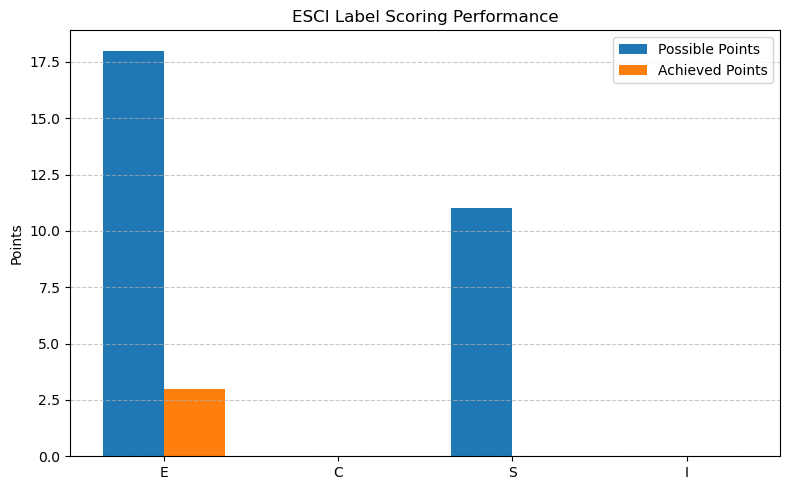

In [20]:
import matplotlib.pyplot as plt

# === Visualization of Per-Label Scoring ===
labels = list(label_stats.keys())
achieved = [label_stats[label]['achieved'] for label in labels]
possible = [label_stats[label]['possible'] for label in labels]

x = np.arange(len(labels))
width = 0.35

plt.figure(figsize=(8, 5))
plt.bar(x - width/2, possible, width, label='Possible Points')
plt.bar(x + width/2, achieved, width, label='Achieved Points')

plt.ylabel('Points')
plt.title('ESCI Label Scoring Performance')
plt.xticks(x, labels)
plt.legend()
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.tight_layout()
plt.show()


## Scoring system but no preprocessing

In [ ]:
import pandas as pd
import numpy as np
import re
import string
from sentence_transformers import SentenceTransformer
from sklearn.metrics.pairwise import cosine_similarity
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
import nltk

# === Filter and Preprocess Dataset ===
df = df_examples_products[
    (df_examples_products["small_version"] == 1) &
    (df_examples_products["product_locale"] == "us") &
    (df_examples_products["product_title"].notnull())
]

df_train = df[df["split"] == "train"].copy()
df_test = df[df["split"] == "test"].sample(n=20, random_state=24).copy()

# Combine and preprocess text columns
df_train['full_product_text'] = (
    df_train['product_title'].fillna('') + ' ' +
    df_train['product_description'].fillna('') + ' ' +
    df_train['product_brand'].fillna('')
)

# === Embedding with SentenceTransformer ===
model = SentenceTransformer('all-MiniLM-L6-v2')
product_vecs = model.encode(df_train['full_product_text'].values, convert_to_numpy=True)
train_titles = df_train['product_title'].tolist()

# === ESCI-Based Scoring with Rank Weights ===
esci_points = {'E': 3, 'C': 2, 'S': 1, 'I': 0}
rank_weights = {1: 1.0, 2: 0.67, 3: 0.33}

total_possible = 0
total_achieved = 0
label_stats = {label: {"possible": 0, "achieved": 0} for label in esci_points.keys()}

# === Evaluation ===
for i, row in df_test.iterrows():
    query = row['query']
    true_product = row['product_title']
    true_label = row['esci_label']
    
    query_vec = model.encode([query], convert_to_numpy=True)
    scores = cosine_similarity(query_vec, product_vecs).flatten()
    scores = (scores - scores.min()) / (scores.max() - scores.min() + 1e-8)
    ranked_indices = scores.argsort()[::-1][:3]
    
    print(f"\n🔍 Top matches for query: '{query}'")
    point_value = esci_points.get(true_label, 0)
    total_possible += point_value
    label_stats[true_label]["possible"] += point_value

    matched = False
    for rank, idx in enumerate(ranked_indices, start=1):
        predicted_title = train_titles[idx]
        print(f"{rank}. {predicted_title} (score: {scores[idx]:.4f})")
        if predicted_title.strip() == true_product.strip():
            scaled = point_value * rank_weights[rank]
            total_achieved += scaled
            label_stats[true_label]["achieved"] += scaled
            print(f"✅ Match found at rank {rank} with label '{true_label}' (+{scaled:.2f} points)")
            matched = True
            break
    if not matched:
        print("❌ No match found in top 3")

# === Final Score Summary ===
print(f"\n🌟 Total Achieved Points: {total_achieved:.2f}")
print(f"🎯 Total Possible Points: {total_possible}")
if total_possible > 0:
    print(f"📊 ESCI-Based Scaled Score: {total_achieved / total_possible:.4f}")
else:
    print("⚠️ No valid labels found in test set.")

print("\n📈 Per-Label Performance:")
for label, stats in label_stats.items():
    if stats["possible"] > 0:
        print(f" - {label}: {stats['achieved']:.2f}/{stats['possible']} ({stats['achieved']/stats['possible']:.4f})")
    else:
        print(f" - {label}: No examples")


2025-07-23 22:32:43,514 - Use pytorch device_name: mps
2025-07-23 22:32:43,515 - Load pretrained SentenceTransformer: all-MiniLM-L6-v2
/Users/sarahpopeck/anaconda3/lib/python3.11/site-packages/huggingface_hub/file_download.py:943: FutureWarning: `resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.
  warnings.warn(


Batches:   0%|          | 0/13115 [00:00<?, ?it/s]